In [2]:
tracks={}
for no in ['A','B','C','D']:
    tracks[no] = pd.read_csv("dataset/track_" + no + ".csv", parse_dates=["date"])

In [3]:
import pandas_profiling as pdp

/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/pandas_profiling/plot.py:15: UserWarning: matplotlib.pyplot as already been imported, this call will have no effect.
  matplotlib.use(BACKEND)


In [1]:
summarys = {}
for no in ['A','B','C','D']:
    summarys[no] = pd.read_csv("summary6_" + no + ".csv", index_col=0)

In [5]:
summarys['A']['傾き'].min()

-0.06094049042278244

In [6]:
summarys['A'].head()

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
0,A,10000.0,-0.003396,0.570,3.795202,261.0,44.0,1,1,3,0,0,13.607,0,1
1,A,10001.0,-0.002352,2.680,3.165688,260.0,38.0,1,1,3,0,0,13.607,0,1
2,A,10002.0,-0.005882,5.005,3.497406,259.0,28.0,1,1,3,0,0,13.607,0,1
3,A,10003.0,-0.001950,5.880,4.083893,259.0,26.0,1,1,3,0,0,13.607,0,1
4,A,10004.0,0.000652,5.035,3.805207,261.0,29.0,1,1,1,0,0,13.607,0,1


# 構造物データとの関係

In [7]:
summarys['A'].groupby('バラスト').count()
summarys['A'].groupby('バラスト').mean()
summarys['A'].groupby('バラスト').min()
summarys['A'].groupby('バラスト').max()

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
バラスト,,,,,,,,,,,,,,
0,11244,11244,11244,11244,11244,11244,11244,11244,11244,11244,11244,11244,11244,11244
1,16368,16368,16662,16662,16244,16368,16368,16662,16662,16662,16662,16662,16662,16662


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
バラスト,,,,,,,,,,,,,
0,17090.731323,-0.000017,0.000222,1.088053,295.723408,39.083867,0.915155,1.389185,0.055496,0.010317,10.381744,1573.568125,0.193614
1,28703.023522,0.000002,-0.004575,1.067488,253.288673,29.811400,0.861061,1.127476,0.002461,0.002641,9.610553,938.154783,0.177110


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
バラスト,,,,,,,,,,,,,
0,10171.0,-0.035366,-8.89,0.056589,3.0,-100.0,0,1,0,0,0.000,0,0
1,10000.0,-0.060940,-14.81,0.012910,1.0,-100.0,0,1,0,0,8.073,0,0


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
バラスト,,,,,,,,,,,,,
0,37327.0,0.019625,9.070,6.200870,307.0,93.0,1,8,1,1,13.607,70000,1
1,37905.0,0.060733,14.315,21.090777,305.0,81.0,1,8,1,1,13.607,4000,1


/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


Text(0.5, 1.0, 'A')

Text(0.5, 1.0, 'B')

Text(0.5, 1.0, 'C')

Text(0.5, 1.0, 'D')

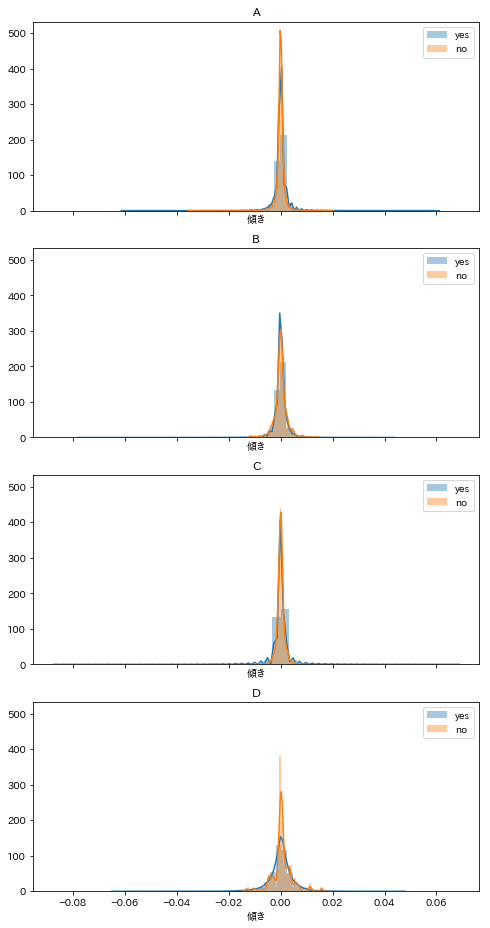

In [8]:
fig, axes = plt.subplots(4, 1, figsize=(8, 16), sharex=True, sharey=True)
for i, (no, df) in enumerate(summarys.items()):
    for f in [1, 0]:
        tmp = df[df["バラスト"]==f]["傾き"].dropna()
        sns.distplot(tmp, kde=True, rug=False, ax=axes[i])
        axes[i].legend(["yes","no"])
    axes[i].set_title(no)

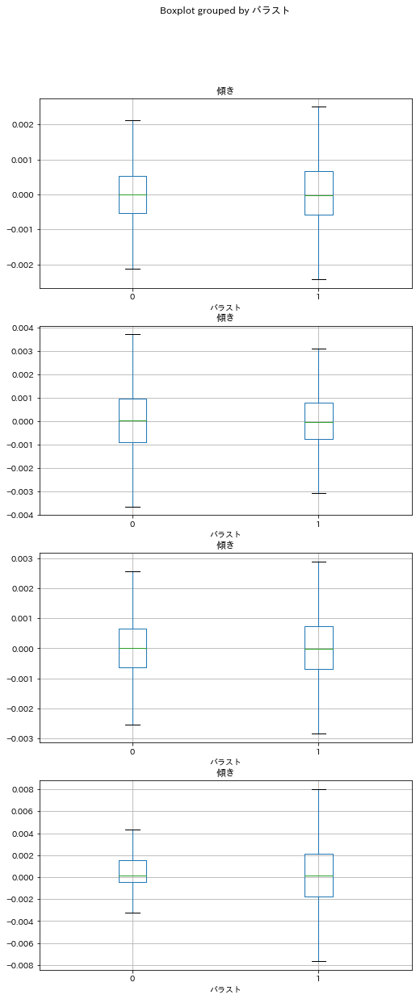

In [2]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['傾き'], by='バラスト', ax=axes[i], sym='')

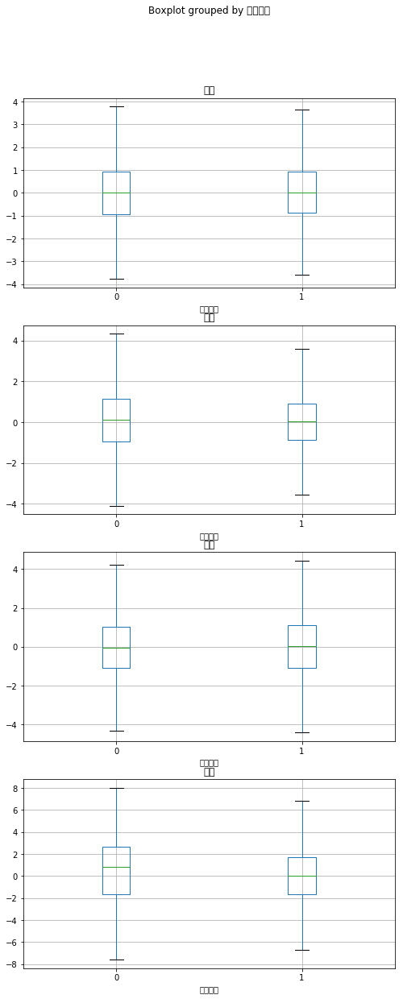

In [4]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['切片'], by='バラスト', ax=axes[i], sym='')

In [9]:
summarys['A'].groupby('ロングレール').count()
summarys['A'].groupby('ロングレール').mean()
summarys['A'].groupby('ロングレール').min()
summarys['A'].groupby('ロングレール').max()

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
ロングレール,,,,,,,,,,,,,,
0,3237,3237,3269,3269,3237,3237,3237,3269,3269,3269,3269,3269,3269,3269
1,24375,24375,24637,24637,24251,24375,24375,24637,24637,24637,24637,24637,24637,24637


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
ロングレール,,,,,,,,,,,,,
0,25053.243126,-0.000014,-0.002132,1.000902,277.503553,37.444238,0.708168,2.518507,0.179872,0.003365,10.314397,665.065769,0.508412
1,23831.053292,-0.000005,-0.002710,1.085910,269.647754,33.075077,0.582336,1.062345,0.003125,0.006048,9.869124,1264.384259,0.140683


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
ロングレール,,,,,,,,,,,,,
0,10010.0,-0.035366,-8.64,0.081303,21.0,-100.0,0,1,0,0,0.0,0,0
1,10000.0,-0.060940,-14.81,0.012910,1.0,-100.0,0,1,0,0,0.0,0,0


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
ロングレール,,,,,,,,,,,,,
0,34824.0,0.019625,9.070,5.775586,305.0,80.0,1,8,1,1,13.607,3200,1
1,37905.0,0.060733,14.315,21.090777,307.0,93.0,1,8,1,1,13.607,70000,1


Text(0.5, 1.0, 'A')

Text(0.5, 1.0, 'B')

Text(0.5, 1.0, 'C')

Text(0.5, 1.0, 'D')

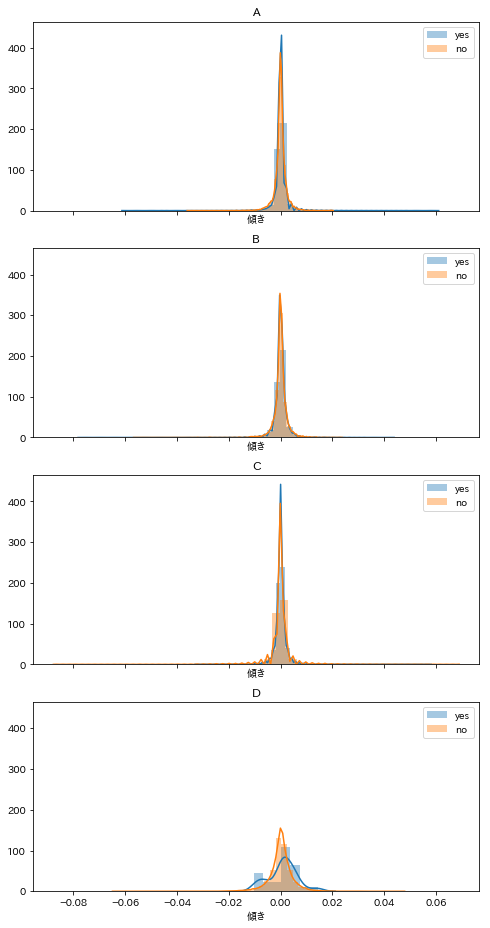

In [10]:
fig, axes = plt.subplots(4, 1, figsize=(8, 16), sharex=True, sharey=True)
for i, (no, df) in enumerate(summarys.items()):
    for f in [1, 0]:
        tmp = df[df["ロングレール"]==f]["傾き"].dropna()
        sns.distplot(tmp, kde=True, rug=False, ax=axes[i])
        axes[i].legend(["yes","no"])
    axes[i].set_title(no)

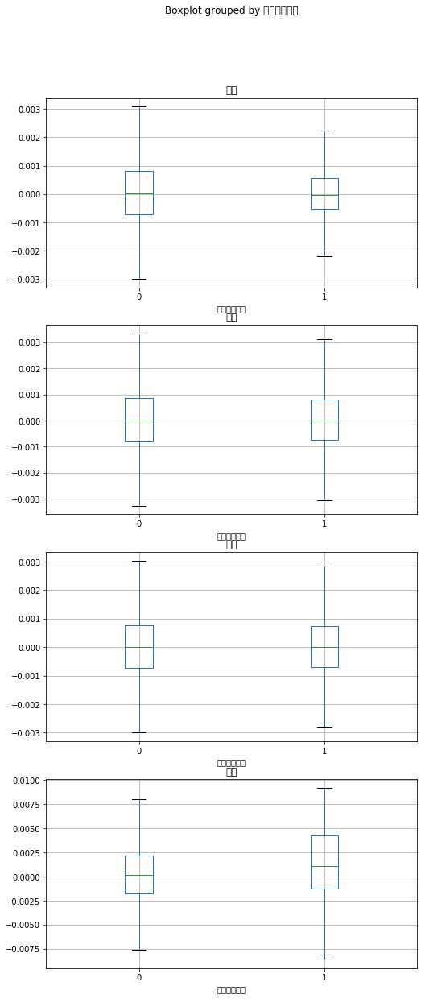

In [5]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['傾き'], by='ロングレール', ax=axes[i], sym='')

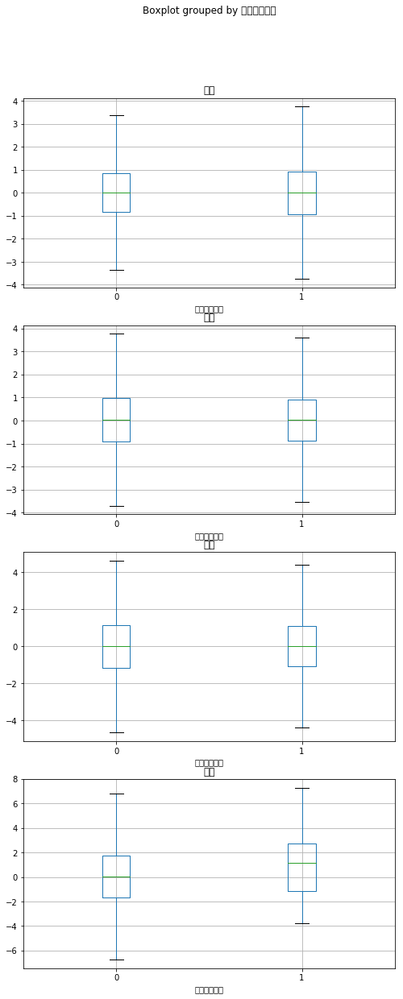

In [6]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['切片'], by='ロングレール', ax=axes[i], sym='')

In [11]:
summarys['A'].groupby('マクラギ種別').count()
summarys['A'].groupby('マクラギ種別').mean()
summarys['A'].groupby('マクラギ種別').min()
summarys['A'].groupby('マクラギ種別').max()

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,橋りょう,踏切,通トン,曲線半径,フラグ
マクラギ種別,,,,,,,,,,,,,,
1,25503,25503,25795,25795,25379,25503,25503,25795,25795,25795,25795,25795,25795,25795
2,160,160,162,162,160,160,160,162,162,162,162,162,162,162
3,1164,1164,1164,1164,1164,1164,1164,1164,1164,1164,1164,1164,1164,1164
5,471,471,471,471,471,471,471,471,471,471,471,471,471,471
6,36,36,36,36,36,36,36,36,36,36,36,36,36,36
8,278,278,278,278,278,278,278,278,278,278,278,278,278,278


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,橋りょう,踏切,通トン,曲線半径,フラグ
マクラギ種別,,,,,,,,,,,,,
1,23878.185782,-0.000008,-0.004201,1.086691,270.130651,33.340783,0.606823,0.938050,0.001047,0.000737,9.903885,1256.713898,0.151502
2,28760.575000,0.000138,0.088858,0.957432,269.431250,36.018750,0.808642,0.611111,0.209877,0.092593,9.744765,832.716049,0.271605
3,23087.396907,-0.000014,-0.016954,0.973881,282.078179,37.844502,0.697595,0.141753,0.000000,0.000000,10.232534,394.158076,0.984536
5,26032.898089,0.000016,0.035032,0.877358,270.324841,35.641189,0.014862,0.061571,0.987261,0.000000,11.038285,64.543524,0.006369
6,17961.305556,0.000414,0.259306,1.238608,286.250000,36.722222,1.000000,0.527778,0.000000,0.000000,11.579000,0.000000,0.472222
8,31044.517986,0.000004,0.050845,0.901368,261.600719,33.089928,0.082734,0.460432,0.500000,0.453237,8.228291,1020.503597,0.035971


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,橋りょう,踏切,通トン,曲線半径,フラグ
マクラギ種別,,,,,,,,,,,,,
1,10004.0,-0.060940,-14.81,0.012910,1.0,-100.0,0,0,0,0,0.000,0,0
2,10042.0,-0.005997,-5.15,0.144733,7.0,-100.0,0,0,0,0,8.073,0,0
3,10000.0,-0.013760,-8.30,0.083356,21.0,-100.0,0,0,0,0,0.000,0,0
5,18213.0,-0.035366,-8.64,0.102330,24.0,-100.0,0,0,0,0,8.456,0,0
6,16855.0,-0.003819,-4.10,0.573575,283.0,26.0,1,0,0,0,11.579,0,0
8,14054.0,-0.006113,-6.88,0.128242,3.0,-100.0,0,0,0,0,0.000,0,0


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,橋りょう,踏切,通トン,曲線半径,フラグ
マクラギ種別,,,,,,,,,,,,,
1,37905.0,0.060733,14.315,21.090777,307.0,93.0,1,1,1,1,13.607,70000,1
2,37671.0,0.005199,4.985,4.121567,302.0,56.0,1,1,1,1,13.607,3200,1
3,34804.0,0.008650,5.880,5.653028,305.0,81.0,1,1,0,0,13.607,1000,1
5,33841.0,0.019625,6.930,4.768859,295.0,51.0,1,1,1,0,11.579,1600,1
6,18953.0,0.006813,2.595,2.384578,293.0,46.0,1,1,0,0,11.579,0,1
8,37327.0,0.007695,9.070,3.315707,300.0,65.0,1,1,1,1,11.579,2000,1


/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/seaborn/distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/numpy/lib/histograms.py:823: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


Text(0.5, 1.0, 'A')

/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/numpy/core/_methods.py:140: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/numpy/core/_methods.py:132: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/statsmodels/nonparametric/bandwidths.py:20: RuntimeWarning: invalid value encountered in minimum
  return np.minimum(np.std(X, axis=0, ddof=1), IQR)
/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


Text(0.5, 1.0, 'B')

Text(0.5, 1.0, 'C')

Text(0.5, 1.0, 'D')

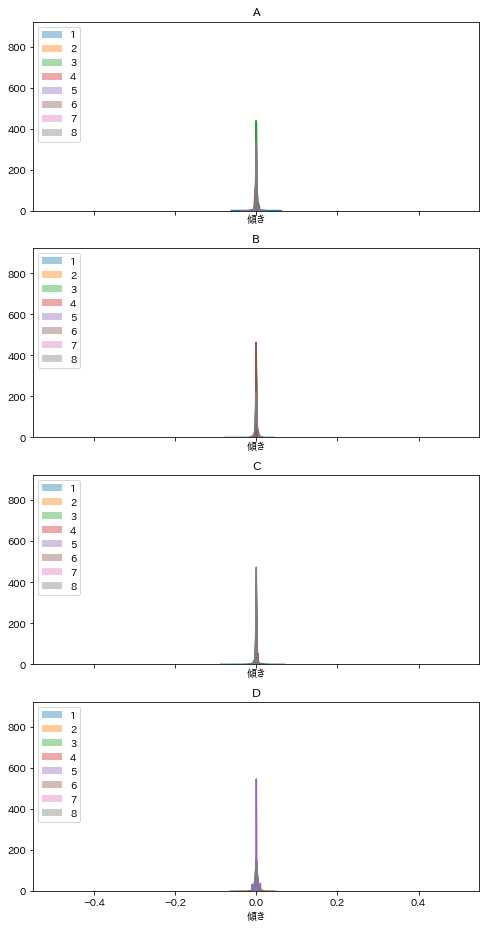

In [12]:
fig, axes = plt.subplots(4, 1, figsize=(8, 16), sharex=True, sharey=True)
for i, (no, df) in enumerate(summarys.items()):
    for f in range(1, 9):
        tmp = df[df["マクラギ種別"]==f]["傾き"].dropna()
        sns.distplot(tmp, kde=True, rug=False, ax=axes[i])
        axes[i].legend(["1", "2", "3", "4", "5", "6", "7", "8"])
    axes[i].set_title(no)

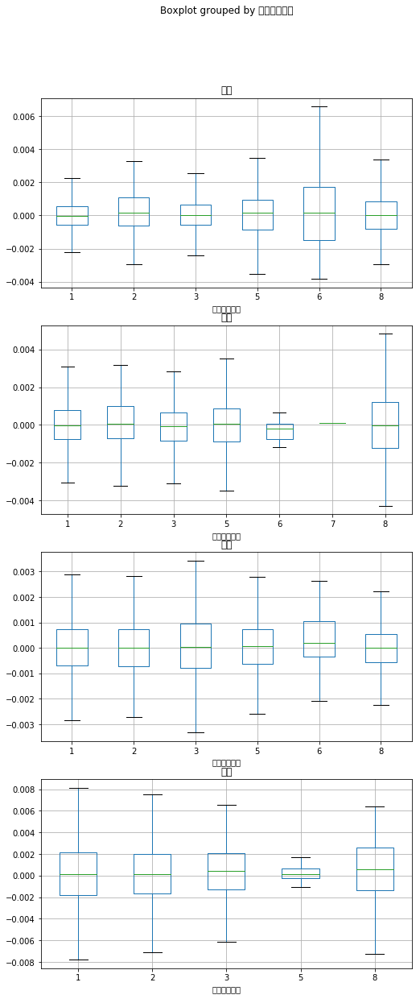

In [7]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['傾き'], by='マクラギ種別', ax=axes[i], sym='')

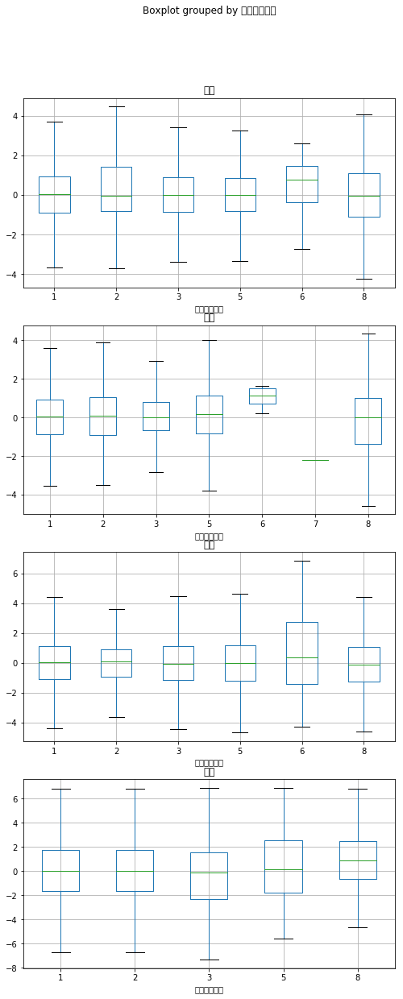

In [8]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['切片'], by='マクラギ種別', ax=axes[i], sym='')

In [13]:
summarys['A'].groupby('橋りょう').count()
summarys['A'].groupby('橋りょう').mean()
summarys['A'].groupby('橋りょう').min()
summarys['A'].groupby('橋りょう').max()

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,踏切,通トン,曲線半径,フラグ
橋りょう,,,,,,,,,,,,,,
0,26947,26947,27241,27241,26823,26947,26947,27241,27241,27241,27241,27241,27241,27241
1,665,665,665,665,665,665,665,665,665,665,665,665,665,665


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,踏切,通トン,曲線半径,フラグ
橋りょう,,,,,,,,,,,,,
0,23891.885739,-0.000006,-0.003065,1.081000,270.538168,33.514788,0.610146,0.901582,1.133365,0.005873,9.908262,1216.902280,0.188246
1,27315.228571,0.000005,0.014699,0.870189,271.806015,36.524812,0.061654,0.115789,5.311278,0.000000,10.454749,263.308271,0.000000


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,踏切,通トン,曲線半径,フラグ
橋りょう,,,,,,,,,,,,,
0,10000.0,-0.060940,-14.81,0.012910,1.0,-100.0,0,0,1,0,0.000,0,0
1,16793.0,-0.035366,-8.64,0.095466,24.0,-100.0,0,0,1,0,8.456,0,0


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,踏切,通トン,曲線半径,フラグ
橋りょう,,,,,,,,,,,,,
0,37905.0,0.060733,14.315,21.090777,307.0,93.0,1,1,8,1,13.607,70000,1
1,33842.0,0.019625,9.070,4.768859,297.0,65.0,1,1,8,0,11.579,1600,0


Text(0.5, 1.0, 'A')

Text(0.5, 1.0, 'B')

Text(0.5, 1.0, 'C')

Text(0.5, 1.0, 'D')

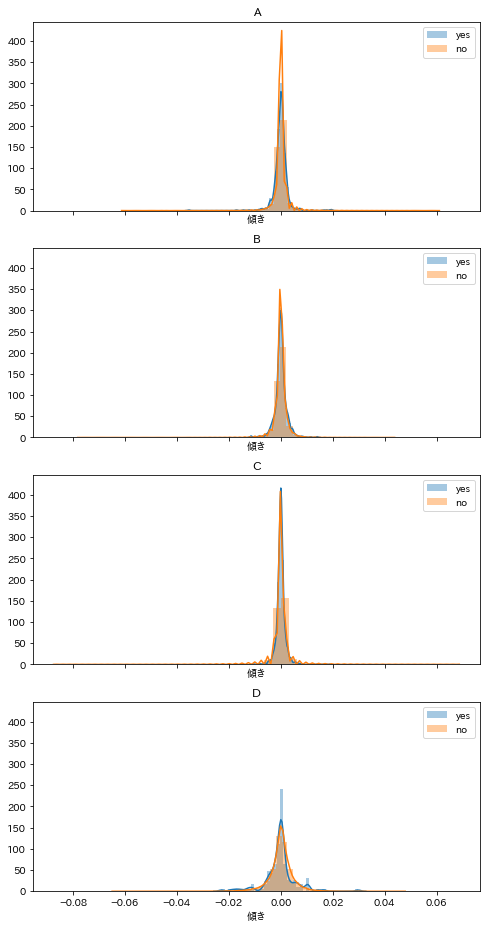

In [14]:
fig, axes = plt.subplots(4, 1, figsize=(8, 16), sharex=True, sharey=True)
for i, (no, df) in enumerate(summarys.items()):
    for f in [1, 0]:
        tmp = df[df["橋りょう"]==f]["傾き"].dropna()
        sns.distplot(tmp, kde=True, rug=False, ax=axes[i])
        axes[i].legend(["yes","no"])
    axes[i].set_title(no)

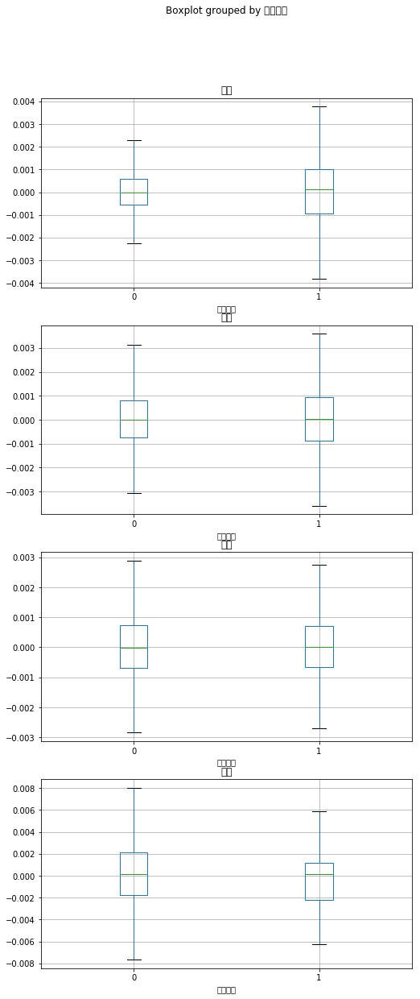

In [9]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['傾き'], by='橋りょう', ax=axes[i], sym='')

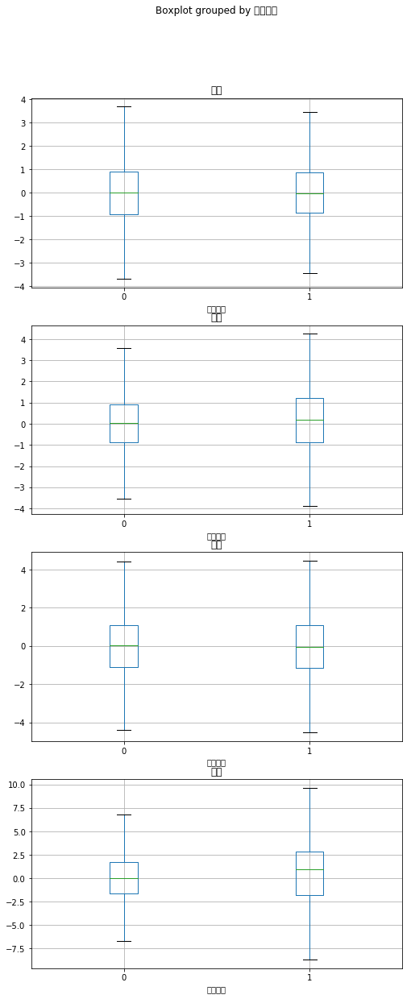

In [10]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['切片'], by='橋りょう', ax=axes[i], sym='')

In [15]:
summarys['A'].groupby('踏切').count()
summarys['A'].groupby('踏切').mean()
summarys['A'].groupby('踏切').min()
summarys['A'].groupby('踏切').max()

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,通トン,曲線半径,フラグ
踏切,,,,,,,,,,,,,,
0,27452,27452,27746,27746,27328,27452,27452,27746,27746,27746,27746,27746,27746,27746
1,160,160,160,160,160,160,160,160,160,160,160,160,160,160


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,通トン,曲線半径,フラグ
踏切,,,,,,,,,,,,,
0,23924.833855,-0.000005,-0.002764,1.076896,270.725885,33.624909,0.598933,0.882578,1.201939,0.023967,9.930078,1194.494161,0.184423
1,32467.081250,-0.000111,0.018469,0.905773,243.600000,27.131250,0.275000,0.931250,6.606250,0.000000,8.396481,1139.375000,0.068750


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,通トン,曲線半径,フラグ
踏切,,,,,,,,,,,,,
0,10000.0,-0.060940,-14.81,0.012910,1.0,-100.0,0,0,1,0,0.000,0,0
1,14054.0,-0.005524,-3.88,0.128242,3.0,-100.0,0,0,1,0,8.073,500,0


,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,通トン,曲線半径,フラグ
踏切,,,,,,,,,,,,,
0,37905.0,0.060733,14.315,21.090777,307.0,93.0,1,1,8,1,13.607,70000,1
1,37672.0,0.004710,5.420,2.894581,279.0,61.0,1,1,8,0,11.086,2000,1


Text(0.5, 1.0, 'A')

Text(0.5, 1.0, 'B')

Text(0.5, 1.0, 'C')

Text(0.5, 1.0, 'D')

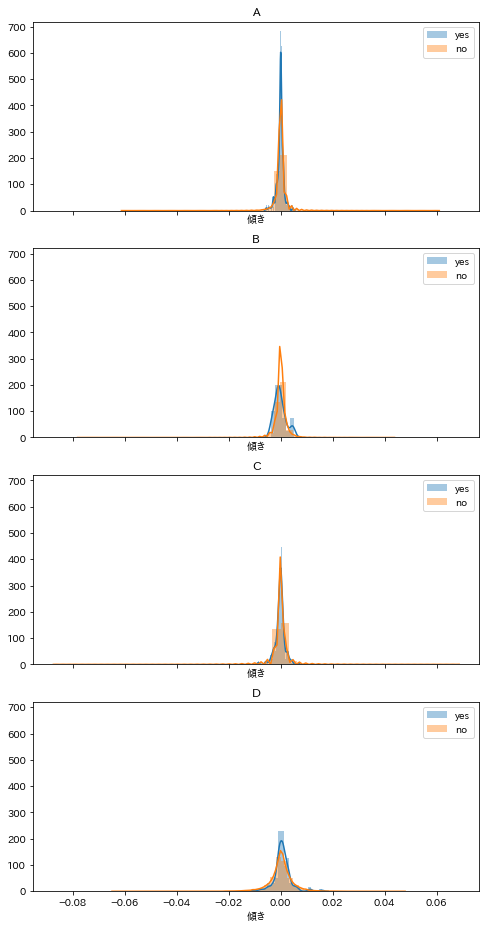

In [16]:
fig, axes = plt.subplots(4, 1, figsize=(8, 16), sharex=True, sharey=True)
for i, (no, df) in enumerate(summarys.items()):
    for f in [1, 0]:
        tmp = df[df["踏切"]==f]["傾き"].dropna()
        sns.distplot(tmp, kde=True, rug=False, ax=axes[i])
        axes[i].legend(["yes","no"])
    axes[i].set_title(no)

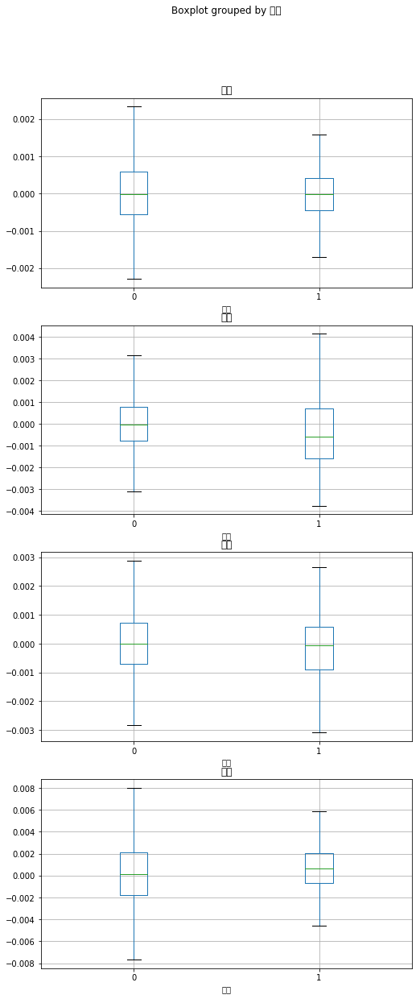

In [12]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['傾き'], by='踏切', ax=axes[i], sym='')

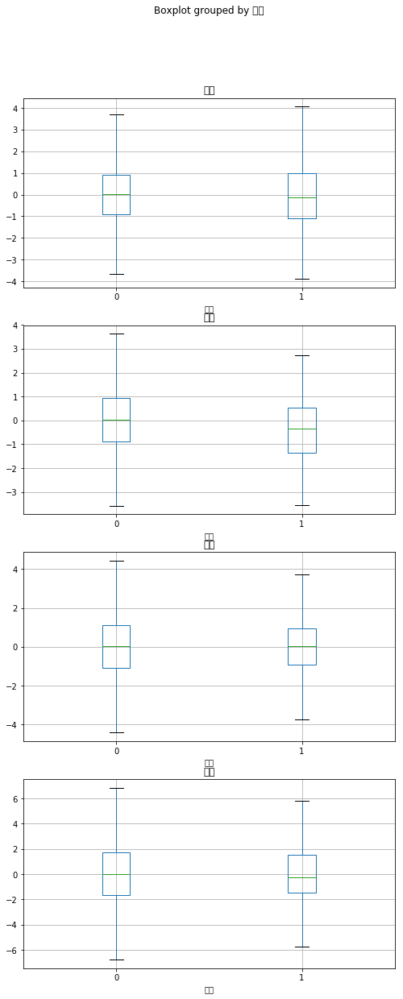

In [13]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['切片'], by='踏切', ax=axes[i], sym='')

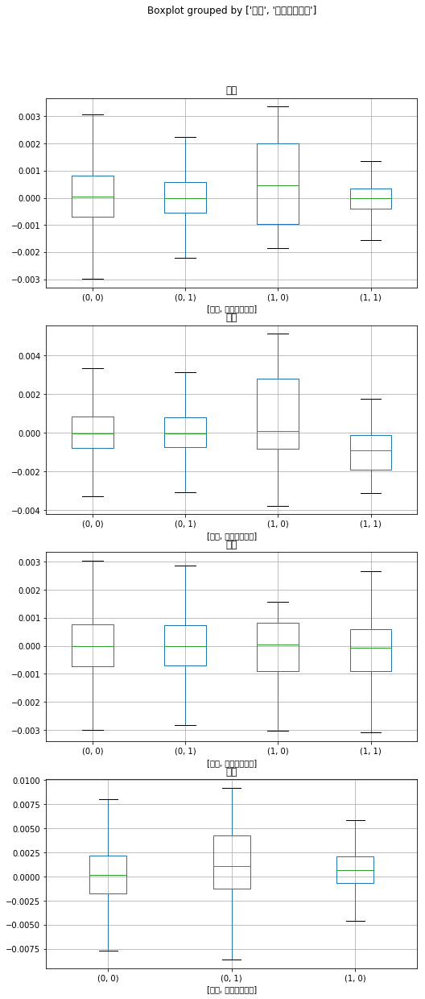

In [14]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    summary = summarys[no]
    summary.boxplot(column=['傾き'], by=['踏切', 'ロングレール'], ax=axes[i], sym='')

In [10]:
sum_sum = pd.DataFrame()
for no, tmp in summarys.items():
    print(len(tmp))
#     tmp = tmp.dropna(subset=['キロ程'])
    tmp = tmp.dropna()
    print(len(tmp))
    sum_sum = pd.concat([sum_sum, tmp], axis=0)

27906
27488
21531
21021
55684
55200
15691
15541


In [11]:
sum_sum.loc[sum_sum['データ数'] == -100, 'データ数'] = 3
sum_sum.loc[sum_sum['曲線半径'] == 0, '曲線半径'] = 10000
sum_sum['曲線半径'] = 1/sum_sum['曲線半径']
sum_sum['傾きの大きさ'] = abs(sum_sum['傾き'])
sum_sum['切片の大きさ'] = abs(sum_sum['切片'])
sum_sum = sum_sum.drop(['キロ程'], axis=1)

In [5]:
sum_sum

,路線,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ,傾きの大きさ,切片の大きさ
0,A,-0.003396,0.570,3.795202,261.0,44.0,1,1,3,0,0,13.607,0.000100,1,0.003396,0.570
1,A,-0.002352,2.680,3.165688,260.0,38.0,1,1,3,0,0,13.607,0.000100,1,0.002352,2.680
2,A,-0.005882,5.005,3.497406,259.0,28.0,1,1,3,0,0,13.607,0.000100,1,0.005882,5.005
3,A,-0.001950,5.880,4.083893,259.0,26.0,1,1,3,0,0,13.607,0.000100,1,0.001950,5.880
4,A,0.000652,5.035,3.805207,261.0,29.0,1,1,1,0,0,13.607,0.000100,1,0.000652,5.035
5,A,-0.001727,1.645,2.261965,261.0,26.0,1,1,1,0,0,13.607,0.000100,1,0.001727,1.645
6,A,-0.001022,-3.100,2.588153,257.0,29.0,1,1,1,0,0,13.607,0.000100,1,0.001022,3.100
7,A,0.004529,-7.240,4.033433,255.0,32.0,1,1,1,0,0,13.607,0.000100,1,0.004529,7.240
8,A,0.002334,-8.850,4.599720,251.0,36.0,1,1,1,0,0,13.607,0.000100,1,0.002334,8.850
9,A,-0.000805,-7.410,3.482811,251.0,33.0,1,1,1,0,0,13.607,0.000100,1,0.000805,7.410


In [12]:
sum_sum['マクラギ種別'] = sum_sum['マクラギ種別'].astype(object)
# sum_sum = pd.get_dummies(sum_sum, drop_first=True)
sum_sum = pd.get_dummies(sum_sum)

Index(['傾き', '切片', '標本標準偏差', '測定回数', 'データ数', 'バラスト', 'ロングレール', '橋りょう', '踏切',
       '通トン', '曲線半径', 'フラグ', '傾きの大きさ', '切片の大きさ', '路線_A', '路線_B', '路線_C',
       '路線_D', 'マクラギ種別_1', 'マクラギ種別_2', 'マクラギ種別_3', 'マクラギ種別_5', 'マクラギ種別_6',
       'マクラギ種別_7', 'マクラギ種別_8'],
      dtype='object')

<Figure size 864x648 with 0 Axes>

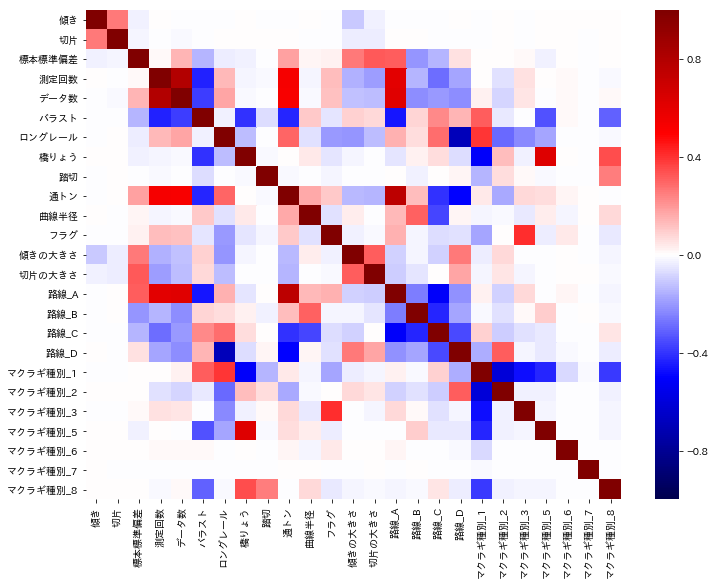

In [13]:
sum_sum.columns
plt.figure(figsize=(12, 9))
sns.heatmap(sum_sum.corr(), cmap='seismic', vmin=-1, vmax=1)

In [14]:
sum_sum.corr()['傾きの大きさ']

傾き         -0.108417
切片         -0.032690
標本標準偏差      0.261216
測定回数       -0.154608
データ数       -0.124231
バラスト        0.087345
ロングレール     -0.208466
橋りょう       -0.019129
踏切         -0.005527
通トン        -0.139562
曲線半径        0.034242
フラグ        -0.026266
傾きの大きさ      1.000000
切片の大きさ      0.316612
路線_A       -0.087027
路線_B       -0.019456
路線_C       -0.087419
路線_D        0.260367
マクラギ種別_1   -0.031752
マクラギ種別_2    0.074192
マクラギ種別_3   -0.007676
マクラギ種別_5   -0.007260
マクラギ種別_6    0.000566
マクラギ種別_7   -0.001710
マクラギ種別_8   -0.021069
Name: 傾きの大きさ, dtype: float64

In [22]:
sum_sum.head()

,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,橋りょう,踏切,...,フラグ,路線_B,路線_C,路線_D,マクラギ種別_2,マクラギ種別_3,マクラギ種別_5,マクラギ種別_6,マクラギ種別_7,マクラギ種別_8
0,10000.0,-0.003396,0.570,3.795202,261.0,44.0,1,1,0,0,...,1,0,0,0,0,1,0,0,0,0
1,10001.0,-0.002352,2.680,3.165688,260.0,38.0,1,1,0,0,...,1,0,0,0,0,1,0,0,0,0
2,10002.0,-0.005882,5.005,3.497406,259.0,28.0,1,1,0,0,...,1,0,0,0,0,1,0,0,0,0
3,10003.0,-0.001950,5.880,4.083893,259.0,26.0,1,1,0,0,...,1,0,0,0,0,1,0,0,0,0
4,10004.0,0.000652,5.035,3.805207,261.0,29.0,1,1,0,0,...,1,0,0,0,0,0,0,0,0,0


In [23]:
X = sum_sum.drop(['キロ程', '傾き', '切片'], axis=1)
y_s = sum_sum['傾き']
y_i = sum_sum['切片']

In [24]:
from sklearn.model_selection import train_test_split

In [25]:
X_train, X_test, y_s_train, y_s_test, y_i_train, y_i_test = train_test_split(X, y_s, y_i, test_size=0.2, random_state=42)

In [148]:
from sklearn.linear_model import Ridge
ridge = Ridge(alpha=1.0)

In [150]:
ridge.fit(X_train, y_s_train)
ridge.score(X_test, y_s_test)

Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001)

0.0009906278406469626

<Figure size 600x600 with 0 Axes>

<BarContainer object of 19 artists>

([<matplotlib.axis.YTick at 0x1a4d1b9828>,
 <a list of 19 Text yticklabel objects>)

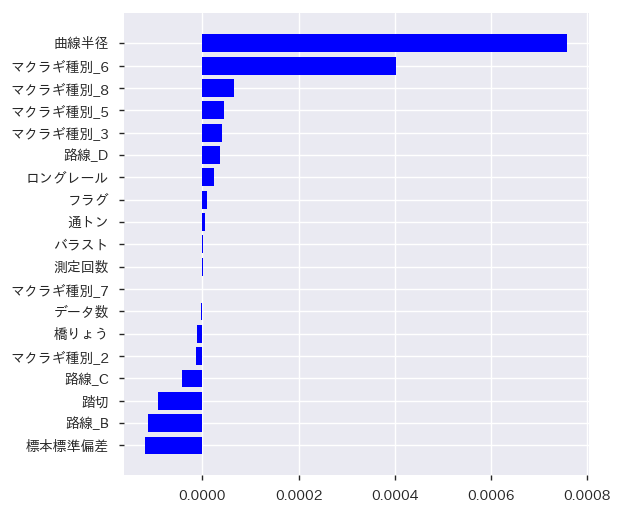

In [151]:
features = X_train.columns
importances = ridge.coef_
indices = np.argsort(importances)

plt.figure(figsize=(6,6))
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), features[indices])
plt.show()

In [29]:
from lightgbm import LGBMRegressor
lgb = LGBMRegressor()

/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/lightgbm/__init__.py:46: UserWarning: Starting from version 2.2.1, the library file in distribution wheels for macOS is built by the Apple Clang (Xcode_8.3.1) compiler.
This means that in case of installing LightGBM from PyPI via the ``pip install lightgbm`` command, you don't need to install the gcc compiler anymore.
Instead of that, you need to install the OpenMP library, which is required for running LightGBM on the system with the Apple Clang compiler.
You can install the OpenMP library by the following command: ``brew install libomp``.
  "You can install the OpenMP library by the following command: ``brew install libomp``.", UserWarning)


In [30]:
lgb.fit(X_train, y_s_train)
lgb.score(X_test, y_s_test)

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.1, max_depth=-1,
       min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
       n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

0.003269307779021013

In [46]:
from sklearn.metrics import r2_score
r2_score(y_s_test, lgb.predict(X_test))
r2_score(y_s_test, np.ones(len(y_s_test))*np.mean(y_s_test))
r2_score(y_s_test, np.ones(len(y_s_test))*np.median(y_s_test))
r2_score(y_s_test, np.ones(len(y_s_test))*y_i_test*0.001)
r2_score(y_s_test, np.ones(len(y_s_test))*y_i_test*0.0001)
r2_score(y_s_test, np.ones(len(y_s_test))*y_i_test*0.00001)

0.0032693077790210134

0.0

-1.0965204713331289e-05

-0.23251444944887756

0.03481214355962603

0.003968042791293147

<Figure size 432x432 with 0 Axes>

<BarContainer object of 19 artists>

([<matplotlib.axis.YTick at 0x1a219ffa20>,
 <a list of 19 Text yticklabel objects>)

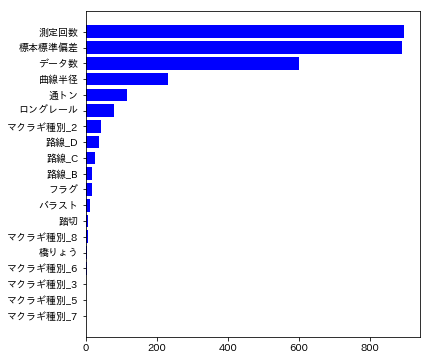

In [31]:
features = X_train.columns
importances = lgb.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(6,6))
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), features[indices])
plt.show()

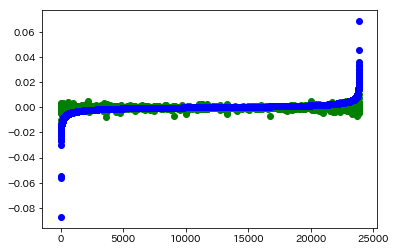

In [32]:
def plot_actual_predicted(actual, predicted):
    tmp = pd.DataFrame({'actual': actual, 'predicted': predicted}).sort_values(['actual'])
    plt.scatter(range(tmp.shape[0]), tmp['predicted'], color='green')
    plt.scatter(range(tmp.shape[0]), tmp['actual'], color='blue')
    plt.show()
    del tmp
plot_actual_predicted(y_s_test, lgb.predict(X_test))

In [47]:
lgb.fit(X_train, y_i_train)
lgb.score(X_test, y_i_test)

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.1, max_depth=-1,
       min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
       n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

0.0038885074972465627

In [51]:
from sklearn.metrics import r2_score
r2_score(y_i_test, lgb.predict(X_test))
r2_score(y_i_test, np.ones(len(y_i_test))*np.mean(y_i_test))
r2_score(y_i_test, np.ones(len(y_i_test))*np.median(y_i_test))
r2_score(y_i_test, np.ones(len(y_i_test))*y_s_test*10)
r2_score(y_i_test, np.ones(len(y_i_test))*y_s_test*100)
r2_score(y_i_test, np.ones(len(y_i_test))*y_s_test*1000)

0.0038885074972465627

0.0

-0.00014586436323726915

0.006218310505325064

0.04852897429671654

-0.9073736687725129

<Figure size 432x432 with 0 Axes>

<BarContainer object of 19 artists>

([<matplotlib.axis.YTick at 0x1a219ffa20>,
 <a list of 19 Text yticklabel objects>)

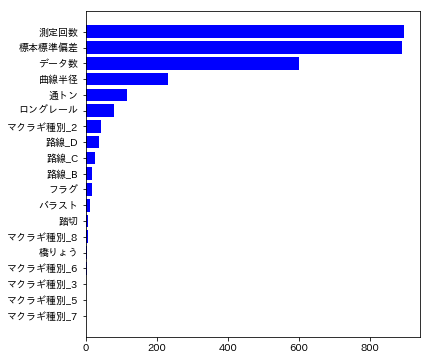

In [31]:
features = X_train.columns
importances = lgb.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(6,6))
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), features[indices])
plt.show()

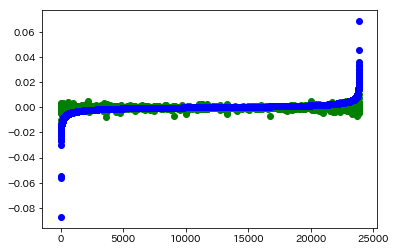

In [32]:
def plot_actual_predicted(actual, predicted):
    tmp = pd.DataFrame({'actual': actual, 'predicted': predicted}).sort_values(['actual'])
    plt.scatter(range(tmp.shape[0]), tmp['predicted'], color='green')
    plt.scatter(range(tmp.shape[0]), tmp['actual'], color='blue')
    plt.show()
    del tmp
plot_actual_predicted(y_i_test, lgb.predict(X_test))

# 前後のキロ程データとの関係

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '20538.0'),
 Text(0, 0, '20539.0'),
 Text(0, 0, '20540.0'),
 Text(0, 0, '20541.0'),
 Text(0, 0, '20542.0'),
 Text(0, 0, '20543.0'),
 Text(0, 0, '20544.0'),
 Text(0, 0, '20545.0'),
 Text(0, 0, '20546.0'),
 Text(0, 0, '20547.0')]

Text(0, 0.5, '')

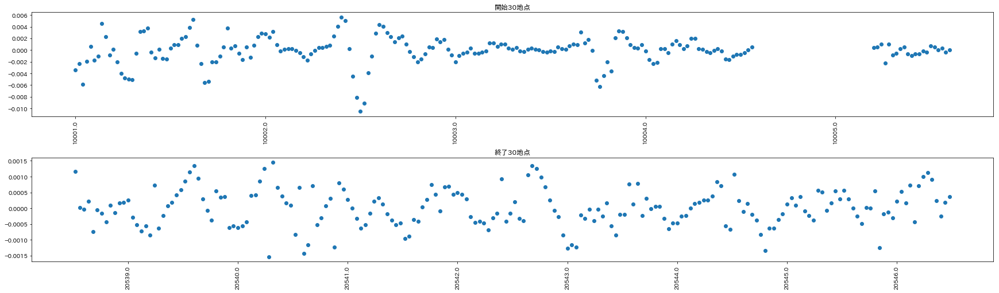

In [83]:
summ = summarys['A']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["傾き"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["傾き"], "o")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

array([10070., 10071., 10072., 10073., 10074., 10075., 10076., 10077.,
       10078., 10079.])

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10070.0'),
 Text(0, 0, '10071.0'),
 Text(0, 0, '10072.0'),
 Text(0, 0, '10073.0'),
 Text(0, 0, '10074.0'),
 Text(0, 0, '10075.0'),
 Text(0, 0, '10076.0')]

Text(0, 0.5, '')

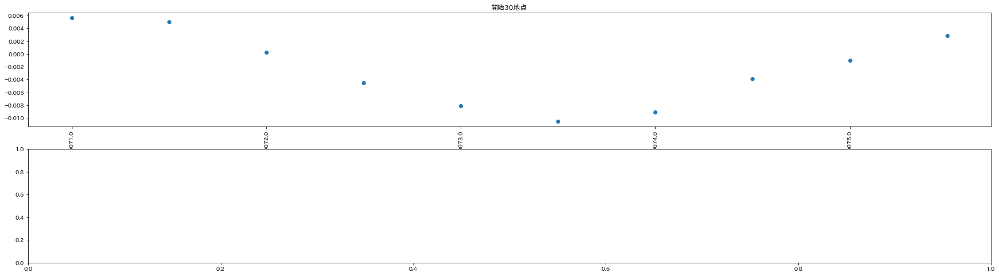

In [123]:
summ = summarys['A']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[70:80]
start30_kiros
summ1 = summ[summ["キロ程"].isin(start30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["傾き"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

In [124]:
summ = summarys['A']
kilos = range(10050, 10080)
for i, kilo in enumerate(kilos):
    summ[summ['キロ程'] == kilo]

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
50,A,10050.0,0.002825,-0.83,1.32515,295.0,21.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
51,A,10051.0,0.002205,-0.555,0.968637,296.0,31.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
52,A,10052.0,0.00321,0.24,0.636019,296.0,28.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
53,A,10053.0,0.000927,0.7,0.702221,298.0,27.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
54,A,10054.0,-0.000115,0.6,0.642585,300.0,40.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
55,A,10055.0,0.00009,0.08,0.366979,299.0,29.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
56,A,10056.0,0.000213,-0.38,0.611275,298.0,32.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
57,A,10057.0,0.000247,-0.74,0.991984,296.0,34.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
58,A,10058.0,-0.000034,-0.84,1.000284,297.0,31.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
59,A,10059.0,-0.000502,-0.71,0.61718,293.0,52.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
60,A,10060.0,-0.001168,-0.67,0.515469,294.0,35.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
61,A,10061.0,-0.001761,-0.61,1.440701,292.0,33.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
62,A,10062.0,-0.000664,-0.54,2.012639,292.0,30.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
63,A,10063.0,-0.000048,-0.26,1.965655,293.0,37.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
64,A,10064.0,0.000405,0.34,1.454671,292.0,45.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
65,A,10065.0,0.000431,1.16,1.260611,293.0,32.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
66,A,10066.0,0.000582,1.81,1.660799,292.0,36.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
67,A,10067.0,0.00082,1.65,1.765846,293.0,29.0,1,0,2,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
68,A,10068.0,0.002369,0.405,1.181116,292.0,29.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
69,A,10069.0,0.004085,-1.265,0.669006,292.0,27.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
70,A,10070.0,0.005665,-3.31,1.610897,294.0,54.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
71,A,10071.0,0.005053,-4.31,2.135122,289.0,55.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
72,A,10072.0,0.000246,-3.85,2.01218,290.0,55.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
73,A,10073.0,-0.004508,-2.27,1.443049,284.0,44.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
74,A,10074.0,-0.008087,-0.45,1.36585,283.0,39.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
75,A,10075.0,-0.010507,0.54,1.522013,280.0,33.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
76,A,10076.0,-0.00907,0.595,1.351946,280.0,27.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
77,A,10077.0,-0.003898,-0.5,0.896778,276.0,25.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
78,A,10078.0,-0.001046,-1.46,1.003415,275.0,29.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
79,A,10079.0,0.002893,-1.67,1.176103,275.0,33.0,1,0,1,0,0,13.607,3200,0


Text(0.5, 1.0, '10070')

Text(0.5, 1.0, '10071')

Text(0.5, 1.0, '10072')

Text(0.5, 1.0, '10073')

Text(0.5, 1.0, '10074')

Text(0.5, 1.0, '10075')

Text(0.5, 1.0, '10076')

Text(0.5, 1.0, '10077')

Text(0.5, 1.0, '10078')

Text(0.5, 1.0, '10079')

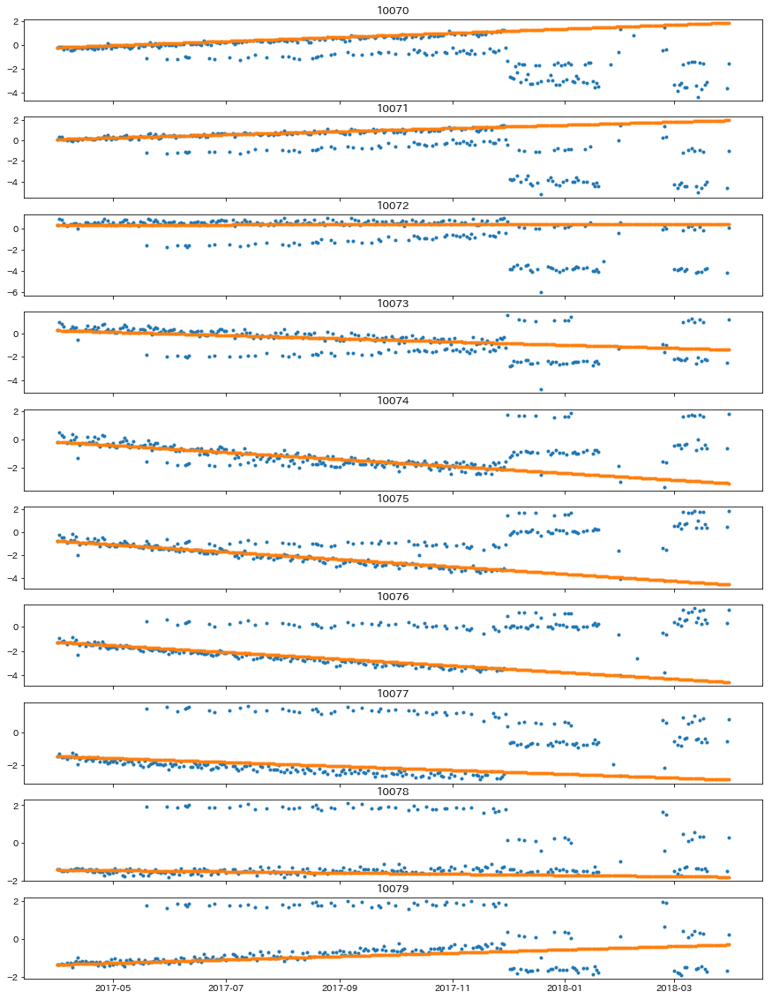

In [126]:
fig, axes = plt.subplots(10, 1, figsize=(15, 20), sharex=True)
track = tracks['A']
summary = summarys['A']
kilos = range(10070, 10080)
for i, kilo in enumerate(kilos):
    day = track[track['キロ程'] == kilo]['date']
    koutei = track[track['キロ程'] == kilo]['高低左']
    axes[i].plot(day, koutei, marker='.', linewidth=0)

    koutei_0 = track[track['キロ程'] == kilo]['高低左'].values[0]
    slope = summary[summary['キロ程'] == kilo]['傾き'].values[0]
    koutei_x = []
    for j in range(365):
        koutei_x.append(koutei_0 + slope*j)
    axes[i].plot(day, koutei_x, marker='.', linewidth=0)

    axes[i].set_title(f'{kilo}')

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0'),
 Text(0, 0, '10007.0'),
 Text(0, 0, '10008.0'),
 Text(0, 0, '10009.0'),
 Text(0, 0, '10010.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '14459.0'),
 Text(0, 0, '14460.0'),
 Text(0, 0, '14461.0'),
 Text(0, 0, '14462.0'),
 Text(0, 0, '14463.0'),
 Text(0, 0, '14464.0'),
 Text(0, 0, '14465.0'),
 Text(0, 0, '14466.0'),
 Text(0, 0, '14467.0'),
 Text(0, 0, '14468.0'),
 Text(0, 0, '14469.0')]

Text(0, 0.5, '')

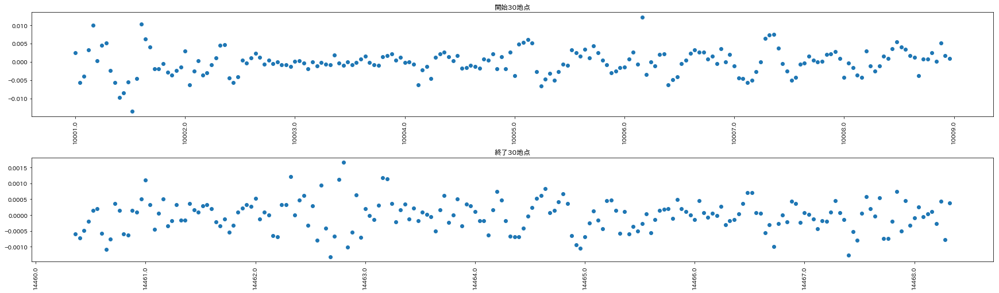

In [84]:
summ = summarys['B']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["傾き"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["傾き"], "o")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

array([10125., 10126., 10127., 10128., 10129., 10130., 10131., 10132.,
       10133., 10134.])

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10125.0'),
 Text(0, 0, '10126.0'),
 Text(0, 0, '10127.0'),
 Text(0, 0, '10128.0'),
 Text(0, 0, '10129.0'),
 Text(0, 0, '10130.0'),
 Text(0, 0, '10131.0')]

Text(0, 0.5, '')

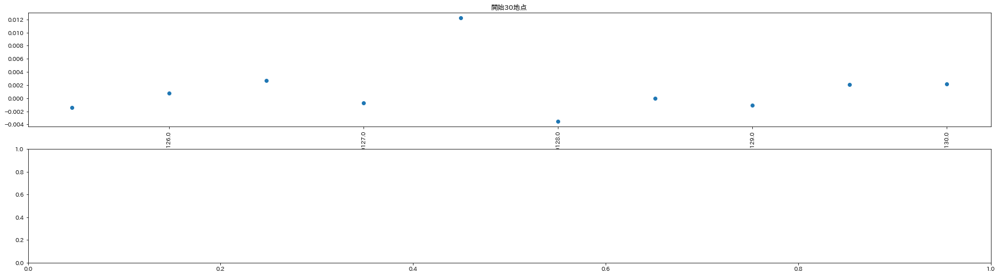

In [91]:
summ = summarys['B']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[125:135]
start30_kiros
summ1 = summ[summ["キロ程"].isin(start30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["傾き"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

In [102]:
summ = summarys['B']
kilos = range(10125, 10135)
for i, kilo in enumerate(kilos):
    summ[summ['キロ程'] == kilo]

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
125,B,10125.0,-0.001406,-2.71,2.228053,245.0,30.0,1,0,1,0,0,9.223,320,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
126,B,10126.0,0.000725,-2.86,1.383109,245.0,32.0,1,0,1,0,0,9.223,320,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
127,B,10127.0,0.002675,-1.65,0.412365,246.0,30.0,1,0,1,0,0,9.223,320,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
128,B,10128.0,-0.000715,0.46,1.500089,245.0,29.0,1,0,1,0,0,9.223,320,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
129,B,10129.0,0.012246,2.83,2.374364,245.0,27.0,1,0,1,0,0,9.223,320,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
130,B,10130.0,-0.003491,4.215,2.476443,244.0,30.0,1,0,2,0,0,9.223,320,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
131,B,10131.0,-0.00004,3.99,1.907318,245.0,38.0,1,0,1,0,0,9.223,320,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
132,B,10132.0,-0.001093,2.11,1.195446,244.0,37.0,1,0,1,0,0,9.223,320,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
133,B,10133.0,0.002069,-0.57,0.927388,246.0,31.0,1,0,1,0,0,9.223,320,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
134,B,10134.0,0.002171,-2.72,0.760107,243.0,30.0,1,0,1,0,0,9.223,320,0


Text(0.5, 1.0, '10125')

Text(0.5, 1.0, '10126')

Text(0.5, 1.0, '10127')

Text(0.5, 1.0, '10128')

Text(0.5, 1.0, '10129')

Text(0.5, 1.0, '10130')

Text(0.5, 1.0, '10131')

Text(0.5, 1.0, '10132')

Text(0.5, 1.0, '10133')

Text(0.5, 1.0, '10134')

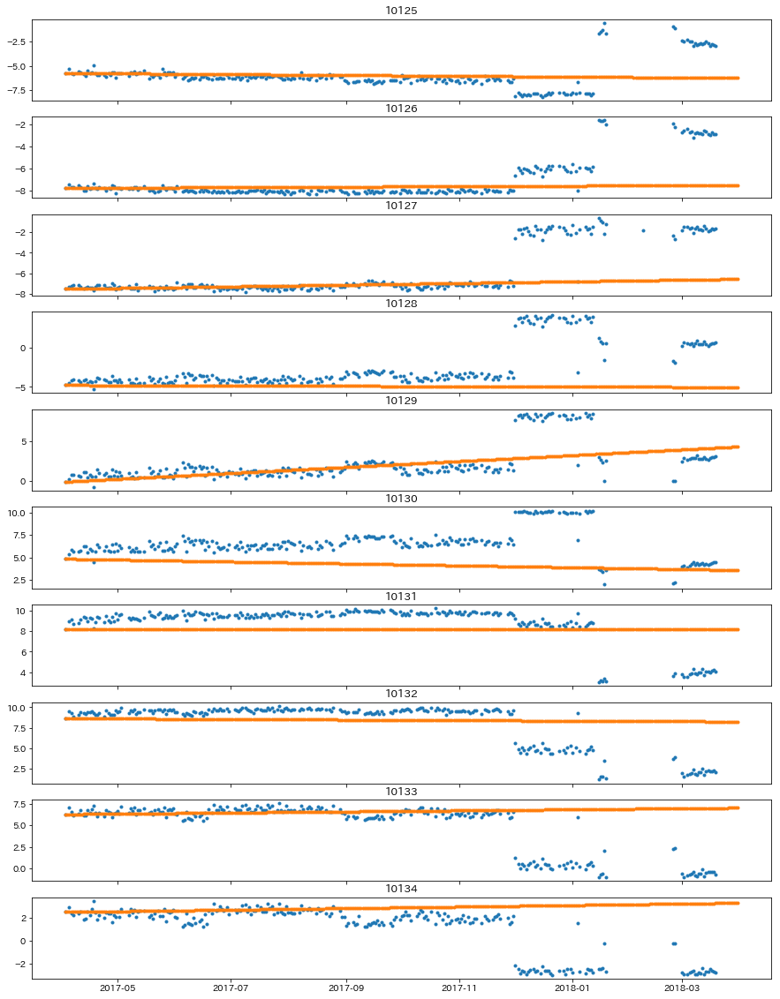

In [118]:
fig, axes = plt.subplots(10, 1, figsize=(15, 20), sharex=True)
track = tracks['B']
summary = summarys['B']
kilos = range(10125, 10135)
for i, kilo in enumerate(kilos):
    day = track[track['キロ程'] == kilo]['date']
    koutei = track[track['キロ程'] == kilo]['高低左']
    axes[i].plot(day, koutei, marker='.', linewidth=0)

    koutei_0 = track[track['キロ程'] == kilo]['高低左'].values[0]
    slope = summary[summary['キロ程'] == kilo]['傾き'].values[0]
    koutei_x = []
    for j in range(363):
        koutei_x.append(koutei_0 + slope*j)
    axes[i].plot(day, koutei_x, marker='.', linewidth=0)

    axes[i].set_title(f'{kilo}')

Text(0.5, 1.0, '10000')

Text(0.5, 1.0, '10001')

Text(0.5, 1.0, '10002')

Text(0.5, 1.0, '10003')

Text(0.5, 1.0, '10004')

Text(0.5, 1.0, '10005')

Text(0.5, 1.0, '10006')

Text(0.5, 1.0, '10007')

Text(0.5, 1.0, '10008')

Text(0.5, 1.0, '10009')

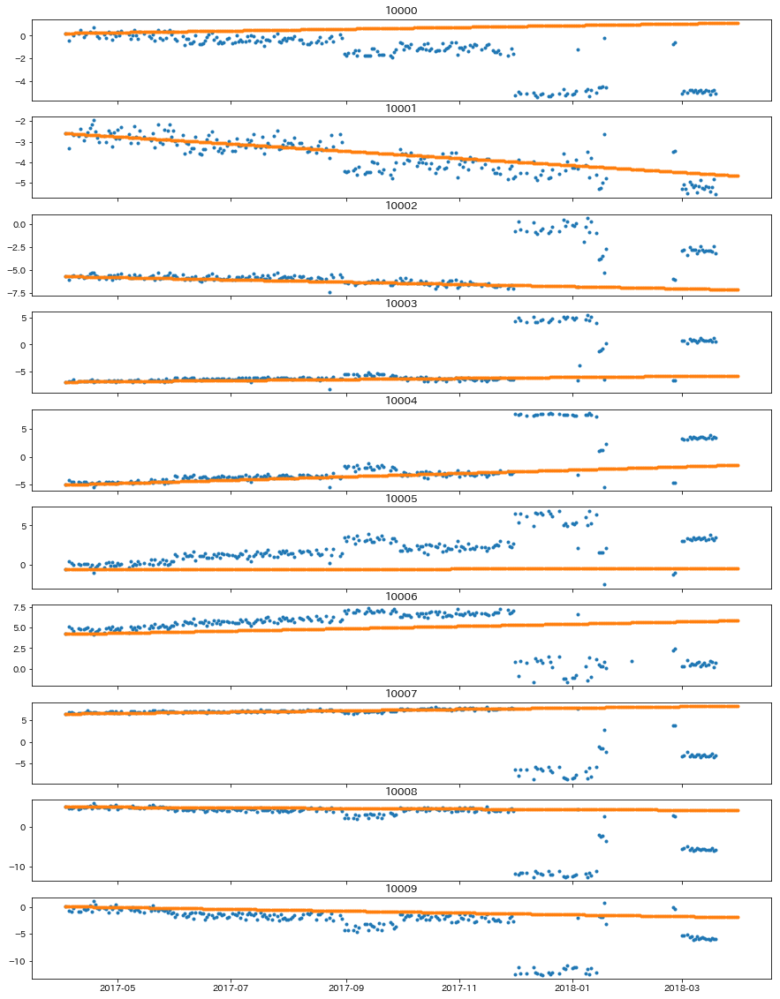

In [127]:
fig, axes = plt.subplots(10, 1, figsize=(15, 20), sharex=True)
track = tracks['B']
summary = summarys['B']
kilos = range(10000, 10010)
for i, kilo in enumerate(kilos):
    day = track[track['キロ程'] == kilo]['date']
    koutei = track[track['キロ程'] == kilo]['高低左']
    axes[i].plot(day, koutei, marker='.', linewidth=0)

    koutei_0 = track[track['キロ程'] == kilo]['高低左'].values[0]
    slope = summary[summary['キロ程'] == kilo]['傾き'].values[0]
    koutei_x = []
    for j in range(363):
        koutei_x.append(koutei_0 + slope*j)
    axes[i].plot(day, koutei_x, marker='.', linewidth=0)

    axes[i].set_title(f'{kilo}')

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '20125.0'),
 Text(0, 0, '20126.0'),
 Text(0, 0, '20127.0'),
 Text(0, 0, '20128.0'),
 Text(0, 0, '20129.0'),
 Text(0, 0, '20130.0'),
 Text(0, 0, '20131.0'),
 Text(0, 0, '20132.0'),
 Text(0, 0, '20133.0'),
 Text(0, 0, '20134.0'),
 Text(0, 0, '20135.0')]

Text(0, 0.5, '')

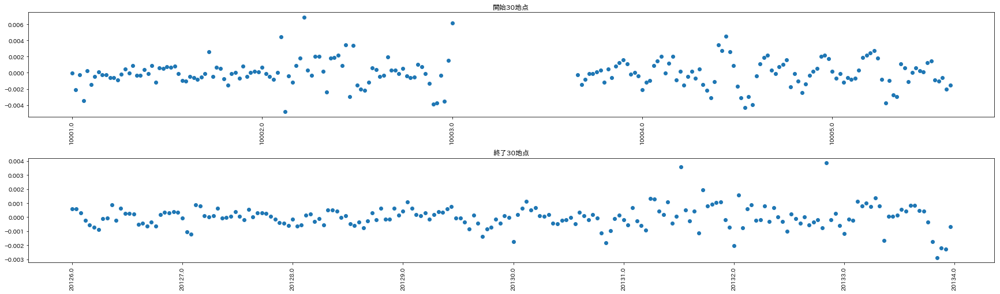

In [85]:
summ = summarys['C']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["傾き"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["傾き"], "o")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0'),
 Text(0, 0, '10007.0'),
 Text(0, 0, '10008.0'),
 Text(0, 0, '10009.0'),
 Text(0, 0, '10010.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '21139.0'),
 Text(0, 0, '21140.0'),
 Text(0, 0, '21141.0'),
 Text(0, 0, '21142.0'),
 Text(0, 0, '21143.0'),
 Text(0, 0, '21144.0'),
 Text(0, 0, '21145.0'),
 Text(0, 0, '21146.0'),
 Text(0, 0, '21147.0'),
 Text(0, 0, '21148.0')]

Text(0, 0.5, '')

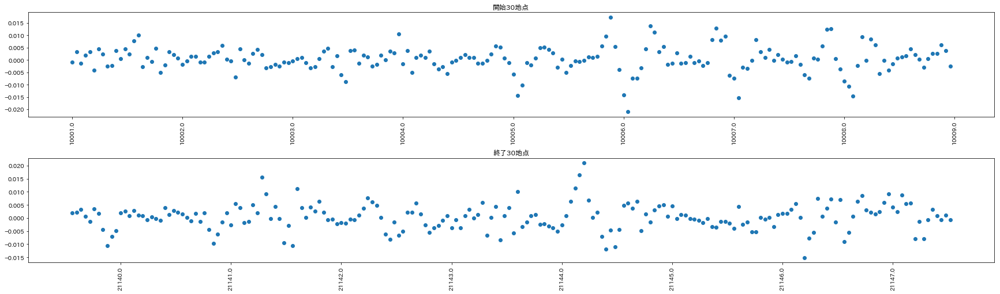

In [86]:
summ = summarys['D']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["傾き"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["傾き"], "o")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '20538.0'),
 Text(0, 0, '20539.0'),
 Text(0, 0, '20540.0'),
 Text(0, 0, '20541.0'),
 Text(0, 0, '20542.0'),
 Text(0, 0, '20543.0'),
 Text(0, 0, '20544.0'),
 Text(0, 0, '20545.0'),
 Text(0, 0, '20546.0'),
 Text(0, 0, '20547.0')]

Text(0, 0.5, '')

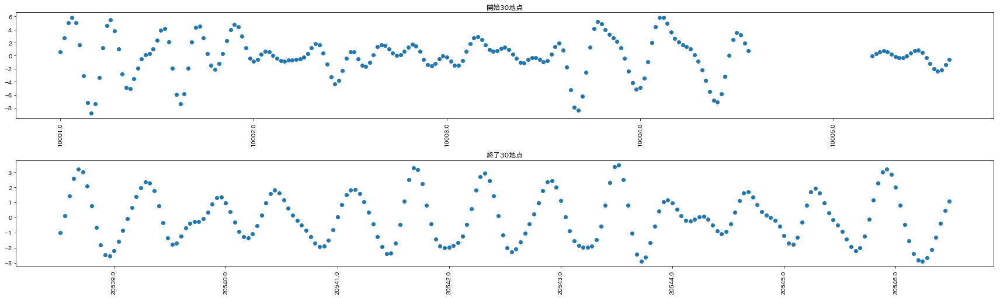

In [128]:
summ = summarys['A']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["切片"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["切片"], "o")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

array([10070., 10071., 10072., 10073., 10074., 10075., 10076., 10077.,
       10078., 10079.])

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10070.0'),
 Text(0, 0, '10071.0'),
 Text(0, 0, '10072.0'),
 Text(0, 0, '10073.0'),
 Text(0, 0, '10074.0'),
 Text(0, 0, '10075.0'),
 Text(0, 0, '10076.0')]

Text(0, 0.5, '')

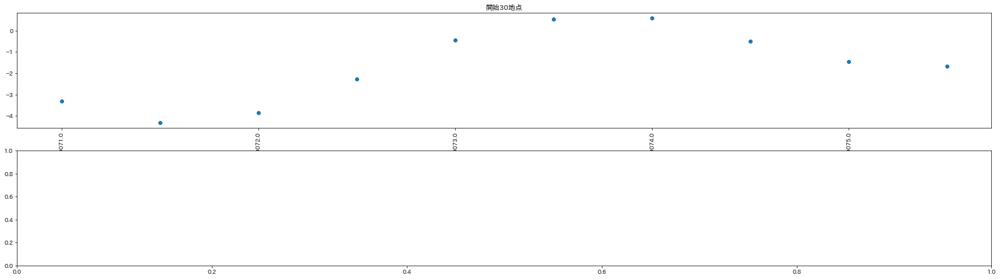

In [129]:
summ = summarys['A']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[70:80]
start30_kiros
summ1 = summ[summ["キロ程"].isin(start30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["切片"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

In [130]:
summ = summarys['A']
kilos = range(10050, 10080)
for i, kilo in enumerate(kilos):
    summ[summ['キロ程'] == kilo]

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
50,A,10050.0,0.002825,-0.83,1.32515,295.0,21.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
51,A,10051.0,0.002205,-0.555,0.968637,296.0,31.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
52,A,10052.0,0.00321,0.24,0.636019,296.0,28.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
53,A,10053.0,0.000927,0.7,0.702221,298.0,27.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
54,A,10054.0,-0.000115,0.6,0.642585,300.0,40.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
55,A,10055.0,0.00009,0.08,0.366979,299.0,29.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
56,A,10056.0,0.000213,-0.38,0.611275,298.0,32.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
57,A,10057.0,0.000247,-0.74,0.991984,296.0,34.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
58,A,10058.0,-0.000034,-0.84,1.000284,297.0,31.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
59,A,10059.0,-0.000502,-0.71,0.61718,293.0,52.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
60,A,10060.0,-0.001168,-0.67,0.515469,294.0,35.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
61,A,10061.0,-0.001761,-0.61,1.440701,292.0,33.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
62,A,10062.0,-0.000664,-0.54,2.012639,292.0,30.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
63,A,10063.0,-0.000048,-0.26,1.965655,293.0,37.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
64,A,10064.0,0.000405,0.34,1.454671,292.0,45.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
65,A,10065.0,0.000431,1.16,1.260611,293.0,32.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
66,A,10066.0,0.000582,1.81,1.660799,292.0,36.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
67,A,10067.0,0.00082,1.65,1.765846,293.0,29.0,1,0,2,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
68,A,10068.0,0.002369,0.405,1.181116,292.0,29.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
69,A,10069.0,0.004085,-1.265,0.669006,292.0,27.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
70,A,10070.0,0.005665,-3.31,1.610897,294.0,54.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
71,A,10071.0,0.005053,-4.31,2.135122,289.0,55.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
72,A,10072.0,0.000246,-3.85,2.01218,290.0,55.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
73,A,10073.0,-0.004508,-2.27,1.443049,284.0,44.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
74,A,10074.0,-0.008087,-0.45,1.36585,283.0,39.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
75,A,10075.0,-0.010507,0.54,1.522013,280.0,33.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
76,A,10076.0,-0.00907,0.595,1.351946,280.0,27.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
77,A,10077.0,-0.003898,-0.5,0.896778,276.0,25.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
78,A,10078.0,-0.001046,-1.46,1.003415,275.0,29.0,1,0,1,0,0,13.607,3200,0


,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
79,A,10079.0,0.002893,-1.67,1.176103,275.0,33.0,1,0,1,0,0,13.607,3200,0


Text(0.5, 1.0, '10070')

Text(0.5, 1.0, '10071')

Text(0.5, 1.0, '10072')

Text(0.5, 1.0, '10073')

Text(0.5, 1.0, '10074')

Text(0.5, 1.0, '10075')

Text(0.5, 1.0, '10076')

Text(0.5, 1.0, '10077')

Text(0.5, 1.0, '10078')

Text(0.5, 1.0, '10079')

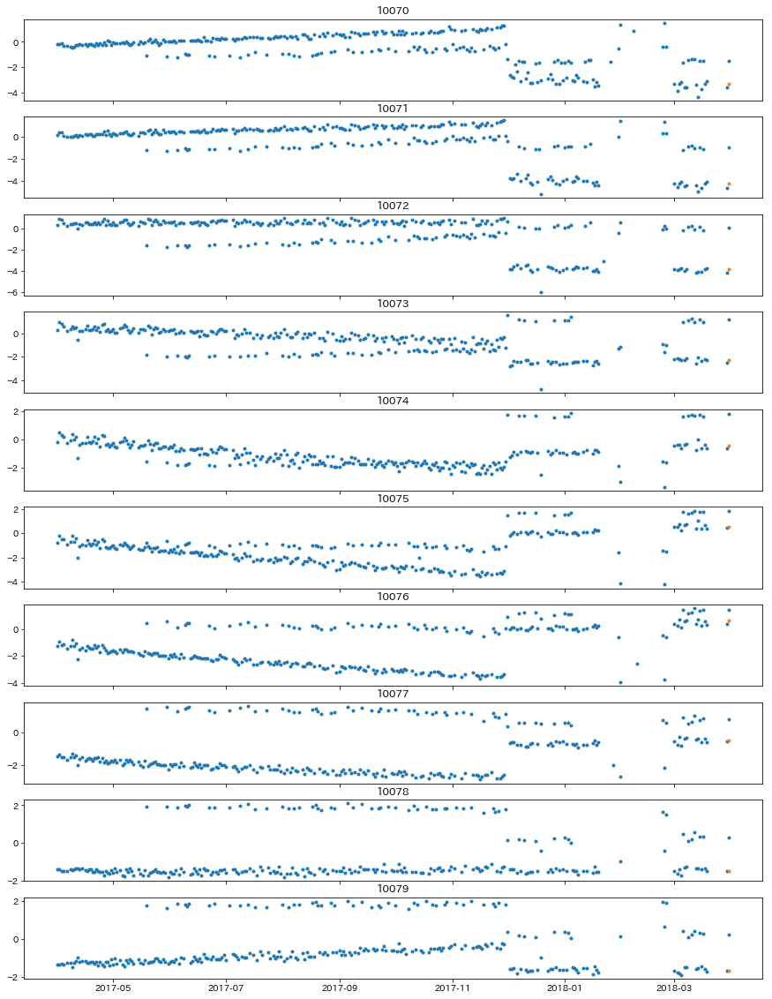

In [137]:
fig, axes = plt.subplots(10, 1, figsize=(15, 20), sharex=True)
track = tracks['A']
summary = summarys['A']
kilos = range(10070, 10080)
for i, kilo in enumerate(kilos):
    day = track[track['キロ程'] == kilo]['date']
    koutei = track[track['キロ程'] == kilo]['高低左']
    axes[i].plot(day, koutei, marker='.', linewidth=0)

    inter = summary[summary['キロ程'] == kilo]['切片'].values
    axes[i].plot(day.values[-1], inter, marker='.', linewidth=0)

    axes[i].set_title(f'{kilo}')

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0'),
 Text(0, 0, '10007.0'),
 Text(0, 0, '10008.0'),
 Text(0, 0, '10009.0'),
 Text(0, 0, '10010.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '14459.0'),
 Text(0, 0, '14460.0'),
 Text(0, 0, '14461.0'),
 Text(0, 0, '14462.0'),
 Text(0, 0, '14463.0'),
 Text(0, 0, '14464.0'),
 Text(0, 0, '14465.0'),
 Text(0, 0, '14466.0'),
 Text(0, 0, '14467.0'),
 Text(0, 0, '14468.0'),
 Text(0, 0, '14469.0')]

Text(0, 0.5, '')

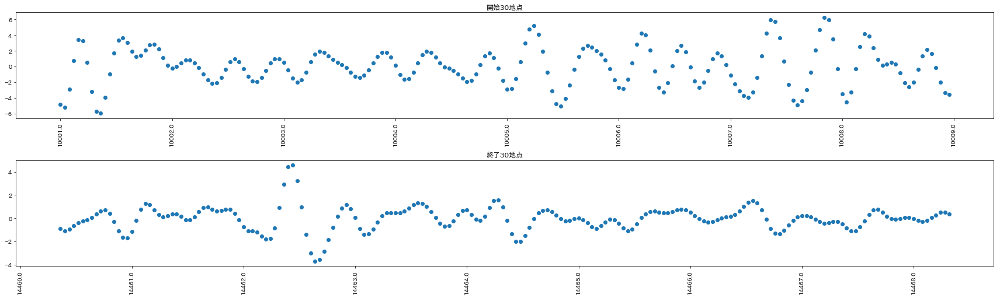

In [138]:
summ = summarys['B']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["切片"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["切片"], "o")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '20125.0'),
 Text(0, 0, '20126.0'),
 Text(0, 0, '20127.0'),
 Text(0, 0, '20128.0'),
 Text(0, 0, '20129.0'),
 Text(0, 0, '20130.0'),
 Text(0, 0, '20131.0'),
 Text(0, 0, '20132.0'),
 Text(0, 0, '20133.0'),
 Text(0, 0, '20134.0'),
 Text(0, 0, '20135.0')]

Text(0, 0.5, '')

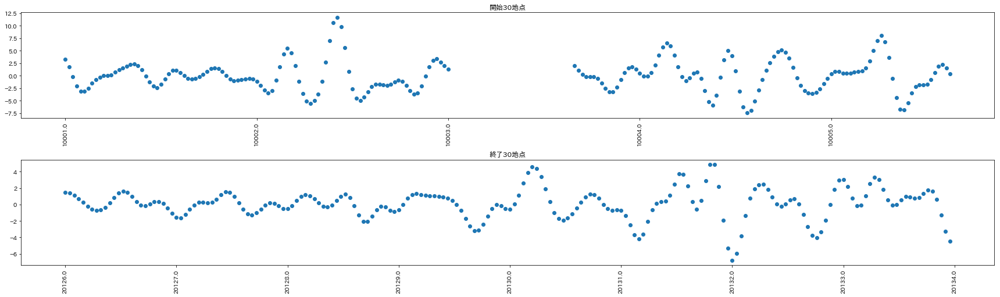

In [139]:
summ = summarys['C']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["切片"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["切片"], "o")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0'),
 Text(0, 0, '10007.0'),
 Text(0, 0, '10008.0'),
 Text(0, 0, '10009.0'),
 Text(0, 0, '10010.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '21139.0'),
 Text(0, 0, '21140.0'),
 Text(0, 0, '21141.0'),
 Text(0, 0, '21142.0'),
 Text(0, 0, '21143.0'),
 Text(0, 0, '21144.0'),
 Text(0, 0, '21145.0'),
 Text(0, 0, '21146.0'),
 Text(0, 0, '21147.0'),
 Text(0, 0, '21148.0')]

Text(0, 0.5, '')

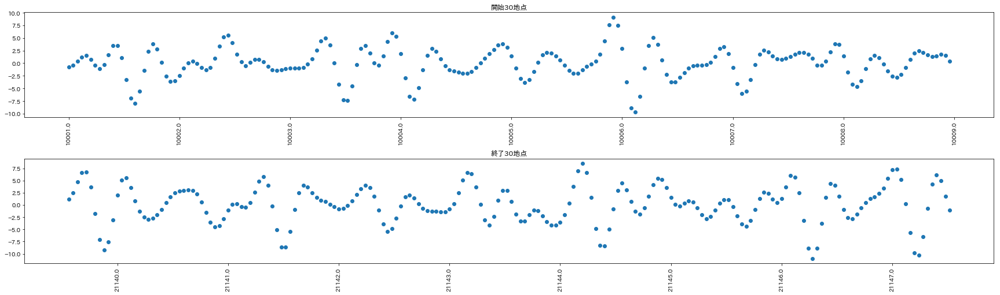

In [140]:
summ = summarys['D']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["切片"], 'o')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["切片"], "o")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '20538.0'),
 Text(0, 0, '20539.0'),
 Text(0, 0, '20540.0'),
 Text(0, 0, '20541.0'),
 Text(0, 0, '20542.0'),
 Text(0, 0, '20543.0'),
 Text(0, 0, '20544.0'),
 Text(0, 0, '20545.0'),
 Text(0, 0, '20546.0'),
 Text(0, 0, '20547.0')]

Text(0, 0.5, '')

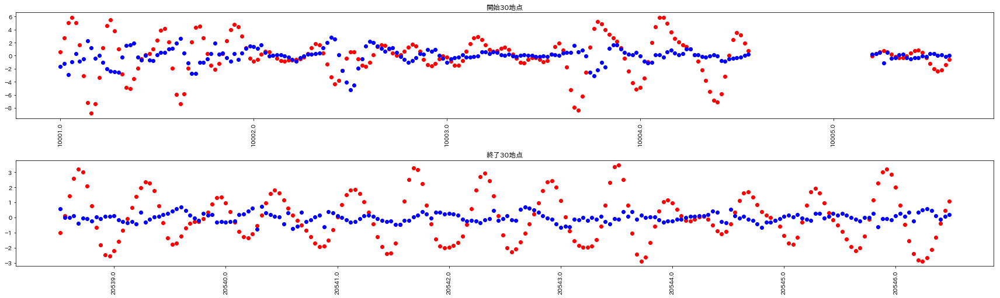

In [147]:
summ = summarys['A']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["切片"], 'ro')
axes[0].plot(summ1["キロ程"], summ1["傾き"]*500, 'bo')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["切片"], "ro")
axes[1].plot(summ2["キロ程"], summ2["傾き"]*500, "bo")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0'),
 Text(0, 0, '10007.0'),
 Text(0, 0, '10008.0'),
 Text(0, 0, '10009.0'),
 Text(0, 0, '10010.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '14459.0'),
 Text(0, 0, '14460.0'),
 Text(0, 0, '14461.0'),
 Text(0, 0, '14462.0'),
 Text(0, 0, '14463.0'),
 Text(0, 0, '14464.0'),
 Text(0, 0, '14465.0'),
 Text(0, 0, '14466.0'),
 Text(0, 0, '14467.0'),
 Text(0, 0, '14468.0'),
 Text(0, 0, '14469.0')]

Text(0, 0.5, '')

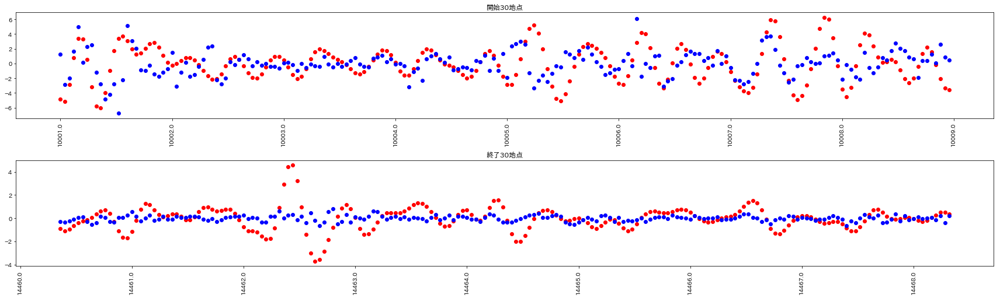

In [149]:
summ = summarys['B']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["切片"], 'ro')
axes[0].plot(summ1["キロ程"], summ1["傾き"]*500, 'bo')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["切片"], "ro")
axes[1].plot(summ2["キロ程"], summ2["傾き"]*500, "bo")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '20125.0'),
 Text(0, 0, '20126.0'),
 Text(0, 0, '20127.0'),
 Text(0, 0, '20128.0'),
 Text(0, 0, '20129.0'),
 Text(0, 0, '20130.0'),
 Text(0, 0, '20131.0'),
 Text(0, 0, '20132.0'),
 Text(0, 0, '20133.0'),
 Text(0, 0, '20134.0'),
 Text(0, 0, '20135.0')]

Text(0, 0.5, '')

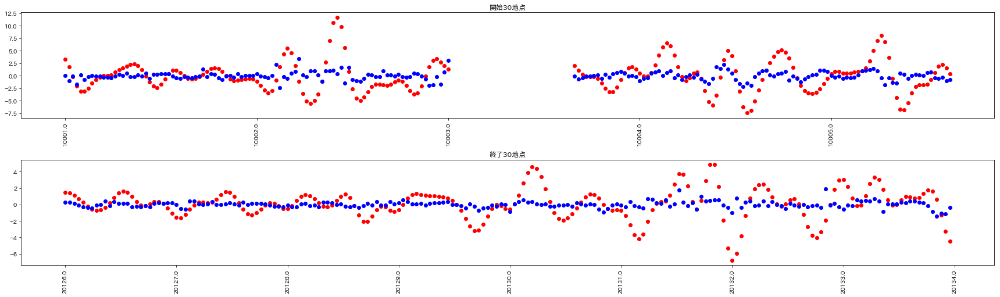

In [150]:
summ = summarys['C']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["切片"], 'ro')
axes[0].plot(summ1["キロ程"], summ1["傾き"]*500, 'bo')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["切片"], "ro")
axes[1].plot(summ2["キロ程"], summ2["傾き"]*500, "bo")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000.0'),
 Text(0, 0, '10001.0'),
 Text(0, 0, '10002.0'),
 Text(0, 0, '10003.0'),
 Text(0, 0, '10004.0'),
 Text(0, 0, '10005.0'),
 Text(0, 0, '10006.0'),
 Text(0, 0, '10007.0'),
 Text(0, 0, '10008.0'),
 Text(0, 0, '10009.0'),
 Text(0, 0, '10010.0')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '21139.0'),
 Text(0, 0, '21140.0'),
 Text(0, 0, '21141.0'),
 Text(0, 0, '21142.0'),
 Text(0, 0, '21143.0'),
 Text(0, 0, '21144.0'),
 Text(0, 0, '21145.0'),
 Text(0, 0, '21146.0'),
 Text(0, 0, '21147.0'),
 Text(0, 0, '21148.0')]

Text(0, 0.5, '')

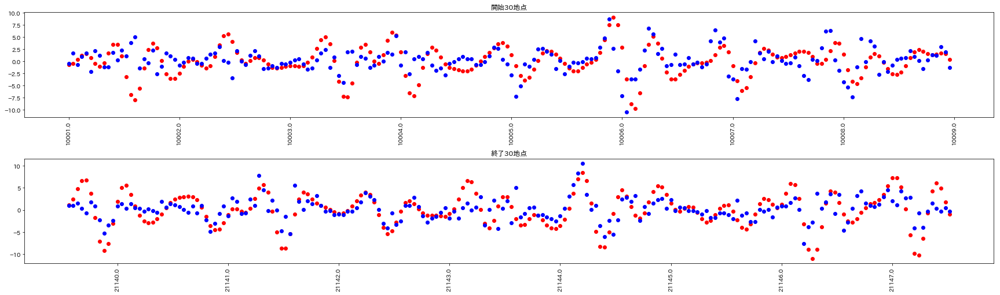

In [146]:
summ = summarys['D']

fig, axes = plt.subplots(2,1,figsize=(30,8))
start30_kiros = summ["キロ程"].unique()[:200]
end30_kiros = summ["キロ程"].unique()[10000:10200]

summ1 = summ[summ["キロ程"].isin(start30_kiros)]
summ2 = summ[summ["キロ程"].isin(end30_kiros)]

axes[0].plot(summ1["キロ程"], summ1["切片"], 'ro')
axes[0].plot(summ1["キロ程"], summ1["傾き"]*500, 'bo')
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

axes[1].plot(summ2["キロ程"], summ2["切片"], "ro")
axes[1].plot(summ2["キロ程"], summ2["傾き"]*500, "bo")
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4)

# 高低右、水準から予測できないか

In [157]:
track = tracks['A']
track['高低左'] = track['高低左'].fillna(100)
track[track['高低左'] == 100].describe()

,キロ程,高低左,高低右,通り左,通り右,水準,軌間,速度
count,2.714747e+06,2714747.0,24403.000000,0.0,0.0,0.0,0.0,522743.000000
mean,2.489879e+04,100.0,-0.006859,NaN,NaN,NaN,NaN,62.888478
std,7.846223e+03,0.0,1.926482,NaN,NaN,NaN,NaN,19.919754
min,1.000000e+04,100.0,-21.490000,NaN,NaN,NaN,NaN,0.000000
25%,1.819800e+04,100.0,-0.910000,NaN,NaN,NaN,NaN,47.000000
50%,2.571100e+04,100.0,0.010000,NaN,NaN,NaN,NaN,63.000000
75%,3.183200e+04,100.0,0.910000,NaN,NaN,NaN,NaN,80.000000
max,3.790500e+04,100.0,17.240000,NaN,NaN,NaN,NaN,99.730000


In [158]:
track = tracks['B']
track['高低左'] = track['高低左'].fillna(100)
track[track['高低左'] == 100].describe()

,キロ程,高低左,高低右,通り左,通り右,水準,軌間,速度
count,3.500157e+06,3500157.0,9460.000000,963.0,0.0,0.0,0.0,307326.000000
mean,2.123563e+04,100.0,-0.002648,0.0,NaN,NaN,NaN,59.624455
std,6.089350e+03,0.0,2.173339,0.0,NaN,NaN,NaN,20.580188
min,1.000000e+04,100.0,-14.490000,0.0,NaN,NaN,NaN,0.100000
25%,1.635900e+04,100.0,-0.970000,0.0,NaN,NaN,NaN,47.000000
50%,2.135600e+04,100.0,0.040000,0.0,NaN,NaN,NaN,63.000000
75%,2.642600e+04,100.0,0.970000,0.0,NaN,NaN,NaN,77.000000
max,3.153000e+04,100.0,15.240000,0.0,NaN,NaN,NaN,95.200000


In [159]:
track = tracks['C']
track['高低左'] = track['高低左'].fillna(100)
track[track['高低左'] == 100].describe()

,キロ程,高低左,高低右,通り左,通り右,水準,軌間,速度
count,8.962554e+06,8962554.0,12859.000000,0.0,0.0,0.0,0.0,693650.000000
mean,3.765992e+04,100.0,-0.032408,NaN,NaN,NaN,NaN,79.227198
std,1.594207e+04,0.0,2.276376,NaN,NaN,NaN,NaN,23.216392
min,1.000000e+04,100.0,-13.480000,NaN,NaN,NaN,NaN,0.040000
25%,2.383700e+04,100.0,-1.110000,NaN,NaN,NaN,NaN,61.310000
50%,3.761600e+04,100.0,-0.010000,NaN,NaN,NaN,NaN,83.710000
75%,5.120300e+04,100.0,1.090000,NaN,NaN,NaN,NaN,99.150000
max,6.568300e+04,100.0,14.600000,NaN,NaN,NaN,NaN,113.790000


In [160]:
track = tracks['D']
track['高低左'] = track['高低左'].fillna(100)
track[track['高低左'] == 100].describe()

,キロ程,高低左,高低右,通り左,通り右,水準,軌間,速度
count,2.512537e+06,2512537.0,4023.000000,0.0,0.0,0.0,0.0,381644.000000
mean,1.787838e+04,100.0,-0.193699,NaN,NaN,NaN,NaN,57.732969
std,4.508538e+03,0.0,3.325019,NaN,NaN,NaN,NaN,23.431153
min,1.000000e+04,100.0,-17.640000,NaN,NaN,NaN,NaN,0.080000
25%,1.384900e+04,100.0,-1.780000,NaN,NaN,NaN,NaN,38.000000
50%,1.803700e+04,100.0,-0.020000,NaN,NaN,NaN,NaN,59.440000
75%,2.167500e+04,100.0,1.630000,NaN,NaN,NaN,NaN,79.360000
max,2.569000e+04,100.0,14.280000,NaN,NaN,NaN,NaN,102.820000


In [162]:
tracks={}
for no in ['A','B','C','D']:
    tracks[no] = pd.read_csv("dataset/track_" + no + ".csv", parse_dates=["date"])

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000'),
 Text(0, 0, '10001'),
 Text(0, 0, '10002'),
 Text(0, 0, '10003'),
 Text(0, 0, '10004'),
 Text(0, 0, '10005'),
 Text(0, 0, '10006'),
 Text(0, 0, '10007'),
 Text(0, 0, '10008'),
 Text(0, 0, '10009'),
 Text(0, 0, '10010'),
 Text(0, 0, '10011'),
 Text(0, 0, '10012'),
 Text(0, 0, '10013'),
 Text(0, 0, '10014'),
 Text(0, 0, '10015'),
 Text(0, 0, '10016'),
 Text(0, 0, '10017'),
 Text(0, 0, '10018'),
 Text(0, 0, '10019'),
 Text(0, 0, '10020'),
 Text(0, 0, '10021'),
 Text(0, 0, '10022'),
 Text(0, 0, '10023'),
 Text(0, 0, '10024'),
 Text(0, 0, '10025'),
 Text(0, 0, '10026'),
 Text(0, 0, '10027'),
 Text(0, 0, '10028'),
 Text(0, 0, '10029')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '37876'),
 Text(0, 0, '37877'),
 Text(0, 0, '37878'),
 Text(0, 0, '37879'),
 Text(0, 0, '37880'),
 Text(0, 0, '37881'),
 Text(0, 0, '37882'),
 Text(0, 0, '37883'),
 Text(0, 0, '37884'),
 Text(0, 0, '37885'),
 Text(0, 0, '37886'),
 Text(0, 0, '37887'),
 Text(0, 0, '37888'),
 Text(0, 0, '37889'),
 Text(0, 0, '37890'),
 Text(0, 0, '37891'),
 Text(0, 0, '37892'),
 Text(0, 0, '37893'),
 Text(0, 0, '37894'),
 Text(0, 0, '37895'),
 Text(0, 0, '37896'),
 Text(0, 0, '37897'),
 Text(0, 0, '37898'),
 Text(0, 0, '37899'),
 Text(0, 0, '37900'),
 Text(0, 0, '37901'),
 Text(0, 0, '37902'),
 Text(0, 0, '37903'),
 Text(0, 0, '37904'),
 Text(0, 0, '37905')]

Text(0, 0.5, '')

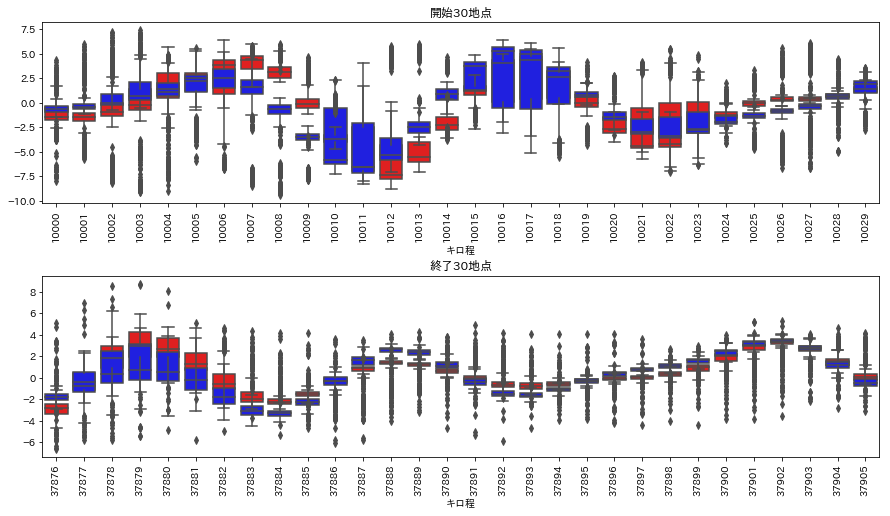

In [164]:
track = tracks["A"]

fig, axes = plt.subplots(2,1,figsize=(15,8))
start30_kiros = track["キロ程"].unique()[:30]
end30_kiros = track["キロ程"].unique()[-30:]

track1 = track[track["キロ程"].isin(start30_kiros)]
track2 = track[track["キロ程"].isin(end30_kiros)]

sns.boxplot(x = "キロ程", y="高低左",data=track1, color="r", ax=axes[0])
sns.boxplot(x = "キロ程", y="高低右",data=track1, color="b", ax=axes[0])
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

sns.boxplot(x = "キロ程", y="高低左",data=track2, color="r", ax=axes[1])
sns.boxplot(x = "キロ程", y="高低右",data=track2, color="b", ax=axes[1])
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4) 

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000'),
 Text(0, 0, '10001'),
 Text(0, 0, '10002'),
 Text(0, 0, '10003'),
 Text(0, 0, '10004'),
 Text(0, 0, '10005'),
 Text(0, 0, '10006'),
 Text(0, 0, '10007'),
 Text(0, 0, '10008'),
 Text(0, 0, '10009'),
 Text(0, 0, '10010'),
 Text(0, 0, '10011'),
 Text(0, 0, '10012'),
 Text(0, 0, '10013'),
 Text(0, 0, '10014'),
 Text(0, 0, '10015'),
 Text(0, 0, '10016'),
 Text(0, 0, '10017'),
 Text(0, 0, '10018'),
 Text(0, 0, '10019'),
 Text(0, 0, '10020'),
 Text(0, 0, '10021'),
 Text(0, 0, '10022'),
 Text(0, 0, '10023'),
 Text(0, 0, '10024'),
 Text(0, 0, '10025'),
 Text(0, 0, '10026'),
 Text(0, 0, '10027'),
 Text(0, 0, '10028'),
 Text(0, 0, '10029')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '31501'),
 Text(0, 0, '31502'),
 Text(0, 0, '31503'),
 Text(0, 0, '31504'),
 Text(0, 0, '31505'),
 Text(0, 0, '31506'),
 Text(0, 0, '31507'),
 Text(0, 0, '31508'),
 Text(0, 0, '31509'),
 Text(0, 0, '31510'),
 Text(0, 0, '31511'),
 Text(0, 0, '31512'),
 Text(0, 0, '31513'),
 Text(0, 0, '31514'),
 Text(0, 0, '31515'),
 Text(0, 0, '31516'),
 Text(0, 0, '31517'),
 Text(0, 0, '31518'),
 Text(0, 0, '31519'),
 Text(0, 0, '31520'),
 Text(0, 0, '31521'),
 Text(0, 0, '31522'),
 Text(0, 0, '31523'),
 Text(0, 0, '31524'),
 Text(0, 0, '31525'),
 Text(0, 0, '31526'),
 Text(0, 0, '31527'),
 Text(0, 0, '31528'),
 Text(0, 0, '31529'),
 Text(0, 0, '31530')]

Text(0, 0.5, '')

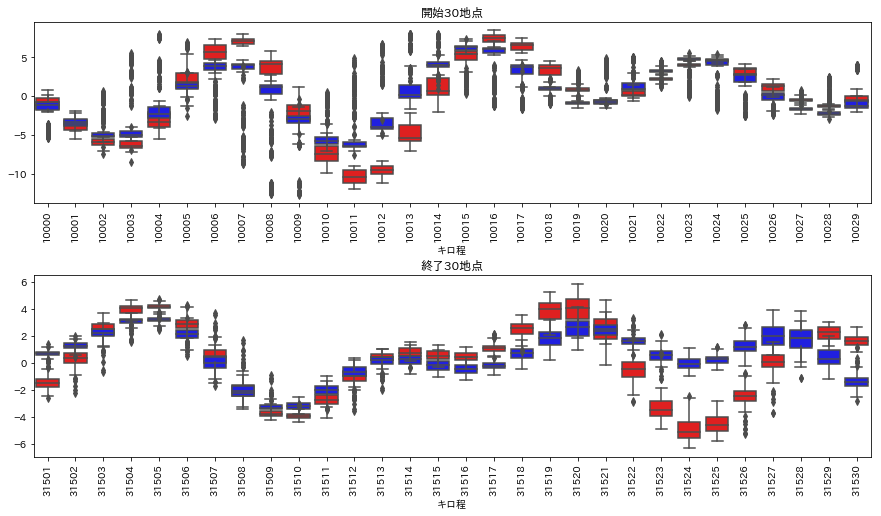

In [165]:
track = tracks["B"]

fig, axes = plt.subplots(2,1,figsize=(15,8))
start30_kiros = track["キロ程"].unique()[:30]
end30_kiros = track["キロ程"].unique()[-30:]

track1 = track[track["キロ程"].isin(start30_kiros)]
track2 = track[track["キロ程"].isin(end30_kiros)]

sns.boxplot(x = "キロ程", y="高低左",data=track1, color="r", ax=axes[0])
sns.boxplot(x = "キロ程", y="高低右",data=track1, color="b", ax=axes[0])
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

sns.boxplot(x = "キロ程", y="高低左",data=track2, color="r", ax=axes[1])
sns.boxplot(x = "キロ程", y="高低右",data=track2, color="b", ax=axes[1])
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4) 

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000'),
 Text(0, 0, '10001'),
 Text(0, 0, '10002'),
 Text(0, 0, '10003'),
 Text(0, 0, '10004'),
 Text(0, 0, '10005'),
 Text(0, 0, '10006'),
 Text(0, 0, '10007'),
 Text(0, 0, '10008'),
 Text(0, 0, '10009'),
 Text(0, 0, '10010'),
 Text(0, 0, '10011'),
 Text(0, 0, '10012'),
 Text(0, 0, '10013'),
 Text(0, 0, '10014'),
 Text(0, 0, '10015'),
 Text(0, 0, '10016'),
 Text(0, 0, '10017'),
 Text(0, 0, '10018'),
 Text(0, 0, '10019'),
 Text(0, 0, '10020'),
 Text(0, 0, '10021'),
 Text(0, 0, '10022'),
 Text(0, 0, '10023'),
 Text(0, 0, '10024'),
 Text(0, 0, '10025'),
 Text(0, 0, '10026'),
 Text(0, 0, '10027'),
 Text(0, 0, '10028'),
 Text(0, 0, '10029')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '65654'),
 Text(0, 0, '65655'),
 Text(0, 0, '65656'),
 Text(0, 0, '65657'),
 Text(0, 0, '65658'),
 Text(0, 0, '65659'),
 Text(0, 0, '65660'),
 Text(0, 0, '65661'),
 Text(0, 0, '65662'),
 Text(0, 0, '65663'),
 Text(0, 0, '65664'),
 Text(0, 0, '65665'),
 Text(0, 0, '65666'),
 Text(0, 0, '65667'),
 Text(0, 0, '65668'),
 Text(0, 0, '65669'),
 Text(0, 0, '65670'),
 Text(0, 0, '65671'),
 Text(0, 0, '65672'),
 Text(0, 0, '65673'),
 Text(0, 0, '65674'),
 Text(0, 0, '65675'),
 Text(0, 0, '65676'),
 Text(0, 0, '65677'),
 Text(0, 0, '65678'),
 Text(0, 0, '65679'),
 Text(0, 0, '65680'),
 Text(0, 0, '65681'),
 Text(0, 0, '65682'),
 Text(0, 0, '65683')]

Text(0, 0.5, '')

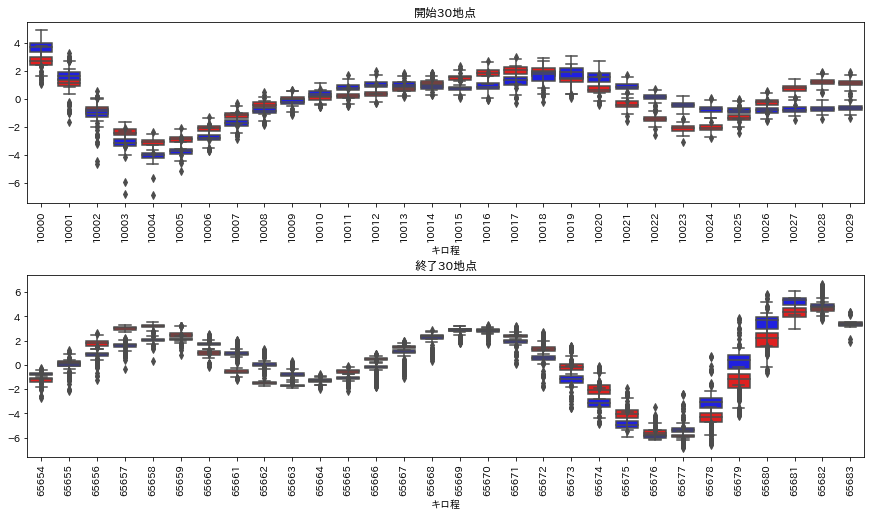

In [166]:
track = tracks["C"]

fig, axes = plt.subplots(2,1,figsize=(15,8))
start30_kiros = track["キロ程"].unique()[:30]
end30_kiros = track["キロ程"].unique()[-30:]

track1 = track[track["キロ程"].isin(start30_kiros)]
track2 = track[track["キロ程"].isin(end30_kiros)]

sns.boxplot(x = "キロ程", y="高低左",data=track1, color="r", ax=axes[0])
sns.boxplot(x = "キロ程", y="高低右",data=track1, color="b", ax=axes[0])
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

sns.boxplot(x = "キロ程", y="高低左",data=track2, color="r", ax=axes[1])
sns.boxplot(x = "キロ程", y="高低右",data=track2, color="b", ax=axes[1])
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4) 

Text(0.5, 1.0, '開始30地点')

[Text(0, 0, '10000'),
 Text(0, 0, '10001'),
 Text(0, 0, '10002'),
 Text(0, 0, '10003'),
 Text(0, 0, '10004'),
 Text(0, 0, '10005'),
 Text(0, 0, '10006'),
 Text(0, 0, '10007'),
 Text(0, 0, '10008'),
 Text(0, 0, '10009'),
 Text(0, 0, '10010'),
 Text(0, 0, '10011'),
 Text(0, 0, '10012'),
 Text(0, 0, '10013'),
 Text(0, 0, '10014'),
 Text(0, 0, '10015'),
 Text(0, 0, '10016'),
 Text(0, 0, '10017'),
 Text(0, 0, '10018'),
 Text(0, 0, '10019'),
 Text(0, 0, '10020'),
 Text(0, 0, '10021'),
 Text(0, 0, '10022'),
 Text(0, 0, '10023'),
 Text(0, 0, '10024'),
 Text(0, 0, '10025'),
 Text(0, 0, '10026'),
 Text(0, 0, '10027'),
 Text(0, 0, '10028'),
 Text(0, 0, '10029')]

Text(0, 0.5, '')

Text(0.5, 1.0, '終了30地点')

[Text(0, 0, '25661'),
 Text(0, 0, '25662'),
 Text(0, 0, '25663'),
 Text(0, 0, '25664'),
 Text(0, 0, '25665'),
 Text(0, 0, '25666'),
 Text(0, 0, '25667'),
 Text(0, 0, '25668'),
 Text(0, 0, '25669'),
 Text(0, 0, '25670'),
 Text(0, 0, '25671'),
 Text(0, 0, '25672'),
 Text(0, 0, '25673'),
 Text(0, 0, '25674'),
 Text(0, 0, '25675'),
 Text(0, 0, '25676'),
 Text(0, 0, '25677'),
 Text(0, 0, '25678'),
 Text(0, 0, '25679'),
 Text(0, 0, '25680'),
 Text(0, 0, '25681'),
 Text(0, 0, '25682'),
 Text(0, 0, '25683'),
 Text(0, 0, '25684'),
 Text(0, 0, '25685'),
 Text(0, 0, '25686'),
 Text(0, 0, '25687'),
 Text(0, 0, '25688'),
 Text(0, 0, '25689'),
 Text(0, 0, '25690')]

Text(0, 0.5, '')

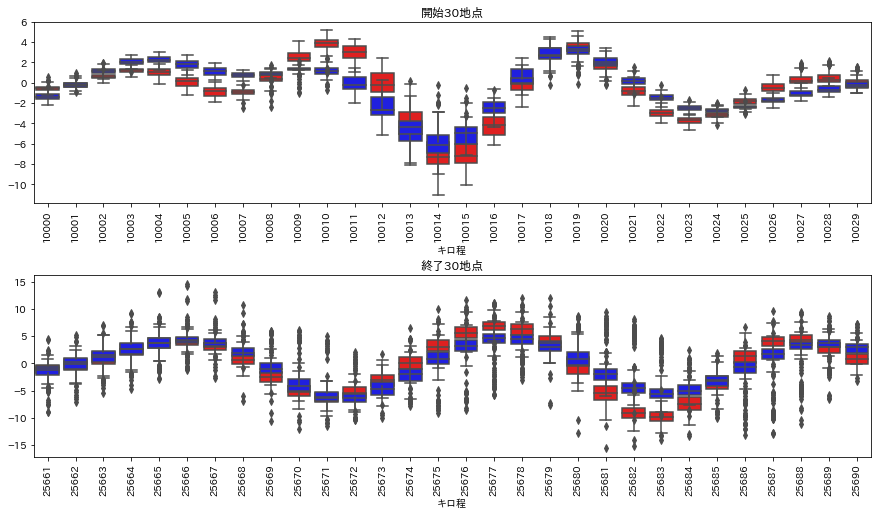

In [167]:
track = tracks["D"]

fig, axes = plt.subplots(2,1,figsize=(15,8))
start30_kiros = track["キロ程"].unique()[:30]
end30_kiros = track["キロ程"].unique()[-30:]

track1 = track[track["キロ程"].isin(start30_kiros)]
track2 = track[track["キロ程"].isin(end30_kiros)]

sns.boxplot(x = "キロ程", y="高低左",data=track1, color="r", ax=axes[0])
sns.boxplot(x = "キロ程", y="高低右",data=track1, color="b", ax=axes[0])
axes[0].set_title("開始30地点")
axes[0].set_xticklabels(start30_kiros, rotation='vertical')
axes[0].set_ylabel("")

sns.boxplot(x = "キロ程", y="高低左",data=track2, color="r", ax=axes[1])
sns.boxplot(x = "キロ程", y="高低右",data=track2, color="b", ax=axes[1])
axes[1].set_title("終了30地点")
axes[1].set_xticklabels(end30_kiros, rotation='vertical')
axes[1].set_ylabel("")

plt.subplots_adjust(left=None, bottom=None, top=None, wspace=0, hspace=0.4) 

# 曜日に規則性はないか

In [185]:
import datetime

In [173]:
jjj = tracks['A'].loc[tracks['A']['キロ程'] == 10001, ['date', '高低左']]
jjj.head()

,date,高低左
1,2017-04-01,-1.17
27907,2017-04-02,-0.83
55813,2017-04-03,-0.91
83719,2017-04-04,NaN
111625,2017-04-05,-0.71


In [211]:
jjj['高低の変化'] = jjj['高低左'].diff()
jjj

,date,高低左,曜日,高低の変化
1,2017-04-01,-1.17,5,NaN
27907,2017-04-02,-0.83,6,0.34
55813,2017-04-03,-0.91,0,-0.08
83719,2017-04-04,NaN,1,NaN
111625,2017-04-05,-0.71,2,NaN
139531,2017-04-06,-1.07,3,-0.36
167437,2017-04-07,-0.56,4,0.51
195343,2017-04-08,-0.98,5,-0.42
223249,2017-04-09,-0.82,6,0.16
251155,2017-04-10,-1.45,0,-0.63


In [208]:
jjj['曜日'] = [pd.to_datetime(jjj['date'].values[i]).weekday() for i in range(len(jjj))]

In [214]:
[pd.to_datetime(jjj['date'].values[i]).weekday() for i in range(len(jjj))]

[5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 0,
 1,
 2,


In [242]:
jjj['date'].apply(pd.to_datetime).apply(datetime.date.weekday)

1           5
27907       6
55813       0
83719       1
111625      2
139531      3
167437      4
195343      5
223249      6
251155      0
279061      1
306967      2
334873      3
362779      4
390685      5
418591      6
446497      0
474403      1
502309      2
530215      3
558121      4
586027      5
613933      6
641839      0
669745      1
697651      2
725557      3
753463      4
781369      5
809275      6
           ..
9348511     4
9376417     5
9404323     6
9432229     0
9460135     1
9488041     2
9515947     3
9543853     4
9571759     5
9599665     6
9627571     0
9655477     1
9683383     2
9711289     3
9739195     4
9767101     5
9795007     6
9822913     0
9850819     1
9878725     2
9906631     3
9934537     4
9962443     5
9990349     6
10018255    0
10046161    1
10074067    2
10101973    3
10129879    4
10157785    5
Name: date, Length: 365, dtype: int64

In [212]:
jjj.groupby('曜日').describe()

高低の変化                                                         高低左  \
   count      mean       std   min    25%    50%     75%   max count   
曜日                                                                     
0   31.0  0.318387  2.766950 -6.71 -0.520  0.100  1.2800  8.60  37.0   
1   30.0 -0.119333  3.538588 -7.33 -0.370 -0.165  0.3350  7.48  37.0   
2   33.0  0.140606  2.759875 -4.81 -1.160 -0.040  0.4600  8.68  40.0   
3   30.0 -0.434000  2.352657 -8.30 -0.675 -0.145  0.4600  2.98  36.0   
4   27.0  0.428519  2.878211 -7.60 -0.245  0.190  0.6050  5.80  36.0   
5   26.0 -0.490385  3.212802 -7.94 -0.555 -0.110  0.1825  6.06  36.0   
6   29.0 -0.006207  2.680374 -5.74 -0.990 -0.100  0.3400  8.00  38.0   

                                                           
        mean       std   min     25%    50%     75%   max  
曜日                                                         
0  -0.955676  2.240091 -4.42 -1.7500 -1.420 -1.0700  4.73  
1  -1.289730  2.298803 -5.45 -1.9200 -1.460 -1.1300  5.74  
2  -0.970000  2.304187 -4.60 -1.7350 -1.385 -0.8575  5.36  
3  -1.276667  2.187404 -5.29 -1.8975 -1.585 -1.1400  4.20  
4  -0.932500  2.101337 -4.91 -1.5900 -1.370 -1.0900  5.41  
5  -1.201667  2.286816 -5.13 -1.8875 -1.430 -1.0975  4.97  
6  -1.340263  2.399202 -4.90 -2.7800 -1.600 -0.8375  3.81

In [261]:
for no in ['A', 'B', 'C', 'D']:
    weekdays[no].to_csv(f'weekday_{no}.csv')

In [286]:
weekdays = {}
for no in tqdm(['A', 'B', 'C', 'D']):
    track = tracks[no]
    kilos = track['キロ程'].unique()#[:100]
    weekday = pd.DataFrame()
    for kilo in tqdm(kilos):
        %time tmp = track.loc[track['キロ程'] == kilo, ['date', '高低左']] # 50ms
        %time tmp = tmp.reset_index(drop=True) # 0.5ms
        %time tmp['高低の変化'] = tmp['高低左'].diff() # 1ms
        %time tmp['曜日'] = tmp['date'].apply(pd.to_datetime).apply(datetime.date.weekday) # 30ms
        %time weekday = pd.concat([weekday, tmp], axis=0) # 30ms
    weekday = weekday.reset_index(drop=True)
    weekdays[no] = weekday



  0%|          | 0/4 [00:00<?, ?it/s]


  0%|          | 0/27906 [00:00<?, ?it/s]


  0%|          | 2/27906 [00:00<25:42, 18.09it/s]


  0%|          | 6/27906 [00:00<21:57, 21.18it/s]

CPU times: user 21.5 ms, sys: 32.2 ms, total: 53.7 ms
Wall time: 64.9 ms
CPU times: user 284 µs, sys: 123 µs, total: 407 µs
Wall time: 391 µs
CPU times: user 665 µs, sys: 176 µs, total: 841 µs
Wall time: 819 µs
CPU times: user 4.47 ms, sys: 259 µs, total: 4.73 ms
Wall time: 4.66 ms
CPU times: user 1.09 ms, sys: 798 µs, total: 1.89 ms
Wall time: 1.8 ms
CPU times: user 16.3 ms, sys: 1.64 ms, total: 18 ms
Wall time: 15 ms
CPU times: user 260 µs, sys: 46 µs, total: 306 µs
Wall time: 292 µs
CPU times: user 597 µs, sys: 33 µs, total: 630 µs
Wall time: 611 µs
CPU times: user 4.43 ms, sys: 98 µs, total: 4.53 ms
Wall time: 4.45 ms
CPU times: user 2.14 ms, sys: 702 µs, total: 2.84 ms
Wall time: 2.98 ms
CPU times: user 17.2 ms, sys: 2.32 ms, total: 19.5 ms
Wall time: 16 ms
CPU times: user 289 µs, sys: 35 µs, total: 324 µs
Wall time: 301 µs
CPU times: user 687 µs, sys: 40 µs, total: 727 µs
Wall time: 701 µs
CPU times: user 4.76 ms, sys: 180 µs, total: 4.94 ms
Wall time: 5.15 ms
CPU times: user 1.7




  0%|          | 10/27906 [00:00<19:26, 23.91it/s]


  0%|          | 14/27906 [00:00<17:24, 26.71it/s]

CPU times: user 1.65 ms, sys: 236 µs, total: 1.89 ms
Wall time: 1.69 ms
CPU times: user 16.4 ms, sys: 2.09 ms, total: 18.5 ms
Wall time: 15.2 ms
CPU times: user 250 µs, sys: 42 µs, total: 292 µs
Wall time: 269 µs
CPU times: user 577 µs, sys: 30 µs, total: 607 µs
Wall time: 587 µs
CPU times: user 4.34 ms, sys: 90 µs, total: 4.43 ms
Wall time: 4.36 ms
CPU times: user 2.94 ms, sys: 637 µs, total: 3.57 ms
Wall time: 3.36 ms
CPU times: user 15.2 ms, sys: 1.69 ms, total: 16.9 ms
Wall time: 14.4 ms
CPU times: user 302 µs, sys: 32 µs, total: 334 µs
Wall time: 313 µs
CPU times: user 830 µs, sys: 53 µs, total: 883 µs
Wall time: 847 µs
CPU times: user 5.07 ms, sys: 102 µs, total: 5.17 ms
Wall time: 5.09 ms
CPU times: user 2.32 ms, sys: 503 µs, total: 2.82 ms
Wall time: 2.49 ms
CPU times: user 17.3 ms, sys: 1.84 ms, total: 19.1 ms
Wall time: 15.9 ms
CPU times: user 279 µs, sys: 31 µs, total: 310 µs
Wall time: 288 µs
CPU times: user 650 µs, sys: 40 µs, total: 690 µs
Wall time: 661 µs
CPU times: use




  0%|          | 18/27906 [00:00<16:22, 28.40it/s]


  0%|          | 22/27906 [00:00<15:20, 30.30it/s]

CPU times: user 16 ms, sys: 1.53 ms, total: 17.5 ms
Wall time: 15.7 ms
CPU times: user 252 µs, sys: 28 µs, total: 280 µs
Wall time: 259 µs
CPU times: user 584 µs, sys: 33 µs, total: 617 µs
Wall time: 593 µs
CPU times: user 4.2 ms, sys: 74 µs, total: 4.27 ms
Wall time: 4.22 ms
CPU times: user 1.99 ms, sys: 823 µs, total: 2.81 ms
Wall time: 2.61 ms
CPU times: user 14.3 ms, sys: 1.77 ms, total: 16.1 ms
Wall time: 14.9 ms
CPU times: user 306 µs, sys: 35 µs, total: 341 µs
Wall time: 318 µs
CPU times: user 683 µs, sys: 47 µs, total: 730 µs
Wall time: 697 µs
CPU times: user 7.31 ms, sys: 180 µs, total: 7.49 ms
Wall time: 7.82 ms
CPU times: user 2.3 ms, sys: 376 µs, total: 2.67 ms
Wall time: 2.53 ms
CPU times: user 17.6 ms, sys: 1.65 ms, total: 19.2 ms
Wall time: 17.5 ms
CPU times: user 287 µs, sys: 39 µs, total: 326 µs
Wall time: 298 µs
CPU times: user 624 µs, sys: 37 µs, total: 661 µs
Wall time: 636 µs
CPU times: user 4.59 ms, sys: 102 µs, total: 4.7 ms
Wall time: 4.63 ms
CPU times: user 2.4




  0%|          | 26/27906 [00:00<17:24, 26.68it/s]

CPU times: user 26.9 ms, sys: 3.33 ms, total: 30.2 ms
Wall time: 33.2 ms
CPU times: user 1.38 ms, sys: 118 µs, total: 1.5 ms
Wall time: 1.94 ms
CPU times: user 3.16 ms, sys: 3 µs, total: 3.16 ms
Wall time: 3.19 ms
CPU times: user 11.8 ms, sys: 229 µs, total: 12 ms
Wall time: 12.1 ms
CPU times: user 9 ms, sys: 1.94 ms, total: 10.9 ms
Wall time: 11 ms
CPU times: user 20.5 ms, sys: 1.86 ms, total: 22.3 ms
Wall time: 22.3 ms
CPU times: user 451 µs, sys: 45 µs, total: 496 µs
Wall time: 470 µs
CPU times: user 1.13 ms, sys: 58 µs, total: 1.19 ms
Wall time: 1.16 ms
CPU times: user 6.06 ms, sys: 90 µs, total: 6.15 ms
Wall time: 6.11 ms
CPU times: user 3.39 ms, sys: 508 µs, total: 3.9 ms
Wall time: 3.89 ms
CPU times: user 16.8 ms, sys: 1.54 ms, total: 18.4 ms
Wall time: 17.3 ms
CPU times: user 260 µs, sys: 9 µs, total: 269 µs
Wall time: 263 µs
CPU times: user 616 µs, sys: 1 µs, total: 617 µs
Wall time: 622 µs
CPU times: user 4.33 ms, sys: 1 µs, total: 4.33 ms
Wall time: 4.34 ms
CPU times: user 2




  0%|          | 30/27906 [00:00<16:24, 28.32it/s]


  0%|          | 34/27906 [00:01<15:40, 29.64it/s]

CPU times: user 14.8 ms, sys: 1.7 ms, total: 16.5 ms
Wall time: 16.2 ms
CPU times: user 312 µs, sys: 39 µs, total: 351 µs
Wall time: 349 µs
CPU times: user 905 µs, sys: 337 µs, total: 1.24 ms
Wall time: 1.47 ms
CPU times: user 5.02 ms, sys: 21 µs, total: 5.04 ms
Wall time: 5.07 ms
CPU times: user 1.87 ms, sys: 197 µs, total: 2.07 ms
Wall time: 2.02 ms
CPU times: user 13.5 ms, sys: 1.4 ms, total: 14.9 ms
Wall time: 14.2 ms
CPU times: user 261 µs, sys: 1 µs, total: 262 µs
Wall time: 267 µs
CPU times: user 911 µs, sys: 121 µs, total: 1.03 ms
Wall time: 988 µs
CPU times: user 6.97 ms, sys: 128 µs, total: 7.1 ms
Wall time: 7.01 ms
CPU times: user 2.77 ms, sys: 1.08 ms, total: 3.85 ms
Wall time: 3.59 ms
CPU times: user 14.4 ms, sys: 1.3 ms, total: 15.7 ms
Wall time: 17 ms
CPU times: user 280 µs, sys: 32 µs, total: 312 µs
Wall time: 289 µs
CPU times: user 657 µs, sys: 43 µs, total: 700 µs
Wall time: 673 µs
CPU times: user 4.72 ms, sys: 128 µs, total: 4.85 ms
Wall time: 4.75 ms
CPU times: user




  0%|          | 38/27906 [00:01<15:03, 30.84it/s]

CPU times: user 15 ms, sys: 1.67 ms, total: 16.7 ms
Wall time: 14.4 ms
CPU times: user 273 µs, sys: 42 µs, total: 315 µs
Wall time: 294 µs
CPU times: user 642 µs, sys: 40 µs, total: 682 µs
Wall time: 654 µs
CPU times: user 5.75 ms, sys: 551 µs, total: 6.3 ms
Wall time: 6.1 ms
CPU times: user 2.63 ms, sys: 889 µs, total: 3.52 ms
Wall time: 3.16 ms
CPU times: user 13 ms, sys: 1.47 ms, total: 14.5 ms
Wall time: 15.7 ms
CPU times: user 390 µs, sys: 112 µs, total: 502 µs
Wall time: 461 µs
CPU times: user 782 µs, sys: 122 µs, total: 904 µs
Wall time: 863 µs
CPU times: user 4.91 ms, sys: 292 µs, total: 5.2 ms
Wall time: 5.1 ms
CPU times: user 2.15 ms, sys: 912 µs, total: 3.06 ms
Wall time: 3.03 ms
CPU times: user 12.8 ms, sys: 1.17 ms, total: 13.9 ms
Wall time: 13.7 ms
CPU times: user 284 µs, sys: 43 µs, total: 327 µs
Wall time: 311 µs
CPU times: user 558 µs, sys: 0 ns, total: 558 µs
Wall time: 566 µs
CPU times: user 5.17 ms, sys: 198 µs, total: 5.36 ms
Wall time: 5.25 ms
CPU times: user 1.92




  0%|          | 42/27906 [00:01<15:18, 30.34it/s]


Wall time: 4.54 ms
CPU times: user 3.52 ms, sys: 659 µs, total: 4.17 ms
Wall time: 3.81 ms
CPU times: user 17.7 ms, sys: 2.33 ms, total: 20 ms
Wall time: 21.8 ms
CPU times: user 393 µs, sys: 35 µs, total: 428 µs
Wall time: 407 µs
CPU times: user 661 µs, sys: 41 µs, total: 702 µs
Wall time: 673 µs
CPU times: user 5.8 ms, sys: 115 µs, total: 5.92 ms
Wall time: 5.84 ms
CPU times: user 2.82 ms, sys: 6.33 ms, total: 9.14 ms
Wall time: 8.58 ms
CPU times: user 22.3 ms, sys: 2.31 ms, total: 24.6 ms
Wall time: 66.3 ms
CPU times: user 1.41 ms, sys: 153 µs, total: 1.56 ms
Wall time: 1.49 ms
CPU times: user 4.1 ms, sys: 163 µs, total: 4.26 ms
Wall time: 5.89 ms
CPU times: user 8.58 ms, sys: 56 µs, total: 8.64 ms
Wall time: 9.13 ms
CPU times: user 2.98 ms, sys: 244 µs, total: 3.22 ms
Wall time: 4.46 ms
CPU times: user 20.7 ms, sys: 1.86 ms, total: 22.6 ms
Wall time: 29.5 ms
CPU times: user 277 µs, sys: 1 µs, total: 278 µs
Wall time: 285 µs
CPU times: user 682 µs, sys: 0 ns, total: 682 µs
Wall time




  0%|          | 46/27906 [00:01<19:22, 23.96it/s]


  0%|          | 49/27906 [00:01<20:41, 22.43it/s]

CPU times: user 32.4 ms, sys: 2.02 ms, total: 34.4 ms
Wall time: 32.5 ms
CPU times: user 379 µs, sys: 2 µs, total: 381 µs
Wall time: 391 µs
CPU times: user 1.06 ms, sys: 2 µs, total: 1.06 ms
Wall time: 1.07 ms
CPU times: user 8.46 ms, sys: 38 µs, total: 8.5 ms
Wall time: 8.91 ms
CPU times: user 1.72 ms, sys: 217 µs, total: 1.94 ms
Wall time: 1.95 ms
CPU times: user 18.6 ms, sys: 2.05 ms, total: 20.6 ms
Wall time: 19.6 ms
CPU times: user 304 µs, sys: 33 µs, total: 337 µs
Wall time: 316 µs
CPU times: user 976 µs, sys: 41 µs, total: 1.02 ms
Wall time: 992 µs
CPU times: user 9.04 ms, sys: 162 µs, total: 9.2 ms
Wall time: 9.09 ms
CPU times: user 3.03 ms, sys: 8.94 ms, total: 12 ms
Wall time: 24.6 ms
CPU times: user 17.7 ms, sys: 1.35 ms, total: 19 ms
Wall time: 21.5 ms
CPU times: user 335 µs, sys: 38 µs, total: 373 µs
Wall time: 348 µs
CPU times: user 866 µs, sys: 59 µs, total: 925 µs
Wall time: 886 µs
CPU times: user 6.55 ms, sys: 137 µs, total: 6.68 ms
Wall time: 6.6 ms
CPU times: user 1.




  0%|          | 52/27906 [00:01<20:33, 22.58it/s]





Wall time: 857 µs
CPU times: user 4.46 ms, sys: 19 µs, total: 4.48 ms
Wall time: 4.47 ms
CPU times: user 1.11 ms, sys: 248 µs, total: 1.36 ms
Wall time: 1.37 ms
CPU times: user 21 ms, sys: 2.61 ms, total: 23.6 ms
Wall time: 23.8 ms
CPU times: user 252 µs, sys: 27 µs, total: 279 µs
Wall time: 259 µs
CPU times: user 577 µs, sys: 35 µs, total: 612 µs
Wall time: 588 µs
CPU times: user 5.7 ms, sys: 120 µs, total: 5.82 ms
Wall time: 5.74 ms
CPU times: user 1.99 ms, sys: 499 µs, total: 2.49 ms
Wall time: 2.48 ms
CPU times: user 22.9 ms, sys: 2.02 ms, total: 24.9 ms
Wall time: 26.5 ms
CPU times: user 308 µs, sys: 38 µs, total: 346 µs
Wall time: 316 µs
CPU times: user 790 µs, sys: 47 µs, total: 837 µs
Wall time: 806 µs
CPU times: user 10.4 ms, sys: 767 µs, total: 11.2 ms
Wall time: 21.7 ms
CPU times: user 2.34 ms, sys: 600 µs, total: 2.94 ms
Wall time: 2.43 ms
CPU times: user 19.8 ms, sys: 2.31 ms, total: 22.1 ms
Wall time: 20.8 ms
CPU times: user 1.1 ms, sys: 190 µs, total: 1.29 ms
Wall time:

  0%|          | 55/27906 [00:02<20:33, 22.57it/s]


  0%|          | 58/27906 [00:02<21:29, 21.60it/s]

CPU times: user 20.7 ms, sys: 2.01 ms, total: 22.7 ms
Wall time: 21.8 ms
CPU times: user 318 µs, sys: 32 µs, total: 350 µs
Wall time: 327 µs
CPU times: user 1.21 ms, sys: 2 µs, total: 1.21 ms
Wall time: 1.22 ms
CPU times: user 8.19 ms, sys: 131 µs, total: 8.32 ms
Wall time: 8.27 ms
CPU times: user 2 ms, sys: 274 µs, total: 2.28 ms
Wall time: 2.68 ms
CPU times: user 16.5 ms, sys: 1.57 ms, total: 18.1 ms
Wall time: 20.1 ms
CPU times: user 315 µs, sys: 34 µs, total: 349 µs
Wall time: 330 µs
CPU times: user 649 µs, sys: 45 µs, total: 694 µs
Wall time: 662 µs
CPU times: user 8.46 ms, sys: 323 µs, total: 8.78 ms
Wall time: 11.2 ms
CPU times: user 1.9 ms, sys: 378 µs, total: 2.27 ms
Wall time: 2.29 ms
CPU times: user 24.6 ms, sys: 2.5 ms, total: 27.1 ms
Wall time: 41.5 ms
CPU times: user 3.41 ms, sys: 665 µs, total: 4.07 ms
Wall time: 4.17 ms
CPU times: user 880 µs, sys: 26 µs, total: 906 µs
Wall time: 917 µs
CPU times: user 8.3 ms, sys: 20 µs, total: 8.32 ms
Wall time: 8.42 ms
CPU times: use




  0%|          | 61/27906 [00:02<23:49, 19.48it/s]

CPU times: user 39.3 ms, sys: 2.36 ms, total: 41.7 ms
Wall time: 43.9 ms
CPU times: user 2.91 ms, sys: 473 µs, total: 3.39 ms
Wall time: 3.77 ms
CPU times: user 807 µs, sys: 8 µs, total: 815 µs
Wall time: 1.26 ms
CPU times: user 4.73 ms, sys: 112 µs, total: 4.84 ms
Wall time: 4.76 ms
CPU times: user 4.36 ms, sys: 810 µs, total: 5.17 ms
Wall time: 6.3 ms
CPU times: user 21.7 ms, sys: 2.67 ms, total: 24.3 ms
Wall time: 32.3 ms
CPU times: user 701 µs, sys: 213 µs, total: 914 µs
Wall time: 880 µs
CPU times: user 703 µs, sys: 35 µs, total: 738 µs
Wall time: 716 µs
CPU times: user 7.59 ms, sys: 308 µs, total: 7.9 ms
Wall time: 7.7 ms
CPU times: user 3.75 ms, sys: 868 µs, total: 4.61 ms
Wall time: 3.74 ms
CPU times: user 16.2 ms, sys: 2 ms, total: 18.2 ms
Wall time: 18.7 ms
CPU times: user 675 µs, sys: 63 µs, total: 738 µs
Wall time: 707 µs
CPU times: user 4.9 ms, sys: 490 µs, total: 5.39 ms
Wall time: 6.28 ms
CPU times: user 4.33 ms, sys: 1e+03 ns, total: 4.33 ms
Wall time: 4.34 ms
CPU times




  0%|          | 64/27906 [00:02<23:34, 19.68it/s]


  0%|          | 67/27906 [00:02<23:25, 19.81it/s]

CPU times: user 21.1 ms, sys: 2.28 ms, total: 23.4 ms
Wall time: 21.1 ms
CPU times: user 632 µs, sys: 2 µs, total: 634 µs
Wall time: 645 µs
CPU times: user 1.77 ms, sys: 90 µs, total: 1.86 ms
Wall time: 1.8 ms
CPU times: user 10.9 ms, sys: 674 µs, total: 11.6 ms
Wall time: 12.6 ms
CPU times: user 1.86 ms, sys: 509 µs, total: 2.37 ms
Wall time: 2.2 ms
CPU times: user 27.3 ms, sys: 1.98 ms, total: 29.3 ms
Wall time: 29.9 ms
CPU times: user 389 µs, sys: 102 µs, total: 491 µs
Wall time: 445 µs
CPU times: user 926 µs, sys: 157 µs, total: 1.08 ms
Wall time: 1.01 ms
CPU times: user 10.2 ms, sys: 505 µs, total: 10.7 ms
Wall time: 11 ms
CPU times: user 3.58 ms, sys: 752 µs, total: 4.33 ms
Wall time: 4.21 ms
CPU times: user 12.3 ms, sys: 1.46 ms, total: 13.8 ms
Wall time: 14.1 ms
CPU times: user 431 µs, sys: 1 µs, total: 432 µs
Wall time: 446 µs
CPU times: user 2.05 ms, sys: 169 µs, total: 2.22 ms
Wall time: 2.13 ms
CPU times: user 12.8 ms, sys: 987 µs, total: 13.8 ms
Wall time: 14.1 ms
CPU time




  0%|          | 70/27906 [00:02<23:35, 19.67it/s]

CPU times: user 28.2 ms, sys: 2.58 ms, total: 30.8 ms
Wall time: 32.1 ms
CPU times: user 424 µs, sys: 37 µs, total: 461 µs
Wall time: 437 µs
CPU times: user 737 µs, sys: 40 µs, total: 777 µs
Wall time: 750 µs
CPU times: user 4.86 ms, sys: 106 µs, total: 4.97 ms
Wall time: 4.92 ms
CPU times: user 4.79 ms, sys: 693 µs, total: 5.48 ms
Wall time: 5.52 ms
CPU times: user 23.3 ms, sys: 2.19 ms, total: 25.5 ms
Wall time: 24.5 ms
CPU times: user 245 µs, sys: 27 µs, total: 272 µs
Wall time: 253 µs
CPU times: user 1.01 ms, sys: 59 µs, total: 1.07 ms
Wall time: 1.04 ms
CPU times: user 9.75 ms, sys: 192 µs, total: 9.94 ms
Wall time: 9.98 ms
CPU times: user 3.72 ms, sys: 868 µs, total: 4.59 ms
Wall time: 3.88 ms
CPU times: user 24.3 ms, sys: 1.88 ms, total: 26.2 ms
Wall time: 25.5 ms
CPU times: user 382 µs, sys: 42 µs, total: 424 µs
Wall time: 403 µs
CPU times: user 879 µs, sys: 1 µs, total: 880 µs
Wall time: 891 µs
CPU times: user 9.4 ms, sys: 197 µs, total: 9.6 ms
Wall time: 11.4 ms
CPU times: us




  0%|          | 72/27906 [00:02<26:01, 17.83it/s]


  0%|          | 74/27906 [00:03<27:58, 16.58it/s]

CPU times: user 22.6 ms, sys: 2.16 ms, total: 24.8 ms
Wall time: 30.4 ms
CPU times: user 520 µs, sys: 50 µs, total: 570 µs
Wall time: 959 µs
CPU times: user 2.69 ms, sys: 369 µs, total: 3.06 ms
Wall time: 3.47 ms
CPU times: user 8.23 ms, sys: 102 µs, total: 8.34 ms
Wall time: 8.45 ms
CPU times: user 5.14 ms, sys: 1.06 ms, total: 6.2 ms
Wall time: 5.99 ms
CPU times: user 23 ms, sys: 2.77 ms, total: 25.8 ms
Wall time: 28.5 ms
CPU times: user 402 µs, sys: 1 µs, total: 403 µs
Wall time: 416 µs
CPU times: user 1.14 ms, sys: 26 µs, total: 1.16 ms
Wall time: 1.16 ms
CPU times: user 10.7 ms, sys: 1.22 ms, total: 12 ms
Wall time: 17.5 ms
CPU times: user 6.23 ms, sys: 959 µs, total: 7.19 ms
Wall time: 7.59 ms
CPU times: user 22.2 ms, sys: 2.27 ms, total: 24.4 ms
Wall time: 26.3 ms
CPU times: user 1.02 ms, sys: 69 µs, total: 1.08 ms
Wall time: 1.05 ms
CPU times: user 1.15 ms, sys: 51 µs, total: 1.2 ms
Wall time: 1.19 ms
CPU times: user 8.44 ms, sys: 163 µs, total: 8.6 ms
Wall time: 8.74 ms
CPU ti




  0%|          | 76/27906 [00:03<29:31, 15.71it/s]




CPU times: user 8.86 ms, sys: 2.25 ms, total: 11.1 ms
Wall time: 11.3 ms
CPU times: user 25.9 ms, sys: 2.23 ms, total: 28.1 ms
Wall time: 41.6 ms
CPU times: user 335 µs, sys: 1 µs, total: 336 µs
Wall time: 343 µs
CPU times: user 802 µs, sys: 1 µs, total: 803 µs
Wall time: 813 µs
CPU times: user 10.1 ms, sys: 461 µs, total: 10.5 ms
Wall time: 17 ms
CPU times: user 4.48 ms, sys: 757 µs, total: 5.24 ms
Wall time: 5.56 ms
CPU times: user 26 ms, sys: 1.82 ms, total: 27.8 ms
Wall time: 32.3 ms
CPU times: user 307 µs, sys: 18 µs, total: 325 µs
Wall time: 320 µs
CPU times: user 926 µs, sys: 51 µs, total: 977 µs
Wall time: 964 µs
CPU times: user 14.7 ms, sys: 208 µs, total: 14.9 ms
Wall time: 16.4 ms
CPU times: user 3.26 ms, sys: 486 µs, total: 3.75 ms
Wall time: 3.88 ms
CPU times: user 26.7 ms, sys: 2.12 ms, total: 28.8 ms
Wall time: 30.8 ms
CPU times: user 342 µs, sys: 8 µs, total: 350 µs
Wall time: 357 µs
CPU times: user 871 µs, sys: 1e+03 ns, total: 872 µs
Wall time: 885 µs
CPU times: user 

  0%|          | 78/27906 [00:03<29:28, 15.74it/s]


  0%|          | 81/27906 [00:03<25:22, 18.28it/s]


  0%|          | 85/27906 [00:03<22:05, 20.98it/s]

CPU times: user 17.3 ms, sys: 2.66 ms, total: 20 ms
Wall time: 21.1 ms
CPU times: user 635 µs, sys: 105 µs, total: 740 µs
Wall time: 681 µs
CPU times: user 640 µs, sys: 37 µs, total: 677 µs
Wall time: 650 µs
CPU times: user 7.35 ms, sys: 109 µs, total: 7.46 ms
Wall time: 7.38 ms
CPU times: user 3.14 ms, sys: 714 µs, total: 3.86 ms
Wall time: 3.08 ms
CPU times: user 17.8 ms, sys: 1.68 ms, total: 19.5 ms
Wall time: 17 ms
CPU times: user 260 µs, sys: 29 µs, total: 289 µs
Wall time: 267 µs
CPU times: user 633 µs, sys: 41 µs, total: 674 µs
Wall time: 646 µs
CPU times: user 4.61 ms, sys: 1 µs, total: 4.61 ms
Wall time: 4.62 ms
CPU times: user 2.1 ms, sys: 628 µs, total: 2.73 ms
Wall time: 2.31 ms
CPU times: user 12.4 ms, sys: 1.35 ms, total: 13.8 ms
Wall time: 13.4 ms
CPU times: user 301 µs, sys: 66 µs, total: 367 µs
Wall time: 341 µs
CPU times: user 907 µs, sys: 156 µs, total: 1.06 ms
Wall time: 1 ms
CPU times: user 4.57 ms, sys: 290 µs, total: 4.86 ms
Wall time: 4.75 ms
CPU times: user 2.2




  0%|          | 88/27906 [00:03<25:10, 18.41it/s]

CPU times: user 27.2 ms, sys: 2.66 ms, total: 29.9 ms
Wall time: 26.4 ms
CPU times: user 538 µs, sys: 61 µs, total: 599 µs
Wall time: 571 µs
CPU times: user 1.39 ms, sys: 4 µs, total: 1.4 ms
Wall time: 1.42 ms
CPU times: user 10.3 ms, sys: 174 µs, total: 10.5 ms
Wall time: 33.9 ms
CPU times: user 3.5 ms, sys: 523 µs, total: 4.02 ms
Wall time: 5.28 ms
CPU times: user 26.1 ms, sys: 2.47 ms, total: 28.6 ms
Wall time: 44 ms
CPU times: user 477 µs, sys: 71 µs, total: 548 µs
Wall time: 2.01 ms
CPU times: user 2.32 ms, sys: 118 µs, total: 2.43 ms
Wall time: 2.37 ms
CPU times: user 10.9 ms, sys: 396 µs, total: 11.3 ms
Wall time: 11.2 ms
CPU times: user 2.87 ms, sys: 832 µs, total: 3.7 ms
Wall time: 2.96 ms
CPU times: user 28.4 ms, sys: 2.85 ms, total: 31.3 ms
Wall time: 32.6 ms
CPU times: user 399 µs, sys: 1 µs, total: 400 µs
Wall time: 415 µs
CPU times: user 1.25 ms, sys: 65 µs, total: 1.31 ms
Wall time: 1.56 ms
CPU times: user 9.41 ms, sys: 453 µs, total: 9.86 ms
Wall time: 9.62 ms
CPU times




  0%|          | 91/27906 [00:03<24:46, 18.71it/s]

CPU times: user 20.9 ms, sys: 2.43 ms, total: 23.4 ms
Wall time: 22.5 ms
CPU times: user 2.08 ms, sys: 381 µs, total: 2.46 ms
Wall time: 2.57 ms
CPU times: user 1.57 ms, sys: 149 µs, total: 1.72 ms
Wall time: 1.71 ms
CPU times: user 4.84 ms, sys: 246 µs, total: 5.09 ms
Wall time: 4.97 ms
CPU times: user 2.55 ms, sys: 885 µs, total: 3.43 ms
Wall time: 3.2 ms
CPU times: user 23.3 ms, sys: 2.73 ms, total: 26.1 ms
Wall time: 25.7 ms
CPU times: user 285 µs, sys: 30 µs, total: 315 µs
Wall time: 294 µs
CPU times: user 655 µs, sys: 39 µs, total: 694 µs
Wall time: 667 µs
CPU times: user 11.4 ms, sys: 539 µs, total: 11.9 ms
Wall time: 12.7 ms
CPU times: user 3.38 ms, sys: 958 µs, total: 4.33 ms
Wall time: 4.26 ms
CPU times: user 23 ms, sys: 2.3 ms, total: 25.3 ms
Wall time: 25.5 ms
CPU times: user 391 µs, sys: 48 µs, total: 439 µs
Wall time: 403 µs
CPU times: user 2.69 ms, sys: 399 µs, total: 3.09 ms
Wall time: 3.12 ms
CPU times: user 7.89 ms, sys: 149 µs, total: 8.04 ms
Wall time: 7.94 ms
CPU t




  0%|          | 94/27906 [00:04<25:01, 18.52it/s]


  0%|          | 96/27906 [00:04<25:15, 18.35it/s]

CPU times: user 24.6 ms, sys: 2.37 ms, total: 27 ms
Wall time: 28.5 ms
CPU times: user 394 µs, sys: 2 µs, total: 396 µs
Wall time: 407 µs
CPU times: user 1.02 ms, sys: 1 µs, total: 1.02 ms
Wall time: 1.03 ms
CPU times: user 11.6 ms, sys: 615 µs, total: 12.2 ms
Wall time: 15.8 ms
CPU times: user 2.02 ms, sys: 364 µs, total: 2.39 ms
Wall time: 2.46 ms
CPU times: user 29.9 ms, sys: 2 ms, total: 31.9 ms
Wall time: 32.4 ms
CPU times: user 389 µs, sys: 1 µs, total: 390 µs
Wall time: 401 µs
CPU times: user 1.92 ms, sys: 141 µs, total: 2.06 ms
Wall time: 4.15 ms
CPU times: user 5.93 ms, sys: 184 µs, total: 6.12 ms
Wall time: 6.1 ms
CPU times: user 4.07 ms, sys: 890 µs, total: 4.96 ms
Wall time: 5.06 ms
CPU times: user 22.9 ms, sys: 3.31 ms, total: 26.2 ms
Wall time: 36.5 ms
CPU times: user 464 µs, sys: 36 µs, total: 500 µs
Wall time: 497 µs
CPU times: user 1.06 ms, sys: 45 µs, total: 1.1 ms
Wall time: 1.07 ms
CPU times: user 10.1 ms, sys: 246 µs, total: 10.4 ms
Wall time: 10.4 ms
CPU times: us




  0%|          | 99/27906 [00:04<24:07, 19.22it/s]

CPU times: user 23.2 ms, sys: 1.92 ms, total: 25.1 ms
Wall time: 27.3 ms
CPU times: user 359 µs, sys: 39 µs, total: 398 µs
Wall time: 371 µs
CPU times: user 825 µs, sys: 39 µs, total: 864 µs
Wall time: 839 µs
CPU times: user 6.55 ms, sys: 382 µs, total: 6.93 ms
Wall time: 8.04 ms
CPU times: user 1.76 ms, sys: 344 µs, total: 2.1 ms
Wall time: 2.09 ms
CPU times: user 21.3 ms, sys: 2.04 ms, total: 23.3 ms
Wall time: 22.9 ms
CPU times: user 209 µs, sys: 0 ns, total: 209 µs
Wall time: 217 µs
CPU times: user 597 µs, sys: 1e+03 ns, total: 598 µs
Wall time: 605 µs
CPU times: user 7.26 ms, sys: 98 µs, total: 7.36 ms
Wall time: 8.77 ms
CPU times: user 2.34 ms, sys: 480 µs, total: 2.82 ms
Wall time: 2.47 ms
CPU times: user 24.5 ms, sys: 2.17 ms, total: 26.7 ms
Wall time: 24.3 ms
CPU times: user 322 µs, sys: 31 µs, total: 353 µs
Wall time: 336 µs
CPU times: user 569 µs, sys: 5 µs, total: 574 µs
Wall time: 580 µs
CPU times: user 4.43 ms, sys: 333 µs, total: 4.77 ms
Wall time: 5.89 ms
CPU times: use




  0%|          | 102/27906 [00:04<23:35, 19.65it/s]

CPU times: user 22.6 ms, sys: 2.41 ms, total: 25 ms
Wall time: 23.8 ms
CPU times: user 336 µs, sys: 35 µs, total: 371 µs
Wall time: 347 µs
CPU times: user 788 µs, sys: 1 µs, total: 789 µs
Wall time: 802 µs
CPU times: user 8.19 ms, sys: 149 µs, total: 8.34 ms
Wall time: 10.4 ms
CPU times: user 2.47 ms, sys: 618 µs, total: 3.08 ms
Wall time: 2.41 ms
CPU times: user 19.8 ms, sys: 1.39 ms, total: 21.2 ms
Wall time: 23.4 ms
CPU times: user 242 µs, sys: 30 µs, total: 272 µs
Wall time: 250 µs
CPU times: user 1.42 ms, sys: 197 µs, total: 1.61 ms
Wall time: 1.54 ms
CPU times: user 7.99 ms, sys: 176 µs, total: 8.17 ms
Wall time: 8.06 ms
CPU times: user 2.24 ms, sys: 529 µs, total: 2.77 ms
Wall time: 2.65 ms
CPU times: user 20.4 ms, sys: 1.71 ms, total: 22.1 ms
Wall time: 39.5 ms
CPU times: user 280 µs, sys: 5 µs, total: 285 µs
Wall time: 290 µs
CPU times: user 836 µs, sys: 53 µs, total: 889 µs
Wall time: 1.09 ms
CPU times: user 11.1 ms, sys: 227 µs, total: 11.4 ms
Wall time: 11.6 ms
CPU times: u




  0%|          | 105/27906 [00:04<26:26, 17.52it/s]


  0%|          | 107/27906 [00:04<28:35, 16.21it/s]

CPU times: user 15.4 ms, sys: 1.33 ms, total: 16.7 ms
Wall time: 30.7 ms
CPU times: user 2.38 ms, sys: 479 µs, total: 2.85 ms
Wall time: 2.87 ms
CPU times: user 27.3 ms, sys: 2 ms, total: 29.3 ms
Wall time: 32.7 ms
CPU times: user 1.15 ms, sys: 66 µs, total: 1.21 ms
Wall time: 1.19 ms
CPU times: user 2.6 ms, sys: 87 µs, total: 2.69 ms
Wall time: 2.83 ms
CPU times: user 11.9 ms, sys: 266 µs, total: 12.1 ms
Wall time: 12.6 ms
CPU times: user 3.45 ms, sys: 617 µs, total: 4.07 ms
Wall time: 3.7 ms
CPU times: user 27.2 ms, sys: 2.42 ms, total: 29.6 ms
Wall time: 36.1 ms
CPU times: user 436 µs, sys: 9 µs, total: 445 µs
Wall time: 456 µs
CPU times: user 2.24 ms, sys: 202 µs, total: 2.44 ms
Wall time: 2.83 ms
CPU times: user 13 ms, sys: 845 µs, total: 13.8 ms
Wall time: 17.1 ms
CPU times: user 3.75 ms, sys: 999 µs, total: 4.75 ms
Wall time: 4.21 ms
CPU times: user 28.7 ms, sys: 1.39 ms, total: 30.1 ms
Wall time: 31 ms
CPU times: user 464 µs, sys: 8 µs, total: 472 µs
Wall time: 488 µs
CPU times




  0%|          | 109/27906 [00:05<28:20, 16.35it/s]


  0%|          | 111/27906 [00:05<28:42, 16.14it/s]

CPU times: user 29.5 ms, sys: 3.74 ms, total: 33.2 ms
Wall time: 30.1 ms
CPU times: user 536 µs, sys: 15 µs, total: 551 µs
Wall time: 568 µs
CPU times: user 2.37 ms, sys: 10 µs, total: 2.38 ms
Wall time: 2.42 ms
CPU times: user 10.2 ms, sys: 166 µs, total: 10.4 ms
Wall time: 10.6 ms
CPU times: user 5.09 ms, sys: 962 µs, total: 6.05 ms
Wall time: 6.26 ms
CPU times: user 21.9 ms, sys: 1.75 ms, total: 23.6 ms
Wall time: 24.2 ms
CPU times: user 369 µs, sys: 1 µs, total: 370 µs
Wall time: 382 µs
CPU times: user 897 µs, sys: 29 µs, total: 926 µs
Wall time: 919 µs
CPU times: user 8.58 ms, sys: 130 µs, total: 8.71 ms
Wall time: 8.84 ms
CPU times: user 9.29 ms, sys: 1.99 ms, total: 11.3 ms
Wall time: 10.8 ms
CPU times: user 26.4 ms, sys: 2.92 ms, total: 29.3 ms
Wall time: 33 ms
CPU times: user 334 µs, sys: 6 µs, total: 340 µs
Wall time: 350 µs
CPU times: user 868 µs, sys: 71 µs, total: 939 µs
Wall time: 912 µs
CPU times: user 9.51 ms, sys: 590 µs, total: 10.1 ms
Wall time: 11.9 ms
CPU times: us




  0%|          | 113/27906 [00:05<28:39, 16.16it/s]


  0%|          | 116/27906 [00:05<26:52, 17.23it/s]

CPU times: user 32.9 ms, sys: 3.67 ms, total: 36.6 ms
Wall time: 34.3 ms
CPU times: user 462 µs, sys: 37 µs, total: 499 µs
Wall time: 480 µs
CPU times: user 1.68 ms, sys: 54 µs, total: 1.74 ms
Wall time: 1.72 ms
CPU times: user 8.06 ms, sys: 117 µs, total: 8.18 ms
Wall time: 8.15 ms
CPU times: user 7.3 ms, sys: 1.89 ms, total: 9.19 ms
Wall time: 8.84 ms
CPU times: user 26.8 ms, sys: 3.13 ms, total: 29.9 ms
Wall time: 30.3 ms
CPU times: user 274 µs, sys: 31 µs, total: 305 µs
Wall time: 283 µs
CPU times: user 617 µs, sys: 33 µs, total: 650 µs
Wall time: 627 µs
CPU times: user 7.22 ms, sys: 128 µs, total: 7.35 ms
Wall time: 7.26 ms
CPU times: user 2.69 ms, sys: 640 µs, total: 3.33 ms
Wall time: 2.84 ms
CPU times: user 19.4 ms, sys: 2.29 ms, total: 21.7 ms
Wall time: 21.5 ms
CPU times: user 521 µs, sys: 13 µs, total: 534 µs
Wall time: 552 µs
CPU times: user 1.38 ms, sys: 40 µs, total: 1.43 ms
Wall time: 1.44 ms
CPU times: user 8.27 ms, sys: 130 µs, total: 8.4 ms
Wall time: 8.69 ms
CPU time




  0%|          | 119/27906 [00:05<25:30, 18.15it/s]

CPU times: user 5.8 ms, sys: 1.23 ms, total: 7.03 ms
Wall time: 6.15 ms
CPU times: user 18 ms, sys: 1.8 ms, total: 19.8 ms
Wall time: 18.3 ms
CPU times: user 336 µs, sys: 6 µs, total: 342 µs
Wall time: 349 µs
CPU times: user 883 µs, sys: 312 µs, total: 1.19 ms
Wall time: 2.49 ms
CPU times: user 8.25 ms, sys: 167 µs, total: 8.42 ms
Wall time: 9.41 ms
CPU times: user 2.08 ms, sys: 558 µs, total: 2.64 ms
Wall time: 2.63 ms
CPU times: user 23.8 ms, sys: 2.52 ms, total: 26.3 ms
Wall time: 24.8 ms
CPU times: user 422 µs, sys: 7 µs, total: 429 µs
Wall time: 439 µs
CPU times: user 1.16 ms, sys: 36 µs, total: 1.2 ms
Wall time: 1.17 ms
CPU times: user 10.7 ms, sys: 376 µs, total: 11.1 ms
Wall time: 11.7 ms
CPU times: user 2.31 ms, sys: 576 µs, total: 2.89 ms
Wall time: 2.86 ms
CPU times: user 18.6 ms, sys: 1.55 ms, total: 20.2 ms
Wall time: 20.2 ms
CPU times: user 353 µs, sys: 1 µs, total: 354 µs
Wall time: 364 µs
CPU times: user 945 µs, sys: 34 µs, total: 979 µs
Wall time: 969 µs
CPU times: use




  0%|          | 121/27906 [00:05<26:40, 17.36it/s]


  0%|          | 123/27906 [00:05<27:42, 16.71it/s]

CPU times: user 10.7 ms, sys: 2.03 ms, total: 12.8 ms
Wall time: 24.5 ms
CPU times: user 20.9 ms, sys: 2.25 ms, total: 23.1 ms
Wall time: 34.1 ms
CPU times: user 1.38 ms, sys: 184 µs, total: 1.56 ms
Wall time: 1.61 ms
CPU times: user 2.56 ms, sys: 128 µs, total: 2.69 ms
Wall time: 7.51 ms
CPU times: user 11.3 ms, sys: 186 µs, total: 11.4 ms
Wall time: 11.8 ms
CPU times: user 3.91 ms, sys: 835 µs, total: 4.74 ms
Wall time: 4.42 ms
CPU times: user 25.2 ms, sys: 2.72 ms, total: 28 ms
Wall time: 30.9 ms
CPU times: user 383 µs, sys: 25 µs, total: 408 µs
Wall time: 388 µs
CPU times: user 812 µs, sys: 23 µs, total: 835 µs
Wall time: 826 µs
CPU times: user 7.81 ms, sys: 184 µs, total: 8 ms
Wall time: 8.32 ms
CPU times: user 6.33 ms, sys: 1.36 ms, total: 7.69 ms
Wall time: 8.1 ms
CPU times: user 26.8 ms, sys: 2.31 ms, total: 29.1 ms
Wall time: 33.9 ms
CPU times: user 1.47 ms, sys: 190 µs, total: 1.66 ms
Wall time: 5.13 ms
CPU times: user 873 µs, sys: 40 µs, total: 913 µs
Wall time: 889 µs
CPU t




  0%|          | 125/27906 [00:05<28:58, 15.98it/s]


  0%|          | 127/27906 [00:06<28:14, 16.40it/s]

CPU times: user 8.09 ms, sys: 1.26 ms, total: 9.35 ms
Wall time: 9.53 ms
CPU times: user 24.8 ms, sys: 2.52 ms, total: 27.3 ms
Wall time: 31.1 ms
CPU times: user 482 µs, sys: 39 µs, total: 521 µs
Wall time: 603 µs
CPU times: user 1.19 ms, sys: 32 µs, total: 1.22 ms
Wall time: 1.21 ms
CPU times: user 10.7 ms, sys: 775 µs, total: 11.5 ms
Wall time: 16.9 ms
CPU times: user 3.07 ms, sys: 599 µs, total: 3.67 ms
Wall time: 3.87 ms
CPU times: user 20.4 ms, sys: 1.82 ms, total: 22.2 ms
Wall time: 26.7 ms
CPU times: user 567 µs, sys: 45 µs, total: 612 µs
Wall time: 707 µs
CPU times: user 1.16 ms, sys: 1 µs, total: 1.16 ms
Wall time: 1.17 ms
CPU times: user 8.39 ms, sys: 255 µs, total: 8.64 ms
Wall time: 9.71 ms
CPU times: user 5.4 ms, sys: 916 µs, total: 6.31 ms
Wall time: 6.28 ms
CPU times: user 20.8 ms, sys: 2.28 ms, total: 23.1 ms
Wall time: 24.3 ms
CPU times: user 594 µs, sys: 10 µs, total: 604 µs
Wall time: 612 µs
CPU times: user 1.01 ms, sys: 12 µs, total: 1.02 ms
Wall time: 1.04 ms
CPU t




  0%|          | 129/27906 [00:06<29:22, 15.76it/s]

CPU times: user 25.9 ms, sys: 2.4 ms, total: 28.3 ms
Wall time: 31.8 ms
CPU times: user 962 µs, sys: 145 µs, total: 1.11 ms
Wall time: 1.36 ms
CPU times: user 928 µs, sys: 1e+03 ns, total: 929 µs
Wall time: 941 µs
CPU times: user 9.31 ms, sys: 426 µs, total: 9.73 ms
Wall time: 11.5 ms
CPU times: user 2.59 ms, sys: 629 µs, total: 3.22 ms
Wall time: 3.75 ms
CPU times: user 31 ms, sys: 2.7 ms, total: 33.7 ms
Wall time: 37.2 ms
CPU times: user 394 µs, sys: 37 µs, total: 431 µs
Wall time: 409 µs
CPU times: user 2.93 ms, sys: 891 µs, total: 3.82 ms
Wall time: 4.98 ms
CPU times: user 7.78 ms, sys: 156 µs, total: 7.93 ms
Wall time: 7.97 ms
CPU times: user 3.36 ms, sys: 1.22 ms, total: 4.58 ms
Wall time: 4.93 ms
CPU times: user 24.7 ms, sys: 1.7 ms, total: 26.4 ms
Wall time: 30.4 ms
CPU times: user 402 µs, sys: 43 µs, total: 445 µs
Wall time: 418 µs
CPU times: user 2.73 ms, sys: 64 µs, total: 2.8 ms
Wall time: 5.49 ms
CPU times: user 9.32 ms, sys: 157 µs, total: 9.48 ms
Wall time: 10.6 ms
CPU t




  0%|          | 131/27906 [00:06<28:38, 16.16it/s]


  0%|          | 133/27906 [00:06<27:17, 16.97it/s]

CPU times: user 5.63 ms, sys: 1.3 ms, total: 6.94 ms
Wall time: 7.28 ms
CPU times: user 20.7 ms, sys: 2.72 ms, total: 23.4 ms
Wall time: 26.1 ms
CPU times: user 394 µs, sys: 20 µs, total: 414 µs
Wall time: 410 µs
CPU times: user 1.02 ms, sys: 32 µs, total: 1.06 ms
Wall time: 1.04 ms
CPU times: user 7.59 ms, sys: 80 µs, total: 7.67 ms
Wall time: 8.37 ms
CPU times: user 4.09 ms, sys: 918 µs, total: 5.01 ms
Wall time: 5.41 ms
CPU times: user 22.2 ms, sys: 2.07 ms, total: 24.3 ms
Wall time: 25 ms
CPU times: user 349 µs, sys: 8 µs, total: 357 µs
Wall time: 364 µs
CPU times: user 911 µs, sys: 19 µs, total: 930 µs
Wall time: 931 µs
CPU times: user 8.08 ms, sys: 115 µs, total: 8.2 ms
Wall time: 8.61 ms
CPU times: user 4.27 ms, sys: 961 µs, total: 5.23 ms
Wall time: 5.55 ms
CPU times: user 18.1 ms, sys: 1.69 ms, total: 19.8 ms
Wall time: 25.9 ms
CPU times: user 381 µs, sys: 8 µs, total: 389 µs
Wall time: 403 µs
CPU times: user 2.81 ms, sys: 122 µs, total: 2.93 ms
Wall time: 3.19 ms
CPU times: u




  0%|          | 135/27906 [00:06<27:14, 16.99it/s]


  0%|          | 137/27906 [00:06<27:38, 16.74it/s]

CPU times: user 5.28 ms, sys: 1.02 ms, total: 6.3 ms
Wall time: 7.04 ms
CPU times: user 21.7 ms, sys: 1.74 ms, total: 23.4 ms
Wall time: 30.9 ms
CPU times: user 309 µs, sys: 9 µs, total: 318 µs
Wall time: 325 µs
CPU times: user 814 µs, sys: 29 µs, total: 843 µs
Wall time: 855 µs
CPU times: user 9.17 ms, sys: 239 µs, total: 9.41 ms
Wall time: 10.9 ms
CPU times: user 7.95 ms, sys: 1.74 ms, total: 9.68 ms
Wall time: 10.1 ms
CPU times: user 25.4 ms, sys: 3 ms, total: 28.4 ms
Wall time: 31.3 ms
CPU times: user 417 µs, sys: 1 µs, total: 418 µs
Wall time: 429 µs
CPU times: user 955 µs, sys: 25 µs, total: 980 µs
Wall time: 983 µs
CPU times: user 8.76 ms, sys: 127 µs, total: 8.88 ms
Wall time: 8.83 ms
CPU times: user 7.02 ms, sys: 1.47 ms, total: 8.49 ms
Wall time: 8.28 ms
CPU times: user 28.9 ms, sys: 1.85 ms, total: 30.8 ms
Wall time: 34.5 ms
CPU times: user 565 µs, sys: 41 µs, total: 606 µs
Wall time: 582 µs
CPU times: user 1.04 ms, sys: 25 µs, total: 1.06 ms
Wall time: 1.06 ms
CPU times: us




  0%|          | 139/27906 [00:06<30:09, 15.35it/s]


  1%|          | 141/27906 [00:06<29:18, 15.79it/s]

CPU times: user 7.71 ms, sys: 2.19 ms, total: 9.9 ms
Wall time: 14.3 ms
CPU times: user 28.8 ms, sys: 2.6 ms, total: 31.4 ms
Wall time: 33.8 ms
CPU times: user 350 µs, sys: 10 µs, total: 360 µs
Wall time: 370 µs
CPU times: user 894 µs, sys: 1 µs, total: 895 µs
Wall time: 909 µs
CPU times: user 12.8 ms, sys: 473 µs, total: 13.3 ms
Wall time: 16.3 ms
CPU times: user 5.57 ms, sys: 1.08 ms, total: 6.64 ms
Wall time: 6.22 ms
CPU times: user 25.5 ms, sys: 1.9 ms, total: 27.4 ms
Wall time: 29.7 ms
CPU times: user 287 µs, sys: 5 µs, total: 292 µs
Wall time: 297 µs
CPU times: user 702 µs, sys: 1 µs, total: 703 µs
Wall time: 711 µs
CPU times: user 7.37 ms, sys: 182 µs, total: 7.55 ms
Wall time: 7.8 ms
CPU times: user 9.2 ms, sys: 2.68 ms, total: 11.9 ms
Wall time: 12.2 ms
CPU times: user 23.8 ms, sys: 2.76 ms, total: 26.6 ms
Wall time: 27.4 ms
CPU times: user 456 µs, sys: 3 µs, total: 459 µs
Wall time: 471 µs
CPU times: user 1.15 ms, sys: 114 µs, total: 1.26 ms
Wall time: 1.22 ms
CPU times: user




  1%|          | 143/27906 [00:07<29:42, 15.57it/s]

CPU times: user 30.1 ms, sys: 2.54 ms, total: 32.6 ms
Wall time: 34.2 ms
CPU times: user 480 µs, sys: 44 µs, total: 524 µs
Wall time: 501 µs
CPU times: user 2.73 ms, sys: 256 µs, total: 2.99 ms
Wall time: 4.92 ms
CPU times: user 7 ms, sys: 112 µs, total: 7.12 ms
Wall time: 7.54 ms
CPU times: user 4.74 ms, sys: 1.72 ms, total: 6.46 ms
Wall time: 7.01 ms
CPU times: user 25.6 ms, sys: 2.77 ms, total: 28.4 ms
Wall time: 28.6 ms
CPU times: user 758 µs, sys: 65 µs, total: 823 µs
Wall time: 799 µs
CPU times: user 1.17 ms, sys: 63 µs, total: 1.23 ms
Wall time: 1.19 ms
CPU times: user 11.6 ms, sys: 840 µs, total: 12.4 ms
Wall time: 13.2 ms
CPU times: user 3.61 ms, sys: 887 µs, total: 4.5 ms
Wall time: 3.78 ms
CPU times: user 29.2 ms, sys: 3.31 ms, total: 32.5 ms
Wall time: 33.1 ms
CPU times: user 710 µs, sys: 83 µs, total: 793 µs
Wall time: 742 µs
CPU times: user 1.63 ms, sys: 25 µs, total: 1.65 ms
Wall time: 1.73 ms
CPU times: user 9.35 ms, sys: 234 µs, total: 9.58 ms
Wall time: 12.4 ms
CPU ti




  1%|          | 145/27906 [00:07<30:08, 15.35it/s]


  1%|          | 148/27906 [00:07<26:59, 17.14it/s]

CPU times: user 5.16 ms, sys: 1.02 ms, total: 6.18 ms
Wall time: 6.9 ms
CPU times: user 16.6 ms, sys: 1.39 ms, total: 18 ms
Wall time: 19.7 ms
CPU times: user 396 µs, sys: 1 µs, total: 397 µs
Wall time: 408 µs
CPU times: user 1.3 ms, sys: 34 µs, total: 1.34 ms
Wall time: 1.33 ms
CPU times: user 8.58 ms, sys: 133 µs, total: 8.71 ms
Wall time: 11.1 ms
CPU times: user 2.42 ms, sys: 678 µs, total: 3.1 ms
Wall time: 3.1 ms
CPU times: user 19.5 ms, sys: 2.11 ms, total: 21.6 ms
Wall time: 25.5 ms
CPU times: user 251 µs, sys: 4 µs, total: 255 µs
Wall time: 261 µs
CPU times: user 2.3 ms, sys: 296 µs, total: 2.59 ms
Wall time: 2.79 ms
CPU times: user 6.78 ms, sys: 135 µs, total: 6.91 ms
Wall time: 6.85 ms
CPU times: user 1.97 ms, sys: 516 µs, total: 2.48 ms
Wall time: 2.47 ms
CPU times: user 19.8 ms, sys: 1.87 ms, total: 21.6 ms
Wall time: 19.8 ms
CPU times: user 273 µs, sys: 5 µs, total: 278 µs
Wall time: 285 µs
CPU times: user 694 µs, sys: 1 µs, total: 695 µs
Wall time: 702 µs
CPU times: user 




  1%|          | 150/27906 [00:07<28:32, 16.21it/s]

CPU times: user 4.75 ms, sys: 1.19 ms, total: 5.94 ms
Wall time: 5.71 ms
CPU times: user 19 ms, sys: 1.71 ms, total: 20.7 ms
Wall time: 23.1 ms
CPU times: user 330 µs, sys: 8 µs, total: 338 µs
Wall time: 344 µs
CPU times: user 797 µs, sys: 28 µs, total: 825 µs
Wall time: 812 µs
CPU times: user 9.86 ms, sys: 466 µs, total: 10.3 ms
Wall time: 13 ms
CPU times: user 3.32 ms, sys: 951 µs, total: 4.27 ms
Wall time: 6.01 ms
CPU times: user 28.1 ms, sys: 3.27 ms, total: 31.4 ms
Wall time: 97.4 ms
CPU times: user 1.23 ms, sys: 61 µs, total: 1.29 ms
Wall time: 1.92 ms
CPU times: user 2.77 ms, sys: 171 µs, total: 2.94 ms
Wall time: 3.22 ms
CPU times: user 10 ms, sys: 75 µs, total: 10.1 ms
Wall time: 18.8 ms





  1%|          | 152/27906 [00:07<40:23, 11.45it/s]

CPU times: user 8.07 ms, sys: 1.57 ms, total: 9.64 ms
Wall time: 12.8 ms
CPU times: user 34.3 ms, sys: 3.85 ms, total: 38.1 ms
Wall time: 92.7 ms
CPU times: user 1.1 ms, sys: 73 µs, total: 1.17 ms
Wall time: 1.13 ms
CPU times: user 1.67 ms, sys: 84 µs, total: 1.75 ms
Wall time: 1.75 ms
CPU times: user 8.42 ms, sys: 2 µs, total: 8.42 ms
Wall time: 8.44 ms
CPU times: user 5.89 ms, sys: 1.54 ms, total: 7.43 ms
Wall time: 13.3 ms
CPU times: user 38.3 ms, sys: 3.61 ms, total: 41.9 ms
Wall time: 46.2 ms
CPU times: user 1.41 ms, sys: 192 µs, total: 1.6 ms
Wall time: 1.6 ms
CPU times: user 885 µs, sys: 33 µs, total: 918 µs
Wall time: 928 µs
CPU times: user 16.7 ms, sys: 455 µs, total: 17.2 ms
Wall time: 18.1 ms
CPU times: user 3.44 ms, sys: 719 µs, total: 4.16 ms




  1%|          | 154/27906 [00:07<39:14, 11.79it/s]





Wall time: 4.13 ms
CPU times: user 25.3 ms, sys: 1.72 ms, total: 27 ms
Wall time: 35.6 ms
CPU times: user 452 µs, sys: 21 µs, total: 473 µs
Wall time: 471 µs
CPU times: user 1.22 ms, sys: 31 µs, total: 1.25 ms
Wall time: 1.27 ms
CPU times: user 11 ms, sys: 163 µs, total: 11.2 ms
Wall time: 11.1 ms
CPU times: user 2.39 ms, sys: 753 µs, total: 3.14 ms
Wall time: 3.13 ms
CPU times: user 34.9 ms, sys: 2.44 ms, total: 37.3 ms
Wall time: 58.5 ms
CPU times: user 429 µs, sys: 23 µs, total: 452 µs
Wall time: 451 µs
CPU times: user 1.21 ms, sys: 113 µs, total: 1.32 ms
Wall time: 1.43 ms
CPU times: user 12.4 ms, sys: 426 µs, total: 12.8 ms
Wall time: 16.4 ms
CPU times: user 4.37 ms, sys: 787 µs, total: 5.16 ms
Wall time: 4.86 ms
CPU times: user 28.6 ms, sys: 2.31 ms, total: 30.9 ms
Wall time: 31.7 ms
CPU times: user 314 µs, sys: 1 µs, total: 315 µs
Wall time: 323 µs
CPU times: user 1.02 ms, sys: 43 µs, total: 1.07 ms
Wall time: 1.04 ms
CPU times: user 8.6 ms, sys: 131 µs, total: 8.73 ms
Wall tim

  1%|          | 156/27906 [00:08<38:16, 12.09it/s]


  1%|          | 159/27906 [00:08<33:14, 13.91it/s]

CPU times: user 21.8 ms, sys: 1.91 ms, total: 23.7 ms
Wall time: 28.3 ms
CPU times: user 450 µs, sys: 5 µs, total: 455 µs
Wall time: 467 µs
CPU times: user 955 µs, sys: 9 µs, total: 964 µs
Wall time: 978 µs
CPU times: user 8.45 ms, sys: 95 µs, total: 8.55 ms
Wall time: 8.61 ms
CPU times: user 4.69 ms, sys: 1.09 ms, total: 5.77 ms
Wall time: 7.05 ms
CPU times: user 18.6 ms, sys: 1.65 ms, total: 20.2 ms
Wall time: 19.8 ms
CPU times: user 368 µs, sys: 9 µs, total: 377 µs
Wall time: 386 µs
CPU times: user 928 µs, sys: 8 µs, total: 936 µs
Wall time: 946 µs
CPU times: user 7.38 ms, sys: 82 µs, total: 7.46 ms
Wall time: 7.5 ms
CPU times: user 2.4 ms, sys: 802 µs, total: 3.21 ms
Wall time: 3.4 ms
CPU times: user 21 ms, sys: 2.13 ms, total: 23.1 ms
Wall time: 21.3 ms
CPU times: user 328 µs, sys: 1 µs, total: 329 µs
Wall time: 335 µs
CPU times: user 826 µs, sys: 34 µs, total: 860 µs
Wall time: 837 µs
CPU times: user 7.05 ms, sys: 74 µs, total: 7.13 ms
Wall time: 7.1 ms
CPU times: user 7.74 ms, s




  1%|          | 161/27906 [00:08<32:34, 14.20it/s]


  1%|          | 165/27906 [00:08<26:42, 17.31it/s]

CPU times: user 30.8 ms, sys: 2.42 ms, total: 33.3 ms
Wall time: 35.7 ms
CPU times: user 436 µs, sys: 10 µs, total: 446 µs
Wall time: 456 µs
CPU times: user 1.11 ms, sys: 24 µs, total: 1.14 ms
Wall time: 1.13 ms
CPU times: user 8.7 ms, sys: 111 µs, total: 8.81 ms
Wall time: 8.81 ms
CPU times: user 3.39 ms, sys: 968 µs, total: 4.36 ms
Wall time: 4.22 ms
CPU times: user 13.7 ms, sys: 1.58 ms, total: 15.3 ms
Wall time: 14.4 ms
CPU times: user 259 µs, sys: 29 µs, total: 288 µs
Wall time: 267 µs
CPU times: user 589 µs, sys: 37 µs, total: 626 µs
Wall time: 599 µs
CPU times: user 6.87 ms, sys: 81 µs, total: 6.96 ms
Wall time: 6.91 ms
CPU times: user 1.74 ms, sys: 531 µs, total: 2.27 ms
Wall time: 2.21 ms
CPU times: user 14.8 ms, sys: 1.77 ms, total: 16.6 ms
Wall time: 15.4 ms
CPU times: user 197 µs, sys: 1 µs, total: 198 µs
Wall time: 204 µs
CPU times: user 823 µs, sys: 43 µs, total: 866 µs
Wall time: 839 µs
CPU times: user 4.26 ms, sys: 89 µs, total: 4.35 ms
Wall time: 4.28 ms
CPU times: use




  1%|          | 169/27906 [00:08<23:07, 19.99it/s]


Wall time: 5.16 ms
CPU times: user 1.75 ms, sys: 546 µs, total: 2.29 ms
Wall time: 2.28 ms
CPU times: user 16.5 ms, sys: 2.14 ms, total: 18.6 ms
Wall time: 16.3 ms
CPU times: user 419 µs, sys: 1 µs, total: 420 µs
Wall time: 435 µs
CPU times: user 1.02 ms, sys: 30 µs, total: 1.05 ms
Wall time: 1.04 ms
CPU times: user 8.06 ms, sys: 193 µs, total: 8.26 ms
Wall time: 10.1 ms
CPU times: user 2.23 ms, sys: 644 µs, total: 2.87 ms
Wall time: 2.86 ms
CPU times: user 22.2 ms, sys: 2.21 ms, total: 24.4 ms
Wall time: 22.8 ms
CPU times: user 365 µs, sys: 6 µs, total: 371 µs
Wall time: 379 µs
CPU times: user 995 µs, sys: 28 µs, total: 1.02 ms
Wall time: 1.01 ms
CPU times: user 7.81 ms, sys: 100 µs, total: 7.91 ms
Wall time: 7.93 ms
CPU times: user 4.31 ms, sys: 1.4 ms, total: 5.72 ms
Wall time: 5.57 ms
CPU times: user 21.6 ms, sys: 2.25 ms, total: 23.9 ms
Wall time: 40.3 ms
CPU times: user 478 µs, sys: 2 µs, total: 480 µs
Wall time: 495 µs
CPU times: user 1.08 ms, sys: 65 µs, total: 1.14 ms
Wall ti




  1%|          | 172/27906 [00:08<24:48, 18.63it/s]


  1%|          | 175/27906 [00:08<23:37, 19.56it/s]

CPU times: user 4.06 ms, sys: 1.15 ms, total: 5.21 ms
Wall time: 5.33 ms
CPU times: user 18.8 ms, sys: 1.99 ms, total: 20.7 ms
Wall time: 21.8 ms
CPU times: user 395 µs, sys: 20 µs, total: 415 µs
Wall time: 411 µs
CPU times: user 1.26 ms, sys: 39 µs, total: 1.3 ms
Wall time: 1.42 ms
CPU times: user 8.53 ms, sys: 191 µs, total: 8.72 ms
Wall time: 9.55 ms
CPU times: user 2.94 ms, sys: 1.11 ms, total: 4.05 ms
Wall time: 3.55 ms
CPU times: user 19.1 ms, sys: 1.81 ms, total: 20.9 ms
Wall time: 19.1 ms
CPU times: user 305 µs, sys: 7 µs, total: 312 µs
Wall time: 318 µs
CPU times: user 946 µs, sys: 96 µs, total: 1.04 ms
Wall time: 2.83 ms
CPU times: user 6.56 ms, sys: 143 µs, total: 6.71 ms
Wall time: 6.7 ms
CPU times: user 1.74 ms, sys: 558 µs, total: 2.29 ms
Wall time: 2.31 ms
CPU times: user 19.5 ms, sys: 1.94 ms, total: 21.4 ms
Wall time: 23.9 ms
CPU times: user 318 µs, sys: 54 µs, total: 372 µs
Wall time: 362 µs
CPU times: user 1.11 ms, sys: 22 µs, total: 1.13 ms
Wall time: 1.13 ms
CPU ti




  1%|          | 178/27906 [00:09<22:33, 20.49it/s]


  1%|          | 181/27906 [00:09<20:38, 22.39it/s]

CPU times: user 20.1 ms, sys: 2.16 ms, total: 22.3 ms
Wall time: 24.4 ms
CPU times: user 389 µs, sys: 2 µs, total: 391 µs
Wall time: 401 µs
CPU times: user 663 µs, sys: 36 µs, total: 699 µs
Wall time: 674 µs
CPU times: user 5.74 ms, sys: 583 µs, total: 6.32 ms
Wall time: 6.14 ms
CPU times: user 3.49 ms, sys: 1.15 ms, total: 4.64 ms
Wall time: 3.85 ms
CPU times: user 20 ms, sys: 1.67 ms, total: 21.6 ms
Wall time: 22.7 ms
CPU times: user 361 µs, sys: 33 µs, total: 394 µs
Wall time: 374 µs
CPU times: user 846 µs, sys: 42 µs, total: 888 µs
Wall time: 862 µs
CPU times: user 7.14 ms, sys: 109 µs, total: 7.25 ms
Wall time: 7.94 ms
CPU times: user 2.55 ms, sys: 705 µs, total: 3.26 ms
Wall time: 3.26 ms
CPU times: user 14.8 ms, sys: 1.87 ms, total: 16.7 ms
Wall time: 17.9 ms
CPU times: user 345 µs, sys: 10 µs, total: 355 µs
Wall time: 362 µs
CPU times: user 896 µs, sys: 43 µs, total: 939 µs
Wall time: 912 µs
CPU times: user 4.72 ms, sys: 1 µs, total: 4.72 ms
Wall time: 5.15 ms
CPU times: user 3




  1%|          | 184/27906 [00:09<28:27, 16.24it/s]

CPU times: user 35.9 ms, sys: 2.15 ms, total: 38.1 ms
Wall time: 44.6 ms
CPU times: user 279 µs, sys: 29 µs, total: 308 µs
Wall time: 288 µs
CPU times: user 1.17 ms, sys: 56 µs, total: 1.22 ms
Wall time: 1.2 ms
CPU times: user 8.01 ms, sys: 33 µs, total: 8.05 ms
Wall time: 9.87 ms
CPU times: user 2.59 ms, sys: 757 µs, total: 3.35 ms
Wall time: 3.36 ms
CPU times: user 40.9 ms, sys: 2.12 ms, total: 43 ms
Wall time: 47.3 ms
CPU times: user 245 µs, sys: 28 µs, total: 273 µs
Wall time: 252 µs
CPU times: user 589 µs, sys: 37 µs, total: 626 µs
Wall time: 598 µs
CPU times: user 9.88 ms, sys: 266 µs, total: 10.1 ms
Wall time: 11 ms
CPU times: user 10.5 ms, sys: 3.42 ms, total: 14 ms
Wall time: 12.9 ms
CPU times: user 17.6 ms, sys: 2.14 ms, total: 19.7 ms
Wall time: 19.3 ms
CPU times: user 2.13 ms, sys: 405 µs, total: 2.54 ms
Wall time: 17.7 ms
CPU times: user 3.97 ms, sys: 112 µs, total: 4.08 ms
Wall time: 7.18 ms
CPU times: user 9.4 ms, sys: 199 µs, total: 9.6 ms
Wall time: 20.9 ms





  1%|          | 186/27906 [00:09<34:10, 13.52it/s]


  1%|          | 188/27906 [00:09<36:49, 12.55it/s]

CPU times: user 11.4 ms, sys: 3.84 ms, total: 15.3 ms
Wall time: 26.2 ms
CPU times: user 34.8 ms, sys: 2.36 ms, total: 37.1 ms
Wall time: 53.8 ms
CPU times: user 350 µs, sys: 1 µs, total: 351 µs
Wall time: 361 µs
CPU times: user 895 µs, sys: 2 µs, total: 897 µs
Wall time: 911 µs
CPU times: user 11.9 ms, sys: 280 µs, total: 12.2 ms
Wall time: 12.7 ms
CPU times: user 15.3 ms, sys: 3.27 ms, total: 18.6 ms
Wall time: 21.6 ms
CPU times: user 21.3 ms, sys: 2.45 ms, total: 23.7 ms
Wall time: 26.3 ms
CPU times: user 630 µs, sys: 37 µs, total: 667 µs
Wall time: 658 µs
CPU times: user 1.99 ms, sys: 64 µs, total: 2.06 ms
Wall time: 2.03 ms
CPU times: user 8.37 ms, sys: 156 µs, total: 8.53 ms
Wall time: 9.88 ms
CPU times: user 2.46 ms, sys: 813 µs, total: 3.28 ms
Wall time: 3.25 ms





  1%|          | 190/27906 [00:09<36:07, 12.78it/s]

CPU times: user 29.6 ms, sys: 4.08 ms, total: 33.6 ms
Wall time: 31.4 ms
CPU times: user 1.15 ms, sys: 238 µs, total: 1.39 ms
Wall time: 1.57 ms
CPU times: user 1.25 ms, sys: 357 µs, total: 1.6 ms
Wall time: 4.4 ms
CPU times: user 17 ms, sys: 346 µs, total: 17.4 ms
Wall time: 17.4 ms
CPU times: user 6.37 ms, sys: 1.65 ms, total: 8.01 ms
Wall time: 7.54 ms
CPU times: user 37.8 ms, sys: 3.6 ms, total: 41.4 ms
Wall time: 42 ms
CPU times: user 399 µs, sys: 25 µs, total: 424 µs
Wall time: 440 µs
CPU times: user 1.3 ms, sys: 80 µs, total: 1.38 ms
Wall time: 1.72 ms
CPU times: user 8.5 ms, sys: 205 µs, total: 8.71 ms
Wall time: 8.86 ms
CPU times: user 9.56 ms, sys: 2.29 ms, total: 11.8 ms
Wall time: 15.3 ms





  1%|          | 192/27906 [00:10<36:33, 12.64it/s]


  1%|          | 195/27906 [00:10<31:20, 14.74it/s]

CPU times: user 33.7 ms, sys: 2.78 ms, total: 36.4 ms
Wall time: 54.5 ms
CPU times: user 814 µs, sys: 12 µs, total: 826 µs
Wall time: 856 µs
CPU times: user 2.78 ms, sys: 27 µs, total: 2.81 ms
Wall time: 2.84 ms
CPU times: user 14.3 ms, sys: 241 µs, total: 14.6 ms
Wall time: 14.5 ms
CPU times: user 9.88 ms, sys: 2.26 ms, total: 12.1 ms
Wall time: 12.4 ms
CPU times: user 35.6 ms, sys: 1.98 ms, total: 37.6 ms
Wall time: 45.6 ms
CPU times: user 411 µs, sys: 36 µs, total: 447 µs
Wall time: 425 µs
CPU times: user 911 µs, sys: 37 µs, total: 948 µs
Wall time: 929 µs
CPU times: user 6.13 ms, sys: 119 µs, total: 6.25 ms
Wall time: 6.16 ms
CPU times: user 4.28 ms, sys: 1.23 ms, total: 5.51 ms
Wall time: 4.18 ms
CPU times: user 19.7 ms, sys: 2.07 ms, total: 21.8 ms
Wall time: 21.4 ms
CPU times: user 456 µs, sys: 29 µs, total: 485 µs
Wall time: 471 µs
CPU times: user 1.06 ms, sys: 2 µs, total: 1.07 ms
Wall time: 1.08 ms
CPU times: user 7.36 ms, sys: 66 µs, total: 7.43 ms
Wall time: 7.4 ms
CPU time




  1%|          | 198/27906 [00:10<28:14, 16.36it/s]

CPU times: user 38.6 ms, sys: 2.51 ms, total: 41.2 ms
Wall time: 39.3 ms
CPU times: user 327 µs, sys: 31 µs, total: 358 µs
Wall time: 338 µs
CPU times: user 979 µs, sys: 62 µs, total: 1.04 ms
Wall time: 1.05 ms
CPU times: user 7.7 ms, sys: 126 µs, total: 7.83 ms
Wall time: 7.8 ms
CPU times: user 3.39 ms, sys: 1.08 ms, total: 4.46 ms
Wall time: 4.21 ms
CPU times: user 17.7 ms, sys: 1.7 ms, total: 19.4 ms
Wall time: 19.2 ms
CPU times: user 262 µs, sys: 1 µs, total: 263 µs
Wall time: 269 µs
CPU times: user 780 µs, sys: 38 µs, total: 818 µs
Wall time: 821 µs
CPU times: user 7.55 ms, sys: 76 µs, total: 7.63 ms
Wall time: 7.59 ms
CPU times: user 2.04 ms, sys: 821 µs, total: 2.86 ms
Wall time: 3.09 ms
CPU times: user 18.3 ms, sys: 2.03 ms, total: 20.3 ms
Wall time: 17 ms
CPU times: user 340 µs, sys: 10 µs, total: 350 µs
Wall time: 358 µs
CPU times: user 1.08 ms, sys: 24 µs, total: 1.1 ms
Wall time: 1.12 ms
CPU times: user 7.78 ms, sys: 195 µs, total: 7.98 ms
Wall time: 8.13 ms
CPU times: user




  1%|          | 200/27906 [00:10<29:22, 15.72it/s]


  1%|          | 203/27906 [00:10<27:17, 16.92it/s]

CPU times: user 38.1 ms, sys: 3.85 ms, total: 42 ms
Wall time: 55.9 ms
CPU times: user 441 µs, sys: 16 µs, total: 457 µs
Wall time: 451 µs
CPU times: user 1.2 ms, sys: 25 µs, total: 1.22 ms
Wall time: 1.22 ms
CPU times: user 8.07 ms, sys: 376 µs, total: 8.45 ms
Wall time: 9.46 ms
CPU times: user 5.37 ms, sys: 1.48 ms, total: 6.85 ms
Wall time: 7.18 ms
CPU times: user 17.8 ms, sys: 1.77 ms, total: 19.6 ms
Wall time: 25.4 ms
CPU times: user 206 µs, sys: 1 µs, total: 207 µs
Wall time: 213 µs
CPU times: user 571 µs, sys: 0 ns, total: 571 µs
Wall time: 578 µs
CPU times: user 4.87 ms, sys: 94 µs, total: 4.96 ms
Wall time: 5 ms
CPU times: user 1.75 ms, sys: 871 µs, total: 2.62 ms
Wall time: 2.66 ms
CPU times: user 21.1 ms, sys: 1.96 ms, total: 23.1 ms
Wall time: 23.4 ms
CPU times: user 327 µs, sys: 33 µs, total: 360 µs
Wall time: 341 µs
CPU times: user 861 µs, sys: 42 µs, total: 903 µs
Wall time: 879 µs
CPU times: user 8.85 ms, sys: 99 µs, total: 8.95 ms
Wall time: 13 ms
CPU times: user 4.55 




  1%|          | 206/27906 [00:10<24:26, 18.89it/s]


  1%|          | 209/27906 [00:10<23:00, 20.06it/s]

CPU times: user 18.4 ms, sys: 2.2 ms, total: 20.6 ms
Wall time: 20.4 ms
CPU times: user 1.02 ms, sys: 262 µs, total: 1.28 ms
Wall time: 1.17 ms
CPU times: user 2 ms, sys: 469 µs, total: 2.47 ms
Wall time: 4.46 ms
CPU times: user 8.64 ms, sys: 40 µs, total: 8.68 ms
Wall time: 8.79 ms
CPU times: user 2.38 ms, sys: 850 µs, total: 3.23 ms
Wall time: 3.03 ms
CPU times: user 12.3 ms, sys: 1.55 ms, total: 13.9 ms
Wall time: 13.4 ms
CPU times: user 453 µs, sys: 50 µs, total: 503 µs
Wall time: 477 µs
CPU times: user 1.03 ms, sys: 44 µs, total: 1.07 ms
Wall time: 1.05 ms
CPU times: user 6.93 ms, sys: 339 µs, total: 7.27 ms
Wall time: 7.16 ms
CPU times: user 2.25 ms, sys: 847 µs, total: 3.09 ms
Wall time: 2.98 ms
CPU times: user 13.7 ms, sys: 2.04 ms, total: 15.8 ms
Wall time: 16.5 ms
CPU times: user 408 µs, sys: 43 µs, total: 451 µs
Wall time: 427 µs
CPU times: user 645 µs, sys: 254 µs, total: 899 µs
Wall time: 1.17 ms
CPU times: user 4.42 ms, sys: 83 µs, total: 4.51 ms
Wall time: 4.44 ms
CPU ti




  1%|          | 212/27906 [00:11<24:28, 18.86it/s]

CPU times: user 17.3 ms, sys: 1.91 ms, total: 19.2 ms
Wall time: 20.6 ms
CPU times: user 457 µs, sys: 15 µs, total: 472 µs
Wall time: 540 µs
CPU times: user 1.45 ms, sys: 36 µs, total: 1.48 ms
Wall time: 1.57 ms
CPU times: user 5.86 ms, sys: 43 µs, total: 5.9 ms
Wall time: 6.06 ms
CPU times: user 3.41 ms, sys: 1.1 ms, total: 4.51 ms
Wall time: 3.72 ms
CPU times: user 20 ms, sys: 1.89 ms, total: 21.9 ms
Wall time: 21.8 ms
CPU times: user 438 µs, sys: 2 µs, total: 440 µs
Wall time: 455 µs
CPU times: user 1.49 ms, sys: 52 µs, total: 1.54 ms
Wall time: 1.56 ms
CPU times: user 9.38 ms, sys: 51 µs, total: 9.43 ms
Wall time: 10.5 ms
CPU times: user 4.47 ms, sys: 1.14 ms, total: 5.62 ms
Wall time: 9.47 ms
CPU times: user 39.9 ms, sys: 2.89 ms, total: 42.7 ms
Wall time: 50.2 ms
CPU times: user 574 µs, sys: 57 µs, total: 631 µs
Wall time: 598 µs
CPU times: user 1.36 ms, sys: 22 µs, total: 1.38 ms
Wall time: 1.4 ms
CPU times: user 9.28 ms, sys: 299 µs, total: 9.58 ms
Wall time: 12 ms
CPU times: u




  1%|          | 214/27906 [00:11<24:04, 19.18it/s]

CPU times: user 1.72 ms, sys: 426 µs, total: 2.15 ms
Wall time: 2.05 ms
CPU times: user 1.03 ms, sys: 57 µs, total: 1.09 ms
Wall time: 1.05 ms
CPU times: user 8.13 ms, sys: 372 µs, total: 8.5 ms
Wall time: 8.79 ms
CPU times: user 3.73 ms, sys: 1.11 ms, total: 4.84 ms
Wall time: 4.78 ms
CPU times: user 18.2 ms, sys: 1.73 ms, total: 19.9 ms
Wall time: 19.1 ms
CPU times: user 343 µs, sys: 36 µs, total: 379 µs
Wall time: 353 µs
CPU times: user 642 µs, sys: 41 µs, total: 683 µs
Wall time: 655 µs
CPU times: user 5.05 ms, sys: 202 µs, total: 5.25 ms
Wall time: 5.2 ms
CPU times: user 2.28 ms, sys: 869 µs, total: 3.15 ms
Wall time: 3.05 ms
CPU times: user 22.1 ms, sys: 2.15 ms, total: 24.3 ms
Wall time: 21.6 ms
CPU times: user 440 µs, sys: 114 µs, total: 554 µs
Wall time: 519 µs
CPU times: user 894 µs, sys: 411 µs, total: 1.31 ms
Wall time: 2.49 ms
CPU times: user 6.86 ms, sys: 266 µs, total: 7.12 ms
Wall time: 7.42 ms
CPU times: user 4.12 ms, sys: 1.27 ms, total: 5.39 ms
Wall time: 3.89 ms
CPU




  1%|          | 217/27906 [00:11<24:19, 18.98it/s]


  1%|          | 219/27906 [00:11<24:34, 18.78it/s]

CPU times: user 5.19 ms, sys: 1.64 ms, total: 6.84 ms
Wall time: 6.13 ms
CPU times: user 31.2 ms, sys: 2.04 ms, total: 33.3 ms
Wall time: 33.7 ms
CPU times: user 883 µs, sys: 109 µs, total: 992 µs
Wall time: 938 µs
CPU times: user 1.14 ms, sys: 84 µs, total: 1.22 ms
Wall time: 1.17 ms
CPU times: user 7.26 ms, sys: 161 µs, total: 7.42 ms
Wall time: 7.3 ms
CPU times: user 4.64 ms, sys: 1.37 ms, total: 6.02 ms
Wall time: 4.36 ms
CPU times: user 18.3 ms, sys: 1.65 ms, total: 19.9 ms
Wall time: 20 ms
CPU times: user 470 µs, sys: 27 µs, total: 497 µs
Wall time: 490 µs
CPU times: user 1.02 ms, sys: 41 µs, total: 1.06 ms
Wall time: 1.04 ms
CPU times: user 8.13 ms, sys: 73 µs, total: 8.2 ms
Wall time: 8.53 ms
CPU times: user 3.43 ms, sys: 1.08 ms, total: 4.51 ms
Wall time: 3.83 ms
CPU times: user 19.2 ms, sys: 1.7 ms, total: 20.9 ms
Wall time: 21.1 ms
CPU times: user 529 µs, sys: 61 µs, total: 590 µs
Wall time: 640 µs
CPU times: user 3.37 ms, sys: 349 µs, total: 3.72 ms
Wall time: 3.93 ms
CPU t




  1%|          | 221/27906 [00:11<24:14, 19.04it/s]


  1%|          | 223/27906 [00:11<24:06, 19.14it/s]

CPU times: user 4.83 ms, sys: 1.49 ms, total: 6.32 ms
Wall time: 5.2 ms
CPU times: user 12.8 ms, sys: 1.31 ms, total: 14.1 ms
Wall time: 14.9 ms
CPU times: user 264 µs, sys: 4 µs, total: 268 µs
Wall time: 275 µs
CPU times: user 1.1 ms, sys: 64 µs, total: 1.17 ms
Wall time: 1.12 ms
CPU times: user 4.3 ms, sys: 31 µs, total: 4.33 ms
Wall time: 4.32 ms
CPU times: user 3.31 ms, sys: 1.18 ms, total: 4.49 ms
Wall time: 3.96 ms
CPU times: user 21.6 ms, sys: 2.61 ms, total: 24.2 ms
Wall time: 43.3 ms
CPU times: user 395 µs, sys: 35 µs, total: 430 µs
Wall time: 401 µs
CPU times: user 851 µs, sys: 36 µs, total: 887 µs
Wall time: 863 µs
CPU times: user 6.73 ms, sys: 91 µs, total: 6.82 ms
Wall time: 6.95 ms
CPU times: user 5.21 ms, sys: 1.5 ms, total: 6.71 ms
Wall time: 7.27 ms
CPU times: user 23.4 ms, sys: 2.88 ms, total: 26.3 ms
Wall time: 29.3 ms
CPU times: user 840 µs, sys: 12 µs, total: 852 µs
Wall time: 864 µs
CPU times: user 2.71 ms, sys: 189 µs, total: 2.9 ms
Wall time: 3.91 ms
CPU times: 




  1%|          | 226/27906 [00:11<23:12, 19.87it/s]


  1%|          | 229/27906 [00:11<23:07, 19.95it/s]

CPU times: user 23 ms, sys: 2.34 ms, total: 25.3 ms
Wall time: 23.4 ms
CPU times: user 346 µs, sys: 3 µs, total: 349 µs
Wall time: 359 µs
CPU times: user 864 µs, sys: 65 µs, total: 929 µs
Wall time: 900 µs
CPU times: user 5.52 ms, sys: 138 µs, total: 5.66 ms
Wall time: 5.64 ms
CPU times: user 3.46 ms, sys: 1.18 ms, total: 4.63 ms
Wall time: 3.56 ms
CPU times: user 23.5 ms, sys: 2.69 ms, total: 26.2 ms
Wall time: 30.9 ms
CPU times: user 582 µs, sys: 38 µs, total: 620 µs
Wall time: 591 µs
CPU times: user 2.08 ms, sys: 55 µs, total: 2.13 ms
Wall time: 2.12 ms
CPU times: user 5.18 ms, sys: 115 µs, total: 5.29 ms
Wall time: 5.2 ms
CPU times: user 2.74 ms, sys: 1.05 ms, total: 3.79 ms
Wall time: 4.08 ms
CPU times: user 29.5 ms, sys: 2.88 ms, total: 32.4 ms
Wall time: 35.6 ms
CPU times: user 402 µs, sys: 37 µs, total: 439 µs
Wall time: 414 µs
CPU times: user 915 µs, sys: 52 µs, total: 967 µs
Wall time: 928 µs
CPU times: user 5.6 ms, sys: 48 µs, total: 5.65 ms
Wall time: 5.63 ms
CPU times: use




  1%|          | 232/27906 [00:12<23:55, 19.28it/s]

CPU times: user 8.74 ms, sys: 2.29 ms, total: 11 ms
Wall time: 13.6 ms
CPU times: user 28.5 ms, sys: 2.02 ms, total: 30.6 ms
Wall time: 33.5 ms
CPU times: user 327 µs, sys: 9 µs, total: 336 µs
Wall time: 343 µs
CPU times: user 1.1 ms, sys: 61 µs, total: 1.16 ms
Wall time: 1.34 ms
CPU times: user 4.68 ms, sys: 28 µs, total: 4.7 ms
Wall time: 4.7 ms
CPU times: user 2.95 ms, sys: 1.06 ms, total: 4.01 ms
Wall time: 3.7 ms
CPU times: user 24.7 ms, sys: 2.38 ms, total: 27.1 ms
Wall time: 30.3 ms
CPU times: user 411 µs, sys: 10 µs, total: 421 µs
Wall time: 432 µs
CPU times: user 1.13 ms, sys: 33 µs, total: 1.16 ms
Wall time: 1.15 ms
CPU times: user 13.9 ms, sys: 438 µs, total: 14.3 ms
Wall time: 15.6 ms
CPU times: user 6.67 ms, sys: 1.51 ms, total: 8.18 ms
Wall time: 10.1 ms
CPU times: user 18.6 ms, sys: 2.02 ms, total: 20.6 ms
Wall time: 24.2 ms
CPU times: user 403 µs, sys: 10 µs, total: 413 µs
Wall time: 423 µs
CPU times: user 1.02 ms, sys: 22 µs, total: 1.05 ms
Wall time: 1.04 ms
CPU times




  1%|          | 234/27906 [00:12<24:58, 18.47it/s]


  1%|          | 236/27906 [00:12<27:21, 16.86it/s]

CPU times: user 4.31 ms, sys: 1.18 ms, total: 5.49 ms
Wall time: 8.07 ms
CPU times: user 939 µs, sys: 65 µs, total: 1 ms
Wall time: 982 µs
CPU times: user 6.18 ms, sys: 174 µs, total: 6.36 ms
Wall time: 6.31 ms
CPU times: user 7.37 ms, sys: 2.15 ms, total: 9.52 ms
Wall time: 8.81 ms
CPU times: user 28.2 ms, sys: 2.18 ms, total: 30.4 ms
Wall time: 36.8 ms
CPU times: user 371 µs, sys: 22 µs, total: 393 µs
Wall time: 383 µs
CPU times: user 3.23 ms, sys: 210 µs, total: 3.44 ms
Wall time: 3.79 ms
CPU times: user 13.9 ms, sys: 387 µs, total: 14.3 ms
Wall time: 16 ms
CPU times: user 4.77 ms, sys: 1.37 ms, total: 6.13 ms
Wall time: 6 ms
CPU times: user 20.1 ms, sys: 1.7 ms, total: 21.8 ms
Wall time: 21.9 ms
CPU times: user 403 µs, sys: 44 µs, total: 447 µs
Wall time: 524 µs
CPU times: user 754 µs, sys: 43 µs, total: 797 µs
Wall time: 769 µs
CPU times: user 14.3 ms, sys: 417 µs, total: 14.7 ms
Wall time: 20.2 ms
CPU times: user 4.45 ms, sys: 1.18 ms, total: 5.63 ms
Wall time: 5.52 ms
CPU times:




  1%|          | 238/27906 [00:12<27:03, 17.04it/s]


  1%|          | 240/27906 [00:12<26:15, 17.56it/s]

CPU times: user 5.22 ms, sys: 1.53 ms, total: 6.75 ms
Wall time: 6.33 ms
CPU times: user 27.2 ms, sys: 2.94 ms, total: 30.1 ms
Wall time: 30.1 ms
CPU times: user 967 µs, sys: 24 µs, total: 991 µs
Wall time: 1.04 ms
CPU times: user 1.09 ms, sys: 34 µs, total: 1.12 ms
Wall time: 1.11 ms
CPU times: user 7.55 ms, sys: 158 µs, total: 7.71 ms
Wall time: 8.27 ms
CPU times: user 4 ms, sys: 1.19 ms, total: 5.19 ms
Wall time: 5.11 ms
CPU times: user 19 ms, sys: 1.91 ms, total: 20.9 ms
Wall time: 24.4 ms
CPU times: user 347 µs, sys: 21 µs, total: 368 µs
Wall time: 363 µs
CPU times: user 887 µs, sys: 29 µs, total: 916 µs
Wall time: 902 µs
CPU times: user 7.65 ms, sys: 94 µs, total: 7.74 ms
Wall time: 7.7 ms
CPU times: user 4.79 ms, sys: 1.37 ms, total: 6.16 ms
Wall time: 5.12 ms
CPU times: user 31.6 ms, sys: 2.05 ms, total: 33.7 ms
Wall time: 36.2 ms
CPU times: user 353 µs, sys: 19 µs, total: 372 µs
Wall time: 365 µs
CPU times: user 1.14 ms, sys: 66 µs, total: 1.21 ms
Wall time: 1.25 ms
CPU times:




  1%|          | 242/27906 [00:12<25:50, 17.85it/s]


  1%|          | 244/27906 [00:12<26:44, 17.24it/s]

CPU times: user 25.7 ms, sys: 2.87 ms, total: 28.6 ms
Wall time: 39.5 ms
CPU times: user 266 µs, sys: 4 µs, total: 270 µs
Wall time: 277 µs
CPU times: user 664 µs, sys: 3 µs, total: 667 µs
Wall time: 674 µs
CPU times: user 6.89 ms, sys: 172 µs, total: 7.06 ms
Wall time: 7.06 ms
CPU times: user 5.84 ms, sys: 1.69 ms, total: 7.53 ms
Wall time: 7.21 ms
CPU times: user 20.6 ms, sys: 1.68 ms, total: 22.2 ms
Wall time: 22.9 ms
CPU times: user 425 µs, sys: 48 µs, total: 473 µs
Wall time: 501 µs
CPU times: user 578 µs, sys: 0 ns, total: 578 µs
Wall time: 585 µs
CPU times: user 4.99 ms, sys: 139 µs, total: 5.13 ms
Wall time: 5.07 ms
CPU times: user 4.41 ms, sys: 1.58 ms, total: 5.99 ms
Wall time: 5.72 ms
CPU times: user 30.1 ms, sys: 2.44 ms, total: 32.6 ms
Wall time: 40.9 ms
CPU times: user 471 µs, sys: 47 µs, total: 518 µs
Wall time: 487 µs
CPU times: user 1.06 ms, sys: 2 µs, total: 1.06 ms
Wall time: 1.07 ms
CPU times: user 11.6 ms, sys: 925 µs, total: 12.5 ms
Wall time: 13.3 ms
CPU times: u




  1%|          | 246/27906 [00:12<26:00, 17.72it/s]


  1%|          | 249/27906 [00:13<23:51, 19.33it/s]

CPU times: user 8.9 ms, sys: 280 µs, total: 9.18 ms
Wall time: 9.51 ms
CPU times: user 3.91 ms, sys: 1.21 ms, total: 5.12 ms
Wall time: 4.73 ms
CPU times: user 32.9 ms, sys: 2.09 ms, total: 35 ms
Wall time: 35.2 ms
CPU times: user 381 µs, sys: 2 µs, total: 383 µs
Wall time: 392 µs
CPU times: user 1.04 ms, sys: 2 µs, total: 1.04 ms
Wall time: 1.05 ms
CPU times: user 8.38 ms, sys: 131 µs, total: 8.51 ms
Wall time: 8.45 ms
CPU times: user 2.7 ms, sys: 827 µs, total: 3.53 ms
Wall time: 3.54 ms
CPU times: user 14.6 ms, sys: 1.53 ms, total: 16.2 ms
Wall time: 16.2 ms
CPU times: user 499 µs, sys: 78 µs, total: 577 µs
Wall time: 540 µs
CPU times: user 1.53 ms, sys: 199 µs, total: 1.73 ms
Wall time: 1.74 ms
CPU times: user 8.03 ms, sys: 130 µs, total: 8.16 ms
Wall time: 8.33 ms
CPU times: user 3.79 ms, sys: 1.1 ms, total: 4.89 ms
Wall time: 4.36 ms
CPU times: user 16.7 ms, sys: 1.65 ms, total: 18.3 ms
Wall time: 17.2 ms
CPU times: user 284 µs, sys: 30 µs, total: 314 µs
Wall time: 291 µs
CPU tim




  1%|          | 251/27906 [00:13<24:56, 18.48it/s]


  1%|          | 253/27906 [00:13<25:09, 18.32it/s]

CPU times: user 22.8 ms, sys: 1.72 ms, total: 24.5 ms
Wall time: 27.2 ms
CPU times: user 360 µs, sys: 31 µs, total: 391 µs
Wall time: 373 µs
CPU times: user 1.25 ms, sys: 50 µs, total: 1.3 ms
Wall time: 1.26 ms
CPU times: user 8.02 ms, sys: 132 µs, total: 8.15 ms
Wall time: 8.07 ms
CPU times: user 5.46 ms, sys: 1.83 ms, total: 7.29 ms
Wall time: 10.2 ms
CPU times: user 28.7 ms, sys: 1.95 ms, total: 30.7 ms
Wall time: 30.2 ms
CPU times: user 386 µs, sys: 66 µs, total: 452 µs
Wall time: 420 µs
CPU times: user 1.23 ms, sys: 2 µs, total: 1.23 ms
Wall time: 1.25 ms
CPU times: user 8.39 ms, sys: 119 µs, total: 8.5 ms
Wall time: 9.47 ms
CPU times: user 2.81 ms, sys: 701 µs, total: 3.52 ms
Wall time: 3.95 ms
CPU times: user 27.2 ms, sys: 1.93 ms, total: 29.1 ms
Wall time: 34.5 ms
CPU times: user 347 µs, sys: 41 µs, total: 388 µs
Wall time: 376 µs
CPU times: user 3.75 ms, sys: 179 µs, total: 3.93 ms
Wall time: 5.3 ms
CPU times: user 8.32 ms, sys: 76 µs, total: 8.39 ms
Wall time: 8.6 ms
CPU time




  1%|          | 255/27906 [00:13<24:54, 18.50it/s]


  1%|          | 257/27906 [00:13<25:12, 18.28it/s]

CPU times: user 17.7 ms, sys: 1.55 ms, total: 19.3 ms
Wall time: 19.6 ms
CPU times: user 410 µs, sys: 49 µs, total: 459 µs
Wall time: 822 µs
CPU times: user 1.01 ms, sys: 49 µs, total: 1.06 ms
Wall time: 1.03 ms
CPU times: user 7.83 ms, sys: 158 µs, total: 7.99 ms
Wall time: 8.05 ms
CPU times: user 3.65 ms, sys: 1.13 ms, total: 4.78 ms
Wall time: 4.88 ms
CPU times: user 20.6 ms, sys: 1.83 ms, total: 22.5 ms
Wall time: 22.7 ms
CPU times: user 342 µs, sys: 40 µs, total: 382 µs
Wall time: 357 µs
CPU times: user 3.59 ms, sys: 27 µs, total: 3.62 ms
Wall time: 3.76 ms
CPU times: user 10.8 ms, sys: 376 µs, total: 11.2 ms
Wall time: 11.7 ms
CPU times: user 5.48 ms, sys: 1.49 ms, total: 6.97 ms
Wall time: 6.63 ms
CPU times: user 21 ms, sys: 2.17 ms, total: 23.2 ms
Wall time: 31.8 ms
CPU times: user 2.33 ms, sys: 375 µs, total: 2.71 ms
Wall time: 3.03 ms
CPU times: user 1.67 ms, sys: 159 µs, total: 1.83 ms
Wall time: 1.72 ms
CPU times: user 10.7 ms, sys: 425 µs, total: 11.1 ms
Wall time: 11.3 ms




  1%|          | 259/27906 [00:13<24:34, 18.75it/s]

CPU times: user 23.4 ms, sys: 2.5 ms, total: 25.9 ms
Wall time: 24 ms
CPU times: user 409 µs, sys: 47 µs, total: 456 µs
Wall time: 431 µs
CPU times: user 1.08 ms, sys: 51 µs, total: 1.13 ms
Wall time: 1.1 ms
CPU times: user 6.45 ms, sys: 360 µs, total: 6.81 ms
Wall time: 7.09 ms
CPU times: user 9.04 ms, sys: 3.51 ms, total: 12.5 ms
Wall time: 9.6 ms
CPU times: user 29.8 ms, sys: 1.9 ms, total: 31.7 ms
Wall time: 32 ms
CPU times: user 339 µs, sys: 34 µs, total: 373 µs
Wall time: 350 µs
CPU times: user 1.11 ms, sys: 65 µs, total: 1.18 ms
Wall time: 1.16 ms
CPU times: user 4.64 ms, sys: 113 µs, total: 4.75 ms
Wall time: 4.66 ms
CPU times: user 5.06 ms, sys: 1.7 ms, total: 6.76 ms
Wall time: 5.96 ms
CPU times: user 20.5 ms, sys: 2.27 ms, total: 22.7 ms
Wall time: 33.1 ms
CPU times: user 1.46 ms, sys: 193 µs, total: 1.66 ms
Wall time: 2.18 ms
CPU times: user 1.14 ms, sys: 29 µs, total: 1.17 ms
Wall time: 1.17 ms
CPU times: user 10.7 ms, sys: 240 µs, total: 10.9 ms
Wall time: 12.7 ms
CPU tim




  1%|          | 261/27906 [00:13<27:02, 17.03it/s]


  1%|          | 263/27906 [00:13<29:25, 15.65it/s]

CPU times: user 11.7 ms, sys: 166 µs, total: 11.9 ms
Wall time: 17.3 ms
CPU times: user 5.42 ms, sys: 1.77 ms, total: 7.19 ms
Wall time: 6.23 ms
CPU times: user 22.5 ms, sys: 1.96 ms, total: 24.4 ms
Wall time: 30.4 ms
CPU times: user 655 µs, sys: 45 µs, total: 700 µs
Wall time: 693 µs
CPU times: user 1.77 ms, sys: 76 µs, total: 1.85 ms
Wall time: 1.81 ms
CPU times: user 9.78 ms, sys: 325 µs, total: 10.1 ms
Wall time: 11.1 ms
CPU times: user 5.9 ms, sys: 1.55 ms, total: 7.44 ms
Wall time: 7.41 ms
CPU times: user 30.8 ms, sys: 2.91 ms, total: 33.7 ms
Wall time: 43.6 ms
CPU times: user 451 µs, sys: 2 µs, total: 453 µs
Wall time: 469 µs
CPU times: user 1.12 ms, sys: 11 µs, total: 1.13 ms
Wall time: 1.14 ms
CPU times: user 10.8 ms, sys: 291 µs, total: 11.1 ms
Wall time: 16.7 ms
CPU times: user 8.23 ms, sys: 2.27 ms, total: 10.5 ms
Wall time: 11.2 ms
CPU times: user 22.4 ms, sys: 2.39 ms, total: 24.8 ms
Wall time: 28 ms
CPU times: user 278 µs, sys: 43 µs, total: 321 µs
Wall time: 295 µs
CPU 




  1%|          | 265/27906 [00:14<30:18, 15.20it/s]


  1%|          | 267/27906 [00:14<28:33, 16.13it/s]

CPU times: user 16.1 ms, sys: 4.06 ms, total: 20.1 ms
Wall time: 22.8 ms
CPU times: user 19.8 ms, sys: 2.02 ms, total: 21.8 ms
Wall time: 21.6 ms
CPU times: user 443 µs, sys: 30 µs, total: 473 µs
Wall time: 777 µs
CPU times: user 1.1 ms, sys: 55 µs, total: 1.16 ms
Wall time: 1.2 ms
CPU times: user 10.3 ms, sys: 59 µs, total: 10.3 ms
Wall time: 11 ms
CPU times: user 7.21 ms, sys: 2.05 ms, total: 9.26 ms
Wall time: 9.3 ms
CPU times: user 27 ms, sys: 2.36 ms, total: 29.3 ms
Wall time: 27.7 ms
CPU times: user 361 µs, sys: 18 µs, total: 379 µs
Wall time: 376 µs
CPU times: user 950 µs, sys: 45 µs, total: 995 µs
Wall time: 969 µs
CPU times: user 10 ms, sys: 243 µs, total: 10.3 ms
Wall time: 10.1 ms
CPU times: user 6.76 ms, sys: 1.87 ms, total: 8.63 ms
Wall time: 7.02 ms
CPU times: user 23.2 ms, sys: 1.81 ms, total: 25 ms
Wall time: 24.6 ms
CPU times: user 372 µs, sys: 43 µs, total: 415 µs
Wall time: 586 µs
CPU times: user 1.06 ms, sys: 81 µs, total: 1.14 ms
Wall time: 1.54 ms
CPU times: user 




  1%|          | 270/27906 [00:14<26:47, 17.19it/s]


Wall time: 8.79 ms
CPU times: user 5.36 ms, sys: 1.76 ms, total: 7.11 ms
Wall time: 6.66 ms
CPU times: user 23.2 ms, sys: 2.91 ms, total: 26.1 ms
Wall time: 26.3 ms
CPU times: user 399 µs, sys: 1 µs, total: 400 µs
Wall time: 412 µs
CPU times: user 2.12 ms, sys: 74 µs, total: 2.19 ms
Wall time: 2.19 ms
CPU times: user 8.87 ms, sys: 255 µs, total: 9.12 ms
Wall time: 8.99 ms
CPU times: user 3.03 ms, sys: 928 µs, total: 3.96 ms
Wall time: 3.94 ms
CPU times: user 25.9 ms, sys: 2.22 ms, total: 28.1 ms
Wall time: 27.5 ms
CPU times: user 301 µs, sys: 1 µs, total: 302 µs
Wall time: 309 µs
CPU times: user 1.05 ms, sys: 40 µs, total: 1.09 ms
Wall time: 1.08 ms
CPU times: user 8.16 ms, sys: 286 µs, total: 8.45 ms
Wall time: 9.05 ms
CPU times: user 4.69 ms, sys: 1.38 ms, total: 6.07 ms
Wall time: 5.35 ms
CPU times: user 27.8 ms, sys: 2.51 ms, total: 30.3 ms
Wall time: 26.7 ms
CPU times: user 910 µs, sys: 39 µs, total: 949 µs
Wall time: 934 µs
CPU times: user 1.8 ms, sys: 434 µs, total: 2.24 ms
Wal




  1%|          | 273/27906 [00:14<25:06, 18.34it/s]


  1%|          | 275/27906 [00:14<25:19, 18.18it/s]

CPU times: user 21.8 ms, sys: 2.15 ms, total: 23.9 ms
Wall time: 22.6 ms
CPU times: user 689 µs, sys: 115 µs, total: 804 µs
Wall time: 775 µs
CPU times: user 955 µs, sys: 44 µs, total: 999 µs
Wall time: 980 µs
CPU times: user 5.9 ms, sys: 93 µs, total: 6 ms
Wall time: 5.95 ms
CPU times: user 3.67 ms, sys: 1.33 ms, total: 5 ms
Wall time: 4.28 ms
CPU times: user 25.1 ms, sys: 2.13 ms, total: 27.2 ms
Wall time: 27.8 ms
CPU times: user 884 µs, sys: 137 µs, total: 1.02 ms
Wall time: 955 µs
CPU times: user 992 µs, sys: 45 µs, total: 1.04 ms
Wall time: 1.02 ms
CPU times: user 7.73 ms, sys: 112 µs, total: 7.84 ms
Wall time: 7.91 ms
CPU times: user 4.23 ms, sys: 1.31 ms, total: 5.54 ms
Wall time: 3.81 ms
CPU times: user 24 ms, sys: 2.72 ms, total: 26.7 ms
Wall time: 31.2 ms
CPU times: user 791 µs, sys: 20 µs, total: 811 µs
Wall time: 926 µs
CPU times: user 1.32 ms, sys: 78 µs, total: 1.4 ms
Wall time: 1.37 ms
CPU times: user 8.32 ms, sys: 30 µs, total: 8.35 ms
Wall time: 8.43 ms
CPU times: user




  1%|          | 277/27906 [00:14<25:15, 18.23it/s]


  1%|          | 280/27906 [00:14<23:11, 19.86it/s]

CPU times: user 14.9 ms, sys: 1.1 ms, total: 16 ms
Wall time: 33.5 ms
CPU times: user 4.51 ms, sys: 1.1 ms, total: 5.61 ms
Wall time: 5.59 ms
CPU times: user 18.5 ms, sys: 1.73 ms, total: 20.2 ms
Wall time: 19.5 ms
CPU times: user 244 µs, sys: 1e+03 ns, total: 245 µs
Wall time: 251 µs
CPU times: user 606 µs, sys: 1 µs, total: 607 µs
Wall time: 612 µs
CPU times: user 4.93 ms, sys: 102 µs, total: 5.03 ms
Wall time: 4.95 ms
CPU times: user 5.35 ms, sys: 1.76 ms, total: 7.11 ms
Wall time: 5.84 ms
CPU times: user 16.3 ms, sys: 1.77 ms, total: 18.1 ms
Wall time: 17.3 ms
CPU times: user 319 µs, sys: 8 µs, total: 327 µs
Wall time: 344 µs
CPU times: user 636 µs, sys: 44 µs, total: 680 µs
Wall time: 652 µs
CPU times: user 4.54 ms, sys: 149 µs, total: 4.69 ms
Wall time: 4.68 ms
CPU times: user 2.42 ms, sys: 932 µs, total: 3.36 ms
Wall time: 3.37 ms
CPU times: user 16.9 ms, sys: 1.75 ms, total: 18.6 ms
Wall time: 16.7 ms
CPU times: user 973 µs, sys: 116 µs, total: 1.09 ms
Wall time: 1.08 ms
CPU ti




  1%|          | 283/27906 [00:14<22:09, 20.77it/s]


  1%|          | 286/27906 [00:15<21:47, 21.13it/s]

Wall time: 505 µs
CPU times: user 1.56 ms, sys: 313 µs, total: 1.87 ms
Wall time: 1.75 ms
CPU times: user 8.56 ms, sys: 164 µs, total: 8.73 ms
Wall time: 8.79 ms
CPU times: user 4.96 ms, sys: 1.69 ms, total: 6.65 ms
Wall time: 4.77 ms
CPU times: user 15.8 ms, sys: 1.49 ms, total: 17.3 ms
Wall time: 16.9 ms
CPU times: user 274 µs, sys: 31 µs, total: 305 µs
Wall time: 283 µs
CPU times: user 714 µs, sys: 44 µs, total: 758 µs
Wall time: 733 µs
CPU times: user 5.9 ms, sys: 132 µs, total: 6.03 ms
Wall time: 5.94 ms
CPU times: user 4.44 ms, sys: 1.65 ms, total: 6.1 ms
Wall time: 4.24 ms
CPU times: user 27.3 ms, sys: 1.59 ms, total: 28.9 ms
Wall time: 31.6 ms
CPU times: user 533 µs, sys: 126 µs, total: 659 µs
Wall time: 616 µs
CPU times: user 1.21 ms, sys: 101 µs, total: 1.31 ms
Wall time: 1.29 ms
CPU times: user 4.97 ms, sys: 150 µs, total: 5.12 ms
Wall time: 5.08 ms
CPU times: user 7.03 ms, sys: 3.13 ms, total: 10.2 ms
Wall time: 11.1 ms
CPU times: user 22.4 ms, sys: 2.27 ms, total: 24.6 ms





  1%|          | 289/27906 [00:15<21:23, 21.51it/s]

CPU times: user 19.3 ms, sys: 2.38 ms, total: 21.6 ms
Wall time: 18.6 ms
CPU times: user 255 µs, sys: 1 µs, total: 256 µs
Wall time: 261 µs
CPU times: user 841 µs, sys: 49 µs, total: 890 µs
Wall time: 891 µs
CPU times: user 4.22 ms, sys: 47 µs, total: 4.26 ms
Wall time: 4.26 ms
CPU times: user 4.5 ms, sys: 1.45 ms, total: 5.94 ms
Wall time: 4.65 ms
CPU times: user 29.9 ms, sys: 2.54 ms, total: 32.4 ms
Wall time: 31.2 ms
CPU times: user 239 µs, sys: 1 µs, total: 240 µs
Wall time: 249 µs
CPU times: user 731 µs, sys: 23 µs, total: 754 µs
Wall time: 762 µs
CPU times: user 8.85 ms, sys: 386 µs, total: 9.24 ms
Wall time: 10.3 ms
CPU times: user 11.2 ms, sys: 4.64 ms, total: 15.9 ms
Wall time: 12.9 ms
CPU times: user 16.5 ms, sys: 1.71 ms, total: 18.3 ms
Wall time: 17.3 ms
CPU times: user 337 µs, sys: 37 µs, total: 374 µs
Wall time: 349 µs
CPU times: user 901 µs, sys: 56 µs, total: 957 µs
Wall time: 923 µs
CPU times: user 5.72 ms, sys: 75 µs, total: 5.8 ms
Wall time: 5.75 ms
CPU times: user 4




  1%|          | 292/27906 [00:15<21:20, 21.56it/s]


  1%|          | 295/27906 [00:15<19:53, 23.13it/s]

CPU times: user 27.9 ms, sys: 1.98 ms, total: 29.9 ms
Wall time: 28.2 ms
CPU times: user 460 µs, sys: 8 µs, total: 468 µs
Wall time: 479 µs
CPU times: user 3.27 ms, sys: 217 µs, total: 3.49 ms
Wall time: 4.63 ms
CPU times: user 10.1 ms, sys: 331 µs, total: 10.4 ms
Wall time: 11.2 ms
CPU times: user 3.52 ms, sys: 1.83 ms, total: 5.35 ms
Wall time: 5.18 ms
CPU times: user 19.2 ms, sys: 2.18 ms, total: 21.4 ms
Wall time: 16.4 ms
CPU times: user 260 µs, sys: 29 µs, total: 289 µs
Wall time: 267 µs
CPU times: user 590 µs, sys: 52 µs, total: 642 µs
Wall time: 616 µs
CPU times: user 4.68 ms, sys: 129 µs, total: 4.81 ms
Wall time: 4.76 ms
CPU times: user 2.21 ms, sys: 1.1 ms, total: 3.31 ms
Wall time: 3.33 ms
CPU times: user 21.3 ms, sys: 2.24 ms, total: 23.5 ms
Wall time: 18.7 ms
CPU times: user 334 µs, sys: 2 µs, total: 336 µs
Wall time: 345 µs
CPU times: user 1.17 ms, sys: 46 µs, total: 1.22 ms
Wall time: 1.25 ms
CPU times: user 5.26 ms, sys: 70 µs, total: 5.33 ms
Wall time: 5.74 ms
CPU time




  1%|          | 298/27906 [00:15<20:06, 22.88it/s]


  1%|          | 301/27906 [00:15<20:07, 22.86it/s]

CPU times: user 17.5 ms, sys: 2.32 ms, total: 19.8 ms
Wall time: 18.9 ms
CPU times: user 371 µs, sys: 45 µs, total: 416 µs
Wall time: 387 µs
CPU times: user 794 µs, sys: 55 µs, total: 849 µs
Wall time: 806 µs
CPU times: user 5.9 ms, sys: 137 µs, total: 6.04 ms
Wall time: 5.95 ms
CPU times: user 6.12 ms, sys: 2.07 ms, total: 8.18 ms
Wall time: 5.98 ms
CPU times: user 17.9 ms, sys: 1.64 ms, total: 19.5 ms
Wall time: 18 ms
CPU times: user 289 µs, sys: 32 µs, total: 321 µs
Wall time: 298 µs
CPU times: user 694 µs, sys: 47 µs, total: 741 µs
Wall time: 712 µs
CPU times: user 6.67 ms, sys: 266 µs, total: 6.94 ms
Wall time: 7.06 ms
CPU times: user 7.66 ms, sys: 2.44 ms, total: 10.1 ms
Wall time: 11.2 ms
CPU times: user 14.4 ms, sys: 1.67 ms, total: 16 ms
Wall time: 16.8 ms
CPU times: user 309 µs, sys: 41 µs, total: 350 µs
Wall time: 319 µs
CPU times: user 1.48 ms, sys: 194 µs, total: 1.67 ms
Wall time: 1.64 ms
CPU times: user 5.6 ms, sys: 219 µs, total: 5.82 ms
Wall time: 5.71 ms
CPU times: us




  1%|          | 304/27906 [00:15<20:18, 22.64it/s]

CPU times: user 17.4 ms, sys: 1.78 ms, total: 19.2 ms
Wall time: 19.7 ms
CPU times: user 535 µs, sys: 55 µs, total: 590 µs
Wall time: 559 µs
CPU times: user 1.3 ms, sys: 51 µs, total: 1.35 ms
Wall time: 1.38 ms
CPU times: user 4.78 ms, sys: 188 µs, total: 4.97 ms
Wall time: 4.92 ms
CPU times: user 3.38 ms, sys: 1.23 ms, total: 4.61 ms
Wall time: 3.91 ms
CPU times: user 19.2 ms, sys: 2.62 ms, total: 21.8 ms
Wall time: 21.5 ms
CPU times: user 549 µs, sys: 112 µs, total: 661 µs
Wall time: 637 µs
CPU times: user 619 µs, sys: 37 µs, total: 656 µs
Wall time: 630 µs
CPU times: user 6.28 ms, sys: 164 µs, total: 6.45 ms
Wall time: 6.39 ms
CPU times: user 8.32 ms, sys: 2.41 ms, total: 10.7 ms
Wall time: 9.03 ms
CPU times: user 28.8 ms, sys: 2.24 ms, total: 31.1 ms
Wall time: 33.7 ms
CPU times: user 349 µs, sys: 34 µs, total: 383 µs
Wall time: 362 µs
CPU times: user 784 µs, sys: 22 µs, total: 806 µs
Wall time: 800 µs
CPU times: user 5.24 ms, sys: 49 µs, total: 5.28 ms
Wall time: 5.28 ms
CPU times




  1%|          | 307/27906 [00:15<19:59, 23.02it/s]


  1%|          | 310/27906 [00:16<21:08, 21.75it/s]

CPU times: user 18.7 ms, sys: 3.43 ms, total: 22.2 ms
Wall time: 21.3 ms
CPU times: user 452 µs, sys: 70 µs, total: 522 µs
Wall time: 500 µs
CPU times: user 1.88 ms, sys: 76 µs, total: 1.95 ms
Wall time: 1.91 ms
CPU times: user 6.87 ms, sys: 179 µs, total: 7.04 ms
Wall time: 7.03 ms
CPU times: user 4.51 ms, sys: 1.9 ms, total: 6.41 ms
Wall time: 5.14 ms
CPU times: user 23.9 ms, sys: 1.82 ms, total: 25.7 ms
Wall time: 26.5 ms
CPU times: user 288 µs, sys: 33 µs, total: 321 µs
Wall time: 297 µs
CPU times: user 798 µs, sys: 40 µs, total: 838 µs
Wall time: 815 µs
CPU times: user 10.4 ms, sys: 80 µs, total: 10.5 ms
Wall time: 10.6 ms
CPU times: user 4.11 ms, sys: 1.57 ms, total: 5.68 ms
Wall time: 4.73 ms
CPU times: user 15.6 ms, sys: 1.56 ms, total: 17.1 ms
Wall time: 17.2 ms
CPU times: user 246 µs, sys: 30 µs, total: 276 µs
Wall time: 254 µs
CPU times: user 602 µs, sys: 42 µs, total: 644 µs
Wall time: 621 µs
CPU times: user 10.2 ms, sys: 739 µs, total: 11 ms
Wall time: 13.4 ms
CPU times: u




  1%|          | 313/27906 [00:16<20:47, 22.12it/s]

CPU times: user 19.8 ms, sys: 1.87 ms, total: 21.7 ms
Wall time: 22.8 ms
CPU times: user 481 µs, sys: 68 µs, total: 549 µs
Wall time: 509 µs
CPU times: user 982 µs, sys: 5 µs, total: 987 µs
Wall time: 1.01 ms
CPU times: user 7.66 ms, sys: 502 µs, total: 8.16 ms
Wall time: 8.04 ms
CPU times: user 4.85 ms, sys: 1.86 ms, total: 6.71 ms
Wall time: 6.12 ms
CPU times: user 18.3 ms, sys: 1.6 ms, total: 19.9 ms
Wall time: 22.9 ms
CPU times: user 270 µs, sys: 30 µs, total: 300 µs
Wall time: 281 µs
CPU times: user 1.11 ms, sys: 106 µs, total: 1.22 ms
Wall time: 1.6 ms
CPU times: user 7.15 ms, sys: 197 µs, total: 7.35 ms
Wall time: 7.45 ms
CPU times: user 6.91 ms, sys: 2.22 ms, total: 9.13 ms
Wall time: 7.34 ms
CPU times: user 15.1 ms, sys: 1.56 ms, total: 16.6 ms
Wall time: 15.6 ms
CPU times: user 239 µs, sys: 31 µs, total: 270 µs
Wall time: 249 µs
CPU times: user 569 µs, sys: 31 µs, total: 600 µs
Wall time: 581 µs
CPU times: user 7.2 ms, sys: 88 µs, total: 7.29 ms
Wall time: 7.42 ms
CPU times: 




  1%|          | 316/27906 [00:16<20:45, 22.15it/s]


  1%|          | 319/27906 [00:16<20:46, 22.13it/s]

CPU times: user 29.1 ms, sys: 1.68 ms, total: 30.8 ms
Wall time: 30 ms
CPU times: user 268 µs, sys: 29 µs, total: 297 µs
Wall time: 279 µs
CPU times: user 659 µs, sys: 33 µs, total: 692 µs
Wall time: 668 µs
CPU times: user 5.09 ms, sys: 155 µs, total: 5.25 ms
Wall time: 5.19 ms
CPU times: user 5.09 ms, sys: 1.92 ms, total: 7.01 ms
Wall time: 4.77 ms
CPU times: user 15 ms, sys: 1.43 ms, total: 16.5 ms
Wall time: 16.5 ms
CPU times: user 276 µs, sys: 31 µs, total: 307 µs
Wall time: 285 µs
CPU times: user 758 µs, sys: 49 µs, total: 807 µs
Wall time: 775 µs
CPU times: user 8.43 ms, sys: 248 µs, total: 8.68 ms
Wall time: 8.57 ms
CPU times: user 4.91 ms, sys: 1.87 ms, total: 6.78 ms
Wall time: 4.53 ms
CPU times: user 17.4 ms, sys: 1.76 ms, total: 19.2 ms
Wall time: 19.2 ms
CPU times: user 611 µs, sys: 117 µs, total: 728 µs
Wall time: 794 µs
CPU times: user 1.03 ms, sys: 57 µs, total: 1.09 ms
Wall time: 1.05 ms
CPU times: user 5.04 ms, sys: 160 µs, total: 5.2 ms
Wall time: 5.13 ms
CPU times: u




  1%|          | 322/27906 [00:16<20:37, 22.29it/s]

CPU times: user 14.8 ms, sys: 1.66 ms, total: 16.4 ms
Wall time: 15.6 ms
CPU times: user 214 µs, sys: 1 µs, total: 215 µs
Wall time: 222 µs
CPU times: user 697 µs, sys: 278 µs, total: 975 µs
Wall time: 2.09 ms
CPU times: user 4.43 ms, sys: 95 µs, total: 4.53 ms
Wall time: 4.45 ms
CPU times: user 9.01 ms, sys: 3.17 ms, total: 12.2 ms
Wall time: 12.6 ms
CPU times: user 24.3 ms, sys: 1.46 ms, total: 25.7 ms
Wall time: 25.7 ms
CPU times: user 281 µs, sys: 33 µs, total: 314 µs
Wall time: 288 µs
CPU times: user 653 µs, sys: 43 µs, total: 696 µs
Wall time: 666 µs
CPU times: user 10.3 ms, sys: 708 µs, total: 11 ms
Wall time: 15.6 ms
CPU times: user 3.86 ms, sys: 1.66 ms, total: 5.52 ms
Wall time: 4.56 ms
CPU times: user 14.7 ms, sys: 1.67 ms, total: 16.4 ms
Wall time: 16.8 ms
CPU times: user 297 µs, sys: 41 µs, total: 338 µs
Wall time: 309 µs
CPU times: user 961 µs, sys: 52 µs, total: 1.01 ms
Wall time: 987 µs
CPU times: user 7.51 ms, sys: 146 µs, total: 7.66 ms
Wall time: 7.56 ms
CPU times: u




  1%|          | 325/27906 [00:16<21:12, 21.68it/s]


  1%|          | 328/27906 [00:16<20:20, 22.59it/s]

CPU times: user 5.5 ms, sys: 2.25 ms, total: 7.75 ms
Wall time: 7.43 ms
CPU times: user 20.3 ms, sys: 1.95 ms, total: 22.2 ms
Wall time: 19 ms
CPU times: user 362 µs, sys: 24 µs, total: 386 µs
Wall time: 377 µs
CPU times: user 1.13 ms, sys: 61 µs, total: 1.19 ms
Wall time: 1.16 ms
CPU times: user 4.77 ms, sys: 103 µs, total: 4.88 ms
Wall time: 4.8 ms
CPU times: user 4.65 ms, sys: 1.78 ms, total: 6.43 ms
Wall time: 4.76 ms
CPU times: user 14.8 ms, sys: 1.48 ms, total: 16.3 ms
Wall time: 15.4 ms
CPU times: user 294 µs, sys: 40 µs, total: 334 µs
Wall time: 302 µs
CPU times: user 789 µs, sys: 31 µs, total: 820 µs
Wall time: 805 µs
CPU times: user 10.1 ms, sys: 569 µs, total: 10.7 ms
Wall time: 11.5 ms
CPU times: user 2.36 ms, sys: 1.05 ms, total: 3.41 ms
Wall time: 3.41 ms
CPU times: user 28.1 ms, sys: 1.59 ms, total: 29.7 ms
Wall time: 30.5 ms
CPU times: user 247 µs, sys: 28 µs, total: 275 µs
Wall time: 254 µs
CPU times: user 765 µs, sys: 51 µs, total: 816 µs
Wall time: 782 µs
CPU times: 




  1%|          | 331/27906 [00:17<20:46, 22.13it/s]


  1%|          | 334/27906 [00:17<19:55, 23.07it/s]

CPU times: user 9.77 ms, sys: 4.07 ms, total: 13.8 ms
Wall time: 10.4 ms
CPU times: user 25.5 ms, sys: 1.68 ms, total: 27.2 ms
Wall time: 26.6 ms
CPU times: user 291 µs, sys: 1 µs, total: 292 µs
Wall time: 298 µs
CPU times: user 1.53 ms, sys: 49 µs, total: 1.58 ms
Wall time: 1.79 ms
CPU times: user 11.2 ms, sys: 177 µs, total: 11.4 ms
Wall time: 11.9 ms
CPU times: user 7.2 ms, sys: 2.31 ms, total: 9.51 ms
Wall time: 8.15 ms
CPU times: user 18.6 ms, sys: 1.74 ms, total: 20.3 ms
Wall time: 19.2 ms
CPU times: user 346 µs, sys: 38 µs, total: 384 µs
Wall time: 362 µs
CPU times: user 1.27 ms, sys: 333 µs, total: 1.61 ms
Wall time: 1.49 ms
CPU times: user 4.85 ms, sys: 336 µs, total: 5.18 ms
Wall time: 5.12 ms
CPU times: user 2.58 ms, sys: 1.07 ms, total: 3.66 ms
Wall time: 3.67 ms
CPU times: user 17 ms, sys: 1.61 ms, total: 18.6 ms
Wall time: 18.1 ms
CPU times: user 413 µs, sys: 38 µs, total: 451 µs
Wall time: 442 µs
CPU times: user 1.18 ms, sys: 37 µs, total: 1.21 ms
Wall time: 1.19 ms
CPU 




  1%|          | 337/27906 [00:17<20:56, 21.94it/s]

CPU times: user 26.8 ms, sys: 3.32 ms, total: 30.1 ms
Wall time: 32.4 ms
CPU times: user 1.09 ms, sys: 77 µs, total: 1.16 ms
Wall time: 1.12 ms
CPU times: user 1.1 ms, sys: 35 µs, total: 1.14 ms
Wall time: 1.12 ms
CPU times: user 7.49 ms, sys: 585 µs, total: 8.08 ms
Wall time: 7.87 ms
CPU times: user 2.66 ms, sys: 1.31 ms, total: 3.98 ms
Wall time: 4.03 ms
CPU times: user 16.1 ms, sys: 1.57 ms, total: 17.7 ms
Wall time: 16.7 ms
CPU times: user 522 µs, sys: 111 µs, total: 633 µs
Wall time: 582 µs
CPU times: user 918 µs, sys: 64 µs, total: 982 µs
Wall time: 941 µs
CPU times: user 7.4 ms, sys: 182 µs, total: 7.58 ms
Wall time: 7.45 ms
CPU times: user 5.66 ms, sys: 2.23 ms, total: 7.89 ms
Wall time: 6.28 ms
CPU times: user 19.7 ms, sys: 1.91 ms, total: 21.6 ms
Wall time: 20.4 ms
CPU times: user 372 µs, sys: 38 µs, total: 410 µs
Wall time: 386 µs
CPU times: user 3.89 ms, sys: 764 µs, total: 4.66 ms
Wall time: 4.47 ms
CPU times: user 10.1 ms, sys: 431 µs, total: 10.5 ms
Wall time: 10.3 ms
CP




  1%|          | 340/27906 [00:17<21:32, 21.32it/s]


  1%|          | 343/27906 [00:17<21:29, 21.38it/s]

CPU times: user 19 ms, sys: 1.96 ms, total: 21 ms
Wall time: 18.5 ms
CPU times: user 490 µs, sys: 56 µs, total: 546 µs
Wall time: 512 µs
CPU times: user 918 µs, sys: 45 µs, total: 963 µs
Wall time: 935 µs
CPU times: user 11.5 ms, sys: 633 µs, total: 12.1 ms
Wall time: 13.9 ms
CPU times: user 10.3 ms, sys: 3.45 ms, total: 13.7 ms
Wall time: 10.3 ms
CPU times: user 21.9 ms, sys: 1.87 ms, total: 23.8 ms
Wall time: 24.5 ms
CPU times: user 668 µs, sys: 88 µs, total: 756 µs
Wall time: 689 µs
CPU times: user 1.21 ms, sys: 7 µs, total: 1.22 ms
Wall time: 1.24 ms
CPU times: user 7.26 ms, sys: 109 µs, total: 7.36 ms
Wall time: 7.36 ms
CPU times: user 3.75 ms, sys: 1.23 ms, total: 4.98 ms
Wall time: 5 ms
CPU times: user 18.8 ms, sys: 1.8 ms, total: 20.6 ms
Wall time: 19.1 ms
CPU times: user 318 µs, sys: 1 µs, total: 319 µs
Wall time: 326 µs
CPU times: user 726 µs, sys: 48 µs, total: 774 µs
Wall time: 750 µs
CPU times: user 8.01 ms, sys: 140 µs, total: 8.15 ms
Wall time: 8.07 ms
CPU times: user 7.




  1%|          | 346/27906 [00:17<21:18, 21.56it/s]

CPU times: user 21.4 ms, sys: 2.09 ms, total: 23.5 ms
Wall time: 37.3 ms
CPU times: user 762 µs, sys: 65 µs, total: 827 µs
Wall time: 788 µs
CPU times: user 2.36 ms, sys: 368 µs, total: 2.73 ms
Wall time: 2.61 ms
CPU times: user 5.64 ms, sys: 171 µs, total: 5.81 ms
Wall time: 5.76 ms
CPU times: user 4.88 ms, sys: 2.04 ms, total: 6.91 ms
Wall time: 12.7 ms
CPU times: user 12.2 ms, sys: 1.36 ms, total: 13.5 ms
Wall time: 13.1 ms
CPU times: user 259 µs, sys: 29 µs, total: 288 µs
Wall time: 267 µs
CPU times: user 615 µs, sys: 39 µs, total: 654 µs
Wall time: 629 µs
CPU times: user 6.05 ms, sys: 500 µs, total: 6.55 ms
Wall time: 6.48 ms
CPU times: user 3.62 ms, sys: 1.48 ms, total: 5.1 ms
Wall time: 4.37 ms
CPU times: user 15.7 ms, sys: 1.38 ms, total: 17.1 ms
Wall time: 15.9 ms
CPU times: user 243 µs, sys: 1 µs, total: 244 µs
Wall time: 249 µs
CPU times: user 596 µs, sys: 33 µs, total: 629 µs
Wall time: 607 µs
CPU times: user 4.98 ms, sys: 445 µs, total: 5.43 ms
Wall time: 5.34 ms
CPU times




  1%|▏         | 349/27906 [00:17<21:09, 21.71it/s]


  1%|▏         | 352/27906 [00:18<21:30, 21.36it/s]


Wall time: 402 µs
CPU times: user 900 µs, sys: 44 µs, total: 944 µs
Wall time: 924 µs
CPU times: user 10.5 ms, sys: 365 µs, total: 10.9 ms
Wall time: 11.3 ms
CPU times: user 4.99 ms, sys: 1.79 ms, total: 6.79 ms
Wall time: 6.2 ms
CPU times: user 32.1 ms, sys: 2.26 ms, total: 34.3 ms
Wall time: 35.1 ms
CPU times: user 726 µs, sys: 75 µs, total: 801 µs
Wall time: 775 µs
CPU times: user 2.64 ms, sys: 506 µs, total: 3.15 ms
Wall time: 3.11 ms
CPU times: user 7.51 ms, sys: 148 µs, total: 7.65 ms
Wall time: 7.56 ms
CPU times: user 5.22 ms, sys: 1.91 ms, total: 7.13 ms
Wall time: 5.48 ms
CPU times: user 14.8 ms, sys: 1.49 ms, total: 16.3 ms
Wall time: 15.2 ms
CPU times: user 244 µs, sys: 36 µs, total: 280 µs
Wall time: 258 µs
CPU times: user 626 µs, sys: 32 µs, total: 658 µs
Wall time: 631 µs
CPU times: user 6.81 ms, sys: 374 µs, total: 7.19 ms
Wall time: 7.14 ms
CPU times: user 5.1 ms, sys: 1.9 ms, total: 7 ms
Wall time: 5.38 ms
CPU times: user 20.2 ms, sys: 1.91 ms, total: 22.1 ms
Wall tim




  1%|▏         | 355/27906 [00:18<21:06, 21.75it/s]

CPU times: user 6.51 ms, sys: 431 µs, total: 6.94 ms
Wall time: 7.04 ms
CPU times: user 5.32 ms, sys: 2.17 ms, total: 7.48 ms
Wall time: 6.92 ms
CPU times: user 14.4 ms, sys: 1.48 ms, total: 15.9 ms
Wall time: 14.8 ms
CPU times: user 260 µs, sys: 27 µs, total: 287 µs
Wall time: 269 µs
CPU times: user 682 µs, sys: 32 µs, total: 714 µs
Wall time: 692 µs
CPU times: user 6.18 ms, sys: 432 µs, total: 6.61 ms
Wall time: 6.49 ms
CPU times: user 3.84 ms, sys: 1.76 ms, total: 5.6 ms
Wall time: 5.42 ms
CPU times: user 18.5 ms, sys: 2.08 ms, total: 20.6 ms
Wall time: 21 ms
CPU times: user 374 µs, sys: 37 µs, total: 411 µs
Wall time: 396 µs
CPU times: user 1.76 ms, sys: 187 µs, total: 1.94 ms
Wall time: 1.96 ms
CPU times: user 5.31 ms, sys: 135 µs, total: 5.44 ms
Wall time: 5.35 ms
CPU times: user 5.17 ms, sys: 1.89 ms, total: 7.06 ms
Wall time: 5.94 ms
CPU times: user 25.4 ms, sys: 1.73 ms, total: 27.1 ms
Wall time: 28.8 ms
CPU times: user 331 µs, sys: 37 µs, total: 368 µs
Wall time: 353 µs
CPU t




  1%|▏         | 358/27906 [00:18<21:35, 21.27it/s]


  1%|▏         | 361/27906 [00:18<20:47, 22.08it/s]

CPU times: user 23.6 ms, sys: 1.91 ms, total: 25.5 ms
Wall time: 26.6 ms
CPU times: user 393 µs, sys: 10 µs, total: 403 µs
Wall time: 424 µs
CPU times: user 2.01 ms, sys: 74 µs, total: 2.09 ms
Wall time: 2.04 ms
CPU times: user 7.68 ms, sys: 119 µs, total: 7.8 ms
Wall time: 7.69 ms
CPU times: user 3.32 ms, sys: 1.48 ms, total: 4.8 ms
Wall time: 4.11 ms
CPU times: user 19.2 ms, sys: 2.44 ms, total: 21.6 ms
Wall time: 17.4 ms
CPU times: user 354 µs, sys: 41 µs, total: 395 µs
Wall time: 369 µs
CPU times: user 1.14 ms, sys: 50 µs, total: 1.19 ms
Wall time: 1.16 ms
CPU times: user 6.72 ms, sys: 149 µs, total: 6.87 ms
Wall time: 6.86 ms
CPU times: user 4.36 ms, sys: 1.74 ms, total: 6.1 ms
Wall time: 5.24 ms
CPU times: user 19 ms, sys: 1.83 ms, total: 20.8 ms
Wall time: 19.3 ms
CPU times: user 302 µs, sys: 6 µs, total: 308 µs
Wall time: 318 µs
CPU times: user 1.36 ms, sys: 46 µs, total: 1.41 ms
Wall time: 1.41 ms
CPU times: user 8.92 ms, sys: 158 µs, total: 9.08 ms
Wall time: 9.01 ms
CPU time




  1%|▏         | 364/27906 [00:18<22:58, 19.98it/s]

CPU times: user 28.8 ms, sys: 2.62 ms, total: 31.4 ms
Wall time: 29.4 ms
CPU times: user 610 µs, sys: 94 µs, total: 704 µs
Wall time: 704 µs
CPU times: user 884 µs, sys: 68 µs, total: 952 µs
Wall time: 924 µs
CPU times: user 8.36 ms, sys: 262 µs, total: 8.62 ms
Wall time: 8.75 ms
CPU times: user 5.43 ms, sys: 2.5 ms, total: 7.93 ms
Wall time: 12.6 ms
CPU times: user 29.1 ms, sys: 2.09 ms, total: 31.2 ms
Wall time: 34.7 ms
CPU times: user 359 µs, sys: 33 µs, total: 392 µs
Wall time: 376 µs
CPU times: user 1.32 ms, sys: 4 µs, total: 1.33 ms
Wall time: 1.34 ms
CPU times: user 9.72 ms, sys: 280 µs, total: 10 ms
Wall time: 10.1 ms
CPU times: user 7.37 ms, sys: 2.73 ms, total: 10.1 ms
Wall time: 10.3 ms
CPU times: user 18.2 ms, sys: 1.8 ms, total: 20 ms
Wall time: 21.4 ms
CPU times: user 287 µs, sys: 30 µs, total: 317 µs
Wall time: 297 µs
CPU times: user 753 µs, sys: 31 µs, total: 784 µs
Wall time: 766 µs
CPU times: user 8.23 ms, sys: 126 µs, total: 8.35 ms
Wall time: 8.26 ms
CPU times: user




  1%|▏         | 367/27906 [00:18<24:50, 18.47it/s]


  1%|▏         | 369/27906 [00:18<24:53, 18.44it/s]

CPU times: user 3.06 ms, sys: 266 µs, total: 3.33 ms
Wall time: 4.17 ms
CPU times: user 15.2 ms, sys: 866 µs, total: 16 ms
Wall time: 17.7 ms
CPU times: user 4.48 ms, sys: 1.94 ms, total: 6.42 ms
Wall time: 13.8 ms
CPU times: user 20.9 ms, sys: 2.23 ms, total: 23.1 ms
Wall time: 25.9 ms
CPU times: user 465 µs, sys: 47 µs, total: 512 µs
Wall time: 487 µs
CPU times: user 1.37 ms, sys: 64 µs, total: 1.44 ms
Wall time: 1.4 ms
CPU times: user 6.65 ms, sys: 113 µs, total: 6.76 ms
Wall time: 6.71 ms
CPU times: user 6.11 ms, sys: 2.02 ms, total: 8.13 ms
Wall time: 7.03 ms
CPU times: user 21.8 ms, sys: 1.87 ms, total: 23.7 ms
Wall time: 24.2 ms
CPU times: user 588 µs, sys: 93 µs, total: 681 µs
Wall time: 954 µs
CPU times: user 1.26 ms, sys: 90 µs, total: 1.35 ms
Wall time: 1.28 ms
CPU times: user 6.03 ms, sys: 96 µs, total: 6.13 ms
Wall time: 6.06 ms
CPU times: user 8.58 ms, sys: 3.97 ms, total: 12.6 ms
Wall time: 11.2 ms
CPU times: user 26.4 ms, sys: 1.88 ms, total: 28.3 ms
Wall time: 28.8 ms





  1%|▏         | 371/27906 [00:19<25:45, 17.81it/s]

CPU times: user 30.4 ms, sys: 2.09 ms, total: 32.5 ms
Wall time: 32.4 ms
CPU times: user 361 µs, sys: 36 µs, total: 397 µs
Wall time: 375 µs
CPU times: user 934 µs, sys: 94 µs, total: 1.03 ms
Wall time: 978 µs
CPU times: user 5.01 ms, sys: 103 µs, total: 5.11 ms
Wall time: 5.03 ms
CPU times: user 5.68 ms, sys: 2.27 ms, total: 7.95 ms
Wall time: 5.88 ms
CPU times: user 26.7 ms, sys: 3.29 ms, total: 30 ms
Wall time: 30.6 ms
CPU times: user 410 µs, sys: 43 µs, total: 453 µs
Wall time: 425 µs
CPU times: user 976 µs, sys: 55 µs, total: 1.03 ms
Wall time: 998 µs
CPU times: user 11.7 ms, sys: 538 µs, total: 12.3 ms
Wall time: 13.2 ms
CPU times: user 6.99 ms, sys: 3.04 ms, total: 10 ms
Wall time: 10.5 ms
CPU times: user 18.3 ms, sys: 1.85 ms, total: 20.1 ms
Wall time: 18.6 ms
CPU times: user 332 µs, sys: 32 µs, total: 364 µs
Wall time: 344 µs
CPU times: user 824 µs, sys: 41 µs, total: 865 µs
Wall time: 842 µs
CPU times: user 6.67 ms, sys: 153 µs, total: 6.83 ms
Wall time: 6.74 ms
CPU times: us




  1%|▏         | 374/27906 [00:19<24:03, 19.07it/s]


  1%|▏         | 377/27906 [00:19<22:42, 20.21it/s]

CPU times: user 6.36 ms, sys: 2.38 ms, total: 8.73 ms
Wall time: 8.01 ms
CPU times: user 18.6 ms, sys: 2.14 ms, total: 20.8 ms
Wall time: 18.9 ms
CPU times: user 440 µs, sys: 49 µs, total: 489 µs
Wall time: 460 µs
CPU times: user 925 µs, sys: 84 µs, total: 1.01 ms
Wall time: 961 µs
CPU times: user 11.9 ms, sys: 883 µs, total: 12.8 ms
Wall time: 12.9 ms
CPU times: user 8.08 ms, sys: 2.03 ms, total: 10.1 ms
Wall time: 10.2 ms
CPU times: user 15.5 ms, sys: 1.47 ms, total: 17 ms
Wall time: 16 ms
CPU times: user 387 µs, sys: 101 µs, total: 488 µs
Wall time: 460 µs
CPU times: user 1 ms, sys: 104 µs, total: 1.11 ms
Wall time: 1.06 ms
CPU times: user 4.77 ms, sys: 120 µs, total: 4.89 ms
Wall time: 4.8 ms
CPU times: user 5.1 ms, sys: 2.09 ms, total: 7.19 ms
Wall time: 5.39 ms
CPU times: user 18.3 ms, sys: 1.57 ms, total: 19.8 ms
Wall time: 18.9 ms
CPU times: user 280 µs, sys: 33 µs, total: 313 µs
Wall time: 289 µs
CPU times: user 771 µs, sys: 51 µs, total: 822 µs
Wall time: 784 µs
CPU times: us




  1%|▏         | 380/27906 [00:19<22:07, 20.73it/s]


Wall time: 5.12 ms
CPU times: user 4.53 ms, sys: 2.06 ms, total: 6.59 ms
Wall time: 6.06 ms
CPU times: user 24.7 ms, sys: 1.93 ms, total: 26.6 ms
Wall time: 28.6 ms
CPU times: user 720 µs, sys: 42 µs, total: 762 µs
Wall time: 740 µs
CPU times: user 1.86 ms, sys: 314 µs, total: 2.17 ms
Wall time: 2.17 ms
CPU times: user 4.96 ms, sys: 110 µs, total: 5.07 ms
Wall time: 4.98 ms
CPU times: user 5.21 ms, sys: 1.82 ms, total: 7.04 ms
Wall time: 5.66 ms
CPU times: user 17.6 ms, sys: 1.91 ms, total: 19.5 ms
Wall time: 19.6 ms
CPU times: user 431 µs, sys: 42 µs, total: 473 µs
Wall time: 437 µs
CPU times: user 2.15 ms, sys: 245 µs, total: 2.4 ms
Wall time: 2.19 ms
CPU times: user 7.01 ms, sys: 170 µs, total: 7.18 ms
Wall time: 7.06 ms
CPU times: user 4.62 ms, sys: 2.09 ms, total: 6.71 ms
Wall time: 4.91 ms
CPU times: user 34.8 ms, sys: 2.11 ms, total: 36.9 ms
Wall time: 37.2 ms
CPU times: user 461 µs, sys: 39 µs, total: 500 µs
Wall time: 477 µs
CPU times: user 888 µs, sys: 44 µs, total: 932 µs
W




  1%|▏         | 383/27906 [00:19<22:37, 20.27it/s]


  1%|▏         | 386/27906 [00:19<21:55, 20.92it/s]

CPU times: user 6.53 ms, sys: 2.52 ms, total: 9.05 ms
Wall time: 6.26 ms
CPU times: user 23.1 ms, sys: 1.71 ms, total: 24.8 ms
Wall time: 24 ms
CPU times: user 485 µs, sys: 47 µs, total: 532 µs
Wall time: 502 µs
CPU times: user 2.73 ms, sys: 258 µs, total: 2.99 ms
Wall time: 3.06 ms
CPU times: user 11.8 ms, sys: 271 µs, total: 12 ms
Wall time: 15.8 ms
CPU times: user 5.61 ms, sys: 1.93 ms, total: 7.54 ms
Wall time: 7.65 ms
CPU times: user 16.9 ms, sys: 2.03 ms, total: 19 ms
Wall time: 20 ms
CPU times: user 237 µs, sys: 43 µs, total: 280 µs
Wall time: 257 µs
CPU times: user 553 µs, sys: 31 µs, total: 584 µs
Wall time: 563 µs
CPU times: user 4.61 ms, sys: 113 µs, total: 4.72 ms
Wall time: 4.65 ms
CPU times: user 4.74 ms, sys: 1.77 ms, total: 6.51 ms
Wall time: 4.69 ms
CPU times: user 17.9 ms, sys: 1.46 ms, total: 19.3 ms
Wall time: 18.7 ms
CPU times: user 315 µs, sys: 40 µs, total: 355 µs
Wall time: 327 µs
CPU times: user 664 µs, sys: 42 µs, total: 706 µs
Wall time: 678 µs
CPU times: use




  1%|▏         | 389/27906 [00:19<21:09, 21.68it/s]

CPU times: user 17.1 ms, sys: 1.35 ms, total: 18.4 ms
Wall time: 17.7 ms
CPU times: user 339 µs, sys: 37 µs, total: 376 µs
Wall time: 353 µs
CPU times: user 632 µs, sys: 37 µs, total: 669 µs
Wall time: 644 µs
CPU times: user 4.42 ms, sys: 77 µs, total: 4.5 ms
Wall time: 4.44 ms
CPU times: user 5.43 ms, sys: 2.22 ms, total: 7.65 ms
Wall time: 5.43 ms
CPU times: user 15.2 ms, sys: 1.64 ms, total: 16.9 ms
Wall time: 16 ms
CPU times: user 362 µs, sys: 37 µs, total: 399 µs
Wall time: 374 µs
CPU times: user 780 µs, sys: 35 µs, total: 815 µs
Wall time: 791 µs
CPU times: user 5.1 ms, sys: 99 µs, total: 5.19 ms
Wall time: 5.13 ms
CPU times: user 10.3 ms, sys: 5.04 ms, total: 15.3 ms
Wall time: 13.1 ms
CPU times: user 26.6 ms, sys: 1.42 ms, total: 28 ms
Wall time: 29.5 ms
CPU times: user 365 µs, sys: 27 µs, total: 392 µs
Wall time: 381 µs
CPU times: user 1.66 ms, sys: 87 µs, total: 1.75 ms
Wall time: 1.7 ms
CPU times: user 6.48 ms, sys: 99 µs, total: 6.58 ms
Wall time: 6.51 ms
CPU times: user 10




  1%|▏         | 392/27906 [00:20<22:33, 20.32it/s]


  1%|▏         | 395/27906 [00:20<22:01, 20.81it/s]


Wall time: 11.4 ms
CPU times: user 10.4 ms, sys: 3.85 ms, total: 14.2 ms
Wall time: 11.4 ms
CPU times: user 19.2 ms, sys: 2.06 ms, total: 21.2 ms
Wall time: 18.4 ms
CPU times: user 437 µs, sys: 48 µs, total: 485 µs
Wall time: 453 µs
CPU times: user 1.41 ms, sys: 88 µs, total: 1.5 ms
Wall time: 1.59 ms
CPU times: user 9.75 ms, sys: 246 µs, total: 10 ms
Wall time: 10 ms
CPU times: user 10.8 ms, sys: 3.72 ms, total: 14.5 ms
Wall time: 11 ms
CPU times: user 17.6 ms, sys: 2.62 ms, total: 20.2 ms
Wall time: 19.9 ms
CPU times: user 422 µs, sys: 75 µs, total: 497 µs
Wall time: 479 µs
CPU times: user 873 µs, sys: 44 µs, total: 917 µs
Wall time: 897 µs
CPU times: user 13.2 ms, sys: 729 µs, total: 14 ms
Wall time: 13.8 ms
CPU times: user 4.14 ms, sys: 2.01 ms, total: 6.15 ms
Wall time: 5.09 ms
CPU times: user 15.2 ms, sys: 1.62 ms, total: 16.8 ms
Wall time: 15.6 ms
CPU times: user 380 µs, sys: 44 µs, total: 424 µs
Wall time: 403 µs
CPU times: user 701 µs, sys: 53 µs, total: 754 µs
Wall time: 716




  1%|▏         | 398/27906 [00:20<21:15, 21.56it/s]


  1%|▏         | 401/27906 [00:20<21:02, 21.79it/s]

CPU times: user 20 ms, sys: 2.01 ms, total: 22 ms
Wall time: 20.8 ms
CPU times: user 262 µs, sys: 31 µs, total: 293 µs
Wall time: 272 µs
CPU times: user 637 µs, sys: 45 µs, total: 682 µs
Wall time: 649 µs
CPU times: user 4.22 ms, sys: 74 µs, total: 4.29 ms
Wall time: 4.23 ms
CPU times: user 4.78 ms, sys: 1.96 ms, total: 6.73 ms
Wall time: 4.75 ms
CPU times: user 15.8 ms, sys: 1.45 ms, total: 17.3 ms
Wall time: 16.6 ms
CPU times: user 323 µs, sys: 28 µs, total: 351 µs
Wall time: 334 µs
CPU times: user 846 µs, sys: 63 µs, total: 909 µs
Wall time: 888 µs
CPU times: user 8.72 ms, sys: 182 µs, total: 8.9 ms
Wall time: 8.87 ms
CPU times: user 5.45 ms, sys: 2.09 ms, total: 7.54 ms
Wall time: 5.88 ms
CPU times: user 19 ms, sys: 2.49 ms, total: 21.5 ms
Wall time: 21.9 ms
CPU times: user 336 µs, sys: 70 µs, total: 406 µs
Wall time: 361 µs
CPU times: user 594 µs, sys: 34 µs, total: 628 µs
Wall time: 605 µs
CPU times: user 4.42 ms, sys: 95 µs, total: 4.51 ms
Wall time: 4.44 ms
CPU times: user 5.5 




  1%|▏         | 404/27906 [00:20<20:57, 21.86it/s]

CPU times: user 30.2 ms, sys: 3.09 ms, total: 33.3 ms
Wall time: 27.9 ms
CPU times: user 366 µs, sys: 30 µs, total: 396 µs
Wall time: 381 µs
CPU times: user 622 µs, sys: 44 µs, total: 666 µs
Wall time: 633 µs
CPU times: user 6.13 ms, sys: 113 µs, total: 6.24 ms
Wall time: 6.17 ms
CPU times: user 5.41 ms, sys: 2.19 ms, total: 7.61 ms
Wall time: 6.26 ms
CPU times: user 19.5 ms, sys: 2.04 ms, total: 21.6 ms
Wall time: 20.7 ms
CPU times: user 438 µs, sys: 40 µs, total: 478 µs
Wall time: 456 µs
CPU times: user 1.15 ms, sys: 41 µs, total: 1.19 ms
Wall time: 1.16 ms
CPU times: user 10.3 ms, sys: 451 µs, total: 10.7 ms
Wall time: 10.7 ms
CPU times: user 9.04 ms, sys: 4.33 ms, total: 13.4 ms
Wall time: 11 ms
CPU times: user 17.5 ms, sys: 1.97 ms, total: 19.5 ms
Wall time: 18.5 ms
CPU times: user 258 µs, sys: 28 µs, total: 286 µs
Wall time: 264 µs
CPU times: user 619 µs, sys: 34 µs, total: 653 µs
Wall time: 627 µs
CPU times: user 4.35 ms, sys: 89 µs, total: 4.44 ms
Wall time: 4.38 ms
CPU times: 




  1%|▏         | 407/27906 [00:20<21:42, 21.11it/s]


  1%|▏         | 410/27906 [00:20<22:41, 20.19it/s]


Wall time: 9.02 ms
CPU times: user 6.55 ms, sys: 2.3 ms, total: 8.86 ms
Wall time: 6.17 ms
CPU times: user 16 ms, sys: 1.74 ms, total: 17.7 ms
Wall time: 16.6 ms
CPU times: user 350 µs, sys: 39 µs, total: 389 µs
Wall time: 377 µs
CPU times: user 998 µs, sys: 52 µs, total: 1.05 ms
Wall time: 1.02 ms
CPU times: user 5.35 ms, sys: 130 µs, total: 5.48 ms
Wall time: 5.67 ms
CPU times: user 4.99 ms, sys: 2.3 ms, total: 7.29 ms
Wall time: 5.49 ms
CPU times: user 20.1 ms, sys: 1.74 ms, total: 21.8 ms
Wall time: 22.2 ms
CPU times: user 1.15 ms, sys: 203 µs, total: 1.35 ms
Wall time: 1.34 ms
CPU times: user 4.95 ms, sys: 535 µs, total: 5.49 ms
Wall time: 6.98 ms
CPU times: user 8.32 ms, sys: 161 µs, total: 8.48 ms
Wall time: 8.47 ms
CPU times: user 9.89 ms, sys: 4.25 ms, total: 14.1 ms
Wall time: 14 ms
CPU times: user 16.2 ms, sys: 1.71 ms, total: 17.9 ms
Wall time: 17.4 ms
CPU times: user 317 µs, sys: 30 µs, total: 347 µs
Wall time: 327 µs
CPU times: user 1.23 ms, sys: 70 µs, total: 1.3 ms
Wal




  1%|▏         | 413/27906 [00:21<22:27, 20.40it/s]

CPU times: user 21.2 ms, sys: 2.35 ms, total: 23.6 ms
Wall time: 22.5 ms
CPU times: user 255 µs, sys: 29 µs, total: 284 µs
Wall time: 265 µs
CPU times: user 595 µs, sys: 35 µs, total: 630 µs
Wall time: 604 µs
CPU times: user 6.4 ms, sys: 257 µs, total: 6.66 ms
Wall time: 6.99 ms
CPU times: user 6.36 ms, sys: 2.15 ms, total: 8.51 ms
Wall time: 7.91 ms
CPU times: user 20.6 ms, sys: 1.91 ms, total: 22.5 ms
Wall time: 22.6 ms
CPU times: user 1.05 ms, sys: 82 µs, total: 1.13 ms
Wall time: 1.1 ms
CPU times: user 1.44 ms, sys: 113 µs, total: 1.56 ms
Wall time: 1.52 ms
CPU times: user 11.2 ms, sys: 491 µs, total: 11.6 ms
Wall time: 13 ms
CPU times: user 7.17 ms, sys: 2.5 ms, total: 9.67 ms
Wall time: 8.92 ms
CPU times: user 16.7 ms, sys: 1.69 ms, total: 18.3 ms
Wall time: 17.5 ms
CPU times: user 294 µs, sys: 40 µs, total: 334 µs
Wall time: 303 µs
CPU times: user 684 µs, sys: 51 µs, total: 735 µs
Wall time: 707 µs
CPU times: user 5.95 ms, sys: 179 µs, total: 6.13 ms
Wall time: 6.12 ms
CPU times




  1%|▏         | 416/27906 [00:21<21:42, 21.10it/s]


  2%|▏         | 419/27906 [00:21<21:30, 21.30it/s]

CPU times: user 3.1 ms, sys: 1.46 ms, total: 4.56 ms
Wall time: 4.44 ms
CPU times: user 18.3 ms, sys: 2.08 ms, total: 20.4 ms
Wall time: 17 ms
CPU times: user 448 µs, sys: 55 µs, total: 503 µs
Wall time: 485 µs
CPU times: user 1.14 ms, sys: 59 µs, total: 1.2 ms
Wall time: 1.22 ms
CPU times: user 6.14 ms, sys: 162 µs, total: 6.3 ms
Wall time: 6.26 ms
CPU times: user 5.85 ms, sys: 2.55 ms, total: 8.4 ms
Wall time: 6.54 ms
CPU times: user 17.6 ms, sys: 1.54 ms, total: 19.1 ms
Wall time: 19.3 ms
CPU times: user 372 µs, sys: 28 µs, total: 400 µs
Wall time: 387 µs
CPU times: user 1.51 ms, sys: 211 µs, total: 1.72 ms
Wall time: 2.15 ms
CPU times: user 8.72 ms, sys: 347 µs, total: 9.06 ms
Wall time: 9.23 ms
CPU times: user 5.99 ms, sys: 2.49 ms, total: 8.48 ms
Wall time: 7 ms
CPU times: user 23.4 ms, sys: 1.82 ms, total: 25.2 ms
Wall time: 23.6 ms
CPU times: user 266 µs, sys: 37 µs, total: 303 µs
Wall time: 274 µs
CPU times: user 951 µs, sys: 177 µs, total: 1.13 ms
Wall time: 1.07 ms
CPU times




  2%|▏         | 422/27906 [00:21<23:17, 19.67it/s]

CPU times: user 11.4 ms, sys: 581 µs, total: 12 ms
Wall time: 14.3 ms
CPU times: user 9.86 ms, sys: 4.43 ms, total: 14.3 ms
Wall time: 13.4 ms
CPU times: user 22.7 ms, sys: 2.13 ms, total: 24.8 ms
Wall time: 25.9 ms
CPU times: user 334 µs, sys: 32 µs, total: 366 µs
Wall time: 348 µs
CPU times: user 867 µs, sys: 122 µs, total: 989 µs
Wall time: 938 µs
CPU times: user 5.78 ms, sys: 173 µs, total: 5.95 ms
Wall time: 5.85 ms
CPU times: user 6.76 ms, sys: 2.96 ms, total: 9.72 ms
Wall time: 10.8 ms
CPU times: user 20.1 ms, sys: 1.63 ms, total: 21.7 ms
Wall time: 20.8 ms
CPU times: user 402 µs, sys: 31 µs, total: 433 µs
Wall time: 417 µs
CPU times: user 2.06 ms, sys: 273 µs, total: 2.33 ms
Wall time: 2.53 ms
CPU times: user 9.61 ms, sys: 745 µs, total: 10.4 ms
Wall time: 10.3 ms
CPU times: user 4.72 ms, sys: 2.25 ms, total: 6.97 ms
Wall time: 11.4 ms
CPU times: user 21.2 ms, sys: 2.59 ms, total: 23.8 ms
Wall time: 21.2 ms
CPU times: user 393 µs, sys: 96 µs, total: 489 µs
Wall time: 430 µs
CPU




  2%|▏         | 424/27906 [00:21<23:27, 19.53it/s]


  2%|▏         | 426/27906 [00:21<23:57, 19.12it/s]


Wall time: 1.2 ms
CPU times: user 2.3 ms, sys: 131 µs, total: 2.43 ms
Wall time: 2.34 ms
CPU times: user 5.81 ms, sys: 23 µs, total: 5.83 ms
Wall time: 5.92 ms
CPU times: user 3.36 ms, sys: 1.53 ms, total: 4.89 ms
Wall time: 4.84 ms
CPU times: user 17.1 ms, sys: 2.15 ms, total: 19.2 ms
Wall time: 19.5 ms
CPU times: user 401 µs, sys: 10 µs, total: 411 µs
Wall time: 455 µs
CPU times: user 887 µs, sys: 99 µs, total: 986 µs
Wall time: 939 µs
CPU times: user 6.56 ms, sys: 266 µs, total: 6.82 ms
Wall time: 6.97 ms
CPU times: user 4.07 ms, sys: 2.43 ms, total: 6.51 ms
Wall time: 6.47 ms
CPU times: user 24 ms, sys: 2.03 ms, total: 26 ms
Wall time: 43.3 ms
CPU times: user 421 µs, sys: 71 µs, total: 492 µs
Wall time: 474 µs
CPU times: user 1.23 ms, sys: 2 µs, total: 1.23 ms
Wall time: 1.24 ms
CPU times: user 7.25 ms, sys: 352 µs, total: 7.6 ms
Wall time: 7.92 ms
CPU times: user 4.35 ms, sys: 2.13 ms, total: 6.48 ms
Wall time: 5.53 ms
CPU times: user 20.3 ms, sys: 2.31 ms, total: 22.6 ms
Wall ti




  2%|▏         | 428/27906 [00:21<23:50, 19.20it/s]


  2%|▏         | 431/27906 [00:21<22:28, 20.37it/s]

CPU times: user 16.3 ms, sys: 1.12 ms, total: 17.4 ms
Wall time: 22.3 ms
CPU times: user 3.27 ms, sys: 1.4 ms, total: 4.68 ms
Wall time: 4.69 ms
CPU times: user 18.6 ms, sys: 2.13 ms, total: 20.7 ms
Wall time: 19.7 ms
CPU times: user 872 µs, sys: 173 µs, total: 1.05 ms
Wall time: 982 µs
CPU times: user 856 µs, sys: 48 µs, total: 904 µs
Wall time: 878 µs
CPU times: user 6.25 ms, sys: 284 µs, total: 6.53 ms
Wall time: 7.22 ms
CPU times: user 4.98 ms, sys: 2 ms, total: 6.98 ms
Wall time: 5.12 ms
CPU times: user 19 ms, sys: 1.87 ms, total: 20.8 ms
Wall time: 19.8 ms
CPU times: user 825 µs, sys: 193 µs, total: 1.02 ms
Wall time: 972 µs
CPU times: user 760 µs, sys: 36 µs, total: 796 µs
Wall time: 773 µs
CPU times: user 6.42 ms, sys: 126 µs, total: 6.55 ms
Wall time: 6.46 ms
CPU times: user 10.7 ms, sys: 4.51 ms, total: 15.3 ms
Wall time: 14.9 ms
CPU times: user 15.3 ms, sys: 1.55 ms, total: 16.8 ms
Wall time: 15.7 ms
CPU times: user 267 µs, sys: 30 µs, total: 297 µs
Wall time: 278 µs
CPU tim




  2%|▏         | 434/27906 [00:22<22:38, 20.22it/s]

CPU times: user 6.88 ms, sys: 2.3 ms, total: 9.18 ms
Wall time: 8.31 ms
CPU times: user 16 ms, sys: 1.51 ms, total: 17.6 ms
Wall time: 16.1 ms
CPU times: user 246 µs, sys: 27 µs, total: 273 µs
Wall time: 251 µs
CPU times: user 917 µs, sys: 77 µs, total: 994 µs
Wall time: 1.09 ms
CPU times: user 4.6 ms, sys: 29 µs, total: 4.63 ms
Wall time: 4.63 ms
CPU times: user 6.24 ms, sys: 2.51 ms, total: 8.75 ms
Wall time: 6.42 ms
CPU times: user 16.5 ms, sys: 1.67 ms, total: 18.2 ms
Wall time: 17.7 ms
CPU times: user 317 µs, sys: 5 µs, total: 322 µs
Wall time: 331 µs
CPU times: user 762 µs, sys: 2 µs, total: 764 µs
Wall time: 776 µs
CPU times: user 6.98 ms, sys: 144 µs, total: 7.12 ms
Wall time: 7.23 ms
CPU times: user 7.84 ms, sys: 2.76 ms, total: 10.6 ms
Wall time: 8.72 ms
CPU times: user 20.4 ms, sys: 2.73 ms, total: 23.2 ms
Wall time: 25.9 ms
CPU times: user 419 µs, sys: 7 µs, total: 426 µs
Wall time: 437 µs
CPU times: user 1.05 ms, sys: 2 µs, total: 1.05 ms
Wall time: 1.06 ms
CPU times: user




  2%|▏         | 437/27906 [00:22<23:05, 19.82it/s]


  2%|▏         | 439/27906 [00:22<23:58, 19.09it/s]

CPU times: user 21.2 ms, sys: 2 ms, total: 23.2 ms
Wall time: 24.2 ms
CPU times: user 390 µs, sys: 34 µs, total: 424 µs
Wall time: 405 µs
CPU times: user 1.23 ms, sys: 57 µs, total: 1.28 ms
Wall time: 1.25 ms
CPU times: user 9.59 ms, sys: 669 µs, total: 10.3 ms
Wall time: 10 ms
CPU times: user 4.28 ms, sys: 1.82 ms, total: 6.1 ms
Wall time: 5.19 ms
CPU times: user 18.3 ms, sys: 2.17 ms, total: 20.5 ms
Wall time: 22.5 ms
CPU times: user 519 µs, sys: 56 µs, total: 575 µs
Wall time: 551 µs
CPU times: user 817 µs, sys: 37 µs, total: 854 µs
Wall time: 831 µs
CPU times: user 6.5 ms, sys: 184 µs, total: 6.69 ms
Wall time: 6.57 ms
CPU times: user 11.6 ms, sys: 3.96 ms, total: 15.5 ms
Wall time: 15 ms
CPU times: user 31.6 ms, sys: 2.35 ms, total: 33.9 ms
Wall time: 35.2 ms
CPU times: user 653 µs, sys: 125 µs, total: 778 µs
Wall time: 775 µs
CPU times: user 1.01 ms, sys: 44 µs, total: 1.05 ms
Wall time: 1.03 ms
CPU times: user 5.01 ms, sys: 117 µs, total: 5.13 ms
Wall time: 5.04 ms
CPU times: us




  2%|▏         | 441/27906 [00:22<24:37, 18.59it/s]


  2%|▏         | 443/27906 [00:22<24:57, 18.34it/s]

CPU times: user 24.3 ms, sys: 2.59 ms, total: 26.9 ms
Wall time: 24.1 ms
CPU times: user 1.27 ms, sys: 203 µs, total: 1.48 ms
Wall time: 1.52 ms
CPU times: user 2.44 ms, sys: 138 µs, total: 2.58 ms
Wall time: 2.5 ms
CPU times: user 9.23 ms, sys: 475 µs, total: 9.7 ms
Wall time: 9.73 ms
CPU times: user 9.54 ms, sys: 4.15 ms, total: 13.7 ms
Wall time: 12 ms
CPU times: user 18.7 ms, sys: 1.95 ms, total: 20.6 ms
Wall time: 22.5 ms
CPU times: user 548 µs, sys: 52 µs, total: 600 µs
Wall time: 574 µs
CPU times: user 1.63 ms, sys: 103 µs, total: 1.73 ms
Wall time: 1.71 ms
CPU times: user 9.38 ms, sys: 415 µs, total: 9.8 ms
Wall time: 9.68 ms
CPU times: user 4.95 ms, sys: 2.47 ms, total: 7.42 ms
Wall time: 6.99 ms
CPU times: user 24.8 ms, sys: 2.64 ms, total: 27.4 ms
Wall time: 28.4 ms
CPU times: user 946 µs, sys: 130 µs, total: 1.08 ms
Wall time: 1.02 ms
CPU times: user 2.66 ms, sys: 323 µs, total: 2.98 ms
Wall time: 2.84 ms
CPU times: user 6.2 ms, sys: 324 µs, total: 6.52 ms
Wall time: 6.4 ms




  2%|▏         | 445/27906 [00:22<25:35, 17.88it/s]


  2%|▏         | 447/27906 [00:22<25:55, 17.65it/s]

CPU times: user 35.4 ms, sys: 2.44 ms, total: 37.9 ms
Wall time: 43.2 ms
CPU times: user 331 µs, sys: 34 µs, total: 365 µs
Wall time: 344 µs
CPU times: user 817 µs, sys: 39 µs, total: 856 µs
Wall time: 834 µs
CPU times: user 12.8 ms, sys: 512 µs, total: 13.3 ms
Wall time: 14.5 ms
CPU times: user 5.14 ms, sys: 3.06 ms, total: 8.19 ms
Wall time: 8.13 ms
CPU times: user 20.7 ms, sys: 2.47 ms, total: 23.2 ms
Wall time: 21.9 ms
CPU times: user 392 µs, sys: 57 µs, total: 449 µs
Wall time: 422 µs
CPU times: user 1.14 ms, sys: 43 µs, total: 1.18 ms
Wall time: 1.16 ms
CPU times: user 10.4 ms, sys: 309 µs, total: 10.7 ms
Wall time: 11.6 ms
CPU times: user 6.91 ms, sys: 2.97 ms, total: 9.87 ms
Wall time: 7.71 ms
CPU times: user 24.1 ms, sys: 2.8 ms, total: 26.9 ms
Wall time: 25.3 ms
CPU times: user 1.08 ms, sys: 127 µs, total: 1.21 ms
Wall time: 1.14 ms
CPU times: user 820 µs, sys: 47 µs, total: 867 µs
Wall time: 835 µs
CPU times: user 11.5 ms, sys: 500 µs, total: 12 ms
Wall time: 12.6 ms
CPU tim




  2%|▏         | 450/27906 [00:22<24:46, 18.47it/s]


  2%|▏         | 452/27906 [00:23<24:41, 18.53it/s]

CPU times: user 21.6 ms, sys: 2.06 ms, total: 23.6 ms
Wall time: 24.4 ms
CPU times: user 234 µs, sys: 1 µs, total: 235 µs
Wall time: 241 µs
CPU times: user 556 µs, sys: 1 µs, total: 557 µs
Wall time: 562 µs
CPU times: user 11.6 ms, sys: 382 µs, total: 12 ms
Wall time: 13.7 ms
CPU times: user 11.5 ms, sys: 3.45 ms, total: 14.9 ms
Wall time: 13.2 ms
CPU times: user 25.4 ms, sys: 1.79 ms, total: 27.2 ms
Wall time: 28.4 ms
CPU times: user 357 µs, sys: 2 µs, total: 359 µs
Wall time: 367 µs
CPU times: user 1.2 ms, sys: 2 µs, total: 1.2 ms
Wall time: 1.22 ms
CPU times: user 6.46 ms, sys: 125 µs, total: 6.58 ms
Wall time: 6.79 ms
CPU times: user 4.81 ms, sys: 2.17 ms, total: 6.98 ms
Wall time: 5.42 ms
CPU times: user 18.3 ms, sys: 1.79 ms, total: 20.1 ms
Wall time: 20.3 ms
CPU times: user 361 µs, sys: 2 µs, total: 363 µs
Wall time: 372 µs
CPU times: user 3.88 ms, sys: 344 µs, total: 4.22 ms
Wall time: 5.97 ms
CPU times: user 10.4 ms, sys: 118 µs, total: 10.5 ms
Wall time: 10.5 ms
CPU times: us




  2%|▏         | 454/27906 [00:23<24:47, 18.46it/s]


  2%|▏         | 456/27906 [00:23<25:07, 18.20it/s]

CPU times: user 7.99 ms, sys: 4.04 ms, total: 12 ms
Wall time: 13.1 ms
CPU times: user 25.8 ms, sys: 2.75 ms, total: 28.6 ms
Wall time: 27.3 ms
CPU times: user 920 µs, sys: 64 µs, total: 984 µs
Wall time: 953 µs
CPU times: user 2.01 ms, sys: 13 µs, total: 2.02 ms
Wall time: 2.07 ms
CPU times: user 6.78 ms, sys: 197 µs, total: 6.98 ms
Wall time: 6.93 ms
CPU times: user 5.57 ms, sys: 2.41 ms, total: 7.99 ms
Wall time: 5.75 ms
CPU times: user 18.2 ms, sys: 1.8 ms, total: 20.1 ms
Wall time: 20.2 ms
CPU times: user 1.24 ms, sys: 104 µs, total: 1.35 ms
Wall time: 3.24 ms
CPU times: user 959 µs, sys: 52 µs, total: 1.01 ms
Wall time: 981 µs
CPU times: user 5.92 ms, sys: 57 µs, total: 5.98 ms
Wall time: 5.94 ms
CPU times: user 10.7 ms, sys: 2.72 ms, total: 13.4 ms
Wall time: 13.1 ms
CPU times: user 23.6 ms, sys: 2.47 ms, total: 26.1 ms
Wall time: 29.6 ms
CPU times: user 1.54 ms, sys: 142 µs, total: 1.68 ms
Wall time: 1.64 ms
CPU times: user 2.65 ms, sys: 135 µs, total: 2.79 ms
Wall time: 2.73 m




  2%|▏         | 458/27906 [00:23<25:16, 18.10it/s]


  2%|▏         | 460/27906 [00:23<25:12, 18.15it/s]

CPU times: user 6.37 ms, sys: 2.73 ms, total: 9.09 ms
Wall time: 7.28 ms
CPU times: user 27.9 ms, sys: 2.11 ms, total: 30.1 ms
Wall time: 31 ms
CPU times: user 439 µs, sys: 71 µs, total: 510 µs
Wall time: 474 µs
CPU times: user 1.21 ms, sys: 108 µs, total: 1.32 ms
Wall time: 1.33 ms
CPU times: user 9.82 ms, sys: 207 µs, total: 10 ms
Wall time: 10.1 ms
CPU times: user 12.1 ms, sys: 4.59 ms, total: 16.7 ms
Wall time: 12.7 ms
CPU times: user 26.8 ms, sys: 2.13 ms, total: 28.9 ms
Wall time: 31.8 ms
CPU times: user 415 µs, sys: 40 µs, total: 455 µs
Wall time: 458 µs
CPU times: user 1.07 ms, sys: 83 µs, total: 1.15 ms
Wall time: 1.16 ms
CPU times: user 6.93 ms, sys: 428 µs, total: 7.36 ms
Wall time: 8.45 ms
CPU times: user 6.64 ms, sys: 2.19 ms, total: 8.83 ms
Wall time: 8.8 ms
CPU times: user 24.1 ms, sys: 2.35 ms, total: 26.5 ms
Wall time: 25 ms
CPU times: user 235 µs, sys: 1 µs, total: 236 µs
Wall time: 243 µs
CPU times: user 705 µs, sys: 21 µs, total: 726 µs
Wall time: 739 µs
CPU times: 




  2%|▏         | 462/27906 [00:23<27:17, 16.76it/s]

CPU times: user 19.4 ms, sys: 1.73 ms, total: 21.2 ms
Wall time: 25.5 ms
CPU times: user 435 µs, sys: 2 µs, total: 437 µs
Wall time: 451 µs
CPU times: user 5.21 ms, sys: 840 µs, total: 6.05 ms
Wall time: 13.1 ms
CPU times: user 13.1 ms, sys: 549 µs, total: 13.6 ms
Wall time: 16.1 ms
CPU times: user 7.15 ms, sys: 3.76 ms, total: 10.9 ms
Wall time: 12.2 ms
CPU times: user 27.1 ms, sys: 2.02 ms, total: 29.1 ms
Wall time: 31.6 ms
CPU times: user 335 µs, sys: 1 µs, total: 336 µs
Wall time: 344 µs
CPU times: user 891 µs, sys: 29 µs, total: 920 µs
Wall time: 905 µs
CPU times: user 7.73 ms, sys: 98 µs, total: 7.83 ms
Wall time: 7.79 ms
CPU times: user 6.4 ms, sys: 2.9 ms, total: 9.3 ms
Wall time: 9.14 ms
CPU times: user 28.8 ms, sys: 2.45 ms, total: 31.3 ms
Wall time: 35 ms
CPU times: user 830 µs, sys: 49 µs, total: 879 µs
Wall time: 943 µs
CPU times: user 630 µs, sys: 22 µs, total: 652 µs
Wall time: 644 µs
CPU times: user 10.6 ms, sys: 301 µs, total: 10.9 ms
Wall time: 10.9 ms
CPU times: user




  2%|▏         | 464/27906 [00:23<29:15, 15.64it/s]


  2%|▏         | 466/27906 [00:23<28:53, 15.83it/s]

CPU times: user 12.1 ms, sys: 4.41 ms, total: 16.5 ms
Wall time: 17 ms
CPU times: user 23.9 ms, sys: 2.04 ms, total: 26 ms
Wall time: 30.5 ms
CPU times: user 309 µs, sys: 29 µs, total: 338 µs
Wall time: 318 µs
CPU times: user 1.04 ms, sys: 40 µs, total: 1.08 ms
Wall time: 1.06 ms
CPU times: user 7.34 ms, sys: 146 µs, total: 7.48 ms
Wall time: 7.82 ms
CPU times: user 7.92 ms, sys: 2.88 ms, total: 10.8 ms
Wall time: 10.7 ms
CPU times: user 17.6 ms, sys: 1.74 ms, total: 19.3 ms
Wall time: 20.9 ms
CPU times: user 935 µs, sys: 172 µs, total: 1.11 ms
Wall time: 1.08 ms
CPU times: user 828 µs, sys: 41 µs, total: 869 µs
Wall time: 843 µs
CPU times: user 12.6 ms, sys: 668 µs, total: 13.3 ms
Wall time: 17.4 ms
CPU times: user 6.92 ms, sys: 2.15 ms, total: 9.06 ms
Wall time: 9.42 ms
CPU times: user 24.5 ms, sys: 2 ms, total: 26.5 ms
Wall time: 29.7 ms
CPU times: user 851 µs, sys: 60 µs, total: 911 µs
Wall time: 890 µs
CPU times: user 2.47 ms, sys: 228 µs, total: 2.7 ms
Wall time: 2.83 ms
CPU time




  2%|▏         | 468/27906 [00:24<27:20, 16.73it/s]


  2%|▏         | 470/27906 [00:24<26:39, 17.16it/s]

CPU times: user 16.8 ms, sys: 1.49 ms, total: 18.3 ms
Wall time: 20.1 ms
CPU times: user 653 µs, sys: 77 µs, total: 730 µs
Wall time: 687 µs
CPU times: user 815 µs, sys: 32 µs, total: 847 µs
Wall time: 830 µs
CPU times: user 7.42 ms, sys: 174 µs, total: 7.6 ms
Wall time: 7.47 ms
CPU times: user 6.52 ms, sys: 2.5 ms, total: 9.02 ms
Wall time: 8.47 ms
CPU times: user 21.8 ms, sys: 1.73 ms, total: 23.5 ms
Wall time: 26.1 ms
CPU times: user 294 µs, sys: 43 µs, total: 337 µs
Wall time: 302 µs
CPU times: user 1.27 ms, sys: 140 µs, total: 1.41 ms
Wall time: 1.36 ms
CPU times: user 5.45 ms, sys: 130 µs, total: 5.58 ms
Wall time: 5.48 ms
CPU times: user 5.7 ms, sys: 2.6 ms, total: 8.31 ms
Wall time: 5.79 ms
CPU times: user 17.8 ms, sys: 1.65 ms, total: 19.4 ms
Wall time: 18.5 ms
CPU times: user 2.77 ms, sys: 250 µs, total: 3.02 ms
Wall time: 3.05 ms
CPU times: user 885 µs, sys: 25 µs, total: 910 µs
Wall time: 924 µs
CPU times: user 7.2 ms, sys: 147 µs, total: 7.35 ms
Wall time: 7.51 ms
CPU time




  2%|▏         | 472/27906 [00:24<26:14, 17.43it/s]


  2%|▏         | 475/27906 [00:24<24:18, 18.80it/s]

CPU times: user 20 ms, sys: 1.99 ms, total: 22 ms
Wall time: 19.9 ms
CPU times: user 374 µs, sys: 62 µs, total: 436 µs
Wall time: 404 µs
CPU times: user 940 µs, sys: 40 µs, total: 980 µs
Wall time: 955 µs
CPU times: user 7.76 ms, sys: 270 µs, total: 8.03 ms
Wall time: 7.97 ms
CPU times: user 12 ms, sys: 4.4 ms, total: 16.4 ms
Wall time: 16.2 ms
CPU times: user 13.9 ms, sys: 1.46 ms, total: 15.4 ms
Wall time: 16.3 ms
CPU times: user 266 µs, sys: 27 µs, total: 293 µs
Wall time: 271 µs
CPU times: user 643 µs, sys: 42 µs, total: 685 µs
Wall time: 655 µs
CPU times: user 4.65 ms, sys: 115 µs, total: 4.76 ms
Wall time: 4.68 ms
CPU times: user 6.21 ms, sys: 3.25 ms, total: 9.46 ms
Wall time: 7.53 ms
CPU times: user 17.6 ms, sys: 1.49 ms, total: 19.1 ms
Wall time: 18.4 ms
CPU times: user 317 µs, sys: 30 µs, total: 347 µs
Wall time: 329 µs
CPU times: user 810 µs, sys: 71 µs, total: 881 µs
Wall time: 847 µs
CPU times: user 5.63 ms, sys: 92 µs, total: 5.73 ms
Wall time: 5.66 ms
CPU times: user 7.2




  2%|▏         | 477/27906 [00:24<24:26, 18.70it/s]


  2%|▏         | 479/27906 [00:24<24:02, 19.01it/s]

CPU times: user 6.88 ms, sys: 3.81 ms, total: 10.7 ms
Wall time: 11 ms
CPU times: user 29.2 ms, sys: 3.63 ms, total: 32.9 ms
Wall time: 32.8 ms
CPU times: user 834 µs, sys: 61 µs, total: 895 µs
Wall time: 855 µs
CPU times: user 895 µs, sys: 39 µs, total: 934 µs
Wall time: 907 µs
CPU times: user 7.2 ms, sys: 112 µs, total: 7.31 ms
Wall time: 7.24 ms
CPU times: user 6.08 ms, sys: 2.85 ms, total: 8.93 ms
Wall time: 7.64 ms
CPU times: user 18.3 ms, sys: 1.93 ms, total: 20.2 ms
Wall time: 18.2 ms
CPU times: user 409 µs, sys: 38 µs, total: 447 µs
Wall time: 426 µs
CPU times: user 1.2 ms, sys: 109 µs, total: 1.31 ms
Wall time: 1.27 ms
CPU times: user 5.68 ms, sys: 261 µs, total: 5.94 ms
Wall time: 5.85 ms
CPU times: user 5.76 ms, sys: 2.95 ms, total: 8.71 ms
Wall time: 6.78 ms
CPU times: user 32.7 ms, sys: 2.78 ms, total: 35.5 ms
Wall time: 34.3 ms
CPU times: user 360 µs, sys: 31 µs, total: 391 µs
Wall time: 373 µs
CPU times: user 922 µs, sys: 44 µs, total: 966 µs
Wall time: 942 µs
CPU times:




  2%|▏         | 481/27906 [00:24<24:25, 18.71it/s]


  2%|▏         | 483/27906 [00:24<24:45, 18.46it/s]

CPU times: user 6.64 ms, sys: 3.41 ms, total: 10.1 ms
Wall time: 8.3 ms
CPU times: user 21 ms, sys: 1.98 ms, total: 22.9 ms
Wall time: 23.5 ms
CPU times: user 445 µs, sys: 10 µs, total: 455 µs
Wall time: 482 µs
CPU times: user 1.48 ms, sys: 18 µs, total: 1.5 ms
Wall time: 1.73 ms
CPU times: user 8.42 ms, sys: 418 µs, total: 8.83 ms
Wall time: 12 ms
CPU times: user 7.79 ms, sys: 4.04 ms, total: 11.8 ms
Wall time: 12.4 ms
CPU times: user 19.2 ms, sys: 1.94 ms, total: 21.2 ms
Wall time: 19.2 ms
CPU times: user 283 µs, sys: 32 µs, total: 315 µs
Wall time: 291 µs
CPU times: user 636 µs, sys: 40 µs, total: 676 µs
Wall time: 646 µs
CPU times: user 5.72 ms, sys: 143 µs, total: 5.87 ms
Wall time: 5.88 ms
CPU times: user 10.5 ms, sys: 3.62 ms, total: 14.1 ms
Wall time: 12.5 ms
CPU times: user 27.6 ms, sys: 2.11 ms, total: 29.7 ms
Wall time: 30.2 ms
CPU times: user 740 µs, sys: 66 µs, total: 806 µs
Wall time: 808 µs
CPU times: user 3.11 ms, sys: 69 µs, total: 3.18 ms
Wall time: 3.69 ms
CPU times:




  2%|▏         | 486/27906 [00:24<23:39, 19.32it/s]


  2%|▏         | 488/27906 [00:25<23:57, 19.08it/s]

CPU times: user 8.6 ms, sys: 319 µs, total: 8.92 ms
Wall time: 8.77 ms
CPU times: user 5.93 ms, sys: 2.84 ms, total: 8.77 ms
Wall time: 7.68 ms
CPU times: user 24.1 ms, sys: 1.96 ms, total: 26.1 ms
Wall time: 24.3 ms
CPU times: user 368 µs, sys: 42 µs, total: 410 µs
Wall time: 385 µs
CPU times: user 749 µs, sys: 76 µs, total: 825 µs
Wall time: 788 µs
CPU times: user 7.11 ms, sys: 290 µs, total: 7.4 ms
Wall time: 7.52 ms
CPU times: user 9.79 ms, sys: 3.07 ms, total: 12.9 ms
Wall time: 9.36 ms
CPU times: user 17.6 ms, sys: 1.6 ms, total: 19.2 ms
Wall time: 18.4 ms
CPU times: user 364 µs, sys: 32 µs, total: 396 µs
Wall time: 376 µs
CPU times: user 858 µs, sys: 37 µs, total: 895 µs
Wall time: 876 µs
CPU times: user 12.6 ms, sys: 631 µs, total: 13.2 ms
Wall time: 14 ms
CPU times: user 5.59 ms, sys: 2.37 ms, total: 7.96 ms
Wall time: 6.33 ms
CPU times: user 31.8 ms, sys: 4.56 ms, total: 36.3 ms
Wall time: 42 ms
CPU times: user 1.38 ms, sys: 107 µs, total: 1.49 ms
Wall time: 1.44 ms
CPU times




  2%|▏         | 491/27906 [00:25<23:20, 19.58it/s]

CPU times: user 25 ms, sys: 2.42 ms, total: 27.4 ms
Wall time: 25.9 ms
CPU times: user 533 µs, sys: 63 µs, total: 596 µs
Wall time: 592 µs
CPU times: user 1.22 ms, sys: 59 µs, total: 1.28 ms
Wall time: 1.25 ms
CPU times: user 6.39 ms, sys: 204 µs, total: 6.6 ms
Wall time: 6.48 ms
CPU times: user 7.17 ms, sys: 2.58 ms, total: 9.75 ms
Wall time: 7.16 ms
CPU times: user 18.3 ms, sys: 1.44 ms, total: 19.8 ms
Wall time: 18.8 ms
CPU times: user 368 µs, sys: 7 µs, total: 375 µs
Wall time: 386 µs
CPU times: user 1.05 ms, sys: 305 µs, total: 1.35 ms
Wall time: 2.44 ms
CPU times: user 7.34 ms, sys: 137 µs, total: 7.48 ms
Wall time: 7.38 ms
CPU times: user 6.21 ms, sys: 3.05 ms, total: 9.27 ms
Wall time: 7.43 ms
CPU times: user 26.7 ms, sys: 2.56 ms, total: 29.2 ms
Wall time: 28.3 ms
CPU times: user 1.46 ms, sys: 114 µs, total: 1.57 ms
Wall time: 1.54 ms
CPU times: user 982 µs, sys: 50 µs, total: 1.03 ms
Wall time: 1 ms
CPU times: user 5.92 ms, sys: 144 µs, total: 6.07 ms
Wall time: 6.06 ms
CPU t




  2%|▏         | 493/27906 [00:25<24:02, 19.00it/s]


  2%|▏         | 495/27906 [00:25<23:51, 19.15it/s]


Wall time: 12.3 ms
CPU times: user 6.66 ms, sys: 2.88 ms, total: 9.54 ms
Wall time: 8.63 ms
CPU times: user 14.9 ms, sys: 1.72 ms, total: 16.6 ms
Wall time: 15.9 ms
CPU times: user 454 µs, sys: 45 µs, total: 499 µs
Wall time: 479 µs
CPU times: user 1.09 ms, sys: 92 µs, total: 1.19 ms
Wall time: 1.16 ms
CPU times: user 6.13 ms, sys: 132 µs, total: 6.26 ms
Wall time: 6.17 ms
CPU times: user 6.14 ms, sys: 2.75 ms, total: 8.89 ms
Wall time: 7.2 ms
CPU times: user 33.5 ms, sys: 2.13 ms, total: 35.6 ms
Wall time: 36 ms
CPU times: user 408 µs, sys: 49 µs, total: 457 µs
Wall time: 428 µs
CPU times: user 1.13 ms, sys: 33 µs, total: 1.17 ms
Wall time: 1.17 ms
CPU times: user 9.54 ms, sys: 870 µs, total: 10.4 ms
Wall time: 10.7 ms
CPU times: user 4.17 ms, sys: 1.96 ms, total: 6.13 ms
Wall time: 5.16 ms
CPU times: user 30.6 ms, sys: 2.34 ms, total: 33 ms
Wall time: 35.2 ms
CPU times: user 969 µs, sys: 1 µs, total: 970 µs
Wall time: 990 µs
CPU times: user 1.07 ms, sys: 71 µs, total: 1.15 ms
Wall t




  2%|▏         | 497/27906 [00:25<24:29, 18.65it/s]


  2%|▏         | 499/27906 [00:25<24:48, 18.42it/s]


Wall time: 9.31 ms
CPU times: user 6.07 ms, sys: 2.6 ms, total: 8.67 ms
Wall time: 8.31 ms
CPU times: user 18.3 ms, sys: 1.73 ms, total: 20 ms
Wall time: 21.4 ms
CPU times: user 354 µs, sys: 42 µs, total: 396 µs
Wall time: 370 µs
CPU times: user 1.64 ms, sys: 221 µs, total: 1.86 ms
Wall time: 1.86 ms
CPU times: user 8.97 ms, sys: 442 µs, total: 9.41 ms
Wall time: 9.54 ms
CPU times: user 12.7 ms, sys: 3.95 ms, total: 16.7 ms
Wall time: 12 ms
CPU times: user 15.8 ms, sys: 1.85 ms, total: 17.7 ms
Wall time: 16.8 ms
CPU times: user 470 µs, sys: 54 µs, total: 524 µs
Wall time: 493 µs
CPU times: user 1.16 ms, sys: 57 µs, total: 1.22 ms
Wall time: 1.26 ms
CPU times: user 14.7 ms, sys: 1.22 ms, total: 15.9 ms
Wall time: 18.1 ms
CPU times: user 6.83 ms, sys: 3.03 ms, total: 9.86 ms
Wall time: 10.2 ms
CPU times: user 22 ms, sys: 2.02 ms, total: 24 ms
Wall time: 26.4 ms
CPU times: user 567 µs, sys: 36 µs, total: 603 µs
Wall time: 931 µs
CPU times: user 1.79 ms, sys: 97 µs, total: 1.89 ms
Wall ti




  2%|▏         | 501/27906 [00:25<24:24, 18.71it/s]


  2%|▏         | 503/27906 [00:25<24:21, 18.76it/s]

CPU times: user 1.15 ms, sys: 210 µs, total: 1.36 ms
Wall time: 1.31 ms
CPU times: user 876 µs, sys: 11 µs, total: 887 µs
Wall time: 901 µs
CPU times: user 6 ms, sys: 126 µs, total: 6.13 ms
Wall time: 6.23 ms
CPU times: user 5.41 ms, sys: 2.38 ms, total: 7.8 ms
Wall time: 7.19 ms
CPU times: user 18.6 ms, sys: 1.75 ms, total: 20.4 ms
Wall time: 21.1 ms
CPU times: user 1.75 ms, sys: 145 µs, total: 1.89 ms
Wall time: 3.1 ms
CPU times: user 789 µs, sys: 123 µs, total: 912 µs
Wall time: 942 µs
CPU times: user 10.6 ms, sys: 420 µs, total: 11 ms
Wall time: 12.1 ms
CPU times: user 8.85 ms, sys: 2.95 ms, total: 11.8 ms
Wall time: 9.84 ms
CPU times: user 18.6 ms, sys: 1.68 ms, total: 20.3 ms
Wall time: 19.2 ms
CPU times: user 329 µs, sys: 38 µs, total: 367 µs
Wall time: 343 µs
CPU times: user 790 µs, sys: 33 µs, total: 823 µs
Wall time: 807 µs
CPU times: user 9.76 ms, sys: 745 µs, total: 10.5 ms
Wall time: 11.6 ms
CPU times: user 5.49 ms, sys: 2.63 ms, total: 8.12 ms
Wall time: 6.62 ms
CPU times




  2%|▏         | 505/27906 [00:25<24:00, 19.02it/s]


  2%|▏         | 507/27906 [00:26<25:33, 17.87it/s]

CPU times: user 6.4 ms, sys: 2.93 ms, total: 9.33 ms
Wall time: 8.46 ms
CPU times: user 27 ms, sys: 3.27 ms, total: 30.3 ms
Wall time: 38.1 ms
CPU times: user 418 µs, sys: 6 µs, total: 424 µs
Wall time: 436 µs
CPU times: user 984 µs, sys: 65 µs, total: 1.05 ms
Wall time: 1.01 ms
CPU times: user 7.73 ms, sys: 208 µs, total: 7.94 ms
Wall time: 8.18 ms
CPU times: user 4.99 ms, sys: 2.28 ms, total: 7.27 ms
Wall time: 5.7 ms
CPU times: user 19.8 ms, sys: 1.71 ms, total: 21.5 ms
Wall time: 21.1 ms
CPU times: user 381 µs, sys: 1 µs, total: 382 µs
Wall time: 389 µs
CPU times: user 955 µs, sys: 51 µs, total: 1.01 ms
Wall time: 979 µs
CPU times: user 7.26 ms, sys: 148 µs, total: 7.4 ms
Wall time: 7.63 ms
CPU times: user 13.4 ms, sys: 4.66 ms, total: 18 ms
Wall time: 17.5 ms
CPU times: user 17.3 ms, sys: 1.61 ms, total: 18.9 ms
Wall time: 22.3 ms
CPU times: user 722 µs, sys: 42 µs, total: 764 µs
Wall time: 741 µs
CPU times: user 1.02 ms, sys: 14 µs, total: 1.03 ms
Wall time: 1.05 ms
CPU times: us




  2%|▏         | 509/27906 [00:26<25:44, 17.73it/s]


  2%|▏         | 512/27906 [00:26<24:12, 18.86it/s]

CPU times: user 20.7 ms, sys: 2.24 ms, total: 23 ms
Wall time: 22.6 ms
CPU times: user 415 µs, sys: 36 µs, total: 451 µs
Wall time: 432 µs
CPU times: user 980 µs, sys: 38 µs, total: 1.02 ms
Wall time: 1 ms
CPU times: user 10.8 ms, sys: 530 µs, total: 11.3 ms
Wall time: 11.2 ms
CPU times: user 7.44 ms, sys: 3.11 ms, total: 10.5 ms
Wall time: 8.55 ms
CPU times: user 16.1 ms, sys: 1.77 ms, total: 17.9 ms
Wall time: 18.7 ms
CPU times: user 501 µs, sys: 38 µs, total: 539 µs
Wall time: 559 µs
CPU times: user 3.57 ms, sys: 174 µs, total: 3.74 ms
Wall time: 3.97 ms
CPU times: user 5.73 ms, sys: 119 µs, total: 5.84 ms
Wall time: 5.82 ms
CPU times: user 10.4 ms, sys: 4.49 ms, total: 14.9 ms
Wall time: 11.7 ms
CPU times: user 15.2 ms, sys: 1.7 ms, total: 16.9 ms
Wall time: 16.4 ms
CPU times: user 326 µs, sys: 29 µs, total: 355 µs
Wall time: 334 µs
CPU times: user 864 µs, sys: 43 µs, total: 907 µs
Wall time: 877 µs
CPU times: user 6.69 ms, sys: 106 µs, total: 6.79 ms
Wall time: 6.72 ms
CPU times: 




  2%|▏         | 515/27906 [00:26<24:19, 18.77it/s]

CPU times: user 6.3 ms, sys: 2.75 ms, total: 9.05 ms
Wall time: 7.5 ms
CPU times: user 14 ms, sys: 1.53 ms, total: 15.6 ms
Wall time: 14.2 ms
CPU times: user 504 µs, sys: 20 µs, total: 524 µs
Wall time: 611 µs
CPU times: user 869 µs, sys: 48 µs, total: 917 µs
Wall time: 887 µs
CPU times: user 5.23 ms, sys: 7 µs, total: 5.24 ms
Wall time: 5.25 ms
CPU times: user 5.26 ms, sys: 2.82 ms, total: 8.08 ms
Wall time: 7.74 ms
CPU times: user 19.5 ms, sys: 1.9 ms, total: 21.4 ms
Wall time: 26.2 ms
CPU times: user 1.91 ms, sys: 478 µs, total: 2.39 ms
Wall time: 2.76 ms
CPU times: user 2.02 ms, sys: 118 µs, total: 2.14 ms
Wall time: 2.1 ms
CPU times: user 11.6 ms, sys: 735 µs, total: 12.3 ms
Wall time: 12.9 ms
CPU times: user 6.5 ms, sys: 2.81 ms, total: 9.31 ms
Wall time: 8.84 ms
CPU times: user 16 ms, sys: 1.4 ms, total: 17.4 ms
Wall time: 17.9 ms
CPU times: user 262 µs, sys: 30 µs, total: 292 µs
Wall time: 267 µs
CPU times: user 875 µs, sys: 53 µs, total: 928 µs
Wall time: 894 µs
CPU times: use




  2%|▏         | 517/27906 [00:26<24:13, 18.84it/s]


  2%|▏         | 519/27906 [00:26<24:39, 18.51it/s]

CPU times: user 5.86 ms, sys: 2.23 ms, total: 8.09 ms
Wall time: 7.82 ms
CPU times: user 18.8 ms, sys: 1.88 ms, total: 20.7 ms
Wall time: 20.1 ms
CPU times: user 327 µs, sys: 38 µs, total: 365 µs
Wall time: 337 µs
CPU times: user 906 µs, sys: 57 µs, total: 963 µs
Wall time: 925 µs
CPU times: user 6.77 ms, sys: 124 µs, total: 6.9 ms
Wall time: 6.95 ms
CPU times: user 6.28 ms, sys: 3.09 ms, total: 9.38 ms
Wall time: 9.33 ms
CPU times: user 21.3 ms, sys: 2.12 ms, total: 23.4 ms
Wall time: 30.6 ms
CPU times: user 1.12 ms, sys: 10 µs, total: 1.13 ms
Wall time: 1.17 ms
CPU times: user 1.38 ms, sys: 53 µs, total: 1.43 ms
Wall time: 1.4 ms
CPU times: user 10.4 ms, sys: 643 µs, total: 11 ms
Wall time: 11.5 ms
CPU times: user 6.88 ms, sys: 2.46 ms, total: 9.34 ms
Wall time: 9.58 ms
CPU times: user 16.8 ms, sys: 1.55 ms, total: 18.4 ms
Wall time: 19.9 ms
CPU times: user 311 µs, sys: 0 ns, total: 311 µs
Wall time: 321 µs
CPU times: user 1.06 ms, sys: 63 µs, total: 1.12 ms
Wall time: 1.09 ms
CPU ti




  2%|▏         | 521/27906 [00:26<24:58, 18.28it/s]


  2%|▏         | 523/27906 [00:26<25:51, 17.65it/s]

CPU times: user 2.74 ms, sys: 447 µs, total: 3.19 ms
Wall time: 3.2 ms
CPU times: user 11.2 ms, sys: 377 µs, total: 11.6 ms
Wall time: 13 ms
CPU times: user 3.96 ms, sys: 1.93 ms, total: 5.89 ms
Wall time: 5.89 ms
CPU times: user 18.8 ms, sys: 1.83 ms, total: 20.6 ms
Wall time: 20.6 ms
CPU times: user 287 µs, sys: 31 µs, total: 318 µs
Wall time: 294 µs
CPU times: user 766 µs, sys: 44 µs, total: 810 µs
Wall time: 776 µs
CPU times: user 7.54 ms, sys: 343 µs, total: 7.88 ms
Wall time: 8.16 ms
CPU times: user 7.49 ms, sys: 3.61 ms, total: 11.1 ms
Wall time: 13 ms
CPU times: user 27.2 ms, sys: 1.92 ms, total: 29.1 ms
Wall time: 29.9 ms
CPU times: user 328 µs, sys: 41 µs, total: 369 µs
Wall time: 344 µs
CPU times: user 759 µs, sys: 49 µs, total: 808 µs
Wall time: 792 µs
CPU times: user 11.4 ms, sys: 669 µs, total: 12.1 ms
Wall time: 13 ms
CPU times: user 12.6 ms, sys: 5.69 ms, total: 18.3 ms
Wall time: 14.2 ms
CPU times: user 22.1 ms, sys: 1.69 ms, total: 23.8 ms
Wall time: 29.6 ms
CPU times




  2%|▏         | 525/27906 [00:27<26:06, 17.47it/s]


  2%|▏         | 528/27906 [00:27<24:32, 18.60it/s]

CPU times: user 11.3 ms, sys: 3.74 ms, total: 15 ms
Wall time: 13.7 ms
CPU times: user 25.3 ms, sys: 2.93 ms, total: 28.2 ms
Wall time: 27.7 ms
CPU times: user 1.36 ms, sys: 130 µs, total: 1.49 ms
Wall time: 1.43 ms
CPU times: user 874 µs, sys: 43 µs, total: 917 µs
Wall time: 888 µs
CPU times: user 6.5 ms, sys: 104 µs, total: 6.6 ms
Wall time: 6.52 ms
CPU times: user 6.7 ms, sys: 2.21 ms, total: 8.9 ms
Wall time: 7.21 ms
CPU times: user 18.3 ms, sys: 1.87 ms, total: 20.1 ms
Wall time: 18 ms
CPU times: user 255 µs, sys: 30 µs, total: 285 µs
Wall time: 262 µs
CPU times: user 645 µs, sys: 45 µs, total: 690 µs
Wall time: 667 µs
CPU times: user 5.26 ms, sys: 107 µs, total: 5.36 ms
Wall time: 5.28 ms
CPU times: user 6.41 ms, sys: 2.64 ms, total: 9.04 ms
Wall time: 6.47 ms
CPU times: user 16.8 ms, sys: 1.75 ms, total: 18.6 ms
Wall time: 17.8 ms
CPU times: user 465 µs, sys: 42 µs, total: 507 µs
Wall time: 491 µs
CPU times: user 1.19 ms, sys: 41 µs, total: 1.23 ms
Wall time: 1.21 ms
CPU times: 




  2%|▏         | 530/27906 [00:27<25:10, 18.13it/s]

CPU times: user 21.7 ms, sys: 2.19 ms, total: 23.9 ms
Wall time: 21 ms
CPU times: user 350 µs, sys: 30 µs, total: 380 µs
Wall time: 362 µs
CPU times: user 811 µs, sys: 35 µs, total: 846 µs
Wall time: 826 µs
CPU times: user 5.71 ms, sys: 128 µs, total: 5.84 ms
Wall time: 5.82 ms
CPU times: user 5.04 ms, sys: 2.03 ms, total: 7.07 ms
Wall time: 6.79 ms
CPU times: user 29.6 ms, sys: 1.67 ms, total: 31.3 ms
Wall time: 31.1 ms
CPU times: user 274 µs, sys: 26 µs, total: 300 µs
Wall time: 283 µs
CPU times: user 983 µs, sys: 51 µs, total: 1.03 ms
Wall time: 1.01 ms
CPU times: user 12.2 ms, sys: 799 µs, total: 13 ms
Wall time: 13.6 ms
CPU times: user 11.9 ms, sys: 3.72 ms, total: 15.6 ms
Wall time: 12.4 ms
CPU times: user 22.9 ms, sys: 2.17 ms, total: 25.1 ms
Wall time: 26.3 ms
CPU times: user 342 µs, sys: 39 µs, total: 381 µs
Wall time: 357 µs
CPU times: user 856 µs, sys: 44 µs, total: 900 µs
Wall time: 873 µs
CPU times: user 10.5 ms, sys: 329 µs, total: 10.8 ms
Wall time: 11.8 ms
CPU times: us




  2%|▏         | 532/27906 [00:27<27:00, 16.89it/s]


  2%|▏         | 534/27906 [00:27<26:20, 17.32it/s]

CPU times: user 18.8 ms, sys: 1.85 ms, total: 20.7 ms
Wall time: 22.6 ms
CPU times: user 5.79 ms, sys: 2.73 ms, total: 8.52 ms
Wall time: 8.01 ms
CPU times: user 20.6 ms, sys: 1.79 ms, total: 22.4 ms
Wall time: 23.3 ms
CPU times: user 236 µs, sys: 29 µs, total: 265 µs
Wall time: 245 µs
CPU times: user 557 µs, sys: 30 µs, total: 587 µs
Wall time: 566 µs
CPU times: user 8.03 ms, sys: 611 µs, total: 8.64 ms
Wall time: 8.46 ms
CPU times: user 11.7 ms, sys: 4.09 ms, total: 15.8 ms
Wall time: 12.6 ms
CPU times: user 32.8 ms, sys: 1.68 ms, total: 34.5 ms
Wall time: 34.5 ms
CPU times: user 274 µs, sys: 31 µs, total: 305 µs
Wall time: 281 µs
CPU times: user 633 µs, sys: 40 µs, total: 673 µs
Wall time: 643 µs
CPU times: user 4.5 ms, sys: 90 µs, total: 4.59 ms
Wall time: 4.52 ms
CPU times: user 6.83 ms, sys: 3.89 ms, total: 10.7 ms
Wall time: 8.65 ms
CPU times: user 23.4 ms, sys: 3.33 ms, total: 26.8 ms
Wall time: 22.3 ms
CPU times: user 325 µs, sys: 37 µs, total: 362 µs
Wall time: 340 µs
CPU tim




  2%|▏         | 536/27906 [00:27<26:52, 16.97it/s]


  2%|▏         | 538/27906 [00:27<27:25, 16.63it/s]

CPU times: user 23.9 ms, sys: 2.41 ms, total: 26.3 ms
Wall time: 21.7 ms
CPU times: user 267 µs, sys: 28 µs, total: 295 µs
Wall time: 274 µs
CPU times: user 722 µs, sys: 77 µs, total: 799 µs
Wall time: 782 µs
CPU times: user 9.75 ms, sys: 326 µs, total: 10.1 ms
Wall time: 13.7 ms
CPU times: user 9.11 ms, sys: 3.01 ms, total: 12.1 ms
Wall time: 11.6 ms
CPU times: user 32.4 ms, sys: 3.1 ms, total: 35.5 ms
Wall time: 35.2 ms
CPU times: user 476 µs, sys: 38 µs, total: 514 µs
Wall time: 502 µs
CPU times: user 1.12 ms, sys: 58 µs, total: 1.17 ms
Wall time: 1.17 ms
CPU times: user 5.27 ms, sys: 113 µs, total: 5.39 ms
Wall time: 5.33 ms
CPU times: user 10.2 ms, sys: 4.73 ms, total: 14.9 ms
Wall time: 10.9 ms
CPU times: user 29 ms, sys: 1.58 ms, total: 30.6 ms
Wall time: 31.2 ms
CPU times: user 281 µs, sys: 31 µs, total: 312 µs
Wall time: 288 µs
CPU times: user 764 µs, sys: 37 µs, total: 801 µs
Wall time: 792 µs
CPU times: user 10.1 ms, sys: 244 µs, total: 10.3 ms
Wall time: 10.6 ms
CPU times: 




  2%|▏         | 540/27906 [00:27<27:18, 16.70it/s]


  2%|▏         | 542/27906 [00:28<26:45, 17.05it/s]

CPU times: user 24.8 ms, sys: 1.96 ms, total: 26.7 ms
Wall time: 24.8 ms
CPU times: user 407 µs, sys: 118 µs, total: 525 µs
Wall time: 479 µs
CPU times: user 896 µs, sys: 141 µs, total: 1.04 ms
Wall time: 989 µs
CPU times: user 12.7 ms, sys: 342 µs, total: 13 ms
Wall time: 14.2 ms
CPU times: user 4.61 ms, sys: 1.97 ms, total: 6.58 ms
Wall time: 7.87 ms
CPU times: user 15.8 ms, sys: 1.59 ms, total: 17.4 ms
Wall time: 17.6 ms
CPU times: user 293 µs, sys: 36 µs, total: 329 µs
Wall time: 302 µs
CPU times: user 929 µs, sys: 53 µs, total: 982 µs
Wall time: 950 µs
CPU times: user 11.1 ms, sys: 166 µs, total: 11.3 ms
Wall time: 12.4 ms
CPU times: user 8.4 ms, sys: 3.24 ms, total: 11.6 ms
Wall time: 12.3 ms
CPU times: user 19.7 ms, sys: 2.29 ms, total: 22 ms
Wall time: 21.3 ms
CPU times: user 460 µs, sys: 31 µs, total: 491 µs
Wall time: 502 µs
CPU times: user 1.08 ms, sys: 70 µs, total: 1.15 ms
Wall time: 1.68 ms
CPU times: user 9.16 ms, sys: 89 µs, total: 9.25 ms
Wall time: 9.84 ms
CPU times: 




  2%|▏         | 544/27906 [00:28<26:44, 17.05it/s]


  2%|▏         | 546/27906 [00:28<26:45, 17.04it/s]

CPU times: user 25.9 ms, sys: 2.68 ms, total: 28.5 ms
Wall time: 25.7 ms
CPU times: user 505 µs, sys: 41 µs, total: 546 µs
Wall time: 525 µs
CPU times: user 3.21 ms, sys: 109 µs, total: 3.32 ms
Wall time: 3.44 ms
CPU times: user 7.78 ms, sys: 418 µs, total: 8.2 ms
Wall time: 8.05 ms
CPU times: user 9.75 ms, sys: 3.62 ms, total: 13.4 ms
Wall time: 12.1 ms
CPU times: user 18.1 ms, sys: 1.37 ms, total: 19.4 ms
Wall time: 20 ms
CPU times: user 282 µs, sys: 36 µs, total: 318 µs
Wall time: 290 µs
CPU times: user 681 µs, sys: 46 µs, total: 727 µs
Wall time: 696 µs
CPU times: user 5.14 ms, sys: 147 µs, total: 5.28 ms
Wall time: 5.18 ms
CPU times: user 9.58 ms, sys: 4.69 ms, total: 14.3 ms
Wall time: 16.5 ms
CPU times: user 29.3 ms, sys: 2.7 ms, total: 32 ms
Wall time: 34 ms
CPU times: user 324 µs, sys: 30 µs, total: 354 µs
Wall time: 337 µs
CPU times: user 855 µs, sys: 39 µs, total: 894 µs
Wall time: 873 µs
CPU times: user 10.1 ms, sys: 597 µs, total: 10.7 ms
Wall time: 11 ms
CPU times: user 9




  2%|▏         | 548/27906 [00:28<26:14, 17.37it/s]


  2%|▏         | 550/27906 [00:28<27:03, 16.85it/s]

CPU times: user 32.7 ms, sys: 2.15 ms, total: 34.8 ms
Wall time: 40 ms
CPU times: user 438 µs, sys: 36 µs, total: 474 µs
Wall time: 485 µs
CPU times: user 1.41 ms, sys: 103 µs, total: 1.51 ms
Wall time: 1.64 ms
CPU times: user 8.25 ms, sys: 138 µs, total: 8.38 ms
Wall time: 8.29 ms
CPU times: user 6.72 ms, sys: 3.09 ms, total: 9.8 ms
Wall time: 10.8 ms
CPU times: user 25.9 ms, sys: 2.4 ms, total: 28.3 ms
Wall time: 29.2 ms
CPU times: user 368 µs, sys: 43 µs, total: 411 µs
Wall time: 381 µs
CPU times: user 1.13 ms, sys: 63 µs, total: 1.19 ms
Wall time: 1.29 ms
CPU times: user 7.43 ms, sys: 201 µs, total: 7.63 ms
Wall time: 7.54 ms
CPU times: user 7.54 ms, sys: 2.48 ms, total: 10 ms
Wall time: 10 ms
CPU times: user 26.7 ms, sys: 1.55 ms, total: 28.2 ms
Wall time: 28.8 ms
CPU times: user 387 µs, sys: 41 µs, total: 428 µs
Wall time: 400 µs
CPU times: user 1.09 ms, sys: 39 µs, total: 1.13 ms
Wall time: 1.11 ms
CPU times: user 11.2 ms, sys: 366 µs, total: 11.6 ms
Wall time: 12.3 ms
CPU times




  2%|▏         | 552/27906 [00:28<25:54, 17.60it/s]


  2%|▏         | 554/27906 [00:28<27:11, 16.76it/s]

CPU times: user 25.6 ms, sys: 1.92 ms, total: 27.6 ms
Wall time: 26 ms
CPU times: user 437 µs, sys: 46 µs, total: 483 µs
Wall time: 455 µs
CPU times: user 960 µs, sys: 50 µs, total: 1.01 ms
Wall time: 982 µs
CPU times: user 9.65 ms, sys: 400 µs, total: 10.1 ms
Wall time: 10.5 ms
CPU times: user 14.8 ms, sys: 4.49 ms, total: 19.3 ms
Wall time: 19 ms
CPU times: user 33.1 ms, sys: 2.08 ms, total: 35.2 ms
Wall time: 40.3 ms
CPU times: user 2.91 ms, sys: 698 µs, total: 3.61 ms
Wall time: 5.3 ms
CPU times: user 1.37 ms, sys: 72 µs, total: 1.44 ms
Wall time: 1.8 ms
CPU times: user 8.53 ms, sys: 166 µs, total: 8.69 ms
Wall time: 8.65 ms
CPU times: user 3.92 ms, sys: 1.72 ms, total: 5.64 ms
Wall time: 5.78 ms
CPU times: user 25.3 ms, sys: 1.95 ms, total: 27.3 ms
Wall time: 27.1 ms
CPU times: user 477 µs, sys: 26 µs, total: 503 µs
Wall time: 492 µs
CPU times: user 1.65 ms, sys: 84 µs, total: 1.73 ms
Wall time: 2.05 ms
CPU times: user 7.61 ms, sys: 175 µs, total: 7.78 ms
Wall time: 8.04 ms
CPU ti




  2%|▏         | 556/27906 [00:28<27:02, 16.86it/s]


  2%|▏         | 559/27906 [00:29<25:20, 17.99it/s]

CPU times: user 34.6 ms, sys: 2.66 ms, total: 37.3 ms
Wall time: 38.4 ms
CPU times: user 404 µs, sys: 19 µs, total: 423 µs
Wall time: 410 µs
CPU times: user 865 µs, sys: 1 µs, total: 866 µs
Wall time: 879 µs
CPU times: user 12.5 ms, sys: 672 µs, total: 13.2 ms
Wall time: 18 ms
CPU times: user 6.86 ms, sys: 3.47 ms, total: 10.3 ms
Wall time: 11.3 ms
CPU times: user 15.7 ms, sys: 1.5 ms, total: 17.2 ms
Wall time: 17.3 ms
CPU times: user 231 µs, sys: 0 ns, total: 231 µs
Wall time: 238 µs
CPU times: user 576 µs, sys: 0 ns, total: 576 µs
Wall time: 582 µs
CPU times: user 6.6 ms, sys: 107 µs, total: 6.71 ms
Wall time: 6.66 ms
CPU times: user 4.86 ms, sys: 2.29 ms, total: 7.15 ms
Wall time: 7.14 ms
CPU times: user 21.7 ms, sys: 1.92 ms, total: 23.6 ms
Wall time: 20.7 ms
CPU times: user 349 µs, sys: 30 µs, total: 379 µs
Wall time: 361 µs
CPU times: user 1.14 ms, sys: 36 µs, total: 1.17 ms
Wall time: 1.15 ms
CPU times: user 8.38 ms, sys: 319 µs, total: 8.7 ms
Wall time: 8.99 ms
CPU times: user 




  2%|▏         | 561/27906 [00:29<24:35, 18.53it/s]


  2%|▏         | 563/27906 [00:29<24:21, 18.71it/s]

CPU times: user 6.3 ms, sys: 2.6 ms, total: 8.9 ms
Wall time: 10.6 ms
CPU times: user 18.8 ms, sys: 1.81 ms, total: 20.6 ms
Wall time: 18.5 ms
CPU times: user 280 µs, sys: 2 µs, total: 282 µs
Wall time: 290 µs
CPU times: user 703 µs, sys: 1 µs, total: 704 µs
Wall time: 715 µs
CPU times: user 5.07 ms, sys: 84 µs, total: 5.15 ms
Wall time: 5.15 ms
CPU times: user 3.59 ms, sys: 1.7 ms, total: 5.29 ms
Wall time: 5.31 ms
CPU times: user 19.4 ms, sys: 1.59 ms, total: 21 ms
Wall time: 22.4 ms
CPU times: user 491 µs, sys: 2 µs, total: 493 µs
Wall time: 509 µs
CPU times: user 1.22 ms, sys: 3 µs, total: 1.23 ms
Wall time: 1.25 ms
CPU times: user 8.4 ms, sys: 95 µs, total: 8.49 ms
Wall time: 10.1 ms
CPU times: user 7.53 ms, sys: 2.8 ms, total: 10.3 ms
Wall time: 7.86 ms
CPU times: user 19.3 ms, sys: 2.35 ms, total: 21.7 ms
Wall time: 23.1 ms
CPU times: user 295 µs, sys: 1 µs, total: 296 µs
Wall time: 305 µs
CPU times: user 727 µs, sys: 1 µs, total: 728 µs
Wall time: 734 µs
CPU times: user 7.98 ms




  2%|▏         | 565/27906 [00:29<24:37, 18.51it/s]


  2%|▏         | 567/27906 [00:29<24:32, 18.57it/s]

CPU times: user 4.77 ms, sys: 2.89 ms, total: 7.67 ms
Wall time: 7.89 ms
CPU times: user 18.5 ms, sys: 2.24 ms, total: 20.8 ms
Wall time: 19.4 ms
CPU times: user 343 µs, sys: 39 µs, total: 382 µs
Wall time: 359 µs
CPU times: user 879 µs, sys: 65 µs, total: 944 µs
Wall time: 920 µs
CPU times: user 7.69 ms, sys: 153 µs, total: 7.84 ms
Wall time: 7.74 ms
CPU times: user 7.16 ms, sys: 2.97 ms, total: 10.1 ms
Wall time: 9.74 ms
CPU times: user 32.9 ms, sys: 1.72 ms, total: 34.6 ms
Wall time: 37.7 ms
CPU times: user 403 µs, sys: 107 µs, total: 510 µs
Wall time: 479 µs
CPU times: user 800 µs, sys: 136 µs, total: 936 µs
Wall time: 887 µs
CPU times: user 5.38 ms, sys: 112 µs, total: 5.5 ms
Wall time: 5.44 ms
CPU times: user 5.53 ms, sys: 2.96 ms, total: 8.49 ms
Wall time: 7.23 ms
CPU times: user 19.6 ms, sys: 1.8 ms, total: 21.4 ms
Wall time: 20.7 ms
CPU times: user 460 µs, sys: 39 µs, total: 499 µs
Wall time: 482 µs
CPU times: user 694 µs, sys: 41 µs, total: 735 µs
Wall time: 706 µs
CPU times:




  2%|▏         | 569/27906 [00:29<25:31, 17.84it/s]

CPU times: user 6.78 ms, sys: 4.94 ms, total: 11.7 ms
Wall time: 16.9 ms
CPU times: user 23.7 ms, sys: 2.5 ms, total: 26.1 ms
Wall time: 25 ms
CPU times: user 383 µs, sys: 26 µs, total: 409 µs
Wall time: 418 µs
CPU times: user 2.1 ms, sys: 81 µs, total: 2.18 ms
Wall time: 2.17 ms
CPU times: user 8.4 ms, sys: 218 µs, total: 8.61 ms
Wall time: 8.49 ms
CPU times: user 8.8 ms, sys: 2.7 ms, total: 11.5 ms
Wall time: 9.18 ms
CPU times: user 19.3 ms, sys: 1.54 ms, total: 20.8 ms
Wall time: 21.4 ms
CPU times: user 311 µs, sys: 1 µs, total: 312 µs
Wall time: 318 µs
CPU times: user 826 µs, sys: 10 µs, total: 836 µs
Wall time: 848 µs
CPU times: user 7.65 ms, sys: 132 µs, total: 7.78 ms
Wall time: 7.72 ms
CPU times: user 11.1 ms, sys: 4.68 ms, total: 15.8 ms
Wall time: 11.4 ms
CPU times: user 26.3 ms, sys: 1.8 ms, total: 28.1 ms
Wall time: 29.5 ms
CPU times: user 307 µs, sys: 1e+03 ns, total: 308 µs
Wall time: 316 µs
CPU times: user 843 µs, sys: 43 µs, total: 886 µs
Wall time: 867 µs
CPU times: us




  2%|▏         | 572/27906 [00:29<25:31, 17.84it/s]


  2%|▏         | 575/27906 [00:29<25:06, 18.14it/s]

CPU times: user 10.2 ms, sys: 3.61 ms, total: 13.8 ms
Wall time: 12.8 ms
CPU times: user 29 ms, sys: 2.27 ms, total: 31.3 ms
Wall time: 31.5 ms
CPU times: user 393 µs, sys: 32 µs, total: 425 µs
Wall time: 407 µs
CPU times: user 1.92 ms, sys: 155 µs, total: 2.08 ms
Wall time: 2.75 ms
CPU times: user 7.25 ms, sys: 162 µs, total: 7.41 ms
Wall time: 7.53 ms
CPU times: user 5.4 ms, sys: 2.46 ms, total: 7.86 ms
Wall time: 7.21 ms
CPU times: user 15.3 ms, sys: 1.33 ms, total: 16.6 ms
Wall time: 15.9 ms
CPU times: user 606 µs, sys: 132 µs, total: 738 µs
Wall time: 696 µs
CPU times: user 821 µs, sys: 166 µs, total: 987 µs
Wall time: 947 µs
CPU times: user 8.35 ms, sys: 135 µs, total: 8.48 ms
Wall time: 8.41 ms
CPU times: user 6.06 ms, sys: 3.28 ms, total: 9.34 ms
Wall time: 8.91 ms
CPU times: user 25.6 ms, sys: 2.14 ms, total: 27.7 ms
Wall time: 29.9 ms
CPU times: user 658 µs, sys: 89 µs, total: 747 µs
Wall time: 691 µs
CPU times: user 1.4 ms, sys: 67 µs, total: 1.47 ms
Wall time: 1.43 ms
CPU t




  2%|▏         | 578/27906 [00:30<23:18, 19.54it/s]


  2%|▏         | 580/27906 [00:30<23:28, 19.40it/s]

CPU times: user 7.03 ms, sys: 3.15 ms, total: 10.2 ms
Wall time: 7.51 ms
CPU times: user 14.3 ms, sys: 1.54 ms, total: 15.9 ms
Wall time: 14.7 ms
CPU times: user 417 µs, sys: 103 µs, total: 520 µs
Wall time: 477 µs
CPU times: user 1.42 ms, sys: 417 µs, total: 1.84 ms
Wall time: 2.98 ms
CPU times: user 4.31 ms, sys: 100 µs, total: 4.41 ms
Wall time: 4.34 ms
CPU times: user 6.42 ms, sys: 2.6 ms, total: 9.02 ms
Wall time: 6.88 ms
CPU times: user 19.4 ms, sys: 1.73 ms, total: 21.1 ms
Wall time: 20.4 ms
CPU times: user 405 µs, sys: 35 µs, total: 440 µs
Wall time: 423 µs
CPU times: user 872 µs, sys: 40 µs, total: 912 µs
Wall time: 891 µs
CPU times: user 7.51 ms, sys: 268 µs, total: 7.78 ms
Wall time: 7.67 ms
CPU times: user 8.4 ms, sys: 3.04 ms, total: 11.4 ms
Wall time: 10.7 ms
CPU times: user 27.1 ms, sys: 2.47 ms, total: 29.5 ms
Wall time: 30.4 ms
CPU times: user 437 µs, sys: 128 µs, total: 565 µs
Wall time: 521 µs
CPU times: user 708 µs, sys: 43 µs, total: 751 µs
Wall time: 722 µs
CPU ti




  2%|▏         | 583/27906 [00:30<22:47, 19.99it/s]

CPU times: user 26.3 ms, sys: 1.88 ms, total: 28.2 ms
Wall time: 28.3 ms
CPU times: user 284 µs, sys: 8 µs, total: 292 µs
Wall time: 306 µs
CPU times: user 693 µs, sys: 17 µs, total: 710 µs
Wall time: 699 µs
CPU times: user 4.6 ms, sys: 31 µs, total: 4.63 ms
Wall time: 4.79 ms
CPU times: user 5.44 ms, sys: 2.29 ms, total: 7.74 ms
Wall time: 6.51 ms
CPU times: user 17.6 ms, sys: 1.48 ms, total: 19.1 ms
Wall time: 18 ms
CPU times: user 259 µs, sys: 1 µs, total: 260 µs
Wall time: 267 µs
CPU times: user 815 µs, sys: 71 µs, total: 886 µs
Wall time: 845 µs
CPU times: user 5.01 ms, sys: 108 µs, total: 5.12 ms
Wall time: 5.04 ms
CPU times: user 6.59 ms, sys: 2.85 ms, total: 9.44 ms
Wall time: 7.49 ms
CPU times: user 26.5 ms, sys: 2.47 ms, total: 28.9 ms
Wall time: 27.2 ms
CPU times: user 913 µs, sys: 51 µs, total: 964 µs
Wall time: 951 µs
CPU times: user 1.39 ms, sys: 7 µs, total: 1.4 ms
Wall time: 1.41 ms
CPU times: user 5.52 ms, sys: 44 µs, total: 5.56 ms
Wall time: 5.58 ms
CPU times: user 5




  2%|▏         | 586/27906 [00:30<22:07, 20.58it/s]


  2%|▏         | 589/27906 [00:30<22:18, 20.41it/s]


Wall time: 963 µs
CPU times: user 6.75 ms, sys: 357 µs, total: 7.1 ms
Wall time: 6.96 ms
CPU times: user 9.98 ms, sys: 3.02 ms, total: 13 ms
Wall time: 13.4 ms
CPU times: user 28.2 ms, sys: 2.59 ms, total: 30.8 ms
Wall time: 32.9 ms
CPU times: user 578 µs, sys: 51 µs, total: 629 µs
Wall time: 609 µs
CPU times: user 1.37 ms, sys: 44 µs, total: 1.42 ms
Wall time: 1.58 ms
CPU times: user 6.88 ms, sys: 272 µs, total: 7.15 ms
Wall time: 7.18 ms
CPU times: user 4.97 ms, sys: 2.04 ms, total: 7.01 ms
Wall time: 6.45 ms
CPU times: user 17.9 ms, sys: 1.43 ms, total: 19.3 ms
Wall time: 18.4 ms
CPU times: user 227 µs, sys: 1 µs, total: 228 µs
Wall time: 235 µs
CPU times: user 603 µs, sys: 0 ns, total: 603 µs
Wall time: 610 µs
CPU times: user 4.34 ms, sys: 3 µs, total: 4.35 ms
Wall time: 4.36 ms
CPU times: user 4.31 ms, sys: 1.74 ms, total: 6.05 ms
Wall time: 5.51 ms
CPU times: user 17.8 ms, sys: 1.72 ms, total: 19.5 ms
Wall time: 18.8 ms
CPU times: user 803 µs, sys: 36 µs, total: 839 µs
Wall time




  2%|▏         | 592/27906 [00:30<22:08, 20.57it/s]

CPU times: user 1.96 ms, sys: 427 µs, total: 2.39 ms
Wall time: 2.23 ms
CPU times: user 968 µs, sys: 70 µs, total: 1.04 ms
Wall time: 995 µs
CPU times: user 5.14 ms, sys: 96 µs, total: 5.23 ms
Wall time: 5.15 ms
CPU times: user 6.5 ms, sys: 2.51 ms, total: 9 ms
Wall time: 8.46 ms
CPU times: user 13.1 ms, sys: 1.4 ms, total: 14.5 ms
Wall time: 14.2 ms
CPU times: user 411 µs, sys: 41 µs, total: 452 µs
Wall time: 430 µs
CPU times: user 945 µs, sys: 53 µs, total: 998 µs
Wall time: 968 µs
CPU times: user 6.07 ms, sys: 253 µs, total: 6.32 ms
Wall time: 6.2 ms
CPU times: user 4.93 ms, sys: 1.86 ms, total: 6.79 ms
Wall time: 6.78 ms
CPU times: user 18.9 ms, sys: 1.58 ms, total: 20.5 ms
Wall time: 19.8 ms
CPU times: user 368 µs, sys: 30 µs, total: 398 µs
Wall time: 381 µs
CPU times: user 849 µs, sys: 47 µs, total: 896 µs
Wall time: 864 µs
CPU times: user 4.68 ms, sys: 85 µs, total: 4.76 ms
Wall time: 4.7 ms
CPU times: user 8.05 ms, sys: 3.08 ms, total: 11.1 ms
Wall time: 17.4 ms
CPU times: user




  2%|▏         | 595/27906 [00:30<21:56, 20.75it/s]


  2%|▏         | 598/27906 [00:30<22:38, 20.09it/s]

CPU times: user 26.5 ms, sys: 2.22 ms, total: 28.7 ms
Wall time: 28.3 ms
CPU times: user 254 µs, sys: 29 µs, total: 283 µs
Wall time: 260 µs
CPU times: user 642 µs, sys: 38 µs, total: 680 µs
Wall time: 652 µs
CPU times: user 4.98 ms, sys: 203 µs, total: 5.19 ms
Wall time: 5.08 ms
CPU times: user 6.19 ms, sys: 2.79 ms, total: 8.98 ms
Wall time: 6.72 ms
CPU times: user 22 ms, sys: 1.68 ms, total: 23.7 ms
Wall time: 24.3 ms
CPU times: user 498 µs, sys: 110 µs, total: 608 µs
Wall time: 560 µs
CPU times: user 673 µs, sys: 45 µs, total: 718 µs
Wall time: 688 µs
CPU times: user 8.4 ms, sys: 442 µs, total: 8.84 ms
Wall time: 9.93 ms
CPU times: user 15 ms, sys: 5.04 ms, total: 20 ms
Wall time: 14.3 ms
CPU times: user 30.9 ms, sys: 2.29 ms, total: 33.1 ms
Wall time: 33.5 ms
CPU times: user 303 µs, sys: 27 µs, total: 330 µs
Wall time: 314 µs
CPU times: user 726 µs, sys: 30 µs, total: 756 µs
Wall time: 738 µs
CPU times: user 6.93 ms, sys: 147 µs, total: 7.08 ms
Wall time: 6.99 ms
CPU times: user 7




  2%|▏         | 601/27906 [00:31<22:02, 20.65it/s]

CPU times: user 18.9 ms, sys: 2.67 ms, total: 21.6 ms
Wall time: 20.9 ms
CPU times: user 340 µs, sys: 32 µs, total: 372 µs
Wall time: 351 µs
CPU times: user 739 µs, sys: 37 µs, total: 776 µs
Wall time: 751 µs
CPU times: user 4.58 ms, sys: 82 µs, total: 4.66 ms
Wall time: 4.6 ms
CPU times: user 7.27 ms, sys: 3.22 ms, total: 10.5 ms
Wall time: 7.85 ms
CPU times: user 19 ms, sys: 1.75 ms, total: 20.7 ms
Wall time: 19.5 ms
CPU times: user 362 µs, sys: 32 µs, total: 394 µs
Wall time: 374 µs
CPU times: user 1.11 ms, sys: 39 µs, total: 1.15 ms
Wall time: 1.12 ms
CPU times: user 10.8 ms, sys: 429 µs, total: 11.2 ms
Wall time: 11 ms
CPU times: user 15.4 ms, sys: 5.48 ms, total: 20.9 ms
Wall time: 14.9 ms
CPU times: user 16.5 ms, sys: 1.55 ms, total: 18 ms
Wall time: 17 ms
CPU times: user 238 µs, sys: 25 µs, total: 263 µs
Wall time: 248 µs
CPU times: user 613 µs, sys: 28 µs, total: 641 µs
Wall time: 623 µs
CPU times: user 4.26 ms, sys: 91 µs, total: 4.36 ms
Wall time: 4.3 ms
CPU times: user 6.83




  2%|▏         | 604/27906 [00:31<22:20, 20.37it/s]

CPU times: user 6.66 ms, sys: 2.77 ms, total: 9.43 ms
Wall time: 7.09 ms
CPU times: user 15.5 ms, sys: 1.6 ms, total: 17.1 ms
Wall time: 15.7 ms
CPU times: user 380 µs, sys: 59 µs, total: 439 µs
Wall time: 408 µs
CPU times: user 874 µs, sys: 40 µs, total: 914 µs
Wall time: 893 µs
CPU times: user 7.37 ms, sys: 125 µs, total: 7.5 ms
Wall time: 7.4 ms
CPU times: user 8.87 ms, sys: 4.2 ms, total: 13.1 ms
Wall time: 11.3 ms
CPU times: user 27.6 ms, sys: 1.75 ms, total: 29.4 ms
Wall time: 30.3 ms
CPU times: user 498 µs, sys: 15 µs, total: 513 µs
Wall time: 540 µs
CPU times: user 4.95 ms, sys: 516 µs, total: 5.46 ms
Wall time: 5.55 ms
CPU times: user 8.69 ms, sys: 153 µs, total: 8.84 ms
Wall time: 8.77 ms
CPU times: user 6.74 ms, sys: 3.7 ms, total: 10.4 ms
Wall time: 9.21 ms
CPU times: user 24.7 ms, sys: 2.32 ms, total: 27 ms
Wall time: 24.8 ms
CPU times: user 521 µs, sys: 55 µs, total: 576 µs
Wall time: 563 µs
CPU times: user 2.04 ms, sys: 73 µs, total: 2.11 ms
Wall time: 2.09 ms
CPU times:




  2%|▏         | 607/27906 [00:31<23:43, 19.18it/s]


  2%|▏         | 609/27906 [00:31<23:29, 19.37it/s]


Wall time: 634 µs
CPU times: user 4.83 ms, sys: 133 µs, total: 4.97 ms
Wall time: 4.88 ms
CPU times: user 6.77 ms, sys: 3.36 ms, total: 10.1 ms
Wall time: 7.53 ms
CPU times: user 24.7 ms, sys: 1.92 ms, total: 26.6 ms
Wall time: 27.5 ms
CPU times: user 601 µs, sys: 102 µs, total: 703 µs
Wall time: 648 µs
CPU times: user 2.94 ms, sys: 146 µs, total: 3.09 ms
Wall time: 3.37 ms
CPU times: user 8.74 ms, sys: 443 µs, total: 9.19 ms
Wall time: 9.3 ms
CPU times: user 13.6 ms, sys: 4.95 ms, total: 18.6 ms
Wall time: 14.7 ms
CPU times: user 13.8 ms, sys: 1.64 ms, total: 15.4 ms
Wall time: 16 ms
CPU times: user 237 µs, sys: 27 µs, total: 264 µs
Wall time: 243 µs
CPU times: user 565 µs, sys: 34 µs, total: 599 µs
Wall time: 574 µs
CPU times: user 4.19 ms, sys: 89 µs, total: 4.28 ms
Wall time: 4.23 ms
CPU times: user 6.69 ms, sys: 2.64 ms, total: 9.33 ms
Wall time: 6.87 ms
CPU times: user 21.1 ms, sys: 1.92 ms, total: 23.1 ms
Wall time: 20.8 ms
CPU times: user 331 µs, sys: 39 µs, total: 370 µs
Wall




  2%|▏         | 612/27906 [00:31<23:25, 19.42it/s]


  2%|▏         | 615/27906 [00:31<21:37, 21.04it/s]

CPU times: user 26.1 ms, sys: 2.27 ms, total: 28.4 ms
Wall time: 26.8 ms
CPU times: user 608 µs, sys: 35 µs, total: 643 µs
Wall time: 648 µs
CPU times: user 2.76 ms, sys: 88 µs, total: 2.85 ms
Wall time: 2.85 ms
CPU times: user 9.57 ms, sys: 142 µs, total: 9.72 ms
Wall time: 10.6 ms
CPU times: user 6.75 ms, sys: 2.58 ms, total: 9.33 ms
Wall time: 7.19 ms
CPU times: user 16.5 ms, sys: 1.59 ms, total: 18.1 ms
Wall time: 18.5 ms
CPU times: user 270 µs, sys: 31 µs, total: 301 µs
Wall time: 278 µs
CPU times: user 807 µs, sys: 37 µs, total: 844 µs
Wall time: 818 µs
CPU times: user 4.85 ms, sys: 101 µs, total: 4.95 ms
Wall time: 4.9 ms
CPU times: user 6.26 ms, sys: 2.52 ms, total: 8.78 ms
Wall time: 6.36 ms
CPU times: user 19.7 ms, sys: 1.65 ms, total: 21.4 ms
Wall time: 20.1 ms
CPU times: user 310 µs, sys: 32 µs, total: 342 µs
Wall time: 321 µs
CPU times: user 756 µs, sys: 38 µs, total: 794 µs
Wall time: 768 µs
CPU times: user 4.6 ms, sys: 80 µs, total: 4.68 ms
Wall time: 4.62 ms
CPU times: 




  2%|▏         | 618/27906 [00:31<20:49, 21.83it/s]

CPU times: user 6.15 ms, sys: 2.72 ms, total: 8.88 ms
Wall time: 6.35 ms
CPU times: user 15 ms, sys: 1.31 ms, total: 16.3 ms
Wall time: 15.6 ms
CPU times: user 351 µs, sys: 50 µs, total: 401 µs
Wall time: 374 µs
CPU times: user 964 µs, sys: 59 µs, total: 1.02 ms
Wall time: 991 µs
CPU times: user 7.52 ms, sys: 190 µs, total: 7.71 ms
Wall time: 7.66 ms
CPU times: user 6.26 ms, sys: 2.79 ms, total: 9.05 ms
Wall time: 7.1 ms
CPU times: user 22.7 ms, sys: 1.76 ms, total: 24.5 ms
Wall time: 25.2 ms
CPU times: user 261 µs, sys: 30 µs, total: 291 µs
Wall time: 277 µs
CPU times: user 605 µs, sys: 40 µs, total: 645 µs
Wall time: 618 µs
CPU times: user 7.62 ms, sys: 207 µs, total: 7.83 ms
Wall time: 8.51 ms
CPU times: user 13.4 ms, sys: 3.95 ms, total: 17.3 ms
Wall time: 12.8 ms
CPU times: user 18.1 ms, sys: 1.5 ms, total: 19.6 ms
Wall time: 18.5 ms
CPU times: user 406 µs, sys: 44 µs, total: 450 µs
Wall time: 424 µs
CPU times: user 895 µs, sys: 46 µs, total: 941 µs
Wall time: 914 µs
CPU times: us




  2%|▏         | 621/27906 [00:32<22:19, 20.36it/s]


  2%|▏         | 624/27906 [00:32<21:49, 20.84it/s]

CPU times: user 15.1 ms, sys: 5.2 ms, total: 20.3 ms
Wall time: 16 ms
CPU times: user 22.4 ms, sys: 2.76 ms, total: 25.1 ms
Wall time: 26.3 ms
CPU times: user 460 µs, sys: 7 µs, total: 467 µs
Wall time: 479 µs
CPU times: user 2.11 ms, sys: 60 µs, total: 2.17 ms
Wall time: 2.14 ms
CPU times: user 6.58 ms, sys: 232 µs, total: 6.81 ms
Wall time: 6.7 ms
CPU times: user 7.83 ms, sys: 2.98 ms, total: 10.8 ms
Wall time: 8.61 ms
CPU times: user 21.8 ms, sys: 2.14 ms, total: 23.9 ms
Wall time: 23.6 ms
CPU times: user 463 µs, sys: 39 µs, total: 502 µs
Wall time: 484 µs
CPU times: user 1.19 ms, sys: 8 µs, total: 1.2 ms
Wall time: 1.22 ms
CPU times: user 9.05 ms, sys: 214 µs, total: 9.26 ms
Wall time: 9.47 ms
CPU times: user 6.29 ms, sys: 2.8 ms, total: 9.1 ms
Wall time: 6.86 ms
CPU times: user 16.3 ms, sys: 1.43 ms, total: 17.7 ms
Wall time: 16.6 ms
CPU times: user 220 µs, sys: 5 µs, total: 225 µs
Wall time: 230 µs
CPU times: user 541 µs, sys: 1 µs, total: 542 µs
Wall time: 548 µs
CPU times: user




  2%|▏         | 627/27906 [00:32<21:52, 20.79it/s]

CPU times: user 25.4 ms, sys: 2.11 ms, total: 27.5 ms
Wall time: 28 ms
CPU times: user 468 µs, sys: 51 µs, total: 519 µs
Wall time: 486 µs
CPU times: user 1.1 ms, sys: 64 µs, total: 1.17 ms
Wall time: 1.13 ms
CPU times: user 7.3 ms, sys: 169 µs, total: 7.47 ms
Wall time: 7.51 ms
CPU times: user 6.45 ms, sys: 2.67 ms, total: 9.12 ms
Wall time: 8.03 ms
CPU times: user 26 ms, sys: 2.14 ms, total: 28.1 ms
Wall time: 29.5 ms
CPU times: user 407 µs, sys: 46 µs, total: 453 µs
Wall time: 422 µs
CPU times: user 954 µs, sys: 51 µs, total: 1.01 ms
Wall time: 969 µs
CPU times: user 4.55 ms, sys: 85 µs, total: 4.64 ms
Wall time: 4.58 ms
CPU times: user 6.18 ms, sys: 2.59 ms, total: 8.77 ms
Wall time: 6.51 ms
CPU times: user 23.9 ms, sys: 1.52 ms, total: 25.5 ms
Wall time: 25.7 ms
CPU times: user 383 µs, sys: 30 µs, total: 413 µs
Wall time: 398 µs
CPU times: user 715 µs, sys: 43 µs, total: 758 µs
Wall time: 729 µs
CPU times: user 6.27 ms, sys: 180 µs, total: 6.45 ms
Wall time: 6.49 ms
CPU times: use




  2%|▏         | 630/27906 [00:32<22:15, 20.43it/s]


  2%|▏         | 633/27906 [00:32<23:03, 19.71it/s]

CPU times: user 6.91 ms, sys: 269 µs, total: 7.18 ms
Wall time: 7.26 ms
CPU times: user 5.34 ms, sys: 2.36 ms, total: 7.7 ms
Wall time: 6.61 ms
CPU times: user 17.2 ms, sys: 1.7 ms, total: 18.9 ms
Wall time: 20.6 ms
CPU times: user 334 µs, sys: 37 µs, total: 371 µs
Wall time: 346 µs
CPU times: user 894 µs, sys: 43 µs, total: 937 µs
Wall time: 911 µs
CPU times: user 7.93 ms, sys: 188 µs, total: 8.11 ms
Wall time: 8.13 ms
CPU times: user 6.83 ms, sys: 3.21 ms, total: 10 ms
Wall time: 8.37 ms
CPU times: user 33.2 ms, sys: 1.97 ms, total: 35.2 ms
Wall time: 36.8 ms
CPU times: user 270 µs, sys: 28 µs, total: 298 µs
Wall time: 277 µs
CPU times: user 607 µs, sys: 32 µs, total: 639 µs
Wall time: 618 µs
CPU times: user 5.75 ms, sys: 304 µs, total: 6.06 ms
Wall time: 5.96 ms
CPU times: user 6.71 ms, sys: 2.72 ms, total: 9.43 ms
Wall time: 7.1 ms
CPU times: user 18.9 ms, sys: 1.89 ms, total: 20.8 ms
Wall time: 30.1 ms
CPU times: user 503 µs, sys: 42 µs, total: 545 µs
Wall time: 519 µs
CPU times: 




  2%|▏         | 635/27906 [00:32<24:14, 18.75it/s]

CPU times: user 29.4 ms, sys: 3.38 ms, total: 32.8 ms
Wall time: 32.1 ms
CPU times: user 379 µs, sys: 33 µs, total: 412 µs
Wall time: 394 µs
CPU times: user 1.62 ms, sys: 169 µs, total: 1.79 ms
Wall time: 1.93 ms
CPU times: user 10.3 ms, sys: 292 µs, total: 10.6 ms
Wall time: 11 ms
CPU times: user 5.72 ms, sys: 2.53 ms, total: 8.25 ms
Wall time: 7.42 ms
CPU times: user 18.1 ms, sys: 1.68 ms, total: 19.7 ms
Wall time: 18.8 ms
CPU times: user 260 µs, sys: 29 µs, total: 289 µs
Wall time: 269 µs
CPU times: user 653 µs, sys: 25 µs, total: 678 µs
Wall time: 667 µs
CPU times: user 7.82 ms, sys: 307 µs, total: 8.12 ms
Wall time: 8.15 ms
CPU times: user 5.33 ms, sys: 2.52 ms, total: 7.85 ms
Wall time: 8.43 ms
CPU times: user 16.8 ms, sys: 1.69 ms, total: 18.5 ms
Wall time: 17.5 ms
CPU times: user 272 µs, sys: 34 µs, total: 306 µs
Wall time: 283 µs
CPU times: user 590 µs, sys: 36 µs, total: 626 µs
Wall time: 599 µs
CPU times: user 7.88 ms, sys: 150 µs, total: 8.03 ms
Wall time: 8.06 ms
CPU times




  2%|▏         | 638/27906 [00:32<23:11, 19.60it/s]


  2%|▏         | 640/27906 [00:33<24:19, 18.68it/s]


Wall time: 5.4 ms
CPU times: user 6.21 ms, sys: 2.69 ms, total: 8.89 ms
Wall time: 8.22 ms
CPU times: user 24.9 ms, sys: 2.41 ms, total: 27.3 ms
Wall time: 28.6 ms
CPU times: user 312 µs, sys: 3 µs, total: 315 µs
Wall time: 325 µs
CPU times: user 1.35 ms, sys: 54 µs, total: 1.41 ms
Wall time: 1.53 ms
CPU times: user 10.4 ms, sys: 806 µs, total: 11.2 ms
Wall time: 13.9 ms
CPU times: user 11.6 ms, sys: 4.65 ms, total: 16.2 ms
Wall time: 18.8 ms
CPU times: user 17.1 ms, sys: 1.52 ms, total: 18.6 ms
Wall time: 18.1 ms
CPU times: user 257 µs, sys: 27 µs, total: 284 µs
Wall time: 263 µs
CPU times: user 598 µs, sys: 45 µs, total: 643 µs
Wall time: 616 µs
CPU times: user 5.14 ms, sys: 316 µs, total: 5.45 ms
Wall time: 5.37 ms
CPU times: user 6.51 ms, sys: 2.6 ms, total: 9.12 ms
Wall time: 7.72 ms
CPU times: user 23.1 ms, sys: 2.59 ms, total: 25.7 ms
Wall time: 31 ms
CPU times: user 846 µs, sys: 112 µs, total: 958 µs
Wall time: 928 µs
CPU times: user 785 µs, sys: 41 µs, total: 826 µs
Wall time




  2%|▏         | 642/27906 [00:33<24:59, 18.18it/s]


  2%|▏         | 645/27906 [00:33<23:32, 19.30it/s]

CPU times: user 32.1 ms, sys: 2.8 ms, total: 34.9 ms
Wall time: 36.2 ms
CPU times: user 488 µs, sys: 47 µs, total: 535 µs
Wall time: 643 µs
CPU times: user 1.15 ms, sys: 42 µs, total: 1.19 ms
Wall time: 1.17 ms
CPU times: user 7.22 ms, sys: 165 µs, total: 7.38 ms
Wall time: 7.38 ms
CPU times: user 4.57 ms, sys: 2.02 ms, total: 6.59 ms
Wall time: 5.95 ms
CPU times: user 16.3 ms, sys: 1.47 ms, total: 17.8 ms
Wall time: 17.7 ms
CPU times: user 251 µs, sys: 26 µs, total: 277 µs
Wall time: 258 µs
CPU times: user 596 µs, sys: 36 µs, total: 632 µs
Wall time: 605 µs
CPU times: user 7.95 ms, sys: 130 µs, total: 8.08 ms
Wall time: 8.14 ms
CPU times: user 5.73 ms, sys: 2.71 ms, total: 8.44 ms
Wall time: 6.88 ms
CPU times: user 16.9 ms, sys: 1.64 ms, total: 18.6 ms
Wall time: 17.9 ms
CPU times: user 340 µs, sys: 1e+03 ns, total: 341 µs
Wall time: 348 µs
CPU times: user 1.31 ms, sys: 63 µs, total: 1.37 ms
Wall time: 1.62 ms
CPU times: user 8.28 ms, sys: 223 µs, total: 8.5 ms
Wall time: 9.01 ms
CPU 




  2%|▏         | 647/27906 [00:33<24:26, 18.59it/s]




CPU times: user 11.7 ms, sys: 3.23 ms, total: 15 ms
Wall time: 15.1 ms
CPU times: user 25 ms, sys: 1.71 ms, total: 26.7 ms
Wall time: 28.2 ms
CPU times: user 337 µs, sys: 32 µs, total: 369 µs
Wall time: 349 µs
CPU times: user 625 µs, sys: 34 µs, total: 659 µs
Wall time: 633 µs
CPU times: user 7.98 ms, sys: 369 µs, total: 8.35 ms
Wall time: 8.39 ms
CPU times: user 5 ms, sys: 2.5 ms, total: 7.51 ms
Wall time: 8.22 ms
CPU times: user 28.1 ms, sys: 1.88 ms, total: 29.9 ms
Wall time: 44 ms
CPU times: user 371 µs, sys: 1 µs, total: 372 µs
Wall time: 381 µs
CPU times: user 1.14 ms, sys: 2 µs, total: 1.14 ms
Wall time: 1.15 ms
CPU times: user 7.93 ms, sys: 174 µs, total: 8.1 ms
Wall time: 15.2 ms
CPU times: user 9.24 ms, sys: 4.12 ms, total: 13.4 ms
Wall time: 13.6 ms
CPU times: user 24.2 ms, sys: 2.62 ms, total: 26.9 ms
Wall time: 26.8 ms
CPU times: user 479 µs, sys: 3 µs, total: 482 µs
Wall time: 499 µs
CPU times: user 1.31 ms, sys: 7 µs, total: 1.32 ms
Wall time: 1.35 ms
CPU times: user 8.8

  2%|▏         | 649/27906 [00:33<26:58, 16.84it/s]


  2%|▏         | 651/27906 [00:33<27:22, 16.60it/s]


  2%|▏         | 653/27906 [00:33<26:56, 16.86it/s]

CPU times: user 21.8 ms, sys: 1.59 ms, total: 23.4 ms
Wall time: 32.1 ms
CPU times: user 250 µs, sys: 23 µs, total: 273 µs
Wall time: 257 µs
CPU times: user 682 µs, sys: 43 µs, total: 725 µs
Wall time: 692 µs
CPU times: user 5.77 ms, sys: 228 µs, total: 6 ms
Wall time: 5.88 ms
CPU times: user 7.07 ms, sys: 2.73 ms, total: 9.8 ms
Wall time: 6.97 ms
CPU times: user 23.6 ms, sys: 2.42 ms, total: 26 ms
Wall time: 32.5 ms
CPU times: user 336 µs, sys: 33 µs, total: 369 µs
Wall time: 347 µs
CPU times: user 873 µs, sys: 43 µs, total: 916 µs
Wall time: 893 µs
CPU times: user 11.2 ms, sys: 492 µs, total: 11.7 ms
Wall time: 11.9 ms
CPU times: user 6.35 ms, sys: 2.54 ms, total: 8.88 ms
Wall time: 7.58 ms
CPU times: user 20.5 ms, sys: 2.44 ms, total: 22.9 ms
Wall time: 24.2 ms
CPU times: user 1.46 ms, sys: 321 µs, total: 1.78 ms
Wall time: 1.61 ms
CPU times: user 1.64 ms, sys: 180 µs, total: 1.82 ms
Wall time: 1.76 ms
CPU times: user 6.2 ms, sys: 122 µs, total: 6.32 ms
Wall time: 6.25 ms
CPU times:




  2%|▏         | 655/27906 [00:33<25:40, 17.69it/s]

CPU times: user 18.4 ms, sys: 1.69 ms, total: 20.1 ms
Wall time: 19 ms
CPU times: user 442 µs, sys: 44 µs, total: 486 µs
Wall time: 463 µs
CPU times: user 922 µs, sys: 47 µs, total: 969 µs
Wall time: 945 µs
CPU times: user 8.57 ms, sys: 253 µs, total: 8.83 ms
Wall time: 9.16 ms
CPU times: user 6.32 ms, sys: 2.51 ms, total: 8.83 ms
Wall time: 7.6 ms
CPU times: user 17.4 ms, sys: 1.64 ms, total: 19 ms
Wall time: 18.5 ms
CPU times: user 422 µs, sys: 46 µs, total: 468 µs
Wall time: 462 µs
CPU times: user 3.18 ms, sys: 312 µs, total: 3.49 ms
Wall time: 3.39 ms
CPU times: user 10.1 ms, sys: 474 µs, total: 10.6 ms
Wall time: 11.2 ms
CPU times: user 9.57 ms, sys: 3.11 ms, total: 12.7 ms
Wall time: 10.3 ms
CPU times: user 18.4 ms, sys: 1.64 ms, total: 20 ms
Wall time: 18 ms
CPU times: user 289 µs, sys: 34 µs, total: 323 µs
Wall time: 299 µs
CPU times: user 1.35 ms, sys: 184 µs, total: 1.54 ms
Wall time: 1.48 ms
CPU times: user 4.79 ms, sys: 137 µs, total: 4.92 ms
Wall time: 4.83 ms
CPU times: u




  2%|▏         | 658/27906 [00:34<23:57, 18.95it/s]


  2%|▏         | 660/27906 [00:34<23:36, 19.24it/s]

CPU times: user 7.78 ms, sys: 3.12 ms, total: 10.9 ms
Wall time: 9.62 ms
CPU times: user 18.6 ms, sys: 1.98 ms, total: 20.5 ms
Wall time: 27.9 ms
CPU times: user 1.51 ms, sys: 162 µs, total: 1.67 ms
Wall time: 1.57 ms
CPU times: user 772 µs, sys: 38 µs, total: 810 µs
Wall time: 784 µs
CPU times: user 8.27 ms, sys: 273 µs, total: 8.54 ms
Wall time: 10.2 ms
CPU times: user 9.67 ms, sys: 3 ms, total: 12.7 ms
Wall time: 12.5 ms
CPU times: user 14.3 ms, sys: 1.39 ms, total: 15.7 ms
Wall time: 15.1 ms
CPU times: user 285 µs, sys: 51 µs, total: 336 µs
Wall time: 307 µs
CPU times: user 653 µs, sys: 0 ns, total: 653 µs
Wall time: 660 µs
CPU times: user 5.12 ms, sys: 116 µs, total: 5.24 ms
Wall time: 5.21 ms
CPU times: user 7.44 ms, sys: 2.88 ms, total: 10.3 ms
Wall time: 7.41 ms
CPU times: user 16.6 ms, sys: 1.41 ms, total: 18 ms
Wall time: 18.1 ms
CPU times: user 384 µs, sys: 9 µs, total: 393 µs
Wall time: 403 µs
CPU times: user 1.05 ms, sys: 44 µs, total: 1.1 ms
Wall time: 1.08 ms
CPU times: 




  2%|▏         | 663/27906 [00:34<22:32, 20.14it/s]


  2%|▏         | 666/27906 [00:34<22:08, 20.51it/s]

CPU times: user 16.5 ms, sys: 2.02 ms, total: 18.5 ms
Wall time: 17.2 ms
CPU times: user 445 µs, sys: 40 µs, total: 485 µs
Wall time: 463 µs
CPU times: user 745 µs, sys: 39 µs, total: 784 µs
Wall time: 756 µs
CPU times: user 6.3 ms, sys: 117 µs, total: 6.41 ms
Wall time: 6.43 ms
CPU times: user 6.72 ms, sys: 2.95 ms, total: 9.67 ms
Wall time: 7.54 ms
CPU times: user 17 ms, sys: 1.46 ms, total: 18.4 ms
Wall time: 17.2 ms
CPU times: user 252 µs, sys: 26 µs, total: 278 µs
Wall time: 260 µs
CPU times: user 939 µs, sys: 126 µs, total: 1.07 ms
Wall time: 1.02 ms
CPU times: user 6.05 ms, sys: 162 µs, total: 6.22 ms
Wall time: 6.1 ms
CPU times: user 7.48 ms, sys: 3.17 ms, total: 10.6 ms
Wall time: 9.06 ms
CPU times: user 20.7 ms, sys: 1.82 ms, total: 22.5 ms
Wall time: 22.8 ms
CPU times: user 939 µs, sys: 128 µs, total: 1.07 ms
Wall time: 1.09 ms
CPU times: user 2.26 ms, sys: 146 µs, total: 2.4 ms
Wall time: 2.56 ms
CPU times: user 7.92 ms, sys: 415 µs, total: 8.34 ms
Wall time: 8.18 ms
CPU ti




  2%|▏         | 669/27906 [00:34<21:58, 20.66it/s]


Wall time: 10.9 ms
CPU times: user 13 ms, sys: 3.6 ms, total: 16.6 ms
Wall time: 14.2 ms
CPU times: user 16.9 ms, sys: 1.64 ms, total: 18.5 ms
Wall time: 17.6 ms
CPU times: user 448 µs, sys: 45 µs, total: 493 µs
Wall time: 469 µs
CPU times: user 1.18 ms, sys: 48 µs, total: 1.22 ms
Wall time: 1.2 ms
CPU times: user 6.71 ms, sys: 193 µs, total: 6.91 ms
Wall time: 6.98 ms
CPU times: user 5.69 ms, sys: 2.89 ms, total: 8.58 ms
Wall time: 8.03 ms
CPU times: user 17.8 ms, sys: 1.6 ms, total: 19.4 ms
Wall time: 19.1 ms
CPU times: user 315 µs, sys: 20 µs, total: 335 µs
Wall time: 354 µs
CPU times: user 1.01 ms, sys: 134 µs, total: 1.15 ms
Wall time: 1.27 ms
CPU times: user 5.35 ms, sys: 243 µs, total: 5.59 ms
Wall time: 5.51 ms
CPU times: user 5.29 ms, sys: 2.55 ms, total: 7.84 ms
Wall time: 7.41 ms
CPU times: user 21.6 ms, sys: 2.52 ms, total: 24.2 ms
Wall time: 35.3 ms
CPU times: user 1.23 ms, sys: 179 µs, total: 1.41 ms
Wall time: 1.35 ms
CPU times: user 1.19 ms, sys: 57 µs, total: 1.25 ms





  2%|▏         | 672/27906 [00:34<23:34, 19.26it/s]


  2%|▏         | 674/27906 [00:34<25:09, 18.04it/s]

CPU times: user 20.2 ms, sys: 1.94 ms, total: 22.2 ms
Wall time: 43.5 ms
CPU times: user 391 µs, sys: 79 µs, total: 470 µs
Wall time: 439 µs
CPU times: user 1.12 ms, sys: 114 µs, total: 1.23 ms
Wall time: 1.43 ms
CPU times: user 4.86 ms, sys: 89 µs, total: 4.95 ms
Wall time: 4.88 ms
CPU times: user 7.69 ms, sys: 3.32 ms, total: 11 ms
Wall time: 11.3 ms
CPU times: user 16 ms, sys: 1.37 ms, total: 17.3 ms
Wall time: 16.7 ms
CPU times: user 915 µs, sys: 174 µs, total: 1.09 ms
Wall time: 1.07 ms
CPU times: user 1.03 ms, sys: 64 µs, total: 1.09 ms
Wall time: 1.14 ms
CPU times: user 4.81 ms, sys: 122 µs, total: 4.93 ms
Wall time: 4.84 ms
CPU times: user 6.47 ms, sys: 2.77 ms, total: 9.24 ms
Wall time: 10.6 ms
CPU times: user 33.3 ms, sys: 3.22 ms, total: 36.5 ms
Wall time: 38.4 ms
CPU times: user 959 µs, sys: 137 µs, total: 1.1 ms
Wall time: 1.11 ms
CPU times: user 850 µs, sys: 49 µs, total: 899 µs
Wall time: 871 µs
CPU times: user 7.52 ms, sys: 165 µs, total: 7.69 ms
Wall time: 8.06 ms
CPU 




  2%|▏         | 676/27906 [00:34<24:30, 18.51it/s]

CPU times: user 24.1 ms, sys: 2.14 ms, total: 26.2 ms
Wall time: 27.3 ms
CPU times: user 466 µs, sys: 44 µs, total: 510 µs
Wall time: 504 µs
CPU times: user 1.01 ms, sys: 36 µs, total: 1.04 ms
Wall time: 1.02 ms
CPU times: user 9.86 ms, sys: 615 µs, total: 10.5 ms
Wall time: 11.4 ms
CPU times: user 9.15 ms, sys: 3.38 ms, total: 12.5 ms
Wall time: 9.93 ms
CPU times: user 16.9 ms, sys: 1.39 ms, total: 18.3 ms
Wall time: 18.1 ms
CPU times: user 244 µs, sys: 30 µs, total: 274 µs
Wall time: 251 µs
CPU times: user 1.52 ms, sys: 101 µs, total: 1.62 ms
Wall time: 2.53 ms
CPU times: user 5.19 ms, sys: 137 µs, total: 5.32 ms
Wall time: 5.24 ms
CPU times: user 7.39 ms, sys: 2.86 ms, total: 10.3 ms
Wall time: 8.15 ms
CPU times: user 31 ms, sys: 2.29 ms, total: 33.3 ms
Wall time: 34 ms
CPU times: user 290 µs, sys: 31 µs, total: 321 µs
Wall time: 299 µs
CPU times: user 1.04 ms, sys: 136 µs, total: 1.18 ms
Wall time: 1.31 ms
CPU times: user 4.68 ms, sys: 119 µs, total: 4.8 ms
Wall time: 4.71 ms
CPU t




  2%|▏         | 679/27906 [00:35<24:07, 18.81it/s]


  2%|▏         | 681/27906 [00:35<24:25, 18.58it/s]

CPU times: user 9.25 ms, sys: 377 µs, total: 9.63 ms
Wall time: 10.6 ms
CPU times: user 7.07 ms, sys: 3.21 ms, total: 10.3 ms
Wall time: 7.96 ms
CPU times: user 17.8 ms, sys: 1.56 ms, total: 19.3 ms
Wall time: 19.7 ms
CPU times: user 411 µs, sys: 36 µs, total: 447 µs
Wall time: 469 µs
CPU times: user 1.86 ms, sys: 64 µs, total: 1.93 ms
Wall time: 2.07 ms
CPU times: user 10.9 ms, sys: 637 µs, total: 11.5 ms
Wall time: 11.5 ms
CPU times: user 6.44 ms, sys: 2.26 ms, total: 8.7 ms
Wall time: 8.84 ms
CPU times: user 22.3 ms, sys: 1.85 ms, total: 24.2 ms
Wall time: 23.8 ms
CPU times: user 516 µs, sys: 46 µs, total: 562 µs
Wall time: 543 µs
CPU times: user 1.25 ms, sys: 64 µs, total: 1.32 ms
Wall time: 1.28 ms
CPU times: user 11.8 ms, sys: 572 µs, total: 12.4 ms
Wall time: 12.3 ms
CPU times: user 5.66 ms, sys: 2.64 ms, total: 8.3 ms
Wall time: 6.89 ms
CPU times: user 20.9 ms, sys: 2.14 ms, total: 23.1 ms
Wall time: 21 ms
CPU times: user 787 µs, sys: 122 µs, total: 909 µs
Wall time: 902 µs
CPU




  2%|▏         | 683/27906 [00:35<24:11, 18.76it/s]


  2%|▏         | 685/27906 [00:35<24:54, 18.21it/s]


Wall time: 724 µs
CPU times: user 5.63 ms, sys: 351 µs, total: 5.98 ms
Wall time: 7.02 ms
CPU times: user 7.79 ms, sys: 3.24 ms, total: 11 ms
Wall time: 8.02 ms
CPU times: user 18.4 ms, sys: 1.77 ms, total: 20.1 ms
Wall time: 21 ms
CPU times: user 486 µs, sys: 25 µs, total: 511 µs
Wall time: 505 µs
CPU times: user 4.44 ms, sys: 357 µs, total: 4.8 ms
Wall time: 5.63 ms
CPU times: user 13 ms, sys: 668 µs, total: 13.7 ms
Wall time: 15.1 ms
CPU times: user 8.4 ms, sys: 3.26 ms, total: 11.7 ms
Wall time: 11 ms
CPU times: user 23.3 ms, sys: 2.69 ms, total: 26 ms
Wall time: 26.7 ms
CPU times: user 961 µs, sys: 69 µs, total: 1.03 ms
Wall time: 1.1 ms
CPU times: user 1.74 ms, sys: 110 µs, total: 1.85 ms
Wall time: 1.91 ms
CPU times: user 6.67 ms, sys: 173 µs, total: 6.84 ms
Wall time: 6.89 ms
CPU times: user 6.3 ms, sys: 2.75 ms, total: 9.05 ms
Wall time: 7.28 ms
CPU times: user 26.9 ms, sys: 1.84 ms, total: 28.7 ms
Wall time: 29 ms
CPU times: user 359 µs, sys: 36 µs, total: 395 µs
Wall time: 




  2%|▏         | 687/27906 [00:35<25:27, 17.81it/s]


  2%|▏         | 689/27906 [00:35<26:43, 16.98it/s]

CPU times: user 28.3 ms, sys: 2.58 ms, total: 30.8 ms
Wall time: 27.8 ms
CPU times: user 304 µs, sys: 57 µs, total: 361 µs
Wall time: 327 µs
CPU times: user 651 µs, sys: 0 ns, total: 651 µs
Wall time: 658 µs
CPU times: user 5.19 ms, sys: 160 µs, total: 5.35 ms
Wall time: 5.39 ms
CPU times: user 8.37 ms, sys: 4.03 ms, total: 12.4 ms
Wall time: 11.7 ms
CPU times: user 19.7 ms, sys: 2.17 ms, total: 21.9 ms
Wall time: 23.1 ms
CPU times: user 410 µs, sys: 44 µs, total: 454 µs
Wall time: 423 µs
CPU times: user 850 µs, sys: 47 µs, total: 897 µs
Wall time: 865 µs
CPU times: user 9.18 ms, sys: 312 µs, total: 9.5 ms
Wall time: 11 ms
CPU times: user 11.6 ms, sys: 5.42 ms, total: 17 ms
Wall time: 13.9 ms
CPU times: user 23.9 ms, sys: 2.64 ms, total: 26.6 ms
Wall time: 32.4 ms
CPU times: user 295 µs, sys: 37 µs, total: 332 µs
Wall time: 304 µs
CPU times: user 983 µs, sys: 2 µs, total: 985 µs
Wall time: 1 ms
CPU times: user 11 ms, sys: 491 µs, total: 11.5 ms
Wall time: 11.2 ms
CPU times: user 5.67 m




  2%|▏         | 691/27906 [00:35<27:37, 16.42it/s]


  2%|▏         | 693/27906 [00:35<27:11, 16.68it/s]

CPU times: user 11.8 ms, sys: 3.7 ms, total: 15.5 ms
Wall time: 12.7 ms
CPU times: user 25.8 ms, sys: 1.72 ms, total: 27.5 ms
Wall time: 28.1 ms
CPU times: user 427 µs, sys: 75 µs, total: 502 µs
Wall time: 468 µs
CPU times: user 890 µs, sys: 52 µs, total: 942 µs
Wall time: 916 µs
CPU times: user 12.3 ms, sys: 363 µs, total: 12.7 ms
Wall time: 13.1 ms
CPU times: user 12.6 ms, sys: 3.45 ms, total: 16 ms
Wall time: 12.8 ms
CPU times: user 27.3 ms, sys: 2.87 ms, total: 30.1 ms
Wall time: 31 ms
CPU times: user 549 µs, sys: 75 µs, total: 624 µs
Wall time: 574 µs
CPU times: user 888 µs, sys: 34 µs, total: 922 µs
Wall time: 901 µs
CPU times: user 5.54 ms, sys: 142 µs, total: 5.69 ms
Wall time: 5.6 ms
CPU times: user 7.59 ms, sys: 4.35 ms, total: 11.9 ms
Wall time: 13.2 ms
CPU times: user 22 ms, sys: 2.52 ms, total: 24.5 ms
Wall time: 24 ms
CPU times: user 292 µs, sys: 36 µs, total: 328 µs
Wall time: 300 µs
CPU times: user 1.22 ms, sys: 80 µs, total: 1.3 ms
Wall time: 1.39 ms
CPU times: user 10




  2%|▏         | 695/27906 [00:36<26:15, 17.27it/s]

CPU times: user 22.3 ms, sys: 2.66 ms, total: 25 ms
Wall time: 21.2 ms
CPU times: user 331 µs, sys: 39 µs, total: 370 µs
Wall time: 342 µs
CPU times: user 827 µs, sys: 34 µs, total: 861 µs
Wall time: 842 µs
CPU times: user 7.75 ms, sys: 500 µs, total: 8.25 ms
Wall time: 8.3 ms
CPU times: user 12.7 ms, sys: 4.43 ms, total: 17.1 ms
Wall time: 13.7 ms
CPU times: user 14.9 ms, sys: 1.86 ms, total: 16.8 ms
Wall time: 17.2 ms
CPU times: user 285 µs, sys: 27 µs, total: 312 µs
Wall time: 293 µs
CPU times: user 757 µs, sys: 33 µs, total: 790 µs
Wall time: 768 µs
CPU times: user 8.72 ms, sys: 546 µs, total: 9.27 ms
Wall time: 9.27 ms
CPU times: user 11.6 ms, sys: 5.39 ms, total: 17 ms
Wall time: 15.1 ms
CPU times: user 24.3 ms, sys: 2.45 ms, total: 26.8 ms
Wall time: 26.2 ms
CPU times: user 386 µs, sys: 67 µs, total: 453 µs
Wall time: 424 µs
CPU times: user 1.49 ms, sys: 107 µs, total: 1.59 ms
Wall time: 1.79 ms
CPU times: user 12.7 ms, sys: 523 µs, total: 13.2 ms
Wall time: 15 ms
CPU times: use




  2%|▏         | 697/27906 [00:36<28:40, 15.81it/s]


  3%|▎         | 699/27906 [00:36<28:07, 16.12it/s]

CPU times: user 14.1 ms, sys: 602 µs, total: 14.7 ms
Wall time: 14.6 ms
CPU times: user 9.73 ms, sys: 5.52 ms, total: 15.2 ms
Wall time: 12.9 ms
CPU times: user 26.2 ms, sys: 2.17 ms, total: 28.3 ms
Wall time: 30.2 ms
CPU times: user 598 µs, sys: 38 µs, total: 636 µs
Wall time: 818 µs
CPU times: user 1.04 ms, sys: 45 µs, total: 1.08 ms
Wall time: 1.06 ms
CPU times: user 6.15 ms, sys: 136 µs, total: 6.29 ms
Wall time: 6.3 ms
CPU times: user 9.26 ms, sys: 2.88 ms, total: 12.1 ms
Wall time: 11.2 ms
CPU times: user 26.5 ms, sys: 1.74 ms, total: 28.3 ms
Wall time: 28.9 ms
CPU times: user 1.12 ms, sys: 212 µs, total: 1.33 ms
Wall time: 1.39 ms
CPU times: user 888 µs, sys: 44 µs, total: 932 µs
Wall time: 903 µs
CPU times: user 5.66 ms, sys: 126 µs, total: 5.78 ms
Wall time: 5.88 ms
CPU times: user 11.3 ms, sys: 3.06 ms, total: 14.4 ms
Wall time: 12.1 ms
CPU times: user 17.5 ms, sys: 2.31 ms, total: 19.8 ms
Wall time: 20 ms
CPU times: user 1.36 ms, sys: 68 µs, total: 1.42 ms
Wall time: 1.51 ms




  3%|▎         | 701/27906 [00:36<29:24, 15.42it/s]


  3%|▎         | 703/27906 [00:36<28:07, 16.12it/s]

CPU times: user 30.4 ms, sys: 2.89 ms, total: 33.3 ms
Wall time: 40.8 ms
CPU times: user 986 µs, sys: 118 µs, total: 1.1 ms
Wall time: 1.04 ms
CPU times: user 1.11 ms, sys: 64 µs, total: 1.17 ms
Wall time: 1.14 ms
CPU times: user 10.7 ms, sys: 507 µs, total: 11.2 ms
Wall time: 12.6 ms
CPU times: user 6.12 ms, sys: 2.47 ms, total: 8.58 ms
Wall time: 7.75 ms
CPU times: user 25.5 ms, sys: 1.74 ms, total: 27.3 ms
Wall time: 28.5 ms
CPU times: user 318 µs, sys: 29 µs, total: 347 µs
Wall time: 328 µs
CPU times: user 592 µs, sys: 1 µs, total: 593 µs
Wall time: 600 µs
CPU times: user 6.38 ms, sys: 119 µs, total: 6.5 ms
Wall time: 6.53 ms
CPU times: user 15.9 ms, sys: 4.71 ms, total: 20.6 ms
Wall time: 16.9 ms
CPU times: user 21.5 ms, sys: 2.05 ms, total: 23.6 ms
Wall time: 23.8 ms
CPU times: user 328 µs, sys: 31 µs, total: 359 µs
Wall time: 340 µs
CPU times: user 1.16 ms, sys: 26 µs, total: 1.19 ms
Wall time: 1.21 ms
CPU times: user 8.11 ms, sys: 146 µs, total: 8.26 ms
Wall time: 8.23 ms
CPU t




  3%|▎         | 705/27906 [00:36<28:01, 16.18it/s]


  3%|▎         | 707/27906 [00:36<29:35, 15.32it/s]

CPU times: user 20.1 ms, sys: 2.83 ms, total: 22.9 ms
Wall time: 24.1 ms
CPU times: user 1.02 ms, sys: 150 µs, total: 1.17 ms
Wall time: 1.1 ms
CPU times: user 966 µs, sys: 10 µs, total: 976 µs
Wall time: 992 µs
CPU times: user 12.3 ms, sys: 412 µs, total: 12.7 ms
Wall time: 13.6 ms
CPU times: user 5.81 ms, sys: 2.78 ms, total: 8.58 ms
Wall time: 8.26 ms
CPU times: user 32.1 ms, sys: 2.07 ms, total: 34.2 ms
Wall time: 36.9 ms
CPU times: user 390 µs, sys: 7 µs, total: 397 µs
Wall time: 406 µs
CPU times: user 975 µs, sys: 1 µs, total: 976 µs
Wall time: 985 µs
CPU times: user 8.57 ms, sys: 160 µs, total: 8.73 ms
Wall time: 8.86 ms
CPU times: user 10.1 ms, sys: 5.24 ms, total: 15.3 ms
Wall time: 13.4 ms
CPU times: user 31.9 ms, sys: 3.19 ms, total: 35.1 ms
Wall time: 36.8 ms
CPU times: user 692 µs, sys: 1 µs, total: 693 µs
Wall time: 710 µs
CPU times: user 3.27 ms, sys: 417 µs, total: 3.68 ms
Wall time: 3.89 ms
CPU times: user 12.6 ms, sys: 682 µs, total: 13.3 ms
Wall time: 13.8 ms
CPU tim




  3%|▎         | 709/27906 [00:37<29:31, 15.36it/s]

CPU times: user 12.4 ms, sys: 3.64 ms, total: 16 ms
Wall time: 14.2 ms
CPU times: user 20.4 ms, sys: 2.84 ms, total: 23.3 ms
Wall time: 24.1 ms
CPU times: user 440 µs, sys: 22 µs, total: 462 µs
Wall time: 711 µs
CPU times: user 1.82 ms, sys: 131 µs, total: 1.95 ms
Wall time: 1.97 ms
CPU times: user 8.83 ms, sys: 104 µs, total: 8.93 ms
Wall time: 8.91 ms
CPU times: user 8.55 ms, sys: 4.97 ms, total: 13.5 ms
Wall time: 15.2 ms
CPU times: user 29.5 ms, sys: 1.86 ms, total: 31.3 ms
Wall time: 36.2 ms
CPU times: user 353 µs, sys: 37 µs, total: 390 µs
Wall time: 367 µs
CPU times: user 1.23 ms, sys: 43 µs, total: 1.28 ms
Wall time: 1.26 ms
CPU times: user 11 ms, sys: 520 µs, total: 11.5 ms
Wall time: 13.5 ms
CPU times: user 12.6 ms, sys: 3.3 ms, total: 15.9 ms
Wall time: 15.6 ms
CPU times: user 19.1 ms, sys: 1.95 ms, total: 21.1 ms
Wall time: 20.5 ms
CPU times: user 453 µs, sys: 41 µs, total: 494 µs
Wall time: 482 µs
CPU times: user 2.29 ms, sys: 382 µs, total: 2.68 ms
Wall time: 2.96 ms
CPU 




  3%|▎         | 711/27906 [00:37<30:40, 14.78it/s]


  3%|▎         | 713/27906 [00:37<31:31, 14.38it/s]

CPU times: user 17 ms, sys: 6.14 ms, total: 23.1 ms
Wall time: 17.1 ms
CPU times: user 29.4 ms, sys: 1.81 ms, total: 31.2 ms
Wall time: 38.5 ms
CPU times: user 459 µs, sys: 25 µs, total: 484 µs
Wall time: 540 µs
CPU times: user 3.92 ms, sys: 312 µs, total: 4.23 ms
Wall time: 5.92 ms
CPU times: user 10.8 ms, sys: 234 µs, total: 11 ms
Wall time: 11 ms
CPU times: user 10.9 ms, sys: 4.45 ms, total: 15.3 ms
Wall time: 15.4 ms
CPU times: user 30.3 ms, sys: 2.31 ms, total: 32.6 ms
Wall time: 34.7 ms
CPU times: user 1.08 ms, sys: 200 µs, total: 1.29 ms
Wall time: 1.19 ms
CPU times: user 1.47 ms, sys: 84 µs, total: 1.55 ms
Wall time: 1.57 ms
CPU times: user 7.96 ms, sys: 405 µs, total: 8.37 ms
Wall time: 8.24 ms
CPU times: user 5.11 ms, sys: 3.02 ms, total: 8.12 ms
Wall time: 7.94 ms
CPU times: user 16.3 ms, sys: 1.53 ms, total: 17.8 ms
Wall time: 18.8 ms
CPU times: user 427 µs, sys: 15 µs, total: 442 µs
Wall time: 468 µs
CPU times: user 1.42 ms, sys: 102 µs, total: 1.53 ms
Wall time: 1.46 ms
C




  3%|▎         | 715/27906 [00:37<29:29, 15.37it/s]


  3%|▎         | 718/27906 [00:37<26:32, 17.07it/s]

CPU times: user 9.45 ms, sys: 3.83 ms, total: 13.3 ms
Wall time: 10.9 ms
CPU times: user 26.7 ms, sys: 2.38 ms, total: 29.1 ms
Wall time: 28.6 ms
CPU times: user 1.18 ms, sys: 101 µs, total: 1.28 ms
Wall time: 1.23 ms
CPU times: user 635 µs, sys: 1e+03 ns, total: 636 µs
Wall time: 644 µs
CPU times: user 4.77 ms, sys: 130 µs, total: 4.9 ms
Wall time: 4.83 ms
CPU times: user 8.99 ms, sys: 4.58 ms, total: 13.6 ms
Wall time: 12.7 ms
CPU times: user 26.2 ms, sys: 1.63 ms, total: 27.9 ms
Wall time: 27 ms
CPU times: user 422 µs, sys: 106 µs, total: 528 µs
Wall time: 494 µs
CPU times: user 995 µs, sys: 168 µs, total: 1.16 ms
Wall time: 1.08 ms
CPU times: user 5.05 ms, sys: 178 µs, total: 5.23 ms
Wall time: 5.15 ms
CPU times: user 5.19 ms, sys: 2.45 ms, total: 7.64 ms
Wall time: 6.9 ms
CPU times: user 15.8 ms, sys: 1.86 ms, total: 17.7 ms
Wall time: 18.2 ms
CPU times: user 306 µs, sys: 30 µs, total: 336 µs
Wall time: 315 µs
CPU times: user 642 µs, sys: 35 µs, total: 677 µs
Wall time: 651 µs
CPU




  3%|▎         | 721/27906 [00:37<25:30, 17.76it/s]

CPU times: user 6.17 ms, sys: 2.87 ms, total: 9.04 ms
Wall time: 6.92 ms
CPU times: user 14.4 ms, sys: 1.47 ms, total: 15.9 ms
Wall time: 14.6 ms
CPU times: user 312 µs, sys: 46 µs, total: 358 µs
Wall time: 324 µs
CPU times: user 825 µs, sys: 9 µs, total: 834 µs
Wall time: 846 µs
CPU times: user 5.92 ms, sys: 83 µs, total: 6.01 ms
Wall time: 5.99 ms
CPU times: user 14.7 ms, sys: 3.68 ms, total: 18.4 ms
Wall time: 10.9 ms
CPU times: user 36.6 ms, sys: 1.67 ms, total: 38.3 ms
Wall time: 19 ms
CPU times: user 236 µs, sys: 1 µs, total: 237 µs
Wall time: 245 µs
CPU times: user 1.08 ms, sys: 12 µs, total: 1.09 ms
Wall time: 1.1 ms
CPU times: user 19.7 ms, sys: 409 µs, total: 20.1 ms
Wall time: 11.2 ms
CPU times: user 17.2 ms, sys: 3.76 ms, total: 21 ms
Wall time: 10.3 ms
CPU times: user 39.2 ms, sys: 1.6 ms, total: 40.8 ms
Wall time: 18.4 ms
CPU times: user 337 µs, sys: 27 µs, total: 364 µs
Wall time: 322 µs
CPU times: user 858 µs, sys: 28 µs, total: 886 µs
Wall time: 874 µs
CPU times: user 




  3%|▎         | 724/27906 [00:37<25:16, 17.92it/s]


  3%|▎         | 727/27906 [00:38<24:52, 18.21it/s]

CPU times: user 57.5 ms, sys: 2.82 ms, total: 60.3 ms
Wall time: 33.2 ms
CPU times: user 295 µs, sys: 20 µs, total: 315 µs
Wall time: 318 µs
CPU times: user 2.51 ms, sys: 45 µs, total: 2.56 ms
Wall time: 938 µs
CPU times: user 15 ms, sys: 96 µs, total: 15.1 ms
Wall time: 7.23 ms
CPU times: user 30.8 ms, sys: 7.89 ms, total: 38.7 ms
Wall time: 24.3 ms
CPU times: user 41.3 ms, sys: 1.78 ms, total: 43.1 ms
Wall time: 21.3 ms
CPU times: user 296 µs, sys: 3 µs, total: 299 µs
Wall time: 307 µs
CPU times: user 896 µs, sys: 26 µs, total: 922 µs
Wall time: 933 µs
CPU times: user 22.3 ms, sys: 470 µs, total: 22.8 ms
Wall time: 10 ms
CPU times: user 11.3 ms, sys: 3.59 ms, total: 14.8 ms
Wall time: 6.89 ms
CPU times: user 36.8 ms, sys: 1.87 ms, total: 38.7 ms
Wall time: 19.3 ms
CPU times: user 379 µs, sys: 1 µs, total: 380 µs
Wall time: 388 µs
CPU times: user 4.88 ms, sys: 50 µs, total: 4.93 ms
Wall time: 1.59 ms
CPU times: user 16.4 ms, sys: 138 µs, total: 16.5 ms
Wall time: 10.7 ms
CPU times: us




  3%|▎         | 730/27906 [00:38<24:22, 18.59it/s]

CPU times: user 36.2 ms, sys: 1.62 ms, total: 37.8 ms
Wall time: 19.5 ms
CPU times: user 389 µs, sys: 6 µs, total: 395 µs
Wall time: 404 µs
CPU times: user 703 µs, sys: 6 µs, total: 709 µs
Wall time: 716 µs
CPU times: user 15.6 ms, sys: 176 µs, total: 15.8 ms
Wall time: 6.58 ms
CPU times: user 13.6 ms, sys: 3.14 ms, total: 16.7 ms
Wall time: 7.35 ms
CPU times: user 36.5 ms, sys: 1.67 ms, total: 38.1 ms
Wall time: 18.3 ms
CPU times: user 240 µs, sys: 1 µs, total: 241 µs
Wall time: 249 µs
CPU times: user 851 µs, sys: 71 µs, total: 922 µs
Wall time: 889 µs
CPU times: user 17.9 ms, sys: 740 µs, total: 18.6 ms
Wall time: 9.89 ms
CPU times: user 17.2 ms, sys: 5.78 ms, total: 23 ms
Wall time: 11 ms
CPU times: user 38.9 ms, sys: 2.1 ms, total: 41 ms
Wall time: 19.7 ms
CPU times: user 300 µs, sys: 28 µs, total: 328 µs
Wall time: 311 µs
CPU times: user 709 µs, sys: 35 µs, total: 744 µs
Wall time: 724 µs
CPU times: user 20.1 ms, sys: 914 µs, total: 21 ms
Wall time: 15.2 ms
CPU times: user 25.5 ms




  3%|▎         | 733/27906 [00:38<23:41, 19.11it/s]


  3%|▎         | 735/27906 [00:38<23:47, 19.03it/s]

CPU times: user 18.9 ms, sys: 3.67 ms, total: 22.6 ms
Wall time: 10 ms
CPU times: user 48 ms, sys: 2.69 ms, total: 50.7 ms
Wall time: 26.1 ms
CPU times: user 444 µs, sys: 39 µs, total: 483 µs
Wall time: 472 µs
CPU times: user 1.49 ms, sys: 88 µs, total: 1.58 ms
Wall time: 1.53 ms
CPU times: user 20.9 ms, sys: 308 µs, total: 21.2 ms
Wall time: 8.22 ms
CPU times: user 14.8 ms, sys: 3.62 ms, total: 18.5 ms
Wall time: 8.41 ms
CPU times: user 31.3 ms, sys: 1.62 ms, total: 33 ms
Wall time: 17.2 ms
CPU times: user 421 µs, sys: 2 µs, total: 423 µs
Wall time: 440 µs
CPU times: user 4.64 ms, sys: 39 µs, total: 4.68 ms
Wall time: 876 µs
CPU times: user 8.02 ms, sys: 80 µs, total: 8.1 ms
Wall time: 8.14 ms
CPU times: user 13.2 ms, sys: 3.34 ms, total: 16.6 ms
Wall time: 8.11 ms
CPU times: user 38.4 ms, sys: 2.02 ms, total: 40.4 ms
Wall time: 24.7 ms
CPU times: user 382 µs, sys: 2 µs, total: 384 µs
Wall time: 393 µs
CPU times: user 7.78 ms, sys: 55 µs, total: 7.83 ms
Wall time: 1.5 ms
CPU times: us




  3%|▎         | 738/27906 [00:38<23:07, 19.58it/s]


  3%|▎         | 740/27906 [00:38<23:58, 18.88it/s]

CPU times: user 40.8 ms, sys: 2.04 ms, total: 42.8 ms
Wall time: 20.6 ms
CPU times: user 363 µs, sys: 34 µs, total: 397 µs
Wall time: 380 µs
CPU times: user 984 µs, sys: 32 µs, total: 1.02 ms
Wall time: 1e+03 µs
CPU times: user 16 ms, sys: 171 µs, total: 16.2 ms
Wall time: 6.23 ms
CPU times: user 12.6 ms, sys: 3.29 ms, total: 15.9 ms
Wall time: 9.23 ms
CPU times: user 45.6 ms, sys: 2.14 ms, total: 47.7 ms
Wall time: 25.7 ms
CPU times: user 1 ms, sys: 1e+03 ns, total: 1 ms
Wall time: 1.02 ms
CPU times: user 1.14 ms, sys: 47 µs, total: 1.19 ms
Wall time: 1.16 ms
CPU times: user 22 ms, sys: 224 µs, total: 22.2 ms
Wall time: 9.39 ms
CPU times: user 17.4 ms, sys: 3.74 ms, total: 21.1 ms
Wall time: 8.64 ms
CPU times: user 52.9 ms, sys: 2.44 ms, total: 55.3 ms
Wall time: 30 ms
CPU times: user 360 µs, sys: 1 µs, total: 361 µs
Wall time: 371 µs
CPU times: user 879 µs, sys: 8 µs, total: 887 µs
Wall time: 895 µs
CPU times: user 11 ms, sys: 122 µs, total: 11.1 ms
Wall time: 8.68 ms
CPU times: user




  3%|▎         | 742/27906 [00:38<24:51, 18.21it/s]


  3%|▎         | 744/27906 [00:38<24:46, 18.27it/s]

CPU times: user 39.1 ms, sys: 1.93 ms, total: 41 ms
Wall time: 23.6 ms
CPU times: user 298 µs, sys: 6 µs, total: 304 µs
Wall time: 311 µs
CPU times: user 896 µs, sys: 11 µs, total: 907 µs
Wall time: 916 µs
CPU times: user 19.8 ms, sys: 399 µs, total: 20.2 ms
Wall time: 14.6 ms
CPU times: user 14.1 ms, sys: 3.85 ms, total: 18 ms
Wall time: 8.71 ms
CPU times: user 55.1 ms, sys: 2.54 ms, total: 57.6 ms
Wall time: 33.3 ms
CPU times: user 561 µs, sys: 21 µs, total: 582 µs
Wall time: 663 µs
CPU times: user 2.16 ms, sys: 38 µs, total: 2.2 ms
Wall time: 1.47 ms
CPU times: user 18 ms, sys: 225 µs, total: 18.2 ms
Wall time: 10.8 ms
CPU times: user 10.4 ms, sys: 3.23 ms, total: 13.6 ms
Wall time: 5.49 ms
CPU times: user 41.6 ms, sys: 1.86 ms, total: 43.5 ms
Wall time: 23.2 ms
CPU times: user 301 µs, sys: 1 µs, total: 302 µs
Wall time: 308 µs
CPU times: user 842 µs, sys: 1 µs, total: 843 µs
Wall time: 856 µs
CPU times: user 20.6 ms, sys: 262 µs, total: 20.8 ms
Wall time: 8.66 ms
CPU times: user 10




  3%|▎         | 746/27906 [00:39<25:35, 17.69it/s]


  3%|▎         | 748/27906 [00:39<27:19, 16.56it/s]

CPU times: user 59 ms, sys: 3.23 ms, total: 62.2 ms
Wall time: 37 ms
CPU times: user 317 µs, sys: 6 µs, total: 323 µs
Wall time: 332 µs
CPU times: user 965 µs, sys: 6 µs, total: 971 µs
Wall time: 982 µs
CPU times: user 18.7 ms, sys: 117 µs, total: 18.8 ms
Wall time: 9.45 ms
CPU times: user 16.9 ms, sys: 3.45 ms, total: 20.4 ms
Wall time: 9.97 ms
CPU times: user 32.3 ms, sys: 1.75 ms, total: 34 ms
Wall time: 17.5 ms
CPU times: user 1.32 ms, sys: 42 µs, total: 1.37 ms
Wall time: 299 µs
CPU times: user 909 µs, sys: 7 µs, total: 916 µs
Wall time: 930 µs
CPU times: user 17 ms, sys: 100 µs, total: 17.1 ms
Wall time: 9.47 ms
CPU times: user 18.7 ms, sys: 3.57 ms, total: 22.3 ms
Wall time: 10.9 ms
CPU times: user 37.3 ms, sys: 1.96 ms, total: 39.2 ms
Wall time: 21.9 ms
CPU times: user 397 µs, sys: 37 µs, total: 434 µs
Wall time: 443 µs
CPU times: user 2.73 ms, sys: 61 µs, total: 2.79 ms
Wall time: 1.05 ms
CPU times: user 20.7 ms, sys: 732 µs, total: 21.5 ms
Wall time: 15.7 ms
CPU times: user 2




  3%|▎         | 750/27906 [00:39<27:19, 16.57it/s]

CPU times: user 30.3 ms, sys: 1.95 ms, total: 32.3 ms
Wall time: 26.4 ms
CPU times: user 360 µs, sys: 1e+03 ns, total: 361 µs
Wall time: 373 µs
CPU times: user 1.23 ms, sys: 33 µs, total: 1.27 ms
Wall time: 970 µs
CPU times: user 11.2 ms, sys: 171 µs, total: 11.3 ms
Wall time: 9.88 ms
CPU times: user 17.4 ms, sys: 4.59 ms, total: 22 ms
Wall time: 13 ms
CPU times: user 47.5 ms, sys: 2.6 ms, total: 50.1 ms
Wall time: 31.7 ms
CPU times: user 321 µs, sys: 41 µs, total: 362 µs
Wall time: 335 µs
CPU times: user 2.91 ms, sys: 67 µs, total: 2.97 ms
Wall time: 843 µs
CPU times: user 4.8 ms, sys: 80 µs, total: 4.88 ms
Wall time: 4.82 ms
CPU times: user 20.6 ms, sys: 5.49 ms, total: 26.1 ms
Wall time: 17 ms
CPU times: user 41.4 ms, sys: 2.68 ms, total: 44.1 ms
Wall time: 24.4 ms
CPU times: user 332 µs, sys: 1 µs, total: 333 µs
Wall time: 343 µs
CPU times: user 1.57 ms, sys: 32 µs, total: 1.61 ms
Wall time: 1.47 ms
CPU times: user 22.4 ms, sys: 411 µs, total: 22.8 ms
Wall time: 10.5 ms
CPU times: 




  3%|▎         | 752/27906 [00:39<28:31, 15.87it/s]


  3%|▎         | 754/27906 [00:39<29:53, 15.14it/s]

CPU times: user 24.6 ms, sys: 5.76 ms, total: 30.4 ms
Wall time: 23.4 ms
CPU times: user 52.9 ms, sys: 3.63 ms, total: 56.5 ms
Wall time: 41.2 ms
CPU times: user 3.57 ms, sys: 135 µs, total: 3.71 ms
Wall time: 986 µs
CPU times: user 2.72 ms, sys: 62 µs, total: 2.79 ms
Wall time: 1.34 ms
CPU times: user 20.6 ms, sys: 335 µs, total: 20.9 ms
Wall time: 12.2 ms
CPU times: user 20.2 ms, sys: 4.3 ms, total: 24.5 ms
Wall time: 14 ms
CPU times: user 49.6 ms, sys: 1.71 ms, total: 51.3 ms
Wall time: 26.7 ms
CPU times: user 308 µs, sys: 7 µs, total: 315 µs
Wall time: 322 µs
CPU times: user 3.11 ms, sys: 30 µs, total: 3.14 ms
Wall time: 767 µs
CPU times: user 10.3 ms, sys: 100 µs, total: 10.4 ms
Wall time: 7.36 ms
CPU times: user 16.8 ms, sys: 3.7 ms, total: 20.5 ms
Wall time: 11.2 ms
CPU times: user 47.2 ms, sys: 2.77 ms, total: 50 ms
Wall time: 30 ms
CPU times: user 1.19 ms, sys: 44 µs, total: 1.23 ms
Wall time: 385 µs
CPU times: user 1.01 ms, sys: 45 µs, total: 1.06 ms
Wall time: 1.07 ms
CPU ti




  3%|▎         | 756/27906 [00:39<29:03, 15.57it/s]


  3%|▎         | 758/27906 [00:39<28:02, 16.14it/s]


Wall time: 9.85 ms
CPU times: user 18.7 ms, sys: 4.21 ms, total: 22.9 ms
Wall time: 10.5 ms
CPU times: user 33 ms, sys: 1.79 ms, total: 34.8 ms
Wall time: 17.9 ms
CPU times: user 292 µs, sys: 25 µs, total: 317 µs
Wall time: 303 µs
CPU times: user 581 µs, sys: 35 µs, total: 616 µs
Wall time: 592 µs
CPU times: user 18.7 ms, sys: 385 µs, total: 19 ms
Wall time: 18.2 ms
CPU times: user 16.3 ms, sys: 4.07 ms, total: 20.4 ms
Wall time: 8.59 ms
CPU times: user 39.8 ms, sys: 1.78 ms, total: 41.5 ms
Wall time: 23.8 ms
CPU times: user 316 µs, sys: 1e+03 ns, total: 317 µs
Wall time: 324 µs
CPU times: user 1.16 ms, sys: 28 µs, total: 1.19 ms
Wall time: 1.18 ms
CPU times: user 18 ms, sys: 191 µs, total: 18.2 ms
Wall time: 9.01 ms
CPU times: user 13.5 ms, sys: 3.57 ms, total: 17.1 ms
Wall time: 7.82 ms
CPU times: user 38.8 ms, sys: 1.93 ms, total: 40.8 ms
Wall time: 20.6 ms
CPU times: user 2.28 ms, sys: 48 µs, total: 2.33 ms
Wall time: 1.03 ms
CPU times: user 951 µs, sys: 31 µs, total: 982 µs
Wall 




  3%|▎         | 761/27906 [00:39<26:00, 17.39it/s]

CPU times: user 15.3 ms, sys: 3.81 ms, total: 19.1 ms
Wall time: 8.95 ms
CPU times: user 33.7 ms, sys: 1.54 ms, total: 35.2 ms
Wall time: 17.4 ms
CPU times: user 1.17 ms, sys: 42 µs, total: 1.21 ms
Wall time: 373 µs
CPU times: user 2.96 ms, sys: 30 µs, total: 2.99 ms
Wall time: 1.23 ms
CPU times: user 9.18 ms, sys: 3 µs, total: 9.18 ms
Wall time: 4.89 ms
CPU times: user 17.1 ms, sys: 4.4 ms, total: 21.5 ms
Wall time: 10.8 ms
CPU times: user 55.8 ms, sys: 2.14 ms, total: 58 ms
Wall time: 35.2 ms
CPU times: user 299 µs, sys: 19 µs, total: 318 µs
Wall time: 307 µs
CPU times: user 956 µs, sys: 15 µs, total: 971 µs
Wall time: 968 µs
CPU times: user 13.8 ms, sys: 66 µs, total: 13.9 ms
Wall time: 5.78 ms
CPU times: user 16 ms, sys: 4.3 ms, total: 20.3 ms
Wall time: 10.2 ms
CPU times: user 31.3 ms, sys: 1.49 ms, total: 32.8 ms
Wall time: 15.4 ms
CPU times: user 257 µs, sys: 28 µs, total: 285 µs
Wall time: 265 µs
CPU times: user 2.62 ms, sys: 32 µs, total: 2.65 ms
Wall time: 1.39 ms
CPU times: 




  3%|▎         | 764/27906 [00:40<24:43, 18.29it/s]


  3%|▎         | 767/27906 [00:40<23:46, 19.03it/s]

CPU times: user 47.2 ms, sys: 2.62 ms, total: 49.8 ms
Wall time: 31.3 ms
CPU times: user 394 µs, sys: 7 µs, total: 401 µs
Wall time: 410 µs
CPU times: user 3.5 ms, sys: 53 µs, total: 3.55 ms
Wall time: 2.26 ms
CPU times: user 16.7 ms, sys: 88 µs, total: 16.7 ms
Wall time: 8.25 ms
CPU times: user 16.9 ms, sys: 3.79 ms, total: 20.7 ms
Wall time: 10.3 ms
CPU times: user 35 ms, sys: 1.4 ms, total: 36.4 ms
Wall time: 17.8 ms
CPU times: user 297 µs, sys: 23 µs, total: 320 µs
Wall time: 315 µs
CPU times: user 745 µs, sys: 17 µs, total: 762 µs
Wall time: 755 µs
CPU times: user 12 ms, sys: 122 µs, total: 12.1 ms
Wall time: 6.7 ms
CPU times: user 14.4 ms, sys: 4.44 ms, total: 18.8 ms
Wall time: 9.21 ms
CPU times: user 32.8 ms, sys: 1.75 ms, total: 34.5 ms
Wall time: 16.3 ms
CPU times: user 337 µs, sys: 2 µs, total: 339 µs
Wall time: 347 µs
CPU times: user 905 µs, sys: 1e+03 ns, total: 906 µs
Wall time: 915 µs
CPU times: user 17.2 ms, sys: 343 µs, total: 17.6 ms
Wall time: 9.01 ms
CPU times: user




  3%|▎         | 769/27906 [00:40<24:27, 18.49it/s]


  3%|▎         | 772/27906 [00:40<24:04, 18.79it/s]

CPU times: user 42.7 ms, sys: 2.27 ms, total: 45 ms
Wall time: 25 ms
CPU times: user 286 µs, sys: 1 µs, total: 287 µs
Wall time: 294 µs
CPU times: user 3.28 ms, sys: 39 µs, total: 3.32 ms
Wall time: 774 µs
CPU times: user 15.5 ms, sys: 303 µs, total: 15.8 ms
Wall time: 9.52 ms
CPU times: user 23.8 ms, sys: 5.63 ms, total: 29.4 ms
Wall time: 16.5 ms
CPU times: user 56.3 ms, sys: 1.85 ms, total: 58.1 ms
Wall time: 31.1 ms
CPU times: user 386 µs, sys: 6 µs, total: 392 µs
Wall time: 401 µs
CPU times: user 1.11 ms, sys: 67 µs, total: 1.18 ms
Wall time: 1.13 ms
CPU times: user 8.78 ms, sys: 34 µs, total: 8.81 ms
Wall time: 4.71 ms
CPU times: user 11.3 ms, sys: 3.17 ms, total: 14.4 ms
Wall time: 6.74 ms
CPU times: user 37.6 ms, sys: 1.74 ms, total: 39.4 ms
Wall time: 18.9 ms
CPU times: user 322 µs, sys: 1 µs, total: 323 µs
Wall time: 329 µs
CPU times: user 784 µs, sys: 1 µs, total: 785 µs
Wall time: 792 µs
CPU times: user 14.9 ms, sys: 123 µs, total: 15 ms
Wall time: 8.8 ms
CPU times: user 14




  3%|▎         | 775/27906 [00:40<23:14, 19.46it/s]

CPU times: user 13.5 ms, sys: 3.37 ms, total: 16.9 ms
Wall time: 9.45 ms
CPU times: user 36.3 ms, sys: 1.56 ms, total: 37.9 ms
Wall time: 17.8 ms
CPU times: user 1.21 ms, sys: 22 µs, total: 1.23 ms
Wall time: 306 µs
CPU times: user 2.58 ms, sys: 48 µs, total: 2.63 ms
Wall time: 1.23 ms
CPU times: user 8.56 ms, sys: 56 µs, total: 8.62 ms
Wall time: 4.8 ms
CPU times: user 13.4 ms, sys: 4.09 ms, total: 17.5 ms
Wall time: 7.57 ms
CPU times: user 44 ms, sys: 2.16 ms, total: 46.1 ms
Wall time: 26 ms
CPU times: user 301 µs, sys: 1 µs, total: 302 µs
Wall time: 309 µs
CPU times: user 587 µs, sys: 5 µs, total: 592 µs
Wall time: 599 µs
CPU times: user 27.5 ms, sys: 584 µs, total: 28.1 ms
Wall time: 15.6 ms
CPU times: user 10.3 ms, sys: 3.76 ms, total: 14 ms
Wall time: 7.32 ms
CPU times: user 59.6 ms, sys: 2.45 ms, total: 62.1 ms
Wall time: 46.1 ms
CPU times: user 578 µs, sys: 2 µs, total: 580 µs
Wall time: 588 µs
CPU times: user 1.42 ms, sys: 10 µs, total: 1.43 ms
Wall time: 1.47 ms
CPU times: us




  3%|▎         | 777/27906 [00:40<26:23, 17.13it/s]


  3%|▎         | 779/27906 [00:40<25:53, 17.46it/s]

CPU times: user 60.4 ms, sys: 2.52 ms, total: 63 ms
Wall time: 35.3 ms
CPU times: user 1.07 ms, sys: 133 µs, total: 1.21 ms
Wall time: 1.21 ms
CPU times: user 1.39 ms, sys: 6 µs, total: 1.39 ms
Wall time: 999 µs
CPU times: user 12.8 ms, sys: 174 µs, total: 13 ms
Wall time: 6.77 ms
CPU times: user 12.3 ms, sys: 4.1 ms, total: 16.4 ms
Wall time: 6.37 ms
CPU times: user 34.7 ms, sys: 1.58 ms, total: 36.3 ms
Wall time: 21.1 ms
CPU times: user 1.24 ms, sys: 41 µs, total: 1.28 ms
Wall time: 373 µs
CPU times: user 790 µs, sys: 1 µs, total: 791 µs
Wall time: 800 µs
CPU times: user 20 ms, sys: 34 µs, total: 20 ms
Wall time: 8.28 ms
CPU times: user 14.4 ms, sys: 3.78 ms, total: 18.2 ms
Wall time: 8.76 ms
CPU times: user 48.8 ms, sys: 1.75 ms, total: 50.6 ms
Wall time: 27.6 ms
CPU times: user 346 µs, sys: 36 µs, total: 382 µs
Wall time: 360 µs
CPU times: user 934 µs, sys: 2 µs, total: 936 µs
Wall time: 948 µs
CPU times: user 17.6 ms, sys: 26 µs, total: 17.7 ms
Wall time: 8.2 ms
CPU times: user 15




  3%|▎         | 781/27906 [00:41<26:42, 16.92it/s]


  3%|▎         | 783/27906 [00:41<26:54, 16.80it/s]

CPU times: user 38.8 ms, sys: 1.9 ms, total: 40.7 ms
Wall time: 20.7 ms
CPU times: user 1.29 ms, sys: 38 µs, total: 1.33 ms
Wall time: 283 µs
CPU times: user 4.13 ms, sys: 231 µs, total: 4.36 ms
Wall time: 2.27 ms
CPU times: user 26.2 ms, sys: 434 µs, total: 26.6 ms
Wall time: 15.2 ms
CPU times: user 16.4 ms, sys: 4.85 ms, total: 21.2 ms
Wall time: 11 ms
CPU times: user 41.6 ms, sys: 2.36 ms, total: 43.9 ms
Wall time: 26.4 ms
CPU times: user 1.57 ms, sys: 50 µs, total: 1.62 ms
Wall time: 466 µs
CPU times: user 2.48 ms, sys: 8 µs, total: 2.49 ms
Wall time: 751 µs
CPU times: user 15.7 ms, sys: 83 µs, total: 15.7 ms
Wall time: 9.71 ms
CPU times: user 19.5 ms, sys: 3.64 ms, total: 23.1 ms
Wall time: 11.2 ms
CPU times: user 61.4 ms, sys: 2.17 ms, total: 63.6 ms
Wall time: 34.3 ms
CPU times: user 1.36 ms, sys: 57 µs, total: 1.41 ms
Wall time: 364 µs
CPU times: user 2.01 ms, sys: 55 µs, total: 2.06 ms
Wall time: 915 µs
CPU times: user 18.2 ms, sys: 58 µs, total: 18.2 ms
Wall time: 8.55 ms
CPU




  3%|▎         | 785/27906 [00:41<28:01, 16.13it/s]




CPU times: user 57.1 ms, sys: 1.86 ms, total: 59 ms
Wall time: 36.3 ms
CPU times: user 365 µs, sys: 2 µs, total: 367 µs
Wall time: 376 µs
CPU times: user 1.12 ms, sys: 3 µs, total: 1.12 ms
Wall time: 1.13 ms
CPU times: user 9.34 ms, sys: 45 µs, total: 9.38 ms
Wall time: 7.82 ms
CPU times: user 36.6 ms, sys: 6.16 ms, total: 42.8 ms
Wall time: 22.2 ms
CPU times: user 40 ms, sys: 1.87 ms, total: 41.9 ms
Wall time: 19.2 ms
CPU times: user 373 µs, sys: 53 µs, total: 426 µs
Wall time: 402 µs
CPU times: user 866 µs, sys: 46 µs, total: 912 µs
Wall time: 882 µs
CPU times: user 15.1 ms, sys: 121 µs, total: 15.2 ms
Wall time: 7.82 ms
CPU times: user 18.6 ms, sys: 3.87 ms, total: 22.5 ms
Wall time: 10.8 ms
CPU times: user 43.2 ms, sys: 2 ms, total: 45.2 ms
Wall time: 22.5 ms
CPU times: user 1.4 ms, sys: 35 µs, total: 1.43 ms
Wall time: 472 µs
CPU times: user 3.65 ms, sys: 44 µs, total: 3.69 ms
Wall time: 1.28 ms
CPU times: user 15.9 ms, sys: 200 µs, total: 16.1 ms
Wall time: 9.97 ms
CPU times: use

  3%|▎         | 787/27906 [00:41<27:08, 16.65it/s]


  3%|▎         | 789/27906 [00:41<27:56, 16.17it/s]

CPU times: user 50.2 ms, sys: 1.93 ms, total: 52.2 ms
Wall time: 30 ms
CPU times: user 404 µs, sys: 9 µs, total: 413 µs
Wall time: 426 µs
CPU times: user 1.03 ms, sys: 8 µs, total: 1.04 ms
Wall time: 1.05 ms
CPU times: user 22 ms, sys: 288 µs, total: 22.3 ms
Wall time: 13 ms
CPU times: user 21.6 ms, sys: 6.44 ms, total: 28.1 ms
Wall time: 13 ms
CPU times: user 38.2 ms, sys: 2.89 ms, total: 41.1 ms
Wall time: 21.1 ms
CPU times: user 334 µs, sys: 6 µs, total: 340 µs
Wall time: 347 µs
CPU times: user 784 µs, sys: 1 µs, total: 785 µs
Wall time: 797 µs
CPU times: user 19 ms, sys: 197 µs, total: 19.2 ms
Wall time: 11.9 ms
CPU times: user 28.7 ms, sys: 4.99 ms, total: 33.7 ms
Wall time: 17 ms
CPU times: user 54.4 ms, sys: 2.17 ms, total: 56.5 ms
Wall time: 28.7 ms
CPU times: user 304 µs, sys: 31 µs, total: 335 µs
Wall time: 317 µs
CPU times: user 597 µs, sys: 4 µs, total: 601 µs
Wall time: 608 µs
CPU times: user 8.95 ms, sys: 91 µs, total: 9.04 ms
Wall time: 4.92 ms
CPU times: user 14.8 ms, s




  3%|▎         | 792/27906 [00:41<26:58, 16.75it/s]


  3%|▎         | 794/27906 [00:41<26:41, 16.93it/s]

CPU times: user 57.4 ms, sys: 2.36 ms, total: 59.8 ms
Wall time: 36.2 ms
CPU times: user 303 µs, sys: 1 µs, total: 304 µs
Wall time: 313 µs
CPU times: user 886 µs, sys: 38 µs, total: 924 µs
Wall time: 931 µs
CPU times: user 15.7 ms, sys: 285 µs, total: 16 ms
Wall time: 13.7 ms
CPU times: user 14 ms, sys: 4.1 ms, total: 18.1 ms
Wall time: 8.73 ms
CPU times: user 42.9 ms, sys: 2.01 ms, total: 44.9 ms
Wall time: 24.1 ms
CPU times: user 366 µs, sys: 1 µs, total: 367 µs
Wall time: 375 µs
CPU times: user 887 µs, sys: 1 µs, total: 888 µs
Wall time: 902 µs
CPU times: user 14.4 ms, sys: 99 µs, total: 14.5 ms
Wall time: 7.58 ms
CPU times: user 25.1 ms, sys: 5.55 ms, total: 30.7 ms
Wall time: 15.9 ms
CPU times: user 55.7 ms, sys: 1.89 ms, total: 57.6 ms
Wall time: 28.9 ms
CPU times: user 312 µs, sys: 8 µs, total: 320 µs
Wall time: 329 µs
CPU times: user 906 µs, sys: 1 µs, total: 907 µs
Wall time: 920 µs
CPU times: user 21.6 ms, sys: 336 µs, total: 21.9 ms
Wall time: 11.7 ms
CPU times: user 15 ms,




  3%|▎         | 796/27906 [00:41<26:01, 17.36it/s]


  3%|▎         | 798/27906 [00:42<26:37, 16.97it/s]

CPU times: user 44.2 ms, sys: 1.95 ms, total: 46.2 ms
Wall time: 25 ms
CPU times: user 467 µs, sys: 8 µs, total: 475 µs
Wall time: 490 µs
CPU times: user 7.93 ms, sys: 115 µs, total: 8.05 ms
Wall time: 2.62 ms
CPU times: user 22.4 ms, sys: 282 µs, total: 22.7 ms
Wall time: 10.7 ms
CPU times: user 14.5 ms, sys: 3.99 ms, total: 18.4 ms
Wall time: 9.69 ms
CPU times: user 50.2 ms, sys: 2.56 ms, total: 52.8 ms
Wall time: 30.7 ms
CPU times: user 400 µs, sys: 8 µs, total: 408 µs
Wall time: 418 µs
CPU times: user 982 µs, sys: 1 µs, total: 983 µs
Wall time: 1 ms
CPU times: user 16.9 ms, sys: 81 µs, total: 17 ms
Wall time: 8.18 ms
CPU times: user 16.7 ms, sys: 4.41 ms, total: 21.1 ms
Wall time: 8.97 ms
CPU times: user 61.4 ms, sys: 2.12 ms, total: 63.5 ms
Wall time: 36.1 ms
CPU times: user 1.81 ms, sys: 30 µs, total: 1.84 ms
Wall time: 407 µs
CPU times: user 988 µs, sys: 26 µs, total: 1.01 ms
Wall time: 1.01 ms
CPU times: user 22.9 ms, sys: 341 µs, total: 23.2 ms
Wall time: 12.3 ms
CPU times: us




  3%|▎         | 800/27906 [00:42<27:00, 16.73it/s]


  3%|▎         | 802/27906 [00:42<27:37, 16.35it/s]

CPU times: user 50.3 ms, sys: 2.56 ms, total: 52.9 ms
Wall time: 32.4 ms
CPU times: user 509 µs, sys: 1 µs, total: 510 µs
Wall time: 520 µs
CPU times: user 8.02 ms, sys: 33 µs, total: 8.06 ms
Wall time: 1.58 ms
CPU times: user 17.3 ms, sys: 150 µs, total: 17.5 ms
Wall time: 8.89 ms
CPU times: user 16.7 ms, sys: 6.05 ms, total: 22.7 ms
Wall time: 13.2 ms
CPU times: user 59.4 ms, sys: 1.82 ms, total: 61.2 ms
Wall time: 29.1 ms
CPU times: user 327 µs, sys: 1 µs, total: 328 µs
Wall time: 336 µs
CPU times: user 829 µs, sys: 7 µs, total: 836 µs
Wall time: 848 µs
CPU times: user 18.1 ms, sys: 126 µs, total: 18.2 ms
Wall time: 8.42 ms
CPU times: user 15.5 ms, sys: 4.29 ms, total: 19.8 ms
Wall time: 9.2 ms
CPU times: user 59.5 ms, sys: 3.51 ms, total: 63 ms
Wall time: 32.5 ms
CPU times: user 399 µs, sys: 10 µs, total: 409 µs
Wall time: 422 µs
CPU times: user 1.04 ms, sys: 5 µs, total: 1.05 ms
Wall time: 1.06 ms
CPU times: user 19.9 ms, sys: 354 µs, total: 20.3 ms
Wall time: 12.3 ms
CPU times: u




  3%|▎         | 804/27906 [00:42<27:12, 16.60it/s]


  3%|▎         | 806/27906 [00:42<27:25, 16.46it/s]

CPU times: user 21.5 ms, sys: 4.53 ms, total: 26 ms
Wall time: 9.98 ms
CPU times: user 63.4 ms, sys: 2.39 ms, total: 65.8 ms
Wall time: 36.6 ms
CPU times: user 439 µs, sys: 45 µs, total: 484 µs
Wall time: 498 µs
CPU times: user 945 µs, sys: 8 µs, total: 953 µs
Wall time: 963 µs
CPU times: user 23.9 ms, sys: 281 µs, total: 24.2 ms
Wall time: 13.1 ms
CPU times: user 15.2 ms, sys: 3.97 ms, total: 19.2 ms
Wall time: 9.94 ms
CPU times: user 34.7 ms, sys: 1.78 ms, total: 36.4 ms
Wall time: 18.7 ms
CPU times: user 335 µs, sys: 1 µs, total: 336 µs
Wall time: 343 µs
CPU times: user 888 µs, sys: 36 µs, total: 924 µs
Wall time: 903 µs
CPU times: user 14.8 ms, sys: 81 µs, total: 14.9 ms
Wall time: 8.83 ms
CPU times: user 13.7 ms, sys: 4.34 ms, total: 18 ms
Wall time: 9.17 ms
CPU times: user 48.3 ms, sys: 1.94 ms, total: 50.2 ms
Wall time: 26.9 ms
CPU times: user 555 µs, sys: 1 µs, total: 556 µs
Wall time: 565 µs
CPU times: user 1.67 ms, sys: 2 µs, total: 1.68 ms
Wall time: 1.7 ms
CPU times: user 1




  3%|▎         | 808/27906 [00:42<27:55, 16.17it/s]


  3%|▎         | 810/27906 [00:42<26:44, 16.89it/s]

CPU times: user 37.7 ms, sys: 1.7 ms, total: 39.4 ms
Wall time: 20.4 ms
CPU times: user 312 µs, sys: 0 ns, total: 312 µs
Wall time: 320 µs
CPU times: user 2.9 ms, sys: 73 µs, total: 2.97 ms
Wall time: 978 µs
CPU times: user 15.6 ms, sys: 109 µs, total: 15.8 ms
Wall time: 8.03 ms
CPU times: user 22.8 ms, sys: 4.95 ms, total: 27.8 ms
Wall time: 14.1 ms
CPU times: user 60.8 ms, sys: 2.24 ms, total: 63.1 ms
Wall time: 36.8 ms
CPU times: user 340 µs, sys: 8 µs, total: 348 µs
Wall time: 356 µs
CPU times: user 906 µs, sys: 10 µs, total: 916 µs
Wall time: 931 µs
CPU times: user 19.1 ms, sys: 228 µs, total: 19.4 ms
Wall time: 10.7 ms
CPU times: user 25.7 ms, sys: 4.73 ms, total: 30.4 ms
Wall time: 14.6 ms
CPU times: user 30.2 ms, sys: 1.63 ms, total: 31.8 ms
Wall time: 23.1 ms
CPU times: user 206 µs, sys: 1 µs, total: 207 µs
Wall time: 215 µs
CPU times: user 751 µs, sys: 15 µs, total: 766 µs
Wall time: 1.11 ms
CPU times: user 12.7 ms, sys: 68 µs, total: 12.8 ms
Wall time: 7.85 ms
CPU times: use




  3%|▎         | 812/27906 [00:42<27:06, 16.65it/s]


  3%|▎         | 814/27906 [00:42<25:46, 17.52it/s]

CPU times: user 56.2 ms, sys: 2.39 ms, total: 58.6 ms
Wall time: 34.7 ms
CPU times: user 275 µs, sys: 1 µs, total: 276 µs
Wall time: 282 µs
CPU times: user 743 µs, sys: 1 µs, total: 744 µs
Wall time: 754 µs
CPU times: user 13.7 ms, sys: 36 µs, total: 13.7 ms
Wall time: 8.17 ms
CPU times: user 16.5 ms, sys: 4.2 ms, total: 20.7 ms
Wall time: 8.84 ms
CPU times: user 39.3 ms, sys: 1.7 ms, total: 41 ms
Wall time: 19.6 ms
CPU times: user 433 µs, sys: 2 µs, total: 435 µs
Wall time: 447 µs
CPU times: user 1.28 ms, sys: 3 µs, total: 1.28 ms
Wall time: 1.3 ms
CPU times: user 14.4 ms, sys: 60 µs, total: 14.5 ms
Wall time: 8.25 ms
CPU times: user 28.2 ms, sys: 6.56 ms, total: 34.7 ms
Wall time: 23.4 ms
CPU times: user 39 ms, sys: 2.33 ms, total: 41.3 ms
Wall time: 21.2 ms
CPU times: user 440 µs, sys: 13 µs, total: 453 µs
Wall time: 461 µs
CPU times: user 1.31 ms, sys: 9 µs, total: 1.32 ms
Wall time: 1.34 ms
CPU times: user 20.5 ms, sys: 96 µs, total: 20.6 ms
Wall time: 8.71 ms
CPU times: user 13.3




  3%|▎         | 816/27906 [00:43<25:58, 17.38it/s]


  3%|▎         | 818/27906 [00:43<26:04, 17.31it/s]

CPU times: user 46.2 ms, sys: 2.04 ms, total: 48.3 ms
Wall time: 26.4 ms
CPU times: user 294 µs, sys: 1 µs, total: 295 µs
Wall time: 301 µs
CPU times: user 829 µs, sys: 8 µs, total: 837 µs
Wall time: 849 µs
CPU times: user 20 ms, sys: 446 µs, total: 20.4 ms
Wall time: 11.2 ms
CPU times: user 26.7 ms, sys: 4.76 ms, total: 31.4 ms
Wall time: 13.1 ms
CPU times: user 38.2 ms, sys: 1.68 ms, total: 39.9 ms
Wall time: 18.9 ms
CPU times: user 323 µs, sys: 1 µs, total: 324 µs
Wall time: 333 µs
CPU times: user 800 µs, sys: 1 µs, total: 801 µs
Wall time: 811 µs
CPU times: user 20 ms, sys: 156 µs, total: 20.2 ms
Wall time: 9.79 ms
CPU times: user 15 ms, sys: 4.19 ms, total: 19.2 ms
Wall time: 10.5 ms
CPU times: user 46.2 ms, sys: 2.65 ms, total: 48.9 ms
Wall time: 26.7 ms
CPU times: user 607 µs, sys: 39 µs, total: 646 µs
Wall time: 571 µs
CPU times: user 2.68 ms, sys: 135 µs, total: 2.82 ms
Wall time: 2.47 ms
CPU times: user 13.8 ms, sys: 173 µs, total: 14 ms
Wall time: 9.1 ms
CPU times: user 24.6




  3%|▎         | 820/27906 [00:43<26:55, 16.77it/s]


  3%|▎         | 822/27906 [00:43<26:43, 16.89it/s]

CPU times: user 35.7 ms, sys: 2.41 ms, total: 38.1 ms
Wall time: 20.9 ms
CPU times: user 397 µs, sys: 3 µs, total: 400 µs
Wall time: 409 µs
CPU times: user 992 µs, sys: 24 µs, total: 1.02 ms
Wall time: 1.01 ms
CPU times: user 16.6 ms, sys: 224 µs, total: 16.8 ms
Wall time: 11.5 ms
CPU times: user 27.3 ms, sys: 4.54 ms, total: 31.8 ms
Wall time: 12.9 ms
CPU times: user 38 ms, sys: 1.99 ms, total: 39.9 ms
Wall time: 19.5 ms
CPU times: user 1.49 ms, sys: 41 µs, total: 1.53 ms
Wall time: 321 µs
CPU times: user 802 µs, sys: 26 µs, total: 828 µs
Wall time: 818 µs
CPU times: user 25.2 ms, sys: 624 µs, total: 25.9 ms
Wall time: 15.3 ms
CPU times: user 20.6 ms, sys: 6.61 ms, total: 27.2 ms
Wall time: 15.5 ms
CPU times: user 39.6 ms, sys: 1.89 ms, total: 41.5 ms
Wall time: 24.4 ms
CPU times: user 313 µs, sys: 1 µs, total: 314 µs
Wall time: 321 µs
CPU times: user 1.05 ms, sys: 1 µs, total: 1.05 ms
Wall time: 1.07 ms
CPU times: user 22.1 ms, sys: 178 µs, total: 22.2 ms
Wall time: 13.3 ms
CPU times




  3%|▎         | 824/27906 [00:43<26:45, 16.87it/s]


  3%|▎         | 826/27906 [00:43<26:46, 16.86it/s]

CPU times: user 53.3 ms, sys: 1.84 ms, total: 55.1 ms
Wall time: 27.1 ms
CPU times: user 211 µs, sys: 1 µs, total: 212 µs
Wall time: 218 µs
CPU times: user 686 µs, sys: 1 µs, total: 687 µs
Wall time: 694 µs
CPU times: user 14.4 ms, sys: 80 µs, total: 14.4 ms
Wall time: 7.44 ms
CPU times: user 19 ms, sys: 4.3 ms, total: 23.3 ms
Wall time: 9.86 ms
CPU times: user 57.4 ms, sys: 2.72 ms, total: 60.1 ms
Wall time: 31 ms
CPU times: user 298 µs, sys: 1 µs, total: 299 µs
Wall time: 306 µs
CPU times: user 2.74 ms, sys: 54 µs, total: 2.79 ms
Wall time: 799 µs
CPU times: user 18.2 ms, sys: 321 µs, total: 18.6 ms
Wall time: 9.42 ms
CPU times: user 14 ms, sys: 3.98 ms, total: 17.9 ms
Wall time: 8.5 ms
CPU times: user 42 ms, sys: 2 ms, total: 44 ms
Wall time: 22 ms
CPU times: user 307 µs, sys: 1 µs, total: 308 µs
Wall time: 315 µs
CPU times: user 3.25 ms, sys: 58 µs, total: 3.31 ms
Wall time: 900 µs
CPU times: user 13.6 ms, sys: 77 µs, total: 13.7 ms
Wall time: 8.17 ms
CPU times: user 18.9 ms, sys: 




  3%|▎         | 828/27906 [00:43<26:29, 17.04it/s]


  3%|▎         | 830/27906 [00:43<25:53, 17.43it/s]

CPU times: user 42.5 ms, sys: 2.55 ms, total: 45 ms
Wall time: 26.4 ms
CPU times: user 369 µs, sys: 4 µs, total: 373 µs
Wall time: 381 µs
CPU times: user 1.16 ms, sys: 35 µs, total: 1.2 ms
Wall time: 1.19 ms
CPU times: user 25.1 ms, sys: 268 µs, total: 25.4 ms
Wall time: 10.7 ms
CPU times: user 14.5 ms, sys: 4.62 ms, total: 19.2 ms
Wall time: 9.55 ms
CPU times: user 34.9 ms, sys: 1.73 ms, total: 36.6 ms
Wall time: 18.6 ms
CPU times: user 370 µs, sys: 31 µs, total: 401 µs
Wall time: 386 µs
CPU times: user 907 µs, sys: 16 µs, total: 923 µs
Wall time: 927 µs
CPU times: user 19 ms, sys: 112 µs, total: 19.1 ms
Wall time: 8.65 ms
CPU times: user 13.5 ms, sys: 3.81 ms, total: 17.3 ms
Wall time: 8.87 ms
CPU times: user 44.8 ms, sys: 2.59 ms, total: 47.4 ms
Wall time: 29.2 ms
CPU times: user 516 µs, sys: 13 µs, total: 529 µs
Wall time: 542 µs
CPU times: user 1.22 ms, sys: 30 µs, total: 1.25 ms
Wall time: 1.23 ms
CPU times: user 18.3 ms, sys: 165 µs, total: 18.5 ms
Wall time: 8.82 ms
CPU times: 




  3%|▎         | 832/27906 [00:44<28:29, 15.84it/s]

CPU times: user 59.7 ms, sys: 2.16 ms, total: 61.9 ms
Wall time: 38.1 ms
CPU times: user 353 µs, sys: 24 µs, total: 377 µs
Wall time: 365 µs
CPU times: user 1.37 ms, sys: 162 µs, total: 1.53 ms
Wall time: 1.55 ms
CPU times: user 9.64 ms, sys: 254 µs, total: 9.89 ms
Wall time: 12.5 ms
CPU times: user 13.3 ms, sys: 4.4 ms, total: 17.7 ms
Wall time: 9.74 ms
CPU times: user 40.6 ms, sys: 1.66 ms, total: 42.3 ms
Wall time: 23.2 ms
CPU times: user 355 µs, sys: 17 µs, total: 372 µs
Wall time: 364 µs
CPU times: user 3.61 ms, sys: 46 µs, total: 3.65 ms
Wall time: 1.19 ms
CPU times: user 17.4 ms, sys: 135 µs, total: 17.5 ms
Wall time: 8.98 ms
CPU times: user 35.9 ms, sys: 5.62 ms, total: 41.5 ms
Wall time: 37.1 ms
CPU times: user 40.3 ms, sys: 2.3 ms, total: 42.6 ms
Wall time: 36.1 ms
CPU times: user 833 µs, sys: 25 µs, total: 858 µs
Wall time: 879 µs
CPU times: user 1.21 ms, sys: 9 µs, total: 1.22 ms
Wall time: 1.23 ms
CPU times: user 16.5 ms, sys: 93 µs, total: 16.6 ms
Wall time: 7.83 ms
CPU t




  3%|▎         | 834/27906 [00:44<28:43, 15.70it/s]


  3%|▎         | 836/27906 [00:44<28:25, 15.87it/s]

CPU times: user 38.1 ms, sys: 1.95 ms, total: 40 ms
Wall time: 20.5 ms
CPU times: user 309 µs, sys: 1 µs, total: 310 µs
Wall time: 316 µs
CPU times: user 1.07 ms, sys: 10 µs, total: 1.08 ms
Wall time: 1.1 ms
CPU times: user 19.4 ms, sys: 101 µs, total: 19.5 ms
Wall time: 8.55 ms
CPU times: user 19.2 ms, sys: 4.36 ms, total: 23.6 ms
Wall time: 11.4 ms
CPU times: user 49.9 ms, sys: 1.86 ms, total: 51.8 ms
Wall time: 29.1 ms
CPU times: user 311 µs, sys: 18 µs, total: 329 µs
Wall time: 318 µs
CPU times: user 753 µs, sys: 6 µs, total: 759 µs
Wall time: 767 µs
CPU times: user 17.5 ms, sys: 280 µs, total: 17.8 ms
Wall time: 10.7 ms
CPU times: user 18.6 ms, sys: 4.27 ms, total: 22.8 ms
Wall time: 8.45 ms
CPU times: user 56.8 ms, sys: 2.27 ms, total: 59.1 ms
Wall time: 28.7 ms
CPU times: user 329 µs, sys: 9 µs, total: 338 µs
Wall time: 345 µs
CPU times: user 2.98 ms, sys: 40 µs, total: 3.02 ms
Wall time: 1e+03 µs
CPU times: user 10.9 ms, sys: 104 µs, total: 11 ms
Wall time: 8.08 ms
CPU times: u




  3%|▎         | 838/27906 [00:44<27:50, 16.20it/s]


  3%|▎         | 840/27906 [00:44<27:55, 16.16it/s]

CPU times: user 66.5 ms, sys: 2.64 ms, total: 69.1 ms
Wall time: 36.2 ms
CPU times: user 272 µs, sys: 1 µs, total: 273 µs
Wall time: 279 µs
CPU times: user 705 µs, sys: 0 ns, total: 705 µs
Wall time: 714 µs
CPU times: user 14.6 ms, sys: 114 µs, total: 14.8 ms
Wall time: 8.64 ms
CPU times: user 19 ms, sys: 4.34 ms, total: 23.3 ms
Wall time: 8.75 ms
CPU times: user 54.3 ms, sys: 1.98 ms, total: 56.3 ms
Wall time: 30.1 ms
CPU times: user 349 µs, sys: 2 µs, total: 351 µs
Wall time: 362 µs
CPU times: user 1.02 ms, sys: 25 µs, total: 1.04 ms
Wall time: 1.03 ms
CPU times: user 24.4 ms, sys: 710 µs, total: 25.1 ms
Wall time: 14.7 ms
CPU times: user 14.2 ms, sys: 4.63 ms, total: 18.8 ms
Wall time: 8.93 ms
CPU times: user 53 ms, sys: 2.21 ms, total: 55.2 ms
Wall time: 27.3 ms
CPU times: user 318 µs, sys: 1 µs, total: 319 µs
Wall time: 325 µs
CPU times: user 1.02 ms, sys: 1 µs, total: 1.03 ms
Wall time: 1.04 ms
CPU times: user 16.9 ms, sys: 90 µs, total: 17 ms
Wall time: 7.92 ms
CPU times: user 1




  3%|▎         | 842/27906 [00:44<29:34, 15.25it/s]


  3%|▎         | 844/27906 [00:44<27:58, 16.13it/s]

CPU times: user 27.3 ms, sys: 6.24 ms, total: 33.5 ms
Wall time: 18.4 ms
CPU times: user 57.1 ms, sys: 2.04 ms, total: 59.1 ms
Wall time: 38.6 ms
CPU times: user 221 µs, sys: 1 µs, total: 222 µs
Wall time: 227 µs
CPU times: user 944 µs, sys: 52 µs, total: 996 µs
Wall time: 776 µs
CPU times: user 14.9 ms, sys: 195 µs, total: 15.1 ms
Wall time: 8.09 ms
CPU times: user 17.1 ms, sys: 5.17 ms, total: 22.3 ms
Wall time: 11.6 ms
CPU times: user 51.4 ms, sys: 2.31 ms, total: 53.7 ms
Wall time: 33.1 ms
CPU times: user 374 µs, sys: 15 µs, total: 389 µs
Wall time: 387 µs
CPU times: user 1.08 ms, sys: 2 µs, total: 1.08 ms
Wall time: 1.09 ms
CPU times: user 13.5 ms, sys: 80 µs, total: 13.5 ms
Wall time: 7.51 ms
CPU times: user 18.9 ms, sys: 4.28 ms, total: 23.2 ms
Wall time: 8.8 ms
CPU times: user 33.7 ms, sys: 1.34 ms, total: 35 ms
Wall time: 17.2 ms
CPU times: user 302 µs, sys: 40 µs, total: 342 µs
Wall time: 476 µs
CPU times: user 757 µs, sys: 5 µs, total: 762 µs
Wall time: 770 µs
CPU times: use




  3%|▎         | 846/27906 [00:44<29:03, 15.52it/s]

CPU times: user 52.5 ms, sys: 3.06 ms, total: 55.5 ms
Wall time: 32.2 ms
CPU times: user 1.21 ms, sys: 48 µs, total: 1.25 ms
Wall time: 405 µs
CPU times: user 962 µs, sys: 54 µs, total: 1.02 ms
Wall time: 987 µs
CPU times: user 14.2 ms, sys: 26 µs, total: 14.2 ms
Wall time: 7.98 ms
CPU times: user 19.9 ms, sys: 4.41 ms, total: 24.3 ms
Wall time: 11.7 ms
CPU times: user 59.5 ms, sys: 1.84 ms, total: 61.3 ms
Wall time: 32 ms
CPU times: user 329 µs, sys: 1 µs, total: 330 µs
Wall time: 338 µs
CPU times: user 2.52 ms, sys: 54 µs, total: 2.58 ms
Wall time: 1.03 ms
CPU times: user 20.7 ms, sys: 166 µs, total: 20.9 ms
Wall time: 12.4 ms
CPU times: user 19.8 ms, sys: 8.72 ms, total: 28.5 ms
Wall time: 15.1 ms
CPU times: user 55.3 ms, sys: 2.34 ms, total: 57.6 ms
Wall time: 32.2 ms
CPU times: user 3.02 ms, sys: 105 µs, total: 3.13 ms
Wall time: 1.35 ms
CPU times: user 970 µs, sys: 7 µs, total: 977 µs
Wall time: 985 µs
CPU times: user 18.2 ms, sys: 68 µs, total: 18.2 ms
Wall time: 8.43 ms
CPU tim




  3%|▎         | 848/27906 [00:45<28:51, 15.62it/s]


  3%|▎         | 850/27906 [00:45<27:16, 16.53it/s]

CPU times: user 19.9 ms, sys: 5.68 ms, total: 25.6 ms
Wall time: 15.6 ms
CPU times: user 53.7 ms, sys: 2.6 ms, total: 56.3 ms
Wall time: 30.7 ms
CPU times: user 3.54 ms, sys: 155 µs, total: 3.69 ms
Wall time: 977 µs
CPU times: user 4.23 ms, sys: 6 µs, total: 4.23 ms
Wall time: 1.08 ms
CPU times: user 16.6 ms, sys: 38 µs, total: 16.6 ms
Wall time: 8.05 ms
CPU times: user 12.3 ms, sys: 4.2 ms, total: 16.5 ms
Wall time: 7.99 ms
CPU times: user 29.3 ms, sys: 1.68 ms, total: 31 ms
Wall time: 17 ms
CPU times: user 331 µs, sys: 35 µs, total: 366 µs
Wall time: 344 µs
CPU times: user 1.21 ms, sys: 128 µs, total: 1.34 ms
Wall time: 1.33 ms
CPU times: user 14.8 ms, sys: 179 µs, total: 15 ms
Wall time: 8.12 ms
CPU times: user 17.5 ms, sys: 3.59 ms, total: 21.1 ms
Wall time: 6.53 ms
CPU times: user 60.2 ms, sys: 3.12 ms, total: 63.3 ms
Wall time: 34.3 ms
CPU times: user 372 µs, sys: 40 µs, total: 412 µs
Wall time: 389 µs
CPU times: user 1.2 ms, sys: 96 µs, total: 1.29 ms
Wall time: 1.31 ms
CPU time




  3%|▎         | 852/27906 [00:45<27:15, 16.54it/s]


  3%|▎         | 854/27906 [00:45<27:38, 16.31it/s]


Wall time: 693 µs
CPU times: user 10.5 ms, sys: 171 µs, total: 10.7 ms
Wall time: 10.6 ms
CPU times: user 12 ms, sys: 4.35 ms, total: 16.4 ms
Wall time: 7.97 ms
CPU times: user 45.5 ms, sys: 2.13 ms, total: 47.6 ms
Wall time: 24.4 ms
CPU times: user 316 µs, sys: 1 µs, total: 317 µs
Wall time: 324 µs
CPU times: user 5.09 ms, sys: 26 µs, total: 5.11 ms
Wall time: 2.73 ms
CPU times: user 21.9 ms, sys: 278 µs, total: 22.2 ms
Wall time: 11.1 ms
CPU times: user 14.4 ms, sys: 4.25 ms, total: 18.7 ms
Wall time: 8.18 ms
CPU times: user 44.7 ms, sys: 2.01 ms, total: 46.7 ms
Wall time: 24.7 ms
CPU times: user 1.1 ms, sys: 84 µs, total: 1.18 ms
Wall time: 1.14 ms
CPU times: user 1.37 ms, sys: 1 µs, total: 1.37 ms
Wall time: 1.41 ms
CPU times: user 19.8 ms, sys: 298 µs, total: 20.1 ms
Wall time: 10.6 ms
CPU times: user 33.6 ms, sys: 7.32 ms, total: 40.9 ms
Wall time: 24.5 ms
CPU times: user 35.9 ms, sys: 1.8 ms, total: 37.7 ms
Wall time: 19.5 ms
CPU times: user 316 µs, sys: 32 µs, total: 348 µs
Wa




  3%|▎         | 856/27906 [00:45<27:21, 16.48it/s]


  3%|▎         | 858/27906 [00:45<27:56, 16.14it/s]

CPU times: user 37.9 ms, sys: 1.61 ms, total: 39.5 ms
Wall time: 19.7 ms
CPU times: user 380 µs, sys: 2 µs, total: 382 µs
Wall time: 391 µs
CPU times: user 5.84 ms, sys: 312 µs, total: 6.16 ms
Wall time: 6 ms
CPU times: user 17.7 ms, sys: 40 µs, total: 17.7 ms
Wall time: 7.22 ms
CPU times: user 23.3 ms, sys: 4.46 ms, total: 27.7 ms
Wall time: 13.8 ms
CPU times: user 61.3 ms, sys: 2.12 ms, total: 63.4 ms
Wall time: 35 ms
CPU times: user 295 µs, sys: 31 µs, total: 326 µs
Wall time: 307 µs
CPU times: user 818 µs, sys: 1 µs, total: 819 µs
Wall time: 828 µs
CPU times: user 14 ms, sys: 213 µs, total: 14.2 ms
Wall time: 8.96 ms
CPU times: user 15.3 ms, sys: 4.04 ms, total: 19.3 ms
Wall time: 7.42 ms
CPU times: user 37.6 ms, sys: 1.6 ms, total: 39.2 ms
Wall time: 19.1 ms
CPU times: user 1.52 ms, sys: 45 µs, total: 1.56 ms
Wall time: 425 µs
CPU times: user 920 µs, sys: 1e+03 ns, total: 921 µs
Wall time: 936 µs
CPU times: user 20.8 ms, sys: 53 µs, total: 20.9 ms
Wall time: 8.57 ms
CPU times: use




  3%|▎         | 860/27906 [00:45<27:16, 16.53it/s]


Wall time: 813 µs
CPU times: user 20 ms, sys: 492 µs, total: 20.5 ms
Wall time: 12.3 ms
CPU times: user 15.6 ms, sys: 4.4 ms, total: 20 ms
Wall time: 7.81 ms
CPU times: user 47.2 ms, sys: 2.07 ms, total: 49.3 ms
Wall time: 26.9 ms
CPU times: user 332 µs, sys: 4 µs, total: 336 µs
Wall time: 345 µs
CPU times: user 3.97 ms, sys: 10 µs, total: 3.98 ms
Wall time: 870 µs
CPU times: user 15.3 ms, sys: 117 µs, total: 15.4 ms
Wall time: 12.6 ms
CPU times: user 10.5 ms, sys: 4.81 ms, total: 15.3 ms
Wall time: 7.75 ms
CPU times: user 42.8 ms, sys: 2.08 ms, total: 44.9 ms
Wall time: 21.2 ms
CPU times: user 1.07 ms, sys: 35 µs, total: 1.11 ms
Wall time: 312 µs
CPU times: user 676 µs, sys: 1 µs, total: 677 µs
Wall time: 684 µs
CPU times: user 13.5 ms, sys: 47 µs, total: 13.5 ms
Wall time: 7.14 ms
CPU times: user 16.2 ms, sys: 4.64 ms, total: 20.8 ms
Wall time: 10.4 ms
CPU times: user 39.4 ms, sys: 1.66 ms, total: 41 ms
Wall time: 20.1 ms
CPU times: user 3.07 ms, sys: 31 µs, total: 3.1 ms
Wall time:




  3%|▎         | 862/27906 [00:45<27:37, 16.32it/s]


  3%|▎         | 864/27906 [00:46<27:37, 16.32it/s]

CPU times: user 14.7 ms, sys: 4.18 ms, total: 18.9 ms
Wall time: 9.2 ms
CPU times: user 52.1 ms, sys: 2.27 ms, total: 54.4 ms
Wall time: 31.2 ms
CPU times: user 345 µs, sys: 25 µs, total: 370 µs
Wall time: 381 µs
CPU times: user 915 µs, sys: 2 µs, total: 917 µs
Wall time: 925 µs
CPU times: user 16.9 ms, sys: 110 µs, total: 17 ms
Wall time: 8.71 ms
CPU times: user 19.4 ms, sys: 4.56 ms, total: 24 ms
Wall time: 9.2 ms
CPU times: user 40.2 ms, sys: 1.85 ms, total: 42 ms
Wall time: 21 ms
CPU times: user 413 µs, sys: 2 µs, total: 415 µs
Wall time: 428 µs
CPU times: user 1.03 ms, sys: 2 µs, total: 1.03 ms
Wall time: 1.04 ms
CPU times: user 24.1 ms, sys: 401 µs, total: 24.5 ms
Wall time: 13.9 ms
CPU times: user 25 ms, sys: 6.18 ms, total: 31.2 ms
Wall time: 14.4 ms
CPU times: user 37.1 ms, sys: 1.91 ms, total: 39 ms
Wall time: 19.4 ms
CPU times: user 413 µs, sys: 23 µs, total: 436 µs
Wall time: 495 µs
CPU times: user 7.47 ms, sys: 312 µs, total: 7.78 ms
Wall time: 4.81 ms
CPU times: user 14.8




  3%|▎         | 866/27906 [00:46<27:31, 16.37it/s]


  3%|▎         | 868/27906 [00:46<26:55, 16.74it/s]

CPU times: user 41.9 ms, sys: 1.95 ms, total: 43.8 ms
Wall time: 21.9 ms
CPU times: user 333 µs, sys: 1 µs, total: 334 µs
Wall time: 341 µs
CPU times: user 824 µs, sys: 40 µs, total: 864 µs
Wall time: 842 µs
CPU times: user 18.7 ms, sys: 24 µs, total: 18.7 ms
Wall time: 8.75 ms
CPU times: user 24.6 ms, sys: 5.97 ms, total: 30.6 ms
Wall time: 19.2 ms
CPU times: user 27.8 ms, sys: 1.62 ms, total: 29.5 ms
Wall time: 17.6 ms
CPU times: user 1.28 ms, sys: 237 µs, total: 1.51 ms
Wall time: 1.57 ms
CPU times: user 3.08 ms, sys: 115 µs, total: 3.19 ms
Wall time: 1.64 ms
CPU times: user 13.1 ms, sys: 24 µs, total: 13.1 ms
Wall time: 6.9 ms
CPU times: user 21.5 ms, sys: 6.56 ms, total: 28.1 ms
Wall time: 11.9 ms
CPU times: user 38 ms, sys: 1.58 ms, total: 39.6 ms
Wall time: 18.8 ms
CPU times: user 383 µs, sys: 24 µs, total: 407 µs
Wall time: 414 µs
CPU times: user 861 µs, sys: 40 µs, total: 901 µs
Wall time: 915 µs
CPU times: user 15.9 ms, sys: 75 µs, total: 16 ms
Wall time: 8.22 ms
CPU times: u




  3%|▎         | 870/27906 [00:46<26:56, 16.73it/s]


  3%|▎         | 872/27906 [00:46<27:23, 16.45it/s]


Wall time: 12.4 ms
CPU times: user 15.8 ms, sys: 4.62 ms, total: 20.4 ms
Wall time: 9.34 ms
CPU times: user 37.3 ms, sys: 1.89 ms, total: 39.2 ms
Wall time: 19.5 ms
CPU times: user 1.41 ms, sys: 45 µs, total: 1.45 ms
Wall time: 411 µs
CPU times: user 881 µs, sys: 1 µs, total: 882 µs
Wall time: 898 µs
CPU times: user 15.1 ms, sys: 73 µs, total: 15.2 ms
Wall time: 8.98 ms
CPU times: user 25.3 ms, sys: 7.39 ms, total: 32.7 ms
Wall time: 14.4 ms
CPU times: user 54.6 ms, sys: 2.06 ms, total: 56.6 ms
Wall time: 34.1 ms
CPU times: user 1.91 ms, sys: 54 µs, total: 1.97 ms
Wall time: 564 µs
CPU times: user 4.88 ms, sys: 31 µs, total: 4.91 ms
Wall time: 1.47 ms
CPU times: user 8.14 ms, sys: 96 µs, total: 8.23 ms
Wall time: 6.19 ms
CPU times: user 16.4 ms, sys: 4.17 ms, total: 20.6 ms
Wall time: 8.16 ms
CPU times: user 42.6 ms, sys: 1.85 ms, total: 44.5 ms
Wall time: 24.6 ms
CPU times: user 2.1 ms, sys: 14 µs, total: 2.12 ms
Wall time: 769 µs
CPU times: user 780 µs, sys: 1 µs, total: 781 µs
Wall




  3%|▎         | 874/27906 [00:46<29:13, 15.41it/s]

CPU times: user 64.5 ms, sys: 9.28 ms, total: 73.8 ms
Wall time: 44.8 ms
CPU times: user 333 µs, sys: 28 µs, total: 361 µs
Wall time: 344 µs
CPU times: user 952 µs, sys: 2 µs, total: 954 µs
Wall time: 962 µs
CPU times: user 16.5 ms, sys: 71 µs, total: 16.6 ms
Wall time: 7.7 ms
CPU times: user 12.2 ms, sys: 1.48 ms, total: 13.7 ms
Wall time: 6.46 ms
CPU times: user 42.2 ms, sys: 3.08 ms, total: 45.3 ms
Wall time: 26.1 ms
CPU times: user 2.65 ms, sys: 42 µs, total: 2.7 ms
Wall time: 451 µs
CPU times: user 814 µs, sys: 0 ns, total: 814 µs
Wall time: 826 µs
CPU times: user 19.2 ms, sys: 83 µs, total: 19.3 ms
Wall time: 10.8 ms
CPU times: user 31.8 ms, sys: 4.19 ms, total: 36 ms
Wall time: 27.8 ms
CPU times: user 42.8 ms, sys: 3.07 ms, total: 45.9 ms
Wall time: 26.3 ms
CPU times: user 362 µs, sys: 30 µs, total: 392 µs
Wall time: 376 µs
CPU times: user 883 µs, sys: 31 µs, total: 914 µs
Wall time: 898 µs
CPU times: user 22.6 ms, sys: 261 µs, total: 22.8 ms
Wall time: 10.1 ms
CPU times: user 1




  3%|▎         | 876/27906 [00:46<28:15, 15.94it/s]


  3%|▎         | 878/27906 [00:46<28:07, 16.02it/s]

CPU times: user 23.8 ms, sys: 2.93 ms, total: 26.7 ms
Wall time: 15.5 ms
CPU times: user 55.4 ms, sys: 2.69 ms, total: 58.1 ms
Wall time: 32.9 ms
CPU times: user 1.91 ms, sys: 38 µs, total: 1.94 ms
Wall time: 443 µs
CPU times: user 3.33 ms, sys: 50 µs, total: 3.38 ms
Wall time: 1.25 ms
CPU times: user 16.9 ms, sys: 262 µs, total: 17.2 ms
Wall time: 9.37 ms
CPU times: user 16.5 ms, sys: 1.47 ms, total: 17.9 ms
Wall time: 7.04 ms
CPU times: user 37.1 ms, sys: 1.76 ms, total: 38.9 ms
Wall time: 19.8 ms
CPU times: user 352 µs, sys: 1 µs, total: 353 µs
Wall time: 361 µs
CPU times: user 957 µs, sys: 1 µs, total: 958 µs
Wall time: 966 µs
CPU times: user 27.4 ms, sys: 234 µs, total: 27.7 ms
Wall time: 14.2 ms
CPU times: user 13.3 ms, sys: 2.53 ms, total: 15.8 ms
Wall time: 8.63 ms
CPU times: user 37.1 ms, sys: 2.24 ms, total: 39.3 ms
Wall time: 19.8 ms
CPU times: user 420 µs, sys: 30 µs, total: 450 µs
Wall time: 434 µs
CPU times: user 3.54 ms, sys: 42 µs, total: 3.58 ms
Wall time: 743 µs
CPU t




  3%|▎         | 880/27906 [00:47<27:23, 16.45it/s]


  3%|▎         | 882/27906 [00:47<26:54, 16.73it/s]

CPU times: user 6.05 ms, sys: 721 µs, total: 6.77 ms
Wall time: 5.43 ms
CPU times: user 19.2 ms, sys: 143 µs, total: 19.3 ms
Wall time: 11.2 ms
CPU times: user 24.8 ms, sys: 2.52 ms, total: 27.4 ms
Wall time: 12.9 ms
CPU times: user 41.2 ms, sys: 2.31 ms, total: 43.5 ms
Wall time: 25.2 ms
CPU times: user 557 µs, sys: 60 µs, total: 617 µs
Wall time: 579 µs
CPU times: user 955 µs, sys: 75 µs, total: 1.03 ms
Wall time: 993 µs
CPU times: user 20.7 ms, sys: 290 µs, total: 21 ms
Wall time: 9.73 ms
CPU times: user 18 ms, sys: 1.71 ms, total: 19.7 ms
Wall time: 7.7 ms
CPU times: user 39.7 ms, sys: 1.67 ms, total: 41.4 ms
Wall time: 20.2 ms
CPU times: user 1.14 ms, sys: 155 µs, total: 1.3 ms
Wall time: 1.31 ms
CPU times: user 918 µs, sys: 29 µs, total: 947 µs
Wall time: 956 µs
CPU times: user 22.6 ms, sys: 239 µs, total: 22.8 ms
Wall time: 12.7 ms
CPU times: user 16.1 ms, sys: 1.55 ms, total: 17.7 ms
Wall time: 7.5 ms
CPU times: user 51 ms, sys: 2.58 ms, total: 53.6 ms
Wall time: 26.6 ms
CPU ti




  3%|▎         | 884/27906 [00:47<26:59, 16.68it/s]


  3%|▎         | 886/27906 [00:47<26:48, 16.80it/s]

CPU times: user 42.4 ms, sys: 1.98 ms, total: 44.4 ms
Wall time: 22.3 ms
CPU times: user 397 µs, sys: 7 µs, total: 404 µs
Wall time: 414 µs
CPU times: user 1.09 ms, sys: 33 µs, total: 1.12 ms
Wall time: 1.13 ms
CPU times: user 28.9 ms, sys: 224 µs, total: 29.1 ms
Wall time: 15.6 ms
CPU times: user 11.9 ms, sys: 1.5 ms, total: 13.4 ms
Wall time: 6.55 ms
CPU times: user 37.9 ms, sys: 2.02 ms, total: 39.9 ms
Wall time: 19.7 ms
CPU times: user 852 µs, sys: 76 µs, total: 928 µs
Wall time: 893 µs
CPU times: user 5.04 ms, sys: 236 µs, total: 5.28 ms
Wall time: 3.26 ms
CPU times: user 12.9 ms, sys: 106 µs, total: 13 ms
Wall time: 7.91 ms
CPU times: user 27.6 ms, sys: 2.5 ms, total: 30.1 ms
Wall time: 17.8 ms
CPU times: user 35 ms, sys: 1.74 ms, total: 36.8 ms
Wall time: 18.8 ms
CPU times: user 628 µs, sys: 49 µs, total: 677 µs
Wall time: 682 µs
CPU times: user 831 µs, sys: 7 µs, total: 838 µs
Wall time: 849 µs
CPU times: user 23 ms, sys: 466 µs, total: 23.5 ms
Wall time: 14.6 ms
CPU times: use




  3%|▎         | 888/27906 [00:47<27:44, 16.23it/s]


  3%|▎         | 890/27906 [00:47<30:21, 14.83it/s]

CPU times: user 53.8 ms, sys: 2.23 ms, total: 56 ms
Wall time: 34.1 ms
CPU times: user 328 µs, sys: 9 µs, total: 337 µs
Wall time: 346 µs
CPU times: user 3.63 ms, sys: 62 µs, total: 3.7 ms
Wall time: 938 µs
CPU times: user 15.7 ms, sys: 64 µs, total: 15.7 ms
Wall time: 8.12 ms
CPU times: user 12.1 ms, sys: 2.06 ms, total: 14.1 ms
Wall time: 6.49 ms
CPU times: user 34 ms, sys: 2.44 ms, total: 36.5 ms
Wall time: 26.8 ms
CPU times: user 3.87 ms, sys: 342 µs, total: 4.21 ms
Wall time: 5.5 ms
CPU times: user 12.3 ms, sys: 251 µs, total: 12.5 ms
Wall time: 6.15 ms
CPU times: user 14.3 ms, sys: 190 µs, total: 14.5 ms
Wall time: 8.38 ms
CPU times: user 12.9 ms, sys: 1.31 ms, total: 14.2 ms
Wall time: 6.94 ms
CPU times: user 60.3 ms, sys: 2.53 ms, total: 62.9 ms
Wall time: 41.4 ms
CPU times: user 344 µs, sys: 1 µs, total: 345 µs
Wall time: 354 µs
CPU times: user 3.16 ms, sys: 36 µs, total: 3.19 ms
Wall time: 914 µs
CPU times: user 23.3 ms, sys: 941 µs, total: 24.2 ms
Wall time: 14.1 ms
CPU time




  3%|▎         | 892/27906 [00:47<29:24, 15.31it/s]

CPU times: user 34.6 ms, sys: 2.39 ms, total: 37 ms
Wall time: 22 ms
CPU times: user 290 µs, sys: 1 µs, total: 291 µs
Wall time: 299 µs
CPU times: user 880 µs, sys: 24 µs, total: 904 µs
Wall time: 892 µs
CPU times: user 25.2 ms, sys: 588 µs, total: 25.8 ms
Wall time: 13.4 ms
CPU times: user 32.9 ms, sys: 3.07 ms, total: 36 ms
Wall time: 16.2 ms
CPU times: user 37.4 ms, sys: 2.02 ms, total: 39.4 ms
Wall time: 20 ms
CPU times: user 6.29 ms, sys: 311 µs, total: 6.6 ms
Wall time: 7.12 ms
CPU times: user 587 µs, sys: 18 µs, total: 605 µs
Wall time: 598 µs
CPU times: user 15.1 ms, sys: 260 µs, total: 15.4 ms
Wall time: 8.35 ms
CPU times: user 25.4 ms, sys: 2.85 ms, total: 28.3 ms
Wall time: 14 ms
CPU times: user 58.7 ms, sys: 2.72 ms, total: 61.4 ms
Wall time: 41.1 ms
CPU times: user 1.1 ms, sys: 93 µs, total: 1.2 ms
Wall time: 2.66 ms
CPU times: user 13.5 ms, sys: 168 µs, total: 13.7 ms
Wall time: 7.19 ms
CPU times: user 15.1 ms, sys: 107 µs, total: 15.2 ms
Wall time: 9.81 ms
CPU times: use




  3%|▎         | 894/27906 [00:47<31:16, 14.40it/s]


  3%|▎         | 896/27906 [00:48<32:24, 13.89it/s]

CPU times: user 1.17 ms, sys: 132 µs, total: 1.3 ms
Wall time: 1.33 ms
CPU times: user 2.24 ms, sys: 96 µs, total: 2.34 ms
Wall time: 1.12 ms
CPU times: user 4.32 ms, sys: 80 µs, total: 4.4 ms
Wall time: 4.33 ms
CPU times: user 18.5 ms, sys: 2.11 ms, total: 20.6 ms
Wall time: 9.07 ms
CPU times: user 36.5 ms, sys: 3.05 ms, total: 39.5 ms
Wall time: 22.3 ms
CPU times: user 228 µs, sys: 4 µs, total: 232 µs
Wall time: 237 µs
CPU times: user 1.6 ms, sys: 52 µs, total: 1.66 ms
Wall time: 1.01 ms
CPU times: user 11.9 ms, sys: 51 µs, total: 11.9 ms
Wall time: 5.04 ms
CPU times: user 17 ms, sys: 2.01 ms, total: 19.1 ms
Wall time: 13.6 ms
CPU times: user 70.4 ms, sys: 2.79 ms, total: 73.2 ms
Wall time: 52.6 ms
CPU times: user 1.86 ms, sys: 48 µs, total: 1.9 ms
Wall time: 1.15 ms
CPU times: user 5.57 ms, sys: 426 µs, total: 5.99 ms
Wall time: 2.62 ms
CPU times: user 11.5 ms, sys: 145 µs, total: 11.6 ms
Wall time: 10.6 ms
CPU times: user 18.6 ms, sys: 1.95 ms, total: 20.5 ms
Wall time: 11.1 ms
CPU




  3%|▎         | 898/27906 [00:48<29:57, 15.03it/s]


  3%|▎         | 900/27906 [00:48<28:12, 15.96it/s]

CPU times: user 15.9 ms, sys: 2.18 ms, total: 18.1 ms
Wall time: 10.4 ms
CPU times: user 38.3 ms, sys: 2.1 ms, total: 40.4 ms
Wall time: 22.6 ms
CPU times: user 356 µs, sys: 2 µs, total: 358 µs
Wall time: 369 µs
CPU times: user 1.66 ms, sys: 57 µs, total: 1.72 ms
Wall time: 1.74 ms
CPU times: user 15.8 ms, sys: 169 µs, total: 15.9 ms
Wall time: 7.53 ms
CPU times: user 20.7 ms, sys: 2.76 ms, total: 23.5 ms
Wall time: 11 ms
CPU times: user 33.2 ms, sys: 2.21 ms, total: 35.5 ms
Wall time: 24.7 ms
CPU times: user 214 µs, sys: 1 µs, total: 215 µs
Wall time: 220 µs
CPU times: user 524 µs, sys: 1e+03 ns, total: 525 µs
Wall time: 531 µs
CPU times: user 15.4 ms, sys: 160 µs, total: 15.5 ms
Wall time: 9.77 ms
CPU times: user 21.9 ms, sys: 2.05 ms, total: 23.9 ms
Wall time: 13.7 ms
CPU times: user 32.9 ms, sys: 1.65 ms, total: 34.6 ms
Wall time: 17.6 ms
CPU times: user 389 µs, sys: 9 µs, total: 398 µs
Wall time: 407 µs
CPU times: user 2.01 ms, sys: 44 µs, total: 2.05 ms
Wall time: 1.11 ms
CPU tim




  3%|▎         | 902/27906 [00:48<27:34, 16.32it/s]

CPU times: user 13.6 ms, sys: 1.66 ms, total: 15.2 ms
Wall time: 6 ms
CPU times: user 44.2 ms, sys: 3.31 ms, total: 47.5 ms
Wall time: 33.6 ms
CPU times: user 801 µs, sys: 63 µs, total: 864 µs
Wall time: 809 µs
CPU times: user 6.21 ms, sys: 97 µs, total: 6.31 ms
Wall time: 1.51 ms
CPU times: user 19.4 ms, sys: 199 µs, total: 19.6 ms
Wall time: 9.67 ms
CPU times: user 19.2 ms, sys: 1.88 ms, total: 21.1 ms
Wall time: 14.7 ms
CPU times: user 46.6 ms, sys: 2.79 ms, total: 49.4 ms
Wall time: 28.1 ms
CPU times: user 1.15 ms, sys: 25 µs, total: 1.17 ms
Wall time: 306 µs
CPU times: user 2.28 ms, sys: 85 µs, total: 2.36 ms
Wall time: 1.23 ms
CPU times: user 7.13 ms, sys: 27 µs, total: 7.16 ms
Wall time: 4.88 ms
CPU times: user 14.4 ms, sys: 1.97 ms, total: 16.4 ms
Wall time: 8.33 ms
CPU times: user 34.1 ms, sys: 1.92 ms, total: 36 ms
Wall time: 20.4 ms
CPU times: user 387 µs, sys: 16 µs, total: 403 µs
Wall time: 413 µs
CPU times: user 7.71 ms, sys: 307 µs, total: 8.02 ms
Wall time: 5.66 ms
CPU 




  3%|▎         | 905/27906 [00:48<26:21, 17.08it/s]


  3%|▎         | 907/27906 [00:48<27:49, 16.17it/s]

CPU times: user 26.7 ms, sys: 2.43 ms, total: 29.1 ms
Wall time: 23 ms
CPU times: user 50.4 ms, sys: 2.13 ms, total: 52.5 ms
Wall time: 37.8 ms
CPU times: user 416 µs, sys: 21 µs, total: 437 µs
Wall time: 435 µs
CPU times: user 945 µs, sys: 2 µs, total: 947 µs
Wall time: 955 µs
CPU times: user 25.4 ms, sys: 823 µs, total: 26.2 ms
Wall time: 16.2 ms
CPU times: user 15 ms, sys: 2.38 ms, total: 17.4 ms
Wall time: 7.42 ms
CPU times: user 40.1 ms, sys: 2.45 ms, total: 42.5 ms
Wall time: 21.5 ms
CPU times: user 419 µs, sys: 27 µs, total: 446 µs
Wall time: 448 µs
CPU times: user 3.17 ms, sys: 49 µs, total: 3.22 ms
Wall time: 1.05 ms
CPU times: user 19.2 ms, sys: 240 µs, total: 19.4 ms
Wall time: 10.7 ms
CPU times: user 27.2 ms, sys: 2.53 ms, total: 29.7 ms
Wall time: 23.1 ms
CPU times: user 36.3 ms, sys: 1.76 ms, total: 38.1 ms
Wall time: 23.4 ms
CPU times: user 436 µs, sys: 11 µs, total: 447 µs
Wall time: 460 µs
CPU times: user 4.62 ms, sys: 40 µs, total: 4.66 ms
Wall time: 1.09 ms
CPU times




  3%|▎         | 909/27906 [00:48<29:06, 15.46it/s]


  3%|▎         | 911/27906 [00:49<28:16, 15.91it/s]

CPU times: user 24.6 ms, sys: 3.32 ms, total: 27.9 ms
Wall time: 16.3 ms
CPU times: user 59.2 ms, sys: 3.5 ms, total: 62.7 ms
Wall time: 29.7 ms
CPU times: user 381 µs, sys: 2 µs, total: 383 µs
Wall time: 394 µs
CPU times: user 2.73 ms, sys: 37 µs, total: 2.77 ms
Wall time: 2.01 ms
CPU times: user 20.6 ms, sys: 302 µs, total: 20.9 ms
Wall time: 13.2 ms
CPU times: user 18.8 ms, sys: 2.52 ms, total: 21.3 ms
Wall time: 10 ms
CPU times: user 48.1 ms, sys: 2.13 ms, total: 50.2 ms
Wall time: 38.9 ms
CPU times: user 352 µs, sys: 1e+03 ns, total: 353 µs
Wall time: 362 µs
CPU times: user 949 µs, sys: 1 µs, total: 950 µs
Wall time: 958 µs
CPU times: user 18.4 ms, sys: 246 µs, total: 18.6 ms
Wall time: 10.9 ms
CPU times: user 16.2 ms, sys: 2.6 ms, total: 18.8 ms
Wall time: 8.2 ms
CPU times: user 40.5 ms, sys: 2.43 ms, total: 42.9 ms
Wall time: 23.1 ms
CPU times: user 375 µs, sys: 7 µs, total: 382 µs
Wall time: 392 µs
CPU times: user 1.04 ms, sys: 2 µs, total: 1.04 ms
Wall time: 1.05 ms
CPU times:




  3%|▎         | 914/27906 [00:49<26:10, 17.19it/s]

CPU times: user 38.8 ms, sys: 2.07 ms, total: 40.9 ms
Wall time: 23 ms
CPU times: user 385 µs, sys: 33 µs, total: 418 µs
Wall time: 400 µs
CPU times: user 1 ms, sys: 35 µs, total: 1.04 ms
Wall time: 1.02 ms
CPU times: user 19 ms, sys: 465 µs, total: 19.4 ms
Wall time: 10.3 ms
CPU times: user 21 ms, sys: 3.19 ms, total: 24.2 ms
Wall time: 11.7 ms
CPU times: user 45 ms, sys: 2.47 ms, total: 47.5 ms
Wall time: 23.8 ms
CPU times: user 295 µs, sys: 29 µs, total: 324 µs
Wall time: 303 µs
CPU times: user 3.43 ms, sys: 51 µs, total: 3.48 ms
Wall time: 920 µs
CPU times: user 11.1 ms, sys: 109 µs, total: 11.2 ms
Wall time: 6.38 ms
CPU times: user 16.6 ms, sys: 2.26 ms, total: 18.8 ms
Wall time: 7.91 ms
CPU times: user 33.8 ms, sys: 1.61 ms, total: 35.4 ms
Wall time: 19.1 ms
CPU times: user 1.19 ms, sys: 40 µs, total: 1.23 ms
Wall time: 335 µs
CPU times: user 798 µs, sys: 7 µs, total: 805 µs
Wall time: 816 µs
CPU times: user 15.4 ms, sys: 207 µs, total: 15.6 ms
Wall time: 10.4 ms
CPU times: user 




  3%|▎         | 916/27906 [00:49<26:17, 17.11it/s]


  3%|▎         | 919/27906 [00:49<24:51, 18.10it/s]

CPU times: user 9.66 ms, sys: 820 µs, total: 10.5 ms
Wall time: 13.5 ms
CPU times: user 15.4 ms, sys: 237 µs, total: 15.6 ms
Wall time: 9.76 ms
CPU times: user 13.2 ms, sys: 2.3 ms, total: 15.5 ms
Wall time: 8 ms
CPU times: user 35.7 ms, sys: 2.34 ms, total: 38.1 ms
Wall time: 20.5 ms
CPU times: user 309 µs, sys: 29 µs, total: 338 µs
Wall time: 323 µs
CPU times: user 845 µs, sys: 31 µs, total: 876 µs
Wall time: 863 µs
CPU times: user 14.9 ms, sys: 99 µs, total: 15 ms
Wall time: 8.33 ms
CPU times: user 21.1 ms, sys: 2.72 ms, total: 23.9 ms
Wall time: 7.64 ms
CPU times: user 35 ms, sys: 1.99 ms, total: 37 ms
Wall time: 20.4 ms
CPU times: user 315 µs, sys: 1 µs, total: 316 µs
Wall time: 323 µs
CPU times: user 3.45 ms, sys: 40 µs, total: 3.49 ms
Wall time: 840 µs
CPU times: user 13.5 ms, sys: 102 µs, total: 13.6 ms
Wall time: 7.59 ms
CPU times: user 19.7 ms, sys: 2.72 ms, total: 22.5 ms
Wall time: 10 ms
CPU times: user 42 ms, sys: 2.39 ms, total: 44.4 ms
Wall time: 23.4 ms
CPU times: user 




  3%|▎         | 922/27906 [00:49<23:46, 18.91it/s]

CPU times: user 27.7 ms, sys: 2.06 ms, total: 29.8 ms
Wall time: 13.8 ms
CPU times: user 180 µs, sys: 1 µs, total: 181 µs
Wall time: 186 µs
CPU times: user 2.23 ms, sys: 51 µs, total: 2.28 ms
Wall time: 785 µs
CPU times: user 19.1 ms, sys: 187 µs, total: 19.3 ms
Wall time: 9.37 ms
CPU times: user 13.8 ms, sys: 2.71 ms, total: 16.5 ms
Wall time: 8.02 ms
CPU times: user 48.7 ms, sys: 3.42 ms, total: 52.1 ms
Wall time: 30.7 ms
CPU times: user 383 µs, sys: 8 µs, total: 391 µs
Wall time: 400 µs
CPU times: user 907 µs, sys: 8 µs, total: 915 µs
Wall time: 925 µs
CPU times: user 12.5 ms, sys: 160 µs, total: 12.6 ms
Wall time: 6.29 ms
CPU times: user 31 ms, sys: 3.9 ms, total: 34.9 ms
Wall time: 17.2 ms
CPU times: user 34.6 ms, sys: 2.04 ms, total: 36.7 ms
Wall time: 18.2 ms
CPU times: user 281 µs, sys: 5 µs, total: 286 µs
Wall time: 294 µs
CPU times: user 851 µs, sys: 34 µs, total: 885 µs
Wall time: 864 µs
CPU times: user 15.7 ms, sys: 102 µs, total: 15.8 ms
Wall time: 8.19 ms
CPU times: user 




  3%|▎         | 925/27906 [00:49<23:28, 19.16it/s]


  3%|▎         | 927/27906 [00:49<24:27, 18.38it/s]

CPU times: user 15.4 ms, sys: 219 µs, total: 15.6 ms
Wall time: 8.61 ms
CPU times: user 18 ms, sys: 2.97 ms, total: 20.9 ms
Wall time: 10.2 ms
CPU times: user 61.7 ms, sys: 1.76 ms, total: 63.4 ms
Wall time: 37.7 ms
CPU times: user 1.33 ms, sys: 17 µs, total: 1.35 ms
Wall time: 747 µs
CPU times: user 2.46 ms, sys: 137 µs, total: 2.6 ms
Wall time: 1.25 ms
CPU times: user 13.2 ms, sys: 123 µs, total: 13.3 ms
Wall time: 7.19 ms
CPU times: user 17.2 ms, sys: 3.46 ms, total: 20.7 ms
Wall time: 9.29 ms
CPU times: user 34.8 ms, sys: 2.32 ms, total: 37.2 ms
Wall time: 22 ms
CPU times: user 313 µs, sys: 1e+03 ns, total: 314 µs
Wall time: 320 µs
CPU times: user 840 µs, sys: 1 µs, total: 841 µs
Wall time: 850 µs
CPU times: user 15 ms, sys: 94 µs, total: 15.1 ms
Wall time: 10 ms
CPU times: user 20.4 ms, sys: 2.66 ms, total: 23.1 ms
Wall time: 8.18 ms
CPU times: user 31.5 ms, sys: 1.67 ms, total: 33.1 ms
Wall time: 17 ms
CPU times: user 346 µs, sys: 29 µs, total: 375 µs
Wall time: 360 µs
CPU times:




  3%|▎         | 929/27906 [00:49<25:34, 17.58it/s]


  3%|▎         | 931/27906 [00:50<24:41, 18.20it/s]

CPU times: user 54.6 ms, sys: 4.62 ms, total: 59.2 ms
Wall time: 36.5 ms
CPU times: user 481 µs, sys: 40 µs, total: 521 µs
Wall time: 498 µs
CPU times: user 1 ms, sys: 1 µs, total: 1 ms
Wall time: 1.01 ms
CPU times: user 25.4 ms, sys: 213 µs, total: 25.7 ms
Wall time: 11.8 ms
CPU times: user 13.6 ms, sys: 2.51 ms, total: 16.1 ms
Wall time: 7.28 ms
CPU times: user 30 ms, sys: 1.57 ms, total: 31.6 ms
Wall time: 16 ms
CPU times: user 323 µs, sys: 30 µs, total: 353 µs
Wall time: 337 µs
CPU times: user 3.04 ms, sys: 34 µs, total: 3.08 ms
Wall time: 793 µs
CPU times: user 8.47 ms, sys: 140 µs, total: 8.61 ms
Wall time: 4.64 ms
CPU times: user 17.9 ms, sys: 3.67 ms, total: 21.6 ms
Wall time: 9.4 ms
CPU times: user 38.6 ms, sys: 2.26 ms, total: 40.8 ms
Wall time: 21.2 ms
CPU times: user 1.49 ms, sys: 39 µs, total: 1.53 ms
Wall time: 421 µs
CPU times: user 1.06 ms, sys: 2 µs, total: 1.06 ms
Wall time: 1.07 ms
CPU times: user 20.2 ms, sys: 231 µs, total: 20.4 ms
Wall time: 9.27 ms
CPU times: use




  3%|▎         | 934/27906 [00:50<24:33, 18.31it/s]

CPU times: user 40 ms, sys: 2.57 ms, total: 42.6 ms
Wall time: 20.5 ms
CPU times: user 348 µs, sys: 10 µs, total: 358 µs
Wall time: 365 µs
CPU times: user 1.13 ms, sys: 17 µs, total: 1.15 ms
Wall time: 1.06 ms
CPU times: user 15.7 ms, sys: 96 µs, total: 15.8 ms
Wall time: 8.14 ms
CPU times: user 17 ms, sys: 2.51 ms, total: 19.5 ms
Wall time: 8.16 ms
CPU times: user 57 ms, sys: 2.71 ms, total: 59.7 ms
Wall time: 31.4 ms
CPU times: user 353 µs, sys: 67 µs, total: 420 µs
Wall time: 452 µs
CPU times: user 1.03 ms, sys: 39 µs, total: 1.07 ms
Wall time: 1.05 ms
CPU times: user 18.2 ms, sys: 138 µs, total: 18.3 ms
Wall time: 9.21 ms
CPU times: user 24.7 ms, sys: 4.96 ms, total: 29.7 ms
Wall time: 14.2 ms
CPU times: user 37.9 ms, sys: 2.39 ms, total: 40.3 ms
Wall time: 21.5 ms
CPU times: user 909 µs, sys: 178 µs, total: 1.09 ms
Wall time: 1.66 ms
CPU times: user 935 µs, sys: 32 µs, total: 967 µs
Wall time: 953 µs
CPU times: user 16.4 ms, sys: 101 µs, total: 16.5 ms
Wall time: 6.58 ms
CPU times




  3%|▎         | 937/27906 [00:50<24:23, 18.43it/s]


  3%|▎         | 940/27906 [00:50<24:05, 18.65it/s]

CPU times: user 28.8 ms, sys: 4.65 ms, total: 33.4 ms
Wall time: 18 ms
CPU times: user 28.6 ms, sys: 1.31 ms, total: 29.9 ms
Wall time: 16.4 ms
CPU times: user 255 µs, sys: 24 µs, total: 279 µs
Wall time: 263 µs
CPU times: user 844 µs, sys: 38 µs, total: 882 µs
Wall time: 860 µs
CPU times: user 17.4 ms, sys: 134 µs, total: 17.5 ms
Wall time: 8.2 ms
CPU times: user 16.6 ms, sys: 3.42 ms, total: 20 ms
Wall time: 8.22 ms
CPU times: user 38 ms, sys: 2.68 ms, total: 40.7 ms
Wall time: 20.4 ms
CPU times: user 424 µs, sys: 31 µs, total: 455 µs
Wall time: 439 µs
CPU times: user 821 µs, sys: 38 µs, total: 859 µs
Wall time: 841 µs
CPU times: user 17.8 ms, sys: 143 µs, total: 17.9 ms
Wall time: 7.87 ms
CPU times: user 14 ms, sys: 2.73 ms, total: 16.8 ms
Wall time: 6.9 ms
CPU times: user 64.5 ms, sys: 2.92 ms, total: 67.4 ms
Wall time: 34.7 ms
CPU times: user 306 µs, sys: 33 µs, total: 339 µs
Wall time: 318 µs
CPU times: user 811 µs, sys: 26 µs, total: 837 µs
Wall time: 827 µs
CPU times: user 14.7




  3%|▎         | 942/27906 [00:50<24:24, 18.41it/s]


  3%|▎         | 944/27906 [00:50<25:22, 17.71it/s]

CPU times: user 17.6 ms, sys: 2.74 ms, total: 20.3 ms
Wall time: 10.3 ms
CPU times: user 38.2 ms, sys: 1.85 ms, total: 40.1 ms
Wall time: 20.4 ms
CPU times: user 323 µs, sys: 1 µs, total: 324 µs
Wall time: 331 µs
CPU times: user 610 µs, sys: 7 µs, total: 617 µs
Wall time: 625 µs
CPU times: user 17.8 ms, sys: 163 µs, total: 17.9 ms
Wall time: 8.44 ms
CPU times: user 19.1 ms, sys: 4.35 ms, total: 23.5 ms
Wall time: 15.7 ms
CPU times: user 31.5 ms, sys: 2.56 ms, total: 34.1 ms
Wall time: 24.9 ms
CPU times: user 3.28 ms, sys: 256 µs, total: 3.54 ms
Wall time: 2.32 ms
CPU times: user 1.61 ms, sys: 71 µs, total: 1.68 ms
Wall time: 2.95 ms
CPU times: user 9.02 ms, sys: 67 µs, total: 9.09 ms
Wall time: 5.32 ms
CPU times: user 28.2 ms, sys: 3.66 ms, total: 31.9 ms
Wall time: 19.4 ms
CPU times: user 34.3 ms, sys: 1.9 ms, total: 36.2 ms
Wall time: 19 ms
CPU times: user 431 µs, sys: 8 µs, total: 439 µs
Wall time: 450 µs
CPU times: user 976 µs, sys: 7 µs, total: 983 µs
Wall time: 993 µs
CPU times: 




  3%|▎         | 946/27906 [00:50<24:42, 18.18it/s]


  3%|▎         | 948/27906 [00:50<24:35, 18.27it/s]

CPU times: user 41.7 ms, sys: 2.02 ms, total: 43.7 ms
Wall time: 25.1 ms
CPU times: user 208 µs, sys: 2 µs, total: 210 µs
Wall time: 215 µs
CPU times: user 616 µs, sys: 1 µs, total: 617 µs
Wall time: 624 µs
CPU times: user 15.9 ms, sys: 158 µs, total: 16.1 ms
Wall time: 7.04 ms
CPU times: user 13.8 ms, sys: 2.79 ms, total: 16.6 ms
Wall time: 7.31 ms
CPU times: user 36 ms, sys: 2.07 ms, total: 38.1 ms
Wall time: 18.9 ms
CPU times: user 4.76 ms, sys: 414 µs, total: 5.17 ms
Wall time: 4.16 ms
CPU times: user 1.33 ms, sys: 60 µs, total: 1.39 ms
Wall time: 1.37 ms
CPU times: user 11.6 ms, sys: 186 µs, total: 11.8 ms
Wall time: 8.18 ms
CPU times: user 20 ms, sys: 2.9 ms, total: 22.9 ms
Wall time: 8.1 ms
CPU times: user 52.8 ms, sys: 2.52 ms, total: 55.3 ms
Wall time: 27.8 ms
CPU times: user 345 µs, sys: 2 µs, total: 347 µs
Wall time: 356 µs
CPU times: user 1.01 ms, sys: 26 µs, total: 1.03 ms
Wall time: 1.04 ms
CPU times: user 17.5 ms, sys: 118 µs, total: 17.6 ms
Wall time: 7.67 ms
CPU times:




  3%|▎         | 950/27906 [00:51<25:08, 17.87it/s]


  3%|▎         | 953/27906 [00:51<24:08, 18.61it/s]

CPU times: user 56.3 ms, sys: 3.36 ms, total: 59.7 ms
Wall time: 31.1 ms
CPU times: user 969 µs, sys: 67 µs, total: 1.04 ms
Wall time: 1e+03 µs
CPU times: user 1.09 ms, sys: 22 µs, total: 1.11 ms
Wall time: 1.1 ms
CPU times: user 15.2 ms, sys: 105 µs, total: 15.3 ms
Wall time: 7.7 ms
CPU times: user 16 ms, sys: 3.21 ms, total: 19.2 ms
Wall time: 9.19 ms
CPU times: user 37.9 ms, sys: 2.33 ms, total: 40.3 ms
Wall time: 21 ms
CPU times: user 389 µs, sys: 7 µs, total: 396 µs
Wall time: 404 µs
CPU times: user 901 µs, sys: 5 µs, total: 906 µs
Wall time: 912 µs
CPU times: user 22.1 ms, sys: 254 µs, total: 22.4 ms
Wall time: 10.1 ms
CPU times: user 12.8 ms, sys: 2.64 ms, total: 15.4 ms
Wall time: 7.79 ms
CPU times: user 37.1 ms, sys: 2.08 ms, total: 39.1 ms
Wall time: 19.9 ms
CPU times: user 348 µs, sys: 3 µs, total: 351 µs
Wall time: 361 µs
CPU times: user 1.02 ms, sys: 27 µs, total: 1.05 ms
Wall time: 1.06 ms
CPU times: user 16.5 ms, sys: 417 µs, total: 16.9 ms
Wall time: 11.7 ms
CPU times: 




  3%|▎         | 956/27906 [00:51<23:14, 19.32it/s]

CPU times: user 17.4 ms, sys: 3.3 ms, total: 20.7 ms
Wall time: 9.82 ms
CPU times: user 33.2 ms, sys: 2.51 ms, total: 35.7 ms
Wall time: 17.7 ms
CPU times: user 310 µs, sys: 31 µs, total: 341 µs
Wall time: 321 µs
CPU times: user 807 µs, sys: 35 µs, total: 842 µs
Wall time: 821 µs
CPU times: user 13.6 ms, sys: 118 µs, total: 13.7 ms
Wall time: 5.35 ms
CPU times: user 14.8 ms, sys: 2.68 ms, total: 17.5 ms
Wall time: 6.58 ms
CPU times: user 60 ms, sys: 2.12 ms, total: 62.1 ms
Wall time: 31.8 ms
CPU times: user 223 µs, sys: 3 µs, total: 226 µs
Wall time: 232 µs
CPU times: user 1.71 ms, sys: 80 µs, total: 1.79 ms
Wall time: 723 µs
CPU times: user 9.11 ms, sys: 119 µs, total: 9.23 ms
Wall time: 6.06 ms
CPU times: user 22.8 ms, sys: 4.32 ms, total: 27.1 ms
Wall time: 15.6 ms
CPU times: user 54.9 ms, sys: 2.39 ms, total: 57.3 ms
Wall time: 29 ms
CPU times: user 306 µs, sys: 1e+03 ns, total: 307 µs
Wall time: 315 µs
CPU times: user 867 µs, sys: 24 µs, total: 891 µs
Wall time: 878 µs
CPU times: 




  3%|▎         | 959/27906 [00:51<23:24, 19.19it/s]


  3%|▎         | 961/27906 [00:51<23:17, 19.29it/s]

CPU times: user 42.8 ms, sys: 2.95 ms, total: 45.8 ms
Wall time: 25.6 ms
CPU times: user 631 µs, sys: 4 µs, total: 635 µs
Wall time: 411 µs
CPU times: user 957 µs, sys: 36 µs, total: 993 µs
Wall time: 969 µs
CPU times: user 14.1 ms, sys: 169 µs, total: 14.2 ms
Wall time: 6.86 ms
CPU times: user 28.7 ms, sys: 4.56 ms, total: 33.2 ms
Wall time: 16.7 ms
CPU times: user 33 ms, sys: 1.35 ms, total: 34.4 ms
Wall time: 16 ms
CPU times: user 248 µs, sys: 29 µs, total: 277 µs
Wall time: 256 µs
CPU times: user 568 µs, sys: 32 µs, total: 600 µs
Wall time: 577 µs
CPU times: user 16.4 ms, sys: 180 µs, total: 16.6 ms
Wall time: 8.83 ms
CPU times: user 18.5 ms, sys: 2.85 ms, total: 21.3 ms
Wall time: 11.5 ms
CPU times: user 41.1 ms, sys: 2.35 ms, total: 43.5 ms
Wall time: 23.3 ms
CPU times: user 420 µs, sys: 24 µs, total: 444 µs
Wall time: 453 µs
CPU times: user 5.38 ms, sys: 22 µs, total: 5.4 ms
Wall time: 1.25 ms
CPU times: user 17.8 ms, sys: 178 µs, total: 18 ms
Wall time: 8.79 ms
CPU times: user 




  3%|▎         | 963/27906 [00:51<23:33, 19.06it/s]


  3%|▎         | 965/27906 [00:51<23:20, 19.24it/s]

CPU times: user 38.4 ms, sys: 2.65 ms, total: 41 ms
Wall time: 21.7 ms
CPU times: user 462 µs, sys: 49 µs, total: 511 µs
Wall time: 396 µs
CPU times: user 1.01 ms, sys: 2 µs, total: 1.01 ms
Wall time: 1.02 ms
CPU times: user 14.6 ms, sys: 168 µs, total: 14.8 ms
Wall time: 7.06 ms
CPU times: user 12.6 ms, sys: 2.33 ms, total: 14.9 ms
Wall time: 7.69 ms
CPU times: user 58.7 ms, sys: 1.94 ms, total: 60.6 ms
Wall time: 35.7 ms
CPU times: user 271 µs, sys: 1 µs, total: 272 µs
Wall time: 278 µs
CPU times: user 742 µs, sys: 7 µs, total: 749 µs
Wall time: 756 µs
CPU times: user 16.3 ms, sys: 63 µs, total: 16.3 ms
Wall time: 7.47 ms
CPU times: user 16 ms, sys: 3 ms, total: 19 ms
Wall time: 8.04 ms
CPU times: user 37.2 ms, sys: 2.38 ms, total: 39.6 ms
Wall time: 17.9 ms
CPU times: user 286 µs, sys: 2 µs, total: 288 µs
Wall time: 295 µs
CPU times: user 824 µs, sys: 1 µs, total: 825 µs
Wall time: 836 µs
CPU times: user 17.4 ms, sys: 108 µs, total: 17.5 ms
Wall time: 7.75 ms
CPU times: user 12.7 ms




  3%|▎         | 967/27906 [00:51<23:14, 19.32it/s]


  3%|▎         | 969/27906 [00:52<23:05, 19.45it/s]

CPU times: user 46.7 ms, sys: 3.24 ms, total: 49.9 ms
Wall time: 26.9 ms
CPU times: user 358 µs, sys: 13 µs, total: 371 µs
Wall time: 363 µs
CPU times: user 639 µs, sys: 1 µs, total: 640 µs
Wall time: 646 µs
CPU times: user 10.9 ms, sys: 155 µs, total: 11.1 ms
Wall time: 4.78 ms
CPU times: user 16.8 ms, sys: 2.8 ms, total: 19.6 ms
Wall time: 7.15 ms
CPU times: user 38.1 ms, sys: 2.26 ms, total: 40.3 ms
Wall time: 21 ms
CPU times: user 394 µs, sys: 1 µs, total: 395 µs
Wall time: 407 µs
CPU times: user 1.05 ms, sys: 3 µs, total: 1.05 ms
Wall time: 1.07 ms
CPU times: user 16.1 ms, sys: 71 µs, total: 16.2 ms
Wall time: 7.75 ms
CPU times: user 22.4 ms, sys: 3.29 ms, total: 25.7 ms
Wall time: 9.92 ms
CPU times: user 53 ms, sys: 3.32 ms, total: 56.4 ms
Wall time: 31.6 ms
CPU times: user 841 µs, sys: 57 µs, total: 898 µs
Wall time: 914 µs
CPU times: user 1.06 ms, sys: 11 µs, total: 1.07 ms
Wall time: 1.08 ms
CPU times: user 10.6 ms, sys: 9 µs, total: 10.6 ms
Wall time: 4.35 ms
CPU times: user 




  3%|▎         | 971/27906 [00:52<24:34, 18.27it/s]


  3%|▎         | 973/27906 [00:52<24:20, 18.44it/s]

CPU times: user 46.1 ms, sys: 3.37 ms, total: 49.5 ms
Wall time: 28.1 ms
CPU times: user 4.34 ms, sys: 214 µs, total: 4.55 ms
Wall time: 3.93 ms
CPU times: user 1.51 ms, sys: 38 µs, total: 1.55 ms
Wall time: 1.57 ms
CPU times: user 23.7 ms, sys: 354 µs, total: 24.1 ms
Wall time: 14.3 ms
CPU times: user 11.3 ms, sys: 2.51 ms, total: 13.8 ms
Wall time: 7.09 ms
CPU times: user 36.5 ms, sys: 1.57 ms, total: 38 ms
Wall time: 18.8 ms
CPU times: user 371 µs, sys: 1e+03 ns, total: 372 µs
Wall time: 381 µs
CPU times: user 878 µs, sys: 2 µs, total: 880 µs
Wall time: 893 µs
CPU times: user 14.6 ms, sys: 20 µs, total: 14.7 ms
Wall time: 8.05 ms
CPU times: user 23.3 ms, sys: 3.11 ms, total: 26.4 ms
Wall time: 8.45 ms
CPU times: user 48.4 ms, sys: 2.76 ms, total: 51.1 ms
Wall time: 27.1 ms
CPU times: user 431 µs, sys: 2 µs, total: 433 µs
Wall time: 454 µs
CPU times: user 1.79 ms, sys: 47 µs, total: 1.84 ms
Wall time: 1.82 ms
CPU times: user 21.6 ms, sys: 153 µs, total: 21.8 ms
Wall time: 9.65 ms
CPU




  3%|▎         | 976/27906 [00:52<23:33, 19.05it/s]


  4%|▎         | 978/27906 [00:52<25:08, 17.85it/s]

CPU times: user 38.4 ms, sys: 2.45 ms, total: 40.9 ms
Wall time: 20.4 ms
CPU times: user 343 µs, sys: 2 µs, total: 345 µs
Wall time: 354 µs
CPU times: user 3.74 ms, sys: 38 µs, total: 3.77 ms
Wall time: 1.1 ms
CPU times: user 14.5 ms, sys: 48 µs, total: 14.6 ms
Wall time: 8.05 ms
CPU times: user 15.4 ms, sys: 2.71 ms, total: 18.1 ms
Wall time: 7.57 ms
CPU times: user 60.2 ms, sys: 2.5 ms, total: 62.7 ms
Wall time: 35.2 ms
CPU times: user 305 µs, sys: 27 µs, total: 332 µs
Wall time: 317 µs
CPU times: user 2.68 ms, sys: 35 µs, total: 2.72 ms
Wall time: 825 µs
CPU times: user 13 ms, sys: 35 µs, total: 13 ms
Wall time: 6.68 ms
CPU times: user 17.9 ms, sys: 2.76 ms, total: 20.6 ms
Wall time: 7.9 ms
CPU times: user 38.2 ms, sys: 2.07 ms, total: 40.3 ms
Wall time: 19.8 ms
CPU times: user 405 µs, sys: 1 µs, total: 406 µs
Wall time: 413 µs
CPU times: user 912 µs, sys: 1 µs, total: 913 µs
Wall time: 923 µs
CPU times: user 24.9 ms, sys: 78 µs, total: 24.9 ms
Wall time: 12.9 ms
CPU times: user 14.




  4%|▎         | 980/27906 [00:52<26:35, 16.88it/s]

CPU times: user 34.6 ms, sys: 2.31 ms, total: 37 ms
Wall time: 22 ms
CPU times: user 334 µs, sys: 1 µs, total: 335 µs
Wall time: 344 µs
CPU times: user 838 µs, sys: 0 ns, total: 838 µs
Wall time: 846 µs
CPU times: user 26.2 ms, sys: 337 µs, total: 26.6 ms
Wall time: 14.4 ms
CPU times: user 22.8 ms, sys: 3.33 ms, total: 26.1 ms
Wall time: 17.2 ms
CPU times: user 42.8 ms, sys: 1.72 ms, total: 44.5 ms
Wall time: 25.8 ms
CPU times: user 324 µs, sys: 1 µs, total: 325 µs
Wall time: 332 µs
CPU times: user 7.98 ms, sys: 56 µs, total: 8.04 ms
Wall time: 4.71 ms
CPU times: user 18 ms, sys: 718 µs, total: 18.7 ms
Wall time: 19.7 ms
CPU times: user 13.4 ms, sys: 3.35 ms, total: 16.7 ms
Wall time: 8.61 ms
CPU times: user 39.6 ms, sys: 2.29 ms, total: 41.9 ms
Wall time: 21.8 ms
CPU times: user 1.57 ms, sys: 55 µs, total: 1.63 ms
Wall time: 447 µs
CPU times: user 846 µs, sys: 1e+03 ns, total: 847 µs
Wall time: 856 µs
CPU times: user 18 ms, sys: 31 µs, total: 18 ms
Wall time: 8.19 ms
CPU times: user 2




  4%|▎         | 982/27906 [00:52<27:21, 16.40it/s]


  4%|▎         | 984/27906 [00:52<26:57, 16.64it/s]

CPU times: user 9.71 ms, sys: 902 µs, total: 10.6 ms
Wall time: 5.78 ms
CPU times: user 19.9 ms, sys: 232 µs, total: 20.1 ms
Wall time: 11.4 ms
CPU times: user 25.5 ms, sys: 3.12 ms, total: 28.6 ms
Wall time: 12.3 ms
CPU times: user 38.3 ms, sys: 2 ms, total: 40.3 ms
Wall time: 23.1 ms
CPU times: user 4.68 ms, sys: 356 µs, total: 5.04 ms
Wall time: 2.76 ms
CPU times: user 2.34 ms, sys: 46 µs, total: 2.39 ms
Wall time: 1.72 ms
CPU times: user 17.4 ms, sys: 337 µs, total: 17.7 ms
Wall time: 9.91 ms
CPU times: user 13.7 ms, sys: 2.34 ms, total: 16 ms
Wall time: 7.67 ms
CPU times: user 50.4 ms, sys: 2.44 ms, total: 52.8 ms
Wall time: 28 ms
CPU times: user 664 µs, sys: 53 µs, total: 717 µs
Wall time: 676 µs
CPU times: user 929 µs, sys: 2 µs, total: 931 µs
Wall time: 940 µs
CPU times: user 17.2 ms, sys: 143 µs, total: 17.3 ms
Wall time: 8.3 ms
CPU times: user 13.7 ms, sys: 2.86 ms, total: 16.6 ms
Wall time: 7.41 ms
CPU times: user 35.9 ms, sys: 2.1 ms, total: 38 ms
Wall time: 19.9 ms
CPU tim




  4%|▎         | 986/27906 [00:53<25:58, 17.27it/s]


  4%|▎         | 988/27906 [00:53<26:23, 17.00it/s]

CPU times: user 42.6 ms, sys: 2.56 ms, total: 45.2 ms
Wall time: 25.3 ms
CPU times: user 906 µs, sys: 11 µs, total: 917 µs
Wall time: 423 µs
CPU times: user 2.7 ms, sys: 43 µs, total: 2.74 ms
Wall time: 1.03 ms
CPU times: user 18.7 ms, sys: 104 µs, total: 18.8 ms
Wall time: 9.52 ms
CPU times: user 25.3 ms, sys: 3.76 ms, total: 29.1 ms
Wall time: 13.2 ms
CPU times: user 32.9 ms, sys: 1.95 ms, total: 34.8 ms
Wall time: 17.3 ms
CPU times: user 319 µs, sys: 1 µs, total: 320 µs
Wall time: 326 µs
CPU times: user 728 µs, sys: 10 µs, total: 738 µs
Wall time: 745 µs
CPU times: user 20.2 ms, sys: 110 µs, total: 20.3 ms
Wall time: 8.6 ms
CPU times: user 18.7 ms, sys: 3.16 ms, total: 21.8 ms
Wall time: 10.4 ms
CPU times: user 61.2 ms, sys: 2.04 ms, total: 63.2 ms
Wall time: 37 ms
CPU times: user 347 µs, sys: 8 µs, total: 355 µs
Wall time: 364 µs
CPU times: user 2.07 ms, sys: 52 µs, total: 2.12 ms
Wall time: 1.15 ms
CPU times: user 23.4 ms, sys: 233 µs, total: 23.7 ms
Wall time: 13.2 ms
CPU times: 




  4%|▎         | 990/27906 [00:53<25:51, 17.35it/s]


  4%|▎         | 992/27906 [00:53<25:01, 17.92it/s]

CPU times: user 21 ms, sys: 3.03 ms, total: 24.1 ms
Wall time: 10.7 ms
CPU times: user 38.3 ms, sys: 1.92 ms, total: 40.2 ms
Wall time: 19.8 ms
CPU times: user 308 µs, sys: 2 µs, total: 310 µs
Wall time: 319 µs
CPU times: user 968 µs, sys: 1 µs, total: 969 µs
Wall time: 979 µs
CPU times: user 25.1 ms, sys: 341 µs, total: 25.5 ms
Wall time: 12.5 ms
CPU times: user 31.7 ms, sys: 4.12 ms, total: 35.8 ms
Wall time: 19.2 ms
CPU times: user 37.8 ms, sys: 2.17 ms, total: 40 ms
Wall time: 22.1 ms
CPU times: user 228 µs, sys: 5 µs, total: 233 µs
Wall time: 239 µs
CPU times: user 575 µs, sys: 1 µs, total: 576 µs
Wall time: 581 µs
CPU times: user 10.6 ms, sys: 3 µs, total: 10.6 ms
Wall time: 4.36 ms
CPU times: user 17.1 ms, sys: 3.08 ms, total: 20.2 ms
Wall time: 9.47 ms
CPU times: user 40.5 ms, sys: 1.8 ms, total: 42.3 ms
Wall time: 20.7 ms
CPU times: user 1.39 ms, sys: 75 µs, total: 1.46 ms
Wall time: 1.47 ms
CPU times: user 926 µs, sys: 8 µs, total: 934 µs
Wall time: 946 µs
CPU times: user 22.




  4%|▎         | 994/27906 [00:53<26:23, 16.99it/s]


  4%|▎         | 996/27906 [00:53<26:34, 16.88it/s]

CPU times: user 37.6 ms, sys: 1.83 ms, total: 39.4 ms
Wall time: 19.7 ms
CPU times: user 342 µs, sys: 25 µs, total: 367 µs
Wall time: 354 µs
CPU times: user 1.05 ms, sys: 38 µs, total: 1.08 ms
Wall time: 1.09 ms
CPU times: user 21.1 ms, sys: 197 µs, total: 21.3 ms
Wall time: 9.78 ms
CPU times: user 28.1 ms, sys: 4.23 ms, total: 32.3 ms
Wall time: 13.4 ms
CPU times: user 33.6 ms, sys: 2.04 ms, total: 35.7 ms
Wall time: 18.3 ms
CPU times: user 310 µs, sys: 1e+03 ns, total: 311 µs
Wall time: 319 µs
CPU times: user 3.66 ms, sys: 61 µs, total: 3.72 ms
Wall time: 1.46 ms
CPU times: user 17.5 ms, sys: 77 µs, total: 17.6 ms
Wall time: 7.92 ms
CPU times: user 19.2 ms, sys: 4.24 ms, total: 23.5 ms
Wall time: 15.4 ms
CPU times: user 59.7 ms, sys: 1.91 ms, total: 61.6 ms
Wall time: 31.5 ms
CPU times: user 417 µs, sys: 40 µs, total: 457 µs
Wall time: 456 µs
CPU times: user 6.52 ms, sys: 161 µs, total: 6.68 ms
Wall time: 5.67 ms
CPU times: user 19.4 ms, sys: 253 µs, total: 19.7 ms
Wall time: 9.96 ms




  4%|▎         | 998/27906 [00:53<30:47, 14.56it/s]


  4%|▎         | 1000/27906 [00:53<30:05, 14.90it/s]

CPU times: user 44.7 ms, sys: 3.53 ms, total: 48.2 ms
Wall time: 51.5 ms
CPU times: user 1.28 ms, sys: 40 µs, total: 1.32 ms
Wall time: 379 µs
CPU times: user 798 µs, sys: 1 µs, total: 799 µs
Wall time: 810 µs
CPU times: user 26.2 ms, sys: 291 µs, total: 26.5 ms
Wall time: 16.7 ms
CPU times: user 31.2 ms, sys: 3.14 ms, total: 34.4 ms
Wall time: 20.3 ms
CPU times: user 53.9 ms, sys: 2.18 ms, total: 56.1 ms
Wall time: 43.8 ms
CPU times: user 352 µs, sys: 9 µs, total: 361 µs
Wall time: 369 µs
CPU times: user 888 µs, sys: 2 µs, total: 890 µs
Wall time: 900 µs
CPU times: user 18.8 ms, sys: 424 µs, total: 19.2 ms
Wall time: 12.1 ms
CPU times: user 17.2 ms, sys: 3.39 ms, total: 20.6 ms
Wall time: 11.2 ms
CPU times: user 42.5 ms, sys: 2.39 ms, total: 44.9 ms
Wall time: 21 ms
CPU times: user 1.05 ms, sys: 51 µs, total: 1.1 ms
Wall time: 1.14 ms
CPU times: user 5.77 ms, sys: 44 µs, total: 5.81 ms
Wall time: 862 µs
CPU times: user 7.66 ms, sys: 79 µs, total: 7.74 ms
Wall time: 8.01 ms
CPU times: 




  4%|▎         | 1002/27906 [00:54<28:08, 15.93it/s]


  4%|▎         | 1004/27906 [00:54<26:48, 16.73it/s]

CPU times: user 33.8 ms, sys: 2.38 ms, total: 36.2 ms
Wall time: 18.3 ms
CPU times: user 387 µs, sys: 3 µs, total: 390 µs
Wall time: 402 µs
CPU times: user 969 µs, sys: 9 µs, total: 978 µs
Wall time: 987 µs
CPU times: user 14.3 ms, sys: 112 µs, total: 14.4 ms
Wall time: 8.14 ms
CPU times: user 13.4 ms, sys: 2.84 ms, total: 16.2 ms
Wall time: 7.85 ms
CPU times: user 48.2 ms, sys: 2.98 ms, total: 51.2 ms
Wall time: 27.3 ms
CPU times: user 335 µs, sys: 1 µs, total: 336 µs
Wall time: 344 µs
CPU times: user 3.21 ms, sys: 6 µs, total: 3.22 ms
Wall time: 811 µs
CPU times: user 15.6 ms, sys: 99 µs, total: 15.7 ms
Wall time: 8.85 ms
CPU times: user 28.1 ms, sys: 5.02 ms, total: 33.1 ms
Wall time: 14.5 ms
CPU times: user 37.9 ms, sys: 2.67 ms, total: 40.6 ms
Wall time: 19.5 ms
CPU times: user 301 µs, sys: 1e+03 ns, total: 302 µs
Wall time: 309 µs
CPU times: user 3.29 ms, sys: 45 µs, total: 3.33 ms
Wall time: 810 µs
CPU times: user 4.32 ms, sys: 1 µs, total: 4.32 ms
Wall time: 4.34 ms
CPU times: 




  4%|▎         | 1006/27906 [00:54<26:22, 17.00it/s]


  4%|▎         | 1008/27906 [00:54<26:50, 16.70it/s]


Wall time: 1.03 ms
CPU times: user 11.3 ms, sys: 68 µs, total: 11.4 ms
Wall time: 5.81 ms
CPU times: user 15 ms, sys: 2.57 ms, total: 17.6 ms
Wall time: 8.22 ms
CPU times: user 36.3 ms, sys: 1.55 ms, total: 37.9 ms
Wall time: 18.8 ms
CPU times: user 470 µs, sys: 29 µs, total: 499 µs
Wall time: 485 µs
CPU times: user 4.59 ms, sys: 62 µs, total: 4.65 ms
Wall time: 1.16 ms
CPU times: user 22 ms, sys: 268 µs, total: 22.3 ms
Wall time: 13.7 ms
CPU times: user 19.5 ms, sys: 4.75 ms, total: 24.2 ms
Wall time: 13.7 ms
CPU times: user 61.7 ms, sys: 2.65 ms, total: 64.4 ms
Wall time: 34.9 ms
CPU times: user 319 µs, sys: 20 µs, total: 339 µs
Wall time: 383 µs
CPU times: user 986 µs, sys: 9 µs, total: 995 µs
Wall time: 1.01 ms
CPU times: user 16.4 ms, sys: 92 µs, total: 16.5 ms
Wall time: 8.81 ms
CPU times: user 21.7 ms, sys: 3.09 ms, total: 24.8 ms
Wall time: 9.06 ms
CPU times: user 38.7 ms, sys: 1.81 ms, total: 40.5 ms
Wall time: 19.5 ms
CPU times: user 332 µs, sys: 9 µs, total: 341 µs
Wall tim




  4%|▎         | 1010/27906 [00:54<28:03, 15.98it/s]


  4%|▎         | 1012/27906 [00:54<27:20, 16.40it/s]

CPU times: user 47.2 ms, sys: 3.45 ms, total: 50.6 ms
Wall time: 31.7 ms
CPU times: user 278 µs, sys: 1 µs, total: 279 µs
Wall time: 285 µs
CPU times: user 3.06 ms, sys: 60 µs, total: 3.12 ms
Wall time: 750 µs
CPU times: user 21.2 ms, sys: 192 µs, total: 21.4 ms
Wall time: 12.7 ms
CPU times: user 17.2 ms, sys: 3.24 ms, total: 20.4 ms
Wall time: 9.84 ms
CPU times: user 37.2 ms, sys: 1.87 ms, total: 39.1 ms
Wall time: 20.9 ms
CPU times: user 4.81 ms, sys: 209 µs, total: 5.02 ms
Wall time: 5 ms
CPU times: user 3.77 ms, sys: 516 µs, total: 4.28 ms
Wall time: 4.17 ms
CPU times: user 16.5 ms, sys: 282 µs, total: 16.8 ms
Wall time: 11 ms
CPU times: user 18.6 ms, sys: 3.6 ms, total: 22.2 ms
Wall time: 11.1 ms
CPU times: user 44.1 ms, sys: 3.25 ms, total: 47.3 ms
Wall time: 27.2 ms
CPU times: user 281 µs, sys: 1 µs, total: 282 µs
Wall time: 289 µs
CPU times: user 2.51 ms, sys: 27 µs, total: 2.53 ms
Wall time: 852 µs
CPU times: user 14.7 ms, sys: 130 µs, total: 14.9 ms
Wall time: 6.77 ms
CPU tim




  4%|▎         | 1014/27906 [00:54<29:16, 15.31it/s]

CPU times: user 55.4 ms, sys: 3.32 ms, total: 58.8 ms
Wall time: 53.9 ms
CPU times: user 545 µs, sys: 20 µs, total: 565 µs
Wall time: 363 µs
CPU times: user 2.38 ms, sys: 27 µs, total: 2.41 ms
Wall time: 805 µs
CPU times: user 15.6 ms, sys: 110 µs, total: 15.7 ms
Wall time: 8.38 ms
CPU times: user 30.2 ms, sys: 3.96 ms, total: 34.1 ms
Wall time: 18.5 ms
CPU times: user 35.1 ms, sys: 1.82 ms, total: 37 ms
Wall time: 19.1 ms
CPU times: user 701 µs, sys: 39 µs, total: 740 µs
Wall time: 660 µs
CPU times: user 1.98 ms, sys: 37 µs, total: 2.02 ms
Wall time: 1.03 ms
CPU times: user 16.9 ms, sys: 354 µs, total: 17.3 ms
Wall time: 11.2 ms
CPU times: user 16.9 ms, sys: 3.83 ms, total: 20.8 ms
Wall time: 10.7 ms
CPU times: user 55.9 ms, sys: 3.77 ms, total: 59.7 ms
Wall time: 36.5 ms
CPU times: user 692 µs, sys: 50 µs, total: 742 µs
Wall time: 701 µs
CPU times: user 4.82 ms, sys: 62 µs, total: 4.89 ms
Wall time: 1.93 ms
CPU times: user 10.8 ms, sys: 118 µs, total: 10.9 ms
Wall time: 7.74 ms
CPU t




  4%|▎         | 1016/27906 [00:54<30:50, 14.53it/s]


  4%|▎         | 1018/27906 [00:55<34:34, 12.96it/s]

CPU times: user 22.4 ms, sys: 4.29 ms, total: 26.7 ms
Wall time: 14.6 ms
CPU times: user 62.6 ms, sys: 3.13 ms, total: 65.8 ms
Wall time: 42.7 ms
CPU times: user 417 µs, sys: 9 µs, total: 426 µs
Wall time: 436 µs
CPU times: user 1.01 ms, sys: 8 µs, total: 1.02 ms
Wall time: 1.03 ms
CPU times: user 19.2 ms, sys: 468 µs, total: 19.7 ms
Wall time: 16 ms
CPU times: user 26.9 ms, sys: 4.47 ms, total: 31.3 ms
Wall time: 18.2 ms
CPU times: user 61.9 ms, sys: 2.83 ms, total: 64.7 ms
Wall time: 47.1 ms
CPU times: user 1.18 ms, sys: 7 µs, total: 1.19 ms
Wall time: 415 µs
CPU times: user 2.44 ms, sys: 52 µs, total: 2.49 ms
Wall time: 992 µs
CPU times: user 22.4 ms, sys: 348 µs, total: 22.7 ms
Wall time: 12.2 ms
CPU times: user 20.5 ms, sys: 5.43 ms, total: 26 ms
Wall time: 14.8 ms





  4%|▎         | 1020/27906 [00:55<32:49, 13.65it/s]

CPU times: user 41.3 ms, sys: 3.43 ms, total: 44.7 ms
Wall time: 31.4 ms
CPU times: user 584 µs, sys: 20 µs, total: 604 µs
Wall time: 613 µs
CPU times: user 2.03 ms, sys: 115 µs, total: 2.14 ms
Wall time: 1.65 ms
CPU times: user 14.7 ms, sys: 121 µs, total: 14.8 ms
Wall time: 7.65 ms
CPU times: user 17 ms, sys: 3.06 ms, total: 20.1 ms
Wall time: 9.62 ms
CPU times: user 45.9 ms, sys: 2.09 ms, total: 48 ms
Wall time: 30 ms
CPU times: user 823 µs, sys: 111 µs, total: 934 µs
Wall time: 1.21 ms
CPU times: user 12.2 ms, sys: 95 µs, total: 12.3 ms
Wall time: 3.35 ms
CPU times: user 17.6 ms, sys: 196 µs, total: 17.8 ms
Wall time: 7.76 ms
CPU times: user 14.8 ms, sys: 3.22 ms, total: 18 ms
Wall time: 7.49 ms
CPU times: user 39.2 ms, sys: 3.14 ms, total: 42.3 ms
Wall time: 26.9 ms
CPU times: user 460 µs, sys: 29 µs, total: 489 µs
Wall time: 537 µs
CPU times: user 3.84 ms, sys: 29 µs, total: 3.87 ms
Wall time: 937 µs
CPU times: user 9.14 ms, sys: 116 µs, total: 9.26 ms
Wall time: 4.73 ms
CPU time




  4%|▎         | 1022/27906 [00:55<32:23, 13.83it/s]


  4%|▎         | 1024/27906 [00:55<29:56, 14.96it/s]

CPU times: user 15.6 ms, sys: 3.41 ms, total: 19 ms
Wall time: 8.18 ms
CPU times: user 37 ms, sys: 2.31 ms, total: 39.3 ms
Wall time: 23.2 ms
CPU times: user 296 µs, sys: 1 µs, total: 297 µs
Wall time: 303 µs
CPU times: user 871 µs, sys: 1 µs, total: 872 µs
Wall time: 883 µs
CPU times: user 20.5 ms, sys: 131 µs, total: 20.6 ms
Wall time: 8.67 ms
CPU times: user 18.9 ms, sys: 3.44 ms, total: 22.4 ms
Wall time: 9.52 ms
CPU times: user 42.3 ms, sys: 2.2 ms, total: 44.5 ms
Wall time: 25.5 ms
CPU times: user 604 µs, sys: 55 µs, total: 659 µs
Wall time: 476 µs
CPU times: user 1.34 ms, sys: 45 µs, total: 1.38 ms
Wall time: 679 µs
CPU times: user 20.3 ms, sys: 373 µs, total: 20.7 ms
Wall time: 10.7 ms
CPU times: user 14.5 ms, sys: 3.52 ms, total: 18 ms
Wall time: 9.24 ms
CPU times: user 35.4 ms, sys: 2.27 ms, total: 37.7 ms
Wall time: 20.2 ms
CPU times: user 228 µs, sys: 25 µs, total: 253 µs
Wall time: 238 µs
CPU times: user 2.49 ms, sys: 41 µs, total: 2.53 ms
Wall time: 617 µs
CPU times: user




  4%|▎         | 1027/27906 [00:55<28:44, 15.59it/s]


  4%|▎         | 1029/27906 [00:55<26:54, 16.65it/s]

CPU times: user 33 ms, sys: 5.22 ms, total: 38.2 ms
Wall time: 18.7 ms
CPU times: user 62.6 ms, sys: 3.17 ms, total: 65.8 ms
Wall time: 41.5 ms
CPU times: user 362 µs, sys: 6 µs, total: 368 µs
Wall time: 379 µs
CPU times: user 969 µs, sys: 5 µs, total: 974 µs
Wall time: 984 µs
CPU times: user 21.9 ms, sys: 510 µs, total: 22.4 ms
Wall time: 21.1 ms
CPU times: user 19.4 ms, sys: 2.92 ms, total: 22.3 ms
Wall time: 8.31 ms
CPU times: user 37.2 ms, sys: 1.59 ms, total: 38.8 ms
Wall time: 19.1 ms
CPU times: user 326 µs, sys: 1 µs, total: 327 µs
Wall time: 335 µs
CPU times: user 833 µs, sys: 39 µs, total: 872 µs
Wall time: 861 µs
CPU times: user 15.3 ms, sys: 29 µs, total: 15.3 ms
Wall time: 7.68 ms
CPU times: user 21.6 ms, sys: 3.89 ms, total: 25.5 ms
Wall time: 10.6 ms
CPU times: user 41.1 ms, sys: 2.27 ms, total: 43.3 ms
Wall time: 21.2 ms
CPU times: user 333 µs, sys: 7 µs, total: 340 µs
Wall time: 350 µs
CPU times: user 932 µs, sys: 18 µs, total: 950 µs
Wall time: 952 µs
CPU times: user 1




  4%|▎         | 1031/27906 [00:55<26:16, 17.05it/s]


  4%|▎         | 1033/27906 [00:56<25:51, 17.32it/s]

CPU times: user 24.2 ms, sys: 3.43 ms, total: 27.7 ms
Wall time: 12 ms
CPU times: user 42.6 ms, sys: 2.3 ms, total: 44.9 ms
Wall time: 24.7 ms
CPU times: user 2.25 ms, sys: 120 µs, total: 2.37 ms
Wall time: 2.93 ms
CPU times: user 6.87 ms, sys: 1 µs, total: 6.87 ms
Wall time: 2.05 ms
CPU times: user 15.2 ms, sys: 416 µs, total: 15.7 ms
Wall time: 9.58 ms
CPU times: user 20.6 ms, sys: 3.47 ms, total: 24.1 ms
Wall time: 8.29 ms
CPU times: user 39.2 ms, sys: 2.11 ms, total: 41.3 ms
Wall time: 20.8 ms
CPU times: user 303 µs, sys: 26 µs, total: 329 µs
Wall time: 316 µs
CPU times: user 683 µs, sys: 50 µs, total: 733 µs
Wall time: 697 µs
CPU times: user 17.6 ms, sys: 166 µs, total: 17.8 ms
Wall time: 7.91 ms
CPU times: user 18.5 ms, sys: 2.81 ms, total: 21.3 ms
Wall time: 8.6 ms
CPU times: user 41.6 ms, sys: 2.22 ms, total: 43.8 ms
Wall time: 26.2 ms
CPU times: user 1.36 ms, sys: 73 µs, total: 1.43 ms
Wall time: 550 µs
CPU times: user 4.51 ms, sys: 24 µs, total: 4.53 ms
Wall time: 1.43 ms
CPU




  4%|▎         | 1035/27906 [00:56<26:14, 17.06it/s]


  4%|▎         | 1037/27906 [00:56<25:19, 17.68it/s]

CPU times: user 58.1 ms, sys: 4.28 ms, total: 62.3 ms
Wall time: 34.9 ms
CPU times: user 397 µs, sys: 1 µs, total: 398 µs
Wall time: 406 µs
CPU times: user 980 µs, sys: 1 µs, total: 981 µs
Wall time: 990 µs
CPU times: user 9.71 ms, sys: 51 µs, total: 9.76 ms
Wall time: 9.12 ms
CPU times: user 20 ms, sys: 2.49 ms, total: 22.5 ms
Wall time: 6.88 ms
CPU times: user 34.3 ms, sys: 1.6 ms, total: 35.9 ms
Wall time: 18.8 ms
CPU times: user 403 µs, sys: 1 µs, total: 404 µs
Wall time: 415 µs
CPU times: user 1.07 ms, sys: 68 µs, total: 1.13 ms
Wall time: 2.81 ms
CPU times: user 19.8 ms, sys: 98 µs, total: 19.9 ms
Wall time: 8.75 ms
CPU times: user 14.6 ms, sys: 3.21 ms, total: 17.8 ms
Wall time: 8.58 ms
CPU times: user 44.8 ms, sys: 2.39 ms, total: 47.2 ms
Wall time: 27.3 ms
CPU times: user 304 µs, sys: 1 µs, total: 305 µs
Wall time: 312 µs
CPU times: user 658 µs, sys: 32 µs, total: 690 µs
Wall time: 667 µs
CPU times: user 13.6 ms, sys: 110 µs, total: 13.7 ms
Wall time: 5.64 ms
CPU times: user 2




  4%|▎         | 1039/27906 [00:56<25:40, 17.44it/s]


  4%|▎         | 1041/27906 [00:56<27:12, 16.45it/s]

CPU times: user 59 ms, sys: 3.67 ms, total: 62.7 ms
Wall time: 32.5 ms
CPU times: user 426 µs, sys: 7 µs, total: 433 µs
Wall time: 454 µs
CPU times: user 813 µs, sys: 45 µs, total: 858 µs
Wall time: 828 µs
CPU times: user 16.4 ms, sys: 192 µs, total: 16.6 ms
Wall time: 8.23 ms
CPU times: user 21.4 ms, sys: 3.22 ms, total: 24.6 ms
Wall time: 12.4 ms
CPU times: user 45.3 ms, sys: 1.87 ms, total: 47.2 ms
Wall time: 22.5 ms
CPU times: user 452 µs, sys: 50 µs, total: 502 µs
Wall time: 477 µs
CPU times: user 5.2 ms, sys: 14 µs, total: 5.22 ms
Wall time: 887 µs
CPU times: user 13.5 ms, sys: 45 µs, total: 13.6 ms
Wall time: 8.2 ms
CPU times: user 24.9 ms, sys: 3.94 ms, total: 28.8 ms
Wall time: 15.1 ms
CPU times: user 57.6 ms, sys: 2.63 ms, total: 60.2 ms
Wall time: 30 ms
CPU times: user 8.3 ms, sys: 131 µs, total: 8.43 ms
Wall time: 6.05 ms
CPU times: user 1.04 ms, sys: 46 µs, total: 1.09 ms
Wall time: 1.07 ms
CPU times: user 21.9 ms, sys: 146 µs, total: 22.1 ms
Wall time: 12.7 ms
CPU times: 




  4%|▎         | 1043/27906 [00:56<27:09, 16.49it/s]


  4%|▎         | 1045/27906 [00:56<26:12, 17.08it/s]

CPU times: user 20.7 ms, sys: 298 µs, total: 21 ms
Wall time: 9.47 ms
CPU times: user 24.1 ms, sys: 5.47 ms, total: 29.6 ms
Wall time: 15.2 ms
CPU times: user 44.9 ms, sys: 2.68 ms, total: 47.6 ms
Wall time: 22.4 ms
CPU times: user 1.38 ms, sys: 44 µs, total: 1.42 ms
Wall time: 396 µs
CPU times: user 791 µs, sys: 0 ns, total: 791 µs
Wall time: 802 µs
CPU times: user 18.2 ms, sys: 63 µs, total: 18.3 ms
Wall time: 9.49 ms
CPU times: user 24.9 ms, sys: 3.61 ms, total: 28.5 ms
Wall time: 14 ms
CPU times: user 30.5 ms, sys: 1.5 ms, total: 32 ms
Wall time: 17.2 ms
CPU times: user 247 µs, sys: 28 µs, total: 275 µs
Wall time: 253 µs
CPU times: user 571 µs, sys: 33 µs, total: 604 µs
Wall time: 578 µs
CPU times: user 11.8 ms, sys: 93 µs, total: 11.9 ms
Wall time: 4.88 ms
CPU times: user 18.5 ms, sys: 4.18 ms, total: 22.7 ms
Wall time: 10.4 ms
CPU times: user 38.8 ms, sys: 2.42 ms, total: 41.2 ms
Wall time: 30.2 ms
CPU times: user 308 µs, sys: 6 µs, total: 314 µs
Wall time: 320 µs
CPU times: user




  4%|▍         | 1047/27906 [00:56<25:19, 17.68it/s]


  4%|▍         | 1049/27906 [00:56<25:41, 17.42it/s]

CPU times: user 50 ms, sys: 2.09 ms, total: 52.1 ms
Wall time: 27.3 ms
CPU times: user 311 µs, sys: 2 µs, total: 313 µs
Wall time: 321 µs
CPU times: user 866 µs, sys: 1 µs, total: 867 µs
Wall time: 876 µs
CPU times: user 12.6 ms, sys: 87 µs, total: 12.7 ms
Wall time: 5 ms
CPU times: user 18.3 ms, sys: 3.5 ms, total: 21.8 ms
Wall time: 10.9 ms
CPU times: user 30.3 ms, sys: 2.25 ms, total: 32.5 ms
Wall time: 17.5 ms
CPU times: user 351 µs, sys: 30 µs, total: 381 µs
Wall time: 364 µs
CPU times: user 1.04 ms, sys: 41 µs, total: 1.08 ms
Wall time: 1.06 ms
CPU times: user 15.4 ms, sys: 389 µs, total: 15.8 ms
Wall time: 12.4 ms
CPU times: user 20.8 ms, sys: 2.96 ms, total: 23.8 ms
Wall time: 8.17 ms
CPU times: user 53.3 ms, sys: 2.85 ms, total: 56.2 ms
Wall time: 32.2 ms
CPU times: user 5.58 ms, sys: 506 µs, total: 6.09 ms
Wall time: 2.67 ms
CPU times: user 3.26 ms, sys: 94 µs, total: 3.36 ms
Wall time: 1.31 ms
CPU times: user 16.1 ms, sys: 29 µs, total: 16.2 ms
Wall time: 9.09 ms
CPU times: 




  4%|▍         | 1051/27906 [00:57<25:43, 17.40it/s]

CPU times: user 43.1 ms, sys: 2.14 ms, total: 45.3 ms
Wall time: 23.7 ms
CPU times: user 432 µs, sys: 55 µs, total: 487 µs
Wall time: 455 µs
CPU times: user 6.5 ms, sys: 267 µs, total: 6.77 ms
Wall time: 3.55 ms
CPU times: user 18.3 ms, sys: 259 µs, total: 18.6 ms
Wall time: 11 ms
CPU times: user 27.9 ms, sys: 3.81 ms, total: 31.7 ms
Wall time: 15.2 ms
CPU times: user 37.7 ms, sys: 2.2 ms, total: 39.9 ms
Wall time: 19 ms
CPU times: user 1.08 ms, sys: 35 µs, total: 1.12 ms
Wall time: 326 µs
CPU times: user 985 µs, sys: 43 µs, total: 1.03 ms
Wall time: 1 ms
CPU times: user 10.5 ms, sys: 98 µs, total: 10.6 ms
Wall time: 7.76 ms
CPU times: user 21 ms, sys: 3.01 ms, total: 24 ms
Wall time: 8.62 ms
CPU times: user 45.2 ms, sys: 1.68 ms, total: 46.9 ms
Wall time: 27.3 ms
CPU times: user 340 µs, sys: 1e+03 ns, total: 341 µs
Wall time: 350 µs
CPU times: user 895 µs, sys: 8 µs, total: 903 µs
Wall time: 915 µs
CPU times: user 26.6 ms, sys: 187 µs, total: 26.8 ms
Wall time: 13.9 ms
CPU times: user




  4%|▍         | 1053/27906 [00:57<26:09, 17.11it/s]


  4%|▍         | 1055/27906 [00:57<26:00, 17.21it/s]


  4%|▍         | 1057/27906 [00:57<25:34, 17.49it/s]

CPU times: user 17.1 ms, sys: 2.99 ms, total: 20.1 ms
Wall time: 8.84 ms
CPU times: user 38.2 ms, sys: 1.53 ms, total: 39.8 ms
Wall time: 19.3 ms
CPU times: user 420 µs, sys: 4 µs, total: 424 µs
Wall time: 435 µs
CPU times: user 1.01 ms, sys: 2 µs, total: 1.01 ms
Wall time: 1.02 ms
CPU times: user 18.6 ms, sys: 355 µs, total: 18.9 ms
Wall time: 11.3 ms
CPU times: user 33.7 ms, sys: 5.67 ms, total: 39.3 ms
Wall time: 19.5 ms
CPU times: user 42.6 ms, sys: 2.21 ms, total: 44.8 ms
Wall time: 24.8 ms
CPU times: user 346 µs, sys: 10 µs, total: 356 µs
Wall time: 516 µs
CPU times: user 5.42 ms, sys: 85 µs, total: 5.51 ms
Wall time: 3.3 ms
CPU times: user 16.1 ms, sys: 222 µs, total: 16.4 ms
Wall time: 7.38 ms
CPU times: user 13.9 ms, sys: 3.07 ms, total: 16.9 ms
Wall time: 8.48 ms
CPU times: user 39 ms, sys: 1.55 ms, total: 40.6 ms
Wall time: 20.7 ms
CPU times: user 5.76 ms, sys: 663 µs, total: 6.42 ms
Wall time: 3.87 ms
CPU times: user 1.56 ms, sys: 48 µs, total: 1.6 ms
Wall time: 1.67 ms
CPU




  4%|▍         | 1059/27906 [00:57<26:09, 17.11it/s]


  4%|▍         | 1061/27906 [00:57<25:40, 17.42it/s]

CPU times: user 40 ms, sys: 2.38 ms, total: 42.3 ms
Wall time: 21.9 ms
CPU times: user 282 µs, sys: 1 µs, total: 283 µs
Wall time: 288 µs
CPU times: user 3.24 ms, sys: 35 µs, total: 3.28 ms
Wall time: 853 µs
CPU times: user 21.5 ms, sys: 381 µs, total: 21.9 ms
Wall time: 12.9 ms
CPU times: user 26 ms, sys: 5.58 ms, total: 31.6 ms
Wall time: 15.2 ms
CPU times: user 48.2 ms, sys: 4.26 ms, total: 52.5 ms
Wall time: 27.5 ms
CPU times: user 295 µs, sys: 26 µs, total: 321 µs
Wall time: 304 µs
CPU times: user 4.56 ms, sys: 205 µs, total: 4.76 ms
Wall time: 1.93 ms
CPU times: user 17.4 ms, sys: 298 µs, total: 17.7 ms
Wall time: 10.7 ms
CPU times: user 16.7 ms, sys: 3.43 ms, total: 20.1 ms
Wall time: 9.39 ms
CPU times: user 35.8 ms, sys: 1.9 ms, total: 37.7 ms
Wall time: 23.8 ms
CPU times: user 299 µs, sys: 1 µs, total: 300 µs
Wall time: 307 µs
CPU times: user 853 µs, sys: 11 µs, total: 864 µs
Wall time: 876 µs
CPU times: user 21 ms, sys: 317 µs, total: 21.3 ms
Wall time: 11.8 ms
CPU times: use




  4%|▍         | 1063/27906 [00:57<27:05, 16.52it/s]


  4%|▍         | 1065/27906 [00:57<27:26, 16.30it/s]

CPU times: user 39.3 ms, sys: 1.75 ms, total: 41 ms
Wall time: 20.4 ms
CPU times: user 675 µs, sys: 49 µs, total: 724 µs
Wall time: 6.54 ms
CPU times: user 2.04 ms, sys: 99 µs, total: 2.14 ms
Wall time: 3.79 ms
CPU times: user 17.9 ms, sys: 47 µs, total: 17.9 ms
Wall time: 7.92 ms
CPU times: user 30.3 ms, sys: 4.21 ms, total: 34.5 ms
Wall time: 16.8 ms
CPU times: user 47.5 ms, sys: 4.54 ms, total: 52 ms
Wall time: 30.7 ms
CPU times: user 6.5 ms, sys: 324 µs, total: 6.83 ms
Wall time: 2.36 ms
CPU times: user 1.04 ms, sys: 10 µs, total: 1.05 ms
Wall time: 1.06 ms
CPU times: user 13.7 ms, sys: 68 µs, total: 13.8 ms
Wall time: 7.12 ms
CPU times: user 17.4 ms, sys: 3.26 ms, total: 20.6 ms
Wall time: 10.4 ms
CPU times: user 38.4 ms, sys: 1.6 ms, total: 40 ms
Wall time: 20.8 ms
CPU times: user 364 µs, sys: 2 µs, total: 366 µs
Wall time: 377 µs
CPU times: user 1.08 ms, sys: 10 µs, total: 1.09 ms
Wall time: 1.1 ms
CPU times: user 28.4 ms, sys: 712 µs, total: 29.1 ms
Wall time: 14.3 ms
CPU times




  4%|▍         | 1067/27906 [00:58<27:35, 16.21it/s]

CPU times: user 40.2 ms, sys: 1.85 ms, total: 42.1 ms
Wall time: 22 ms
CPU times: user 407 µs, sys: 41 µs, total: 448 µs
Wall time: 419 µs
CPU times: user 830 µs, sys: 42 µs, total: 872 µs
Wall time: 845 µs
CPU times: user 23.7 ms, sys: 360 µs, total: 24 ms
Wall time: 9.85 ms
CPU times: user 18.8 ms, sys: 4.12 ms, total: 22.9 ms
Wall time: 11.9 ms
CPU times: user 54.5 ms, sys: 2.27 ms, total: 56.7 ms
Wall time: 28.9 ms
CPU times: user 1.29 ms, sys: 10 µs, total: 1.3 ms
Wall time: 288 µs
CPU times: user 850 µs, sys: 46 µs, total: 896 µs
Wall time: 867 µs
CPU times: user 25.3 ms, sys: 418 µs, total: 25.7 ms
Wall time: 14.9 ms
CPU times: user 29.6 ms, sys: 3.74 ms, total: 33.3 ms
Wall time: 14.4 ms
CPU times: user 40.2 ms, sys: 1.53 ms, total: 41.7 ms
Wall time: 24.4 ms
CPU times: user 1.33 ms, sys: 46 µs, total: 1.38 ms
Wall time: 375 µs
CPU times: user 1.11 ms, sys: 1 µs, total: 1.12 ms
Wall time: 1.13 ms
CPU times: user 20.8 ms, sys: 131 µs, total: 20.9 ms
Wall time: 14.3 ms
CPU times:




  4%|▍         | 1069/27906 [00:58<27:42, 16.14it/s]


  4%|▍         | 1071/27906 [00:58<26:54, 16.62it/s]

CPU times: user 15.1 ms, sys: 251 µs, total: 15.3 ms
Wall time: 9.32 ms
CPU times: user 22.9 ms, sys: 4.19 ms, total: 27.1 ms
Wall time: 13 ms
CPU times: user 38 ms, sys: 1.52 ms, total: 39.5 ms
Wall time: 20.8 ms
CPU times: user 424 µs, sys: 8 µs, total: 432 µs
Wall time: 442 µs
CPU times: user 886 µs, sys: 30 µs, total: 916 µs
Wall time: 900 µs
CPU times: user 18.6 ms, sys: 102 µs, total: 18.7 ms
Wall time: 7.69 ms
CPU times: user 27 ms, sys: 4.47 ms, total: 31.4 ms
Wall time: 15.8 ms
CPU times: user 53.1 ms, sys: 2.98 ms, total: 56.1 ms
Wall time: 26.9 ms
CPU times: user 405 µs, sys: 19 µs, total: 424 µs
Wall time: 422 µs
CPU times: user 2.75 ms, sys: 4 µs, total: 2.75 ms
Wall time: 985 µs
CPU times: user 18.3 ms, sys: 354 µs, total: 18.7 ms
Wall time: 12.3 ms
CPU times: user 21.2 ms, sys: 3.42 ms, total: 24.7 ms
Wall time: 8.67 ms
CPU times: user 42.4 ms, sys: 1.83 ms, total: 44.2 ms
Wall time: 22.6 ms
CPU times: user 339 µs, sys: 1 µs, total: 340 µs
Wall time: 347 µs
CPU times: us




  4%|▍         | 1073/27906 [00:58<27:39, 16.17it/s]


  4%|▍         | 1075/27906 [00:58<28:14, 15.83it/s]

CPU times: user 52.2 ms, sys: 2.7 ms, total: 54.9 ms
Wall time: 29.5 ms
CPU times: user 308 µs, sys: 8 µs, total: 316 µs
Wall time: 322 µs
CPU times: user 808 µs, sys: 10 µs, total: 818 µs
Wall time: 832 µs
CPU times: user 23.8 ms, sys: 209 µs, total: 24 ms
Wall time: 15.7 ms
CPU times: user 30 ms, sys: 4.03 ms, total: 34 ms
Wall time: 14.8 ms
CPU times: user 38.2 ms, sys: 1.76 ms, total: 40 ms
Wall time: 20.3 ms
CPU times: user 368 µs, sys: 7 µs, total: 375 µs
Wall time: 386 µs
CPU times: user 986 µs, sys: 23 µs, total: 1.01 ms
Wall time: 999 µs
CPU times: user 18.1 ms, sys: 415 µs, total: 18.5 ms
Wall time: 12.1 ms
CPU times: user 34 ms, sys: 5.17 ms, total: 39.2 ms
Wall time: 22.9 ms
CPU times: user 43.6 ms, sys: 2.6 ms, total: 46.2 ms
Wall time: 34.2 ms
CPU times: user 844 µs, sys: 28 µs, total: 872 µs
Wall time: 436 µs
CPU times: user 1.73 ms, sys: 83 µs, total: 1.81 ms
Wall time: 1.83 ms
CPU times: user 20.4 ms, sys: 90 µs, total: 20.5 ms
Wall time: 10.5 ms
CPU times: user 25.2 m




  4%|▍         | 1077/27906 [00:58<26:46, 16.70it/s]


  4%|▍         | 1079/27906 [00:58<26:52, 16.64it/s]

CPU times: user 40.9 ms, sys: 2.58 ms, total: 43.5 ms
Wall time: 20.7 ms
CPU times: user 329 µs, sys: 2 µs, total: 331 µs
Wall time: 339 µs
CPU times: user 3.23 ms, sys: 17 µs, total: 3.24 ms
Wall time: 1.01 ms
CPU times: user 20.3 ms, sys: 736 µs, total: 21.1 ms
Wall time: 14.7 ms
CPU times: user 16.6 ms, sys: 3.29 ms, total: 19.9 ms
Wall time: 9.93 ms
CPU times: user 38.3 ms, sys: 1.69 ms, total: 40 ms
Wall time: 20.6 ms
CPU times: user 272 µs, sys: 30 µs, total: 302 µs
Wall time: 280 µs
CPU times: user 608 µs, sys: 35 µs, total: 643 µs
Wall time: 617 µs
CPU times: user 18.8 ms, sys: 646 µs, total: 19.4 ms
Wall time: 16 ms
CPU times: user 13.7 ms, sys: 3.67 ms, total: 17.3 ms
Wall time: 9 ms
CPU times: user 46.5 ms, sys: 3.48 ms, total: 50 ms
Wall time: 26.8 ms
CPU times: user 356 µs, sys: 6 µs, total: 362 µs
Wall time: 372 µs
CPU times: user 903 µs, sys: 20 µs, total: 923 µs
Wall time: 915 µs
CPU times: user 26.9 ms, sys: 491 µs, total: 27.4 ms
Wall time: 18.2 ms
CPU times: user 18.




  4%|▍         | 1081/27906 [00:58<28:48, 15.52it/s]


  4%|▍         | 1083/27906 [00:59<28:37, 15.62it/s]

CPU times: user 25.1 ms, sys: 3.87 ms, total: 28.9 ms
Wall time: 18.5 ms
CPU times: user 37.6 ms, sys: 2.54 ms, total: 40.1 ms
Wall time: 22.4 ms
CPU times: user 7.51 ms, sys: 228 µs, total: 7.74 ms
Wall time: 9.24 ms
CPU times: user 1.18 ms, sys: 10 µs, total: 1.19 ms
Wall time: 1.21 ms
CPU times: user 22.7 ms, sys: 89 µs, total: 22.8 ms
Wall time: 13.9 ms
CPU times: user 21.8 ms, sys: 4.92 ms, total: 26.8 ms
Wall time: 20.2 ms
CPU times: user 32.8 ms, sys: 2.01 ms, total: 34.8 ms
Wall time: 23.4 ms
CPU times: user 305 µs, sys: 2 µs, total: 307 µs
Wall time: 315 µs
CPU times: user 823 µs, sys: 2 µs, total: 825 µs
Wall time: 833 µs
CPU times: user 19.6 ms, sys: 621 µs, total: 20.3 ms
Wall time: 15 ms
CPU times: user 29.9 ms, sys: 5.03 ms, total: 34.9 ms
Wall time: 21.9 ms
CPU times: user 34.8 ms, sys: 2.28 ms, total: 37.1 ms
Wall time: 26.3 ms
CPU times: user 323 µs, sys: 1 µs, total: 324 µs
Wall time: 332 µs
CPU times: user 735 µs, sys: 1 µs, total: 736 µs
Wall time: 744 µs
CPU times:




  4%|▍         | 1085/27906 [00:59<29:37, 15.09it/s]

CPU times: user 37.2 ms, sys: 1.46 ms, total: 38.7 ms
Wall time: 19.6 ms
CPU times: user 321 µs, sys: 9 µs, total: 330 µs
Wall time: 338 µs
CPU times: user 764 µs, sys: 1 µs, total: 765 µs
Wall time: 772 µs
CPU times: user 17.8 ms, sys: 85 µs, total: 17.9 ms
Wall time: 7.89 ms
CPU times: user 40 ms, sys: 4.97 ms, total: 44.9 ms
Wall time: 32.7 ms
CPU times: user 59.1 ms, sys: 4.05 ms, total: 63.2 ms
Wall time: 41.7 ms
CPU times: user 511 µs, sys: 30 µs, total: 541 µs
Wall time: 535 µs
CPU times: user 1.04 ms, sys: 23 µs, total: 1.06 ms
Wall time: 1.05 ms
CPU times: user 9.86 ms, sys: 107 µs, total: 9.96 ms
Wall time: 6.2 ms
CPU times: user 21.8 ms, sys: 3.71 ms, total: 25.5 ms
Wall time: 11.2 ms
CPU times: user 37.5 ms, sys: 1.58 ms, total: 39.1 ms
Wall time: 20 ms
CPU times: user 378 µs, sys: 37 µs, total: 415 µs
Wall time: 508 µs
CPU times: user 1.04 ms, sys: 8 µs, total: 1.04 ms
Wall time: 1.06 ms
CPU times: user 29.7 ms, sys: 628 µs, total: 30.3 ms
Wall time: 18.5 ms
CPU times: use




  4%|▍         | 1087/27906 [00:59<30:22, 14.72it/s]


  4%|▍         | 1089/27906 [00:59<30:09, 14.82it/s]

CPU times: user 51.4 ms, sys: 2.7 ms, total: 54.2 ms
Wall time: 31.4 ms
CPU times: user 205 µs, sys: 0 ns, total: 205 µs
Wall time: 211 µs
CPU times: user 2.33 ms, sys: 42 µs, total: 2.37 ms
Wall time: 645 µs
CPU times: user 16.6 ms, sys: 180 µs, total: 16.8 ms
Wall time: 9 ms
CPU times: user 19.5 ms, sys: 3.56 ms, total: 23.1 ms
Wall time: 11.9 ms
CPU times: user 33.8 ms, sys: 2.59 ms, total: 36.4 ms
Wall time: 27.8 ms
CPU times: user 687 µs, sys: 56 µs, total: 743 µs
Wall time: 1.27 ms
CPU times: user 1.47 ms, sys: 33 µs, total: 1.5 ms
Wall time: 1.52 ms
CPU times: user 17.8 ms, sys: 284 µs, total: 18 ms
Wall time: 8.64 ms
CPU times: user 16 ms, sys: 4.06 ms, total: 20.1 ms
Wall time: 10.6 ms
CPU times: user 60.5 ms, sys: 3.3 ms, total: 63.8 ms
Wall time: 38.3 ms
CPU times: user 355 µs, sys: 6 µs, total: 361 µs
Wall time: 369 µs
CPU times: user 4.23 ms, sys: 330 µs, total: 4.56 ms
Wall time: 2.52 ms
CPU times: user 16.7 ms, sys: 155 µs, total: 16.8 ms
Wall time: 8.48 ms
CPU times: us




  4%|▍         | 1091/27906 [00:59<33:18, 13.42it/s]

CPU times: user 30.2 ms, sys: 1.48 ms, total: 31.7 ms
Wall time: 21.7 ms
CPU times: user 26.3 ms, sys: 4.81 ms, total: 31.1 ms
Wall time: 15.8 ms
CPU times: user 53.5 ms, sys: 3.89 ms, total: 57.4 ms
Wall time: 36.8 ms
CPU times: user 443 µs, sys: 8 µs, total: 451 µs
Wall time: 462 µs
CPU times: user 2.09 ms, sys: 105 µs, total: 2.19 ms
Wall time: 1.1 ms
CPU times: user 29.4 ms, sys: 1.18 ms, total: 30.5 ms
Wall time: 20.8 ms
CPU times: user 31.4 ms, sys: 4.96 ms, total: 36.4 ms
Wall time: 19.8 ms
CPU times: user 40.7 ms, sys: 2.79 ms, total: 43.5 ms
Wall time: 34 ms
CPU times: user 422 µs, sys: 3 µs, total: 425 µs
Wall time: 437 µs
CPU times: user 1.23 ms, sys: 3 µs, total: 1.24 ms
Wall time: 1.25 ms
CPU times: user 15.3 ms, sys: 179 µs, total: 15.5 ms
Wall time: 8.01 ms
CPU times: user 27.6 ms, sys: 4.44 ms, total: 32 ms
Wall time: 15.4 ms





  4%|▍         | 1093/27906 [00:59<33:45, 13.24it/s]


  4%|▍         | 1095/27906 [00:59<34:28, 12.96it/s]

CPU times: user 61.5 ms, sys: 3.12 ms, total: 64.6 ms
Wall time: 40.3 ms
CPU times: user 436 µs, sys: 7 µs, total: 443 µs
Wall time: 455 µs
CPU times: user 3.1 ms, sys: 71 µs, total: 3.17 ms
Wall time: 1.64 ms
CPU times: user 13.9 ms, sys: 263 µs, total: 14.2 ms
Wall time: 8.71 ms
CPU times: user 18.5 ms, sys: 3.62 ms, total: 22.1 ms
Wall time: 10.5 ms
CPU times: user 36.7 ms, sys: 1.95 ms, total: 38.7 ms
Wall time: 33.5 ms
CPU times: user 383 µs, sys: 1 µs, total: 384 µs
Wall time: 397 µs
CPU times: user 1.61 ms, sys: 11 µs, total: 1.62 ms
Wall time: 831 µs
CPU times: user 33.4 ms, sys: 1.13 ms, total: 34.6 ms
Wall time: 17.5 ms
CPU times: user 18.6 ms, sys: 4.14 ms, total: 22.7 ms
Wall time: 13.2 ms
CPU times: user 68.8 ms, sys: 3.11 ms, total: 72 ms
Wall time: 37.1 ms
CPU times: user 366 µs, sys: 11 µs, total: 377 µs
Wall time: 386 µs
CPU times: user 949 µs, sys: 19 µs, total: 968 µs
Wall time: 961 µs
CPU times: user 17.3 ms, sys: 464 µs, total: 17.7 ms
Wall time: 13.8 ms
CPU times:




  4%|▍         | 1097/27906 [01:00<31:54, 14.00it/s]

CPU times: user 59.3 ms, sys: 3.04 ms, total: 62.3 ms
Wall time: 34.5 ms
CPU times: user 298 µs, sys: 29 µs, total: 327 µs
Wall time: 307 µs
CPU times: user 725 µs, sys: 37 µs, total: 762 µs
Wall time: 738 µs
CPU times: user 15.4 ms, sys: 119 µs, total: 15.5 ms
Wall time: 6.04 ms
CPU times: user 15.2 ms, sys: 3.56 ms, total: 18.8 ms
Wall time: 8.9 ms
CPU times: user 35.8 ms, sys: 4.47 ms, total: 40.3 ms
Wall time: 23.5 ms
CPU times: user 1.21 ms, sys: 164 µs, total: 1.37 ms
Wall time: 1.39 ms
CPU times: user 1.04 ms, sys: 47 µs, total: 1.09 ms
Wall time: 1.07 ms
CPU times: user 29.8 ms, sys: 349 µs, total: 30.2 ms
Wall time: 14.3 ms
CPU times: user 14.7 ms, sys: 3.12 ms, total: 17.9 ms
Wall time: 8.4 ms
CPU times: user 55.6 ms, sys: 2.38 ms, total: 58 ms
Wall time: 44.4 ms
CPU times: user 971 µs, sys: 111 µs, total: 1.08 ms
Wall time: 1.05 ms
CPU times: user 1.42 ms, sys: 1 µs, total: 1.42 ms
Wall time: 1.44 ms
CPU times: user 26.1 ms, sys: 768 µs, total: 26.9 ms
Wall time: 12.8 ms
CPU




  4%|▍         | 1099/27906 [01:00<38:15, 11.68it/s]

CPU times: user 100 ms, sys: 5.27 ms, total: 105 ms
Wall time: 81.9 ms
CPU times: user 1.71 ms, sys: 48 µs, total: 1.75 ms
Wall time: 474 µs
CPU times: user 7.78 ms, sys: 20 µs, total: 7.8 ms
Wall time: 3.63 ms
CPU times: user 13 ms, sys: 172 µs, total: 13.2 ms
Wall time: 8.3 ms
CPU times: user 19.3 ms, sys: 3.52 ms, total: 22.8 ms
Wall time: 9.65 ms
CPU times: user 62.7 ms, sys: 2.63 ms, total: 65.3 ms
Wall time: 46.7 ms
CPU times: user 408 µs, sys: 9 µs, total: 417 µs
Wall time: 426 µs
CPU times: user 1.29 ms, sys: 42 µs, total: 1.33 ms
Wall time: 1.34 ms
CPU times: user 22 ms, sys: 693 µs, total: 22.7 ms
Wall time: 15.2 ms
CPU times: user 17.5 ms, sys: 3.8 ms, total: 21.3 ms
Wall time: 11.2 ms
CPU times: user 47.5 ms, sys: 2.64 ms, total: 50.1 ms
Wall time: 28.5 ms
CPU times: user 439 µs, sys: 2 µs, total: 441 µs
Wall time: 454 µs
CPU times: user 1.06 ms, sys: 2 µs, total: 1.06 ms
Wall time: 1.07 ms





  4%|▍         | 1101/27906 [01:00<39:04, 11.43it/s]


  4%|▍         | 1103/27906 [01:00<37:59, 11.76it/s]

CPU times: user 35.1 ms, sys: 1.06 ms, total: 36.2 ms
Wall time: 23 ms
CPU times: user 17.6 ms, sys: 3.74 ms, total: 21.3 ms
Wall time: 11.9 ms
CPU times: user 48.4 ms, sys: 2.15 ms, total: 50.5 ms
Wall time: 41.9 ms
CPU times: user 374 µs, sys: 28 µs, total: 402 µs
Wall time: 391 µs
CPU times: user 785 µs, sys: 1 µs, total: 786 µs
Wall time: 797 µs
CPU times: user 19.3 ms, sys: 142 µs, total: 19.4 ms
Wall time: 8.31 ms
CPU times: user 22 ms, sys: 6.95 ms, total: 29 ms
Wall time: 14.7 ms
CPU times: user 49.9 ms, sys: 2.72 ms, total: 52.6 ms
Wall time: 34 ms
CPU times: user 1.16 ms, sys: 50 µs, total: 1.21 ms
Wall time: 419 µs
CPU times: user 4.46 ms, sys: 301 µs, total: 4.76 ms
Wall time: 2.69 ms
CPU times: user 14.8 ms, sys: 124 µs, total: 14.9 ms
Wall time: 16.3 ms
CPU times: user 25.4 ms, sys: 4.19 ms, total: 29.6 ms
Wall time: 19.6 ms





  4%|▍         | 1105/27906 [01:00<36:22, 12.28it/s]

CPU times: user 39.7 ms, sys: 2.26 ms, total: 41.9 ms
Wall time: 37 ms
CPU times: user 370 µs, sys: 31 µs, total: 401 µs
Wall time: 397 µs
CPU times: user 758 µs, sys: 1 µs, total: 759 µs
Wall time: 765 µs
CPU times: user 13.2 ms, sys: 92 µs, total: 13.3 ms
Wall time: 8.93 ms
CPU times: user 46.9 ms, sys: 7.34 ms, total: 54.2 ms
Wall time: 28 ms
CPU times: user 39.6 ms, sys: 2.56 ms, total: 42.2 ms
Wall time: 20.3 ms
CPU times: user 333 µs, sys: 14 µs, total: 347 µs
Wall time: 340 µs
CPU times: user 1 ms, sys: 1 µs, total: 1.01 ms
Wall time: 1.01 ms
CPU times: user 29.9 ms, sys: 596 µs, total: 30.5 ms
Wall time: 14.8 ms
CPU times: user 26.3 ms, sys: 4.31 ms, total: 30.6 ms
Wall time: 15.8 ms
CPU times: user 34 ms, sys: 1.66 ms, total: 35.7 ms
Wall time: 22.7 ms
CPU times: user 1.39 ms, sys: 24 µs, total: 1.42 ms
Wall time: 305 µs
CPU times: user 865 µs, sys: 20 µs, total: 885 µs
Wall time: 875 µs
CPU times: user 12.5 ms, sys: 114 µs, total: 12.6 ms
Wall time: 6.28 ms
CPU times: user 45




  4%|▍         | 1107/27906 [01:00<34:00, 13.13it/s]


  4%|▍         | 1109/27906 [01:01<33:07, 13.48it/s]

CPU times: user 30.5 ms, sys: 4.9 ms, total: 35.4 ms
Wall time: 19.3 ms
CPU times: user 35.6 ms, sys: 1.7 ms, total: 37.3 ms
Wall time: 22.9 ms
CPU times: user 370 µs, sys: 7 µs, total: 377 µs
Wall time: 385 µs
CPU times: user 840 µs, sys: 30 µs, total: 870 µs
Wall time: 872 µs
CPU times: user 13.5 ms, sys: 130 µs, total: 13.6 ms
Wall time: 5.42 ms
CPU times: user 16.6 ms, sys: 5.64 ms, total: 22.2 ms
Wall time: 11.7 ms
CPU times: user 63.7 ms, sys: 5.09 ms, total: 68.8 ms
Wall time: 42.4 ms
CPU times: user 371 µs, sys: 2 µs, total: 373 µs
Wall time: 383 µs
CPU times: user 881 µs, sys: 2 µs, total: 883 µs
Wall time: 890 µs
CPU times: user 15.6 ms, sys: 90 µs, total: 15.7 ms
Wall time: 8.17 ms
CPU times: user 37.4 ms, sys: 5.17 ms, total: 42.6 ms
Wall time: 26.8 ms
CPU times: user 32.7 ms, sys: 1.72 ms, total: 34.4 ms
Wall time: 20.9 ms
CPU times: user 1.32 ms, sys: 52 µs, total: 1.37 ms
Wall time: 401 µs
CPU times: user 776 µs, sys: 0 ns, total: 776 µs
Wall time: 785 µs
CPU times: user




  4%|▍         | 1111/27906 [01:01<32:49, 13.61it/s]

CPU times: user 20.1 ms, sys: 5.86 ms, total: 26 ms
Wall time: 12.7 ms
CPU times: user 50.1 ms, sys: 2.72 ms, total: 52.8 ms
Wall time: 33 ms
CPU times: user 380 µs, sys: 2 µs, total: 382 µs
Wall time: 392 µs
CPU times: user 1.29 ms, sys: 67 µs, total: 1.36 ms
Wall time: 1.45 ms
CPU times: user 19 ms, sys: 344 µs, total: 19.4 ms
Wall time: 14 ms
CPU times: user 25 ms, sys: 4.48 ms, total: 29.5 ms
Wall time: 16 ms
CPU times: user 43.9 ms, sys: 2.27 ms, total: 46.1 ms
Wall time: 27.9 ms
CPU times: user 690 µs, sys: 1e+03 ns, total: 691 µs
Wall time: 709 µs
CPU times: user 842 µs, sys: 8 µs, total: 850 µs
Wall time: 860 µs
CPU times: user 13.2 ms, sys: 76 µs, total: 13.2 ms
Wall time: 7.76 ms
CPU times: user 21 ms, sys: 4.09 ms, total: 25.1 ms
Wall time: 10.2 ms
CPU times: user 61.1 ms, sys: 2.96 ms, total: 64 ms
Wall time: 32.8 ms
CPU times: user 274 µs, sys: 4 µs, total: 278 µs
Wall time: 284 µs
CPU times: user 3.24 ms, sys: 32 µs, total: 3.27 ms
Wall time: 751 µs
CPU times: user 21.1 m




  4%|▍         | 1113/27906 [01:01<31:46, 14.05it/s]


  4%|▍         | 1115/27906 [01:01<29:28, 15.15it/s]

CPU times: user 24.6 ms, sys: 4.1 ms, total: 28.7 ms
Wall time: 13.2 ms
CPU times: user 35.6 ms, sys: 1.85 ms, total: 37.4 ms
Wall time: 27.6 ms
CPU times: user 286 µs, sys: 5 µs, total: 291 µs
Wall time: 299 µs
CPU times: user 3.26 ms, sys: 4 µs, total: 3.26 ms
Wall time: 664 µs
CPU times: user 14.2 ms, sys: 540 µs, total: 14.8 ms
Wall time: 13.4 ms
CPU times: user 15.2 ms, sys: 3.67 ms, total: 18.9 ms
Wall time: 9.14 ms
CPU times: user 35.8 ms, sys: 2.36 ms, total: 38.2 ms
Wall time: 19.6 ms
CPU times: user 334 µs, sys: 31 µs, total: 365 µs
Wall time: 344 µs
CPU times: user 2.52 ms, sys: 32 µs, total: 2.55 ms
Wall time: 713 µs
CPU times: user 11.2 ms, sys: 89 µs, total: 11.2 ms
Wall time: 6.81 ms
CPU times: user 18.2 ms, sys: 3.36 ms, total: 21.6 ms
Wall time: 11.5 ms
CPU times: user 35.5 ms, sys: 1.93 ms, total: 37.4 ms
Wall time: 19.6 ms
CPU times: user 387 µs, sys: 9 µs, total: 396 µs
Wall time: 405 µs
CPU times: user 3.03 ms, sys: 7 µs, total: 3.04 ms
Wall time: 986 µs
CPU times:




  4%|▍         | 1117/27906 [01:01<28:42, 15.56it/s]


  4%|▍         | 1119/27906 [01:01<30:49, 14.48it/s]


Wall time: 7.84 ms
CPU times: user 24 ms, sys: 4.06 ms, total: 28 ms
Wall time: 18.4 ms
CPU times: user 37.5 ms, sys: 1.73 ms, total: 39.2 ms
Wall time: 22.2 ms
CPU times: user 1.26 ms, sys: 42 µs, total: 1.3 ms
Wall time: 509 µs
CPU times: user 4.9 ms, sys: 410 µs, total: 5.31 ms
Wall time: 7.77 ms
CPU times: user 22.6 ms, sys: 397 µs, total: 23 ms
Wall time: 11.5 ms
CPU times: user 17.8 ms, sys: 3.45 ms, total: 21.3 ms
Wall time: 8.86 ms
CPU times: user 36.3 ms, sys: 2.33 ms, total: 38.7 ms
Wall time: 21.5 ms
CPU times: user 440 µs, sys: 22 µs, total: 462 µs
Wall time: 457 µs
CPU times: user 2.12 ms, sys: 255 µs, total: 2.38 ms
Wall time: 2.49 ms
CPU times: user 27.4 ms, sys: 714 µs, total: 28.2 ms
Wall time: 34.9 ms
CPU times: user 20.2 ms, sys: 4.51 ms, total: 24.8 ms
Wall time: 16.9 ms





  4%|▍         | 1121/27906 [01:01<31:09, 14.33it/s]

CPU times: user 50.7 ms, sys: 2.6 ms, total: 53.3 ms
Wall time: 39.5 ms
CPU times: user 463 µs, sys: 8 µs, total: 471 µs
Wall time: 482 µs
CPU times: user 1.06 ms, sys: 35 µs, total: 1.09 ms
Wall time: 1.08 ms
CPU times: user 26.4 ms, sys: 879 µs, total: 27.3 ms
Wall time: 16 ms
CPU times: user 18.9 ms, sys: 4.26 ms, total: 23.1 ms
Wall time: 10.4 ms
CPU times: user 44.7 ms, sys: 2.45 ms, total: 47.1 ms
Wall time: 24 ms
CPU times: user 306 µs, sys: 29 µs, total: 335 µs
Wall time: 318 µs
CPU times: user 967 µs, sys: 22 µs, total: 989 µs
Wall time: 984 µs
CPU times: user 22.1 ms, sys: 199 µs, total: 22.3 ms
Wall time: 12.9 ms
CPU times: user 17 ms, sys: 3.93 ms, total: 21 ms
Wall time: 17.3 ms
CPU times: user 50.5 ms, sys: 1.99 ms, total: 52.5 ms
Wall time: 38.8 ms
CPU times: user 521 µs, sys: 26 µs, total: 547 µs
Wall time: 530 µs
CPU times: user 2.75 ms, sys: 172 µs, total: 2.93 ms
Wall time: 3.76 ms
CPU times: user 11.3 ms, sys: 125 µs, total: 11.4 ms
Wall time: 5.8 ms
CPU times: user




  4%|▍         | 1123/27906 [01:02<33:01, 13.52it/s]


  4%|▍         | 1125/27906 [01:02<31:23, 14.22it/s]

CPU times: user 59.4 ms, sys: 3.86 ms, total: 63.3 ms
Wall time: 38.5 ms
CPU times: user 1.68 ms, sys: 44 µs, total: 1.72 ms
Wall time: 384 µs
CPU times: user 786 µs, sys: 1 µs, total: 787 µs
Wall time: 796 µs
CPU times: user 13.4 ms, sys: 189 µs, total: 13.6 ms
Wall time: 8.65 ms
CPU times: user 20.4 ms, sys: 3.99 ms, total: 24.4 ms
Wall time: 15.1 ms
CPU times: user 37 ms, sys: 1.63 ms, total: 38.6 ms
Wall time: 18.7 ms
CPU times: user 307 µs, sys: 6 µs, total: 313 µs
Wall time: 320 µs
CPU times: user 810 µs, sys: 1 µs, total: 811 µs
Wall time: 818 µs
CPU times: user 17.5 ms, sys: 521 µs, total: 18 ms
Wall time: 13 ms
CPU times: user 33.5 ms, sys: 5.13 ms, total: 38.6 ms
Wall time: 19.2 ms
CPU times: user 37.2 ms, sys: 2.46 ms, total: 39.7 ms
Wall time: 24.3 ms
CPU times: user 298 µs, sys: 7 µs, total: 305 µs
Wall time: 312 µs
CPU times: user 693 µs, sys: 17 µs, total: 710 µs
Wall time: 731 µs
CPU times: user 27.4 ms, sys: 280 µs, total: 27.7 ms
Wall time: 11.3 ms
CPU times: user 16.




  4%|▍         | 1127/27906 [01:02<31:41, 14.08it/s]


  4%|▍         | 1129/27906 [01:02<31:19, 14.24it/s]

CPU times: user 58.7 ms, sys: 3.23 ms, total: 62 ms
Wall time: 36.1 ms
CPU times: user 367 µs, sys: 6 µs, total: 373 µs
Wall time: 381 µs
CPU times: user 8.04 ms, sys: 131 µs, total: 8.17 ms
Wall time: 4.82 ms
CPU times: user 14.4 ms, sys: 304 µs, total: 14.7 ms
Wall time: 10.4 ms
CPU times: user 24.6 ms, sys: 5.34 ms, total: 30 ms
Wall time: 16.6 ms
CPU times: user 44.7 ms, sys: 2.1 ms, total: 46.8 ms
Wall time: 25.7 ms
CPU times: user 1.4 ms, sys: 27 µs, total: 1.43 ms
Wall time: 348 µs
CPU times: user 956 µs, sys: 39 µs, total: 995 µs
Wall time: 972 µs
CPU times: user 18.1 ms, sys: 493 µs, total: 18.6 ms
Wall time: 12 ms
CPU times: user 20.7 ms, sys: 4.34 ms, total: 25 ms
Wall time: 12.4 ms
CPU times: user 38.2 ms, sys: 2.38 ms, total: 40.6 ms
Wall time: 21 ms
CPU times: user 1.75 ms, sys: 23 µs, total: 1.78 ms
Wall time: 463 µs
CPU times: user 2.98 ms, sys: 14 µs, total: 2.99 ms
Wall time: 876 µs
CPU times: user 20.4 ms, sys: 264 µs, total: 20.7 ms
Wall time: 11 ms
CPU times: user 




  4%|▍         | 1131/27906 [01:02<32:56, 13.54it/s]

CPU times: user 33 ms, sys: 5.2 ms, total: 38.2 ms
Wall time: 21.2 ms
CPU times: user 47.5 ms, sys: 4.29 ms, total: 51.8 ms
Wall time: 40.5 ms
CPU times: user 465 µs, sys: 20 µs, total: 485 µs
Wall time: 479 µs
CPU times: user 963 µs, sys: 7 µs, total: 970 µs
Wall time: 981 µs
CPU times: user 19.6 ms, sys: 208 µs, total: 19.8 ms
Wall time: 12.9 ms
CPU times: user 23.9 ms, sys: 4.36 ms, total: 28.2 ms
Wall time: 15.1 ms
CPU times: user 43.7 ms, sys: 2.32 ms, total: 46 ms
Wall time: 32.1 ms
CPU times: user 366 µs, sys: 15 µs, total: 381 µs
Wall time: 378 µs
CPU times: user 1.83 ms, sys: 13 µs, total: 1.85 ms
Wall time: 1.88 ms
CPU times: user 20.3 ms, sys: 245 µs, total: 20.6 ms
Wall time: 9.96 ms
CPU times: user 31.6 ms, sys: 5.74 ms, total: 37.4 ms
Wall time: 34.1 ms





  4%|▍         | 1133/27906 [01:02<34:47, 12.82it/s]


  4%|▍         | 1135/27906 [01:02<35:02, 12.73it/s]

CPU times: user 64.5 ms, sys: 2.94 ms, total: 67.4 ms
Wall time: 37.7 ms
CPU times: user 4.21 ms, sys: 761 µs, total: 4.97 ms
Wall time: 4.21 ms
CPU times: user 1.1 ms, sys: 25 µs, total: 1.12 ms
Wall time: 1.12 ms
CPU times: user 20.6 ms, sys: 232 µs, total: 20.8 ms
Wall time: 11.6 ms
CPU times: user 26.7 ms, sys: 4.27 ms, total: 31 ms
Wall time: 17.4 ms
CPU times: user 52.4 ms, sys: 3.01 ms, total: 55.4 ms
Wall time: 38.3 ms
CPU times: user 431 µs, sys: 1 µs, total: 432 µs
Wall time: 454 µs
CPU times: user 1.39 ms, sys: 83 µs, total: 1.47 ms
Wall time: 1.47 ms
CPU times: user 18.5 ms, sys: 372 µs, total: 18.9 ms
Wall time: 10.5 ms
CPU times: user 24.9 ms, sys: 6.22 ms, total: 31.2 ms
Wall time: 16.2 ms
CPU times: user 54.5 ms, sys: 4.46 ms, total: 59 ms
Wall time: 35.6 ms
CPU times: user 442 µs, sys: 2 µs, total: 444 µs
Wall time: 453 µs
CPU times: user 905 µs, sys: 47 µs, total: 952 µs
Wall time: 927 µs
CPU times: user 20.7 ms, sys: 298 µs, total: 21 ms
Wall time: 15.7 ms
CPU times:




  4%|▍         | 1137/27906 [01:03<35:57, 12.41it/s]

CPU times: user 49.7 ms, sys: 2.81 ms, total: 52.5 ms
Wall time: 32.6 ms
CPU times: user 276 µs, sys: 1 µs, total: 277 µs
Wall time: 284 µs
CPU times: user 3.31 ms, sys: 40 µs, total: 3.35 ms
Wall time: 931 µs
CPU times: user 11.6 ms, sys: 243 µs, total: 11.9 ms
Wall time: 9.02 ms
CPU times: user 30.7 ms, sys: 5.91 ms, total: 36.6 ms
Wall time: 27.4 ms
CPU times: user 45.9 ms, sys: 3.55 ms, total: 49.5 ms
Wall time: 28.9 ms
CPU times: user 363 µs, sys: 3 µs, total: 366 µs
Wall time: 376 µs
CPU times: user 1.03 ms, sys: 9 µs, total: 1.04 ms
Wall time: 1.05 ms
CPU times: user 21.9 ms, sys: 511 µs, total: 22.4 ms
Wall time: 15.5 ms
CPU times: user 19.3 ms, sys: 4.28 ms, total: 23.5 ms
Wall time: 14.2 ms
CPU times: user 42.8 ms, sys: 2.39 ms, total: 45.2 ms
Wall time: 27.8 ms
CPU times: user 326 µs, sys: 9 µs, total: 335 µs
Wall time: 342 µs
CPU times: user 795 µs, sys: 1 µs, total: 796 µs
Wall time: 808 µs
CPU times: user 20.2 ms, sys: 132 µs, total: 20.3 ms
Wall time: 8.74 ms
CPU times: 




  4%|▍         | 1139/27906 [01:03<35:37, 12.52it/s]

CPU times: user 53.8 ms, sys: 3.01 ms, total: 56.8 ms
Wall time: 28.8 ms
CPU times: user 307 µs, sys: 12 µs, total: 319 µs
Wall time: 326 µs
CPU times: user 882 µs, sys: 1 µs, total: 883 µs
Wall time: 900 µs
CPU times: user 16.1 ms, sys: 76 µs, total: 16.2 ms
Wall time: 11.8 ms
CPU times: user 21.2 ms, sys: 4.91 ms, total: 26.2 ms
Wall time: 23.1 ms
CPU times: user 48.2 ms, sys: 1.73 ms, total: 50 ms
Wall time: 44.1 ms
CPU times: user 483 µs, sys: 25 µs, total: 508 µs
Wall time: 379 µs
CPU times: user 2 ms, sys: 73 µs, total: 2.07 ms
Wall time: 1.49 ms
CPU times: user 19.3 ms, sys: 326 µs, total: 19.6 ms
Wall time: 14 ms
CPU times: user 28.3 ms, sys: 4.23 ms, total: 32.5 ms
Wall time: 22.2 ms
CPU times: user 50.7 ms, sys: 3.24 ms, total: 54 ms
Wall time: 35.3 ms
CPU times: user 270 µs, sys: 1 µs, total: 271 µs
Wall time: 277 µs
CPU times: user 765 µs, sys: 49 µs, total: 814 µs




  4%|▍         | 1141/27906 [01:03<36:57, 12.07it/s]


  4%|▍         | 1143/27906 [01:03<35:28, 12.57it/s]


Wall time: 775 µs
CPU times: user 16 ms, sys: 105 µs, total: 16.1 ms
Wall time: 8 ms
CPU times: user 20.4 ms, sys: 3.95 ms, total: 24.4 ms
Wall time: 13.2 ms
CPU times: user 57.5 ms, sys: 2.05 ms, total: 59.6 ms
Wall time: 43.3 ms
CPU times: user 1.77 ms, sys: 15 µs, total: 1.79 ms
Wall time: 433 µs
CPU times: user 1.24 ms, sys: 88 µs, total: 1.33 ms
Wall time: 3.16 ms
CPU times: user 21.8 ms, sys: 761 µs, total: 22.6 ms
Wall time: 17.2 ms
CPU times: user 21.4 ms, sys: 4.68 ms, total: 26.1 ms
Wall time: 11.4 ms
CPU times: user 45.4 ms, sys: 3.18 ms, total: 48.6 ms
Wall time: 25.7 ms
CPU times: user 301 µs, sys: 29 µs, total: 330 µs
Wall time: 311 µs
CPU times: user 779 µs, sys: 35 µs, total: 814 µs
Wall time: 796 µs
CPU times: user 18 ms, sys: 148 µs, total: 18.2 ms
Wall time: 8.2 ms
CPU times: user 19.8 ms, sys: 3.68 ms, total: 23.5 ms
Wall time: 11.4 ms
CPU times: user 30.7 ms, sys: 1.5 ms, total: 32.2 ms
Wall time: 17 ms
CPU times: user 381 µs, sys: 44 µs, total: 425 µs
Wall time: 




  4%|▍         | 1145/27906 [01:03<32:38, 13.66it/s]

CPU times: user 39.2 ms, sys: 2.76 ms, total: 42 ms
Wall time: 26.4 ms
CPU times: user 310 µs, sys: 7 µs, total: 317 µs
Wall time: 324 µs
CPU times: user 858 µs, sys: 21 µs, total: 879 µs
Wall time: 874 µs
CPU times: user 20.2 ms, sys: 1.22 ms, total: 21.5 ms
Wall time: 25.3 ms
CPU times: user 17.3 ms, sys: 4.74 ms, total: 22.1 ms
Wall time: 10.9 ms
CPU times: user 56.2 ms, sys: 2.1 ms, total: 58.3 ms
Wall time: 44.6 ms
CPU times: user 393 µs, sys: 9 µs, total: 402 µs
Wall time: 410 µs
CPU times: user 829 µs, sys: 1 µs, total: 830 µs
Wall time: 841 µs
CPU times: user 28.2 ms, sys: 788 µs, total: 28.9 ms
Wall time: 21.4 ms
CPU times: user 30.1 ms, sys: 5.71 ms, total: 35.8 ms
Wall time: 23.7 ms
CPU times: user 43.7 ms, sys: 3.43 ms, total: 47.1 ms
Wall time: 41 ms
CPU times: user 368 µs, sys: 10 µs, total: 378 µs
Wall time: 388 µs
CPU times: user 7.86 ms, sys: 310 µs, total: 8.17 ms
Wall time: 8.94 ms
CPU times: user 19.8 ms, sys: 675 µs, total: 20.4 ms
Wall time: 16 ms





  4%|▍         | 1147/27906 [01:03<36:18, 12.29it/s]


  4%|▍         | 1149/27906 [01:04<35:40, 12.50it/s]

CPU times: user 18.2 ms, sys: 4.24 ms, total: 22.5 ms
Wall time: 14.6 ms
CPU times: user 45.2 ms, sys: 2.78 ms, total: 48 ms
Wall time: 48.8 ms
CPU times: user 356 µs, sys: 2 µs, total: 358 µs
Wall time: 367 µs
CPU times: user 938 µs, sys: 2 µs, total: 940 µs
Wall time: 948 µs
CPU times: user 21.1 ms, sys: 260 µs, total: 21.3 ms
Wall time: 12.1 ms
CPU times: user 31.3 ms, sys: 4.33 ms, total: 35.6 ms
Wall time: 19.4 ms
CPU times: user 61.4 ms, sys: 2.63 ms, total: 64 ms
Wall time: 32.2 ms
CPU times: user 383 µs, sys: 2 µs, total: 385 µs
Wall time: 395 µs
CPU times: user 3.94 ms, sys: 53 µs, total: 3.99 ms
Wall time: 1.21 ms
CPU times: user 15.8 ms, sys: 215 µs, total: 16 ms
Wall time: 10.5 ms
CPU times: user 20.9 ms, sys: 3.75 ms, total: 24.7 ms
Wall time: 10.3 ms
CPU times: user 54.3 ms, sys: 1.99 ms, total: 56.3 ms
Wall time: 38.4 ms
CPU times: user 308 µs, sys: 1 µs, total: 309 µs
Wall time: 316 µs
CPU times: user 3.34 ms, sys: 34 µs, total: 3.38 ms
Wall time: 854 µs
CPU times: user




  4%|▍         | 1151/27906 [01:04<35:41, 12.49it/s]

CPU times: user 20.7 ms, sys: 4.49 ms, total: 25.2 ms
Wall time: 13.9 ms
CPU times: user 59.2 ms, sys: 2.72 ms, total: 61.9 ms
Wall time: 39.6 ms
CPU times: user 351 µs, sys: 10 µs, total: 361 µs
Wall time: 369 µs
CPU times: user 963 µs, sys: 20 µs, total: 983 µs
Wall time: 980 µs
CPU times: user 34.2 ms, sys: 1.09 ms, total: 35.3 ms
Wall time: 18.3 ms
CPU times: user 22.1 ms, sys: 4.82 ms, total: 26.9 ms
Wall time: 15.6 ms
CPU times: user 45.9 ms, sys: 3.18 ms, total: 49.1 ms
Wall time: 36.3 ms
CPU times: user 414 µs, sys: 9 µs, total: 423 µs
Wall time: 431 µs
CPU times: user 1.03 ms, sys: 28 µs, total: 1.06 ms
Wall time: 1.27 ms
CPU times: user 35.7 ms, sys: 767 µs, total: 36.4 ms
Wall time: 21.4 ms
CPU times: user 18.8 ms, sys: 5.32 ms, total: 24.2 ms
Wall time: 14.1 ms





  4%|▍         | 1153/27906 [01:04<35:56, 12.40it/s]


  4%|▍         | 1155/27906 [01:04<34:12, 13.03it/s]

CPU times: user 55.8 ms, sys: 3.05 ms, total: 58.8 ms
Wall time: 37.2 ms
CPU times: user 408 µs, sys: 13 µs, total: 421 µs
Wall time: 429 µs
CPU times: user 3.83 ms, sys: 46 µs, total: 3.88 ms
Wall time: 1.87 ms
CPU times: user 18.5 ms, sys: 133 µs, total: 18.6 ms
Wall time: 8.29 ms
CPU times: user 24.1 ms, sys: 3.54 ms, total: 27.7 ms
Wall time: 14.3 ms
CPU times: user 38.6 ms, sys: 1.77 ms, total: 40.3 ms
Wall time: 20.2 ms
CPU times: user 303 µs, sys: 0 ns, total: 303 µs
Wall time: 311 µs
CPU times: user 766 µs, sys: 1 µs, total: 767 µs
Wall time: 777 µs
CPU times: user 12 ms, sys: 340 µs, total: 12.3 ms
Wall time: 10.1 ms
CPU times: user 20.1 ms, sys: 4.73 ms, total: 24.8 ms
Wall time: 10.1 ms
CPU times: user 52.7 ms, sys: 4.99 ms, total: 57.7 ms
Wall time: 32 ms
CPU times: user 1.07 ms, sys: 22 µs, total: 1.09 ms
Wall time: 1.12 ms
CPU times: user 6.83 ms, sys: 12 µs, total: 6.85 ms
Wall time: 1.42 ms
CPU times: user 14.8 ms, sys: 165 µs, total: 15 ms
Wall time: 11 ms
CPU times: u




  4%|▍         | 1157/27906 [01:04<37:54, 11.76it/s]

CPU times: user 27.2 ms, sys: 4.4 ms, total: 31.6 ms
Wall time: 36.3 ms
CPU times: user 54.6 ms, sys: 3.33 ms, total: 57.9 ms
Wall time: 35.9 ms
CPU times: user 422 µs, sys: 9 µs, total: 431 µs
Wall time: 441 µs
CPU times: user 9.99 ms, sys: 614 µs, total: 10.6 ms
Wall time: 20.6 ms
CPU times: user 21.5 ms, sys: 572 µs, total: 22.1 ms
Wall time: 14.5 ms
CPU times: user 34.9 ms, sys: 5 ms, total: 39.9 ms
Wall time: 21.9 ms
CPU times: user 53.5 ms, sys: 1.88 ms, total: 55.3 ms
Wall time: 33.8 ms
CPU times: user 363 µs, sys: 16 µs, total: 379 µs
Wall time: 377 µs
CPU times: user 846 µs, sys: 1 µs, total: 847 µs
Wall time: 857 µs
CPU times: user 22.6 ms, sys: 529 µs, total: 23.1 ms
Wall time: 11.8 ms
CPU times: user 37.8 ms, sys: 5.1 ms, total: 42.9 ms
Wall time: 29.6 ms





  4%|▍         | 1159/27906 [01:04<39:35, 11.26it/s]


  4%|▍         | 1161/27906 [01:05<39:00, 11.43it/s]

CPU times: user 60.6 ms, sys: 3.85 ms, total: 64.4 ms
Wall time: 47.1 ms
CPU times: user 396 µs, sys: 2 µs, total: 398 µs
Wall time: 409 µs
CPU times: user 4.88 ms, sys: 14 µs, total: 4.89 ms
Wall time: 1.05 ms
CPU times: user 16.7 ms, sys: 181 µs, total: 16.9 ms
Wall time: 10.5 ms
CPU times: user 47.8 ms, sys: 5.48 ms, total: 53.2 ms
Wall time: 30.2 ms
CPU times: user 54.3 ms, sys: 1.92 ms, total: 56.2 ms
Wall time: 31.5 ms
CPU times: user 3.06 ms, sys: 75 µs, total: 3.13 ms
Wall time: 1.31 ms
CPU times: user 1.1 ms, sys: 20 µs, total: 1.12 ms
Wall time: 1.12 ms
CPU times: user 25.1 ms, sys: 254 µs, total: 25.3 ms
Wall time: 15.1 ms
CPU times: user 23.2 ms, sys: 4.35 ms, total: 27.6 ms
Wall time: 17.5 ms
CPU times: user 63.1 ms, sys: 5.61 ms, total: 68.7 ms
Wall time: 41.2 ms
CPU times: user 1.7 ms, sys: 40 µs, total: 1.74 ms
Wall time: 420 µs
CPU times: user 927 µs, sys: 25 µs, total: 952 µs
Wall time: 947 µs
CPU times: user 25.4 ms, sys: 668 µs, total: 26.1 ms
Wall time: 14 ms
CPU t




  4%|▍         | 1163/27906 [01:05<38:21, 11.62it/s]

CPU times: user 48.8 ms, sys: 3.22 ms, total: 52 ms
Wall time: 41.7 ms
CPU times: user 789 µs, sys: 17 µs, total: 806 µs
Wall time: 826 µs
CPU times: user 1.34 ms, sys: 9 µs, total: 1.35 ms
Wall time: 1.37 ms
CPU times: user 14.4 ms, sys: 253 µs, total: 14.7 ms
Wall time: 9.11 ms
CPU times: user 26.4 ms, sys: 7.66 ms, total: 34.1 ms
Wall time: 20.6 ms
CPU times: user 40.1 ms, sys: 2.64 ms, total: 42.7 ms
Wall time: 26.3 ms
CPU times: user 330 µs, sys: 1e+03 ns, total: 331 µs
Wall time: 339 µs
CPU times: user 3.49 ms, sys: 112 µs, total: 3.6 ms
Wall time: 1.17 ms
CPU times: user 22.3 ms, sys: 362 µs, total: 22.6 ms
Wall time: 12.7 ms
CPU times: user 37.1 ms, sys: 5.57 ms, total: 42.7 ms
Wall time: 24.4 ms
CPU times: user 63.1 ms, sys: 2.3 ms, total: 65.4 ms
Wall time: 42 ms
CPU times: user 287 µs, sys: 1 µs, total: 288 µs
Wall time: 297 µs
CPU times: user 1.31 ms, sys: 66 µs, total: 1.37 ms
Wall time: 1.19 ms
CPU times: user 23.1 ms, sys: 320 µs, total: 23.4 ms
Wall time: 12.8 ms





  4%|▍         | 1165/27906 [01:05<37:56, 11.75it/s]


  4%|▍         | 1168/27906 [01:05<32:33, 13.69it/s]

CPU times: user 23.3 ms, sys: 5.3 ms, total: 28.6 ms
Wall time: 18.5 ms
CPU times: user 69 ms, sys: 4.36 ms, total: 73.4 ms
Wall time: 48.1 ms
CPU times: user 343 µs, sys: 36 µs, total: 379 µs
Wall time: 353 µs
CPU times: user 2.79 ms, sys: 49 µs, total: 2.84 ms
Wall time: 879 µs
CPU times: user 19.2 ms, sys: 533 µs, total: 19.7 ms
Wall time: 11.2 ms
CPU times: user 11.9 ms, sys: 3.38 ms, total: 15.3 ms
Wall time: 7.59 ms
CPU times: user 32.8 ms, sys: 1.55 ms, total: 34.4 ms
Wall time: 18.5 ms
CPU times: user 389 µs, sys: 37 µs, total: 426 µs
Wall time: 408 µs
CPU times: user 1.16 ms, sys: 56 µs, total: 1.22 ms
Wall time: 1.19 ms
CPU times: user 5.35 ms, sys: 116 µs, total: 5.46 ms
Wall time: 5.38 ms
CPU times: user 15.9 ms, sys: 3.35 ms, total: 19.2 ms
Wall time: 8.86 ms
CPU times: user 37 ms, sys: 2.13 ms, total: 39.1 ms
Wall time: 22.1 ms
CPU times: user 380 µs, sys: 31 µs, total: 411 µs
Wall time: 391 µs
CPU times: user 964 µs, sys: 34 µs, total: 998 µs
Wall time: 977 µs
CPU times:




  4%|▍         | 1171/27906 [01:05<30:12, 14.75it/s]

CPU times: user 14.7 ms, sys: 3.34 ms, total: 18.1 ms
Wall time: 9.19 ms
CPU times: user 33.2 ms, sys: 1.98 ms, total: 35.2 ms
Wall time: 19.3 ms
CPU times: user 320 µs, sys: 29 µs, total: 349 µs
Wall time: 333 µs
CPU times: user 672 µs, sys: 66 µs, total: 738 µs
Wall time: 700 µs
CPU times: user 12.2 ms, sys: 108 µs, total: 12.3 ms
Wall time: 5.76 ms
CPU times: user 20.3 ms, sys: 3.92 ms, total: 24.2 ms
Wall time: 11.2 ms
CPU times: user 32 ms, sys: 3.05 ms, total: 35 ms
Wall time: 30 ms
CPU times: user 1.6 ms, sys: 46 µs, total: 1.64 ms
Wall time: 465 µs
CPU times: user 3.24 ms, sys: 148 µs, total: 3.39 ms
Wall time: 2.11 ms
CPU times: user 18.5 ms, sys: 959 µs, total: 19.4 ms
Wall time: 13.5 ms
CPU times: user 25.4 ms, sys: 4.75 ms, total: 30.1 ms
Wall time: 17.3 ms
CPU times: user 35.6 ms, sys: 2.03 ms, total: 37.6 ms
Wall time: 28.6 ms
CPU times: user 438 µs, sys: 27 µs, total: 465 µs
Wall time: 472 µs
CPU times: user 954 µs, sys: 2 µs, total: 956 µs
Wall time: 964 µs
CPU times: u




  4%|▍         | 1173/27906 [01:05<32:28, 13.72it/s]


  4%|▍         | 1175/27906 [01:06<32:04, 13.89it/s]

CPU times: user 53.7 ms, sys: 2.82 ms, total: 56.5 ms
Wall time: 39 ms
CPU times: user 663 µs, sys: 24 µs, total: 687 µs
Wall time: 699 µs
CPU times: user 6.19 ms, sys: 354 µs, total: 6.54 ms
Wall time: 3.86 ms
CPU times: user 15.4 ms, sys: 255 µs, total: 15.7 ms
Wall time: 10.7 ms
CPU times: user 27.4 ms, sys: 4.34 ms, total: 31.8 ms
Wall time: 19.8 ms
CPU times: user 38.2 ms, sys: 2.14 ms, total: 40.3 ms
Wall time: 25.4 ms
CPU times: user 344 µs, sys: 1 µs, total: 345 µs
Wall time: 353 µs
CPU times: user 887 µs, sys: 8 µs, total: 895 µs
Wall time: 902 µs
CPU times: user 19.9 ms, sys: 362 µs, total: 20.3 ms
Wall time: 10.8 ms
CPU times: user 24.1 ms, sys: 5.39 ms, total: 29.4 ms
Wall time: 15.2 ms
CPU times: user 56.9 ms, sys: 3.36 ms, total: 60.3 ms
Wall time: 36.5 ms
CPU times: user 483 µs, sys: 49 µs, total: 532 µs
Wall time: 708 µs
CPU times: user 1.01 ms, sys: 24 µs, total: 1.03 ms
Wall time: 1.03 ms
CPU times: user 23.5 ms, sys: 557 µs, total: 24.1 ms
Wall time: 12.5 ms
CPU time




  4%|▍         | 1177/27906 [01:06<31:56, 13.94it/s]

CPU times: user 43.1 ms, sys: 2.48 ms, total: 45.6 ms
Wall time: 24.9 ms
CPU times: user 388 µs, sys: 16 µs, total: 404 µs
Wall time: 402 µs
CPU times: user 4.86 ms, sys: 84 µs, total: 4.94 ms
Wall time: 1.28 ms
CPU times: user 15.8 ms, sys: 219 µs, total: 16 ms
Wall time: 8.18 ms
CPU times: user 22.1 ms, sys: 6.09 ms, total: 28.2 ms
Wall time: 17.4 ms
CPU times: user 42.2 ms, sys: 3.52 ms, total: 45.7 ms
Wall time: 23 ms
CPU times: user 305 µs, sys: 6 µs, total: 311 µs
Wall time: 318 µs
CPU times: user 2.99 ms, sys: 79 µs, total: 3.07 ms
Wall time: 1.21 ms
CPU times: user 14.6 ms, sys: 96 µs, total: 14.7 ms
Wall time: 8.19 ms
CPU times: user 27.9 ms, sys: 6.97 ms, total: 34.9 ms
Wall time: 22.7 ms
CPU times: user 35.5 ms, sys: 1.67 ms, total: 37.1 ms
Wall time: 19 ms
CPU times: user 785 µs, sys: 28 µs, total: 813 µs
Wall time: 325 µs
CPU times: user 889 µs, sys: 34 µs, total: 923 µs
Wall time: 907 µs
CPU times: user 22.1 ms, sys: 407 µs, total: 22.5 ms
Wall time: 10.7 ms
CPU times: us




  4%|▍         | 1179/27906 [01:06<32:09, 13.85it/s]


  4%|▍         | 1181/27906 [01:06<31:57, 13.94it/s]

CPU times: user 893 µs, sys: 1e+03 ns, total: 894 µs
Wall time: 906 µs
CPU times: user 17.7 ms, sys: 194 µs, total: 17.9 ms
Wall time: 8.08 ms
CPU times: user 29.7 ms, sys: 5.3 ms, total: 35 ms
Wall time: 19.9 ms
CPU times: user 54.8 ms, sys: 2.47 ms, total: 57.2 ms
Wall time: 34.1 ms
CPU times: user 3.47 ms, sys: 73 µs, total: 3.54 ms
Wall time: 633 µs
CPU times: user 794 µs, sys: 9 µs, total: 803 µs
Wall time: 814 µs
CPU times: user 16 ms, sys: 134 µs, total: 16.2 ms
Wall time: 8.27 ms
CPU times: user 22.4 ms, sys: 4.32 ms, total: 26.7 ms
Wall time: 12 ms
CPU times: user 53.3 ms, sys: 2.58 ms, total: 55.9 ms
Wall time: 36.7 ms
CPU times: user 308 µs, sys: 7 µs, total: 315 µs
Wall time: 323 µs
CPU times: user 3.41 ms, sys: 176 µs, total: 3.58 ms
Wall time: 1.9 ms
CPU times: user 18.5 ms, sys: 368 µs, total: 18.9 ms
Wall time: 12.4 ms
CPU times: user 20.5 ms, sys: 4.68 ms, total: 25.1 ms
Wall time: 13.8 ms
CPU times: user 34.7 ms, sys: 1.81 ms, total: 36.5 ms
Wall time: 24.8 ms
CPU tim




  4%|▍         | 1183/27906 [01:06<30:39, 14.53it/s]


  4%|▍         | 1185/27906 [01:06<30:29, 14.61it/s]

CPU times: user 24.9 ms, sys: 4.6 ms, total: 29.5 ms
Wall time: 14.6 ms
CPU times: user 59.5 ms, sys: 2.87 ms, total: 62.4 ms
Wall time: 32.8 ms
CPU times: user 330 µs, sys: 1 µs, total: 331 µs
Wall time: 340 µs
CPU times: user 818 µs, sys: 39 µs, total: 857 µs
Wall time: 865 µs
CPU times: user 16.2 ms, sys: 105 µs, total: 16.3 ms
Wall time: 7.89 ms
CPU times: user 19.1 ms, sys: 4.16 ms, total: 23.3 ms
Wall time: 11.4 ms
CPU times: user 37.3 ms, sys: 1.79 ms, total: 39.1 ms
Wall time: 24.9 ms
CPU times: user 398 µs, sys: 20 µs, total: 418 µs
Wall time: 440 µs
CPU times: user 2.42 ms, sys: 52 µs, total: 2.47 ms
Wall time: 1.53 ms
CPU times: user 18.8 ms, sys: 251 µs, total: 19 ms
Wall time: 9 ms
CPU times: user 17.1 ms, sys: 4.19 ms, total: 21.3 ms
Wall time: 9.99 ms
CPU times: user 51.1 ms, sys: 2.55 ms, total: 53.6 ms
Wall time: 33.5 ms
CPU times: user 1.8 ms, sys: 150 µs, total: 1.95 ms
Wall time: 1.36 ms
CPU times: user 845 µs, sys: 1 µs, total: 846 µs
Wall time: 857 µs
CPU times: u




  4%|▍         | 1187/27906 [01:06<33:34, 13.26it/s]

CPU times: user 53.2 ms, sys: 2.14 ms, total: 55.3 ms
Wall time: 30.8 ms
CPU times: user 1.9 ms, sys: 43 µs, total: 1.94 ms
Wall time: 485 µs
CPU times: user 5.69 ms, sys: 173 µs, total: 5.87 ms
Wall time: 6.45 ms
CPU times: user 18.8 ms, sys: 196 µs, total: 19 ms
Wall time: 12.3 ms
CPU times: user 23.3 ms, sys: 4.32 ms, total: 27.7 ms
Wall time: 18.2 ms
CPU times: user 57.8 ms, sys: 2.34 ms, total: 60.2 ms
Wall time: 36.3 ms
CPU times: user 305 µs, sys: 30 µs, total: 335 µs
Wall time: 317 µs
CPU times: user 3.08 ms, sys: 35 µs, total: 3.12 ms
Wall time: 814 µs
CPU times: user 18.1 ms, sys: 307 µs, total: 18.4 ms
Wall time: 9.84 ms
CPU times: user 38.1 ms, sys: 6.4 ms, total: 44.5 ms
Wall time: 27.8 ms
CPU times: user 45.8 ms, sys: 1.61 ms, total: 47.4 ms
Wall time: 20.5 ms
CPU times: user 363 µs, sys: 1 µs, total: 364 µs
Wall time: 373 µs
CPU times: user 4.03 ms, sys: 30 µs, total: 4.06 ms
Wall time: 965 µs
CPU times: user 21 ms, sys: 583 µs, total: 21.6 ms
Wall time: 16.3 ms
CPU time




  4%|▍         | 1189/27906 [01:07<32:26, 13.72it/s]


  4%|▍         | 1191/27906 [01:07<32:39, 13.63it/s]

CPU times: user 48.9 ms, sys: 4.04 ms, total: 52.9 ms
Wall time: 29.4 ms
CPU times: user 1.7 ms, sys: 116 µs, total: 1.82 ms
Wall time: 881 µs
CPU times: user 5.49 ms, sys: 119 µs, total: 5.61 ms
Wall time: 1.86 ms
CPU times: user 17.7 ms, sys: 363 µs, total: 18 ms
Wall time: 10.8 ms
CPU times: user 16.8 ms, sys: 4.32 ms, total: 21.1 ms
Wall time: 11.4 ms
CPU times: user 42.2 ms, sys: 1.66 ms, total: 43.9 ms
Wall time: 21.8 ms
CPU times: user 357 µs, sys: 6 µs, total: 363 µs
Wall time: 372 µs
CPU times: user 4.12 ms, sys: 14 µs, total: 4.13 ms
Wall time: 989 µs
CPU times: user 14.2 ms, sys: 242 µs, total: 14.4 ms
Wall time: 9.3 ms
CPU times: user 26.3 ms, sys: 4.29 ms, total: 30.5 ms
Wall time: 14.3 ms
CPU times: user 44.6 ms, sys: 3.6 ms, total: 48.2 ms
Wall time: 31.4 ms
CPU times: user 6.05 ms, sys: 263 µs, total: 6.31 ms
Wall time: 3.01 ms
CPU times: user 2.36 ms, sys: 82 µs, total: 2.44 ms
Wall time: 2.5 ms
CPU times: user 21 ms, sys: 125 µs, total: 21.2 ms
Wall time: 8.76 ms
CPU 




  4%|▍         | 1193/27906 [01:07<31:49, 13.99it/s]

CPU times: user 36.5 ms, sys: 1.98 ms, total: 38.4 ms
Wall time: 23.1 ms
CPU times: user 337 µs, sys: 1 µs, total: 338 µs
Wall time: 346 µs
CPU times: user 1.44 ms, sys: 47 µs, total: 1.49 ms
Wall time: 1.68 ms
CPU times: user 28.2 ms, sys: 486 µs, total: 28.7 ms
Wall time: 17.8 ms
CPU times: user 21.1 ms, sys: 4.48 ms, total: 25.6 ms
Wall time: 13.1 ms
CPU times: user 52.2 ms, sys: 3.66 ms, total: 55.8 ms
Wall time: 31.8 ms
CPU times: user 602 µs, sys: 40 µs, total: 642 µs
Wall time: 688 µs
CPU times: user 4.45 ms, sys: 84 µs, total: 4.53 ms
Wall time: 1.28 ms
CPU times: user 15.2 ms, sys: 150 µs, total: 15.3 ms
Wall time: 9.37 ms
CPU times: user 18.4 ms, sys: 3.98 ms, total: 22.4 ms
Wall time: 11.1 ms
CPU times: user 46.5 ms, sys: 1.91 ms, total: 48.4 ms
Wall time: 35.9 ms
CPU times: user 426 µs, sys: 11 µs, total: 437 µs
Wall time: 448 µs
CPU times: user 914 µs, sys: 20 µs, total: 934 µs
Wall time: 932 µs
CPU times: user 19.5 ms, sys: 194 µs, total: 19.7 ms
Wall time: 8.97 ms
CPU ti




  4%|▍         | 1195/27906 [01:07<31:34, 14.10it/s]


  4%|▍         | 1198/27906 [01:07<28:14, 15.76it/s]

CPU times: user 39.4 ms, sys: 2.72 ms, total: 42.1 ms
Wall time: 24.7 ms
CPU times: user 812 µs, sys: 58 µs, total: 870 µs
Wall time: 1.68 ms
CPU times: user 5.68 ms, sys: 163 µs, total: 5.84 ms
Wall time: 2.77 ms
CPU times: user 11.4 ms, sys: 219 µs, total: 11.6 ms
Wall time: 6.8 ms
CPU times: user 20 ms, sys: 3.86 ms, total: 23.8 ms
Wall time: 10 ms
CPU times: user 33.8 ms, sys: 1.59 ms, total: 35.4 ms
Wall time: 18.7 ms
CPU times: user 1.45 ms, sys: 36 µs, total: 1.49 ms
Wall time: 346 µs
CPU times: user 810 µs, sys: 47 µs, total: 857 µs
Wall time: 833 µs
CPU times: user 15.6 ms, sys: 160 µs, total: 15.8 ms
Wall time: 6.94 ms
CPU times: user 19 ms, sys: 4.76 ms, total: 23.7 ms
Wall time: 11.5 ms
CPU times: user 36.3 ms, sys: 2.25 ms, total: 38.5 ms
Wall time: 18.3 ms
CPU times: user 2.12 ms, sys: 67 µs, total: 2.19 ms
Wall time: 626 µs
CPU times: user 941 µs, sys: 32 µs, total: 973 µs
Wall time: 957 µs
CPU times: user 19 ms, sys: 196 µs, total: 19.2 ms
Wall time: 8.25 ms
CPU times: 




  4%|▍         | 1200/27906 [01:07<30:03, 14.81it/s]


Wall time: 2.67 ms
CPU times: user 12 ms, sys: 228 µs, total: 12.2 ms
Wall time: 9.99 ms
CPU times: user 33.5 ms, sys: 6 ms, total: 39.5 ms
Wall time: 35.8 ms
CPU times: user 40 ms, sys: 1.83 ms, total: 41.8 ms
Wall time: 19.1 ms
CPU times: user 1.25 ms, sys: 34 µs, total: 1.28 ms
Wall time: 290 µs
CPU times: user 8.83 ms, sys: 875 µs, total: 9.7 ms
Wall time: 7.6 ms
CPU times: user 18.6 ms, sys: 189 µs, total: 18.8 ms
Wall time: 9.37 ms
CPU times: user 28.1 ms, sys: 5.06 ms, total: 33.1 ms
Wall time: 18.4 ms
CPU times: user 45.7 ms, sys: 3.08 ms, total: 48.7 ms
Wall time: 29 ms
CPU times: user 810 µs, sys: 56 µs, total: 866 µs
Wall time: 846 µs
CPU times: user 3.58 ms, sys: 444 µs, total: 4.02 ms
Wall time: 4.43 ms
CPU times: user 23 ms, sys: 178 µs, total: 23.2 ms
Wall time: 8.66 ms
CPU times: user 17.4 ms, sys: 4.17 ms, total: 21.6 ms
Wall time: 10.1 ms





  4%|▍         | 1202/27906 [01:07<30:34, 14.56it/s]


  4%|▍         | 1204/27906 [01:08<30:02, 14.81it/s]

CPU times: user 56.4 ms, sys: 3.11 ms, total: 59.5 ms
Wall time: 39.6 ms
CPU times: user 319 µs, sys: 1 µs, total: 320 µs
Wall time: 327 µs
CPU times: user 817 µs, sys: 1 µs, total: 818 µs
Wall time: 828 µs
CPU times: user 10.1 ms, sys: 130 µs, total: 10.2 ms
Wall time: 6.51 ms
CPU times: user 36.3 ms, sys: 7.32 ms, total: 43.6 ms
Wall time: 23.7 ms
CPU times: user 33.8 ms, sys: 2.52 ms, total: 36.3 ms
Wall time: 22.9 ms
CPU times: user 1.59 ms, sys: 29 µs, total: 1.62 ms
Wall time: 337 µs
CPU times: user 766 µs, sys: 1 µs, total: 767 µs
Wall time: 776 µs
CPU times: user 18.7 ms, sys: 247 µs, total: 18.9 ms
Wall time: 9.02 ms
CPU times: user 24.7 ms, sys: 6.44 ms, total: 31.2 ms
Wall time: 19.2 ms
CPU times: user 36 ms, sys: 2.15 ms, total: 38.2 ms
Wall time: 20.9 ms
CPU times: user 315 µs, sys: 1 µs, total: 316 µs
Wall time: 323 µs
CPU times: user 4.69 ms, sys: 69 µs, total: 4.76 ms
Wall time: 2.91 ms
CPU times: user 22.5 ms, sys: 419 µs, total: 23 ms
Wall time: 12.2 ms
CPU times: use




  4%|▍         | 1206/27906 [01:08<32:09, 13.84it/s]


Wall time: 12.2 ms
CPU times: user 20.9 ms, sys: 4.31 ms, total: 25.2 ms
Wall time: 19.3 ms
CPU times: user 52.2 ms, sys: 2.05 ms, total: 54.3 ms
Wall time: 33.8 ms
CPU times: user 354 µs, sys: 2 µs, total: 356 µs
Wall time: 366 µs
CPU times: user 889 µs, sys: 23 µs, total: 912 µs
Wall time: 900 µs
CPU times: user 31.2 ms, sys: 728 µs, total: 32 ms
Wall time: 23.4 ms
CPU times: user 31.3 ms, sys: 5.25 ms, total: 36.6 ms
Wall time: 17.1 ms
CPU times: user 46.8 ms, sys: 3.31 ms, total: 50.2 ms
Wall time: 34.7 ms
CPU times: user 454 µs, sys: 39 µs, total: 493 µs
Wall time: 392 µs
CPU times: user 962 µs, sys: 32 µs, total: 994 µs
Wall time: 987 µs
CPU times: user 20.3 ms, sys: 255 µs, total: 20.6 ms
Wall time: 10.6 ms
CPU times: user 22.8 ms, sys: 4.64 ms, total: 27.4 ms
Wall time: 17.4 ms





  4%|▍         | 1208/27906 [01:08<32:44, 13.59it/s]


  4%|▍         | 1210/27906 [01:08<32:49, 13.55it/s]

CPU times: user 47.6 ms, sys: 1.96 ms, total: 49.6 ms
Wall time: 27 ms
CPU times: user 329 µs, sys: 1 µs, total: 330 µs
Wall time: 338 µs
CPU times: user 3.3 ms, sys: 18 µs, total: 3.32 ms
Wall time: 2.31 ms
CPU times: user 29.9 ms, sys: 760 µs, total: 30.7 ms
Wall time: 18.4 ms
CPU times: user 32.4 ms, sys: 5.68 ms, total: 38.1 ms
Wall time: 22.7 ms
CPU times: user 40.8 ms, sys: 2.49 ms, total: 43.2 ms
Wall time: 30.7 ms
CPU times: user 513 µs, sys: 10 µs, total: 523 µs
Wall time: 534 µs
CPU times: user 968 µs, sys: 2 µs, total: 970 µs
Wall time: 978 µs
CPU times: user 18 ms, sys: 154 µs, total: 18.2 ms
Wall time: 9.09 ms
CPU times: user 23 ms, sys: 5.05 ms, total: 28 ms
Wall time: 17.2 ms
CPU times: user 53.7 ms, sys: 1.76 ms, total: 55.5 ms
Wall time: 31.3 ms
CPU times: user 406 µs, sys: 29 µs, total: 435 µs
Wall time: 644 µs
CPU times: user 991 µs, sys: 2 µs, total: 993 µs
Wall time: 1 ms
CPU times: user 19 ms, sys: 139 µs, total: 19.1 ms
Wall time: 7.27 ms
CPU times: user 34.8 ms,




  4%|▍         | 1212/27906 [01:08<33:01, 13.47it/s]

CPU times: user 39.6 ms, sys: 3.12 ms, total: 42.8 ms
Wall time: 34.4 ms
CPU times: user 1.01 ms, sys: 53 µs, total: 1.06 ms
Wall time: 609 µs
CPU times: user 1.07 ms, sys: 8 µs, total: 1.08 ms
Wall time: 1.09 ms
CPU times: user 20.1 ms, sys: 497 µs, total: 20.6 ms
Wall time: 17.6 ms
CPU times: user 37.3 ms, sys: 4.67 ms, total: 42 ms
Wall time: 20.8 ms
CPU times: user 43.4 ms, sys: 2.19 ms, total: 45.6 ms
Wall time: 23.5 ms
CPU times: user 354 µs, sys: 3 µs, total: 357 µs
Wall time: 365 µs
CPU times: user 1.1 ms, sys: 45 µs, total: 1.14 ms
Wall time: 1.16 ms
CPU times: user 22.1 ms, sys: 358 µs, total: 22.5 ms
Wall time: 14 ms
CPU times: user 23.2 ms, sys: 4.07 ms, total: 27.2 ms
Wall time: 11.5 ms
CPU times: user 46.8 ms, sys: 2.66 ms, total: 49.4 ms
Wall time: 32.6 ms
CPU times: user 1.46 ms, sys: 52 µs, total: 1.51 ms
Wall time: 321 µs
CPU times: user 1.78 ms, sys: 41 µs, total: 1.82 ms
Wall time: 1.17 ms
CPU times: user 22.9 ms, sys: 612 µs, total: 23.5 ms
Wall time: 12.9 ms
CPU t




  4%|▍         | 1214/27906 [01:08<31:58, 13.91it/s]


  4%|▍         | 1216/27906 [01:08<31:44, 14.01it/s]

CPU times: user 30.8 ms, sys: 1.12 ms, total: 32 ms
Wall time: 18.2 ms
CPU times: user 19.8 ms, sys: 4.16 ms, total: 24 ms
Wall time: 12.4 ms
CPU times: user 38.5 ms, sys: 2.62 ms, total: 41.1 ms
Wall time: 25.5 ms
CPU times: user 2.08 ms, sys: 72 µs, total: 2.15 ms
Wall time: 1.51 ms
CPU times: user 1.23 ms, sys: 22 µs, total: 1.26 ms
Wall time: 1.26 ms
CPU times: user 26.8 ms, sys: 747 µs, total: 27.6 ms
Wall time: 15.3 ms
CPU times: user 19.3 ms, sys: 3.97 ms, total: 23.3 ms
Wall time: 12.2 ms
CPU times: user 48.6 ms, sys: 2.6 ms, total: 51.2 ms
Wall time: 30.3 ms
CPU times: user 1.84 ms, sys: 36 µs, total: 1.88 ms
Wall time: 620 µs
CPU times: user 1.65 ms, sys: 63 µs, total: 1.71 ms
Wall time: 999 µs
CPU times: user 22.9 ms, sys: 197 µs, total: 23.1 ms
Wall time: 13.2 ms
CPU times: user 28 ms, sys: 6.67 ms, total: 34.7 ms
Wall time: 18.9 ms
CPU times: user 40.6 ms, sys: 2.37 ms, total: 43 ms
Wall time: 26.3 ms
CPU times: user 502 µs, sys: 8 µs, total: 510 µs
Wall time: 524 µs
CPU t




  4%|▍         | 1218/27906 [01:09<35:43, 12.45it/s]

CPU times: user 21.6 ms, sys: 4.42 ms, total: 26 ms
Wall time: 21.4 ms
CPU times: user 62.2 ms, sys: 2.54 ms, total: 64.7 ms
Wall time: 78.2 ms
CPU times: user 358 µs, sys: 6 µs, total: 364 µs
Wall time: 371 µs
CPU times: user 950 µs, sys: 10 µs, total: 960 µs
Wall time: 971 µs
CPU times: user 17.5 ms, sys: 107 µs, total: 17.6 ms
Wall time: 8.45 ms
CPU times: user 38 ms, sys: 5.3 ms, total: 43.3 ms
Wall time: 31.3 ms
CPU times: user 36.2 ms, sys: 2.31 ms, total: 38.5 ms
Wall time: 27.8 ms
CPU times: user 411 µs, sys: 31 µs, total: 442 µs
Wall time: 476 µs
CPU times: user 4.43 ms, sys: 16 µs, total: 4.44 ms
Wall time: 1.07 ms
CPU times: user 26.5 ms, sys: 628 µs, total: 27.1 ms
Wall time: 31.6 ms





  4%|▍         | 1220/27906 [01:09<36:34, 12.16it/s]

CPU times: user 23.8 ms, sys: 3.95 ms, total: 27.8 ms
Wall time: 26.2 ms
CPU times: user 55.5 ms, sys: 2.51 ms, total: 58 ms
Wall time: 40.3 ms
CPU times: user 1.55 ms, sys: 27 µs, total: 1.57 ms
Wall time: 351 µs
CPU times: user 1.23 ms, sys: 46 µs, total: 1.28 ms
Wall time: 1.45 ms
CPU times: user 15.8 ms, sys: 148 µs, total: 16 ms
Wall time: 8.85 ms
CPU times: user 21.5 ms, sys: 4.45 ms, total: 25.9 ms
Wall time: 13.8 ms
CPU times: user 43.7 ms, sys: 2.63 ms, total: 46.3 ms
Wall time: 29.3 ms
CPU times: user 927 µs, sys: 29 µs, total: 956 µs
Wall time: 1.09 ms
CPU times: user 3.05 ms, sys: 42 µs, total: 3.09 ms
Wall time: 1.04 ms
CPU times: user 21.1 ms, sys: 815 µs, total: 21.9 ms
Wall time: 18 ms
CPU times: user 26.9 ms, sys: 3.59 ms, total: 30.5 ms
Wall time: 12.4 ms
CPU times: user 37.2 ms, sys: 1.79 ms, total: 39 ms
Wall time: 23 ms
CPU times: user 363 µs, sys: 9 µs, total: 372 µs
Wall time: 381 µs
CPU times: user 998 µs, sys: 1 µs, total: 999 µs
Wall time: 1.01 ms
CPU times: u




  4%|▍         | 1222/27906 [01:09<35:14, 12.62it/s]


  4%|▍         | 1224/27906 [01:09<34:05, 13.05it/s]

CPU times: user 27.7 ms, sys: 5.12 ms, total: 32.8 ms
Wall time: 19.6 ms
CPU times: user 34.7 ms, sys: 2.32 ms, total: 37 ms
Wall time: 20.9 ms
CPU times: user 734 µs, sys: 24 µs, total: 758 µs
Wall time: 532 µs
CPU times: user 1.31 ms, sys: 9 µs, total: 1.32 ms
Wall time: 1.33 ms
CPU times: user 26.2 ms, sys: 221 µs, total: 26.4 ms
Wall time: 12.6 ms
CPU times: user 23.2 ms, sys: 5.65 ms, total: 28.9 ms
Wall time: 17.7 ms
CPU times: user 52.9 ms, sys: 1.98 ms, total: 54.8 ms
Wall time: 29.7 ms
CPU times: user 1.51 ms, sys: 92 µs, total: 1.61 ms
Wall time: 1.12 ms
CPU times: user 792 µs, sys: 6 µs, total: 798 µs
Wall time: 808 µs
CPU times: user 21.8 ms, sys: 175 µs, total: 22 ms
Wall time: 10.7 ms
CPU times: user 22 ms, sys: 6.61 ms, total: 28.6 ms
Wall time: 16.1 ms
CPU times: user 37.3 ms, sys: 2.72 ms, total: 40.1 ms
Wall time: 24 ms
CPU times: user 903 µs, sys: 49 µs, total: 952 µs
Wall time: 555 µs
CPU times: user 2.45 ms, sys: 48 µs, total: 2.5 ms
Wall time: 862 µs
CPU times: us




  4%|▍         | 1226/27906 [01:09<34:26, 12.91it/s]

CPU times: user 30.2 ms, sys: 5.03 ms, total: 35.2 ms
Wall time: 20 ms
CPU times: user 39.5 ms, sys: 2.83 ms, total: 42.4 ms
Wall time: 39.6 ms
CPU times: user 351 µs, sys: 1 µs, total: 352 µs
Wall time: 360 µs
CPU times: user 2.61 ms, sys: 108 µs, total: 2.71 ms
Wall time: 1.15 ms
CPU times: user 17.9 ms, sys: 295 µs, total: 18.2 ms
Wall time: 11.7 ms
CPU times: user 31.9 ms, sys: 4.87 ms, total: 36.7 ms
Wall time: 19.1 ms
CPU times: user 38.9 ms, sys: 2.22 ms, total: 41.1 ms
Wall time: 20.5 ms
CPU times: user 391 µs, sys: 35 µs, total: 426 µs
Wall time: 403 µs
CPU times: user 1.11 ms, sys: 40 µs, total: 1.15 ms
Wall time: 1.13 ms
CPU times: user 16.6 ms, sys: 544 µs, total: 17.1 ms
Wall time: 13.3 ms
CPU times: user 26.4 ms, sys: 5.5 ms, total: 31.9 ms
Wall time: 19 ms
CPU times: user 32.9 ms, sys: 1.74 ms, total: 34.6 ms
Wall time: 18.9 ms
CPU times: user 310 µs, sys: 29 µs, total: 339 µs
Wall time: 322 µs
CPU times: user 878 µs, sys: 43 µs, total: 921 µs
Wall time: 895 µs
CPU times




  4%|▍         | 1228/27906 [01:09<32:49, 13.55it/s]


  4%|▍         | 1230/27906 [01:10<32:45, 13.57it/s]

CPU times: user 31.6 ms, sys: 4.82 ms, total: 36.4 ms
Wall time: 23.2 ms
CPU times: user 38.4 ms, sys: 2.11 ms, total: 40.5 ms
Wall time: 22 ms
CPU times: user 336 µs, sys: 31 µs, total: 367 µs
Wall time: 348 µs
CPU times: user 3.08 ms, sys: 271 µs, total: 3.35 ms
Wall time: 2.22 ms
CPU times: user 16.2 ms, sys: 200 µs, total: 16.4 ms
Wall time: 8.27 ms
CPU times: user 32.2 ms, sys: 4.85 ms, total: 37 ms
Wall time: 22.6 ms
CPU times: user 44.2 ms, sys: 1.85 ms, total: 46.1 ms
Wall time: 25.4 ms
CPU times: user 1.49 ms, sys: 54 µs, total: 1.54 ms
Wall time: 495 µs
CPU times: user 2.74 ms, sys: 84 µs, total: 2.82 ms
Wall time: 1.45 ms
CPU times: user 15.6 ms, sys: 554 µs, total: 16.2 ms
Wall time: 11 ms
CPU times: user 25.4 ms, sys: 6.56 ms, total: 32 ms
Wall time: 22.3 ms
CPU times: user 34.9 ms, sys: 2.03 ms, total: 36.9 ms
Wall time: 19.6 ms
CPU times: user 1.04 ms, sys: 181 µs, total: 1.22 ms
Wall time: 1.2 ms
CPU times: user 1.04 ms, sys: 1 µs, total: 1.04 ms
Wall time: 1.06 ms
CPU 




  4%|▍         | 1232/27906 [01:10<30:52, 14.40it/s]


  4%|▍         | 1234/27906 [01:10<30:35, 14.53it/s]

CPU times: user 36.3 ms, sys: 4.7 ms, total: 41 ms
Wall time: 24.1 ms
CPU times: user 36.2 ms, sys: 1.5 ms, total: 37.7 ms
Wall time: 19.4 ms
CPU times: user 337 µs, sys: 1 µs, total: 338 µs
Wall time: 347 µs
CPU times: user 1.04 ms, sys: 51 µs, total: 1.09 ms
Wall time: 1.09 ms
CPU times: user 11.6 ms, sys: 116 µs, total: 11.7 ms
Wall time: 8.64 ms
CPU times: user 18.9 ms, sys: 4.14 ms, total: 23.1 ms
Wall time: 9.38 ms
CPU times: user 41.9 ms, sys: 2.22 ms, total: 44.1 ms
Wall time: 23.9 ms
CPU times: user 305 µs, sys: 2 µs, total: 307 µs
Wall time: 314 µs
CPU times: user 1.01 ms, sys: 8 µs, total: 1.02 ms
Wall time: 1.03 ms
CPU times: user 21.8 ms, sys: 288 µs, total: 22.1 ms
Wall time: 12.3 ms
CPU times: user 22.7 ms, sys: 4.77 ms, total: 27.5 ms
Wall time: 15.9 ms
CPU times: user 50.2 ms, sys: 2.37 ms, total: 52.6 ms
Wall time: 27.6 ms
CPU times: user 373 µs, sys: 39 µs, total: 412 µs
Wall time: 389 µs
CPU times: user 634 µs, sys: 5 µs, total: 639 µs
Wall time: 645 µs
CPU times: u




  4%|▍         | 1236/27906 [01:10<31:25, 14.14it/s]

CPU times: user 43.9 ms, sys: 3.17 ms, total: 47.1 ms
Wall time: 35.5 ms
CPU times: user 5.09 ms, sys: 238 µs, total: 5.33 ms
Wall time: 4.48 ms
CPU times: user 2.69 ms, sys: 9 µs, total: 2.7 ms
Wall time: 1.04 ms
CPU times: user 18.6 ms, sys: 252 µs, total: 18.8 ms
Wall time: 10.4 ms
CPU times: user 36.8 ms, sys: 7.11 ms, total: 43.9 ms
Wall time: 26.3 ms
CPU times: user 38.7 ms, sys: 2.07 ms, total: 40.8 ms
Wall time: 21.9 ms
CPU times: user 464 µs, sys: 17 µs, total: 481 µs
Wall time: 493 µs
CPU times: user 4.24 ms, sys: 98 µs, total: 4.34 ms
Wall time: 2.17 ms
CPU times: user 16.1 ms, sys: 93 µs, total: 16.2 ms
Wall time: 8.55 ms
CPU times: user 25.5 ms, sys: 5.16 ms, total: 30.7 ms
Wall time: 18.3 ms
CPU times: user 35.1 ms, sys: 2.14 ms, total: 37.2 ms
Wall time: 19.5 ms
CPU times: user 354 µs, sys: 40 µs, total: 394 µs
Wall time: 363 µs
CPU times: user 1.71 ms, sys: 58 µs, total: 1.77 ms
Wall time: 969 µs
CPU times: user 16.7 ms, sys: 190 µs, total: 16.9 ms
Wall time: 8.85 ms
CP




  4%|▍         | 1238/27906 [01:10<32:16, 13.77it/s]





Wall time: 954 µs
CPU times: user 17.8 ms, sys: 326 µs, total: 18.1 ms
Wall time: 10.8 ms
CPU times: user 30.8 ms, sys: 5.18 ms, total: 36 ms
Wall time: 21.6 ms
CPU times: user 54.3 ms, sys: 3.18 ms, total: 57.5 ms
Wall time: 33.8 ms
CPU times: user 333 µs, sys: 8 µs, total: 341 µs
Wall time: 350 µs
CPU times: user 4.03 ms, sys: 68 µs, total: 4.1 ms
Wall time: 1.47 ms
CPU times: user 25.7 ms, sys: 239 µs, total: 25.9 ms
Wall time: 12.4 ms
CPU times: user 30 ms, sys: 6.88 ms, total: 36.8 ms
Wall time: 26.2 ms
CPU times: user 46.5 ms, sys: 2.83 ms, total: 49.4 ms
Wall time: 39.9 ms
CPU times: user 1.97 ms, sys: 110 µs, total: 2.08 ms
Wall time: 1.12 ms
CPU times: user 2.41 ms, sys: 108 µs, total: 2.52 ms
Wall time: 1.69 ms
CPU times: user 16.6 ms, sys: 189 µs, total: 16.8 ms
Wall time: 9.15 ms
CPU times: user 24 ms, sys: 6.49 ms, total: 30.5 ms
Wall time: 19.4 ms


  4%|▍         | 1240/27906 [01:10<34:30, 12.88it/s]


  4%|▍         | 1242/27906 [01:10<34:29, 12.88it/s]

CPU times: user 38.6 ms, sys: 2.61 ms, total: 41.2 ms
Wall time: 28.4 ms
CPU times: user 1.69 ms, sys: 99 µs, total: 1.79 ms
Wall time: 1 ms
CPU times: user 8.36 ms, sys: 226 µs, total: 8.59 ms
Wall time: 1.89 ms
CPU times: user 18.2 ms, sys: 256 µs, total: 18.4 ms
Wall time: 10.1 ms
CPU times: user 19.6 ms, sys: 3.86 ms, total: 23.5 ms
Wall time: 11.8 ms
CPU times: user 37.5 ms, sys: 1.98 ms, total: 39.4 ms
Wall time: 24.6 ms
CPU times: user 2.98 ms, sys: 447 µs, total: 3.43 ms
Wall time: 2.75 ms
CPU times: user 3.01 ms, sys: 170 µs, total: 3.19 ms
Wall time: 2.79 ms
CPU times: user 18.3 ms, sys: 241 µs, total: 18.5 ms
Wall time: 9.6 ms
CPU times: user 28.5 ms, sys: 5.48 ms, total: 34 ms
Wall time: 26.3 ms
CPU times: user 41.1 ms, sys: 2.59 ms, total: 43.7 ms
Wall time: 35.8 ms
CPU times: user 5.66 ms, sys: 769 µs, total: 6.42 ms
Wall time: 5.04 ms
CPU times: user 1.04 ms, sys: 2 µs, total: 1.04 ms
Wall time: 1.05 ms
CPU times: user 19.4 ms, sys: 117 µs, total: 19.5 ms
Wall time: 8.29




  4%|▍         | 1244/27906 [01:11<33:59, 13.07it/s]


  4%|▍         | 1246/27906 [01:11<33:45, 13.16it/s]

CPU times: user 45.4 ms, sys: 2.32 ms, total: 47.7 ms
Wall time: 29.3 ms
CPU times: user 2.28 ms, sys: 136 µs, total: 2.42 ms
Wall time: 1.49 ms
CPU times: user 4.36 ms, sys: 294 µs, total: 4.66 ms
Wall time: 3.47 ms
CPU times: user 16.3 ms, sys: 306 µs, total: 16.7 ms
Wall time: 8.76 ms
CPU times: user 20.2 ms, sys: 4.53 ms, total: 24.8 ms
Wall time: 12.4 ms
CPU times: user 54.6 ms, sys: 2.95 ms, total: 57.5 ms
Wall time: 37 ms
CPU times: user 1.8 ms, sys: 12 µs, total: 1.81 ms
Wall time: 417 µs
CPU times: user 996 µs, sys: 25 µs, total: 1.02 ms
Wall time: 1.01 ms
CPU times: user 19.1 ms, sys: 499 µs, total: 19.6 ms
Wall time: 12 ms
CPU times: user 24.6 ms, sys: 4.63 ms, total: 29.2 ms
Wall time: 15.7 ms
CPU times: user 41.3 ms, sys: 1.8 ms, total: 43.1 ms
Wall time: 24.2 ms
CPU times: user 370 µs, sys: 17 µs, total: 387 µs
Wall time: 377 µs
CPU times: user 3.86 ms, sys: 99 µs, total: 3.96 ms
Wall time: 2.98 ms
CPU times: user 18.9 ms, sys: 260 µs, total: 19.2 ms
Wall time: 9.24 ms
CP




  4%|▍         | 1248/27906 [01:11<33:00, 13.46it/s]

CPU times: user 27.8 ms, sys: 4.67 ms, total: 32.4 ms
Wall time: 16.4 ms
CPU times: user 44 ms, sys: 2.37 ms, total: 46.3 ms
Wall time: 24.1 ms
CPU times: user 1.47 ms, sys: 136 µs, total: 1.6 ms
Wall time: 915 µs
CPU times: user 1.04 ms, sys: 12 µs, total: 1.05 ms
Wall time: 1.06 ms
CPU times: user 19.3 ms, sys: 129 µs, total: 19.5 ms
Wall time: 8.55 ms
CPU times: user 36.8 ms, sys: 6.2 ms, total: 43 ms
Wall time: 25 ms
CPU times: user 55.6 ms, sys: 2.87 ms, total: 58.5 ms
Wall time: 35.4 ms
CPU times: user 305 µs, sys: 6 µs, total: 311 µs
Wall time: 317 µs
CPU times: user 729 µs, sys: 1 µs, total: 730 µs
Wall time: 737 µs
CPU times: user 28.1 ms, sys: 646 µs, total: 28.8 ms
Wall time: 21.7 ms
CPU times: user 28.1 ms, sys: 4.77 ms, total: 32.9 ms
Wall time: 14.3 ms
CPU times: user 56.2 ms, sys: 2.13 ms, total: 58.3 ms
Wall time: 37.3 ms
CPU times: user 337 µs, sys: 35 µs, total: 372 µs
Wall time: 350 µs
CPU times: user 1.81 ms, sys: 39 µs, total: 1.85 ms
Wall time: 934 µs
CPU times: u




  4%|▍         | 1250/27906 [01:11<33:03, 13.44it/s]


  4%|▍         | 1252/27906 [01:11<31:16, 14.20it/s]

CPU times: user 22 ms, sys: 4.46 ms, total: 26.5 ms
Wall time: 14.5 ms
CPU times: user 41.1 ms, sys: 2.27 ms, total: 43.4 ms
Wall time: 28.7 ms
CPU times: user 302 µs, sys: 1 µs, total: 303 µs
Wall time: 309 µs
CPU times: user 789 µs, sys: 1 µs, total: 790 µs
Wall time: 801 µs
CPU times: user 15.5 ms, sys: 183 µs, total: 15.7 ms
Wall time: 10.9 ms
CPU times: user 24.6 ms, sys: 6.22 ms, total: 30.8 ms
Wall time: 18.3 ms
CPU times: user 47.1 ms, sys: 1.73 ms, total: 48.8 ms
Wall time: 25.9 ms
CPU times: user 264 µs, sys: 30 µs, total: 294 µs
Wall time: 271 µs
CPU times: user 580 µs, sys: 33 µs, total: 613 µs
Wall time: 589 µs
CPU times: user 15.4 ms, sys: 241 µs, total: 15.6 ms
Wall time: 7.48 ms
CPU times: user 15 ms, sys: 3.77 ms, total: 18.8 ms
Wall time: 9.09 ms
CPU times: user 37 ms, sys: 2.25 ms, total: 39.3 ms
Wall time: 22 ms
CPU times: user 317 µs, sys: 1 µs, total: 318 µs
Wall time: 326 µs
CPU times: user 830 µs, sys: 8 µs, total: 838 µs
Wall time: 848 µs
CPU times: user 19.7 m




  4%|▍         | 1254/27906 [01:11<31:49, 13.96it/s]


  5%|▍         | 1256/27906 [01:11<32:11, 13.79it/s]

CPU times: user 50.3 ms, sys: 2.56 ms, total: 52.9 ms
Wall time: 38.1 ms
CPU times: user 349 µs, sys: 2 µs, total: 351 µs
Wall time: 361 µs
CPU times: user 947 µs, sys: 1 µs, total: 948 µs
Wall time: 959 µs
CPU times: user 18.6 ms, sys: 389 µs, total: 19 ms
Wall time: 15.2 ms
CPU times: user 29 ms, sys: 6.27 ms, total: 35.3 ms
Wall time: 21 ms
CPU times: user 38.8 ms, sys: 4.14 ms, total: 42.9 ms
Wall time: 30.1 ms
CPU times: user 882 µs, sys: 43 µs, total: 925 µs
Wall time: 923 µs
CPU times: user 3.23 ms, sys: 42 µs, total: 3.27 ms
Wall time: 987 µs
CPU times: user 18.7 ms, sys: 281 µs, total: 19 ms
Wall time: 9.65 ms
CPU times: user 19 ms, sys: 4.03 ms, total: 23 ms
Wall time: 11.2 ms
CPU times: user 49.2 ms, sys: 2.75 ms, total: 51.9 ms
Wall time: 32.7 ms
CPU times: user 334 µs, sys: 1 µs, total: 335 µs
Wall time: 342 µs
CPU times: user 814 µs, sys: 46 µs, total: 860 µs
Wall time: 831 µs
CPU times: user 15.5 ms, sys: 11 µs, total: 15.5 ms
Wall time: 7.14 ms
CPU times: user 30.6 ms, 




  5%|▍         | 1258/27906 [01:12<34:53, 12.73it/s]

CPU times: user 66.9 ms, sys: 3.29 ms, total: 70.2 ms
Wall time: 48.5 ms
CPU times: user 485 µs, sys: 5 µs, total: 490 µs
Wall time: 555 µs
CPU times: user 955 µs, sys: 1 µs, total: 956 µs
Wall time: 969 µs
CPU times: user 20.2 ms, sys: 221 µs, total: 20.5 ms
Wall time: 8.99 ms
CPU times: user 32.3 ms, sys: 5.42 ms, total: 37.7 ms
Wall time: 20.6 ms
CPU times: user 50.8 ms, sys: 1.82 ms, total: 52.6 ms
Wall time: 29.5 ms
CPU times: user 439 µs, sys: 28 µs, total: 467 µs
Wall time: 587 µs
CPU times: user 1.04 ms, sys: 27 µs, total: 1.07 ms
Wall time: 1.06 ms
CPU times: user 38.9 ms, sys: 1.02 ms, total: 39.9 ms
Wall time: 26.7 ms
CPU times: user 26.9 ms, sys: 4.6 ms, total: 31.5 ms
Wall time: 21.9 ms
CPU times: user 35.7 ms, sys: 2.47 ms, total: 38.2 ms
Wall time: 27.4 ms
CPU times: user 955 µs, sys: 58 µs, total: 1.01 ms
Wall time: 579 µs
CPU times: user 2.85 ms, sys: 109 µs, total: 2.95 ms
Wall time: 2.96 ms
CPU times: user 23.3 ms, sys: 443 µs, total: 23.8 ms
Wall time: 10.6 ms





  5%|▍         | 1260/27906 [01:12<35:33, 12.49it/s]

CPU times: user 30.9 ms, sys: 4.73 ms, total: 35.6 ms
Wall time: 27.8 ms
CPU times: user 50.8 ms, sys: 2.66 ms, total: 53.4 ms
Wall time: 35.7 ms
CPU times: user 325 µs, sys: 8 µs, total: 333 µs
Wall time: 340 µs
CPU times: user 815 µs, sys: 1 µs, total: 816 µs
Wall time: 825 µs
CPU times: user 16.5 ms, sys: 195 µs, total: 16.7 ms
Wall time: 8.7 ms
CPU times: user 33.3 ms, sys: 5.54 ms, total: 38.8 ms
Wall time: 21.5 ms
CPU times: user 56.1 ms, sys: 3.05 ms, total: 59.1 ms
Wall time: 36.9 ms
CPU times: user 787 µs, sys: 23 µs, total: 810 µs
Wall time: 825 µs
CPU times: user 4.39 ms, sys: 87 µs, total: 4.48 ms
Wall time: 1.15 ms
CPU times: user 15 ms, sys: 168 µs, total: 15.2 ms
Wall time: 8.18 ms
CPU times: user 26.8 ms, sys: 5.35 ms, total: 32.2 ms
Wall time: 18.8 ms
CPU times: user 64.5 ms, sys: 3.01 ms, total: 67.5 ms
Wall time: 39.7 ms
CPU times: user 639 µs, sys: 76 µs, total: 715 µs
Wall time: 647 µs
CPU times: user 1.51 ms, sys: 11 µs, total: 1.52 ms
Wall time: 1.54 ms
CPU times




  5%|▍         | 1262/27906 [01:12<35:21, 12.56it/s]


  5%|▍         | 1264/27906 [01:12<35:22, 12.55it/s]

CPU times: user 24.3 ms, sys: 5.04 ms, total: 29.3 ms
Wall time: 13.9 ms
CPU times: user 59.9 ms, sys: 2.89 ms, total: 62.8 ms
Wall time: 36.4 ms
CPU times: user 604 µs, sys: 67 µs, total: 671 µs
Wall time: 630 µs
CPU times: user 1.36 ms, sys: 4 µs, total: 1.36 ms
Wall time: 1.38 ms
CPU times: user 21.1 ms, sys: 228 µs, total: 21.4 ms
Wall time: 12.8 ms
CPU times: user 27.5 ms, sys: 5.23 ms, total: 32.7 ms
Wall time: 17.8 ms
CPU times: user 54.8 ms, sys: 2.87 ms, total: 57.7 ms
Wall time: 32.4 ms
CPU times: user 416 µs, sys: 7 µs, total: 423 µs
Wall time: 432 µs
CPU times: user 3.92 ms, sys: 38 µs, total: 3.96 ms
Wall time: 1.03 ms
CPU times: user 21.4 ms, sys: 405 µs, total: 21.8 ms
Wall time: 12.3 ms
CPU times: user 28.2 ms, sys: 5.24 ms, total: 33.5 ms
Wall time: 21.2 ms





  5%|▍         | 1266/27906 [01:12<35:59, 12.34it/s]

CPU times: user 52.9 ms, sys: 4.17 ms, total: 57 ms
Wall time: 34.3 ms
CPU times: user 1.15 ms, sys: 47 µs, total: 1.2 ms
Wall time: 383 µs
CPU times: user 4.38 ms, sys: 129 µs, total: 4.51 ms
Wall time: 1.77 ms
CPU times: user 18.2 ms, sys: 248 µs, total: 18.5 ms
Wall time: 9.58 ms
CPU times: user 29.7 ms, sys: 4.9 ms, total: 34.6 ms
Wall time: 30 ms
CPU times: user 35.5 ms, sys: 1.78 ms, total: 37.3 ms
Wall time: 20.1 ms
CPU times: user 1.42 ms, sys: 55 µs, total: 1.47 ms
Wall time: 426 µs
CPU times: user 3.66 ms, sys: 55 µs, total: 3.71 ms
Wall time: 1.13 ms
CPU times: user 21.9 ms, sys: 1.35 ms, total: 23.2 ms
Wall time: 15.7 ms
CPU times: user 25.7 ms, sys: 6.01 ms, total: 31.8 ms
Wall time: 20.1 ms
CPU times: user 37.4 ms, sys: 2.16 ms, total: 39.6 ms
Wall time: 21.4 ms
CPU times: user 3.97 ms, sys: 194 µs, total: 4.16 ms
Wall time: 1.21 ms
CPU times: user 982 µs, sys: 46 µs, total: 1.03 ms
Wall time: 1 ms
CPU times: user 17.7 ms, sys: 141 µs, total: 17.8 ms
Wall time: 8.38 ms
CP




  5%|▍         | 1268/27906 [01:12<35:06, 12.65it/s]


  5%|▍         | 1270/27906 [01:13<34:29, 12.87it/s]

CPU times: user 48.4 ms, sys: 2.6 ms, total: 51 ms
Wall time: 32.4 ms
CPU times: user 520 µs, sys: 53 µs, total: 573 µs
Wall time: 581 µs
CPU times: user 847 µs, sys: 43 µs, total: 890 µs
Wall time: 866 µs
CPU times: user 22.1 ms, sys: 571 µs, total: 22.7 ms
Wall time: 12.4 ms
CPU times: user 23.2 ms, sys: 5.2 ms, total: 28.4 ms
Wall time: 18 ms
CPU times: user 56.1 ms, sys: 3.49 ms, total: 59.6 ms
Wall time: 34 ms
CPU times: user 653 µs, sys: 58 µs, total: 711 µs
Wall time: 690 µs
CPU times: user 8.06 ms, sys: 156 µs, total: 8.22 ms
Wall time: 2.24 ms
CPU times: user 18.9 ms, sys: 324 µs, total: 19.2 ms
Wall time: 13.6 ms
CPU times: user 17.2 ms, sys: 4.3 ms, total: 21.5 ms
Wall time: 13.2 ms
CPU times: user 51.8 ms, sys: 1.87 ms, total: 53.7 ms
Wall time: 29.8 ms
CPU times: user 317 µs, sys: 24 µs, total: 341 µs
Wall time: 323 µs
CPU times: user 719 µs, sys: 1 µs, total: 720 µs
Wall time: 728 µs
CPU times: user 20.3 ms, sys: 558 µs, total: 20.9 ms
Wall time: 9.09 ms
CPU times: user 2




  5%|▍         | 1272/27906 [01:13<34:29, 12.87it/s]

CPU times: user 57.4 ms, sys: 2.95 ms, total: 60.3 ms
Wall time: 35.1 ms
CPU times: user 387 µs, sys: 34 µs, total: 421 µs
Wall time: 698 µs
CPU times: user 4.91 ms, sys: 136 µs, total: 5.05 ms
Wall time: 3.27 ms
CPU times: user 20.1 ms, sys: 155 µs, total: 20.3 ms
Wall time: 11.4 ms
CPU times: user 38.7 ms, sys: 5.45 ms, total: 44.2 ms
Wall time: 21.5 ms
CPU times: user 51.2 ms, sys: 2.1 ms, total: 53.3 ms
Wall time: 33.9 ms
CPU times: user 1.13 ms, sys: 92 µs, total: 1.22 ms
Wall time: 820 µs
CPU times: user 5.17 ms, sys: 21 µs, total: 5.19 ms
Wall time: 2.51 ms
CPU times: user 16.4 ms, sys: 285 µs, total: 16.7 ms
Wall time: 10.8 ms
CPU times: user 14.8 ms, sys: 4.1 ms, total: 18.9 ms
Wall time: 11.2 ms
CPU times: user 36 ms, sys: 3.28 ms, total: 39.3 ms
Wall time: 29.8 ms
CPU times: user 771 µs, sys: 20 µs, total: 791 µs
Wall time: 932 µs
CPU times: user 6.03 ms, sys: 618 µs, total: 6.65 ms
Wall time: 5.05 ms
CPU times: user 17 ms, sys: 317 µs, total: 17.3 ms
Wall time: 9.93 ms
CPU 




  5%|▍         | 1274/27906 [01:13<36:51, 12.04it/s]


  5%|▍         | 1276/27906 [01:13<32:53, 13.50it/s]

CPU times: user 45 ms, sys: 2.81 ms, total: 47.8 ms
Wall time: 39.3 ms
CPU times: user 925 µs, sys: 106 µs, total: 1.03 ms
Wall time: 810 µs
CPU times: user 9.44 ms, sys: 168 µs, total: 9.61 ms
Wall time: 6.21 ms
CPU times: user 15.2 ms, sys: 277 µs, total: 15.4 ms
Wall time: 10.7 ms
CPU times: user 26.2 ms, sys: 4.28 ms, total: 30.5 ms
Wall time: 18.8 ms
CPU times: user 47.9 ms, sys: 2.52 ms, total: 50.4 ms
Wall time: 30.2 ms
CPU times: user 1.19 ms, sys: 49 µs, total: 1.24 ms
Wall time: 388 µs
CPU times: user 1.94 ms, sys: 84 µs, total: 2.02 ms
Wall time: 1.13 ms
CPU times: user 11.8 ms, sys: 287 µs, total: 12.1 ms
Wall time: 7.45 ms
CPU times: user 19.5 ms, sys: 3.89 ms, total: 23.3 ms
Wall time: 10.8 ms
CPU times: user 31.2 ms, sys: 1.76 ms, total: 33 ms
Wall time: 17.9 ms
CPU times: user 1.33 ms, sys: 55 µs, total: 1.39 ms
Wall time: 364 µs
CPU times: user 3.22 ms, sys: 249 µs, total: 3.47 ms
Wall time: 2.29 ms
CPU times: user 14.2 ms, sys: 128 µs, total: 14.3 ms
Wall time: 8.62 m




  5%|▍         | 1278/27906 [01:13<30:23, 14.60it/s]

CPU times: user 16.7 ms, sys: 647 µs, total: 17.3 ms
Wall time: 11.3 ms
CPU times: user 20.2 ms, sys: 4.55 ms, total: 24.7 ms
Wall time: 13.9 ms
CPU times: user 34.9 ms, sys: 1.91 ms, total: 36.8 ms
Wall time: 22.5 ms
CPU times: user 373 µs, sys: 41 µs, total: 414 µs
Wall time: 387 µs
CPU times: user 925 µs, sys: 2 µs, total: 927 µs
Wall time: 941 µs
CPU times: user 18.6 ms, sys: 245 µs, total: 18.9 ms
Wall time: 9.57 ms
CPU times: user 18.3 ms, sys: 4.32 ms, total: 22.6 ms
Wall time: 12.4 ms
CPU times: user 31.9 ms, sys: 2.63 ms, total: 34.5 ms
Wall time: 29.5 ms
CPU times: user 774 µs, sys: 98 µs, total: 872 µs
Wall time: 650 µs
CPU times: user 1.44 ms, sys: 81 µs, total: 1.52 ms
Wall time: 1.52 ms
CPU times: user 22 ms, sys: 1.27 ms, total: 23.3 ms
Wall time: 33.3 ms
CPU times: user 22.6 ms, sys: 4.57 ms, total: 27.1 ms
Wall time: 17.4 ms





  5%|▍         | 1280/27906 [01:13<32:23, 13.70it/s]




CPU times: user 57.2 ms, sys: 3.74 ms, total: 60.9 ms
Wall time: 39.8 ms
CPU times: user 1.05 ms, sys: 34 µs, total: 1.08 ms
Wall time: 349 µs
CPU times: user 825 µs, sys: 44 µs, total: 869 µs
Wall time: 841 µs
CPU times: user 19.9 ms, sys: 483 µs, total: 20.4 ms
Wall time: 10 ms
CPU times: user 18.4 ms, sys: 3.71 ms, total: 22.1 ms
Wall time: 10.8 ms
CPU times: user 38.5 ms, sys: 3.4 ms, total: 41.9 ms
Wall time: 33.3 ms
CPU times: user 2.82 ms, sys: 426 µs, total: 3.25 ms
Wall time: 2.49 ms
CPU times: user 5.34 ms, sys: 20 µs, total: 5.36 ms
Wall time: 2.21 ms
CPU times: user 19.8 ms, sys: 396 µs, total: 20.2 ms
Wall time: 11.6 ms
CPU times: user 16.6 ms, sys: 3.86 ms, total: 20.4 ms
Wall time: 10.3 ms
CPU times: user 60.8 ms, sys: 2.81 ms, total: 63.6 ms
Wall time: 41 ms
CPU times: user 637 µs, sys: 52 µs, total: 689 µs
Wall time: 828 µs
CPU times: user 789 µs, sys: 11 µs, total: 800 µs
Wall time: 808 µs
CPU times: user 22.1 ms, sys: 492 µs, total: 22.5 ms
Wall time: 17.5 ms
CPU tim

  5%|▍         | 1282/27906 [01:13<34:14, 12.96it/s]


  5%|▍         | 1284/27906 [01:14<34:35, 12.83it/s]

CPU times: user 56.3 ms, sys: 3.23 ms, total: 59.5 ms
Wall time: 39 ms
CPU times: user 336 µs, sys: 36 µs, total: 372 µs
Wall time: 349 µs
CPU times: user 1.52 ms, sys: 125 µs, total: 1.65 ms
Wall time: 1.65 ms
CPU times: user 31 ms, sys: 863 µs, total: 31.9 ms
Wall time: 17.2 ms
CPU times: user 28.8 ms, sys: 5.06 ms, total: 33.8 ms
Wall time: 21 ms
CPU times: user 35.9 ms, sys: 1.88 ms, total: 37.8 ms
Wall time: 20.2 ms
CPU times: user 1.1 ms, sys: 44 µs, total: 1.14 ms
Wall time: 337 µs
CPU times: user 865 µs, sys: 1 µs, total: 866 µs
Wall time: 877 µs
CPU times: user 31.3 ms, sys: 1.31 ms, total: 32.6 ms
Wall time: 18.7 ms
CPU times: user 18.7 ms, sys: 4.34 ms, total: 23 ms
Wall time: 12.4 ms
CPU times: user 51.9 ms, sys: 2.77 ms, total: 54.7 ms
Wall time: 31 ms
CPU times: user 373 µs, sys: 54 µs, total: 427 µs
Wall time: 400 µs
CPU times: user 3 ms, sys: 53 µs, total: 3.05 ms
Wall time: 809 µs
CPU times: user 6.02 ms, sys: 166 µs, total: 6.19 ms
Wall time: 6.95 ms
CPU times: user 3




  5%|▍         | 1286/27906 [01:14<32:58, 13.45it/s]


  5%|▍         | 1288/27906 [01:14<31:56, 13.89it/s]

CPU times: user 25.3 ms, sys: 6.24 ms, total: 31.5 ms
Wall time: 20.3 ms
CPU times: user 36.9 ms, sys: 2.52 ms, total: 39.4 ms
Wall time: 21.8 ms
CPU times: user 324 µs, sys: 10 µs, total: 334 µs
Wall time: 341 µs
CPU times: user 756 µs, sys: 1 µs, total: 757 µs
Wall time: 766 µs
CPU times: user 20.8 ms, sys: 194 µs, total: 21 ms
Wall time: 8.41 ms
CPU times: user 26.7 ms, sys: 6.2 ms, total: 32.9 ms
Wall time: 18.9 ms
CPU times: user 49.2 ms, sys: 2.59 ms, total: 51.8 ms
Wall time: 26.5 ms
CPU times: user 303 µs, sys: 1 µs, total: 304 µs
Wall time: 311 µs
CPU times: user 3.2 ms, sys: 40 µs, total: 3.24 ms
Wall time: 959 µs
CPU times: user 28 ms, sys: 663 µs, total: 28.6 ms
Wall time: 21.9 ms
CPU times: user 30.8 ms, sys: 4.68 ms, total: 35.4 ms
Wall time: 16 ms
CPU times: user 52.5 ms, sys: 2.65 ms, total: 55.1 ms
Wall time: 34 ms
CPU times: user 318 µs, sys: 1 µs, total: 319 µs
Wall time: 325 µs
CPU times: user 1.27 ms, sys: 80 µs, total: 1.35 ms
Wall time: 1.55 ms
CPU times: user 21




  5%|▍         | 1290/27906 [01:14<33:19, 13.31it/s]

CPU times: user 32.4 ms, sys: 5.9 ms, total: 38.3 ms
Wall time: 23.1 ms
CPU times: user 50.9 ms, sys: 2.28 ms, total: 53.2 ms
Wall time: 33.4 ms
CPU times: user 352 µs, sys: 7 µs, total: 359 µs
Wall time: 368 µs
CPU times: user 2.14 ms, sys: 51 µs, total: 2.19 ms
Wall time: 1.04 ms
CPU times: user 31.3 ms, sys: 714 µs, total: 32 ms
Wall time: 24 ms
CPU times: user 20.6 ms, sys: 4.06 ms, total: 24.7 ms
Wall time: 12.6 ms
CPU times: user 44.9 ms, sys: 2.96 ms, total: 47.8 ms
Wall time: 28.5 ms
CPU times: user 529 µs, sys: 45 µs, total: 574 µs
Wall time: 557 µs
CPU times: user 5.48 ms, sys: 201 µs, total: 5.68 ms
Wall time: 3.46 ms
CPU times: user 16.2 ms, sys: 215 µs, total: 16.4 ms
Wall time: 8.89 ms
CPU times: user 29.6 ms, sys: 4.99 ms, total: 34.6 ms
Wall time: 20.5 ms
CPU times: user 37.9 ms, sys: 1.89 ms, total: 39.8 ms
Wall time: 22.8 ms
CPU times: user 218 µs, sys: 1e+03 ns, total: 219 µs
Wall time: 225 µs
CPU times: user 8.98 ms, sys: 508 µs, total: 9.49 ms
Wall time: 10.8 ms





  5%|▍         | 1292/27906 [01:14<34:44, 12.77it/s]

CPU times: user 21.4 ms, sys: 489 µs, total: 21.8 ms
Wall time: 32.8 ms
CPU times: user 24.7 ms, sys: 3.99 ms, total: 28.7 ms
Wall time: 19.5 ms
CPU times: user 56.2 ms, sys: 3.92 ms, total: 60.1 ms
Wall time: 40.9 ms
CPU times: user 368 µs, sys: 2 µs, total: 370 µs
Wall time: 379 µs
CPU times: user 3.72 ms, sys: 67 µs, total: 3.79 ms
Wall time: 1.06 ms
CPU times: user 41.5 ms, sys: 969 µs, total: 42.5 ms
Wall time: 35.9 ms
CPU times: user 18.1 ms, sys: 4.19 ms, total: 22.3 ms
Wall time: 11.3 ms
CPU times: user 45.7 ms, sys: 2.7 ms, total: 48.4 ms
Wall time: 37.5 ms
CPU times: user 397 µs, sys: 32 µs, total: 429 µs
Wall time: 430 µs
CPU times: user 1.28 ms, sys: 81 µs, total: 1.36 ms
Wall time: 1.45 ms
CPU times: user 17.5 ms, sys: 317 µs, total: 17.8 ms
Wall time: 10.8 ms





  5%|▍         | 1294/27906 [01:14<37:11, 11.92it/s]


  5%|▍         | 1296/27906 [01:15<35:06, 12.63it/s]

CPU times: user 33.1 ms, sys: 5.48 ms, total: 38.6 ms
Wall time: 19.6 ms
CPU times: user 43.8 ms, sys: 2.54 ms, total: 46.4 ms
Wall time: 31.5 ms
CPU times: user 501 µs, sys: 11 µs, total: 512 µs
Wall time: 518 µs
CPU times: user 4.77 ms, sys: 156 µs, total: 4.92 ms
Wall time: 1.96 ms
CPU times: user 18.4 ms, sys: 238 µs, total: 18.7 ms
Wall time: 9.17 ms
CPU times: user 18.7 ms, sys: 5.83 ms, total: 24.5 ms
Wall time: 13.8 ms
CPU times: user 34.4 ms, sys: 2.22 ms, total: 36.6 ms
Wall time: 21.1 ms
CPU times: user 811 µs, sys: 1 µs, total: 812 µs
Wall time: 847 µs
CPU times: user 7.21 ms, sys: 5 µs, total: 7.22 ms
Wall time: 987 µs
CPU times: user 16.6 ms, sys: 116 µs, total: 16.7 ms
Wall time: 8.3 ms
CPU times: user 18.8 ms, sys: 4.27 ms, total: 23 ms
Wall time: 11.4 ms
CPU times: user 61.5 ms, sys: 2.79 ms, total: 64.3 ms
Wall time: 44.2 ms
CPU times: user 337 µs, sys: 1 µs, total: 338 µs
Wall time: 347 µs
CPU times: user 1.09 ms, sys: 2 µs, total: 1.09 ms
Wall time: 1.11 ms





  5%|▍         | 1298/27906 [01:15<36:04, 12.29it/s]

CPU times: user 28.1 ms, sys: 1.39 ms, total: 29.5 ms
Wall time: 21.9 ms
CPU times: user 14.4 ms, sys: 3.9 ms, total: 18.3 ms
Wall time: 10.3 ms
CPU times: user 41 ms, sys: 1.8 ms, total: 42.8 ms
Wall time: 26.3 ms
CPU times: user 964 µs, sys: 89 µs, total: 1.05 ms
Wall time: 1.01 ms
CPU times: user 2.83 ms, sys: 15 µs, total: 2.85 ms
Wall time: 2.15 ms
CPU times: user 16.8 ms, sys: 152 µs, total: 17 ms
Wall time: 8.38 ms
CPU times: user 26.1 ms, sys: 4.72 ms, total: 30.8 ms
Wall time: 20 ms
CPU times: user 40.9 ms, sys: 2.39 ms, total: 43.2 ms
Wall time: 22.9 ms
CPU times: user 322 µs, sys: 27 µs, total: 349 µs
Wall time: 334 µs
CPU times: user 935 µs, sys: 34 µs, total: 969 µs
Wall time: 951 µs
CPU times: user 19.3 ms, sys: 778 µs, total: 20 ms
Wall time: 14.6 ms
CPU times: user 17.5 ms, sys: 4.38 ms, total: 21.9 ms
Wall time: 11.1 ms
CPU times: user 45.1 ms, sys: 2.83 ms, total: 48 ms
Wall time: 28.5 ms
CPU times: user 1.13 ms, sys: 5 µs, total: 1.14 ms
Wall time: 434 µs





  5%|▍         | 1300/27906 [01:15<35:16, 12.57it/s]


  5%|▍         | 1302/27906 [01:15<34:10, 12.97it/s]

CPU times: user 4.29 ms, sys: 452 µs, total: 4.74 ms
Wall time: 3.17 ms
CPU times: user 13.2 ms, sys: 234 µs, total: 13.4 ms
Wall time: 11.6 ms
CPU times: user 18 ms, sys: 4.11 ms, total: 22.1 ms
Wall time: 16.8 ms
CPU times: user 39.9 ms, sys: 3.62 ms, total: 43.5 ms
Wall time: 29.9 ms
CPU times: user 1.17 ms, sys: 74 µs, total: 1.25 ms
Wall time: 872 µs
CPU times: user 5.38 ms, sys: 139 µs, total: 5.52 ms
Wall time: 1.74 ms
CPU times: user 18.1 ms, sys: 172 µs, total: 18.3 ms
Wall time: 10.2 ms
CPU times: user 24.4 ms, sys: 4.83 ms, total: 29.2 ms
Wall time: 15.9 ms
CPU times: user 35 ms, sys: 2.05 ms, total: 37 ms
Wall time: 20.9 ms
CPU times: user 1.6 ms, sys: 34 µs, total: 1.64 ms
Wall time: 732 µs
CPU times: user 1.15 ms, sys: 7 µs, total: 1.16 ms
Wall time: 1.17 ms
CPU times: user 19.9 ms, sys: 288 µs, total: 20.2 ms
Wall time: 13.1 ms
CPU times: user 19.9 ms, sys: 4.31 ms, total: 24.2 ms
Wall time: 12.3 ms





  5%|▍         | 1304/27906 [01:15<31:14, 14.19it/s]

CPU times: user 30.9 ms, sys: 2.34 ms, total: 33.2 ms
Wall time: 18.8 ms
CPU times: user 363 µs, sys: 29 µs, total: 392 µs
Wall time: 377 µs
CPU times: user 7.37 ms, sys: 440 µs, total: 7.81 ms
Wall time: 3.49 ms
CPU times: user 7.28 ms, sys: 156 µs, total: 7.44 ms
Wall time: 7.34 ms
CPU times: user 21.1 ms, sys: 3.88 ms, total: 25 ms
Wall time: 14.3 ms
CPU times: user 28.9 ms, sys: 1.72 ms, total: 30.7 ms
Wall time: 15.7 ms
CPU times: user 339 µs, sys: 33 µs, total: 372 µs
Wall time: 353 µs
CPU times: user 947 µs, sys: 4 µs, total: 951 µs
Wall time: 963 µs
CPU times: user 15.4 ms, sys: 158 µs, total: 15.6 ms
Wall time: 9.49 ms
CPU times: user 16.3 ms, sys: 4.37 ms, total: 20.7 ms
Wall time: 12.4 ms
CPU times: user 41.9 ms, sys: 2.06 ms, total: 44 ms
Wall time: 27.6 ms
CPU times: user 258 µs, sys: 1 µs, total: 259 µs
Wall time: 267 µs
CPU times: user 2.64 ms, sys: 249 µs, total: 2.89 ms
Wall time: 3.58 ms
CPU times: user 18.5 ms, sys: 264 µs, total: 18.7 ms
Wall time: 19.7 ms
CPU times




  5%|▍         | 1306/27906 [01:15<33:22, 13.28it/s]

CPU times: user 31.3 ms, sys: 2.11 ms, total: 33.4 ms
Wall time: 20.5 ms
CPU times: user 419 µs, sys: 7 µs, total: 426 µs
Wall time: 496 µs
CPU times: user 3.74 ms, sys: 57 µs, total: 3.8 ms
Wall time: 1.12 ms
CPU times: user 24.6 ms, sys: 300 µs, total: 24.9 ms
Wall time: 22.7 ms
CPU times: user 27.1 ms, sys: 4.85 ms, total: 31.9 ms
Wall time: 16.9 ms
CPU times: user 56.3 ms, sys: 3.13 ms, total: 59.5 ms
Wall time: 39.4 ms
CPU times: user 1.53 ms, sys: 47 µs, total: 1.57 ms
Wall time: 430 µs
CPU times: user 3.24 ms, sys: 205 µs, total: 3.45 ms
Wall time: 2 ms
CPU times: user 14.5 ms, sys: 316 µs, total: 14.8 ms
Wall time: 10.5 ms
CPU times: user 23.6 ms, sys: 6.64 ms, total: 30.2 ms
Wall time: 18.1 ms
CPU times: user 45.7 ms, sys: 2.05 ms, total: 47.8 ms
Wall time: 30.1 ms
CPU times: user 385 µs, sys: 7 µs, total: 392 µs
Wall time: 590 µs
CPU times: user 7.07 ms, sys: 51 µs, total: 7.12 ms
Wall time: 2.98 ms
CPU times: user 17.9 ms, sys: 804 µs, total: 18.7 ms




  5%|▍         | 1308/27906 [01:15<34:45, 12.76it/s]


Wall time: 23.8 ms
CPU times: user 17.6 ms, sys: 3.71 ms, total: 21.3 ms
Wall time: 10.8 ms
CPU times: user 38.4 ms, sys: 2.95 ms, total: 41.4 ms
Wall time: 35.4 ms
CPU times: user 550 µs, sys: 57 µs, total: 607 µs
Wall time: 557 µs
CPU times: user 4.21 ms, sys: 106 µs, total: 4.32 ms
Wall time: 1.73 ms
CPU times: user 15.3 ms, sys: 391 µs, total: 15.7 ms
Wall time: 11 ms
CPU times: user 27.5 ms, sys: 5.42 ms, total: 32.9 ms
Wall time: 25.4 ms
CPU times: user 44 ms, sys: 3 ms, total: 47 ms
Wall time: 47.1 ms
CPU times: user 432 µs, sys: 10 µs, total: 442 µs
Wall time: 448 µs
CPU times: user 2.3 ms, sys: 48 µs, total: 2.34 ms
Wall time: 849 µs
CPU times: user 19 ms, sys: 85 µs, total: 19.1 ms
Wall time: 11.2 ms





  5%|▍         | 1310/27906 [01:16<36:39, 12.09it/s]


  5%|▍         | 1312/27906 [01:16<36:07, 12.27it/s]

CPU times: user 18.8 ms, sys: 4.18 ms, total: 23 ms
Wall time: 13.1 ms
CPU times: user 55.2 ms, sys: 2.66 ms, total: 57.9 ms
Wall time: 33.4 ms
CPU times: user 505 µs, sys: 54 µs, total: 559 µs
Wall time: 532 µs
CPU times: user 1.88 ms, sys: 34 µs, total: 1.91 ms
Wall time: 1.4 ms
CPU times: user 19.3 ms, sys: 683 µs, total: 20 ms
Wall time: 13 ms
CPU times: user 25 ms, sys: 3.99 ms, total: 29 ms
Wall time: 11.7 ms
CPU times: user 51.3 ms, sys: 2.39 ms, total: 53.7 ms
Wall time: 40.2 ms
CPU times: user 407 µs, sys: 14 µs, total: 421 µs
Wall time: 432 µs
CPU times: user 5.24 ms, sys: 102 µs, total: 5.34 ms
Wall time: 2.51 ms
CPU times: user 22.7 ms, sys: 961 µs, total: 23.6 ms
Wall time: 15.3 ms
CPU times: user 18.1 ms, sys: 5.22 ms, total: 23.4 ms
Wall time: 11.1 ms
CPU times: user 42.7 ms, sys: 2.97 ms, total: 45.7 ms
Wall time: 25.7 ms
CPU times: user 384 µs, sys: 9 µs, total: 393 µs
Wall time: 403 µs
CPU times: user 1.06 ms, sys: 2 µs, total: 1.06 ms
Wall time: 1.07 ms





  5%|▍         | 1314/27906 [01:16<34:24, 12.88it/s]

CPU times: user 26.3 ms, sys: 876 µs, total: 27.1 ms
Wall time: 14.8 ms
CPU times: user 24.3 ms, sys: 4.48 ms, total: 28.8 ms
Wall time: 16.7 ms
CPU times: user 40.2 ms, sys: 1.84 ms, total: 42 ms
Wall time: 29.4 ms
CPU times: user 375 µs, sys: 9 µs, total: 384 µs
Wall time: 394 µs
CPU times: user 762 µs, sys: 22 µs, total: 784 µs
Wall time: 776 µs
CPU times: user 15.5 ms, sys: 303 µs, total: 15.8 ms
Wall time: 10 ms
CPU times: user 17.8 ms, sys: 4.2 ms, total: 22 ms
Wall time: 10.6 ms
CPU times: user 52.6 ms, sys: 3.32 ms, total: 55.9 ms
Wall time: 30.8 ms
CPU times: user 744 µs, sys: 2 µs, total: 746 µs
Wall time: 768 µs
CPU times: user 5.85 ms, sys: 55 µs, total: 5.91 ms
Wall time: 1.88 ms
CPU times: user 18.3 ms, sys: 139 µs, total: 18.4 ms
Wall time: 9.27 ms
CPU times: user 20.5 ms, sys: 4.16 ms, total: 24.7 ms
Wall time: 11.3 ms
CPU times: user 36.7 ms, sys: 1.73 ms, total: 38.4 ms
Wall time: 19.1 ms
CPU times: user 1.46 ms, sys: 30 µs, total: 1.49 ms
Wall time: 957 µs
CPU times:




  5%|▍         | 1316/27906 [01:16<33:06, 13.38it/s]


  5%|▍         | 1318/27906 [01:16<33:00, 13.43it/s]

CPU times: user 33.8 ms, sys: 4.52 ms, total: 38.4 ms
Wall time: 19 ms
CPU times: user 46.3 ms, sys: 3.67 ms, total: 49.9 ms
Wall time: 28.1 ms
CPU times: user 359 µs, sys: 8 µs, total: 367 µs
Wall time: 375 µs
CPU times: user 1.03 ms, sys: 29 µs, total: 1.06 ms
Wall time: 1.04 ms
CPU times: user 20 ms, sys: 104 µs, total: 20.1 ms
Wall time: 7.94 ms
CPU times: user 36.5 ms, sys: 5.73 ms, total: 42.2 ms
Wall time: 21.6 ms
CPU times: user 46.7 ms, sys: 2.57 ms, total: 49.2 ms
Wall time: 39.1 ms
CPU times: user 725 µs, sys: 1 µs, total: 726 µs
Wall time: 743 µs
CPU times: user 923 µs, sys: 26 µs, total: 949 µs
Wall time: 944 µs
CPU times: user 15.6 ms, sys: 113 µs, total: 15.7 ms
Wall time: 8.39 ms
CPU times: user 25.9 ms, sys: 6.5 ms, total: 32.4 ms
Wall time: 16.6 ms
CPU times: user 64.2 ms, sys: 3.39 ms, total: 67.6 ms
Wall time: 42.8 ms
CPU times: user 803 µs, sys: 2 µs, total: 805 µs
Wall time: 821 µs
CPU times: user 2.38 ms, sys: 48 µs, total: 2.43 ms
Wall time: 1.23 ms
CPU times: u




  5%|▍         | 1320/27906 [01:16<34:01, 13.03it/s]

CPU times: user 33.1 ms, sys: 5.95 ms, total: 39.1 ms
Wall time: 22.2 ms
CPU times: user 40.4 ms, sys: 2.12 ms, total: 42.5 ms
Wall time: 28.3 ms
CPU times: user 361 µs, sys: 2 µs, total: 363 µs
Wall time: 373 µs
CPU times: user 4.41 ms, sys: 63 µs, total: 4.47 ms
Wall time: 1.26 ms
CPU times: user 19.7 ms, sys: 459 µs, total: 20.2 ms
Wall time: 12.6 ms
CPU times: user 21.5 ms, sys: 5.25 ms, total: 26.7 ms
Wall time: 22.4 ms
CPU times: user 42.7 ms, sys: 2.66 ms, total: 45.4 ms
Wall time: 34.6 ms
CPU times: user 329 µs, sys: 42 µs, total: 371 µs
Wall time: 356 µs
CPU times: user 821 µs, sys: 1 µs, total: 822 µs
Wall time: 830 µs
CPU times: user 16.1 ms, sys: 395 µs, total: 16.5 ms
Wall time: 11.3 ms
CPU times: user 29.4 ms, sys: 5.77 ms, total: 35.2 ms
Wall time: 19.3 ms
CPU times: user 38.6 ms, sys: 1.83 ms, total: 40.4 ms
Wall time: 21 ms
CPU times: user 426 µs, sys: 75 µs, total: 501 µs
Wall time: 539 µs
CPU times: user 984 µs, sys: 7 µs, total: 991 µs
Wall time: 999 µs
CPU times: u




  5%|▍         | 1322/27906 [01:17<33:26, 13.25it/s]


  5%|▍         | 1324/27906 [01:17<32:35, 13.59it/s]

CPU times: user 33.2 ms, sys: 5.9 ms, total: 39.1 ms
Wall time: 21 ms
CPU times: user 43.4 ms, sys: 2.15 ms, total: 45.6 ms
Wall time: 26.7 ms
CPU times: user 460 µs, sys: 46 µs, total: 506 µs
Wall time: 479 µs
CPU times: user 1.75 ms, sys: 49 µs, total: 1.8 ms
Wall time: 1.78 ms
CPU times: user 19.8 ms, sys: 308 µs, total: 20.2 ms
Wall time: 11.7 ms
CPU times: user 15.7 ms, sys: 3.46 ms, total: 19.1 ms
Wall time: 9.48 ms
CPU times: user 63.6 ms, sys: 2.14 ms, total: 65.7 ms
Wall time: 38.6 ms
CPU times: user 1.37 ms, sys: 36 µs, total: 1.4 ms
Wall time: 390 µs
CPU times: user 779 µs, sys: 1e+03 ns, total: 780 µs
Wall time: 788 µs
CPU times: user 19.9 ms, sys: 248 µs, total: 20.1 ms
Wall time: 13.5 ms
CPU times: user 25.5 ms, sys: 4.21 ms, total: 29.7 ms
Wall time: 12.8 ms
CPU times: user 37 ms, sys: 2.89 ms, total: 39.9 ms
Wall time: 28.1 ms
CPU times: user 2.67 ms, sys: 79 µs, total: 2.75 ms
Wall time: 737 µs
CPU times: user 8.34 ms, sys: 451 µs, total: 8.79 ms
Wall time: 3.68 ms
CPU




  5%|▍         | 1326/27906 [01:17<32:26, 13.66it/s]

CPU times: user 30.9 ms, sys: 4.98 ms, total: 35.8 ms
Wall time: 22 ms
CPU times: user 41.8 ms, sys: 1.95 ms, total: 43.8 ms
Wall time: 26.9 ms
CPU times: user 476 µs, sys: 49 µs, total: 525 µs
Wall time: 500 µs
CPU times: user 4.68 ms, sys: 6 µs, total: 4.69 ms
Wall time: 1.46 ms
CPU times: user 18.4 ms, sys: 429 µs, total: 18.8 ms
Wall time: 10.4 ms
CPU times: user 23.1 ms, sys: 4.64 ms, total: 27.8 ms
Wall time: 13.5 ms
CPU times: user 58.1 ms, sys: 2.88 ms, total: 61 ms
Wall time: 38.6 ms
CPU times: user 1.33 ms, sys: 37 µs, total: 1.36 ms
Wall time: 355 µs
CPU times: user 2.03 ms, sys: 18 µs, total: 2.05 ms
Wall time: 846 µs
CPU times: user 9.42 ms, sys: 82 µs, total: 9.5 ms
Wall time: 6.09 ms
CPU times: user 31.2 ms, sys: 4.75 ms, total: 35.9 ms
Wall time: 18 ms
CPU times: user 43 ms, sys: 2 ms, total: 45 ms
Wall time: 23 ms
CPU times: user 373 µs, sys: 30 µs, total: 403 µs
Wall time: 387 µs
CPU times: user 1 ms, sys: 263 µs, total: 1.27 ms
Wall time: 2.38 ms
CPU times: user 26.4




  5%|▍         | 1328/27906 [01:17<32:31, 13.62it/s]


  5%|▍         | 1331/27906 [01:17<29:21, 15.08it/s]

CPU times: user 24.1 ms, sys: 5.89 ms, total: 30 ms
Wall time: 14.7 ms
CPU times: user 33.5 ms, sys: 2.19 ms, total: 35.7 ms
Wall time: 17 ms
CPU times: user 248 µs, sys: 26 µs, total: 274 µs
Wall time: 254 µs
CPU times: user 2.89 ms, sys: 43 µs, total: 2.93 ms
Wall time: 705 µs
CPU times: user 7.22 ms, sys: 94 µs, total: 7.31 ms
Wall time: 7.25 ms
CPU times: user 30.4 ms, sys: 4.77 ms, total: 35.2 ms
Wall time: 11.5 ms
CPU times: user 34.8 ms, sys: 1.72 ms, total: 36.5 ms
Wall time: 17.5 ms
CPU times: user 322 µs, sys: 33 µs, total: 355 µs
Wall time: 335 µs
CPU times: user 1.51 ms, sys: 53 µs, total: 1.56 ms
Wall time: 887 µs
CPU times: user 7.05 ms, sys: 53 µs, total: 7.11 ms
Wall time: 7.09 ms
CPU times: user 18.3 ms, sys: 3.93 ms, total: 22.3 ms
Wall time: 11 ms
CPU times: user 56.1 ms, sys: 2.78 ms, total: 58.9 ms
Wall time: 32.5 ms
CPU times: user 285 µs, sys: 1 µs, total: 286 µs
Wall time: 295 µs
CPU times: user 2.62 ms, sys: 44 µs, total: 2.67 ms
Wall time: 875 µs
CPU times: us




  5%|▍         | 1333/27906 [01:17<32:44, 13.53it/s]

CPU times: user 29 ms, sys: 4.75 ms, total: 33.8 ms
Wall time: 50.1 ms
CPU times: user 52.9 ms, sys: 2.7 ms, total: 55.6 ms
Wall time: 40.6 ms
CPU times: user 526 µs, sys: 12 µs, total: 538 µs
Wall time: 695 µs
CPU times: user 2.32 ms, sys: 81 µs, total: 2.4 ms
Wall time: 2.41 ms
CPU times: user 29.3 ms, sys: 851 µs, total: 30.2 ms
Wall time: 22.1 ms
CPU times: user 22.3 ms, sys: 4.21 ms, total: 26.5 ms
Wall time: 13.3 ms
CPU times: user 50.3 ms, sys: 2.08 ms, total: 52.4 ms
Wall time: 34.4 ms
CPU times: user 368 µs, sys: 11 µs, total: 379 µs
Wall time: 389 µs
CPU times: user 3.12 ms, sys: 30 µs, total: 3.15 ms
Wall time: 781 µs
CPU times: user 14.8 ms, sys: 175 µs, total: 15 ms
Wall time: 9.21 ms
CPU times: user 41.6 ms, sys: 5.9 ms, total: 47.4 ms
Wall time: 30.8 ms
CPU times: user 39.4 ms, sys: 2.78 ms, total: 42.2 ms
Wall time: 21.8 ms
CPU times: user 415 µs, sys: 40 µs, total: 455 µs
Wall time: 439 µs
CPU times: user 4.5 ms, sys: 238 µs, total: 4.74 ms
Wall time: 2.43 ms
CPU times




  5%|▍         | 1335/27906 [01:17<32:42, 13.54it/s]


  5%|▍         | 1337/27906 [01:18<32:52, 13.47it/s]


Wall time: 11.3 ms
CPU times: user 17.6 ms, sys: 4.57 ms, total: 22.2 ms
Wall time: 13.8 ms
CPU times: user 52.1 ms, sys: 2.17 ms, total: 54.3 ms
Wall time: 35 ms
CPU times: user 488 µs, sys: 34 µs, total: 522 µs
Wall time: 342 µs
CPU times: user 9.98 ms, sys: 640 µs, total: 10.6 ms
Wall time: 6.79 ms
CPU times: user 22.7 ms, sys: 374 µs, total: 23.1 ms
Wall time: 15.6 ms
CPU times: user 20.7 ms, sys: 4.63 ms, total: 25.3 ms
Wall time: 12.2 ms
CPU times: user 42.1 ms, sys: 2.83 ms, total: 44.9 ms
Wall time: 24.5 ms
CPU times: user 360 µs, sys: 28 µs, total: 388 µs
Wall time: 371 µs
CPU times: user 2.34 ms, sys: 91 µs, total: 2.43 ms
Wall time: 2.41 ms
CPU times: user 13.2 ms, sys: 206 µs, total: 13.4 ms
Wall time: 7.44 ms
CPU times: user 20.9 ms, sys: 4.2 ms, total: 25.1 ms
Wall time: 10.3 ms
CPU times: user 46.8 ms, sys: 1.86 ms, total: 48.6 ms
Wall time: 31.3 ms
CPU times: user 292 µs, sys: 34 µs, total: 326 µs
Wall time: 299 µs
CPU times: user 695 µs, sys: 55 µs, total: 750 µs
Wall




  5%|▍         | 1339/27906 [01:18<33:28, 13.23it/s]


Wall time: 7.55 ms
CPU times: user 18.9 ms, sys: 4.16 ms, total: 23 ms
Wall time: 11.5 ms
CPU times: user 56.3 ms, sys: 3.98 ms, total: 60.3 ms
Wall time: 41.3 ms
CPU times: user 804 µs, sys: 20 µs, total: 824 µs
Wall time: 835 µs
CPU times: user 967 µs, sys: 6 µs, total: 973 µs
Wall time: 986 µs
CPU times: user 20.9 ms, sys: 169 µs, total: 21.1 ms
Wall time: 11.9 ms
CPU times: user 31 ms, sys: 5.5 ms, total: 36.5 ms
Wall time: 21.3 ms
CPU times: user 52 ms, sys: 1.77 ms, total: 53.7 ms
Wall time: 28.2 ms
CPU times: user 309 µs, sys: 1 µs, total: 310 µs
Wall time: 316 µs
CPU times: user 863 µs, sys: 11 µs, total: 874 µs
Wall time: 887 µs
CPU times: user 13.8 ms, sys: 68 µs, total: 13.9 ms
Wall time: 8.2 ms
CPU times: user 25.1 ms, sys: 4.25 ms, total: 29.4 ms
Wall time: 16.8 ms
CPU times: user 39.6 ms, sys: 2.98 ms, total: 42.5 ms
Wall time: 25 ms
CPU times: user 381 µs, sys: 10 µs, total: 391 µs
Wall time: 400 µs
CPU times: user 872 µs, sys: 9 µs, total: 881 µs
Wall time: 894 µs
CPU 




  5%|▍         | 1341/27906 [01:18<31:45, 13.94it/s]


  5%|▍         | 1343/27906 [01:18<31:42, 13.96it/s]


Wall time: 7.41 ms
CPU times: user 24 ms, sys: 5.48 ms, total: 29.5 ms
Wall time: 17.4 ms
CPU times: user 42.3 ms, sys: 1.79 ms, total: 44.1 ms
Wall time: 26.7 ms
CPU times: user 1.38 ms, sys: 61 µs, total: 1.44 ms
Wall time: 373 µs
CPU times: user 950 µs, sys: 39 µs, total: 989 µs
Wall time: 968 µs
CPU times: user 20.4 ms, sys: 370 µs, total: 20.7 ms
Wall time: 11.6 ms
CPU times: user 36.8 ms, sys: 5.16 ms, total: 41.9 ms
Wall time: 28.5 ms
CPU times: user 45.4 ms, sys: 2.22 ms, total: 47.6 ms
Wall time: 25.8 ms
CPU times: user 1.14 ms, sys: 46 µs, total: 1.19 ms
Wall time: 355 µs
CPU times: user 4.5 ms, sys: 365 µs, total: 4.87 ms
Wall time: 4.04 ms
CPU times: user 4.66 ms, sys: 84 µs, total: 4.74 ms
Wall time: 4.69 ms
CPU times: user 31.3 ms, sys: 5.19 ms, total: 36.5 ms
Wall time: 19.8 ms
CPU times: user 40.8 ms, sys: 2.06 ms, total: 42.9 ms
Wall time: 33 ms
CPU times: user 451 µs, sys: 40 µs, total: 491 µs
Wall time: 671 µs
CPU times: user 1.09 ms, sys: 64 µs, total: 1.16 ms
Wall




  5%|▍         | 1345/27906 [01:18<32:53, 13.46it/s]


Wall time: 11 ms
CPU times: user 19.4 ms, sys: 5.39 ms, total: 24.8 ms
Wall time: 11.9 ms
CPU times: user 48.1 ms, sys: 3.36 ms, total: 51.4 ms
Wall time: 25.4 ms
CPU times: user 400 µs, sys: 21 µs, total: 421 µs
Wall time: 410 µs
CPU times: user 6.11 ms, sys: 176 µs, total: 6.29 ms
Wall time: 1.79 ms
CPU times: user 17.8 ms, sys: 95 µs, total: 17.9 ms
Wall time: 7.93 ms
CPU times: user 35.9 ms, sys: 5.24 ms, total: 41.1 ms
Wall time: 29.5 ms
CPU times: user 50.6 ms, sys: 2.72 ms, total: 53.3 ms
Wall time: 30.6 ms
CPU times: user 417 µs, sys: 6 µs, total: 423 µs
Wall time: 434 µs
CPU times: user 967 µs, sys: 27 µs, total: 994 µs
Wall time: 978 µs
CPU times: user 24.2 ms, sys: 330 µs, total: 24.6 ms
Wall time: 14 ms
CPU times: user 28.4 ms, sys: 5.08 ms, total: 33.5 ms
Wall time: 17.1 ms





  5%|▍         | 1347/27906 [01:18<34:20, 12.89it/s]


  5%|▍         | 1349/27906 [01:19<35:43, 12.39it/s]

CPU times: user 51.8 ms, sys: 4.47 ms, total: 56.3 ms
Wall time: 42 ms
CPU times: user 587 µs, sys: 69 µs, total: 656 µs
Wall time: 597 µs
CPU times: user 1.03 ms, sys: 29 µs, total: 1.05 ms
Wall time: 1.05 ms
CPU times: user 11.9 ms, sys: 77 µs, total: 12 ms
Wall time: 8.07 ms
CPU times: user 29.8 ms, sys: 4.57 ms, total: 34.3 ms
Wall time: 24.9 ms
CPU times: user 47.3 ms, sys: 2.26 ms, total: 49.6 ms
Wall time: 34.1 ms
CPU times: user 316 µs, sys: 9 µs, total: 325 µs
Wall time: 331 µs
CPU times: user 3.41 ms, sys: 63 µs, total: 3.48 ms
Wall time: 878 µs
CPU times: user 17.2 ms, sys: 422 µs, total: 17.6 ms
Wall time: 12.3 ms
CPU times: user 20.2 ms, sys: 6.52 ms, total: 26.8 ms
Wall time: 14.5 ms
CPU times: user 58.7 ms, sys: 3.81 ms, total: 62.5 ms
Wall time: 36.1 ms
CPU times: user 2.19 ms, sys: 119 µs, total: 2.31 ms
Wall time: 1.13 ms
CPU times: user 1.04 ms, sys: 1 µs, total: 1.04 ms
Wall time: 1.05 ms
CPU times: user 34.5 ms, sys: 620 µs, total: 35.1 ms
Wall time: 19.5 ms
CPU ti




  5%|▍         | 1351/27906 [01:19<36:07, 12.25it/s]

CPU times: user 44.4 ms, sys: 2.85 ms, total: 47.3 ms
Wall time: 37.8 ms
CPU times: user 301 µs, sys: 2 µs, total: 303 µs
Wall time: 309 µs
CPU times: user 799 µs, sys: 7 µs, total: 806 µs
Wall time: 815 µs
CPU times: user 15.1 ms, sys: 102 µs, total: 15.2 ms
Wall time: 8.3 ms
CPU times: user 28.5 ms, sys: 6.54 ms, total: 35 ms
Wall time: 24.8 ms
CPU times: user 59.4 ms, sys: 2.83 ms, total: 62.2 ms
Wall time: 42.4 ms
CPU times: user 370 µs, sys: 2 µs, total: 372 µs
Wall time: 383 µs
CPU times: user 927 µs, sys: 24 µs, total: 951 µs
Wall time: 940 µs
CPU times: user 31.8 ms, sys: 759 µs, total: 32.5 ms
Wall time: 23.4 ms
CPU times: user 18.7 ms, sys: 4.36 ms, total: 23 ms
Wall time: 11.7 ms
CPU times: user 65.4 ms, sys: 2.33 ms, total: 67.7 ms
Wall time: 42.1 ms
CPU times: user 310 µs, sys: 1 µs, total: 311 µs
Wall time: 319 µs
CPU times: user 884 µs, sys: 11 µs, total: 895 µs
Wall time: 908 µs
CPU times: user 20.2 ms, sys: 334 µs, total: 20.6 ms
Wall time: 11.3 ms
CPU times: user 25.4




  5%|▍         | 1353/27906 [01:19<35:07, 12.60it/s]


  5%|▍         | 1355/27906 [01:19<33:07, 13.36it/s]

CPU times: user 38.9 ms, sys: 2.93 ms, total: 41.8 ms
Wall time: 27.5 ms
CPU times: user 3.63 ms, sys: 100 µs, total: 3.73 ms
Wall time: 2.92 ms
CPU times: user 1.43 ms, sys: 30 µs, total: 1.46 ms
Wall time: 1.46 ms
CPU times: user 13.7 ms, sys: 163 µs, total: 13.8 ms
Wall time: 9.91 ms
CPU times: user 28.6 ms, sys: 4.4 ms, total: 33 ms
Wall time: 17.2 ms
CPU times: user 56.2 ms, sys: 1.89 ms, total: 58.1 ms
Wall time: 30.8 ms
CPU times: user 1.52 ms, sys: 30 µs, total: 1.55 ms
Wall time: 411 µs
CPU times: user 4.1 ms, sys: 66 µs, total: 4.17 ms
Wall time: 1.75 ms
CPU times: user 17.8 ms, sys: 214 µs, total: 18 ms
Wall time: 9 ms
CPU times: user 16 ms, sys: 3.97 ms, total: 19.9 ms
Wall time: 9.76 ms
CPU times: user 48.7 ms, sys: 4.12 ms, total: 52.8 ms
Wall time: 32.6 ms
CPU times: user 574 µs, sys: 61 µs, total: 635 µs
Wall time: 644 µs
CPU times: user 1.25 ms, sys: 91 µs, total: 1.34 ms
Wall time: 1.36 ms
CPU times: user 14.2 ms, sys: 89 µs, total: 14.3 ms
Wall time: 7.87 ms
CPU time




  5%|▍         | 1357/27906 [01:19<31:33, 14.02it/s]


  5%|▍         | 1359/27906 [01:19<34:17, 12.90it/s]

CPU times: user 37.2 ms, sys: 2.71 ms, total: 39.9 ms
Wall time: 30.7 ms
CPU times: user 446 µs, sys: 41 µs, total: 487 µs
Wall time: 457 µs
CPU times: user 1.12 ms, sys: 24 µs, total: 1.14 ms
Wall time: 1.14 ms
CPU times: user 21.4 ms, sys: 267 µs, total: 21.6 ms
Wall time: 13.9 ms
CPU times: user 20.4 ms, sys: 3.88 ms, total: 24.3 ms
Wall time: 11.5 ms
CPU times: user 41.2 ms, sys: 1.78 ms, total: 43 ms
Wall time: 26 ms
CPU times: user 314 µs, sys: 1 µs, total: 315 µs
Wall time: 322 µs
CPU times: user 4.85 ms, sys: 55 µs, total: 4.9 ms
Wall time: 1.23 ms
CPU times: user 16.4 ms, sys: 120 µs, total: 16.5 ms
Wall time: 8.34 ms
CPU times: user 30.8 ms, sys: 5.85 ms, total: 36.7 ms
Wall time: 46.5 ms
CPU times: user 58.3 ms, sys: 5.11 ms, total: 63.4 ms
Wall time: 41.3 ms
CPU times: user 329 µs, sys: 13 µs, total: 342 µs
Wall time: 338 µs
CPU times: user 821 µs, sys: 1 µs, total: 822 µs
Wall time: 835 µs
CPU times: user 23.1 ms, sys: 315 µs, total: 23.4 ms
Wall time: 11.7 ms
CPU times: u




  5%|▍         | 1361/27906 [01:19<34:42, 12.75it/s]

CPU times: user 51.9 ms, sys: 3.46 ms, total: 55.3 ms
Wall time: 45.4 ms
CPU times: user 301 µs, sys: 1 µs, total: 302 µs
Wall time: 309 µs
CPU times: user 819 µs, sys: 1 µs, total: 820 µs
Wall time: 834 µs
CPU times: user 20.2 ms, sys: 230 µs, total: 20.5 ms
Wall time: 9.46 ms
CPU times: user 26.1 ms, sys: 5.8 ms, total: 31.9 ms
Wall time: 19.6 ms
CPU times: user 48.1 ms, sys: 2.97 ms, total: 51 ms
Wall time: 33.3 ms
CPU times: user 1.76 ms, sys: 32 µs, total: 1.79 ms
Wall time: 1.08 ms
CPU times: user 4.15 ms, sys: 122 µs, total: 4.27 ms
Wall time: 3.71 ms
CPU times: user 14.8 ms, sys: 255 µs, total: 15.1 ms
Wall time: 11.4 ms
CPU times: user 26 ms, sys: 5.82 ms, total: 31.8 ms
Wall time: 13.7 ms
CPU times: user 53.5 ms, sys: 1.96 ms, total: 55.4 ms
Wall time: 30.6 ms
CPU times: user 397 µs, sys: 2 µs, total: 399 µs
Wall time: 412 µs
CPU times: user 1.44 ms, sys: 63 µs, total: 1.5 ms
Wall time: 1.4 ms
CPU times: user 18 ms, sys: 249 µs, total: 18.3 ms
Wall time: 9.85 ms
CPU times: us




  5%|▍         | 1363/27906 [01:20<33:33, 13.18it/s]


  5%|▍         | 1365/27906 [01:20<32:50, 13.47it/s]

CPU times: user 17.9 ms, sys: 90 µs, total: 17.9 ms
Wall time: 8 ms
CPU times: user 14.4 ms, sys: 3.21 ms, total: 17.6 ms
Wall time: 8.43 ms
CPU times: user 44.8 ms, sys: 1.93 ms, total: 46.7 ms
Wall time: 23.5 ms
CPU times: user 893 µs, sys: 35 µs, total: 928 µs
Wall time: 331 µs
CPU times: user 854 µs, sys: 1 µs, total: 855 µs
Wall time: 872 µs
CPU times: user 12.7 ms, sys: 20 µs, total: 12.7 ms
Wall time: 7.77 ms
CPU times: user 26 ms, sys: 4.29 ms, total: 30.2 ms
Wall time: 11.7 ms
CPU times: user 57.7 ms, sys: 2.44 ms, total: 60.2 ms
Wall time: 34 ms
CPU times: user 347 µs, sys: 1 µs, total: 348 µs
Wall time: 357 µs
CPU times: user 940 µs, sys: 2 µs, total: 942 µs
Wall time: 954 µs
CPU times: user 19.6 ms, sys: 214 µs, total: 19.8 ms
Wall time: 13.4 ms
CPU times: user 19.1 ms, sys: 5.68 ms, total: 24.8 ms
Wall time: 12.3 ms





  5%|▍         | 1367/27906 [01:20<33:59, 13.01it/s]

CPU times: user 49.9 ms, sys: 1.88 ms, total: 51.8 ms
Wall time: 32.2 ms
CPU times: user 1.5 ms, sys: 78 µs, total: 1.58 ms
Wall time: 390 µs
CPU times: user 2.79 ms, sys: 55 µs, total: 2.84 ms
Wall time: 1.04 ms
CPU times: user 15.4 ms, sys: 173 µs, total: 15.6 ms
Wall time: 8.64 ms
CPU times: user 32.6 ms, sys: 5.94 ms, total: 38.5 ms
Wall time: 20.5 ms
CPU times: user 41.5 ms, sys: 2.5 ms, total: 44 ms
Wall time: 25.1 ms
CPU times: user 403 µs, sys: 9 µs, total: 412 µs
Wall time: 421 µs
CPU times: user 944 µs, sys: 24 µs, total: 968 µs
Wall time: 957 µs
CPU times: user 15.1 ms, sys: 394 µs, total: 15.5 ms
Wall time: 13.6 ms
CPU times: user 33.7 ms, sys: 5.49 ms, total: 39.2 ms
Wall time: 22.2 ms
CPU times: user 52.4 ms, sys: 2.65 ms, total: 55 ms
Wall time: 37.1 ms
CPU times: user 413 µs, sys: 1 µs, total: 414 µs
Wall time: 424 µs
CPU times: user 1.1 ms, sys: 9 µs, total: 1.11 ms
Wall time: 1.12 ms
CPU times: user 10.3 ms, sys: 153 µs, total: 10.5 ms
Wall time: 8.54 ms
CPU times: us




  5%|▍         | 1369/27906 [01:20<33:51, 13.07it/s]


  5%|▍         | 1371/27906 [01:20<33:40, 13.13it/s]

CPU times: user 42.7 ms, sys: 3.52 ms, total: 46.2 ms
Wall time: 27.5 ms
CPU times: user 389 µs, sys: 3 µs, total: 392 µs
Wall time: 401 µs
CPU times: user 7.81 ms, sys: 314 µs, total: 8.12 ms
Wall time: 7.23 ms
CPU times: user 22.9 ms, sys: 342 µs, total: 23.3 ms
Wall time: 12.3 ms
CPU times: user 20.7 ms, sys: 4.6 ms, total: 25.3 ms
Wall time: 12.1 ms
CPU times: user 41.6 ms, sys: 2.46 ms, total: 44 ms
Wall time: 30.5 ms
CPU times: user 1.97 ms, sys: 46 µs, total: 2.01 ms
Wall time: 825 µs
CPU times: user 778 µs, sys: 39 µs, total: 817 µs
Wall time: 789 µs
CPU times: user 21.5 ms, sys: 524 µs, total: 22 ms
Wall time: 13.9 ms
CPU times: user 17.2 ms, sys: 4.69 ms, total: 21.9 ms
Wall time: 11.7 ms
CPU times: user 40.3 ms, sys: 2.32 ms, total: 42.7 ms
Wall time: 24.8 ms
CPU times: user 1.47 ms, sys: 29 µs, total: 1.5 ms
Wall time: 362 µs
CPU times: user 1.07 ms, sys: 19 µs, total: 1.09 ms
Wall time: 1.09 ms
CPU times: user 18.7 ms, sys: 671 µs, total: 19.4 ms
Wall time: 16.3 ms
CPU tim




  5%|▍         | 1373/27906 [01:20<33:57, 13.02it/s]

CPU times: user 50.7 ms, sys: 2.35 ms, total: 53 ms
Wall time: 28.5 ms
CPU times: user 214 µs, sys: 2 µs, total: 216 µs
Wall time: 222 µs
CPU times: user 1.73 ms, sys: 57 µs, total: 1.79 ms
Wall time: 1.28 ms
CPU times: user 14.5 ms, sys: 288 µs, total: 14.8 ms
Wall time: 12 ms
CPU times: user 38.4 ms, sys: 5.35 ms, total: 43.8 ms
Wall time: 33 ms
CPU times: user 56.9 ms, sys: 3.24 ms, total: 60.1 ms
Wall time: 34.1 ms
CPU times: user 347 µs, sys: 2 µs, total: 349 µs
Wall time: 359 µs
CPU times: user 1.01 ms, sys: 22 µs, total: 1.03 ms
Wall time: 1.02 ms
CPU times: user 17.4 ms, sys: 251 µs, total: 17.7 ms
Wall time: 11.4 ms
CPU times: user 28.9 ms, sys: 4.65 ms, total: 33.5 ms
Wall time: 17.5 ms
CPU times: user 46 ms, sys: 2.16 ms, total: 48.1 ms
Wall time: 25.2 ms
CPU times: user 578 µs, sys: 37 µs, total: 615 µs
Wall time: 441 µs
CPU times: user 2.11 ms, sys: 167 µs, total: 2.28 ms
Wall time: 2.56 ms
CPU times: user 12 ms, sys: 145 µs, total: 12.1 ms
Wall time: 6.41 ms
CPU times: us




  5%|▍         | 1375/27906 [01:20<31:55, 13.85it/s]


  5%|▍         | 1377/27906 [01:21<32:03, 13.79it/s]

Wall time: 11.3 ms
CPU times: user 33.6 ms, sys: 4.97 ms, total: 38.6 ms
Wall time: 19.2 ms
CPU times: user 33.5 ms, sys: 1.65 ms, total: 35.1 ms
Wall time: 25.6 ms
CPU times: user 2.99 ms, sys: 48 µs, total: 3.04 ms
Wall time: 624 µs
CPU times: user 1.31 ms, sys: 1 µs, total: 1.31 ms
Wall time: 1.33 ms
CPU times: user 21.5 ms, sys: 154 µs, total: 21.7 ms
Wall time: 12 ms
CPU times: user 34.6 ms, sys: 5.43 ms, total: 40 ms
Wall time: 25.3 ms
CPU times: user 48.3 ms, sys: 3.35 ms, total: 51.7 ms
Wall time: 26.2 ms
CPU times: user 316 µs, sys: 1 µs, total: 317 µs
Wall time: 324 µs
CPU times: user 852 µs, sys: 4 µs, total: 856 µs
Wall time: 866 µs
CPU times: user 7.57 ms, sys: 5 µs, total: 7.57 ms
Wall time: 7.59 ms
CPU times: user 39.3 ms, sys: 5.13 ms, total: 44.4 ms
Wall time: 19.3 ms
CPU times: user 44.6 ms, sys: 1.59 ms, total: 46.2 ms
Wall time: 24.3 ms
CPU times: user 357 µs, sys: 32 µs, total: 389 µs
Wall time: 370 µs
CPU times: user 1.54 ms, sys: 33 µs, total: 1.57 ms
Wall time: 




  5%|▍         | 1379/27906 [01:21<32:29, 13.61it/s]

CPU times: user 33.9 ms, sys: 5.63 ms, total: 39.5 ms
Wall time: 15.8 ms
CPU times: user 62.6 ms, sys: 3.85 ms, total: 66.5 ms
Wall time: 35.5 ms
CPU times: user 2.52 ms, sys: 129 µs, total: 2.65 ms
Wall time: 913 µs
CPU times: user 3.7 ms, sys: 63 µs, total: 3.76 ms
Wall time: 966 µs
CPU times: user 11 ms, sys: 606 µs, total: 11.6 ms
Wall time: 10.2 ms
CPU times: user 32.5 ms, sys: 5.15 ms, total: 37.7 ms
Wall time: 20.2 ms
CPU times: user 41.2 ms, sys: 1.72 ms, total: 42.9 ms
Wall time: 23.9 ms
CPU times: user 1.67 ms, sys: 136 µs, total: 1.8 ms
Wall time: 1.06 ms
CPU times: user 3.13 ms, sys: 71 µs, total: 3.2 ms
Wall time: 3.59 ms
CPU times: user 19.8 ms, sys: 353 µs, total: 20.2 ms
Wall time: 10.4 ms
CPU times: user 21.4 ms, sys: 4.76 ms, total: 26.2 ms
Wall time: 16.5 ms
CPU times: user 62.2 ms, sys: 4.07 ms, total: 66.3 ms
Wall time: 37.4 ms
CPU times: user 804 µs, sys: 1 µs, total: 805 µs
Wall time: 822 µs
CPU times: user 7.39 ms, sys: 67 µs, total: 7.46 ms
Wall time: 1.19 ms





  5%|▍         | 1381/27906 [01:21<32:14, 13.71it/s]


  5%|▍         | 1383/27906 [01:21<29:29, 14.99it/s]

CPU times: user 17.3 ms, sys: 290 µs, total: 17.6 ms
Wall time: 10.2 ms
CPU times: user 20 ms, sys: 4.48 ms, total: 24.5 ms
Wall time: 11.5 ms
CPU times: user 40.8 ms, sys: 2.63 ms, total: 43.4 ms
Wall time: 25.8 ms
CPU times: user 352 µs, sys: 2 µs, total: 354 µs
Wall time: 362 µs
CPU times: user 818 µs, sys: 37 µs, total: 855 µs
Wall time: 834 µs
CPU times: user 23.6 ms, sys: 684 µs, total: 24.3 ms
Wall time: 10.4 ms
CPU times: user 18.7 ms, sys: 4.33 ms, total: 23.1 ms
Wall time: 11.8 ms
CPU times: user 35.5 ms, sys: 2.3 ms, total: 37.8 ms
Wall time: 17.9 ms
CPU times: user 257 µs, sys: 28 µs, total: 285 µs
Wall time: 263 µs
CPU times: user 570 µs, sys: 34 µs, total: 604 µs
Wall time: 578 µs
CPU times: user 16.3 ms, sys: 113 µs, total: 16.4 ms
Wall time: 7.49 ms
CPU times: user 21.2 ms, sys: 4.42 ms, total: 25.6 ms
Wall time: 11.6 ms
CPU times: user 31.8 ms, sys: 1.46 ms, total: 33.3 ms
Wall time: 18.3 ms
CPU times: user 1.64 ms, sys: 41 µs, total: 1.68 ms
Wall time: 379 µs
CPU time




  5%|▍         | 1385/27906 [01:21<28:43, 15.39it/s]


  5%|▍         | 1387/27906 [01:21<29:15, 15.11it/s]

CPU times: user 52.5 ms, sys: 3.03 ms, total: 55.5 ms
Wall time: 30.1 ms
CPU times: user 312 µs, sys: 1 µs, total: 313 µs
Wall time: 318 µs
CPU times: user 3.22 ms, sys: 51 µs, total: 3.27 ms
Wall time: 768 µs
CPU times: user 15.2 ms, sys: 124 µs, total: 15.4 ms
Wall time: 8.89 ms
CPU times: user 28.5 ms, sys: 6.61 ms, total: 35.1 ms
Wall time: 17.4 ms
CPU times: user 41.2 ms, sys: 2.51 ms, total: 43.7 ms
Wall time: 29.6 ms
CPU times: user 919 µs, sys: 6 µs, total: 925 µs
Wall time: 440 µs
CPU times: user 4.04 ms, sys: 629 µs, total: 4.67 ms
Wall time: 5.45 ms
CPU times: user 20.4 ms, sys: 269 µs, total: 20.7 ms
Wall time: 11.7 ms
CPU times: user 17.2 ms, sys: 4.37 ms, total: 21.6 ms
Wall time: 12.6 ms
CPU times: user 36.6 ms, sys: 2.63 ms, total: 39.2 ms
Wall time: 25.8 ms
CPU times: user 2.05 ms, sys: 141 µs, total: 2.19 ms
Wall time: 1.25 ms
CPU times: user 1.48 ms, sys: 142 µs, total: 1.62 ms
Wall time: 1.64 ms
CPU times: user 20.7 ms, sys: 259 µs, total: 21 ms
Wall time: 11.4 ms
C




  5%|▍         | 1389/27906 [01:21<31:57, 13.83it/s]


Wall time: 390 µs
CPU times: user 2.83 ms, sys: 55 µs, total: 2.89 ms
Wall time: 1.1 ms
CPU times: user 20.1 ms, sys: 458 µs, total: 20.5 ms
Wall time: 14 ms
CPU times: user 17.9 ms, sys: 4.09 ms, total: 22 ms
Wall time: 10.4 ms
CPU times: user 60.1 ms, sys: 2.89 ms, total: 63 ms
Wall time: 37.4 ms
CPU times: user 742 µs, sys: 65 µs, total: 807 µs
Wall time: 770 µs
CPU times: user 4.91 ms, sys: 18 µs, total: 4.93 ms
Wall time: 1.48 ms
CPU times: user 20.7 ms, sys: 313 µs, total: 21 ms
Wall time: 9.46 ms
CPU times: user 31.5 ms, sys: 4.99 ms, total: 36.5 ms
Wall time: 20.3 ms
CPU times: user 40.7 ms, sys: 1.98 ms, total: 42.7 ms
Wall time: 25.3 ms
CPU times: user 503 µs, sys: 48 µs, total: 551 µs
Wall time: 527 µs
CPU times: user 1.34 ms, sys: 2 µs, total: 1.34 ms
Wall time: 1.37 ms
CPU times: user 21.3 ms, sys: 300 µs, total: 21.6 ms
Wall time: 10.3 ms
CPU times: user 33.9 ms, sys: 7.33 ms, total: 41.3 ms




  5%|▍         | 1391/27906 [01:22<32:04, 13.78it/s]


Wall time: 23.2 ms
CPU times: user 41.3 ms, sys: 2.68 ms, total: 43.9 ms
Wall time: 26.8 ms
CPU times: user 325 µs, sys: 2 µs, total: 327 µs
Wall time: 338 µs
CPU times: user 3.24 ms, sys: 37 µs, total: 3.27 ms
Wall time: 915 µs
CPU times: user 18.9 ms, sys: 350 µs, total: 19.3 ms
Wall time: 13.5 ms
CPU times: user 29.8 ms, sys: 5.42 ms, total: 35.2 ms
Wall time: 16.5 ms
CPU times: user 46.3 ms, sys: 2.13 ms, total: 48.4 ms
Wall time: 25.3 ms
CPU times: user 714 µs, sys: 22 µs, total: 736 µs
Wall time: 752 µs
CPU times: user 4.66 ms, sys: 149 µs, total: 4.81 ms
Wall time: 1.88 ms
CPU times: user 19.6 ms, sys: 248 µs, total: 19.9 ms
Wall time: 10.7 ms
CPU times: user 22.3 ms, sys: 5.03 ms, total: 27.4 ms
Wall time: 13.9 ms
CPU times: user 53.1 ms, sys: 3.84 ms, total: 56.9 ms
Wall time: 32.5 ms
CPU times: user 2.09 ms, sys: 76 µs, total: 2.17 ms
Wall time: 544 µs
CPU times: user 1.36 ms, sys: 1 µs, total: 1.36 ms
Wall time: 1.37 ms
CPU times: user 11.8 ms, sys: 47 µs, total: 11.8 ms
Wa




  5%|▍         | 1393/27906 [01:22<31:43, 13.93it/s]


  5%|▍         | 1395/27906 [01:22<31:56, 13.84it/s]

CPU times: user 23 ms, sys: 4.2 ms, total: 27.2 ms
Wall time: 12.1 ms
CPU times: user 60.3 ms, sys: 1.8 ms, total: 62 ms
Wall time: 38.3 ms
CPU times: user 1.61 ms, sys: 56 µs, total: 1.66 ms
Wall time: 486 µs
CPU times: user 1.63 ms, sys: 19 µs, total: 1.65 ms
Wall time: 1.66 ms
CPU times: user 25.2 ms, sys: 546 µs, total: 25.8 ms
Wall time: 15.7 ms
CPU times: user 19.8 ms, sys: 4.57 ms, total: 24.4 ms
Wall time: 11 ms
CPU times: user 56.7 ms, sys: 4.29 ms, total: 61 ms
Wall time: 34 ms
CPU times: user 596 µs, sys: 13 µs, total: 609 µs
Wall time: 626 µs
CPU times: user 1.11 ms, sys: 1 µs, total: 1.11 ms
Wall time: 1.12 ms
CPU times: user 18.2 ms, sys: 143 µs, total: 18.4 ms
Wall time: 7.86 ms
CPU times: user 18.1 ms, sys: 4.2 ms, total: 22.3 ms
Wall time: 10.1 ms
CPU times: user 49.3 ms, sys: 1.75 ms, total: 51 ms
Wall time: 28.8 ms
CPU times: user 372 µs, sys: 9 µs, total: 381 µs
Wall time: 392 µs
CPU times: user 1.43 ms, sys: 92 µs, total: 1.52 ms
Wall time: 2.06 ms
CPU times: user 




  5%|▌         | 1397/27906 [01:22<32:06, 13.76it/s]

CPU times: user 26.3 ms, sys: 5.25 ms, total: 31.5 ms
Wall time: 17.8 ms
CPU times: user 53.8 ms, sys: 3.34 ms, total: 57.1 ms
Wall time: 28.4 ms
CPU times: user 1.17 ms, sys: 84 µs, total: 1.26 ms
Wall time: 993 µs
CPU times: user 1.01 ms, sys: 23 µs, total: 1.03 ms
Wall time: 1.02 ms
CPU times: user 17.8 ms, sys: 115 µs, total: 17.9 ms
Wall time: 8.07 ms
CPU times: user 25.5 ms, sys: 5.96 ms, total: 31.5 ms
Wall time: 18.2 ms
CPU times: user 42.7 ms, sys: 1.47 ms, total: 44.2 ms
Wall time: 19.1 ms
CPU times: user 307 µs, sys: 1 µs, total: 308 µs
Wall time: 315 µs
CPU times: user 832 µs, sys: 28 µs, total: 860 µs
Wall time: 845 µs
CPU times: user 21.9 ms, sys: 583 µs, total: 22.5 ms
Wall time: 14.3 ms
CPU times: user 34 ms, sys: 5.39 ms, total: 39.4 ms
Wall time: 21.2 ms
CPU times: user 55.7 ms, sys: 3.03 ms, total: 58.8 ms
Wall time: 40.7 ms
CPU times: user 366 µs, sys: 2 µs, total: 368 µs
Wall time: 378 µs
CPU times: user 1.04 ms, sys: 1 µs, total: 1.04 ms
Wall time: 1.05 ms





  5%|▌         | 1399/27906 [01:22<34:05, 12.96it/s]


  5%|▌         | 1401/27906 [01:22<33:49, 13.06it/s]

CPU times: user 23.4 ms, sys: 960 µs, total: 24.4 ms
Wall time: 27.9 ms
CPU times: user 31.8 ms, sys: 5.78 ms, total: 37.6 ms
Wall time: 23.9 ms
CPU times: user 39.9 ms, sys: 1.73 ms, total: 41.6 ms
Wall time: 26.6 ms
CPU times: user 337 µs, sys: 1 µs, total: 338 µs
Wall time: 346 µs
CPU times: user 6.07 ms, sys: 94 µs, total: 6.17 ms
Wall time: 2.19 ms
CPU times: user 7.4 ms, sys: 36 µs, total: 7.43 ms
Wall time: 7.42 ms
CPU times: user 46.8 ms, sys: 6.02 ms, total: 52.8 ms
Wall time: 27.8 ms
CPU times: user 58 ms, sys: 3.01 ms, total: 61.1 ms
Wall time: 35 ms
CPU times: user 331 µs, sys: 35 µs, total: 366 µs
Wall time: 375 µs
CPU times: user 2.24 ms, sys: 60 µs, total: 2.3 ms
Wall time: 1.27 ms
CPU times: user 16.2 ms, sys: 150 µs, total: 16.4 ms
Wall time: 13.9 ms
CPU times: user 26.2 ms, sys: 5.38 ms, total: 31.6 ms
Wall time: 16.6 ms





  5%|▌         | 1403/27906 [01:23<32:57, 13.40it/s]

CPU times: user 29.2 ms, sys: 1.84 ms, total: 31 ms
Wall time: 24.2 ms
CPU times: user 3.64 ms, sys: 616 µs, total: 4.26 ms
Wall time: 4.06 ms
CPU times: user 6.17 ms, sys: 167 µs, total: 6.34 ms
Wall time: 1.97 ms
CPU times: user 19.9 ms, sys: 594 µs, total: 20.5 ms
Wall time: 13.6 ms
CPU times: user 25.2 ms, sys: 4.18 ms, total: 29.4 ms
Wall time: 19.9 ms
CPU times: user 36.3 ms, sys: 2.44 ms, total: 38.7 ms
Wall time: 23.4 ms
CPU times: user 1.8 ms, sys: 67 µs, total: 1.87 ms
Wall time: 417 µs
CPU times: user 6.16 ms, sys: 287 µs, total: 6.45 ms
Wall time: 3.72 ms
CPU times: user 20 ms, sys: 284 µs, total: 20.3 ms
Wall time: 9.44 ms
CPU times: user 19.7 ms, sys: 4.23 ms, total: 23.9 ms
Wall time: 11.1 ms
CPU times: user 44.3 ms, sys: 2.6 ms, total: 46.9 ms
Wall time: 31.2 ms
CPU times: user 1.02 ms, sys: 109 µs, total: 1.13 ms
Wall time: 1.14 ms
CPU times: user 1.48 ms, sys: 67 µs, total: 1.55 ms
Wall time: 1.51 ms
CPU times: user 14.4 ms, sys: 215 µs, total: 14.6 ms
Wall time: 8.49




  5%|▌         | 1405/27906 [01:23<33:21, 13.24it/s]


  5%|▌         | 1407/27906 [01:23<33:05, 13.35it/s]

CPU times: user 62.3 ms, sys: 2.64 ms, total: 64.9 ms
Wall time: 33.5 ms
CPU times: user 249 µs, sys: 25 µs, total: 274 µs
Wall time: 288 µs
CPU times: user 915 µs, sys: 1 µs, total: 916 µs
Wall time: 930 µs
CPU times: user 19 ms, sys: 93 µs, total: 19.1 ms
Wall time: 7.74 ms
CPU times: user 20.1 ms, sys: 4.22 ms, total: 24.3 ms
Wall time: 12.3 ms
CPU times: user 36.5 ms, sys: 1.67 ms, total: 38.2 ms
Wall time: 20.4 ms
CPU times: user 333 µs, sys: 6 µs, total: 339 µs
Wall time: 346 µs
CPU times: user 771 µs, sys: 1 µs, total: 772 µs
Wall time: 780 µs
CPU times: user 20.4 ms, sys: 548 µs, total: 20.9 ms
Wall time: 10.9 ms
CPU times: user 34.2 ms, sys: 5.58 ms, total: 39.7 ms
Wall time: 21.6 ms
CPU times: user 59.3 ms, sys: 2.88 ms, total: 62.2 ms
Wall time: 39.1 ms
CPU times: user 308 µs, sys: 1 µs, total: 309 µs
Wall time: 317 µs
CPU times: user 1.06 ms, sys: 8 µs, total: 1.07 ms
Wall time: 1.08 ms
CPU times: user 15.2 ms, sys: 123 µs, total: 15.3 ms
Wall time: 9.28 ms
CPU times: user 




  5%|▌         | 1409/27906 [01:23<33:26, 13.20it/s]

Wall time: 24.3 ms
CPU times: user 1.24 ms, sys: 31 µs, total: 1.27 ms
Wall time: 418 µs
CPU times: user 913 µs, sys: 16 µs, total: 929 µs
Wall time: 923 µs
CPU times: user 23.7 ms, sys: 496 µs, total: 24.2 ms
Wall time: 14.9 ms
CPU times: user 25.5 ms, sys: 5.27 ms, total: 30.8 ms
Wall time: 17.7 ms
CPU times: user 50.5 ms, sys: 2.75 ms, total: 53.2 ms
Wall time: 37.8 ms
CPU times: user 419 µs, sys: 24 µs, total: 443 µs
Wall time: 464 µs
CPU times: user 1.6 ms, sys: 153 µs, total: 1.75 ms
Wall time: 1.69 ms
CPU times: user 16.2 ms, sys: 149 µs, total: 16.4 ms
Wall time: 9.62 ms
CPU times: user 27.2 ms, sys: 6.16 ms, total: 33.3 ms
Wall time: 16.3 ms
CPU times: user 35.8 ms, sys: 1.7 ms, total: 37.5 ms
Wall time: 22.2 ms
CPU times: user 222 µs, sys: 1 µs, total: 223 µs
Wall time: 231 µs
CPU times: user 626 µs, sys: 0 ns, total: 626 µs
Wall time: 635 µs
CPU times: user 16.8 ms, sys: 81 µs, total: 16.9 ms
Wall time: 8.18 ms
CPU times: user 20.8 ms, sys: 4.78 ms, total: 25.6 ms
Wall time:




  5%|▌         | 1411/27906 [01:23<31:08, 14.18it/s]


  5%|▌         | 1413/27906 [01:23<29:54, 14.76it/s]

CPU times: user 31.3 ms, sys: 5.64 ms, total: 36.9 ms
Wall time: 20.3 ms
CPU times: user 30.9 ms, sys: 1.4 ms, total: 32.3 ms
Wall time: 16.9 ms
CPU times: user 1.02 ms, sys: 55 µs, total: 1.08 ms
Wall time: 551 µs
CPU times: user 603 µs, sys: 1 µs, total: 604 µs
Wall time: 610 µs
CPU times: user 9.67 ms, sys: 111 µs, total: 9.78 ms
Wall time: 5.49 ms
CPU times: user 23.5 ms, sys: 4.7 ms, total: 28.2 ms
Wall time: 13.7 ms
CPU times: user 36.3 ms, sys: 2.36 ms, total: 38.6 ms
Wall time: 20.9 ms
CPU times: user 1.15 ms, sys: 49 µs, total: 1.2 ms
Wall time: 337 µs
CPU times: user 1.38 ms, sys: 42 µs, total: 1.42 ms
Wall time: 832 µs
CPU times: user 15 ms, sys: 146 µs, total: 15.1 ms
Wall time: 8.92 ms
CPU times: user 30.6 ms, sys: 5.4 ms, total: 36 ms
Wall time: 35.5 ms
CPU times: user 60.7 ms, sys: 2.51 ms, total: 63.2 ms
Wall time: 44.2 ms
CPU times: user 391 µs, sys: 6 µs, total: 397 µs
Wall time: 406 µs
CPU times: user 1.06 ms, sys: 23 µs, total: 1.08 ms
Wall time: 1.08 ms
CPU times: 




  5%|▌         | 1415/27906 [01:23<34:39, 12.74it/s]

CPU times: user 24.4 ms, sys: 5.67 ms, total: 30 ms
Wall time: 17.5 ms
CPU times: user 47 ms, sys: 2.39 ms, total: 49.4 ms
Wall time: 31.4 ms
CPU times: user 5.56 ms, sys: 16 µs, total: 5.58 ms
Wall time: 476 µs
CPU times: user 1.94 ms, sys: 83 µs, total: 2.02 ms
Wall time: 3.13 ms
CPU times: user 41.7 ms, sys: 800 µs, total: 42.5 ms
Wall time: 35 ms
CPU times: user 21.2 ms, sys: 4.72 ms, total: 25.9 ms
Wall time: 19.3 ms
CPU times: user 41.4 ms, sys: 2.11 ms, total: 43.5 ms
Wall time: 41.1 ms
CPU times: user 422 µs, sys: 14 µs, total: 436 µs
Wall time: 448 µs
CPU times: user 5.26 ms, sys: 7 µs, total: 5.26 ms
Wall time: 1.26 ms
CPU times: user 31 ms, sys: 832 µs, total: 31.8 ms
Wall time: 30 ms
CPU times: user 17.4 ms, sys: 4.36 ms, total: 21.8 ms
Wall time: 12 ms





  5%|▌         | 1417/27906 [01:24<36:35, 12.07it/s]


  5%|▌         | 1419/27906 [01:24<34:55, 12.64it/s]

CPU times: user 60.9 ms, sys: 4.13 ms, total: 65 ms
Wall time: 42.5 ms
CPU times: user 1.49 ms, sys: 34 µs, total: 1.52 ms
Wall time: 345 µs
CPU times: user 2.11 ms, sys: 68 µs, total: 2.18 ms
Wall time: 850 µs
CPU times: user 15 ms, sys: 88 µs, total: 15.1 ms
Wall time: 9.76 ms
CPU times: user 40.2 ms, sys: 6.36 ms, total: 46.6 ms
Wall time: 27.6 ms
CPU times: user 40.6 ms, sys: 1.89 ms, total: 42.5 ms
Wall time: 29.1 ms
CPU times: user 322 µs, sys: 1 µs, total: 323 µs
Wall time: 329 µs
CPU times: user 758 µs, sys: 1 µs, total: 759 µs
Wall time: 767 µs
CPU times: user 17.6 ms, sys: 181 µs, total: 17.8 ms
Wall time: 8.57 ms
CPU times: user 36.9 ms, sys: 6.94 ms, total: 43.8 ms
Wall time: 25.1 ms
CPU times: user 55.5 ms, sys: 2.79 ms, total: 58.3 ms
Wall time: 35.3 ms
CPU times: user 304 µs, sys: 1 µs, total: 305 µs
Wall time: 313 µs
CPU times: user 3.36 ms, sys: 68 µs, total: 3.43 ms
Wall time: 921 µs
CPU times: user 16.5 ms, sys: 451 µs, total: 17 ms
Wall time: 12.1 ms
CPU times: user




  5%|▌         | 1421/27906 [01:24<34:43, 12.71it/s]

CPU times: user 45.8 ms, sys: 2.25 ms, total: 48 ms
Wall time: 26.5 ms
CPU times: user 336 µs, sys: 16 µs, total: 352 µs
Wall time: 341 µs
CPU times: user 5.74 ms, sys: 229 µs, total: 5.97 ms
Wall time: 2.26 ms
CPU times: user 16.9 ms, sys: 174 µs, total: 17.1 ms
Wall time: 8.73 ms
CPU times: user 27.8 ms, sys: 5.42 ms, total: 33.2 ms
Wall time: 22.5 ms
CPU times: user 49.4 ms, sys: 3.69 ms, total: 53.1 ms
Wall time: 33.7 ms
CPU times: user 2.18 ms, sys: 89 µs, total: 2.27 ms
Wall time: 582 µs
CPU times: user 2.32 ms, sys: 75 µs, total: 2.39 ms
Wall time: 1.45 ms
CPU times: user 12.8 ms, sys: 170 µs, total: 13 ms
Wall time: 8.08 ms
CPU times: user 31.9 ms, sys: 5.27 ms, total: 37.2 ms
Wall time: 20.5 ms
CPU times: user 46.7 ms, sys: 2.18 ms, total: 48.9 ms
Wall time: 25.8 ms
CPU times: user 417 µs, sys: 2 µs, total: 419 µs
Wall time: 431 µs
CPU times: user 1.24 ms, sys: 48 µs, total: 1.29 ms
Wall time: 3.17 ms
CPU times: user 30.7 ms, sys: 698 µs, total: 31.4 ms
Wall time: 17.6 ms
CPU 




  5%|▌         | 1423/27906 [01:24<35:18, 12.50it/s]


  5%|▌         | 1425/27906 [01:24<34:38, 12.74it/s]

CPU times: user 36.2 ms, sys: 7.19 ms, total: 43.4 ms
Wall time: 26.6 ms
CPU times: user 62 ms, sys: 2.12 ms, total: 64.1 ms
Wall time: 36.2 ms
CPU times: user 418 µs, sys: 10 µs, total: 428 µs
Wall time: 439 µs
CPU times: user 1.06 ms, sys: 97 µs, total: 1.16 ms
Wall time: 2.03 ms
CPU times: user 10.9 ms, sys: 118 µs, total: 11 ms
Wall time: 8.32 ms
CPU times: user 27.5 ms, sys: 4.74 ms, total: 32.2 ms
Wall time: 14.8 ms
CPU times: user 64.2 ms, sys: 2.96 ms, total: 67.1 ms
Wall time: 34.6 ms
CPU times: user 325 µs, sys: 2 µs, total: 327 µs
Wall time: 335 µs
CPU times: user 1.94 ms, sys: 80 µs, total: 2.02 ms
Wall time: 1.68 ms
CPU times: user 14.8 ms, sys: 103 µs, total: 14.9 ms
Wall time: 8.44 ms
CPU times: user 25.7 ms, sys: 4.46 ms, total: 30.1 ms
Wall time: 17.5 ms
CPU times: user 38.5 ms, sys: 1.78 ms, total: 40.2 ms
Wall time: 21.3 ms
CPU times: user 427 µs, sys: 2 µs, total: 429 µs
Wall time: 441 µs
CPU times: user 1.2 ms, sys: 2 µs, total: 1.21 ms
Wall time: 1.22 ms
CPU times




  5%|▌         | 1427/27906 [01:24<34:30, 12.79it/s]




CPU times: user 35.2 ms, sys: 6.7 ms, total: 41.9 ms
Wall time: 27.2 ms
CPU times: user 42.5 ms, sys: 2.68 ms, total: 45.2 ms
Wall time: 26 ms
CPU times: user 312 µs, sys: 1 µs, total: 313 µs
Wall time: 322 µs
CPU times: user 869 µs, sys: 11 µs, total: 880 µs
Wall time: 887 µs
CPU times: user 15.7 ms, sys: 144 µs, total: 15.8 ms
Wall time: 7.78 ms
CPU times: user 52.6 ms, sys: 6.45 ms, total: 59.1 ms
Wall time: 31 ms
CPU times: user 36.2 ms, sys: 1.72 ms, total: 37.9 ms
Wall time: 23 ms
CPU times: user 572 µs, sys: 22 µs, total: 594 µs
Wall time: 395 µs
CPU times: user 823 µs, sys: 9 µs, total: 832 µs
Wall time: 841 µs
CPU times: user 24.1 ms, sys: 953 µs, total: 25 ms
Wall time: 13.5 ms
CPU times: user 29.6 ms, sys: 5.15 ms, total: 34.7 ms
Wall time: 20 ms
CPU times: user 35.4 ms, sys: 2.47 ms, total: 37.9 ms
Wall time: 18.8 ms
CPU times: user 291 µs, sys: 13 µs, total: 304 µs
Wall time: 303 µs
CPU times: user 737 µs, sys: 1 µs, total: 738 µs
Wall time: 747 µs
CPU times: user 28.3 ms,

  5%|▌         | 1429/27906 [01:24<32:57, 13.39it/s]


  5%|▌         | 1431/27906 [01:25<33:38, 13.12it/s]

CPU times: user 37.4 ms, sys: 1.79 ms, total: 39.2 ms
Wall time: 22 ms
CPU times: user 338 µs, sys: 2 µs, total: 340 µs
Wall time: 347 µs
CPU times: user 3.93 ms, sys: 95 µs, total: 4.03 ms
Wall time: 1.05 ms
CPU times: user 12.8 ms, sys: 197 µs, total: 13 ms
Wall time: 8.88 ms
CPU times: user 25.5 ms, sys: 6.33 ms, total: 31.9 ms
Wall time: 18.8 ms
CPU times: user 45.1 ms, sys: 3.93 ms, total: 49 ms
Wall time: 25.7 ms
CPU times: user 346 µs, sys: 7 µs, total: 353 µs
Wall time: 361 µs
CPU times: user 879 µs, sys: 35 µs, total: 914 µs
Wall time: 928 µs
CPU times: user 29.4 ms, sys: 1.27 ms, total: 30.7 ms
Wall time: 25.3 ms
CPU times: user 36.5 ms, sys: 6.68 ms, total: 43.2 ms
Wall time: 27.2 ms
CPU times: user 50.5 ms, sys: 1.97 ms, total: 52.4 ms
Wall time: 32.8 ms
CPU times: user 348 µs, sys: 28 µs, total: 376 µs
Wall time: 362 µs
CPU times: user 1.14 ms, sys: 7 µs, total: 1.15 ms
Wall time: 1.16 ms
CPU times: user 15 ms, sys: 203 µs, total: 15.2 ms
Wall time: 8.84 ms
CPU times: user




  5%|▌         | 1433/27906 [01:25<32:41, 13.50it/s]


  5%|▌         | 1435/27906 [01:25<34:24, 12.82it/s]

CPU times: user 47.2 ms, sys: 3.05 ms, total: 50.2 ms
Wall time: 33.2 ms
CPU times: user 328 µs, sys: 1 µs, total: 329 µs
Wall time: 335 µs
CPU times: user 772 µs, sys: 1e+03 ns, total: 773 µs
Wall time: 781 µs
CPU times: user 8.97 ms, sys: 106 µs, total: 9.07 ms
Wall time: 7.74 ms
CPU times: user 33.2 ms, sys: 4.75 ms, total: 37.9 ms
Wall time: 22.1 ms
CPU times: user 61.9 ms, sys: 3.27 ms, total: 65.2 ms
Wall time: 39.3 ms
CPU times: user 305 µs, sys: 6 µs, total: 311 µs
Wall time: 317 µs
CPU times: user 1.01 ms, sys: 15 µs, total: 1.02 ms
Wall time: 1.04 ms
CPU times: user 18.6 ms, sys: 166 µs, total: 18.8 ms
Wall time: 9.55 ms
CPU times: user 34.5 ms, sys: 4.57 ms, total: 39.1 ms
Wall time: 29.7 ms
CPU times: user 55.3 ms, sys: 2.88 ms, total: 58.2 ms
Wall time: 42.4 ms
CPU times: user 368 µs, sys: 2 µs, total: 370 µs
Wall time: 380 µs
CPU times: user 1.52 ms, sys: 59 µs, total: 1.58 ms
Wall time: 1.4 ms
CPU times: user 23.8 ms, sys: 446 µs, total: 24.3 ms
Wall time: 14.7 ms
CPU ti




  5%|▌         | 1437/27906 [01:25<32:00, 13.78it/s]


  5%|▌         | 1439/27906 [01:25<29:47, 14.81it/s]

CPU times: user 35.8 ms, sys: 1.9 ms, total: 37.7 ms
Wall time: 21.1 ms
CPU times: user 489 µs, sys: 41 µs, total: 530 µs
Wall time: 584 µs
CPU times: user 3.26 ms, sys: 62 µs, total: 3.33 ms
Wall time: 1.82 ms
CPU times: user 17.6 ms, sys: 705 µs, total: 18.3 ms
Wall time: 15.3 ms
CPU times: user 21.7 ms, sys: 4.94 ms, total: 26.7 ms
Wall time: 12.9 ms
CPU times: user 43.1 ms, sys: 2.48 ms, total: 45.6 ms
Wall time: 23.9 ms
CPU times: user 301 µs, sys: 12 µs, total: 313 µs
Wall time: 312 µs
CPU times: user 699 µs, sys: 39 µs, total: 738 µs
Wall time: 709 µs
CPU times: user 14.4 ms, sys: 177 µs, total: 14.6 ms
Wall time: 7.97 ms
CPU times: user 21 ms, sys: 4.05 ms, total: 25 ms
Wall time: 11.5 ms
CPU times: user 28.5 ms, sys: 1.23 ms, total: 29.7 ms
Wall time: 14.2 ms
CPU times: user 280 µs, sys: 35 µs, total: 315 µs
Wall time: 290 µs
CPU times: user 806 µs, sys: 39 µs, total: 845 µs
Wall time: 828 µs
CPU times: user 17.3 ms, sys: 35 µs, total: 17.3 ms
Wall time: 7.92 ms
CPU times: use




  5%|▌         | 1441/27906 [01:25<32:39, 13.51it/s]

CPU times: user 62.6 ms, sys: 2.54 ms, total: 65.2 ms
Wall time: 40.1 ms
CPU times: user 1.05 ms, sys: 111 µs, total: 1.17 ms
Wall time: 1.27 ms
CPU times: user 4.58 ms, sys: 56 µs, total: 4.63 ms
Wall time: 2.75 ms
CPU times: user 16.8 ms, sys: 235 µs, total: 17 ms
Wall time: 8.81 ms
CPU times: user 34.2 ms, sys: 6.13 ms, total: 40.3 ms
Wall time: 22.1 ms
CPU times: user 56.5 ms, sys: 2.78 ms, total: 59.2 ms
Wall time: 35.9 ms
CPU times: user 371 µs, sys: 7 µs, total: 378 µs
Wall time: 386 µs
CPU times: user 987 µs, sys: 38 µs, total: 1.02 ms
Wall time: 1.04 ms
CPU times: user 13.9 ms, sys: 95 µs, total: 14 ms
Wall time: 9.15 ms
CPU times: user 41.6 ms, sys: 6.07 ms, total: 47.7 ms
Wall time: 30.8 ms
CPU times: user 48.2 ms, sys: 2.32 ms, total: 50.5 ms
Wall time: 29 ms
CPU times: user 472 µs, sys: 30 µs, total: 502 µs
Wall time: 480 µs
CPU times: user 5.32 ms, sys: 77 µs, total: 5.4 ms
Wall time: 1.49 ms
CPU times: user 21.4 ms, sys: 603 µs, total: 22 ms
Wall time: 16.9 ms





  5%|▌         | 1443/27906 [01:26<34:03, 12.95it/s]

CPU times: user 39.9 ms, sys: 5.53 ms, total: 45.5 ms
Wall time: 26 ms
CPU times: user 50.8 ms, sys: 3.79 ms, total: 54.6 ms
Wall time: 40.8 ms
CPU times: user 377 µs, sys: 49 µs, total: 426 µs
Wall time: 423 µs
CPU times: user 1.19 ms, sys: 23 µs, total: 1.21 ms
Wall time: 1.26 ms
CPU times: user 14.7 ms, sys: 161 µs, total: 14.8 ms
Wall time: 8.64 ms
CPU times: user 25 ms, sys: 5.71 ms, total: 30.7 ms
Wall time: 17.5 ms
CPU times: user 53.7 ms, sys: 2.29 ms, total: 56 ms
Wall time: 35.9 ms
CPU times: user 282 µs, sys: 2 µs, total: 284 µs
Wall time: 290 µs
CPU times: user 2.59 ms, sys: 112 µs, total: 2.7 ms
Wall time: 5.67 ms
CPU times: user 20.8 ms, sys: 127 µs, total: 20.9 ms
Wall time: 13.5 ms
CPU times: user 18.2 ms, sys: 4.01 ms, total: 22.2 ms
Wall time: 10.3 ms
CPU times: user 49.8 ms, sys: 3.92 ms, total: 53.7 ms
Wall time: 35.5 ms
CPU times: user 298 µs, sys: 1 µs, total: 299 µs




  5%|▌         | 1445/27906 [01:26<35:26, 12.44it/s]


Wall time: 306 µs
CPU times: user 2.38 ms, sys: 198 µs, total: 2.58 ms
Wall time: 2.23 ms
CPU times: user 19.5 ms, sys: 552 µs, total: 20.1 ms
Wall time: 11.7 ms
CPU times: user 26.2 ms, sys: 5.01 ms, total: 31.2 ms
Wall time: 20.2 ms
CPU times: user 51.8 ms, sys: 3.16 ms, total: 54.9 ms
Wall time: 42.2 ms
CPU times: user 695 µs, sys: 42 µs, total: 737 µs
Wall time: 411 µs
CPU times: user 1.62 ms, sys: 8 µs, total: 1.63 ms
Wall time: 1.64 ms
CPU times: user 20.6 ms, sys: 468 µs, total: 21 ms
Wall time: 14 ms
CPU times: user 33.7 ms, sys: 5.69 ms, total: 39.4 ms
Wall time: 25.9 ms
CPU times: user 42.5 ms, sys: 2.66 ms, total: 45.1 ms
Wall time: 30.7 ms
CPU times: user 1.57 ms, sys: 6 µs, total: 1.58 ms
Wall time: 461 µs
CPU times: user 1.37 ms, sys: 83 µs, total: 1.45 ms
Wall time: 2.56 ms
CPU times: user 18.4 ms, sys: 225 µs, total: 18.6 ms
Wall time: 10.6 ms





  5%|▌         | 1447/27906 [01:26<36:23, 12.12it/s]


  5%|▌         | 1449/27906 [01:26<36:14, 12.16it/s]

CPU times: user 23.2 ms, sys: 4.91 ms, total: 28.1 ms
Wall time: 15.3 ms
CPU times: user 47.3 ms, sys: 2.89 ms, total: 50.2 ms
Wall time: 26.5 ms
CPU times: user 1.16 ms, sys: 132 µs, total: 1.29 ms
Wall time: 1.51 ms
CPU times: user 4.49 ms, sys: 76 µs, total: 4.57 ms
Wall time: 1.91 ms
CPU times: user 14.5 ms, sys: 216 µs, total: 14.7 ms
Wall time: 8.42 ms
CPU times: user 32.6 ms, sys: 6.91 ms, total: 39.5 ms
Wall time: 22.5 ms
CPU times: user 39.1 ms, sys: 2.39 ms, total: 41.5 ms
Wall time: 21 ms
CPU times: user 408 µs, sys: 9 µs, total: 417 µs
Wall time: 427 µs
CPU times: user 1.08 ms, sys: 2 µs, total: 1.09 ms
Wall time: 1.1 ms
CPU times: user 17.1 ms, sys: 77 µs, total: 17.2 ms
Wall time: 7.68 ms
CPU times: user 42.8 ms, sys: 5.41 ms, total: 48.2 ms
Wall time: 33 ms
CPU times: user 40.7 ms, sys: 1.92 ms, total: 42.7 ms
Wall time: 25.4 ms
CPU times: user 305 µs, sys: 1e+03 ns, total: 306 µs
Wall time: 312 µs
CPU times: user 878 µs, sys: 1 µs, total: 879 µs
Wall time: 887 µs





  5%|▌         | 1451/27906 [01:26<36:41, 12.02it/s]

CPU times: user 25.1 ms, sys: 966 µs, total: 26.1 ms
Wall time: 22.5 ms
CPU times: user 22.6 ms, sys: 6.28 ms, total: 28.8 ms
Wall time: 14.9 ms
CPU times: user 56.3 ms, sys: 4.14 ms, total: 60.4 ms
Wall time: 51.1 ms
CPU times: user 378 µs, sys: 1 µs, total: 379 µs
Wall time: 390 µs
CPU times: user 870 µs, sys: 2 µs, total: 872 µs
Wall time: 880 µs
CPU times: user 21.6 ms, sys: 240 µs, total: 21.9 ms
Wall time: 10.2 ms
CPU times: user 37.3 ms, sys: 6.95 ms, total: 44.3 ms
Wall time: 26.8 ms
CPU times: user 32.8 ms, sys: 1.69 ms, total: 34.5 ms
Wall time: 21.2 ms
CPU times: user 1.71 ms, sys: 10 µs, total: 1.72 ms
Wall time: 360 µs
CPU times: user 3.69 ms, sys: 210 µs, total: 3.9 ms
Wall time: 2.33 ms
CPU times: user 18.5 ms, sys: 360 µs, total: 18.9 ms
Wall time: 10.2 ms
CPU times: user 31.3 ms, sys: 6.01 ms, total: 37.3 ms
Wall time: 22 ms





  5%|▌         | 1453/27906 [01:26<35:35, 12.39it/s]

CPU times: user 49.3 ms, sys: 3 ms, total: 52.3 ms
Wall time: 31.3 ms
CPU times: user 421 µs, sys: 45 µs, total: 466 µs
Wall time: 438 µs
CPU times: user 7.25 ms, sys: 300 µs, total: 7.55 ms
Wall time: 2.55 ms
CPU times: user 20.5 ms, sys: 808 µs, total: 21.3 ms
Wall time: 13.3 ms
CPU times: user 36.8 ms, sys: 4.48 ms, total: 41.3 ms
Wall time: 22.3 ms
CPU times: user 50.5 ms, sys: 2.24 ms, total: 52.7 ms
Wall time: 32.6 ms
CPU times: user 358 µs, sys: 36 µs, total: 394 µs
Wall time: 367 µs
CPU times: user 1.06 ms, sys: 52 µs, total: 1.11 ms
Wall time: 1.08 ms
CPU times: user 26.6 ms, sys: 778 µs, total: 27.4 ms
Wall time: 13.7 ms
CPU times: user 33.4 ms, sys: 5.83 ms, total: 39.2 ms
Wall time: 26.5 ms
CPU times: user 53.9 ms, sys: 2.76 ms, total: 56.6 ms
Wall time: 33.6 ms
CPU times: user 715 µs, sys: 38 µs, total: 753 µs
Wall time: 432 µs
CPU times: user 6.28 ms, sys: 50 µs, total: 6.33 ms
Wall time: 5.72 ms
CPU times: user 15.3 ms, sys: 270 µs, total: 15.6 ms
Wall time: 9.58 ms





  5%|▌         | 1455/27906 [01:27<36:52, 11.96it/s]


  5%|▌         | 1457/27906 [01:27<36:07, 12.20it/s]

CPU times: user 41.7 ms, sys: 5.74 ms, total: 47.4 ms
Wall time: 33.9 ms
CPU times: user 45.4 ms, sys: 2.13 ms, total: 47.6 ms
Wall time: 27.1 ms
CPU times: user 690 µs, sys: 18 µs, total: 708 µs
Wall time: 408 µs
CPU times: user 1.09 ms, sys: 2 µs, total: 1.09 ms
Wall time: 1.1 ms
CPU times: user 26.6 ms, sys: 1.08 ms, total: 27.7 ms
Wall time: 24.2 ms
CPU times: user 21.9 ms, sys: 6.53 ms, total: 28.4 ms
Wall time: 14.8 ms
CPU times: user 45.1 ms, sys: 3.97 ms, total: 49 ms
Wall time: 28.5 ms
CPU times: user 743 µs, sys: 14 µs, total: 757 µs
Wall time: 768 µs
CPU times: user 3.42 ms, sys: 175 µs, total: 3.6 ms
Wall time: 2.05 ms
CPU times: user 19.1 ms, sys: 346 µs, total: 19.4 ms
Wall time: 11 ms
CPU times: user 35.1 ms, sys: 5.97 ms, total: 41.1 ms
Wall time: 25.4 ms
CPU times: user 52.4 ms, sys: 2.22 ms, total: 54.6 ms
Wall time: 31.4 ms
CPU times: user 1.1 ms, sys: 140 µs, total: 1.24 ms
Wall time: 1.26 ms





  5%|▌         | 1459/27906 [01:27<35:16, 12.49it/s]

CPU times: user 878 µs, sys: 52 µs, total: 930 µs
Wall time: 908 µs
CPU times: user 14.5 ms, sys: 265 µs, total: 14.8 ms
Wall time: 8.1 ms
CPU times: user 23.1 ms, sys: 4.56 ms, total: 27.7 ms
Wall time: 18.4 ms
CPU times: user 52.7 ms, sys: 3.2 ms, total: 55.9 ms
Wall time: 29.1 ms
CPU times: user 1.24 ms, sys: 43 µs, total: 1.29 ms
Wall time: 702 µs
CPU times: user 7 ms, sys: 173 µs, total: 7.17 ms
Wall time: 4.14 ms
CPU times: user 14.9 ms, sys: 149 µs, total: 15.1 ms
Wall time: 9.37 ms
CPU times: user 23.7 ms, sys: 4.79 ms, total: 28.5 ms
Wall time: 14.2 ms
CPU times: user 57.3 ms, sys: 1.82 ms, total: 59.1 ms
Wall time: 31.6 ms
CPU times: user 361 µs, sys: 2 µs, total: 363 µs
Wall time: 372 µs
CPU times: user 1.47 ms, sys: 35 µs, total: 1.51 ms
Wall time: 919 µs
CPU times: user 20.7 ms, sys: 397 µs, total: 21.1 ms
Wall time: 14.7 ms
CPU times: user 19.3 ms, sys: 4.03 ms, total: 23.3 ms
Wall time: 10.8 ms





  5%|▌         | 1461/27906 [01:27<35:26, 12.43it/s]


  5%|▌         | 1463/27906 [01:27<34:36, 12.73it/s]

CPU times: user 54.9 ms, sys: 4.2 ms, total: 59.1 ms
Wall time: 37.7 ms
CPU times: user 2.58 ms, sys: 333 µs, total: 2.92 ms
Wall time: 3.04 ms
CPU times: user 1.09 ms, sys: 54 µs, total: 1.14 ms
Wall time: 1.12 ms
CPU times: user 18.9 ms, sys: 150 µs, total: 19.1 ms
Wall time: 7.32 ms
CPU times: user 26.9 ms, sys: 5.16 ms, total: 32.1 ms
Wall time: 17.6 ms
CPU times: user 44 ms, sys: 1.82 ms, total: 45.8 ms
Wall time: 24.6 ms
CPU times: user 430 µs, sys: 9 µs, total: 439 µs
Wall time: 451 µs
CPU times: user 1.02 ms, sys: 10 µs, total: 1.03 ms
Wall time: 1.04 ms
CPU times: user 11.9 ms, sys: 185 µs, total: 12.1 ms
Wall time: 6.35 ms
CPU times: user 20.4 ms, sys: 4.44 ms, total: 24.9 ms
Wall time: 11.4 ms
CPU times: user 45.5 ms, sys: 3.52 ms, total: 49 ms
Wall time: 30.9 ms
CPU times: user 555 µs, sys: 41 µs, total: 596 µs
Wall time: 570 µs
CPU times: user 3.58 ms, sys: 23 µs, total: 3.6 ms
Wall time: 965 µs
CPU times: user 21.5 ms, sys: 295 µs, total: 21.8 ms
Wall time: 14 ms
CPU time




  5%|▌         | 1465/27906 [01:27<34:48, 12.66it/s]

CPU times: user 53.2 ms, sys: 2.28 ms, total: 55.4 ms
Wall time: 34.6 ms
CPU times: user 330 µs, sys: 27 µs, total: 357 µs
Wall time: 347 µs
CPU times: user 821 µs, sys: 8 µs, total: 829 µs
Wall time: 839 µs
CPU times: user 16.9 ms, sys: 181 µs, total: 17.1 ms
Wall time: 9.82 ms
CPU times: user 23.5 ms, sys: 5.19 ms, total: 28.7 ms
Wall time: 14 ms
CPU times: user 63.7 ms, sys: 2.58 ms, total: 66.3 ms
Wall time: 38.9 ms
CPU times: user 365 µs, sys: 7 µs, total: 372 µs
Wall time: 380 µs
CPU times: user 4.13 ms, sys: 44 µs, total: 4.17 ms
Wall time: 1.05 ms
CPU times: user 20.5 ms, sys: 234 µs, total: 20.7 ms
Wall time: 10.6 ms
CPU times: user 27.5 ms, sys: 5.55 ms, total: 33.1 ms
Wall time: 15.7 ms
CPU times: user 33 ms, sys: 1.86 ms, total: 34.9 ms
Wall time: 24.9 ms
CPU times: user 382 µs, sys: 11 µs, total: 393 µs
Wall time: 525 µs
CPU times: user 4.67 ms, sys: 56 µs, total: 4.72 ms
Wall time: 1.66 ms
CPU times: user 19.8 ms, sys: 258 µs, total: 20.1 ms
Wall time: 10.5 ms
CPU times: 




  5%|▌         | 1467/27906 [01:28<35:49, 12.30it/s]


  5%|▌         | 1469/27906 [01:28<33:14, 13.25it/s]

CPU times: user 63 ms, sys: 3.34 ms, total: 66.3 ms
Wall time: 38.3 ms
CPU times: user 515 µs, sys: 24 µs, total: 539 µs
Wall time: 350 µs
CPU times: user 1.96 ms, sys: 38 µs, total: 2 ms
Wall time: 892 µs
CPU times: user 20.1 ms, sys: 514 µs, total: 20.6 ms
Wall time: 12.5 ms
CPU times: user 38 ms, sys: 6.31 ms, total: 44.3 ms
Wall time: 25.3 ms
CPU times: user 39 ms, sys: 2.63 ms, total: 41.6 ms
Wall time: 20.3 ms
CPU times: user 386 µs, sys: 7 µs, total: 393 µs
Wall time: 401 µs
CPU times: user 801 µs, sys: 8 µs, total: 809 µs
Wall time: 819 µs
CPU times: user 17.6 ms, sys: 160 µs, total: 17.7 ms
Wall time: 7.79 ms
CPU times: user 18.8 ms, sys: 4.43 ms, total: 23.2 ms
Wall time: 12.4 ms
CPU times: user 50.1 ms, sys: 3.51 ms, total: 53.6 ms
Wall time: 28.8 ms
CPU times: user 528 µs, sys: 33 µs, total: 561 µs
Wall time: 545 µs
CPU times: user 4.48 ms, sys: 41 µs, total: 4.52 ms
Wall time: 1.21 ms
CPU times: user 18.4 ms, sys: 185 µs, total: 18.5 ms
Wall time: 8.46 ms
CPU times: user 2




  5%|▌         | 1471/27906 [01:28<35:25, 12.44it/s]

CPU times: user 24.6 ms, sys: 5.98 ms, total: 30.6 ms
Wall time: 15.9 ms
CPU times: user 67.3 ms, sys: 3.88 ms, total: 71.1 ms
Wall time: 45.8 ms
CPU times: user 633 µs, sys: 2 µs, total: 635 µs
Wall time: 657 µs
CPU times: user 1.49 ms, sys: 12 µs, total: 1.5 ms
Wall time: 1.53 ms
CPU times: user 25.2 ms, sys: 130 µs, total: 25.4 ms
Wall time: 9.05 ms
CPU times: user 47 ms, sys: 7.61 ms, total: 54.6 ms
Wall time: 51.7 ms
CPU times: user 76.7 ms, sys: 2.99 ms, total: 79.7 ms
Wall time: 60.5 ms
CPU times: user 615 µs, sys: 59 µs, total: 674 µs
Wall time: 517 µs
CPU times: user 1.19 ms, sys: 1 µs, total: 1.19 ms
Wall time: 1.21 ms


CPU times: user 20.3 ms, sys: 38 µs, total: 20.3 ms
Wall time: 17.4 ms
CPU times: user 55.3 ms, sys: 6.18 ms, total: 61.4 ms
Wall time: 54.5 ms
CPU times: user 81.3 ms, sys: 4.59 ms, total: 85.9 ms
Wall time: 58.1 ms
CPU times: user 492 µs, sys: 32 µs, total: 524 µs
Wall time: 519 µs
CPU times: user 852 µs, sys: 1 µs, total: 853 µs
Wall time: 864 µs
CPU times: user 21 ms, sys: 302 µs, total: 21.3 ms
Wall time: 16.3 ms
CPU times: user 44.5 ms, sys: 6.63 ms, total: 51.2 ms
Wall time: 38 ms


  5%|▌         | 1473/27906 [01:28<43:48, 10.05it/s]


  5%|▌         | 1475/27906 [01:28<42:58, 10.25it/s]

CPU times: user 52.8 ms, sys: 3.44 ms, total: 56.2 ms
Wall time: 48.6 ms
CPU times: user 439 µs, sys: 20 µs, total: 459 µs
Wall time: 458 µs
CPU times: user 1.04 ms, sys: 9 µs, total: 1.05 ms
Wall time: 1.06 ms
CPU times: user 21.1 ms, sys: 127 µs, total: 21.2 ms
Wall time: 11.2 ms
CPU times: user 33.3 ms, sys: 6.09 ms, total: 39.4 ms
Wall time: 20.6 ms
CPU times: user 51.6 ms, sys: 2.99 ms, total: 54.6 ms
Wall time: 36.9 ms
CPU times: user 339 µs, sys: 2 µs, total: 341 µs
Wall time: 350 µs
CPU times: user 1.26 ms, sys: 77 µs, total: 1.34 ms
Wall time: 1.53 ms
CPU times: user 16.2 ms, sys: 116 µs, total: 16.3 ms
Wall time: 8.07 ms
CPU times: user 27.3 ms, sys: 4.7 ms, total: 32.1 ms
Wall time: 16 ms
CPU times: user 47.2 ms, sys: 1.8 ms, total: 49 ms
Wall time: 38.8 ms
CPU times: user 3.69 ms, sys: 435 µs, total: 4.12 ms
Wall time: 8.48 ms
CPU times: user 9.85 ms, sys: 59 µs, total: 9.91 ms
Wall time: 1.28 ms
CPU times: user 24.4 ms, sys: 402 µs, total: 24.8 ms
Wall time: 11.4 ms





  5%|▌         | 1477/27906 [01:28<42:03, 10.47it/s]


  5%|▌         | 1479/27906 [01:29<37:49, 11.64it/s]

CPU times: user 32.1 ms, sys: 6.02 ms, total: 38.1 ms
Wall time: 20.5 ms
CPU times: user 62.9 ms, sys: 3.84 ms, total: 66.8 ms
Wall time: 42.5 ms
CPU times: user 448 µs, sys: 30 µs, total: 478 µs
Wall time: 466 µs
CPU times: user 988 µs, sys: 1 µs, total: 989 µs
Wall time: 998 µs
CPU times: user 28.3 ms, sys: 1.13 ms, total: 29.4 ms
Wall time: 24.7 ms
CPU times: user 22.6 ms, sys: 4.43 ms, total: 27 ms
Wall time: 13.1 ms
CPU times: user 41.5 ms, sys: 1.99 ms, total: 43.5 ms
Wall time: 27.9 ms
CPU times: user 304 µs, sys: 5 µs, total: 309 µs
Wall time: 315 µs
CPU times: user 788 µs, sys: 1 µs, total: 789 µs
Wall time: 800 µs
CPU times: user 21.3 ms, sys: 270 µs, total: 21.5 ms
Wall time: 11.5 ms
CPU times: user 19.8 ms, sys: 4.55 ms, total: 24.3 ms
Wall time: 13.3 ms
CPU times: user 37.6 ms, sys: 2.31 ms, total: 40 ms
Wall time: 21.4 ms
CPU times: user 2.54 ms, sys: 44 µs, total: 2.58 ms
Wall time: 3 ms
CPU times: user 1.15 ms, sys: 30 µs, total: 1.18 ms
Wall time: 1.17 ms
CPU times: us




  5%|▌         | 1481/27906 [01:29<36:08, 12.19it/s]


  5%|▌         | 1483/27906 [01:29<33:50, 13.01it/s]

CPU times: user 30.4 ms, sys: 7.05 ms, total: 37.4 ms
Wall time: 20 ms
CPU times: user 44.4 ms, sys: 2.75 ms, total: 47.1 ms
Wall time: 31.6 ms
CPU times: user 453 µs, sys: 7 µs, total: 460 µs
Wall time: 472 µs
CPU times: user 1.13 ms, sys: 28 µs, total: 1.16 ms
Wall time: 1.18 ms
CPU times: user 15.6 ms, sys: 190 µs, total: 15.8 ms
Wall time: 8.4 ms
CPU times: user 23.7 ms, sys: 5.02 ms, total: 28.7 ms
Wall time: 15.1 ms
CPU times: user 39.8 ms, sys: 1.81 ms, total: 41.6 ms
Wall time: 22.8 ms
CPU times: user 410 µs, sys: 18 µs, total: 428 µs
Wall time: 508 µs
CPU times: user 1.92 ms, sys: 33 µs, total: 1.96 ms
Wall time: 1.04 ms
CPU times: user 16.6 ms, sys: 134 µs, total: 16.8 ms
Wall time: 8.11 ms
CPU times: user 24 ms, sys: 4.44 ms, total: 28.4 ms
Wall time: 15.5 ms
CPU times: user 54.9 ms, sys: 3.06 ms, total: 58 ms
Wall time: 31.8 ms
CPU times: user 338 µs, sys: 2 µs, total: 340 µs
Wall time: 348 µs
CPU times: user 1.17 ms, sys: 76 µs, total: 1.24 ms
Wall time: 3.4 ms
CPU times: 




  5%|▌         | 1485/27906 [01:29<31:09, 14.13it/s]

CPU times: user 36.7 ms, sys: 1.71 ms, total: 38.4 ms
Wall time: 21.6 ms
CPU times: user 412 µs, sys: 32 µs, total: 444 µs
Wall time: 440 µs
CPU times: user 934 µs, sys: 6 µs, total: 940 µs
Wall time: 950 µs
CPU times: user 16.9 ms, sys: 98 µs, total: 17 ms
Wall time: 7.2 ms
CPU times: user 18.4 ms, sys: 4.75 ms, total: 23.2 ms
Wall time: 11.4 ms
CPU times: user 46.3 ms, sys: 2.66 ms, total: 49 ms
Wall time: 28.9 ms
CPU times: user 282 µs, sys: 37 µs, total: 319 µs
Wall time: 295 µs
CPU times: user 705 µs, sys: 34 µs, total: 739 µs
Wall time: 716 µs
CPU times: user 21.6 ms, sys: 653 µs, total: 22.3 ms
Wall time: 12 ms
CPU times: user 23.8 ms, sys: 4.82 ms, total: 28.7 ms
Wall time: 13.3 ms
CPU times: user 30.4 ms, sys: 1.61 ms, total: 32 ms
Wall time: 17.4 ms
CPU times: user 1.79 ms, sys: 144 µs, total: 1.93 ms
Wall time: 1.33 ms
CPU times: user 2.88 ms, sys: 18 µs, total: 2.9 ms
Wall time: 998 µs
CPU times: user 18.6 ms, sys: 177 µs, total: 18.8 ms
Wall time: 9.7 ms
CPU times: user 18




  5%|▌         | 1487/27906 [01:29<31:46, 13.85it/s]


  5%|▌         | 1489/27906 [01:29<33:53, 12.99it/s]

CPU times: user 27.1 ms, sys: 5.17 ms, total: 32.3 ms
Wall time: 19.3 ms
CPU times: user 33.8 ms, sys: 1.88 ms, total: 35.7 ms
Wall time: 39.4 ms
CPU times: user 309 µs, sys: 2 µs, total: 311 µs
Wall time: 319 µs
CPU times: user 4.49 ms, sys: 55 µs, total: 4.54 ms
Wall time: 1.53 ms
CPU times: user 23.2 ms, sys: 234 µs, total: 23.4 ms
Wall time: 13.1 ms
CPU times: user 25.5 ms, sys: 5.12 ms, total: 30.6 ms
Wall time: 17.3 ms
CPU times: user 59.8 ms, sys: 3.15 ms, total: 62.9 ms
Wall time: 43.3 ms
CPU times: user 360 µs, sys: 5 µs, total: 365 µs
Wall time: 377 µs
CPU times: user 861 µs, sys: 9 µs, total: 870 µs
Wall time: 880 µs
CPU times: user 13.9 ms, sys: 61 µs, total: 14 ms
Wall time: 7.9 ms
CPU times: user 37.8 ms, sys: 6.08 ms, total: 43.8 ms
Wall time: 30 ms





  5%|▌         | 1491/27906 [01:29<32:07, 13.71it/s]

CPU times: user 41.4 ms, sys: 2.02 ms, total: 43.5 ms
Wall time: 20.9 ms
CPU times: user 379 µs, sys: 2 µs, total: 381 µs
Wall time: 391 µs
CPU times: user 1.18 ms, sys: 102 µs, total: 1.28 ms
Wall time: 1.28 ms
CPU times: user 22.1 ms, sys: 260 µs, total: 22.4 ms
Wall time: 14.3 ms
CPU times: user 31.4 ms, sys: 4.99 ms, total: 36.4 ms
Wall time: 18.2 ms
CPU times: user 43.6 ms, sys: 2.52 ms, total: 46.1 ms
Wall time: 26.6 ms
CPU times: user 1.43 ms, sys: 42 µs, total: 1.48 ms
Wall time: 392 µs
CPU times: user 915 µs, sys: 1 µs, total: 916 µs
Wall time: 924 µs
CPU times: user 18.1 ms, sys: 164 µs, total: 18.2 ms
Wall time: 8.79 ms
CPU times: user 19.6 ms, sys: 4.28 ms, total: 23.9 ms
Wall time: 11.2 ms
CPU times: user 48.3 ms, sys: 1.76 ms, total: 50 ms
Wall time: 26.8 ms
CPU times: user 307 µs, sys: 1 µs, total: 308 µs
Wall time: 315 µs
CPU times: user 829 µs, sys: 1 µs, total: 830 µs
Wall time: 841 µs
CPU times: user 12.2 ms, sys: 62 µs, total: 12.3 ms
Wall time: 7.28 ms
CPU times: u




  5%|▌         | 1493/27906 [01:30<32:01, 13.75it/s]


  5%|▌         | 1495/27906 [01:30<30:53, 14.25it/s]

CPU times: user 40.5 ms, sys: 6.06 ms, total: 46.5 ms
Wall time: 26.8 ms
CPU times: user 30.2 ms, sys: 1.57 ms, total: 31.8 ms
Wall time: 19.2 ms
CPU times: user 336 µs, sys: 32 µs, total: 368 µs
Wall time: 353 µs
CPU times: user 952 µs, sys: 36 µs, total: 988 µs
Wall time: 967 µs
CPU times: user 14.6 ms, sys: 316 µs, total: 14.9 ms
Wall time: 12.2 ms
CPU times: user 35.4 ms, sys: 5.69 ms, total: 41.1 ms
Wall time: 20.4 ms
CPU times: user 43.9 ms, sys: 2.52 ms, total: 46.4 ms
Wall time: 30.1 ms
CPU times: user 554 µs, sys: 20 µs, total: 574 µs
Wall time: 592 µs
CPU times: user 6.56 ms, sys: 65 µs, total: 6.62 ms
Wall time: 2.77 ms
CPU times: user 16 ms, sys: 217 µs, total: 16.2 ms
Wall time: 10.5 ms
CPU times: user 22.8 ms, sys: 4.82 ms, total: 27.6 ms
Wall time: 13.8 ms
CPU times: user 30.1 ms, sys: 1.51 ms, total: 31.6 ms
Wall time: 17.9 ms
CPU times: user 327 µs, sys: 31 µs, total: 358 µs
Wall time: 365 µs
CPU times: user 823 µs, sys: 1 µs, total: 824 µs
Wall time: 832 µs
CPU times:




  5%|▌         | 1498/27906 [01:30<28:14, 15.58it/s]


  5%|▌         | 1500/27906 [01:30<27:07, 16.22it/s]


Wall time: 5.19 ms
CPU times: user 24.1 ms, sys: 5.01 ms, total: 29.1 ms
Wall time: 13.8 ms
CPU times: user 37.7 ms, sys: 2.42 ms, total: 40.1 ms
Wall time: 26.2 ms
CPU times: user 1.14 ms, sys: 57 µs, total: 1.2 ms
Wall time: 1.45 ms
CPU times: user 1.35 ms, sys: 27 µs, total: 1.38 ms
Wall time: 1.41 ms
CPU times: user 9.62 ms, sys: 214 µs, total: 9.83 ms
Wall time: 7.96 ms
CPU times: user 25.5 ms, sys: 4.58 ms, total: 30.1 ms
Wall time: 14.3 ms
CPU times: user 34.1 ms, sys: 2.25 ms, total: 36.4 ms
Wall time: 19.9 ms
CPU times: user 2.08 ms, sys: 25 µs, total: 2.1 ms
Wall time: 486 µs
CPU times: user 1.13 ms, sys: 43 µs, total: 1.17 ms
Wall time: 1.18 ms
CPU times: user 18.2 ms, sys: 183 µs, total: 18.4 ms
Wall time: 7.89 ms
CPU times: user 19.4 ms, sys: 4.26 ms, total: 23.6 ms
Wall time: 10.6 ms
CPU times: user 34.3 ms, sys: 2.71 ms, total: 37 ms
Wall time: 27.6 ms
CPU times: user 699 µs, sys: 17 µs, total: 716 µs
Wall time: 1.66 ms
CPU times: user 1.02 ms, sys: 1 µs, total: 1.02 ms




  5%|▌         | 1503/27906 [01:30<26:10, 16.81it/s]


Wall time: 5.97 ms
CPU times: user 17.3 ms, sys: 4.25 ms, total: 21.5 ms
Wall time: 10.8 ms
CPU times: user 37.7 ms, sys: 1.88 ms, total: 39.5 ms
Wall time: 21.6 ms
CPU times: user 956 µs, sys: 10 µs, total: 966 µs
Wall time: 422 µs
CPU times: user 1.04 ms, sys: 2 µs, total: 1.04 ms
Wall time: 1.06 ms
CPU times: user 16.2 ms, sys: 123 µs, total: 16.3 ms
Wall time: 7.21 ms
CPU times: user 22.9 ms, sys: 4.8 ms, total: 27.7 ms
Wall time: 13.1 ms
CPU times: user 38.8 ms, sys: 3.13 ms, total: 41.9 ms
Wall time: 28.9 ms
CPU times: user 2.7 ms, sys: 108 µs, total: 2.81 ms
Wall time: 819 µs
CPU times: user 2.55 ms, sys: 71 µs, total: 2.62 ms
Wall time: 970 µs
CPU times: user 17 ms, sys: 107 µs, total: 17.1 ms
Wall time: 11.6 ms
CPU times: user 22.3 ms, sys: 4.34 ms, total: 26.6 ms
Wall time: 13 ms
CPU times: user 32.7 ms, sys: 1.62 ms, total: 34.4 ms
Wall time: 18.4 ms
CPU times: user 490 µs, sys: 13 µs, total: 503 µs
Wall time: 546 µs
CPU times: user 1.98 ms, sys: 139 µs, total: 2.12 ms
Wall




  5%|▌         | 1505/27906 [01:30<27:06, 16.23it/s]


  5%|▌         | 1507/27906 [01:30<25:50, 17.02it/s]

CPU times: user 36.5 ms, sys: 3.28 ms, total: 39.8 ms
Wall time: 28.3 ms
CPU times: user 487 µs, sys: 7 µs, total: 494 µs
Wall time: 501 µs
CPU times: user 3.05 ms, sys: 5 µs, total: 3.05 ms
Wall time: 1.07 ms
CPU times: user 16 ms, sys: 294 µs, total: 16.3 ms
Wall time: 10.1 ms
CPU times: user 32.1 ms, sys: 5.33 ms, total: 37.4 ms
Wall time: 22.2 ms
CPU times: user 37.8 ms, sys: 1.67 ms, total: 39.4 ms
Wall time: 19.7 ms
CPU times: user 350 µs, sys: 28 µs, total: 378 µs
Wall time: 412 µs
CPU times: user 1.09 ms, sys: 9 µs, total: 1.1 ms
Wall time: 1.11 ms
CPU times: user 17.8 ms, sys: 91 µs, total: 17.9 ms
Wall time: 8.2 ms
CPU times: user 24.2 ms, sys: 4.68 ms, total: 28.9 ms
Wall time: 12.4 ms
CPU times: user 36.1 ms, sys: 2.17 ms, total: 38.3 ms
Wall time: 19.9 ms
CPU times: user 254 µs, sys: 30 µs, total: 284 µs
Wall time: 262 µs
CPU times: user 635 µs, sys: 32 µs, total: 667 µs
Wall time: 643 µs
CPU times: user 11.7 ms, sys: 69 µs, total: 11.7 ms
Wall time: 4.59 ms
CPU times: use




  5%|▌         | 1510/27906 [01:31<23:59, 18.34it/s]


  5%|▌         | 1513/27906 [01:31<22:29, 19.56it/s]


Wall time: 7.87 ms
CPU times: user 17.7 ms, sys: 4.36 ms, total: 22.1 ms
Wall time: 9.96 ms
CPU times: user 38 ms, sys: 1.74 ms, total: 39.8 ms
Wall time: 19.2 ms
CPU times: user 349 µs, sys: 8 µs, total: 357 µs
Wall time: 364 µs
CPU times: user 785 µs, sys: 1 µs, total: 786 µs
Wall time: 798 µs
CPU times: user 5.23 ms, sys: 44 µs, total: 5.28 ms
Wall time: 5.79 ms
CPU times: user 18.4 ms, sys: 4.53 ms, total: 23 ms
Wall time: 10.5 ms
CPU times: user 29 ms, sys: 1.8 ms, total: 30.8 ms
Wall time: 15.9 ms
CPU times: user 249 µs, sys: 27 µs, total: 276 µs
Wall time: 257 µs
CPU times: user 1.6 ms, sys: 50 µs, total: 1.65 ms
Wall time: 794 µs
CPU times: user 12.4 ms, sys: 34 µs, total: 12.5 ms
Wall time: 6.22 ms
CPU times: user 21.6 ms, sys: 4.3 ms, total: 25.9 ms
Wall time: 11.9 ms
CPU times: user 32.9 ms, sys: 1.47 ms, total: 34.3 ms
Wall time: 16.5 ms
CPU times: user 198 µs, sys: 1 µs, total: 199 µs
Wall time: 205 µs
CPU times: user 630 µs, sys: 0 ns, total: 630 µs
Wall time: 637 µs
CPU




  5%|▌         | 1516/27906 [01:31<24:18, 18.10it/s]

CPU times: user 19.3 ms, sys: 262 µs, total: 19.5 ms
Wall time: 11.3 ms
CPU times: user 41.7 ms, sys: 7.29 ms, total: 49 ms
Wall time: 27.9 ms
CPU times: user 50 ms, sys: 3.26 ms, total: 53.2 ms
Wall time: 25.7 ms
CPU times: user 373 µs, sys: 7 µs, total: 380 µs
Wall time: 389 µs
CPU times: user 828 µs, sys: 18 µs, total: 846 µs
Wall time: 838 µs
CPU times: user 26.8 ms, sys: 654 µs, total: 27.5 ms
Wall time: 15.1 ms
CPU times: user 45.2 ms, sys: 5.85 ms, total: 51 ms
Wall time: 28.8 ms
CPU times: user 36.2 ms, sys: 1.52 ms, total: 37.7 ms
Wall time: 19.1 ms
CPU times: user 225 µs, sys: 0 ns, total: 225 µs
Wall time: 231 µs
CPU times: user 838 µs, sys: 38 µs, total: 876 µs
Wall time: 888 µs
CPU times: user 14.5 ms, sys: 199 µs, total: 14.7 ms
Wall time: 9.33 ms
CPU times: user 21.9 ms, sys: 4.66 ms, total: 26.6 ms
Wall time: 12.8 ms
CPU times: user 45.8 ms, sys: 3.13 ms, total: 48.9 ms
Wall time: 31.1 ms
CPU times: user 852 µs, sys: 26 µs, total: 878 µs
Wall time: 892 µs
CPU times: use




  5%|▌         | 1518/27906 [01:31<24:49, 17.71it/s]


  5%|▌         | 1520/27906 [01:31<26:03, 16.88it/s]

CPU times: user 31 ms, sys: 6.11 ms, total: 37.1 ms
Wall time: 19.4 ms
CPU times: user 41.9 ms, sys: 1.74 ms, total: 43.6 ms
Wall time: 18.6 ms
CPU times: user 215 µs, sys: 1 µs, total: 216 µs
Wall time: 221 µs
CPU times: user 1.97 ms, sys: 6 µs, total: 1.97 ms
Wall time: 587 µs
CPU times: user 10.1 ms, sys: 55 µs, total: 10.1 ms
Wall time: 5.4 ms
CPU times: user 19.8 ms, sys: 3.72 ms, total: 23.5 ms
Wall time: 11.1 ms
CPU times: user 37 ms, sys: 2.63 ms, total: 39.7 ms
Wall time: 22.2 ms
CPU times: user 315 µs, sys: 2 µs, total: 317 µs
Wall time: 325 µs
CPU times: user 1.08 ms, sys: 96 µs, total: 1.18 ms
Wall time: 2.06 ms
CPU times: user 21.4 ms, sys: 613 µs, total: 22 ms
Wall time: 16.6 ms
CPU times: user 22.9 ms, sys: 4.67 ms, total: 27.6 ms
Wall time: 14.9 ms
CPU times: user 56.5 ms, sys: 3.01 ms, total: 59.5 ms
Wall time: 33.5 ms
CPU times: user 701 µs, sys: 16 µs, total: 717 µs
Wall time: 356 µs
CPU times: user 978 µs, sys: 22 µs, total: 1 ms
Wall time: 992 µs
CPU times: user 17




  5%|▌         | 1522/27906 [01:31<26:40, 16.49it/s]

CPU times: user 33.8 ms, sys: 7.57 ms, total: 41.4 ms
Wall time: 28.9 ms
CPU times: user 29.6 ms, sys: 2.29 ms, total: 31.9 ms
Wall time: 28.3 ms
CPU times: user 1.43 ms, sys: 16 µs, total: 1.44 ms
Wall time: 461 µs
CPU times: user 962 µs, sys: 2 µs, total: 964 µs
Wall time: 973 µs
CPU times: user 10.5 ms, sys: 172 µs, total: 10.6 ms
Wall time: 8.57 ms
CPU times: user 20.9 ms, sys: 4.56 ms, total: 25.5 ms
Wall time: 13 ms
CPU times: user 42.6 ms, sys: 2.34 ms, total: 44.9 ms
Wall time: 29.3 ms
CPU times: user 2.46 ms, sys: 52 µs, total: 2.51 ms
Wall time: 561 µs
CPU times: user 1.03 ms, sys: 1 µs, total: 1.03 ms
Wall time: 1.04 ms
CPU times: user 23.2 ms, sys: 871 µs, total: 24.1 ms
Wall time: 14.2 ms
CPU times: user 18.4 ms, sys: 4.72 ms, total: 23.1 ms
Wall time: 14.7 ms
CPU times: user 41 ms, sys: 2.16 ms, total: 43.2 ms
Wall time: 31.9 ms
CPU times: user 391 µs, sys: 1 µs, total: 392 µs
Wall time: 404 µs
CPU times: user 982 µs, sys: 1 µs, total: 983 µs
Wall time: 992 µs
CPU times: 




  5%|▌         | 1524/27906 [01:31<28:32, 15.41it/s]


  5%|▌         | 1526/27906 [01:31<28:02, 15.68it/s]

CPU times: user 21.9 ms, sys: 4.91 ms, total: 26.8 ms
Wall time: 15.2 ms
CPU times: user 33.7 ms, sys: 2.03 ms, total: 35.7 ms
Wall time: 19.7 ms
CPU times: user 285 µs, sys: 32 µs, total: 317 µs
Wall time: 296 µs
CPU times: user 800 µs, sys: 7 µs, total: 807 µs
Wall time: 814 µs
CPU times: user 18 ms, sys: 92 µs, total: 18.1 ms
Wall time: 8.17 ms
CPU times: user 21.9 ms, sys: 4.7 ms, total: 26.6 ms
Wall time: 13.6 ms
CPU times: user 47.8 ms, sys: 2.62 ms, total: 50.4 ms
Wall time: 31.3 ms
CPU times: user 358 µs, sys: 2 µs, total: 360 µs
Wall time: 367 µs
CPU times: user 1.64 ms, sys: 28 µs, total: 1.67 ms
Wall time: 1.08 ms
CPU times: user 14.3 ms, sys: 81 µs, total: 14.4 ms
Wall time: 7.85 ms
CPU times: user 39.5 ms, sys: 6.32 ms, total: 45.8 ms
Wall time: 23.1 ms
CPU times: user 36.9 ms, sys: 2.29 ms, total: 39.2 ms
Wall time: 19.9 ms
CPU times: user 4.69 ms, sys: 47 µs, total: 4.73 ms
Wall time: 430 µs
CPU times: user 1.13 ms, sys: 55 µs, total: 1.19 ms
Wall time: 1.16 ms
CPU times




  5%|▌         | 1528/27906 [01:32<28:01, 15.68it/s]


  5%|▌         | 1530/27906 [01:32<28:47, 15.26it/s]

CPU times: user 37.8 ms, sys: 5.76 ms, total: 43.5 ms
Wall time: 20.6 ms
CPU times: user 36.3 ms, sys: 2.37 ms, total: 38.7 ms
Wall time: 23 ms
CPU times: user 301 µs, sys: 1 µs, total: 302 µs
Wall time: 309 µs
CPU times: user 818 µs, sys: 1 µs, total: 819 µs
Wall time: 829 µs
CPU times: user 30.4 ms, sys: 353 µs, total: 30.7 ms
Wall time: 18.1 ms
CPU times: user 34 ms, sys: 5.71 ms, total: 39.7 ms
Wall time: 20 ms
CPU times: user 49.1 ms, sys: 2.62 ms, total: 51.7 ms
Wall time: 27.4 ms
CPU times: user 1.1 ms, sys: 197 µs, total: 1.3 ms
Wall time: 1.32 ms
CPU times: user 909 µs, sys: 1 µs, total: 910 µs
Wall time: 918 µs
CPU times: user 22.4 ms, sys: 39 µs, total: 22.4 ms
Wall time: 8.07 ms
CPU times: user 21.9 ms, sys: 4.27 ms, total: 26.2 ms
Wall time: 11.7 ms
CPU times: user 34.9 ms, sys: 2.43 ms, total: 37.3 ms
Wall time: 30.8 ms
CPU times: user 394 µs, sys: 1e+03 ns, total: 395 µs
Wall time: 407 µs
CPU times: user 1.01 ms, sys: 2 µs, total: 1.02 ms
Wall time: 1.03 ms
CPU times: us




  5%|▌         | 1532/27906 [01:32<29:20, 14.98it/s]


  5%|▌         | 1534/27906 [01:32<28:07, 15.63it/s]


Wall time: 16.7 ms
CPU times: user 33.1 ms, sys: 5.96 ms, total: 39.1 ms
Wall time: 24 ms
CPU times: user 38 ms, sys: 1.67 ms, total: 39.7 ms
Wall time: 18.8 ms
CPU times: user 371 µs, sys: 39 µs, total: 410 µs
Wall time: 384 µs
CPU times: user 2.34 ms, sys: 3 µs, total: 2.34 ms
Wall time: 923 µs
CPU times: user 15.4 ms, sys: 107 µs, total: 15.5 ms
Wall time: 7.93 ms
CPU times: user 17.2 ms, sys: 3.4 ms, total: 20.6 ms
Wall time: 8.7 ms
CPU times: user 38.1 ms, sys: 2.11 ms, total: 40.2 ms
Wall time: 19.6 ms
CPU times: user 312 µs, sys: 30 µs, total: 342 µs
Wall time: 325 µs
CPU times: user 790 µs, sys: 1e+03 ns, total: 791 µs
Wall time: 801 µs
CPU times: user 17.3 ms, sys: 17 µs, total: 17.4 ms
Wall time: 7.36 ms
CPU times: user 18.6 ms, sys: 6.21 ms, total: 24.8 ms
Wall time: 13.3 ms
CPU times: user 36.8 ms, sys: 2.2 ms, total: 39 ms
Wall time: 23.1 ms
CPU times: user 348 µs, sys: 34 µs, total: 382 µs
Wall time: 360 µs
CPU times: user 3.19 ms, sys: 55 µs, total: 3.25 ms
Wall time: 8




  6%|▌         | 1536/27906 [01:32<29:15, 15.02it/s]

CPU times: user 32.7 ms, sys: 2.4 ms, total: 35.1 ms
Wall time: 20.6 ms
CPU times: user 1.36 ms, sys: 43 µs, total: 1.4 ms
Wall time: 408 µs
CPU times: user 2.41 ms, sys: 57 µs, total: 2.47 ms
Wall time: 1.13 ms
CPU times: user 18.1 ms, sys: 213 µs, total: 18.3 ms
Wall time: 12.7 ms
CPU times: user 33 ms, sys: 5.82 ms, total: 38.8 ms
Wall time: 25.3 ms
CPU times: user 50.4 ms, sys: 2.01 ms, total: 52.4 ms
Wall time: 34.6 ms
CPU times: user 1.02 ms, sys: 16 µs, total: 1.04 ms
Wall time: 570 µs
CPU times: user 2.72 ms, sys: 59 µs, total: 2.78 ms
Wall time: 1.18 ms
CPU times: user 21.3 ms, sys: 386 µs, total: 21.7 ms
Wall time: 10.1 ms
CPU times: user 20.1 ms, sys: 4.48 ms, total: 24.6 ms
Wall time: 11.7 ms
CPU times: user 29.9 ms, sys: 2.34 ms, total: 32.2 ms
Wall time: 26.3 ms
CPU times: user 572 µs, sys: 1 µs, total: 573 µs
Wall time: 596 µs
CPU times: user 4.61 ms, sys: 85 µs, total: 4.7 ms
Wall time: 3.31 ms
CPU times: user 12.9 ms, sys: 202 µs, total: 13.1 ms
Wall time: 8.94 ms
CPU 




  6%|▌         | 1538/27906 [01:32<30:28, 14.42it/s]


  6%|▌         | 1540/27906 [01:32<30:36, 14.36it/s]

CPU times: user 58.1 ms, sys: 2.28 ms, total: 60.4 ms
Wall time: 34.6 ms
CPU times: user 439 µs, sys: 43 µs, total: 482 µs
Wall time: 458 µs
CPU times: user 5.04 ms, sys: 122 µs, total: 5.16 ms
Wall time: 1.45 ms
CPU times: user 15.4 ms, sys: 154 µs, total: 15.6 ms
Wall time: 8.4 ms
CPU times: user 19.1 ms, sys: 4.79 ms, total: 23.9 ms
Wall time: 12.9 ms
CPU times: user 58.5 ms, sys: 3.36 ms, total: 61.8 ms
Wall time: 41.8 ms
CPU times: user 394 µs, sys: 20 µs, total: 414 µs
Wall time: 397 µs
CPU times: user 840 µs, sys: 9 µs, total: 849 µs
Wall time: 860 µs
CPU times: user 12.8 ms, sys: 108 µs, total: 13 ms
Wall time: 7.41 ms
CPU times: user 21.5 ms, sys: 4.82 ms, total: 26.4 ms
Wall time: 13.2 ms
CPU times: user 39.2 ms, sys: 2.38 ms, total: 41.5 ms
Wall time: 26.5 ms
CPU times: user 367 µs, sys: 7 µs, total: 374 µs
Wall time: 384 µs
CPU times: user 4 ms, sys: 187 µs, total: 4.18 ms
Wall time: 5.52 ms
CPU times: user 20.6 ms, sys: 267 µs, total: 20.9 ms
Wall time: 11.7 ms
CPU times: 




  6%|▌         | 1542/27906 [01:33<28:47, 15.26it/s]


  6%|▌         | 1544/27906 [01:33<27:11, 16.15it/s]


Wall time: 7.62 ms
CPU times: user 20.8 ms, sys: 4.34 ms, total: 25.1 ms
Wall time: 11.2 ms
CPU times: user 49.7 ms, sys: 2.26 ms, total: 52 ms
Wall time: 27.8 ms
CPU times: user 297 µs, sys: 7 µs, total: 304 µs
Wall time: 311 µs
CPU times: user 769 µs, sys: 8 µs, total: 777 µs
Wall time: 786 µs
CPU times: user 23.8 ms, sys: 274 µs, total: 24.1 ms
Wall time: 12.7 ms
CPU times: user 26.9 ms, sys: 5.76 ms, total: 32.7 ms
Wall time: 16.1 ms
CPU times: user 42.4 ms, sys: 2.92 ms, total: 45.4 ms
Wall time: 26 ms
CPU times: user 263 µs, sys: 1 µs, total: 264 µs
Wall time: 269 µs
CPU times: user 632 µs, sys: 7 µs, total: 639 µs
Wall time: 646 µs
CPU times: user 12.6 ms, sys: 78 µs, total: 12.7 ms
Wall time: 5.26 ms
CPU times: user 20.1 ms, sys: 4.12 ms, total: 24.3 ms
Wall time: 11.6 ms
CPU times: user 44.2 ms, sys: 2.52 ms, total: 46.7 ms
Wall time: 26.9 ms
CPU times: user 523 µs, sys: 29 µs, total: 552 µs
Wall time: 556 µs
CPU times: user 6.18 ms, sys: 199 µs, total: 6.38 ms
Wall time: 2.1




  6%|▌         | 1546/27906 [01:33<28:33, 15.38it/s]


  6%|▌         | 1548/27906 [01:33<28:54, 15.20it/s]

CPU times: user 36.5 ms, sys: 1.86 ms, total: 38.4 ms
Wall time: 20 ms
CPU times: user 1.53 ms, sys: 39 µs, total: 1.57 ms
Wall time: 352 µs
CPU times: user 1.99 ms, sys: 37 µs, total: 2.03 ms
Wall time: 990 µs
CPU times: user 15.2 ms, sys: 162 µs, total: 15.4 ms
Wall time: 9.25 ms
CPU times: user 29.6 ms, sys: 4.84 ms, total: 34.5 ms
Wall time: 19.1 ms
CPU times: user 35.4 ms, sys: 2.86 ms, total: 38.3 ms
Wall time: 27.9 ms
CPU times: user 1.43 ms, sys: 29 µs, total: 1.46 ms
Wall time: 1.49 ms
CPU times: user 5.23 ms, sys: 145 µs, total: 5.38 ms
Wall time: 3.13 ms
CPU times: user 12.9 ms, sys: 145 µs, total: 13 ms
Wall time: 8.18 ms
CPU times: user 21.3 ms, sys: 4.89 ms, total: 26.2 ms
Wall time: 13.8 ms
CPU times: user 36.3 ms, sys: 1.72 ms, total: 38 ms
Wall time: 19.4 ms
CPU times: user 420 µs, sys: 61 µs, total: 481 µs
Wall time: 426 µs
CPU times: user 980 µs, sys: 9 µs, total: 989 µs
Wall time: 999 µs
CPU times: user 18.5 ms, sys: 585 µs, total: 19.1 ms
Wall time: 17.5 ms
CPU tim




  6%|▌         | 1550/27906 [01:33<29:02, 15.13it/s]

CPU times: user 51.3 ms, sys: 2.91 ms, total: 54.2 ms
Wall time: 36.3 ms
CPU times: user 292 µs, sys: 29 µs, total: 321 µs
Wall time: 301 µs
CPU times: user 2.73 ms, sys: 70 µs, total: 2.8 ms
Wall time: 809 µs
CPU times: user 13.5 ms, sys: 152 µs, total: 13.6 ms
Wall time: 6.99 ms
CPU times: user 21 ms, sys: 4.34 ms, total: 25.3 ms
Wall time: 12 ms
CPU times: user 35.5 ms, sys: 1.57 ms, total: 37.1 ms
Wall time: 20.5 ms
CPU times: user 316 µs, sys: 6 µs, total: 322 µs
Wall time: 329 µs
CPU times: user 790 µs, sys: 1 µs, total: 791 µs
Wall time: 800 µs
CPU times: user 15 ms, sys: 125 µs, total: 15.1 ms
Wall time: 10 ms
CPU times: user 38.3 ms, sys: 8.04 ms, total: 46.3 ms
Wall time: 27.5 ms
CPU times: user 59.7 ms, sys: 2.91 ms, total: 62.6 ms
Wall time: 38.9 ms
CPU times: user 319 µs, sys: 28 µs, total: 347 µs
Wall time: 330 µs
CPU times: user 1.03 ms, sys: 67 µs, total: 1.1 ms
Wall time: 1.1 ms
CPU times: user 18.5 ms, sys: 188 µs, total: 18.7 ms
Wall time: 9.55 ms
CPU times: user 26 




  6%|▌         | 1552/27906 [01:33<32:49, 13.38it/s]


  6%|▌         | 1554/27906 [01:33<31:46, 13.82it/s]

CPU times: user 30.3 ms, sys: 2.01 ms, total: 32.3 ms
Wall time: 32.8 ms
CPU times: user 469 µs, sys: 4 µs, total: 473 µs
Wall time: 485 µs
CPU times: user 1.07 ms, sys: 11 µs, total: 1.08 ms
Wall time: 1.09 ms
CPU times: user 39.2 ms, sys: 522 µs, total: 39.7 ms
Wall time: 33.1 ms
CPU times: user 19.9 ms, sys: 4.85 ms, total: 24.8 ms
Wall time: 13.4 ms
CPU times: user 53.7 ms, sys: 3.87 ms, total: 57.6 ms
Wall time: 35.1 ms
CPU times: user 2.45 ms, sys: 94 µs, total: 2.54 ms
Wall time: 974 µs
CPU times: user 1.08 ms, sys: 31 µs, total: 1.11 ms
Wall time: 1.09 ms
CPU times: user 17.8 ms, sys: 163 µs, total: 18 ms
Wall time: 8.49 ms
CPU times: user 21.9 ms, sys: 4.86 ms, total: 26.8 ms
Wall time: 13.2 ms
CPU times: user 36.5 ms, sys: 1.75 ms, total: 38.2 ms
Wall time: 19.8 ms
CPU times: user 383 µs, sys: 1 µs, total: 384 µs
Wall time: 394 µs
CPU times: user 3.49 ms, sys: 22 µs, total: 3.51 ms
Wall time: 937 µs
CPU times: user 14.5 ms, sys: 202 µs, total: 14.7 ms
Wall time: 8.05 ms
CPU t




  6%|▌         | 1556/27906 [01:34<31:37, 13.88it/s]




CPU times: user 46.8 ms, sys: 4.21 ms, total: 51.1 ms
Wall time: 35.1 ms
CPU times: user 306 µs, sys: 1 µs, total: 307 µs
Wall time: 314 µs
CPU times: user 835 µs, sys: 28 µs, total: 863 µs
Wall time: 855 µs
CPU times: user 20.6 ms, sys: 394 µs, total: 21 ms
Wall time: 10.3 ms
CPU times: user 20.7 ms, sys: 4.94 ms, total: 25.6 ms
Wall time: 13.6 ms
CPU times: user 34.6 ms, sys: 1.83 ms, total: 36.4 ms
Wall time: 19.1 ms
CPU times: user 610 µs, sys: 78 µs, total: 688 µs
Wall time: 866 µs
CPU times: user 1.12 ms, sys: 2 µs, total: 1.12 ms
Wall time: 1.13 ms
CPU times: user 19.3 ms, sys: 139 µs, total: 19.4 ms
Wall time: 8.52 ms
CPU times: user 25.2 ms, sys: 6.55 ms, total: 31.7 ms
Wall time: 29 ms
CPU times: user 34.7 ms, sys: 2.47 ms, total: 37.1 ms
Wall time: 25.5 ms
CPU times: user 291 µs, sys: 0 ns, total: 291 µs
Wall time: 298 µs
CPU times: user 3.08 ms, sys: 31 µs, total: 3.11 ms
Wall time: 780 µs
CPU times: user 14.6 ms, sys: 289 µs, total: 14.9 ms
Wall time: 10.7 ms
CPU times: us

  6%|▌         | 1558/27906 [01:34<30:04, 14.60it/s]


  6%|▌         | 1560/27906 [01:34<29:41, 14.79it/s]

CPU times: user 39.4 ms, sys: 2.99 ms, total: 42.4 ms
Wall time: 28.7 ms
CPU times: user 1.14 ms, sys: 69 µs, total: 1.21 ms
Wall time: 389 µs
CPU times: user 5.74 ms, sys: 15 µs, total: 5.75 ms
Wall time: 2.6 ms
CPU times: user 19.4 ms, sys: 252 µs, total: 19.6 ms
Wall time: 9.88 ms
CPU times: user 21.2 ms, sys: 4.29 ms, total: 25.5 ms
Wall time: 11.9 ms
CPU times: user 38.7 ms, sys: 1.88 ms, total: 40.6 ms
Wall time: 24.5 ms
CPU times: user 1.37 ms, sys: 48 µs, total: 1.42 ms
Wall time: 406 µs
CPU times: user 2.16 ms, sys: 98 µs, total: 2.25 ms
Wall time: 2.98 ms
CPU times: user 15.8 ms, sys: 113 µs, total: 15.9 ms
Wall time: 9.5 ms
CPU times: user 17.9 ms, sys: 4.81 ms, total: 22.7 ms
Wall time: 11.6 ms
CPU times: user 55.1 ms, sys: 2.66 ms, total: 57.7 ms
Wall time: 39.3 ms
CPU times: user 597 µs, sys: 53 µs, total: 650 µs
Wall time: 420 µs
CPU times: user 2.05 ms, sys: 169 µs, total: 2.21 ms
Wall time: 1.83 ms
CPU times: user 17 ms, sys: 80 µs, total: 17.1 ms
Wall time: 8.14 ms
CP




  6%|▌         | 1562/27906 [01:34<30:35, 14.35it/s]


  6%|▌         | 1564/27906 [01:34<29:39, 14.80it/s]

CPU times: user 28.1 ms, sys: 1.09 ms, total: 29.2 ms
Wall time: 23.6 ms
CPU times: user 20.2 ms, sys: 4.77 ms, total: 25 ms
Wall time: 13.9 ms
CPU times: user 42.5 ms, sys: 2.36 ms, total: 44.9 ms
Wall time: 25.8 ms
CPU times: user 389 µs, sys: 58 µs, total: 447 µs
Wall time: 415 µs
CPU times: user 992 µs, sys: 44 µs, total: 1.04 ms
Wall time: 1.01 ms
CPU times: user 16.4 ms, sys: 124 µs, total: 16.5 ms
Wall time: 8.51 ms
CPU times: user 21.7 ms, sys: 4.6 ms, total: 26.3 ms
Wall time: 13.5 ms
CPU times: user 37.8 ms, sys: 2.15 ms, total: 39.9 ms
Wall time: 24.5 ms
CPU times: user 1.16 ms, sys: 38 µs, total: 1.2 ms
Wall time: 347 µs
CPU times: user 891 µs, sys: 1 µs, total: 892 µs
Wall time: 907 µs
CPU times: user 21.2 ms, sys: 295 µs, total: 21.5 ms
Wall time: 15 ms
CPU times: user 20.4 ms, sys: 4.98 ms, total: 25.3 ms
Wall time: 12.8 ms
CPU times: user 35.6 ms, sys: 2.23 ms, total: 37.8 ms
Wall time: 21 ms
CPU times: user 285 µs, sys: 36 µs, total: 321 µs
Wall time: 299 µs
CPU times:




  6%|▌         | 1566/27906 [01:34<30:48, 14.25it/s]


  6%|▌         | 1568/27906 [01:34<29:50, 14.71it/s]

CPU times: user 42.9 ms, sys: 2.4 ms, total: 45.3 ms
Wall time: 29.5 ms
CPU times: user 364 µs, sys: 3 µs, total: 367 µs
Wall time: 376 µs
CPU times: user 1.06 ms, sys: 1e+03 ns, total: 1.06 ms
Wall time: 1.07 ms
CPU times: user 10 ms, sys: 144 µs, total: 10.2 ms
Wall time: 13.5 ms
CPU times: user 24.4 ms, sys: 5.84 ms, total: 30.2 ms
Wall time: 24.6 ms
CPU times: user 33.5 ms, sys: 2.35 ms, total: 35.9 ms
Wall time: 20.4 ms
CPU times: user 1.51 ms, sys: 33 µs, total: 1.55 ms
Wall time: 357 µs
CPU times: user 882 µs, sys: 30 µs, total: 912 µs
Wall time: 897 µs
CPU times: user 21.1 ms, sys: 197 µs, total: 21.3 ms
Wall time: 9.66 ms
CPU times: user 21.8 ms, sys: 5.09 ms, total: 26.9 ms
Wall time: 12.3 ms
CPU times: user 47.1 ms, sys: 2.66 ms, total: 49.7 ms
Wall time: 29.9 ms
CPU times: user 2.98 ms, sys: 3 µs, total: 2.98 ms
Wall time: 466 µs
CPU times: user 3.02 ms, sys: 15 µs, total: 3.03 ms
Wall time: 1.09 ms
CPU times: user 19 ms, sys: 451 µs, total: 19.4 ms
Wall time: 13.1 ms
CPU t




  6%|▌         | 1570/27906 [01:35<31:57, 13.74it/s]

CPU times: user 59.4 ms, sys: 3.32 ms, total: 62.7 ms
Wall time: 39.8 ms
CPU times: user 1.32 ms, sys: 34 µs, total: 1.35 ms
Wall time: 373 µs
CPU times: user 2.25 ms, sys: 68 µs, total: 2.32 ms
Wall time: 878 µs
CPU times: user 16 ms, sys: 78 µs, total: 16.1 ms
Wall time: 8.74 ms
CPU times: user 23.7 ms, sys: 4.57 ms, total: 28.2 ms
Wall time: 14.5 ms
CPU times: user 49.6 ms, sys: 2.38 ms, total: 52 ms
Wall time: 30.4 ms
CPU times: user 382 µs, sys: 2 µs, total: 384 µs
Wall time: 392 µs
CPU times: user 5.29 ms, sys: 49 µs, total: 5.34 ms
Wall time: 1.97 ms
CPU times: user 14.4 ms, sys: 443 µs, total: 14.9 ms
Wall time: 9.74 ms
CPU times: user 44.2 ms, sys: 7.43 ms, total: 51.6 ms
Wall time: 30.3 ms
CPU times: user 33.3 ms, sys: 2.06 ms, total: 35.4 ms
Wall time: 18.2 ms
CPU times: user 346 µs, sys: 29 µs, total: 375 µs
Wall time: 359 µs
CPU times: user 951 µs, sys: 34 µs, total: 985 µs
Wall time: 967 µs
CPU times: user 14 ms, sys: 168 µs, total: 14.2 ms
Wall time: 7.71 ms
CPU times: u




  6%|▌         | 1572/27906 [01:35<30:57, 14.17it/s]


  6%|▌         | 1574/27906 [01:35<30:56, 14.18it/s]

CPU times: user 48.1 ms, sys: 2.98 ms, total: 51.1 ms
Wall time: 28.5 ms
CPU times: user 7.45 ms, sys: 503 µs, total: 7.96 ms
Wall time: 2.98 ms
CPU times: user 1.61 ms, sys: 144 µs, total: 1.76 ms
Wall time: 1.77 ms
CPU times: user 15.7 ms, sys: 42 µs, total: 15.7 ms
Wall time: 7.58 ms
CPU times: user 17.5 ms, sys: 4.74 ms, total: 22.3 ms
Wall time: 10.5 ms
CPU times: user 37.6 ms, sys: 2.15 ms, total: 39.7 ms
Wall time: 20.8 ms
CPU times: user 369 µs, sys: 8 µs, total: 377 µs
Wall time: 386 µs
CPU times: user 1.32 ms, sys: 63 µs, total: 1.38 ms
Wall time: 1.32 ms
CPU times: user 18 ms, sys: 139 µs, total: 18.1 ms
Wall time: 8.59 ms
CPU times: user 27.6 ms, sys: 4.74 ms, total: 32.4 ms
Wall time: 13.4 ms
CPU times: user 52.5 ms, sys: 3.01 ms, total: 55.5 ms
Wall time: 33.7 ms
CPU times: user 471 µs, sys: 11 µs, total: 482 µs
Wall time: 494 µs
CPU times: user 936 µs, sys: 2 µs, total: 938 µs
Wall time: 949 µs
CPU times: user 22.4 ms, sys: 472 µs, total: 22.9 ms
Wall time: 12.9 ms
CPU t




  6%|▌         | 1576/27906 [01:35<29:58, 14.64it/s]

CPU times: user 43.3 ms, sys: 2.52 ms, total: 45.8 ms
Wall time: 25 ms
CPU times: user 321 µs, sys: 1 µs, total: 322 µs
Wall time: 329 µs
CPU times: user 812 µs, sys: 1e+03 ns, total: 813 µs
Wall time: 822 µs
CPU times: user 15.7 ms, sys: 107 µs, total: 15.8 ms
Wall time: 8.19 ms
CPU times: user 28.1 ms, sys: 4.99 ms, total: 33.1 ms
Wall time: 15.7 ms
CPU times: user 50.2 ms, sys: 2.09 ms, total: 52.3 ms
Wall time: 33.8 ms
CPU times: user 368 µs, sys: 8 µs, total: 376 µs
Wall time: 385 µs
CPU times: user 881 µs, sys: 1 µs, total: 882 µs
Wall time: 896 µs
CPU times: user 16.2 ms, sys: 36 µs, total: 16.2 ms
Wall time: 8.43 ms
CPU times: user 31.8 ms, sys: 5.5 ms, total: 37.3 ms
Wall time: 18.5 ms
CPU times: user 37.2 ms, sys: 3.52 ms, total: 40.7 ms
Wall time: 22.3 ms
CPU times: user 329 µs, sys: 2 µs, total: 331 µs
Wall time: 341 µs
CPU times: user 6.54 ms, sys: 602 µs, total: 7.15 ms
Wall time: 9.43 ms
CPU times: user 20.9 ms, sys: 156 µs, total: 21 ms
Wall time: 9.14 ms
CPU times: use




  6%|▌         | 1578/27906 [01:35<30:09, 14.55it/s]


  6%|▌         | 1580/27906 [01:35<30:16, 14.50it/s]

CPU times: user 23.8 ms, sys: 4.52 ms, total: 28.3 ms
Wall time: 14.1 ms
CPU times: user 47.7 ms, sys: 2.67 ms, total: 50.4 ms
Wall time: 36.2 ms
CPU times: user 324 µs, sys: 9 µs, total: 333 µs
Wall time: 339 µs
CPU times: user 786 µs, sys: 1 µs, total: 787 µs
Wall time: 795 µs
CPU times: user 23.5 ms, sys: 937 µs, total: 24.5 ms
Wall time: 16 ms
CPU times: user 19.1 ms, sys: 4.71 ms, total: 23.9 ms
Wall time: 12.1 ms
CPU times: user 54.6 ms, sys: 1.95 ms, total: 56.6 ms
Wall time: 29.2 ms
CPU times: user 366 µs, sys: 34 µs, total: 400 µs
Wall time: 382 µs
CPU times: user 968 µs, sys: 2 µs, total: 970 µs
Wall time: 979 µs
CPU times: user 20.1 ms, sys: 615 µs, total: 20.7 ms
Wall time: 14.5 ms
CPU times: user 19.6 ms, sys: 4.43 ms, total: 24 ms
Wall time: 12.2 ms
CPU times: user 35 ms, sys: 2.31 ms, total: 37.4 ms
Wall time: 20 ms
CPU times: user 294 µs, sys: 1 µs, total: 295 µs
Wall time: 301 µs
CPU times: user 768 µs, sys: 0 ns, total: 768 µs
Wall time: 778 µs
CPU times: user 17.6 ms




  6%|▌         | 1582/27906 [01:35<29:26, 14.90it/s]


  6%|▌         | 1584/27906 [01:35<27:38, 15.87it/s]

CPU times: user 50.1 ms, sys: 2.36 ms, total: 52.5 ms
Wall time: 29.3 ms
CPU times: user 377 µs, sys: 14 µs, total: 391 µs
Wall time: 393 µs
CPU times: user 1.53 ms, sys: 51 µs, total: 1.58 ms
Wall time: 1.57 ms
CPU times: user 14.1 ms, sys: 175 µs, total: 14.3 ms
Wall time: 8.42 ms
CPU times: user 35.4 ms, sys: 6.01 ms, total: 41.4 ms
Wall time: 22 ms
CPU times: user 37 ms, sys: 2.06 ms, total: 39.1 ms
Wall time: 19.6 ms
CPU times: user 347 µs, sys: 8 µs, total: 355 µs
Wall time: 363 µs
CPU times: user 1.75 ms, sys: 12 µs, total: 1.76 ms
Wall time: 1.21 ms
CPU times: user 16.5 ms, sys: 109 µs, total: 16.6 ms
Wall time: 7.6 ms
CPU times: user 21.5 ms, sys: 4.75 ms, total: 26.2 ms
Wall time: 12.4 ms
CPU times: user 48.6 ms, sys: 2.08 ms, total: 50.7 ms
Wall time: 26.1 ms
CPU times: user 1.42 ms, sys: 25 µs, total: 1.45 ms
Wall time: 340 µs
CPU times: user 1.04 ms, sys: 1 µs, total: 1.04 ms
Wall time: 1.05 ms
CPU times: user 16.6 ms, sys: 252 µs, total: 16.8 ms
Wall time: 10.6 ms
CPU tim




  6%|▌         | 1586/27906 [01:36<27:59, 15.68it/s]


  6%|▌         | 1588/27906 [01:36<28:05, 15.61it/s]

CPU times: user 37.8 ms, sys: 1.86 ms, total: 39.6 ms
Wall time: 20.1 ms
CPU times: user 313 µs, sys: 1 µs, total: 314 µs
Wall time: 324 µs
CPU times: user 8.73 ms, sys: 393 µs, total: 9.12 ms
Wall time: 9.82 ms
CPU times: user 19.9 ms, sys: 189 µs, total: 20 ms
Wall time: 12.2 ms
CPU times: user 31.9 ms, sys: 5.35 ms, total: 37.3 ms
Wall time: 16.3 ms
CPU times: user 34.7 ms, sys: 2.19 ms, total: 36.9 ms
Wall time: 18.5 ms
CPU times: user 440 µs, sys: 11 µs, total: 451 µs
Wall time: 460 µs
CPU times: user 1.11 ms, sys: 8 µs, total: 1.12 ms
Wall time: 1.13 ms
CPU times: user 17.6 ms, sys: 63 µs, total: 17.6 ms
Wall time: 7.87 ms
CPU times: user 24.3 ms, sys: 6.51 ms, total: 30.8 ms
Wall time: 15.9 ms
CPU times: user 52.1 ms, sys: 1.76 ms, total: 53.9 ms
Wall time: 29.4 ms
CPU times: user 304 µs, sys: 10 µs, total: 314 µs
Wall time: 321 µs
CPU times: user 747 µs, sys: 1 µs, total: 748 µs
Wall time: 755 µs
CPU times: user 20.2 ms, sys: 295 µs, total: 20.5 ms
Wall time: 13.9 ms
CPU times:




  6%|▌         | 1590/27906 [01:36<30:21, 14.45it/s]

CPU times: user 40.1 ms, sys: 5.68 ms, total: 45.8 ms
Wall time: 43.7 ms
CPU times: user 52.8 ms, sys: 2.25 ms, total: 55.1 ms
Wall time: 35.1 ms
CPU times: user 304 µs, sys: 1 µs, total: 305 µs
Wall time: 311 µs
CPU times: user 3.38 ms, sys: 35 µs, total: 3.42 ms
Wall time: 1.18 ms
CPU times: user 18.1 ms, sys: 234 µs, total: 18.4 ms
Wall time: 9.97 ms
CPU times: user 20.8 ms, sys: 4.63 ms, total: 25.4 ms
Wall time: 12.4 ms
CPU times: user 57.7 ms, sys: 3.24 ms, total: 60.9 ms
Wall time: 39.4 ms
CPU times: user 455 µs, sys: 8 µs, total: 463 µs
Wall time: 475 µs
CPU times: user 970 µs, sys: 20 µs, total: 990 µs
Wall time: 982 µs
CPU times: user 20.9 ms, sys: 151 µs, total: 21.1 ms
Wall time: 9.25 ms
CPU times: user 31.1 ms, sys: 6.88 ms, total: 38 ms
Wall time: 26 ms
CPU times: user 40.3 ms, sys: 1.8 ms, total: 42.1 ms
Wall time: 23.3 ms
CPU times: user 334 µs, sys: 2 µs, total: 336 µs
Wall time: 345 µs
CPU times: user 1.53 ms, sys: 67 µs, total: 1.6 ms
Wall time: 1.38 ms
CPU times: us




  6%|▌         | 1592/27906 [01:36<31:17, 14.02it/s]


  6%|▌         | 1594/27906 [01:36<30:41, 14.29it/s]

CPU times: user 25.2 ms, sys: 5.07 ms, total: 30.2 ms
Wall time: 15.6 ms
CPU times: user 38.6 ms, sys: 2.46 ms, total: 41.1 ms
Wall time: 24.5 ms
CPU times: user 414 µs, sys: 9 µs, total: 423 µs
Wall time: 433 µs
CPU times: user 1.22 ms, sys: 8 µs, total: 1.23 ms
Wall time: 1.24 ms
CPU times: user 27.2 ms, sys: 874 µs, total: 28.1 ms
Wall time: 19.6 ms
CPU times: user 23.3 ms, sys: 5.51 ms, total: 28.8 ms
Wall time: 12.8 ms
CPU times: user 50.8 ms, sys: 3.38 ms, total: 54.2 ms
Wall time: 31.4 ms
CPU times: user 1.28 ms, sys: 13 µs, total: 1.29 ms
Wall time: 339 µs
CPU times: user 1.53 ms, sys: 9 µs, total: 1.54 ms
Wall time: 806 µs
CPU times: user 18.4 ms, sys: 131 µs, total: 18.5 ms
Wall time: 9.96 ms
CPU times: user 26.2 ms, sys: 4.69 ms, total: 30.9 ms
Wall time: 14.7 ms
CPU times: user 28.8 ms, sys: 2.04 ms, total: 30.8 ms
Wall time: 16.7 ms
CPU times: user 385 µs, sys: 2 µs, total: 387 µs
Wall time: 398 µs
CPU times: user 5.06 ms, sys: 88 µs, total: 5.15 ms
Wall time: 1.96 ms
CPU 




  6%|▌         | 1596/27906 [01:36<30:44, 14.26it/s]


  6%|▌         | 1598/27906 [01:36<28:53, 15.18it/s]

CPU times: user 51 ms, sys: 2.57 ms, total: 53.5 ms
Wall time: 27.1 ms
CPU times: user 418 µs, sys: 2 µs, total: 420 µs
Wall time: 431 µs
CPU times: user 4.65 ms, sys: 34 µs, total: 4.69 ms
Wall time: 1.07 ms
CPU times: user 31.5 ms, sys: 680 µs, total: 32.1 ms
Wall time: 20.6 ms
CPU times: user 22.3 ms, sys: 4.69 ms, total: 27 ms
Wall time: 15.6 ms
CPU times: user 38 ms, sys: 2.23 ms, total: 40.2 ms
Wall time: 23.1 ms
CPU times: user 301 µs, sys: 26 µs, total: 327 µs
Wall time: 313 µs
CPU times: user 796 µs, sys: 36 µs, total: 832 µs
Wall time: 807 µs
CPU times: user 13.6 ms, sys: 102 µs, total: 13.7 ms
Wall time: 7.89 ms
CPU times: user 20.5 ms, sys: 3.97 ms, total: 24.5 ms
Wall time: 12.7 ms
CPU times: user 41.9 ms, sys: 2.07 ms, total: 44 ms
Wall time: 23.7 ms
CPU times: user 690 µs, sys: 34 µs, total: 724 µs
Wall time: 715 µs
CPU times: user 4.41 ms, sys: 182 µs, total: 4.59 ms
Wall time: 2.46 ms
CPU times: user 19.7 ms, sys: 290 µs, total: 20 ms
Wall time: 9.06 ms
CPU times: user




  6%|▌         | 1600/27906 [01:37<28:19, 15.47it/s]




CPU times: user 21.8 ms, sys: 4.76 ms, total: 26.6 ms
Wall time: 13.9 ms
CPU times: user 37.2 ms, sys: 1.53 ms, total: 38.8 ms
Wall time: 19.3 ms
CPU times: user 408 µs, sys: 37 µs, total: 445 µs
Wall time: 426 µs
CPU times: user 850 µs, sys: 1 µs, total: 851 µs
Wall time: 864 µs
CPU times: user 17.7 ms, sys: 149 µs, total: 17.9 ms
Wall time: 8.61 ms
CPU times: user 26.2 ms, sys: 4.66 ms, total: 30.9 ms
Wall time: 14.4 ms
CPU times: user 49.4 ms, sys: 2.62 ms, total: 52 ms
Wall time: 29.5 ms
CPU times: user 867 µs, sys: 144 µs, total: 1.01 ms
Wall time: 997 µs
CPU times: user 1.77 ms, sys: 19 µs, total: 1.79 ms
Wall time: 1.14 ms
CPU times: user 22.3 ms, sys: 62 µs, total: 22.3 ms
Wall time: 10.3 ms
CPU times: user 20.9 ms, sys: 4.52 ms, total: 25.4 ms
Wall time: 13.1 ms
CPU times: user 38.6 ms, sys: 1.76 ms, total: 40.3 ms
Wall time: 21.6 ms
CPU times: user 6.94 ms, sys: 721 µs, total: 7.66 ms
Wall time: 4.6 ms
CPU times: user 811 µs, sys: 1 µs, total: 812 µs
Wall time: 820 µs
CPU tim

  6%|▌         | 1602/27906 [01:37<29:38, 14.79it/s]


  6%|▌         | 1604/27906 [01:37<28:45, 15.24it/s]

CPU times: user 39.1 ms, sys: 2.36 ms, total: 41.5 ms
Wall time: 21.9 ms
CPU times: user 2.54 ms, sys: 216 µs, total: 2.75 ms
Wall time: 1.77 ms
CPU times: user 812 µs, sys: 1 µs, total: 813 µs
Wall time: 822 µs
CPU times: user 16.3 ms, sys: 113 µs, total: 16.4 ms
Wall time: 8.05 ms
CPU times: user 37.9 ms, sys: 7.78 ms, total: 45.7 ms
Wall time: 28.6 ms
CPU times: user 34.8 ms, sys: 1.67 ms, total: 36.4 ms
Wall time: 19.8 ms
CPU times: user 223 µs, sys: 1 µs, total: 224 µs
Wall time: 228 µs
CPU times: user 875 µs, sys: 9 µs, total: 884 µs
Wall time: 896 µs
CPU times: user 21 ms, sys: 217 µs, total: 21.2 ms
Wall time: 11 ms
CPU times: user 21.5 ms, sys: 4.96 ms, total: 26.5 ms
Wall time: 12.9 ms
CPU times: user 53.3 ms, sys: 2.56 ms, total: 55.9 ms
Wall time: 33 ms
CPU times: user 455 µs, sys: 10 µs, total: 465 µs
Wall time: 477 µs
CPU times: user 4.33 ms, sys: 66 µs, total: 4.4 ms
Wall time: 867 µs
CPU times: user 24.9 ms, sys: 639 µs, total: 25.6 ms
Wall time: 20.5 ms
CPU times: user




  6%|▌         | 1606/27906 [01:37<30:16, 14.48it/s]


  6%|▌         | 1608/27906 [01:37<29:48, 14.70it/s]

CPU times: user 36.7 ms, sys: 2.01 ms, total: 38.7 ms
Wall time: 19.6 ms
CPU times: user 386 µs, sys: 2 µs, total: 388 µs
Wall time: 398 µs
CPU times: user 3.93 ms, sys: 41 µs, total: 3.97 ms
Wall time: 1.21 ms
CPU times: user 13.9 ms, sys: 362 µs, total: 14.3 ms
Wall time: 12.2 ms
CPU times: user 27.7 ms, sys: 5.72 ms, total: 33.4 ms
Wall time: 21.1 ms
CPU times: user 37.2 ms, sys: 3.13 ms, total: 40.3 ms
Wall time: 29.2 ms
CPU times: user 576 µs, sys: 66 µs, total: 642 µs
Wall time: 617 µs
CPU times: user 7.9 ms, sys: 566 µs, total: 8.47 ms
Wall time: 4.6 ms
CPU times: user 14.9 ms, sys: 113 µs, total: 15 ms
Wall time: 7.84 ms
CPU times: user 24.3 ms, sys: 4.39 ms, total: 28.6 ms
Wall time: 11.5 ms
CPU times: user 32.2 ms, sys: 1.82 ms, total: 34.1 ms
Wall time: 19.1 ms
CPU times: user 1.19 ms, sys: 15 µs, total: 1.2 ms
Wall time: 326 µs
CPU times: user 874 µs, sys: 45 µs, total: 919 µs
Wall time: 915 µs
CPU times: user 32.8 ms, sys: 1.03 ms, total: 33.8 ms
Wall time: 20.3 ms
CPU tim




  6%|▌         | 1610/27906 [01:37<30:20, 14.45it/s]


Wall time: 7.97 ms
CPU times: user 27.2 ms, sys: 4.65 ms, total: 31.8 ms
Wall time: 14.1 ms
CPU times: user 35.9 ms, sys: 1.86 ms, total: 37.8 ms
Wall time: 21.7 ms
CPU times: user 336 µs, sys: 8 µs, total: 344 µs
Wall time: 350 µs
CPU times: user 763 µs, sys: 30 µs, total: 793 µs
Wall time: 801 µs
CPU times: user 23.7 ms, sys: 894 µs, total: 24.6 ms
Wall time: 26.4 ms
CPU times: user 19.4 ms, sys: 6.98 ms, total: 26.4 ms
Wall time: 17.6 ms
CPU times: user 39.5 ms, sys: 2.48 ms, total: 42 ms
Wall time: 26.6 ms
CPU times: user 300 µs, sys: 6 µs, total: 306 µs
Wall time: 312 µs
CPU times: user 1.38 ms, sys: 22 µs, total: 1.4 ms
Wall time: 934 µs
CPU times: user 20.3 ms, sys: 328 µs, total: 20.6 ms
Wall time: 13.3 ms
CPU times: user 22.6 ms, sys: 4.72 ms, total: 27.3 ms
Wall time: 13.3 ms
CPU times: user 36.2 ms, sys: 1.67 ms, total: 37.9 ms
Wall time: 19.3 ms
CPU times: user 471 µs, sys: 7 µs, total: 478 µs
Wall time: 491 µs
CPU times: user 4.92 ms, sys: 34 µs, total: 4.95 ms
Wall time:




  6%|▌         | 1612/27906 [01:37<30:21, 14.43it/s]


  6%|▌         | 1614/27906 [01:37<30:17, 14.47it/s]

CPU times: user 35.2 ms, sys: 1.2 ms, total: 36.4 ms
Wall time: 29.7 ms
CPU times: user 25.5 ms, sys: 5.02 ms, total: 30.5 ms
Wall time: 14.4 ms
CPU times: user 50.3 ms, sys: 2.51 ms, total: 52.8 ms
Wall time: 28.6 ms
CPU times: user 303 µs, sys: 6 µs, total: 309 µs
Wall time: 316 µs
CPU times: user 789 µs, sys: 1 µs, total: 790 µs
Wall time: 799 µs
CPU times: user 16.8 ms, sys: 101 µs, total: 16.9 ms
Wall time: 6.81 ms
CPU times: user 22.4 ms, sys: 4.85 ms, total: 27.2 ms
Wall time: 15 ms
CPU times: user 39.3 ms, sys: 1.83 ms, total: 41.2 ms
Wall time: 20.9 ms
CPU times: user 409 µs, sys: 8 µs, total: 417 µs
Wall time: 427 µs
CPU times: user 1.04 ms, sys: 6 µs, total: 1.05 ms
Wall time: 1.06 ms
CPU times: user 17.6 ms, sys: 456 µs, total: 18.1 ms
Wall time: 11.7 ms
CPU times: user 34.4 ms, sys: 5.92 ms, total: 40.3 ms
Wall time: 22.8 ms
CPU times: user 37.3 ms, sys: 3.01 ms, total: 40.3 ms
Wall time: 28.1 ms
CPU times: user 751 µs, sys: 43 µs, total: 794 µs
Wall time: 771 µs
CPU times




  6%|▌         | 1616/27906 [01:38<29:56, 14.64it/s]


  6%|▌         | 1618/27906 [01:38<30:20, 14.44it/s]

CPU times: user 21.5 ms, sys: 4.81 ms, total: 26.4 ms
Wall time: 13.7 ms
CPU times: user 35.9 ms, sys: 1.91 ms, total: 37.8 ms
Wall time: 22 ms
CPU times: user 389 µs, sys: 2 µs, total: 391 µs
Wall time: 403 µs
CPU times: user 1.89 ms, sys: 27 µs, total: 1.91 ms
Wall time: 1.09 ms
CPU times: user 13.6 ms, sys: 330 µs, total: 13.9 ms
Wall time: 12.4 ms
CPU times: user 37.3 ms, sys: 5.87 ms, total: 43.2 ms
Wall time: 22.8 ms
CPU times: user 52.7 ms, sys: 2.5 ms, total: 55.2 ms
Wall time: 36.8 ms
CPU times: user 395 µs, sys: 2 µs, total: 397 µs
Wall time: 412 µs
CPU times: user 1.58 ms, sys: 23 µs, total: 1.6 ms
Wall time: 1.25 ms
CPU times: user 12.7 ms, sys: 142 µs, total: 12.8 ms
Wall time: 7.14 ms
CPU times: user 24.7 ms, sys: 4.82 ms, total: 29.5 ms
Wall time: 11.1 ms
CPU times: user 53.8 ms, sys: 2.73 ms, total: 56.6 ms
Wall time: 30.7 ms
CPU times: user 288 µs, sys: 1 µs, total: 289 µs
Wall time: 294 µs
CPU times: user 3.62 ms, sys: 189 µs, total: 3.81 ms
Wall time: 1.85 ms
CPU tim




  6%|▌         | 1620/27906 [01:38<29:36, 14.79it/s]

CPU times: user 22.8 ms, sys: 5.13 ms, total: 27.9 ms
Wall time: 14.3 ms
CPU times: user 36 ms, sys: 1.63 ms, total: 37.6 ms
Wall time: 20 ms
CPU times: user 255 µs, sys: 1 µs, total: 256 µs
Wall time: 263 µs
CPU times: user 684 µs, sys: 1 µs, total: 685 µs
Wall time: 696 µs
CPU times: user 28.8 ms, sys: 719 µs, total: 29.6 ms
Wall time: 19.2 ms
CPU times: user 32.1 ms, sys: 5.45 ms, total: 37.5 ms
Wall time: 24.7 ms
CPU times: user 47.8 ms, sys: 2.71 ms, total: 50.5 ms
Wall time: 31.9 ms
CPU times: user 339 µs, sys: 57 µs, total: 396 µs
Wall time: 386 µs
CPU times: user 1.29 ms, sys: 39 µs, total: 1.33 ms
Wall time: 877 µs
CPU times: user 13.8 ms, sys: 94 µs, total: 13.9 ms
Wall time: 7.7 ms
CPU times: user 28.2 ms, sys: 4.83 ms, total: 33 ms
Wall time: 16.7 ms
CPU times: user 43.4 ms, sys: 2.41 ms, total: 45.9 ms
Wall time: 29.3 ms
CPU times: user 346 µs, sys: 29 µs, total: 375 µs
Wall time: 358 µs
CPU times: user 836 µs, sys: 1 µs, total: 837 µs
Wall time: 852 µs
CPU times: user 15.




  6%|▌         | 1622/27906 [01:38<30:00, 14.60it/s]


  6%|▌         | 1624/27906 [01:38<29:24, 14.90it/s]

CPU times: user 26.9 ms, sys: 5.26 ms, total: 32.1 ms
Wall time: 15 ms
CPU times: user 40.5 ms, sys: 2.62 ms, total: 43.2 ms
Wall time: 25.7 ms
CPU times: user 467 µs, sys: 33 µs, total: 500 µs
Wall time: 439 µs
CPU times: user 2.88 ms, sys: 52 µs, total: 2.93 ms
Wall time: 1.89 ms
CPU times: user 29.1 ms, sys: 674 µs, total: 29.8 ms
Wall time: 14.7 ms
CPU times: user 19.7 ms, sys: 4.73 ms, total: 24.4 ms
Wall time: 12.4 ms
CPU times: user 39.6 ms, sys: 2.15 ms, total: 41.7 ms
Wall time: 26 ms
CPU times: user 385 µs, sys: 23 µs, total: 408 µs
Wall time: 396 µs
CPU times: user 793 µs, sys: 39 µs, total: 832 µs
Wall time: 811 µs
CPU times: user 14.2 ms, sys: 320 µs, total: 14.5 ms
Wall time: 8.41 ms
CPU times: user 29 ms, sys: 5.29 ms, total: 34.3 ms
Wall time: 16.4 ms
CPU times: user 56.8 ms, sys: 2.9 ms, total: 59.7 ms
Wall time: 34 ms
CPU times: user 391 µs, sys: 31 µs, total: 422 µs
Wall time: 405 µs
CPU times: user 1.04 ms, sys: 18 µs, total: 1.06 ms
Wall time: 1.07 ms
CPU times: us




  6%|▌         | 1626/27906 [01:38<34:15, 12.78it/s]

CPU times: user 49.3 ms, sys: 7.69 ms, total: 57 ms
Wall time: 52.2 ms
CPU times: user 61.4 ms, sys: 2.53 ms, total: 64 ms
Wall time: 40.2 ms
CPU times: user 403 µs, sys: 1 µs, total: 404 µs
Wall time: 415 µs
CPU times: user 2.11 ms, sys: 26 µs, total: 2.14 ms
Wall time: 875 µs
CPU times: user 17.6 ms, sys: 278 µs, total: 17.9 ms
Wall time: 14 ms
CPU times: user 16.8 ms, sys: 3.96 ms, total: 20.8 ms
Wall time: 9.94 ms
CPU times: user 61.9 ms, sys: 3.71 ms, total: 65.6 ms
Wall time: 37.1 ms
CPU times: user 350 µs, sys: 1 µs, total: 351 µs
Wall time: 360 µs
CPU times: user 853 µs, sys: 34 µs, total: 887 µs
Wall time: 881 µs
CPU times: user 16.7 ms, sys: 97 µs, total: 16.7 ms
Wall time: 7.38 ms
CPU times: user 31.5 ms, sys: 5.18 ms, total: 36.7 ms
Wall time: 20.3 ms
CPU times: user 55.8 ms, sys: 1.89 ms, total: 57.7 ms
Wall time: 29.4 ms
CPU times: user 758 µs, sys: 59 µs, total: 817 µs
Wall time: 347 µs
CPU times: user 845 µs, sys: 37 µs, total: 882 µs
Wall time: 860 µs
CPU times: user 2




  6%|▌         | 1628/27906 [01:39<33:58, 12.89it/s]


Wall time: 14.9 ms
CPU times: user 24.8 ms, sys: 5.39 ms, total: 30.2 ms
Wall time: 18.9 ms
CPU times: user 53.1 ms, sys: 2.74 ms, total: 55.9 ms
Wall time: 53.2 ms
CPU times: user 442 µs, sys: 29 µs, total: 471 µs
Wall time: 450 µs
CPU times: user 3.27 ms, sys: 71 µs, total: 3.34 ms
Wall time: 2.2 ms
CPU times: user 19.2 ms, sys: 655 µs, total: 19.9 ms
Wall time: 10.9 ms
CPU times: user 46.9 ms, sys: 6.77 ms, total: 53.7 ms
Wall time: 43.8 ms
CPU times: user 42.8 ms, sys: 2.07 ms, total: 44.9 ms
Wall time: 28.5 ms
CPU times: user 372 µs, sys: 2 µs, total: 374 µs
Wall time: 383 µs
CPU times: user 3.79 ms, sys: 45 µs, total: 3.83 ms
Wall time: 1.06 ms
CPU times: user 17.7 ms, sys: 471 µs, total: 18.2 ms
Wall time: 12.2 ms





  6%|▌         | 1630/27906 [01:39<39:08, 11.19it/s]


  6%|▌         | 1632/27906 [01:39<39:34, 11.06it/s]

CPU times: user 37.2 ms, sys: 5.33 ms, total: 42.5 ms
Wall time: 27.2 ms
CPU times: user 59.9 ms, sys: 2.57 ms, total: 62.5 ms
Wall time: 44.3 ms
CPU times: user 2.28 ms, sys: 39 µs, total: 2.32 ms
Wall time: 1 ms
CPU times: user 5.39 ms, sys: 220 µs, total: 5.61 ms
Wall time: 3.48 ms
CPU times: user 19.6 ms, sys: 192 µs, total: 19.8 ms
Wall time: 11.2 ms
CPU times: user 36.7 ms, sys: 6.93 ms, total: 43.6 ms
Wall time: 27.7 ms
CPU times: user 48.4 ms, sys: 2.92 ms, total: 51.3 ms
Wall time: 31.9 ms
CPU times: user 649 µs, sys: 46 µs, total: 695 µs
Wall time: 942 µs
CPU times: user 858 µs, sys: 9 µs, total: 867 µs
Wall time: 877 µs
CPU times: user 13.2 ms, sys: 253 µs, total: 13.4 ms
Wall time: 7.59 ms
CPU times: user 43.4 ms, sys: 5.52 ms, total: 48.9 ms
Wall time: 28.4 ms





  6%|▌         | 1634/27906 [01:39<37:21, 11.72it/s]

CPU times: user 38.9 ms, sys: 2.66 ms, total: 41.5 ms
Wall time: 21.5 ms
CPU times: user 1.64 ms, sys: 156 µs, total: 1.79 ms
Wall time: 1.35 ms
CPU times: user 1.71 ms, sys: 51 µs, total: 1.76 ms
Wall time: 966 µs
CPU times: user 13.7 ms, sys: 197 µs, total: 13.9 ms
Wall time: 11.7 ms
CPU times: user 36.1 ms, sys: 5.3 ms, total: 41.4 ms
Wall time: 18.8 ms
CPU times: user 47.5 ms, sys: 2.35 ms, total: 49.9 ms
Wall time: 32.4 ms
CPU times: user 514 µs, sys: 5 µs, total: 519 µs
Wall time: 543 µs
CPU times: user 2.85 ms, sys: 61 µs, total: 2.91 ms
Wall time: 1.53 ms
CPU times: user 7.6 ms, sys: 94 µs, total: 7.69 ms
Wall time: 7.73 ms
CPU times: user 40.3 ms, sys: 7.34 ms, total: 47.6 ms
Wall time: 26.5 ms
CPU times: user 62.4 ms, sys: 2.76 ms, total: 65.1 ms
Wall time: 41.3 ms
CPU times: user 3.03 ms, sys: 109 µs, total: 3.14 ms
Wall time: 1.03 ms
CPU times: user 3.03 ms, sys: 110 µs, total: 3.14 ms
Wall time: 2.18 ms
CPU times: user 13 ms, sys: 213 µs, total: 13.3 ms
Wall time: 10.4 ms





  6%|▌         | 1636/27906 [01:39<38:20, 11.42it/s]

CPU times: user 33.7 ms, sys: 6.47 ms, total: 40.2 ms
Wall time: 40.4 ms
CPU times: user 35.1 ms, sys: 1.87 ms, total: 37 ms
Wall time: 21.8 ms
CPU times: user 329 µs, sys: 1 µs, total: 330 µs
Wall time: 337 µs
CPU times: user 3.48 ms, sys: 79 µs, total: 3.56 ms
Wall time: 836 µs
CPU times: user 20 ms, sys: 312 µs, total: 20.3 ms
Wall time: 13.4 ms
CPU times: user 30.5 ms, sys: 6.16 ms, total: 36.6 ms
Wall time: 25.1 ms
CPU times: user 58.3 ms, sys: 3.5 ms, total: 61.8 ms
Wall time: 34.6 ms
CPU times: user 298 µs, sys: 1e+03 ns, total: 299 µs
Wall time: 306 µs
CPU times: user 1.65 ms, sys: 59 µs, total: 1.7 ms
Wall time: 1.01 ms
CPU times: user 18.4 ms, sys: 884 µs, total: 19.3 ms
Wall time: 16.1 ms
CPU times: user 25.4 ms, sys: 4.88 ms, total: 30.3 ms
Wall time: 15.9 ms
CPU times: user 52.6 ms, sys: 2.24 ms, total: 54.9 ms
Wall time: 40.5 ms
CPU times: user 372 µs, sys: 5 µs, total: 377 µs
Wall time: 385 µs
CPU times: user 1.07 ms, sys: 27 µs, total: 1.1 ms
Wall time: 1.1 ms
CPU times




  6%|▌         | 1638/27906 [01:39<37:56, 11.54it/s]


  6%|▌         | 1640/27906 [01:40<35:02, 12.49it/s]

CPU times: user 35.3 ms, sys: 6.72 ms, total: 42 ms
Wall time: 22.4 ms
CPU times: user 54.1 ms, sys: 2.83 ms, total: 56.9 ms
Wall time: 32.8 ms
CPU times: user 1.83 ms, sys: 8 µs, total: 1.84 ms
Wall time: 357 µs
CPU times: user 1.01 ms, sys: 1 µs, total: 1.01 ms
Wall time: 1.02 ms
CPU times: user 17.3 ms, sys: 61 µs, total: 17.4 ms
Wall time: 7.36 ms
CPU times: user 24.3 ms, sys: 4.95 ms, total: 29.2 ms
Wall time: 13.9 ms
CPU times: user 40.7 ms, sys: 1.92 ms, total: 42.7 ms
Wall time: 22.1 ms
CPU times: user 347 µs, sys: 1 µs, total: 348 µs
Wall time: 358 µs
CPU times: user 2.64 ms, sys: 74 µs, total: 2.71 ms
Wall time: 1.38 ms
CPU times: user 15.9 ms, sys: 118 µs, total: 16 ms
Wall time: 8.82 ms
CPU times: user 22.9 ms, sys: 4.68 ms, total: 27.6 ms
Wall time: 11.7 ms
CPU times: user 40.3 ms, sys: 2.59 ms, total: 42.9 ms
Wall time: 21.9 ms
CPU times: user 324 µs, sys: 1e+03 ns, total: 325 µs
Wall time: 331 µs
CPU times: user 922 µs, sys: 1 µs, total: 923 µs
Wall time: 937 µs
CPU time




  6%|▌         | 1642/27906 [01:40<31:15, 14.00it/s]


  6%|▌         | 1644/27906 [01:40<29:57, 14.61it/s]


Wall time: 463 µs
CPU times: user 860 µs, sys: 11 µs, total: 871 µs
Wall time: 873 µs
CPU times: user 9.74 ms, sys: 88 µs, total: 9.83 ms
Wall time: 7.95 ms
CPU times: user 27.8 ms, sys: 6.48 ms, total: 34.3 ms
Wall time: 15.3 ms
CPU times: user 49.1 ms, sys: 2.97 ms, total: 52.1 ms
Wall time: 26.4 ms
CPU times: user 303 µs, sys: 1 µs, total: 304 µs
Wall time: 310 µs
CPU times: user 2.87 ms, sys: 39 µs, total: 2.91 ms
Wall time: 916 µs
CPU times: user 20.7 ms, sys: 319 µs, total: 21 ms
Wall time: 11.7 ms
CPU times: user 24.5 ms, sys: 5.81 ms, total: 30.3 ms
Wall time: 14.3 ms
CPU times: user 43.7 ms, sys: 2.44 ms, total: 46.1 ms
Wall time: 25.6 ms
CPU times: user 334 µs, sys: 9 µs, total: 343 µs
Wall time: 347 µs
CPU times: user 1.1 ms, sys: 36 µs, total: 1.13 ms
Wall time: 1.14 ms
CPU times: user 12 ms, sys: 65 µs, total: 12.1 ms
Wall time: 7.95 ms
CPU times: user 23.4 ms, sys: 5 ms, total: 28.4 ms
Wall time: 13.5 ms
CPU times: user 35.3 ms, sys: 2.36 ms, total: 37.7 ms
Wall time: 19




  6%|▌         | 1646/27906 [01:40<28:49, 15.18it/s]


  6%|▌         | 1648/27906 [01:40<28:24, 15.41it/s]

CPU times: user 23.3 ms, sys: 5.34 ms, total: 28.7 ms
Wall time: 15.4 ms
CPU times: user 49 ms, sys: 2.28 ms, total: 51.3 ms
Wall time: 29.6 ms
CPU times: user 398 µs, sys: 8 µs, total: 406 µs
Wall time: 416 µs
CPU times: user 6.54 ms, sys: 196 µs, total: 6.73 ms
Wall time: 3.57 ms
CPU times: user 15.9 ms, sys: 181 µs, total: 16.1 ms
Wall time: 9.14 ms
CPU times: user 27 ms, sys: 5.17 ms, total: 32.2 ms
Wall time: 14.1 ms
CPU times: user 35.3 ms, sys: 1.96 ms, total: 37.3 ms
Wall time: 16.4 ms
CPU times: user 325 µs, sys: 32 µs, total: 357 µs
Wall time: 365 µs
CPU times: user 751 µs, sys: 1 µs, total: 752 µs
Wall time: 760 µs
CPU times: user 17.7 ms, sys: 139 µs, total: 17.9 ms
Wall time: 10.1 ms
CPU times: user 26.1 ms, sys: 4.7 ms, total: 30.8 ms
Wall time: 11.8 ms
CPU times: user 42.3 ms, sys: 1.98 ms, total: 44.2 ms
Wall time: 24.1 ms
CPU times: user 380 µs, sys: 1 µs, total: 381 µs
Wall time: 391 µs
CPU times: user 916 µs, sys: 20 µs, total: 936 µs
Wall time: 926 µs
CPU times: use




  6%|▌         | 1650/27906 [01:40<30:41, 14.25it/s]

CPU times: user 66.4 ms, sys: 3.03 ms, total: 69.5 ms
Wall time: 45.5 ms
CPU times: user 361 µs, sys: 31 µs, total: 392 µs
Wall time: 453 µs
CPU times: user 819 µs, sys: 6 µs, total: 825 µs
Wall time: 833 µs
CPU times: user 22.8 ms, sys: 270 µs, total: 23.1 ms
Wall time: 12 ms
CPU times: user 34.3 ms, sys: 5.43 ms, total: 39.8 ms
Wall time: 21.1 ms
CPU times: user 52.7 ms, sys: 2.65 ms, total: 55.4 ms
Wall time: 29.1 ms
CPU times: user 760 µs, sys: 73 µs, total: 833 µs
Wall time: 762 µs
CPU times: user 6.34 ms, sys: 117 µs, total: 6.45 ms
Wall time: 2.12 ms
CPU times: user 26.3 ms, sys: 622 µs, total: 26.9 ms
Wall time: 18.7 ms
CPU times: user 26.2 ms, sys: 4.88 ms, total: 31.1 ms
Wall time: 16.9 ms
CPU times: user 62.4 ms, sys: 2.93 ms, total: 65.3 ms
Wall time: 36.8 ms
CPU times: user 285 µs, sys: 2 µs, total: 287 µs
Wall time: 295 µs
CPU times: user 2.85 ms, sys: 51 µs, total: 2.9 ms
Wall time: 1.08 ms
CPU times: user 39.3 ms, sys: 1.38 ms, total: 40.7 ms
Wall time: 24.8 ms
CPU time




  6%|▌         | 1652/27906 [01:40<31:57, 13.69it/s]


  6%|▌         | 1654/27906 [01:41<30:58, 14.13it/s]

CPU times: user 38.9 ms, sys: 2.09 ms, total: 41 ms
Wall time: 19.7 ms
CPU times: user 674 µs, sys: 21 µs, total: 695 µs
Wall time: 564 µs
CPU times: user 2.24 ms, sys: 26 µs, total: 2.26 ms
Wall time: 981 µs
CPU times: user 19 ms, sys: 198 µs, total: 19.2 ms
Wall time: 10 ms
CPU times: user 41.1 ms, sys: 6.99 ms, total: 48.1 ms
Wall time: 24.3 ms
CPU times: user 50 ms, sys: 4.23 ms, total: 54.2 ms
Wall time: 30.6 ms
CPU times: user 1.68 ms, sys: 28 µs, total: 1.71 ms
Wall time: 386 µs
CPU times: user 4.74 ms, sys: 37 µs, total: 4.78 ms
Wall time: 3 ms
CPU times: user 7.89 ms, sys: 93 µs, total: 7.98 ms
Wall time: 8 ms
CPU times: user 20.4 ms, sys: 5.35 ms, total: 25.8 ms
Wall time: 12.6 ms
CPU times: user 50.8 ms, sys: 1.94 ms, total: 52.8 ms
Wall time: 30.8 ms
CPU times: user 439 µs, sys: 3 µs, total: 442 µs
Wall time: 454 µs
CPU times: user 6.42 ms, sys: 348 µs, total: 6.77 ms
Wall time: 2.64 ms
CPU times: user 15.7 ms, sys: 95 µs, total: 15.7 ms
Wall time: 8.34 ms
CPU times: user 2




  6%|▌         | 1656/27906 [01:41<30:39, 14.27it/s]


  6%|▌         | 1658/27906 [01:41<29:03, 15.06it/s]

CPU times: user 33 ms, sys: 5.9 ms, total: 38.9 ms
Wall time: 24.3 ms
CPU times: user 48.2 ms, sys: 2.36 ms, total: 50.6 ms
Wall time: 27.2 ms
CPU times: user 288 µs, sys: 8 µs, total: 296 µs
Wall time: 302 µs
CPU times: user 783 µs, sys: 88 µs, total: 871 µs
Wall time: 817 µs
CPU times: user 17.3 ms, sys: 52 µs, total: 17.4 ms
Wall time: 7.38 ms
CPU times: user 23.7 ms, sys: 4.9 ms, total: 28.6 ms
Wall time: 14.1 ms
CPU times: user 35.9 ms, sys: 2.15 ms, total: 38.1 ms
Wall time: 20.5 ms
CPU times: user 349 µs, sys: 2 µs, total: 351 µs
Wall time: 363 µs
CPU times: user 1.08 ms, sys: 29 µs, total: 1.11 ms
Wall time: 1.1 ms
CPU times: user 18 ms, sys: 94 µs, total: 18.1 ms
Wall time: 8.35 ms
CPU times: user 22.4 ms, sys: 5.24 ms, total: 27.6 ms
Wall time: 13 ms
CPU times: user 44.9 ms, sys: 2.03 ms, total: 46.9 ms
Wall time: 24.1 ms
CPU times: user 308 µs, sys: 8 µs, total: 316 µs
Wall time: 322 µs
CPU times: user 779 µs, sys: 1 µs, total: 780 µs
Wall time: 787 µs
CPU times: user 17.9 m




  6%|▌         | 1660/27906 [01:41<28:05, 15.58it/s]


  6%|▌         | 1662/27906 [01:41<28:04, 15.58it/s]

CPU times: user 59.3 ms, sys: 2.8 ms, total: 62.1 ms
Wall time: 33.2 ms
CPU times: user 301 µs, sys: 1 µs, total: 302 µs
Wall time: 311 µs
CPU times: user 904 µs, sys: 1 µs, total: 905 µs
Wall time: 914 µs
CPU times: user 14.2 ms, sys: 72 µs, total: 14.3 ms
Wall time: 8.08 ms
CPU times: user 23.6 ms, sys: 4.48 ms, total: 28.1 ms
Wall time: 12.9 ms
CPU times: user 36.6 ms, sys: 1.9 ms, total: 38.5 ms
Wall time: 18.8 ms
CPU times: user 363 µs, sys: 18 µs, total: 381 µs
Wall time: 370 µs
CPU times: user 3.03 ms, sys: 37 µs, total: 3.07 ms
Wall time: 825 µs
CPU times: user 17.7 ms, sys: 192 µs, total: 17.9 ms
Wall time: 10.8 ms
CPU times: user 23.3 ms, sys: 5.14 ms, total: 28.4 ms
Wall time: 13.6 ms
CPU times: user 41.3 ms, sys: 3.35 ms, total: 44.6 ms
Wall time: 22.2 ms
CPU times: user 346 µs, sys: 37 µs, total: 383 µs
Wall time: 361 µs
CPU times: user 4.24 ms, sys: 28 µs, total: 4.27 ms
Wall time: 1.19 ms
CPU times: user 20.2 ms, sys: 244 µs, total: 20.4 ms
Wall time: 10.9 ms
CPU times: 




  6%|▌         | 1664/27906 [01:41<28:10, 15.52it/s]

CPU times: user 51.9 ms, sys: 2.5 ms, total: 54.4 ms
Wall time: 29.4 ms
CPU times: user 322 µs, sys: 31 µs, total: 353 µs
Wall time: 335 µs
CPU times: user 2.7 ms, sys: 75 µs, total: 2.78 ms
Wall time: 1.05 ms
CPU times: user 16.3 ms, sys: 192 µs, total: 16.4 ms
Wall time: 8.98 ms
CPU times: user 21.8 ms, sys: 4.63 ms, total: 26.4 ms
Wall time: 12.5 ms
CPU times: user 37.1 ms, sys: 1.99 ms, total: 39.1 ms
Wall time: 20.7 ms
CPU times: user 385 µs, sys: 2 µs, total: 387 µs
Wall time: 396 µs
CPU times: user 973 µs, sys: 37 µs, total: 1.01 ms
Wall time: 989 µs
CPU times: user 15.4 ms, sys: 228 µs, total: 15.6 ms
Wall time: 6.68 ms
CPU times: user 23.5 ms, sys: 6.56 ms, total: 30 ms
Wall time: 20.1 ms
CPU times: user 31.9 ms, sys: 2.28 ms, total: 34.2 ms
Wall time: 19.8 ms
CPU times: user 834 µs, sys: 58 µs, total: 892 µs
Wall time: 456 µs
CPU times: user 3.35 ms, sys: 144 µs, total: 3.5 ms
Wall time: 2.37 ms
CPU times: user 24.6 ms, sys: 1.35 ms, total: 26 ms
Wall time: 26.6 ms
CPU times:




  6%|▌         | 1666/27906 [01:41<28:08, 15.54it/s]


  6%|▌         | 1668/27906 [01:41<28:23, 15.40it/s]

CPU times: user 39 ms, sys: 5.79 ms, total: 44.8 ms
Wall time: 21.2 ms
CPU times: user 39.3 ms, sys: 2.88 ms, total: 42.2 ms
Wall time: 24.4 ms
CPU times: user 352 µs, sys: 1 µs, total: 353 µs
Wall time: 362 µs
CPU times: user 1.69 ms, sys: 88 µs, total: 1.78 ms
Wall time: 2.34 ms
CPU times: user 5.99 ms, sys: 148 µs, total: 6.14 ms
Wall time: 6.05 ms
CPU times: user 20.9 ms, sys: 4.51 ms, total: 25.4 ms
Wall time: 12.9 ms
CPU times: user 34.1 ms, sys: 1.8 ms, total: 35.9 ms
Wall time: 22.7 ms
CPU times: user 1.79 ms, sys: 105 µs, total: 1.9 ms
Wall time: 1.26 ms
CPU times: user 1.55 ms, sys: 59 µs, total: 1.61 ms
Wall time: 1.6 ms
CPU times: user 20.8 ms, sys: 130 µs, total: 21 ms
Wall time: 9.01 ms
CPU times: user 38.8 ms, sys: 6.22 ms, total: 45.1 ms
Wall time: 32 ms
CPU times: user 38.8 ms, sys: 2.15 ms, total: 41 ms
Wall time: 18.8 ms
CPU times: user 343 µs, sys: 2 µs, total: 345 µs
Wall time: 354 µs
CPU times: user 3.9 ms, sys: 58 µs, total: 3.96 ms
Wall time: 1.52 ms
CPU times: 




  6%|▌         | 1670/27906 [01:42<27:38, 15.82it/s]


  6%|▌         | 1673/27906 [01:42<26:26, 16.54it/s]

CPU times: user 36 ms, sys: 1.9 ms, total: 38 ms
Wall time: 19.6 ms
CPU times: user 2.25 ms, sys: 82 µs, total: 2.33 ms
Wall time: 1.11 ms
CPU times: user 1.53 ms, sys: 76 µs, total: 1.61 ms
Wall time: 1.74 ms
CPU times: user 19.3 ms, sys: 430 µs, total: 19.7 ms
Wall time: 11 ms
CPU times: user 37.3 ms, sys: 5.56 ms, total: 42.8 ms
Wall time: 20.9 ms
CPU times: user 35.2 ms, sys: 2.39 ms, total: 37.6 ms
Wall time: 19.4 ms
CPU times: user 342 µs, sys: 28 µs, total: 370 µs
Wall time: 354 µs
CPU times: user 777 µs, sys: 33 µs, total: 810 µs
Wall time: 790 µs
CPU times: user 16.6 ms, sys: 341 µs, total: 17 ms
Wall time: 9.11 ms
CPU times: user 20 ms, sys: 4.73 ms, total: 24.7 ms
Wall time: 12.7 ms
CPU times: user 35.3 ms, sys: 1.65 ms, total: 36.9 ms
Wall time: 18 ms
CPU times: user 1.09 ms, sys: 45 µs, total: 1.13 ms
Wall time: 328 µs
CPU times: user 800 µs, sys: 73 µs, total: 873 µs
Wall time: 832 µs
CPU times: user 11 ms, sys: 108 µs, total: 11.1 ms
Wall time: 4.77 ms
CPU times: user 20




  6%|▌         | 1675/27906 [01:42<25:48, 16.94it/s]


  6%|▌         | 1677/27906 [01:42<25:33, 17.10it/s]

CPU times: user 40.3 ms, sys: 2.12 ms, total: 42.4 ms
Wall time: 25.4 ms
CPU times: user 1.89 ms, sys: 32 µs, total: 1.92 ms
Wall time: 401 µs
CPU times: user 1.4 ms, sys: 43 µs, total: 1.45 ms
Wall time: 1.45 ms
CPU times: user 18.4 ms, sys: 166 µs, total: 18.6 ms
Wall time: 9.75 ms
CPU times: user 22.1 ms, sys: 4.9 ms, total: 27 ms
Wall time: 14 ms
CPU times: user 39.6 ms, sys: 2.45 ms, total: 42.1 ms
Wall time: 21 ms
CPU times: user 225 µs, sys: 3 µs, total: 228 µs
Wall time: 233 µs
CPU times: user 578 µs, sys: 1 µs, total: 579 µs
Wall time: 584 µs
CPU times: user 13.7 ms, sys: 86 µs, total: 13.8 ms
Wall time: 6.26 ms
CPU times: user 22.6 ms, sys: 4.59 ms, total: 27.1 ms
Wall time: 11.8 ms
CPU times: user 36.6 ms, sys: 1.65 ms, total: 38.2 ms
Wall time: 19.8 ms
CPU times: user 451 µs, sys: 21 µs, total: 472 µs
Wall time: 465 µs
CPU times: user 3.35 ms, sys: 44 µs, total: 3.39 ms
Wall time: 1.19 ms
CPU times: user 14.2 ms, sys: 104 µs, total: 14.3 ms
Wall time: 7.86 ms
CPU times: use




  6%|▌         | 1679/27906 [01:42<25:13, 17.33it/s]


  6%|▌         | 1681/27906 [01:42<24:32, 17.80it/s]

CPU times: user 26.5 ms, sys: 5.03 ms, total: 31.5 ms
Wall time: 18.2 ms
CPU times: user 36.9 ms, sys: 2.33 ms, total: 39.2 ms
Wall time: 18.7 ms
CPU times: user 1.86 ms, sys: 144 µs, total: 2.01 ms
Wall time: 1.01 ms
CPU times: user 1.05 ms, sys: 75 µs, total: 1.13 ms
Wall time: 1.32 ms
CPU times: user 21.5 ms, sys: 308 µs, total: 21.8 ms
Wall time: 13 ms
CPU times: user 20.3 ms, sys: 4.56 ms, total: 24.9 ms
Wall time: 11.9 ms
CPU times: user 35.2 ms, sys: 1.47 ms, total: 36.7 ms
Wall time: 18.5 ms
CPU times: user 674 µs, sys: 20 µs, total: 694 µs
Wall time: 357 µs
CPU times: user 618 µs, sys: 26 µs, total: 644 µs
Wall time: 632 µs
CPU times: user 14.2 ms, sys: 93 µs, total: 14.3 ms
Wall time: 7.79 ms
CPU times: user 26.4 ms, sys: 4.66 ms, total: 31 ms
Wall time: 13.3 ms
CPU times: user 36.5 ms, sys: 2.12 ms, total: 38.6 ms
Wall time: 21.1 ms
CPU times: user 1.52 ms, sys: 46 µs, total: 1.57 ms
Wall time: 432 µs
CPU times: user 1.2 ms, sys: 2 µs, total: 1.2 ms
Wall time: 1.22 ms
CPU ti




  6%|▌         | 1683/27906 [01:42<26:37, 16.42it/s]


Wall time: 7.84 ms
CPU times: user 33.5 ms, sys: 5.39 ms, total: 38.9 ms
Wall time: 32.5 ms
CPU times: user 45.7 ms, sys: 2.38 ms, total: 48 ms
Wall time: 25.8 ms
CPU times: user 1.1 ms, sys: 53 µs, total: 1.16 ms
Wall time: 475 µs
CPU times: user 960 µs, sys: 2 µs, total: 962 µs
Wall time: 971 µs
CPU times: user 18 ms, sys: 82 µs, total: 18.1 ms
Wall time: 7.91 ms
CPU times: user 27.6 ms, sys: 4.82 ms, total: 32.4 ms
Wall time: 17.7 ms
CPU times: user 38.7 ms, sys: 1.64 ms, total: 40.3 ms
Wall time: 20 ms
CPU times: user 437 µs, sys: 38 µs, total: 475 µs
Wall time: 459 µs
CPU times: user 800 µs, sys: 1 µs, total: 801 µs
Wall time: 812 µs
CPU times: user 14.9 ms, sys: 78 µs, total: 15 ms
Wall time: 8.2 ms
CPU times: user 18.9 ms, sys: 4.54 ms, total: 23.5 ms
Wall time: 11.2 ms
CPU times: user 39.9 ms, sys: 2.25 ms, total: 42.1 ms
Wall time: 21.9 ms
CPU times: user 301 µs, sys: 28 µs, total: 329 µs
Wall time: 315 µs
CPU times: user 849 µs, sys: 31 µs, total: 880 µs
Wall time: 864 µs
CP




  6%|▌         | 1685/27906 [01:42<26:21, 16.58it/s]


  6%|▌         | 1687/27906 [01:42<26:16, 16.63it/s]

CPU times: user 37.4 ms, sys: 6.51 ms, total: 43.9 ms
Wall time: 20.2 ms
CPU times: user 52.7 ms, sys: 1.94 ms, total: 54.7 ms
Wall time: 29.2 ms
CPU times: user 1.29 ms, sys: 40 µs, total: 1.33 ms
Wall time: 364 µs
CPU times: user 1.05 ms, sys: 5 µs, total: 1.06 ms
Wall time: 1.07 ms
CPU times: user 14.5 ms, sys: 70 µs, total: 14.6 ms
Wall time: 8.23 ms
CPU times: user 18.7 ms, sys: 4.48 ms, total: 23.2 ms
Wall time: 11.7 ms
CPU times: user 36.8 ms, sys: 2.27 ms, total: 39.1 ms
Wall time: 18.4 ms
CPU times: user 288 µs, sys: 33 µs, total: 321 µs
Wall time: 300 µs
CPU times: user 1.31 ms, sys: 185 µs, total: 1.49 ms
Wall time: 1.47 ms
CPU times: user 19.9 ms, sys: 253 µs, total: 20.2 ms
Wall time: 9.7 ms
CPU times: user 23.6 ms, sys: 4.58 ms, total: 28.2 ms
Wall time: 13.1 ms
CPU times: user 32.2 ms, sys: 1.51 ms, total: 33.7 ms
Wall time: 17.3 ms
CPU times: user 1.18 ms, sys: 32 µs, total: 1.21 ms
Wall time: 327 µs
CPU times: user 980 µs, sys: 37 µs, total: 1.02 ms
Wall time: 999 µs
C




  6%|▌         | 1689/27906 [01:43<26:15, 16.64it/s]


  6%|▌         | 1691/27906 [01:43<25:28, 17.15it/s]

CPU times: user 6.25 ms, sys: 610 µs, total: 6.86 ms
Wall time: 3.72 ms
CPU times: user 1.97 ms, sys: 73 µs, total: 2.05 ms
Wall time: 929 µs
CPU times: user 22.2 ms, sys: 128 µs, total: 22.3 ms
Wall time: 13.1 ms
CPU times: user 25.8 ms, sys: 4.17 ms, total: 29.9 ms
Wall time: 11.8 ms
CPU times: user 32.3 ms, sys: 1.67 ms, total: 34 ms
Wall time: 18.6 ms
CPU times: user 1.64 ms, sys: 28 µs, total: 1.66 ms
Wall time: 366 µs
CPU times: user 852 µs, sys: 41 µs, total: 893 µs
Wall time: 873 µs
CPU times: user 20 ms, sys: 249 µs, total: 20.3 ms
Wall time: 9.92 ms
CPU times: user 22.1 ms, sys: 4.62 ms, total: 26.7 ms
Wall time: 13 ms
CPU times: user 38.7 ms, sys: 2.24 ms, total: 40.9 ms
Wall time: 20.8 ms
CPU times: user 329 µs, sys: 6 µs, total: 335 µs
Wall time: 341 µs
CPU times: user 801 µs, sys: 8 µs, total: 809 µs
Wall time: 818 µs
CPU times: user 20.5 ms, sys: 122 µs, total: 20.6 ms
Wall time: 8.87 ms
CPU times: user 31.5 ms, sys: 5.91 ms, total: 37.5 ms
Wall time: 19.7 ms
CPU times: 




  6%|▌         | 1693/27906 [01:43<24:56, 17.51it/s]


  6%|▌         | 1695/27906 [01:43<25:53, 16.87it/s]

CPU times: user 20.2 ms, sys: 4.65 ms, total: 24.8 ms
Wall time: 12.7 ms
CPU times: user 37.6 ms, sys: 2.53 ms, total: 40.1 ms
Wall time: 21 ms
CPU times: user 1.64 ms, sys: 51 µs, total: 1.69 ms
Wall time: 531 µs
CPU times: user 2.7 ms, sys: 35 µs, total: 2.73 ms
Wall time: 1.03 ms
CPU times: user 4.97 ms, sys: 118 µs, total: 5.09 ms
Wall time: 5 ms
CPU times: user 28.9 ms, sys: 4.7 ms, total: 33.6 ms
Wall time: 13.1 ms
CPU times: user 51 ms, sys: 1.98 ms, total: 52.9 ms
Wall time: 30.6 ms
CPU times: user 1.17 ms, sys: 30 µs, total: 1.2 ms
Wall time: 737 µs
CPU times: user 1.28 ms, sys: 41 µs, total: 1.32 ms
Wall time: 1.67 ms
CPU times: user 23 ms, sys: 1.09 ms, total: 24.1 ms
Wall time: 17.7 ms
CPU times: user 29.4 ms, sys: 5.33 ms, total: 34.7 ms
Wall time: 18.1 ms
CPU times: user 35.9 ms, sys: 2.32 ms, total: 38.2 ms
Wall time: 18.5 ms
CPU times: user 343 µs, sys: 1 µs, total: 344 µs
Wall time: 351 µs
CPU times: user 851 µs, sys: 24 µs, total: 875 µs
Wall time: 863 µs
CPU times: u




  6%|▌         | 1697/27906 [01:43<26:11, 16.68it/s]


  6%|▌         | 1699/27906 [01:43<26:58, 16.19it/s]

CPU times: user 24.5 ms, sys: 7.36 ms, total: 31.8 ms
Wall time: 18.2 ms
CPU times: user 50 ms, sys: 2.27 ms, total: 52.3 ms
Wall time: 27.5 ms
CPU times: user 256 µs, sys: 27 µs, total: 283 µs
Wall time: 262 µs
CPU times: user 582 µs, sys: 32 µs, total: 614 µs
Wall time: 591 µs
CPU times: user 10.2 ms, sys: 116 µs, total: 10.3 ms
Wall time: 5.49 ms
CPU times: user 20.7 ms, sys: 4.7 ms, total: 25.4 ms
Wall time: 12.8 ms
CPU times: user 32.4 ms, sys: 2.09 ms, total: 34.5 ms
Wall time: 19.6 ms
CPU times: user 349 µs, sys: 1 µs, total: 350 µs
Wall time: 359 µs
CPU times: user 941 µs, sys: 32 µs, total: 973 µs
Wall time: 987 µs
CPU times: user 14.9 ms, sys: 106 µs, total: 15 ms
Wall time: 8.24 ms
CPU times: user 26 ms, sys: 5.29 ms, total: 31.3 ms
Wall time: 17.2 ms
CPU times: user 32.8 ms, sys: 2.53 ms, total: 35.3 ms
Wall time: 29.9 ms
CPU times: user 1.82 ms, sys: 10 µs, total: 1.83 ms
Wall time: 428 µs
CPU times: user 3.36 ms, sys: 33 µs, total: 3.39 ms
Wall time: 1.19 ms
CPU times: us




  6%|▌         | 1701/27906 [01:43<28:50, 15.14it/s]

CPU times: user 43.7 ms, sys: 2.15 ms, total: 45.8 ms
Wall time: 27.4 ms
CPU times: user 291 µs, sys: 1e+03 ns, total: 292 µs
Wall time: 298 µs
CPU times: user 2.93 ms, sys: 60 µs, total: 2.99 ms
Wall time: 931 µs
CPU times: user 15.9 ms, sys: 160 µs, total: 16 ms
Wall time: 7.7 ms
CPU times: user 23.3 ms, sys: 6.25 ms, total: 29.5 ms
Wall time: 21.9 ms
CPU times: user 52.6 ms, sys: 4.06 ms, total: 56.7 ms
Wall time: 36.6 ms
CPU times: user 415 µs, sys: 7 µs, total: 422 µs
Wall time: 429 µs
CPU times: user 1.87 ms, sys: 78 µs, total: 1.94 ms
Wall time: 1.41 ms
CPU times: user 14.4 ms, sys: 167 µs, total: 14.5 ms
Wall time: 7.85 ms
CPU times: user 29.5 ms, sys: 5.72 ms, total: 35.2 ms
Wall time: 20 ms
CPU times: user 57.9 ms, sys: 1.96 ms, total: 59.9 ms
Wall time: 34.1 ms
CPU times: user 350 µs, sys: 10 µs, total: 360 µs
Wall time: 369 µs
CPU times: user 3.19 ms, sys: 78 µs, total: 3.27 ms
Wall time: 1.37 ms
CPU times: user 16.5 ms, sys: 125 µs, total: 16.6 ms
Wall time: 9.12 ms
CPU ti




  6%|▌         | 1703/27906 [01:43<28:44, 15.19it/s]


  6%|▌         | 1705/27906 [01:44<29:03, 15.02it/s]

CPU times: user 38 ms, sys: 6.62 ms, total: 44.6 ms
Wall time: 21.5 ms
CPU times: user 32 ms, sys: 1.77 ms, total: 33.8 ms
Wall time: 19.4 ms
CPU times: user 2.04 ms, sys: 58 µs, total: 2.09 ms
Wall time: 618 µs
CPU times: user 9.34 ms, sys: 362 µs, total: 9.71 ms
Wall time: 8.66 ms
CPU times: user 14.2 ms, sys: 201 µs, total: 14.4 ms
Wall time: 7.16 ms
CPU times: user 22.2 ms, sys: 5.03 ms, total: 27.3 ms
Wall time: 11.2 ms
CPU times: user 47.2 ms, sys: 2.8 ms, total: 50 ms
Wall time: 28.1 ms
CPU times: user 316 µs, sys: 1 µs, total: 317 µs
Wall time: 327 µs
CPU times: user 911 µs, sys: 1 µs, total: 912 µs
Wall time: 922 µs
CPU times: user 24.8 ms, sys: 454 µs, total: 25.3 ms
Wall time: 15.8 ms
CPU times: user 43.2 ms, sys: 7.33 ms, total: 50.5 ms
Wall time: 28.2 ms
CPU times: user 41.2 ms, sys: 1.61 ms, total: 42.8 ms
Wall time: 20.1 ms
CPU times: user 342 µs, sys: 31 µs, total: 373 µs
Wall time: 353 µs
CPU times: user 861 µs, sys: 33 µs, total: 894 µs
Wall time: 875 µs
CPU times: us




  6%|▌         | 1708/27906 [01:44<27:40, 15.78it/s]

CPU times: user 34.1 ms, sys: 2.4 ms, total: 36.5 ms
Wall time: 18.2 ms
CPU times: user 283 µs, sys: 28 µs, total: 311 µs
Wall time: 293 µs
CPU times: user 3.39 ms, sys: 55 µs, total: 3.44 ms
Wall time: 866 µs
CPU times: user 8.02 ms, sys: 118 µs, total: 8.14 ms
Wall time: 5.82 ms
CPU times: user 26.4 ms, sys: 5.23 ms, total: 31.6 ms
Wall time: 13.1 ms
CPU times: user 47.9 ms, sys: 2.59 ms, total: 50.4 ms
Wall time: 33.1 ms
CPU times: user 3.3 ms, sys: 161 µs, total: 3.46 ms
Wall time: 1.18 ms
CPU times: user 1.17 ms, sys: 9 µs, total: 1.18 ms
Wall time: 1.18 ms
CPU times: user 17.6 ms, sys: 176 µs, total: 17.8 ms
Wall time: 8.3 ms
CPU times: user 22.1 ms, sys: 4.44 ms, total: 26.6 ms
Wall time: 17.5 ms
CPU times: user 55 ms, sys: 2.79 ms, total: 57.8 ms
Wall time: 37.6 ms
CPU times: user 1.04 ms, sys: 56 µs, total: 1.1 ms
Wall time: 1.02 ms
CPU times: user 2.08 ms, sys: 93 µs, total: 2.17 ms
Wall time: 2.21 ms
CPU times: user 21.6 ms, sys: 379 µs, total: 21.9 ms
Wall time: 11.8 ms
CPU




  6%|▌         | 1710/27906 [01:44<30:01, 14.54it/s]


  6%|▌         | 1712/27906 [01:44<29:48, 14.65it/s]

CPU times: user 60.4 ms, sys: 2.3 ms, total: 62.7 ms
Wall time: 36 ms
CPU times: user 314 µs, sys: 1e+03 ns, total: 315 µs
Wall time: 322 µs
CPU times: user 786 µs, sys: 1 µs, total: 787 µs
Wall time: 798 µs
CPU times: user 11.6 ms, sys: 90 µs, total: 11.7 ms
Wall time: 8.09 ms
CPU times: user 31.7 ms, sys: 7.15 ms, total: 38.8 ms
Wall time: 22.5 ms
CPU times: user 35.9 ms, sys: 2.35 ms, total: 38.3 ms
Wall time: 21 ms
CPU times: user 332 µs, sys: 2 µs, total: 334 µs
Wall time: 344 µs
CPU times: user 1.11 ms, sys: 1 µs, total: 1.11 ms
Wall time: 1.12 ms
CPU times: user 19.6 ms, sys: 1.12 ms, total: 20.7 ms
Wall time: 19.2 ms
CPU times: user 28.4 ms, sys: 5.48 ms, total: 33.9 ms
Wall time: 16.5 ms
CPU times: user 41.7 ms, sys: 1.63 ms, total: 43.3 ms
Wall time: 25.9 ms
CPU times: user 421 µs, sys: 7 µs, total: 428 µs
Wall time: 438 µs
CPU times: user 777 µs, sys: 32 µs, total: 809 µs
Wall time: 792 µs
CPU times: user 16.9 ms, sys: 86 µs, total: 17 ms
Wall time: 7.33 ms
CPU times: user 3




  6%|▌         | 1714/27906 [01:44<33:29, 13.03it/s]

CPU times: user 59.8 ms, sys: 3.73 ms, total: 63.5 ms
Wall time: 44.5 ms
CPU times: user 388 µs, sys: 24 µs, total: 412 µs
Wall time: 416 µs
CPU times: user 3.99 ms, sys: 307 µs, total: 4.3 ms
Wall time: 2.68 ms
CPU times: user 25 ms, sys: 607 µs, total: 25.6 ms
Wall time: 31.1 ms
CPU times: user 20 ms, sys: 4.66 ms, total: 24.6 ms
Wall time: 14.2 ms
CPU times: user 45.2 ms, sys: 2.91 ms, total: 48.1 ms
Wall time: 34 ms
CPU times: user 588 µs, sys: 14 µs, total: 602 µs
Wall time: 612 µs
CPU times: user 6.17 ms, sys: 85 µs, total: 6.25 ms
Wall time: 1.89 ms
CPU times: user 15.5 ms, sys: 166 µs, total: 15.6 ms
Wall time: 10.2 ms
CPU times: user 30.8 ms, sys: 5.75 ms, total: 36.5 ms
Wall time: 19.9 ms
CPU times: user 40.9 ms, sys: 2.52 ms, total: 43.4 ms
Wall time: 24.6 ms
CPU times: user 384 µs, sys: 35 µs, total: 419 µs
Wall time: 400 µs
CPU times: user 4.26 ms, sys: 67 µs, total: 4.33 ms
Wall time: 1.87 ms
CPU times: user 18.2 ms, sys: 273 µs, total: 18.5 ms
Wall time: 9.61 ms





  6%|▌         | 1716/27906 [01:44<31:46, 13.74it/s]


  6%|▌         | 1718/27906 [01:45<30:33, 14.28it/s]

CPU times: user 33.9 ms, sys: 6.07 ms, total: 39.9 ms
Wall time: 19.4 ms
CPU times: user 40.4 ms, sys: 1.85 ms, total: 42.2 ms
Wall time: 21.7 ms
CPU times: user 340 µs, sys: 1 µs, total: 341 µs
Wall time: 351 µs
CPU times: user 1.4 ms, sys: 34 µs, total: 1.43 ms
Wall time: 972 µs
CPU times: user 16.4 ms, sys: 189 µs, total: 16.6 ms
Wall time: 8.89 ms
CPU times: user 28 ms, sys: 5.15 ms, total: 33.2 ms
Wall time: 16.1 ms
CPU times: user 38.5 ms, sys: 2.52 ms, total: 41 ms
Wall time: 24.9 ms
CPU times: user 337 µs, sys: 2 µs, total: 339 µs
Wall time: 347 µs
CPU times: user 851 µs, sys: 1 µs, total: 852 µs
Wall time: 862 µs
CPU times: user 17.7 ms, sys: 91 µs, total: 17.8 ms
Wall time: 7.77 ms
CPU times: user 27.6 ms, sys: 5.62 ms, total: 33.2 ms
Wall time: 19.8 ms
CPU times: user 54.8 ms, sys: 2.04 ms, total: 56.8 ms
Wall time: 29.6 ms
CPU times: user 239 µs, sys: 5 µs, total: 244 µs
Wall time: 249 µs
CPU times: user 548 µs, sys: 1 µs, total: 549 µs
Wall time: 555 µs
CPU times: user 12.




  6%|▌         | 1720/27906 [01:45<32:15, 13.53it/s]

CPU times: user 61 ms, sys: 3 ms, total: 64 ms
Wall time: 47.8 ms
CPU times: user 1.05 ms, sys: 15 µs, total: 1.07 ms
Wall time: 494 µs
CPU times: user 1.26 ms, sys: 41 µs, total: 1.3 ms
Wall time: 1.28 ms
CPU times: user 22.7 ms, sys: 305 µs, total: 23 ms
Wall time: 9.35 ms
CPU times: user 41.2 ms, sys: 6.98 ms, total: 48.1 ms
Wall time: 26.9 ms
CPU times: user 38.3 ms, sys: 1.54 ms, total: 39.8 ms
Wall time: 21.7 ms
CPU times: user 235 µs, sys: 2 µs, total: 237 µs
Wall time: 244 µs
CPU times: user 891 µs, sys: 62 µs, total: 953 µs
Wall time: 1.23 ms
CPU times: user 13.9 ms, sys: 90 µs, total: 14 ms
Wall time: 9.43 ms
CPU times: user 28.1 ms, sys: 5.17 ms, total: 33.3 ms
Wall time: 14 ms
CPU times: user 47.6 ms, sys: 3.55 ms, total: 51.2 ms
Wall time: 34.2 ms
CPU times: user 3.13 ms, sys: 43 µs, total: 3.17 ms
Wall time: 641 µs
CPU times: user 945 µs, sys: 49 µs, total: 994 µs
Wall time: 970 µs
CPU times: user 12.8 ms, sys: 144 µs, total: 12.9 ms
Wall time: 6.24 ms
CPU times: user 20.




  6%|▌         | 1722/27906 [01:45<31:13, 13.98it/s]


  6%|▌         | 1725/27906 [01:45<28:38, 15.24it/s]


Wall time: 7.61 ms
CPU times: user 24.3 ms, sys: 4.82 ms, total: 29.1 ms
Wall time: 13.5 ms
CPU times: user 36.9 ms, sys: 2.31 ms, total: 39.2 ms
Wall time: 20.1 ms
CPU times: user 383 µs, sys: 3 µs, total: 386 µs
Wall time: 396 µs
CPU times: user 1.11 ms, sys: 8 µs, total: 1.12 ms
Wall time: 1.13 ms
CPU times: user 16.4 ms, sys: 153 µs, total: 16.6 ms
Wall time: 8.31 ms
CPU times: user 22.6 ms, sys: 4.34 ms, total: 27 ms
Wall time: 12 ms
CPU times: user 33.4 ms, sys: 1.6 ms, total: 35 ms
Wall time: 17.3 ms
CPU times: user 284 µs, sys: 1e+03 ns, total: 285 µs
Wall time: 292 µs
CPU times: user 2.95 ms, sys: 38 µs, total: 2.99 ms
Wall time: 768 µs
CPU times: user 12.8 ms, sys: 196 µs, total: 13 ms
Wall time: 11.3 ms
CPU times: user 25.2 ms, sys: 4.46 ms, total: 29.7 ms
Wall time: 10.7 ms
CPU times: user 52.3 ms, sys: 2.88 ms, total: 55.1 ms
Wall time: 31.2 ms
CPU times: user 219 µs, sys: 1 µs, total: 220 µs
Wall time: 226 µs
CPU times: user 811 µs, sys: 13 µs, total: 824 µs
Wall time: 8




  6%|▌         | 1727/27906 [01:45<28:11, 15.47it/s]

CPU times: user 32.6 ms, sys: 5.34 ms, total: 37.9 ms
Wall time: 22.8 ms
CPU times: user 54.7 ms, sys: 2.86 ms, total: 57.6 ms
Wall time: 35.4 ms
CPU times: user 321 µs, sys: 27 µs, total: 348 µs
Wall time: 335 µs
CPU times: user 3.4 ms, sys: 26 µs, total: 3.42 ms
Wall time: 745 µs
CPU times: user 9.33 ms, sys: 118 µs, total: 9.45 ms
Wall time: 5.25 ms
CPU times: user 25.6 ms, sys: 4.82 ms, total: 30.4 ms
Wall time: 14.8 ms
CPU times: user 41.8 ms, sys: 2.13 ms, total: 44 ms
Wall time: 30.1 ms
CPU times: user 487 µs, sys: 10 µs, total: 497 µs
Wall time: 512 µs
CPU times: user 2.93 ms, sys: 214 µs, total: 3.15 ms
Wall time: 4.41 ms
CPU times: user 20.2 ms, sys: 413 µs, total: 20.6 ms
Wall time: 14.9 ms
CPU times: user 27.1 ms, sys: 5.21 ms, total: 32.3 ms
Wall time: 15.2 ms
CPU times: user 39.3 ms, sys: 2.7 ms, total: 42 ms
Wall time: 21.4 ms
CPU times: user 373 µs, sys: 2 µs, total: 375 µs
Wall time: 384 µs
CPU times: user 853 µs, sys: 1 µs, total: 854 µs
Wall time: 862 µs
CPU times: u




  6%|▌         | 1729/27906 [01:45<29:38, 14.72it/s]


  6%|▌         | 1731/27906 [01:45<29:39, 14.71it/s]

CPU times: user 28.1 ms, sys: 5.31 ms, total: 33.4 ms
Wall time: 14.2 ms
CPU times: user 29.9 ms, sys: 1.75 ms, total: 31.7 ms
Wall time: 19.2 ms
CPU times: user 311 µs, sys: 31 µs, total: 342 µs
Wall time: 320 µs
CPU times: user 1.27 ms, sys: 12 µs, total: 1.29 ms
Wall time: 1.3 ms
CPU times: user 16.5 ms, sys: 151 µs, total: 16.7 ms
Wall time: 9.71 ms
CPU times: user 28.4 ms, sys: 5.33 ms, total: 33.8 ms
Wall time: 16.7 ms
CPU times: user 54.2 ms, sys: 3.48 ms, total: 57.6 ms
Wall time: 38.6 ms
CPU times: user 379 µs, sys: 17 µs, total: 396 µs
Wall time: 392 µs
CPU times: user 798 µs, sys: 7 µs, total: 805 µs
Wall time: 813 µs
CPU times: user 25.2 ms, sys: 593 µs, total: 25.8 ms
Wall time: 15.7 ms
CPU times: user 20.8 ms, sys: 5.32 ms, total: 26.1 ms
Wall time: 13.7 ms
CPU times: user 36.1 ms, sys: 1.71 ms, total: 37.8 ms
Wall time: 22.4 ms
CPU times: user 334 µs, sys: 2 µs, total: 336 µs
Wall time: 343 µs
CPU times: user 1.04 ms, sys: 76 µs, total: 1.12 ms
Wall time: 1.31 ms
CPU tim




  6%|▌         | 1733/27906 [01:46<30:34, 14.27it/s]

CPU times: user 39.2 ms, sys: 6.42 ms, total: 45.6 ms
Wall time: 26.9 ms
CPU times: user 40.7 ms, sys: 2.63 ms, total: 43.4 ms
Wall time: 24 ms
CPU times: user 362 µs, sys: 31 µs, total: 393 µs
Wall time: 374 µs
CPU times: user 3.63 ms, sys: 129 µs, total: 3.76 ms
Wall time: 2.08 ms
CPU times: user 13.9 ms, sys: 130 µs, total: 14 ms
Wall time: 7.42 ms
CPU times: user 34.4 ms, sys: 9.22 ms, total: 43.6 ms
Wall time: 23.2 ms
CPU times: user 57.1 ms, sys: 3.13 ms, total: 60.2 ms
Wall time: 43.3 ms
CPU times: user 563 µs, sys: 42 µs, total: 605 µs
Wall time: 732 µs
CPU times: user 1.17 ms, sys: 3 µs, total: 1.17 ms
Wall time: 1.19 ms
CPU times: user 23.6 ms, sys: 616 µs, total: 24.2 ms
Wall time: 14.4 ms
CPU times: user 31.7 ms, sys: 6.41 ms, total: 38.1 ms
Wall time: 22.2 ms
CPU times: user 46.9 ms, sys: 3.21 ms, total: 50.1 ms
Wall time: 26 ms
CPU times: user 1.14 ms, sys: 86 µs, total: 1.22 ms
Wall time: 854 µs
CPU times: user 9.24 ms, sys: 259 µs, total: 9.5 ms
Wall time: 7.7 ms
CPU ti




  6%|▌         | 1735/27906 [01:46<32:43, 13.33it/s]


  6%|▌         | 1737/27906 [01:46<31:56, 13.65it/s]

CPU times: user 35.3 ms, sys: 8.83 ms, total: 44.2 ms
Wall time: 25.6 ms
CPU times: user 53.1 ms, sys: 2.13 ms, total: 55.2 ms
Wall time: 29.5 ms
CPU times: user 210 µs, sys: 1 µs, total: 211 µs
Wall time: 215 µs
CPU times: user 534 µs, sys: 2 µs, total: 536 µs
Wall time: 542 µs
CPU times: user 8.18 ms, sys: 140 µs, total: 8.32 ms
Wall time: 6.58 ms
CPU times: user 23.8 ms, sys: 3.9 ms, total: 27.7 ms
Wall time: 10.2 ms
CPU times: user 45.9 ms, sys: 4 ms, total: 49.9 ms
Wall time: 27.7 ms
CPU times: user 593 µs, sys: 40 µs, total: 633 µs
Wall time: 610 µs
CPU times: user 1.52 ms, sys: 64 µs, total: 1.58 ms
Wall time: 956 µs
CPU times: user 14.2 ms, sys: 198 µs, total: 14.4 ms
Wall time: 7.92 ms
CPU times: user 34.8 ms, sys: 16 ms, total: 50.8 ms
Wall time: 34.8 ms
CPU times: user 33.3 ms, sys: 1.58 ms, total: 34.8 ms
Wall time: 16.8 ms
CPU times: user 1.81 ms, sys: 37 µs, total: 1.84 ms
Wall time: 374 µs
CPU times: user 848 µs, sys: 1 µs, total: 849 µs
Wall time: 857 µs
CPU times: user




  6%|▌         | 1739/27906 [01:46<29:42, 14.68it/s]


  6%|▌         | 1741/27906 [01:46<30:24, 14.34it/s]

CPU times: user 40.6 ms, sys: 2.7 ms, total: 43.3 ms
Wall time: 22.6 ms
CPU times: user 366 µs, sys: 8 µs, total: 374 µs
Wall time: 382 µs
CPU times: user 1.06 ms, sys: 7 µs, total: 1.06 ms
Wall time: 1.08 ms
CPU times: user 18.3 ms, sys: 117 µs, total: 18.4 ms
Wall time: 9.43 ms
CPU times: user 23.1 ms, sys: 13.1 ms, total: 36.2 ms
Wall time: 18.8 ms
CPU times: user 37.9 ms, sys: 1.74 ms, total: 39.6 ms
Wall time: 26.2 ms
CPU times: user 296 µs, sys: 1 µs, total: 297 µs
Wall time: 305 µs
CPU times: user 856 µs, sys: 10 µs, total: 866 µs
Wall time: 879 µs
CPU times: user 19.7 ms, sys: 411 µs, total: 20.1 ms
Wall time: 12.9 ms
CPU times: user 29.5 ms, sys: 8.48 ms, total: 38 ms
Wall time: 20.4 ms
CPU times: user 38.6 ms, sys: 3.71 ms, total: 42.3 ms
Wall time: 23 ms
CPU times: user 2.73 ms, sys: 34 µs, total: 2.76 ms
Wall time: 597 µs
CPU times: user 4.33 ms, sys: 189 µs, total: 4.52 ms
Wall time: 1.95 ms
CPU times: user 13.8 ms, sys: 116 µs, total: 13.9 ms
Wall time: 8.38 ms
CPU times:




  6%|▌         | 1743/27906 [01:46<31:50, 13.69it/s]

CPU times: user 53.6 ms, sys: 1.81 ms, total: 55.4 ms
Wall time: 32.6 ms
CPU times: user 347 µs, sys: 7 µs, total: 354 µs
Wall time: 363 µs
CPU times: user 4.17 ms, sys: 76 µs, total: 4.25 ms
Wall time: 1.24 ms
CPU times: user 17.6 ms, sys: 896 µs, total: 18.5 ms
Wall time: 16.2 ms
CPU times: user 21.2 ms, sys: 9.7 ms, total: 30.9 ms
Wall time: 14.2 ms
CPU times: user 59.1 ms, sys: 2.49 ms, total: 61.6 ms
Wall time: 33.7 ms
CPU times: user 337 µs, sys: 32 µs, total: 369 µs
Wall time: 349 µs
CPU times: user 782 µs, sys: 2 µs, total: 784 µs
Wall time: 793 µs
CPU times: user 13.2 ms, sys: 105 µs, total: 13.3 ms
Wall time: 12.4 ms
CPU times: user 29.1 ms, sys: 17 ms, total: 46.2 ms
Wall time: 26.4 ms
CPU times: user 33.7 ms, sys: 1.44 ms, total: 35.2 ms
Wall time: 17.3 ms
CPU times: user 410 µs, sys: 84 µs, total: 494 µs
Wall time: 456 µs
CPU times: user 689 µs, sys: 32 µs, total: 721 µs
Wall time: 699 µs
CPU times: user 14.4 ms, sys: 115 µs, total: 14.5 ms
Wall time: 7.77 ms
CPU times: us




  6%|▋         | 1745/27906 [01:46<31:05, 14.02it/s]


  6%|▋         | 1747/27906 [01:47<30:06, 14.48it/s]

CPU times: user 40.8 ms, sys: 20.5 ms, total: 61.3 ms
Wall time: 35.1 ms
CPU times: user 43.6 ms, sys: 2.93 ms, total: 46.6 ms
Wall time: 24.3 ms
CPU times: user 358 µs, sys: 39 µs, total: 397 µs
Wall time: 375 µs
CPU times: user 818 µs, sys: 33 µs, total: 851 µs
Wall time: 835 µs
CPU times: user 13.4 ms, sys: 138 µs, total: 13.6 ms
Wall time: 8.2 ms
CPU times: user 33 ms, sys: 14.2 ms, total: 47.2 ms
Wall time: 21.1 ms
CPU times: user 39.3 ms, sys: 2.48 ms, total: 41.7 ms
Wall time: 22.1 ms
CPU times: user 1.46 ms, sys: 42 µs, total: 1.5 ms
Wall time: 361 µs
CPU times: user 1.03 ms, sys: 34 µs, total: 1.07 ms
Wall time: 1.05 ms
CPU times: user 18.2 ms, sys: 159 µs, total: 18.3 ms
Wall time: 8.29 ms
CPU times: user 28.4 ms, sys: 15.5 ms, total: 43.9 ms
Wall time: 22.2 ms
CPU times: user 47.2 ms, sys: 2.1 ms, total: 49.3 ms
Wall time: 25.8 ms
CPU times: user 352 µs, sys: 1e+03 ns, total: 353 µs
Wall time: 363 µs
CPU times: user 1.14 ms, sys: 3 µs, total: 1.14 ms
Wall time: 1.16 ms
CPU t




  6%|▋         | 1749/27906 [01:47<29:17, 14.89it/s]


  6%|▋         | 1751/27906 [01:47<28:17, 15.41it/s]

CPU times: user 37.9 ms, sys: 2.93 ms, total: 40.8 ms
Wall time: 22.6 ms
CPU times: user 1.75 ms, sys: 62 µs, total: 1.81 ms
Wall time: 405 µs
CPU times: user 953 µs, sys: 40 µs, total: 993 µs
Wall time: 968 µs
CPU times: user 4.11 ms, sys: 3 µs, total: 4.12 ms
Wall time: 4.13 ms
CPU times: user 33.2 ms, sys: 12.3 ms, total: 45.5 ms
Wall time: 27.4 ms
CPU times: user 33.5 ms, sys: 2.29 ms, total: 35.8 ms
Wall time: 19.9 ms
CPU times: user 1.71 ms, sys: 181 µs, total: 1.89 ms
Wall time: 1.06 ms
CPU times: user 1.02 ms, sys: 2 µs, total: 1.02 ms
Wall time: 1.03 ms
CPU times: user 15 ms, sys: 52 µs, total: 15 ms
Wall time: 8.46 ms
CPU times: user 26.1 ms, sys: 10.4 ms, total: 36.5 ms
Wall time: 14.4 ms
CPU times: user 38.1 ms, sys: 2.42 ms, total: 40.5 ms
Wall time: 23.4 ms
CPU times: user 1.21 ms, sys: 52 µs, total: 1.26 ms
Wall time: 379 µs
CPU times: user 2.17 ms, sys: 55 µs, total: 2.23 ms
Wall time: 821 µs
CPU times: user 14.9 ms, sys: 252 µs, total: 15.1 ms
Wall time: 8.72 ms
CPU ti




  6%|▋         | 1753/27906 [01:47<27:59, 15.58it/s]


  6%|▋         | 1755/27906 [01:47<28:17, 15.41it/s]

CPU times: user 24.5 ms, sys: 554 µs, total: 25.1 ms
Wall time: 12.8 ms
CPU times: user 20.9 ms, sys: 10.7 ms, total: 31.7 ms
Wall time: 15.8 ms
CPU times: user 32.3 ms, sys: 2.14 ms, total: 34.5 ms
Wall time: 16.9 ms
CPU times: user 1.52 ms, sys: 18 µs, total: 1.54 ms
Wall time: 374 µs
CPU times: user 1.36 ms, sys: 226 µs, total: 1.58 ms
Wall time: 1.57 ms
CPU times: user 18.1 ms, sys: 175 µs, total: 18.3 ms
Wall time: 8.21 ms
CPU times: user 24 ms, sys: 9.85 ms, total: 33.9 ms
Wall time: 16.2 ms
CPU times: user 34.1 ms, sys: 1.9 ms, total: 36 ms
Wall time: 19 ms
CPU times: user 854 µs, sys: 67 µs, total: 921 µs
Wall time: 492 µs
CPU times: user 2.46 ms, sys: 370 µs, total: 2.83 ms
Wall time: 2.84 ms
CPU times: user 23.4 ms, sys: 290 µs, total: 23.7 ms
Wall time: 16.5 ms
CPU times: user 21.3 ms, sys: 12.3 ms, total: 33.6 ms
Wall time: 18 ms
CPU times: user 56.1 ms, sys: 3.79 ms, total: 59.9 ms
Wall time: 31.4 ms
CPU times: user 665 µs, sys: 38 µs, total: 703 µs
Wall time: 328 µs
CPU t




  6%|▋         | 1757/27906 [01:47<28:13, 15.44it/s]

CPU times: user 29.4 ms, sys: 1.58 ms, total: 31 ms
Wall time: 19.9 ms
CPU times: user 1.38 ms, sys: 48 µs, total: 1.43 ms
Wall time: 426 µs
CPU times: user 839 µs, sys: 41 µs, total: 880 µs
Wall time: 857 µs
CPU times: user 18.5 ms, sys: 350 µs, total: 18.9 ms
Wall time: 11.2 ms
CPU times: user 38.5 ms, sys: 12.2 ms, total: 50.8 ms
Wall time: 26.4 ms
CPU times: user 34.8 ms, sys: 2.16 ms, total: 37 ms
Wall time: 17.7 ms
CPU times: user 400 µs, sys: 32 µs, total: 432 µs
Wall time: 413 µs
CPU times: user 948 µs, sys: 1 µs, total: 949 µs
Wall time: 958 µs
CPU times: user 15.2 ms, sys: 79 µs, total: 15.3 ms
Wall time: 8.09 ms
CPU times: user 25.3 ms, sys: 11 ms, total: 36.3 ms
Wall time: 24.9 ms
CPU times: user 40.5 ms, sys: 2.02 ms, total: 42.5 ms
Wall time: 22.8 ms
CPU times: user 3.17 ms, sys: 83 µs, total: 3.25 ms
Wall time: 1.61 ms
CPU times: user 4.72 ms, sys: 499 µs, total: 5.22 ms
Wall time: 3.45 ms
CPU times: user 21.4 ms, sys: 151 µs, total: 21.6 ms
Wall time: 10.3 ms
CPU times:




  6%|▋         | 1759/27906 [01:47<28:39, 15.20it/s]


  6%|▋         | 1761/27906 [01:47<28:06, 15.50it/s]


CPU times: user 40.9 ms, sys: 14.2 ms, total: 55 ms
Wall time: 32.1 ms
CPU times: user 45.8 ms, sys: 2 ms, total: 47.8 ms
Wall time: 27.8 ms
CPU times: user 427 µs, sys: 88 µs, total: 515 µs
Wall time: 474 µs
CPU times: user 677 µs, sys: 35 µs, total: 712 µs
Wall time: 687 µs
CPU times: user 10.6 ms, sys: 80 µs, total: 10.6 ms
Wall time: 4.43 ms
CPU times: user 26.2 ms, sys: 11.9 ms, total: 38 ms
Wall time: 17.1 ms
CPU times: user 38.3 ms, sys: 2.37 ms, total: 40.7 ms
Wall time: 20.8 ms
CPU times: user 393 µs, sys: 1 µs, total: 394 µs
Wall time: 402 µs
CPU times: user 2.06 ms, sys: 50 µs, total: 2.11 ms
Wall time: 1.07 ms
CPU times: user 14.4 ms, sys: 13 µs, total: 14.4 ms
Wall time: 7.1 ms
CPU times: user 23.8 ms, sys: 13.1 ms, total: 36.9 ms
Wall time: 19.2 ms
CPU times: user 52.6 ms, sys: 1.94 ms, total: 54.5 ms
Wall time: 30.1 ms
CPU times: user 287 µs, sys: 1 µs, total: 288 µs
Wall time: 295 µs
CPU times: user 767 µs, sys: 1 µs, total: 768 µs
Wall time: 775 µs
CPU times: user 15.




  6%|▋         | 1763/27906 [01:48<27:46, 15.69it/s]


  6%|▋         | 1765/27906 [01:48<29:39, 14.69it/s]

CPU times: user 40.9 ms, sys: 2.5 ms, total: 43.4 ms
Wall time: 21 ms
CPU times: user 483 µs, sys: 49 µs, total: 532 µs
Wall time: 505 µs
CPU times: user 975 µs, sys: 8 µs, total: 983 µs
Wall time: 991 µs
CPU times: user 14.7 ms, sys: 100 µs, total: 14.8 ms
Wall time: 7.88 ms
CPU times: user 27.8 ms, sys: 12 ms, total: 39.8 ms
Wall time: 19.3 ms
CPU times: user 38.2 ms, sys: 1.86 ms, total: 40.1 ms
Wall time: 22 ms
CPU times: user 352 µs, sys: 14 µs, total: 366 µs
Wall time: 363 µs
CPU times: user 3.09 ms, sys: 26 µs, total: 3.11 ms
Wall time: 829 µs
CPU times: user 17.5 ms, sys: 376 µs, total: 17.9 ms
Wall time: 11.2 ms
CPU times: user 43.5 ms, sys: 13.3 ms, total: 56.8 ms
Wall time: 31.6 ms
CPU times: user 43.1 ms, sys: 2.42 ms, total: 45.5 ms
Wall time: 25.2 ms
CPU times: user 2.9 ms, sys: 62 µs, total: 2.96 ms
Wall time: 1.36 ms
CPU times: user 1.2 ms, sys: 40 µs, total: 1.24 ms
Wall time: 1.22 ms
CPU times: user 20.5 ms, sys: 411 µs, total: 20.9 ms
Wall time: 14.6 ms
CPU times: us




  6%|▋         | 1767/27906 [01:48<30:42, 14.19it/s]

CPU times: user 57.1 ms, sys: 3.48 ms, total: 60.6 ms
Wall time: 39.1 ms
CPU times: user 407 µs, sys: 2 µs, total: 409 µs
Wall time: 418 µs
CPU times: user 2.23 ms, sys: 14 µs, total: 2.25 ms
Wall time: 1.1 ms
CPU times: user 14.1 ms, sys: 180 µs, total: 14.3 ms
Wall time: 7.85 ms
CPU times: user 25.9 ms, sys: 12 ms, total: 37.9 ms
Wall time: 18.1 ms
CPU times: user 55.6 ms, sys: 3.52 ms, total: 59.1 ms
Wall time: 34.3 ms
CPU times: user 307 µs, sys: 14 µs, total: 321 µs
Wall time: 316 µs
CPU times: user 845 µs, sys: 69 µs, total: 914 µs
Wall time: 878 µs
CPU times: user 17.4 ms, sys: 96 µs, total: 17.5 ms
Wall time: 8.35 ms
CPU times: user 34 ms, sys: 15.3 ms, total: 49.3 ms
Wall time: 26.7 ms
CPU times: user 36.8 ms, sys: 1.45 ms, total: 38.3 ms
Wall time: 20.9 ms
CPU times: user 351 µs, sys: 30 µs, total: 381 µs
Wall time: 459 µs
CPU times: user 824 µs, sys: 37 µs, total: 861 µs
Wall time: 839 µs
CPU times: user 14.4 ms, sys: 41 µs, total: 14.4 ms
Wall time: 7.96 ms
CPU times: user 




  6%|▋         | 1769/27906 [01:48<30:56, 14.08it/s]

CPU times: user 32.9 ms, sys: 740 µs, total: 33.6 ms
Wall time: 21.5 ms
CPU times: user 31.5 ms, sys: 10.3 ms, total: 41.9 ms
Wall time: 18.7 ms
CPU times: user 35.5 ms, sys: 2.07 ms, total: 37.6 ms
Wall time: 22.7 ms
CPU times: user 316 µs, sys: 1 µs, total: 317 µs
Wall time: 325 µs
CPU times: user 820 µs, sys: 5 µs, total: 825 µs
Wall time: 838 µs
CPU times: user 13.2 ms, sys: 309 µs, total: 13.5 ms
Wall time: 11.6 ms
CPU times: user 47.5 ms, sys: 13.1 ms, total: 60.6 ms
Wall time: 39 ms
CPU times: user 53.8 ms, sys: 3.57 ms, total: 57.4 ms
Wall time: 48.6 ms
CPU times: user 406 µs, sys: 27 µs, total: 433 µs
Wall time: 457 µs
CPU times: user 1.89 ms, sys: 46 µs, total: 1.93 ms
Wall time: 1.53 ms
CPU times: user 17.9 ms, sys: 676 µs, total: 18.6 ms
Wall time: 25.8 ms





  6%|▋         | 1771/27906 [01:48<35:54, 12.13it/s]


  6%|▋         | 1773/27906 [01:48<35:54, 12.13it/s]

CPU times: user 41.1 ms, sys: 13.5 ms, total: 54.6 ms
Wall time: 48.8 ms
CPU times: user 44.9 ms, sys: 1.87 ms, total: 46.8 ms
Wall time: 25.7 ms
CPU times: user 2.2 ms, sys: 41 µs, total: 2.24 ms
Wall time: 566 µs
CPU times: user 2.16 ms, sys: 166 µs, total: 2.33 ms
Wall time: 3.75 ms
CPU times: user 11.8 ms, sys: 182 µs, total: 12 ms
Wall time: 9.42 ms
CPU times: user 30.3 ms, sys: 13.5 ms, total: 43.8 ms
Wall time: 22 ms
CPU times: user 59.4 ms, sys: 3.9 ms, total: 63.3 ms
Wall time: 41 ms
CPU times: user 230 µs, sys: 1 µs, total: 231 µs
Wall time: 239 µs
CPU times: user 700 µs, sys: 0 ns, total: 700 µs
Wall time: 707 µs
CPU times: user 10.9 ms, sys: 98 µs, total: 11 ms
Wall time: 5.51 ms
CPU times: user 40.7 ms, sys: 14.3 ms, total: 54.9 ms
Wall time: 36.4 ms





  6%|▋         | 1775/27906 [01:49<35:43, 12.19it/s]

CPU times: user 61.6 ms, sys: 2.91 ms, total: 64.5 ms
Wall time: 39.2 ms
CPU times: user 3.66 ms, sys: 429 µs, total: 4.09 ms
Wall time: 2.93 ms
CPU times: user 1.59 ms, sys: 14 µs, total: 1.6 ms
Wall time: 1.62 ms
CPU times: user 13.9 ms, sys: 202 µs, total: 14.1 ms
Wall time: 10.4 ms
CPU times: user 34.4 ms, sys: 10.9 ms, total: 45.3 ms
Wall time: 22.9 ms
CPU times: user 47.7 ms, sys: 3.49 ms, total: 51.2 ms
Wall time: 28.3 ms
CPU times: user 600 µs, sys: 25 µs, total: 625 µs
Wall time: 618 µs
CPU times: user 1.75 ms, sys: 18 µs, total: 1.76 ms
Wall time: 1.79 ms
CPU times: user 14.9 ms, sys: 136 µs, total: 15.1 ms
Wall time: 7.68 ms
CPU times: user 24.8 ms, sys: 14.4 ms, total: 39.2 ms
Wall time: 19.6 ms
CPU times: user 44.4 ms, sys: 2.14 ms, total: 46.6 ms
Wall time: 23.4 ms
CPU times: user 400 µs, sys: 36 µs, total: 436 µs
Wall time: 504 µs
CPU times: user 2.39 ms, sys: 19 µs, total: 2.41 ms
Wall time: 2.44 ms
CPU times: user 13.6 ms, sys: 643 µs, total: 14.3 ms
Wall time: 21.9 ms




  6%|▋         | 1777/27906 [01:49<39:18, 11.08it/s]

CPU times: user 25.3 ms, sys: 12.6 ms, total: 37.9 ms
Wall time: 25.1 ms
CPU times: user 38.8 ms, sys: 2.48 ms, total: 41.3 ms
Wall time: 35.9 ms
CPU times: user 534 µs, sys: 35 µs, total: 569 µs
Wall time: 479 µs
CPU times: user 842 µs, sys: 1 µs, total: 843 µs
Wall time: 857 µs
CPU times: user 20 ms, sys: 212 µs, total: 20.2 ms
Wall time: 19.6 ms
CPU times: user 29.8 ms, sys: 16.6 ms, total: 46.4 ms
Wall time: 34.2 ms
CPU times: user 55.6 ms, sys: 2.46 ms, total: 58 ms
Wall time: 39 ms
CPU times: user 367 µs, sys: 2 µs, total: 369 µs
Wall time: 379 µs
CPU times: user 971 µs, sys: 2 µs, total: 973 µs
Wall time: 984 µs
CPU times: user 19.1 ms, sys: 321 µs, total: 19.5 ms
Wall time: 13.6 ms
CPU times: user 36.2 ms, sys: 15.9 ms, total: 52.1 ms
Wall time: 28.3 ms
CPU times: user 41.4 ms, sys: 2.3 ms, total: 43.7 ms
Wall time: 25.6 ms
CPU times: user 270 µs, sys: 28 µs, total: 298 µs
Wall time: 279 µs
CPU times: user 1.01 ms, sys: 7 µs, total: 1.02 ms
Wall time: 1.03 ms
CPU times: user 20




  6%|▋         | 1779/27906 [01:49<38:19, 11.36it/s]


  6%|▋         | 1781/27906 [01:49<36:18, 11.99it/s]

CPU times: user 34.4 ms, sys: 16.3 ms, total: 50.7 ms
Wall time: 28.4 ms
CPU times: user 35 ms, sys: 1.62 ms, total: 36.7 ms
Wall time: 19.2 ms
CPU times: user 328 µs, sys: 32 µs, total: 360 µs
Wall time: 340 µs
CPU times: user 1.55 ms, sys: 45 µs, total: 1.6 ms
Wall time: 994 µs
CPU times: user 20 ms, sys: 728 µs, total: 20.7 ms
Wall time: 11.6 ms
CPU times: user 34.5 ms, sys: 14.2 ms, total: 48.6 ms
Wall time: 29 ms
CPU times: user 40.9 ms, sys: 2.96 ms, total: 43.9 ms
Wall time: 25.5 ms
CPU times: user 659 µs, sys: 130 µs, total: 789 µs
Wall time: 787 µs
CPU times: user 1.59 ms, sys: 159 µs, total: 1.75 ms
Wall time: 1.78 ms
CPU times: user 19.1 ms, sys: 321 µs, total: 19.4 ms
Wall time: 9.7 ms
CPU times: user 27.1 ms, sys: 15.6 ms, total: 42.7 ms
Wall time: 23.8 ms
CPU times: user 50 ms, sys: 1.8 ms, total: 51.8 ms
Wall time: 26.7 ms
CPU times: user 538 µs, sys: 46 µs, total: 584 µs
Wall time: 365 µs
CPU times: user 770 µs, sys: 34 µs, total: 804 µs
Wall time: 784 µs
CPU times: use




  6%|▋         | 1783/27906 [01:49<33:55, 12.84it/s]




CPU times: user 24.9 ms, sys: 10.9 ms, total: 35.8 ms
Wall time: 19.9 ms
CPU times: user 32.1 ms, sys: 2.7 ms, total: 34.8 ms
Wall time: 29.2 ms
CPU times: user 426 µs, sys: 29 µs, total: 455 µs
Wall time: 441 µs
CPU times: user 5.68 ms, sys: 286 µs, total: 5.96 ms
Wall time: 2.36 ms
CPU times: user 15.2 ms, sys: 157 µs, total: 15.4 ms
Wall time: 8.32 ms
CPU times: user 24.4 ms, sys: 12 ms, total: 36.5 ms
Wall time: 19.1 ms
CPU times: user 39.2 ms, sys: 1.98 ms, total: 41.2 ms
Wall time: 25.4 ms
CPU times: user 3.04 ms, sys: 28 µs, total: 3.07 ms
Wall time: 599 µs
CPU times: user 6.79 ms, sys: 398 µs, total: 7.19 ms
Wall time: 3.8 ms
CPU times: user 12.8 ms, sys: 236 µs, total: 13.1 ms
Wall time: 9.35 ms
CPU times: user 24.4 ms, sys: 14 ms, total: 38.3 ms
Wall time: 24.8 ms
CPU times: user 55.3 ms, sys: 2.3 ms, total: 57.6 ms
Wall time: 29.8 ms
CPU times: user 314 µs, sys: 3 µs, total: 317 µs
Wall time: 324 µs
CPU times: user 1.01 ms, sys: 35 µs, total: 1.05 ms
Wall time: 1.02 ms
CPU t

  6%|▋         | 1785/27906 [01:49<32:46, 13.28it/s]


  6%|▋         | 1787/27906 [01:49<30:42, 14.18it/s]

CPU times: user 35.9 ms, sys: 1.85 ms, total: 37.8 ms
Wall time: 18.6 ms
CPU times: user 417 µs, sys: 20 µs, total: 437 µs
Wall time: 432 µs
CPU times: user 877 µs, sys: 14 µs, total: 891 µs
Wall time: 982 µs
CPU times: user 9.92 ms, sys: 152 µs, total: 10.1 ms
Wall time: 5.88 ms
CPU times: user 20.2 ms, sys: 9.71 ms, total: 29.9 ms
Wall time: 15 ms
CPU times: user 43.3 ms, sys: 3.44 ms, total: 46.8 ms
Wall time: 24 ms
CPU times: user 499 µs, sys: 10 µs, total: 509 µs
Wall time: 522 µs
CPU times: user 2.91 ms, sys: 122 µs, total: 3.03 ms
Wall time: 1.14 ms
CPU times: user 18 ms, sys: 166 µs, total: 18.2 ms
Wall time: 8.27 ms
CPU times: user 23.6 ms, sys: 14.8 ms, total: 38.4 ms
Wall time: 20.4 ms
CPU times: user 50.8 ms, sys: 2.06 ms, total: 52.8 ms
Wall time: 29.2 ms
CPU times: user 344 µs, sys: 2 µs, total: 346 µs
Wall time: 356 µs
CPU times: user 5.74 ms, sys: 10 µs, total: 5.75 ms
Wall time: 988 µs
CPU times: user 7.89 ms, sys: 4 µs, total: 7.89 ms
Wall time: 7.91 ms
CPU times: use




  6%|▋         | 1789/27906 [01:50<33:19, 13.06it/s]


  6%|▋         | 1791/27906 [01:50<32:37, 13.34it/s]

CPU times: user 52.1 ms, sys: 2.57 ms, total: 54.7 ms
Wall time: 33.6 ms
CPU times: user 278 µs, sys: 1 µs, total: 279 µs
Wall time: 284 µs
CPU times: user 789 µs, sys: 1 µs, total: 790 µs
Wall time: 798 µs
CPU times: user 25.6 ms, sys: 147 µs, total: 25.8 ms
Wall time: 19.3 ms
CPU times: user 31 ms, sys: 16.7 ms, total: 47.7 ms
Wall time: 26.5 ms
CPU times: user 33.9 ms, sys: 2.03 ms, total: 35.9 ms
Wall time: 18.1 ms
CPU times: user 2.03 ms, sys: 160 µs, total: 2.19 ms
Wall time: 1.04 ms
CPU times: user 806 µs, sys: 1 µs, total: 807 µs
Wall time: 818 µs
CPU times: user 17.6 ms, sys: 32 µs, total: 17.6 ms
Wall time: 7.68 ms
CPU times: user 36.6 ms, sys: 12.8 ms, total: 49.4 ms
Wall time: 30 ms
CPU times: user 45.6 ms, sys: 2.05 ms, total: 47.6 ms
Wall time: 35.8 ms
CPU times: user 320 µs, sys: 1 µs, total: 321 µs
Wall time: 329 µs
CPU times: user 1.23 ms, sys: 21 µs, total: 1.25 ms
Wall time: 2.74 ms
CPU times: user 18.9 ms, sys: 202 µs, total: 19.1 ms
Wall time: 9.04 ms
CPU times: us




  6%|▋         | 1793/27906 [01:50<32:09, 13.54it/s]

CPU times: user 42.6 ms, sys: 1.68 ms, total: 44.3 ms
Wall time: 22.5 ms
CPU times: user 653 µs, sys: 15 µs, total: 668 µs
Wall time: 747 µs
CPU times: user 3.64 ms, sys: 429 µs, total: 4.06 ms
Wall time: 3.26 ms
CPU times: user 16 ms, sys: 182 µs, total: 16.2 ms
Wall time: 8.34 ms
CPU times: user 31.6 ms, sys: 13.4 ms, total: 45 ms
Wall time: 23.3 ms
CPU times: user 63.7 ms, sys: 3.19 ms, total: 66.9 ms
Wall time: 34.5 ms
CPU times: user 1.2 ms, sys: 32 µs, total: 1.23 ms
Wall time: 328 µs
CPU times: user 1.07 ms, sys: 2 µs, total: 1.07 ms
Wall time: 1.08 ms
CPU times: user 15.9 ms, sys: 17 µs, total: 15.9 ms
Wall time: 6.06 ms
CPU times: user 22.6 ms, sys: 12.3 ms, total: 34.9 ms
Wall time: 16.5 ms
CPU times: user 27.8 ms, sys: 1.94 ms, total: 29.8 ms
Wall time: 16.7 ms
CPU times: user 315 µs, sys: 4 µs, total: 319 µs
Wall time: 326 µs
CPU times: user 777 µs, sys: 1 µs, total: 778 µs
Wall time: 786 µs
CPU times: user 17.7 ms, sys: 125 µs, total: 17.8 ms
Wall time: 7.8 ms
CPU times: u




  6%|▋         | 1795/27906 [01:50<31:18, 13.90it/s]


  6%|▋         | 1797/27906 [01:50<31:39, 13.74it/s]

CPU times: user 63.9 ms, sys: 3.16 ms, total: 67.1 ms
Wall time: 40.4 ms
CPU times: user 350 µs, sys: 2 µs, total: 352 µs
Wall time: 361 µs
CPU times: user 928 µs, sys: 1 µs, total: 929 µs
Wall time: 938 µs
CPU times: user 22 ms, sys: 352 µs, total: 22.3 ms
Wall time: 12.3 ms
CPU times: user 26.5 ms, sys: 15.2 ms, total: 41.7 ms
Wall time: 20.4 ms
CPU times: user 33.5 ms, sys: 1.54 ms, total: 35 ms
Wall time: 19.2 ms
CPU times: user 318 µs, sys: 1 µs, total: 319 µs
Wall time: 327 µs
CPU times: user 774 µs, sys: 1 µs, total: 775 µs
Wall time: 786 µs
CPU times: user 18.8 ms, sys: 37 µs, total: 18.8 ms
Wall time: 8.38 ms
CPU times: user 37.2 ms, sys: 17.1 ms, total: 54.3 ms
Wall time: 33.5 ms
CPU times: user 47 ms, sys: 2.8 ms, total: 49.8 ms
Wall time: 35.6 ms
CPU times: user 300 µs, sys: 26 µs, total: 326 µs
Wall time: 310 µs
CPU times: user 608 µs, sys: 37 µs, total: 645 µs
Wall time: 619 µs
CPU times: user 9.5 ms, sys: 101 µs, total: 9.6 ms
Wall time: 4.99 ms
CPU times: user 38.8 ms, 




  6%|▋         | 1799/27906 [01:50<31:52, 13.65it/s]

Wall time: 842 µs
CPU times: user 21 ms, sys: 216 µs, total: 21.3 ms
Wall time: 15.3 ms
CPU times: user 42.9 ms, sys: 12.6 ms, total: 55.5 ms
Wall time: 29 ms
CPU times: user 35 ms, sys: 2.81 ms, total: 37.8 ms
Wall time: 21.4 ms
CPU times: user 747 µs, sys: 58 µs, total: 805 µs
Wall time: 768 µs
CPU times: user 1.1 ms, sys: 45 µs, total: 1.15 ms
Wall time: 1.12 ms
CPU times: user 13.2 ms, sys: 30 µs, total: 13.3 ms
Wall time: 7.69 ms
CPU times: user 23.1 ms, sys: 12.5 ms, total: 35.6 ms
Wall time: 18.8 ms
CPU times: user 37.3 ms, sys: 1.64 ms, total: 39 ms
Wall time: 21 ms
CPU times: user 2.51 ms, sys: 174 µs, total: 2.68 ms
Wall time: 1.22 ms
CPU times: user 1.94 ms, sys: 110 µs, total: 2.05 ms
Wall time: 2.19 ms
CPU times: user 17.1 ms, sys: 230 µs, total: 17.4 ms
Wall time: 8.8 ms
CPU times: user 32.4 ms, sys: 13.8 ms, total: 46.1 ms
Wall time: 20.8 ms
CPU times: user 37.3 ms, sys: 2.3 ms, total: 39.6 ms
Wall time: 19.5 ms





  6%|▋         | 1801/27906 [01:51<30:56, 14.06it/s]


  6%|▋         | 1803/27906 [01:51<30:31, 14.25it/s]

CPU times: user 4.52 ms, sys: 392 µs, total: 4.91 ms
Wall time: 2.71 ms
CPU times: user 918 µs, sys: 7 µs, total: 925 µs
Wall time: 934 µs
CPU times: user 18.1 ms, sys: 88 µs, total: 18.2 ms
Wall time: 8.16 ms
CPU times: user 31.3 ms, sys: 13.9 ms, total: 45.2 ms
Wall time: 25.8 ms
CPU times: user 56.3 ms, sys: 2.1 ms, total: 58.4 ms
Wall time: 31.3 ms
CPU times: user 653 µs, sys: 59 µs, total: 712 µs
Wall time: 779 µs
CPU times: user 1.9 ms, sys: 40 µs, total: 1.94 ms
Wall time: 1.27 ms
CPU times: user 9.28 ms, sys: 69 µs, total: 9.35 ms
Wall time: 7.67 ms
CPU times: user 40.6 ms, sys: 19 ms, total: 59.6 ms
Wall time: 29.7 ms
CPU times: user 34.7 ms, sys: 2.16 ms, total: 36.9 ms
Wall time: 17.1 ms
CPU times: user 345 µs, sys: 2 µs, total: 347 µs
Wall time: 355 µs
CPU times: user 1.07 ms, sys: 2 µs, total: 1.07 ms
Wall time: 1.08 ms
CPU times: user 10.7 ms, sys: 15 µs, total: 10.7 ms
Wall time: 6.54 ms
CPU times: user 19.9 ms, sys: 12.4 ms, total: 32.3 ms
Wall time: 17.5 ms





  6%|▋         | 1805/27906 [01:51<30:32, 14.24it/s]

CPU times: user 46.7 ms, sys: 1.97 ms, total: 48.7 ms
Wall time: 27.3 ms
CPU times: user 1.1 ms, sys: 175 µs, total: 1.28 ms
Wall time: 1.29 ms
CPU times: user 1.63 ms, sys: 1 µs, total: 1.63 ms
Wall time: 1.65 ms
CPU times: user 22.3 ms, sys: 640 µs, total: 23 ms
Wall time: 16.2 ms
CPU times: user 29.9 ms, sys: 17.9 ms, total: 47.8 ms
Wall time: 26.8 ms
CPU times: user 32.9 ms, sys: 2.01 ms, total: 35 ms
Wall time: 17.8 ms
CPU times: user 1.5 ms, sys: 42 µs, total: 1.54 ms
Wall time: 359 µs
CPU times: user 690 µs, sys: 34 µs, total: 724 µs
Wall time: 701 µs
CPU times: user 10.6 ms, sys: 85 µs, total: 10.7 ms
Wall time: 4.53 ms
CPU times: user 24.7 ms, sys: 11.9 ms, total: 36.5 ms
Wall time: 17.3 ms
CPU times: user 31.5 ms, sys: 1.81 ms, total: 33.3 ms
Wall time: 16.4 ms
CPU times: user 342 µs, sys: 35 µs, total: 377 µs
Wall time: 356 µs
CPU times: user 832 µs, sys: 1 µs, total: 833 µs
Wall time: 845 µs
CPU times: user 17 ms, sys: 39 µs, total: 17 ms
Wall time: 7.32 ms
CPU times: user 




  6%|▋         | 1807/27906 [01:51<30:14, 14.38it/s]


  6%|▋         | 1809/27906 [01:51<31:20, 13.87it/s]

CPU times: user 42.1 ms, sys: 16.4 ms, total: 58.4 ms
Wall time: 31.8 ms
CPU times: user 37.8 ms, sys: 1.51 ms, total: 39.3 ms
Wall time: 19.4 ms
CPU times: user 376 µs, sys: 2 µs, total: 378 µs
Wall time: 390 µs
CPU times: user 901 µs, sys: 1 µs, total: 902 µs
Wall time: 912 µs
CPU times: user 8.34 ms, sys: 38 µs, total: 8.38 ms
Wall time: 4.64 ms
CPU times: user 38.3 ms, sys: 19 ms, total: 57.2 ms
Wall time: 32.4 ms
CPU times: user 55.8 ms, sys: 2.41 ms, total: 58.2 ms
Wall time: 27.6 ms
CPU times: user 312 µs, sys: 1 µs, total: 313 µs
Wall time: 322 µs
CPU times: user 1.12 ms, sys: 2 µs, total: 1.12 ms
Wall time: 1.14 ms
CPU times: user 19.1 ms, sys: 74 µs, total: 19.2 ms
Wall time: 8.22 ms
CPU times: user 34.8 ms, sys: 16.7 ms, total: 51.6 ms
Wall time: 35.1 ms
CPU times: user 53.1 ms, sys: 2.38 ms, total: 55.4 ms
Wall time: 32.7 ms
CPU times: user 567 µs, sys: 45 µs, total: 612 µs
Wall time: 586 µs
CPU times: user 706 µs, sys: 21 µs, total: 727 µs
Wall time: 723 µs
CPU times: user




  6%|▋         | 1811/27906 [01:51<30:22, 14.32it/s]

CPU times: user 27.6 ms, sys: 11.8 ms, total: 39.4 ms
Wall time: 18.5 ms
CPU times: user 41.2 ms, sys: 2.43 ms, total: 43.7 ms
Wall time: 30.3 ms
CPU times: user 316 µs, sys: 2 µs, total: 318 µs
Wall time: 325 µs
CPU times: user 1 ms, sys: 37 µs, total: 1.04 ms
Wall time: 1.02 ms
CPU times: user 9.89 ms, sys: 22 µs, total: 9.91 ms
Wall time: 4.52 ms
CPU times: user 24 ms, sys: 12.6 ms, total: 36.6 ms
Wall time: 19.2 ms
CPU times: user 37.2 ms, sys: 1.75 ms, total: 38.9 ms
Wall time: 22.3 ms
CPU times: user 1.55 ms, sys: 182 µs, total: 1.74 ms
Wall time: 4.35 ms
CPU times: user 831 µs, sys: 11 µs, total: 842 µs
Wall time: 851 µs
CPU times: user 13.6 ms, sys: 206 µs, total: 13.8 ms
Wall time: 9.61 ms
CPU times: user 50.4 ms, sys: 18.9 ms, total: 69.3 ms
Wall time: 46.4 ms
CPU times: user 34.9 ms, sys: 2.36 ms, total: 37.3 ms
Wall time: 20.4 ms
CPU times: user 1.37 ms, sys: 34 µs, total: 1.4 ms
Wall time: 352 µs
CPU times: user 1.92 ms, sys: 57 µs, total: 1.98 ms
Wall time: 1.08 ms
CPU ti




  6%|▋         | 1813/27906 [01:51<31:20, 13.87it/s]


  7%|▋         | 1815/27906 [01:52<34:19, 12.67it/s]

CPU times: user 26.6 ms, sys: 13 ms, total: 39.6 ms
Wall time: 23.1 ms
CPU times: user 49.1 ms, sys: 2.71 ms, total: 51.8 ms
Wall time: 41.3 ms
CPU times: user 360 µs, sys: 1 µs, total: 361 µs
Wall time: 369 µs
CPU times: user 2.57 ms, sys: 46 µs, total: 2.61 ms
Wall time: 974 µs
CPU times: user 18.5 ms, sys: 135 µs, total: 18.7 ms
Wall time: 10.8 ms
CPU times: user 33.3 ms, sys: 13.7 ms, total: 47 ms
Wall time: 29.2 ms
CPU times: user 59.8 ms, sys: 2.92 ms, total: 62.7 ms
Wall time: 40.7 ms
CPU times: user 314 µs, sys: 8 µs, total: 322 µs
Wall time: 329 µs
CPU times: user 779 µs, sys: 1e+03 ns, total: 780 µs
Wall time: 790 µs
CPU times: user 17.4 ms, sys: 201 µs, total: 17.6 ms
Wall time: 8.74 ms
CPU times: user 31.4 ms, sys: 13.8 ms, total: 45.2 ms
Wall time: 28 ms





  7%|▋         | 1817/27906 [01:52<36:42, 11.84it/s]

CPU times: user 42.4 ms, sys: 3.96 ms, total: 46.3 ms
Wall time: 29.1 ms
CPU times: user 333 µs, sys: 7 µs, total: 340 µs
Wall time: 346 µs
CPU times: user 794 µs, sys: 1 µs, total: 795 µs
Wall time: 818 µs
CPU times: user 19.2 ms, sys: 294 µs, total: 19.5 ms
Wall time: 12 ms
CPU times: user 39.5 ms, sys: 16.1 ms, total: 55.6 ms
Wall time: 27.8 ms
CPU times: user 66 ms, sys: 4.04 ms, total: 70 ms
Wall time: 44.3 ms
CPU times: user 391 µs, sys: 8 µs, total: 399 µs
Wall time: 409 µs
CPU times: user 3.11 ms, sys: 28 µs, total: 3.14 ms
Wall time: 997 µs
CPU times: user 30.3 ms, sys: 811 µs, total: 31.1 ms
Wall time: 20.6 ms
CPU times: user 38 ms, sys: 16.6 ms, total: 54.6 ms
Wall time: 34.6 ms
CPU times: user 55.9 ms, sys: 2.43 ms, total: 58.4 ms
Wall time: 31.7 ms
CPU times: user 338 µs, sys: 1e+03 ns, total: 339 µs
Wall time: 354 µs
CPU times: user 1.16 ms, sys: 96 µs, total: 1.26 ms
Wall time: 1.4 ms
CPU times: user 18.6 ms, sys: 506 µs, total: 19.1 ms
Wall time: 9.58 ms





  7%|▋         | 1819/27906 [01:52<36:08, 12.03it/s]

CPU times: user 35.2 ms, sys: 17.3 ms, total: 52.5 ms
Wall time: 29.4 ms
CPU times: user 52.3 ms, sys: 3.31 ms, total: 55.6 ms
Wall time: 32.3 ms
CPU times: user 532 µs, sys: 1 µs, total: 533 µs
Wall time: 547 µs
CPU times: user 2.12 ms, sys: 70 µs, total: 2.2 ms
Wall time: 1.17 ms
CPU times: user 16.6 ms, sys: 154 µs, total: 16.8 ms
Wall time: 8.95 ms
CPU times: user 34.6 ms, sys: 13.9 ms, total: 48.4 ms
Wall time: 28.6 ms
CPU times: user 42.5 ms, sys: 2.44 ms, total: 45 ms
Wall time: 32.9 ms
CPU times: user 332 µs, sys: 1 µs, total: 333 µs
Wall time: 339 µs
CPU times: user 697 µs, sys: 1 µs, total: 698 µs
Wall time: 703 µs
CPU times: user 16.5 ms, sys: 73 µs, total: 16.6 ms
Wall time: 7.89 ms
CPU times: user 37.3 ms, sys: 11.7 ms, total: 49.1 ms
Wall time: 30.2 ms
CPU times: user 53.3 ms, sys: 2.79 ms, total: 56 ms
Wall time: 30.2 ms
CPU times: user 442 µs, sys: 41 µs, total: 483 µs
Wall time: 462 µs
CPU times: user 2.16 ms, sys: 44 µs, total: 2.2 ms
Wall time: 806 µs





  7%|▋         | 1821/27906 [01:52<36:19, 11.97it/s]


  7%|▋         | 1823/27906 [01:52<35:12, 12.35it/s]

CPU times: user 18.7 ms, sys: 468 µs, total: 19.2 ms
Wall time: 10.3 ms
CPU times: user 31.2 ms, sys: 16.9 ms, total: 48.1 ms
Wall time: 28.4 ms
CPU times: user 45.2 ms, sys: 2.96 ms, total: 48.1 ms
Wall time: 27.4 ms
CPU times: user 1.42 ms, sys: 139 µs, total: 1.55 ms
Wall time: 788 µs
CPU times: user 4.93 ms, sys: 179 µs, total: 5.11 ms
Wall time: 2.1 ms
CPU times: user 16.7 ms, sys: 241 µs, total: 16.9 ms
Wall time: 12 ms
CPU times: user 29 ms, sys: 13 ms, total: 42.1 ms
Wall time: 19.7 ms
CPU times: user 37.9 ms, sys: 2.37 ms, total: 40.3 ms
Wall time: 27.1 ms
CPU times: user 5.08 ms, sys: 60 µs, total: 5.14 ms
Wall time: 449 µs
CPU times: user 980 µs, sys: 5 µs, total: 985 µs
Wall time: 995 µs
CPU times: user 18 ms, sys: 162 µs, total: 18.2 ms
Wall time: 9.29 ms
CPU times: user 34.9 ms, sys: 9.24 ms, total: 44.1 ms
Wall time: 24.7 ms





  7%|▋         | 1825/27906 [01:52<32:50, 13.24it/s]

CPU times: user 36.2 ms, sys: 1.62 ms, total: 37.8 ms
Wall time: 18.7 ms
CPU times: user 260 µs, sys: 30 µs, total: 290 µs
Wall time: 268 µs
CPU times: user 579 µs, sys: 33 µs, total: 612 µs
Wall time: 589 µs
CPU times: user 17.5 ms, sys: 286 µs, total: 17.7 ms
Wall time: 7.73 ms
CPU times: user 36.4 ms, sys: 17.8 ms, total: 54.2 ms
Wall time: 28.8 ms
CPU times: user 35.9 ms, sys: 3.21 ms, total: 39.1 ms
Wall time: 20.6 ms
CPU times: user 913 µs, sys: 164 µs, total: 1.08 ms
Wall time: 1.08 ms
CPU times: user 829 µs, sys: 45 µs, total: 874 µs
Wall time: 848 µs
CPU times: user 16.9 ms, sys: 452 µs, total: 17.3 ms
Wall time: 9.91 ms
CPU times: user 30.2 ms, sys: 14.4 ms, total: 44.6 ms
Wall time: 21.1 ms
CPU times: user 33.3 ms, sys: 1.82 ms, total: 35.2 ms
Wall time: 17.8 ms
CPU times: user 348 µs, sys: 38 µs, total: 386 µs
Wall time: 361 µs
CPU times: user 818 µs, sys: 1 µs, total: 819 µs
Wall time: 827 µs
CPU times: user 12.6 ms, sys: 49 µs, total: 12.7 ms
Wall time: 8.05 ms
CPU times:




  7%|▋         | 1827/27906 [01:53<32:08, 13.52it/s]


  7%|▋         | 1829/27906 [01:53<31:43, 13.70it/s]

CPU times: user 26.5 ms, sys: 385 µs, total: 26.9 ms
Wall time: 14.4 ms
CPU times: user 30.6 ms, sys: 14.1 ms, total: 44.7 ms
Wall time: 28.8 ms
CPU times: user 33.8 ms, sys: 1.65 ms, total: 35.4 ms
Wall time: 21.3 ms
CPU times: user 377 µs, sys: 8 µs, total: 385 µs
Wall time: 393 µs
CPU times: user 871 µs, sys: 35 µs, total: 906 µs
Wall time: 885 µs
CPU times: user 21.5 ms, sys: 280 µs, total: 21.8 ms
Wall time: 9.08 ms
CPU times: user 29.6 ms, sys: 12.9 ms, total: 42.5 ms
Wall time: 22.4 ms
CPU times: user 38.3 ms, sys: 2.24 ms, total: 40.6 ms
Wall time: 21.7 ms
CPU times: user 1.08 ms, sys: 38 µs, total: 1.12 ms
Wall time: 333 µs
CPU times: user 4.84 ms, sys: 26 µs, total: 4.86 ms
Wall time: 1.82 ms
CPU times: user 27.5 ms, sys: 349 µs, total: 27.9 ms
Wall time: 18 ms
CPU times: user 31 ms, sys: 13 ms, total: 44 ms
Wall time: 22.8 ms
CPU times: user 35.1 ms, sys: 1.82 ms, total: 36.9 ms
Wall time: 18.7 ms
CPU times: user 321 µs, sys: 30 µs, total: 351 µs
Wall time: 358 µs
CPU times:




  7%|▋         | 1831/27906 [01:53<29:25, 14.77it/s]


  7%|▋         | 1833/27906 [01:53<28:52, 15.05it/s]

CPU times: user 28.6 ms, sys: 11.6 ms, total: 40.2 ms
Wall time: 21.9 ms
CPU times: user 36.1 ms, sys: 2.32 ms, total: 38.4 ms
Wall time: 18.9 ms
CPU times: user 407 µs, sys: 40 µs, total: 447 µs
Wall time: 425 µs
CPU times: user 4.18 ms, sys: 38 µs, total: 4.21 ms
Wall time: 920 µs
CPU times: user 4.06 ms, sys: 2 µs, total: 4.06 ms
Wall time: 4.07 ms
CPU times: user 31.9 ms, sys: 12.7 ms, total: 44.6 ms
Wall time: 22.6 ms
CPU times: user 43 ms, sys: 1.4 ms, total: 44.4 ms
Wall time: 26.8 ms
CPU times: user 921 µs, sys: 12 µs, total: 933 µs
Wall time: 279 µs
CPU times: user 715 µs, sys: 6 µs, total: 721 µs
Wall time: 729 µs
CPU times: user 16.5 ms, sys: 282 µs, total: 16.7 ms
Wall time: 11.3 ms
CPU times: user 27 ms, sys: 16.1 ms, total: 43.1 ms
Wall time: 22.2 ms
CPU times: user 40.3 ms, sys: 2.76 ms, total: 43 ms
Wall time: 20.9 ms
CPU times: user 337 µs, sys: 11 µs, total: 348 µs
Wall time: 355 µs
CPU times: user 832 µs, sys: 1e+03 ns, total: 833 µs
Wall time: 841 µs
CPU times: user




  7%|▋         | 1835/27906 [01:53<28:45, 15.11it/s]

CPU times: user 33.7 ms, sys: 2.1 ms, total: 35.8 ms
Wall time: 21.9 ms
CPU times: user 349 µs, sys: 7 µs, total: 356 µs
Wall time: 364 µs
CPU times: user 884 µs, sys: 24 µs, total: 908 µs
Wall time: 898 µs
CPU times: user 20.6 ms, sys: 213 µs, total: 20.8 ms
Wall time: 11.4 ms
CPU times: user 31.4 ms, sys: 15.2 ms, total: 46.7 ms
Wall time: 27.8 ms
CPU times: user 43.2 ms, sys: 3.13 ms, total: 46.3 ms
Wall time: 23 ms
CPU times: user 1.34 ms, sys: 34 µs, total: 1.38 ms
Wall time: 406 µs
CPU times: user 1.14 ms, sys: 42 µs, total: 1.18 ms
Wall time: 1.07 ms
CPU times: user 14.8 ms, sys: 141 µs, total: 15 ms
Wall time: 8.95 ms
CPU times: user 27.9 ms, sys: 12.5 ms, total: 40.4 ms
Wall time: 18.4 ms
CPU times: user 37.4 ms, sys: 1.6 ms, total: 39 ms
Wall time: 26.2 ms
CPU times: user 1.03 ms, sys: 45 µs, total: 1.08 ms
Wall time: 1.07 ms
CPU times: user 2.88 ms, sys: 35 µs, total: 2.92 ms
Wall time: 1.32 ms
CPU times: user 14.9 ms, sys: 270 µs, total: 15.1 ms
Wall time: 8.72 ms
CPU times




  7%|▋         | 1837/27906 [01:53<32:54, 13.20it/s]

CPU times: user 51.5 ms, sys: 18.3 ms, total: 69.7 ms
Wall time: 65.7 ms
CPU times: user 39.2 ms, sys: 1.85 ms, total: 41 ms
Wall time: 23.8 ms
CPU times: user 3.01 ms, sys: 611 µs, total: 3.62 ms
Wall time: 4.8 ms
CPU times: user 1.15 ms, sys: 86 µs, total: 1.23 ms
Wall time: 1.29 ms
CPU times: user 25 ms, sys: 857 µs, total: 25.8 ms
Wall time: 18.9 ms
CPU times: user 46.3 ms, sys: 15.8 ms, total: 62 ms
Wall time: 52.1 ms
CPU times: user 39.5 ms, sys: 3.13 ms, total: 42.7 ms
Wall time: 33 ms
CPU times: user 371 µs, sys: 1 µs, total: 372 µs
Wall time: 383 µs
CPU times: user 813 µs, sys: 1 µs, total: 814 µs
Wall time: 826 µs
CPU times: user 24 ms, sys: 511 µs, total: 24.5 ms
Wall time: 17.9 ms





  7%|▋         | 1839/27906 [01:53<37:29, 11.59it/s]


  7%|▋         | 1841/27906 [01:54<36:20, 11.95it/s]

CPU times: user 35.1 ms, sys: 14.7 ms, total: 49.7 ms
Wall time: 35.7 ms
CPU times: user 35.3 ms, sys: 1.69 ms, total: 37 ms
Wall time: 20.5 ms
CPU times: user 1.31 ms, sys: 41 µs, total: 1.35 ms
Wall time: 342 µs
CPU times: user 1.68 ms, sys: 64 µs, total: 1.75 ms
Wall time: 1.2 ms
CPU times: user 14.1 ms, sys: 306 µs, total: 14.4 ms
Wall time: 12.7 ms
CPU times: user 34.9 ms, sys: 14.7 ms, total: 49.6 ms
Wall time: 28.7 ms
CPU times: user 37.9 ms, sys: 2.15 ms, total: 40.1 ms
Wall time: 20 ms
CPU times: user 1.89 ms, sys: 30 µs, total: 1.92 ms
Wall time: 439 µs
CPU times: user 7.36 ms, sys: 217 µs, total: 7.58 ms
Wall time: 3.82 ms
CPU times: user 16 ms, sys: 254 µs, total: 16.2 ms
Wall time: 9.38 ms
CPU times: user 46.8 ms, sys: 16.2 ms, total: 63.1 ms
Wall time: 35.5 ms
CPU times: user 32.5 ms, sys: 3.09 ms, total: 35.6 ms
Wall time: 19.4 ms
CPU times: user 332 µs, sys: 46 µs, total: 378 µs
Wall time: 377 µs
CPU times: user 1.41 ms, sys: 52 µs, total: 1.46 ms
Wall time: 918 µs
CPU 




  7%|▋         | 1843/27906 [01:54<35:45, 12.15it/s]

CPU times: user 32.9 ms, sys: 12.3 ms, total: 45.2 ms
Wall time: 29.4 ms
CPU times: user 47.4 ms, sys: 3.1 ms, total: 50.5 ms
Wall time: 31.9 ms
CPU times: user 877 µs, sys: 88 µs, total: 965 µs
Wall time: 739 µs
CPU times: user 879 µs, sys: 48 µs, total: 927 µs
Wall time: 898 µs
CPU times: user 22.4 ms, sys: 376 µs, total: 22.7 ms
Wall time: 11.6 ms
CPU times: user 37.2 ms, sys: 14.7 ms, total: 51.8 ms
Wall time: 29.3 ms
CPU times: user 34.7 ms, sys: 2.13 ms, total: 36.8 ms
Wall time: 22 ms
CPU times: user 1.22 ms, sys: 29 µs, total: 1.24 ms
Wall time: 324 µs
CPU times: user 795 µs, sys: 1 µs, total: 796 µs
Wall time: 804 µs
CPU times: user 12 ms, sys: 72 µs, total: 12.1 ms
Wall time: 6.91 ms
CPU times: user 33 ms, sys: 13 ms, total: 46 ms
Wall time: 23.3 ms
CPU times: user 31.4 ms, sys: 2.06 ms, total: 33.4 ms
Wall time: 16.4 ms
CPU times: user 1.35 ms, sys: 34 µs, total: 1.39 ms
Wall time: 366 µs
CPU times: user 3.89 ms, sys: 179 µs, total: 4.07 ms
Wall time: 1.54 ms
CPU times: user




  7%|▋         | 1845/27906 [01:54<35:29, 12.24it/s]


  7%|▋         | 1847/27906 [01:54<36:45, 11.82it/s]

CPU times: user 38.6 ms, sys: 17.7 ms, total: 56.4 ms
Wall time: 45.2 ms
CPU times: user 51.4 ms, sys: 2.34 ms, total: 53.7 ms
Wall time: 32.5 ms
CPU times: user 1.42 ms, sys: 46 µs, total: 1.46 ms
Wall time: 480 µs
CPU times: user 1.05 ms, sys: 27 µs, total: 1.08 ms
Wall time: 1.07 ms
CPU times: user 25.3 ms, sys: 631 µs, total: 26 ms
Wall time: 20.8 ms
CPU times: user 31.2 ms, sys: 13.7 ms, total: 45 ms
Wall time: 23.2 ms
CPU times: user 61.6 ms, sys: 2.78 ms, total: 64.4 ms
Wall time: 36.2 ms
CPU times: user 270 µs, sys: 31 µs, total: 301 µs
Wall time: 279 µs
CPU times: user 623 µs, sys: 36 µs, total: 659 µs
Wall time: 632 µs
CPU times: user 11.8 ms, sys: 136 µs, total: 11.9 ms
Wall time: 5.65 ms
CPU times: user 36.8 ms, sys: 17.5 ms, total: 54.3 ms
Wall time: 37.8 ms





  7%|▋         | 1849/27906 [01:54<36:54, 11.77it/s]

CPU times: user 35 ms, sys: 1.82 ms, total: 36.8 ms
Wall time: 20.2 ms
CPU times: user 1.5 ms, sys: 52 µs, total: 1.55 ms
Wall time: 310 µs
CPU times: user 1.85 ms, sys: 54 µs, total: 1.9 ms
Wall time: 1.19 ms
CPU times: user 25.4 ms, sys: 789 µs, total: 26.2 ms
Wall time: 18.6 ms
CPU times: user 24.5 ms, sys: 14.4 ms, total: 38.9 ms
Wall time: 21.8 ms
CPU times: user 47.8 ms, sys: 3.66 ms, total: 51.5 ms
Wall time: 37.3 ms
CPU times: user 483 µs, sys: 27 µs, total: 510 µs
Wall time: 648 µs
CPU times: user 1.12 ms, sys: 21 µs, total: 1.14 ms
Wall time: 1.14 ms
CPU times: user 26.2 ms, sys: 872 µs, total: 27 ms
Wall time: 17.6 ms
CPU times: user 34.9 ms, sys: 13.2 ms, total: 48.1 ms
Wall time: 26.1 ms
CPU times: user 59.9 ms, sys: 3.05 ms, total: 62.9 ms
Wall time: 34.2 ms
CPU times: user 326 µs, sys: 29 µs, total: 355 µs
Wall time: 338 µs
CPU times: user 826 µs, sys: 43 µs, total: 869 µs
Wall time: 844 µs
CPU times: user 20.5 ms, sys: 339 µs, total: 20.8 ms
Wall time: 12.5 ms





  7%|▋         | 1851/27906 [01:54<38:52, 11.17it/s]

CPU times: user 39.5 ms, sys: 18.1 ms, total: 57.6 ms
Wall time: 49.1 ms
CPU times: user 65.5 ms, sys: 3.95 ms, total: 69.5 ms
Wall time: 40.4 ms
CPU times: user 496 µs, sys: 9 µs, total: 505 µs
Wall time: 517 µs
CPU times: user 1.11 ms, sys: 29 µs, total: 1.14 ms
Wall time: 1.14 ms
CPU times: user 14.5 ms, sys: 131 µs, total: 14.6 ms
Wall time: 9.36 ms
CPU times: user 35 ms, sys: 15.1 ms, total: 50.2 ms
Wall time: 25.3 ms
CPU times: user 50.9 ms, sys: 2.17 ms, total: 53.1 ms
Wall time: 28.3 ms
CPU times: user 415 µs, sys: 9 µs, total: 424 µs
Wall time: 435 µs
CPU times: user 3.39 ms, sys: 529 µs, total: 3.92 ms
Wall time: 3.95 ms
CPU times: user 22.2 ms, sys: 238 µs, total: 22.5 ms
Wall time: 10.7 ms
CPU times: user 37.4 ms, sys: 14.8 ms, total: 52.2 ms
Wall time: 23.7 ms
CPU times: user 53.3 ms, sys: 3.39 ms, total: 56.7 ms
Wall time: 30.4 ms
CPU times: user 489 µs, sys: 66 µs, total: 555 µs
Wall time: 799 µs
CPU times: user 782 µs, sys: 1 µs, total: 783 µs
Wall time: 790 µs
CPU time




  7%|▋         | 1853/27906 [01:55<36:58, 11.74it/s]


  7%|▋         | 1855/27906 [01:55<35:53, 12.10it/s]

CPU times: user 26.1 ms, sys: 12.6 ms, total: 38.7 ms
Wall time: 18.8 ms
CPU times: user 36.5 ms, sys: 1.84 ms, total: 38.3 ms
Wall time: 20 ms
CPU times: user 337 µs, sys: 8 µs, total: 345 µs
Wall time: 353 µs
CPU times: user 1.17 ms, sys: 25 µs, total: 1.2 ms
Wall time: 1.21 ms
CPU times: user 18 ms, sys: 87 µs, total: 18.1 ms
Wall time: 7.46 ms
CPU times: user 32.3 ms, sys: 13.9 ms, total: 46.2 ms
Wall time: 27.5 ms
CPU times: user 57.2 ms, sys: 2.37 ms, total: 59.5 ms
Wall time: 30.8 ms
CPU times: user 3.38 ms, sys: 492 µs, total: 3.87 ms
Wall time: 3.64 ms
CPU times: user 1.28 ms, sys: 8 µs, total: 1.29 ms
Wall time: 1.3 ms
CPU times: user 16.2 ms, sys: 144 µs, total: 16.4 ms
Wall time: 8.06 ms
CPU times: user 41.9 ms, sys: 12.9 ms, total: 54.7 ms
Wall time: 33.9 ms
CPU times: user 30.6 ms, sys: 1.53 ms, total: 32.2 ms
Wall time: 16.5 ms
CPU times: user 2.64 ms, sys: 202 µs, total: 2.84 ms
Wall time: 1.47 ms
CPU times: user 1.16 ms, sys: 50 µs, total: 1.21 ms
Wall time: 1.18 ms
CP




  7%|▋         | 1857/27906 [01:55<33:46, 12.86it/s]

CPU times: user 29.9 ms, sys: 12.2 ms, total: 42.1 ms
Wall time: 22.5 ms
CPU times: user 39.7 ms, sys: 2.54 ms, total: 42.3 ms
Wall time: 26.9 ms
CPU times: user 674 µs, sys: 43 µs, total: 717 µs
Wall time: 413 µs
CPU times: user 967 µs, sys: 70 µs, total: 1.04 ms
Wall time: 1.05 ms
CPU times: user 21.2 ms, sys: 59 µs, total: 21.3 ms
Wall time: 11.4 ms
CPU times: user 31.7 ms, sys: 11.3 ms, total: 43 ms
Wall time: 23.8 ms
CPU times: user 34.9 ms, sys: 2.27 ms, total: 37.2 ms
Wall time: 19.3 ms
CPU times: user 465 µs, sys: 51 µs, total: 516 µs
Wall time: 490 µs
CPU times: user 1.53 ms, sys: 13 µs, total: 1.54 ms
Wall time: 1.1 ms
CPU times: user 16.2 ms, sys: 297 µs, total: 16.4 ms
Wall time: 8.74 ms
CPU times: user 24.7 ms, sys: 12.6 ms, total: 37.3 ms
Wall time: 20.4 ms
CPU times: user 44.3 ms, sys: 5.18 ms, total: 49.5 ms
Wall time: 29.6 ms
CPU times: user 294 µs, sys: 30 µs, total: 324 µs
Wall time: 305 µs
CPU times: user 603 µs, sys: 35 µs, total: 638 µs
Wall time: 614 µs
CPU times




  7%|▋         | 1859/27906 [01:55<32:42, 13.28it/s]

CPU times: user 25.4 ms, sys: 13.3 ms, total: 38.6 ms
Wall time: 23.3 ms
CPU times: user 50.7 ms, sys: 2.09 ms, total: 52.8 ms
Wall time: 32.2 ms
CPU times: user 372 µs, sys: 31 µs, total: 403 µs
Wall time: 386 µs
CPU times: user 939 µs, sys: 34 µs, total: 973 µs
Wall time: 953 µs
CPU times: user 16.9 ms, sys: 730 µs, total: 17.6 ms
Wall time: 13.1 ms
CPU times: user 31.7 ms, sys: 19.2 ms, total: 50.8 ms
Wall time: 24.9 ms
CPU times: user 52.5 ms, sys: 2.58 ms, total: 55.1 ms
Wall time: 37.3 ms
CPU times: user 1.48 ms, sys: 25 µs, total: 1.5 ms
Wall time: 315 µs
CPU times: user 934 µs, sys: 1 µs, total: 935 µs
Wall time: 945 µs
CPU times: user 22.1 ms, sys: 794 µs, total: 22.9 ms
Wall time: 34.4 ms





  7%|▋         | 1861/27906 [01:55<36:08, 12.01it/s]


  7%|▋         | 1863/27906 [01:55<36:34, 11.87it/s]

CPU times: user 38.6 ms, sys: 18.3 ms, total: 56.9 ms
Wall time: 35.2 ms
CPU times: user 44.8 ms, sys: 3.15 ms, total: 47.9 ms
Wall time: 27.4 ms
CPU times: user 338 µs, sys: 1 µs, total: 339 µs
Wall time: 347 µs
CPU times: user 854 µs, sys: 1 µs, total: 855 µs
Wall time: 863 µs
CPU times: user 19.4 ms, sys: 203 µs, total: 19.6 ms
Wall time: 8.79 ms
CPU times: user 26.7 ms, sys: 14.1 ms, total: 40.8 ms
Wall time: 23 ms
CPU times: user 67.6 ms, sys: 3.13 ms, total: 70.7 ms
Wall time: 40.3 ms
CPU times: user 355 µs, sys: 41 µs, total: 396 µs
Wall time: 395 µs
CPU times: user 1.03 ms, sys: 40 µs, total: 1.07 ms
Wall time: 1.04 ms
CPU times: user 19 ms, sys: 261 µs, total: 19.3 ms
Wall time: 13 ms
CPU times: user 37.2 ms, sys: 14.3 ms, total: 51.6 ms
Wall time: 34.6 ms
CPU times: user 38.5 ms, sys: 1.66 ms, total: 40.2 ms
Wall time: 19.8 ms
CPU times: user 571 µs, sys: 21 µs, total: 592 µs
Wall time: 428 µs
CPU times: user 989 µs, sys: 6 µs, total: 995 µs
Wall time: 1.01 ms
CPU times: user




  7%|▋         | 1865/27906 [01:56<34:17, 12.65it/s]


  7%|▋         | 1867/27906 [01:56<33:01, 13.14it/s]


Wall time: 11.5 ms
CPU times: user 30.5 ms, sys: 13.6 ms, total: 44.1 ms
Wall time: 23.2 ms
CPU times: user 42.2 ms, sys: 2.17 ms, total: 44.3 ms
Wall time: 25.3 ms
CPU times: user 2.58 ms, sys: 111 µs, total: 2.69 ms
Wall time: 4.2 ms
CPU times: user 2.81 ms, sys: 101 µs, total: 2.91 ms
Wall time: 3.24 ms
CPU times: user 18.7 ms, sys: 125 µs, total: 18.8 ms
Wall time: 8.82 ms
CPU times: user 35.1 ms, sys: 12.2 ms, total: 47.2 ms
Wall time: 28.7 ms
CPU times: user 38.8 ms, sys: 2.41 ms, total: 41.3 ms
Wall time: 20.1 ms
CPU times: user 390 µs, sys: 11 µs, total: 401 µs
Wall time: 411 µs
CPU times: user 876 µs, sys: 27 µs, total: 903 µs
Wall time: 1.14 ms
CPU times: user 18.7 ms, sys: 162 µs, total: 18.9 ms
Wall time: 8.26 ms
CPU times: user 27.2 ms, sys: 11.9 ms, total: 39.1 ms
Wall time: 19.4 ms
CPU times: user 55.2 ms, sys: 2.09 ms, total: 57.3 ms
Wall time: 31.7 ms
CPU times: user 459 µs, sys: 5 µs, total: 464 µs
Wall time: 474 µs
CPU times: user 4.03 ms, sys: 109 µs, total: 4.14 m




  7%|▋         | 1869/27906 [01:56<32:33, 13.33it/s]




CPU times: user 41.6 ms, sys: 18.6 ms, total: 60.2 ms
Wall time: 39.2 ms
CPU times: user 36.7 ms, sys: 2.14 ms, total: 38.8 ms
Wall time: 20.4 ms
CPU times: user 214 µs, sys: 1e+03 ns, total: 215 µs
Wall time: 220 µs
CPU times: user 3.02 ms, sys: 55 µs, total: 3.07 ms
Wall time: 1.23 ms
CPU times: user 15.2 ms, sys: 102 µs, total: 15.3 ms
Wall time: 6.73 ms
CPU times: user 24.2 ms, sys: 12.5 ms, total: 36.7 ms
Wall time: 18.1 ms
CPU times: user 35.4 ms, sys: 1.84 ms, total: 37.3 ms
Wall time: 21.6 ms
CPU times: user 312 µs, sys: 1 µs, total: 313 µs
Wall time: 321 µs
CPU times: user 889 µs, sys: 1 µs, total: 890 µs
Wall time: 903 µs
CPU times: user 16.8 ms, sys: 170 µs, total: 16.9 ms
Wall time: 9.23 ms
CPU times: user 37.4 ms, sys: 16.3 ms, total: 53.6 ms
Wall time: 31.6 ms
CPU times: user 44.4 ms, sys: 3.08 ms, total: 47.5 ms
Wall time: 23.1 ms
CPU times: user 1.73 ms, sys: 49 µs, total: 1.78 ms
Wall time: 651 µs
CPU times: user 1.1 ms, sys: 34 µs, total: 1.13 ms
Wall time: 1.18 ms
CP

  7%|▋         | 1871/27906 [01:56<32:46, 13.24it/s]


  7%|▋         | 1873/27906 [01:56<33:33, 12.93it/s]

CPU times: user 31.1 ms, sys: 1.52 ms, total: 32.7 ms
Wall time: 20.8 ms
CPU times: user 690 µs, sys: 52 µs, total: 742 µs
Wall time: 723 µs
CPU times: user 2.28 ms, sys: 40 µs, total: 2.33 ms
Wall time: 1.64 ms
CPU times: user 18.1 ms, sys: 324 µs, total: 18.4 ms
Wall time: 9.95 ms
CPU times: user 44.3 ms, sys: 14.8 ms, total: 59.1 ms
Wall time: 32.3 ms
CPU times: user 37.3 ms, sys: 2.37 ms, total: 39.7 ms
Wall time: 21.5 ms
CPU times: user 424 µs, sys: 10 µs, total: 434 µs
Wall time: 443 µs
CPU times: user 1.31 ms, sys: 101 µs, total: 1.41 ms
Wall time: 1.42 ms
CPU times: user 21.1 ms, sys: 177 µs, total: 21.3 ms
Wall time: 10.2 ms
CPU times: user 34.3 ms, sys: 13.3 ms, total: 47.7 ms
Wall time: 26.5 ms
CPU times: user 42.9 ms, sys: 2.61 ms, total: 45.6 ms
Wall time: 34.7 ms
CPU times: user 437 µs, sys: 32 µs, total: 469 µs
Wall time: 503 µs
CPU times: user 854 µs, sys: 25 µs, total: 879 µs
Wall time: 869 µs
CPU times: user 24.5 ms, sys: 865 µs, total: 25.4 ms




  7%|▋         | 1875/27906 [01:56<35:12, 12.32it/s]


Wall time: 14.6 ms
CPU times: user 37.4 ms, sys: 15.6 ms, total: 53 ms
Wall time: 27.4 ms
CPU times: user 56.8 ms, sys: 2.57 ms, total: 59.4 ms
Wall time: 30.6 ms
CPU times: user 206 µs, sys: 1 µs, total: 207 µs
Wall time: 212 µs
CPU times: user 1.83 ms, sys: 63 µs, total: 1.89 ms
Wall time: 1.34 ms
CPU times: user 24.6 ms, sys: 490 µs, total: 25.1 ms
Wall time: 16 ms
CPU times: user 36.6 ms, sys: 15.2 ms, total: 51.8 ms
Wall time: 28.4 ms
CPU times: user 28.9 ms, sys: 1.59 ms, total: 30.5 ms
Wall time: 17.6 ms
CPU times: user 328 µs, sys: 6 µs, total: 334 µs
Wall time: 340 µs
CPU times: user 2.85 ms, sys: 4 µs, total: 2.85 ms
Wall time: 813 µs
CPU times: user 14 ms, sys: 88 µs, total: 14.1 ms
Wall time: 7.22 ms
CPU times: user 24.4 ms, sys: 12.6 ms, total: 37 ms
Wall time: 16.2 ms
CPU times: user 40.1 ms, sys: 2.69 ms, total: 42.8 ms
Wall time: 21.4 ms
CPU times: user 329 µs, sys: 7 µs, total: 336 µs
Wall time: 343 µs
CPU times: user 754 µs, sys: 0 ns, total: 754 µs
Wall time: 763 µs




  7%|▋         | 1877/27906 [01:56<31:55, 13.59it/s]


  7%|▋         | 1879/27906 [01:57<29:43, 14.60it/s]

CPU times: user 29.6 ms, sys: 14.2 ms, total: 43.8 ms
Wall time: 24.3 ms
CPU times: user 37.8 ms, sys: 1.66 ms, total: 39.5 ms
Wall time: 21.5 ms
CPU times: user 317 µs, sys: 0 ns, total: 317 µs
Wall time: 325 µs
CPU times: user 1.53 ms, sys: 73 µs, total: 1.61 ms
Wall time: 1.61 ms
CPU times: user 19.5 ms, sys: 161 µs, total: 19.6 ms
Wall time: 6.59 ms
CPU times: user 20.2 ms, sys: 10.5 ms, total: 30.7 ms
Wall time: 14.5 ms
CPU times: user 39.8 ms, sys: 3.39 ms, total: 43.2 ms
Wall time: 23.7 ms
CPU times: user 626 µs, sys: 1 µs, total: 627 µs
Wall time: 635 µs
CPU times: user 5.51 ms, sys: 155 µs, total: 5.66 ms
Wall time: 1.69 ms
CPU times: user 19.7 ms, sys: 214 µs, total: 19.9 ms
Wall time: 9.27 ms
CPU times: user 22.8 ms, sys: 11.5 ms, total: 34.3 ms
Wall time: 15.6 ms
CPU times: user 35.8 ms, sys: 1.46 ms, total: 37.2 ms
Wall time: 18.8 ms
CPU times: user 272 µs, sys: 1 µs, total: 273 µs
Wall time: 278 µs
CPU times: user 722 µs, sys: 22 µs, total: 744 µs
Wall time: 731 µs
CPU ti




  7%|▋         | 1881/27906 [01:57<28:53, 15.02it/s]


  7%|▋         | 1883/27906 [01:57<30:39, 14.15it/s]

CPU times: user 33.6 ms, sys: 16 ms, total: 49.5 ms
Wall time: 28.2 ms
CPU times: user 44.5 ms, sys: 2.59 ms, total: 47.1 ms
Wall time: 29.7 ms
CPU times: user 790 µs, sys: 102 µs, total: 892 µs
Wall time: 814 µs
CPU times: user 910 µs, sys: 42 µs, total: 952 µs
Wall time: 942 µs
CPU times: user 17.6 ms, sys: 67 µs, total: 17.7 ms
Wall time: 8.15 ms
CPU times: user 32 ms, sys: 17.9 ms, total: 49.9 ms
Wall time: 30.1 ms
CPU times: user 42.2 ms, sys: 3.2 ms, total: 45.5 ms
Wall time: 23.8 ms
CPU times: user 1.3 ms, sys: 35 µs, total: 1.34 ms
Wall time: 497 µs
CPU times: user 1.1 ms, sys: 2 µs, total: 1.1 ms
Wall time: 1.11 ms
CPU times: user 20.7 ms, sys: 408 µs, total: 21.1 ms
Wall time: 15.1 ms
CPU times: user 28.4 ms, sys: 13.1 ms, total: 41.5 ms
Wall time: 22.4 ms
CPU times: user 33.6 ms, sys: 1.58 ms, total: 35.2 ms
Wall time: 18.4 ms
CPU times: user 278 µs, sys: 17 µs, total: 295 µs
Wall time: 281 µs
CPU times: user 3.03 ms, sys: 30 µs, total: 3.06 ms
Wall time: 730 µs
CPU times: u




  7%|▋         | 1885/27906 [01:57<29:46, 14.57it/s]


  7%|▋         | 1887/27906 [01:57<29:10, 14.87it/s]

CPU times: user 29.7 ms, sys: 12.6 ms, total: 42.3 ms
Wall time: 22.6 ms
CPU times: user 44.1 ms, sys: 2.72 ms, total: 46.8 ms
Wall time: 27.9 ms
CPU times: user 314 µs, sys: 9 µs, total: 323 µs
Wall time: 330 µs
CPU times: user 795 µs, sys: 1 µs, total: 796 µs
Wall time: 804 µs
CPU times: user 21.7 ms, sys: 281 µs, total: 22 ms
Wall time: 10.2 ms
CPU times: user 38.2 ms, sys: 14.1 ms, total: 52.3 ms
Wall time: 25 ms
CPU times: user 32.5 ms, sys: 1.96 ms, total: 34.4 ms
Wall time: 18 ms
CPU times: user 909 µs, sys: 161 µs, total: 1.07 ms
Wall time: 1.09 ms
CPU times: user 1.56 ms, sys: 41 µs, total: 1.6 ms
Wall time: 909 µs
CPU times: user 5.93 ms, sys: 168 µs, total: 6.1 ms
Wall time: 6.48 ms
CPU times: user 34.7 ms, sys: 12.8 ms, total: 47.5 ms
Wall time: 21.3 ms
CPU times: user 40.1 ms, sys: 2.32 ms, total: 42.4 ms
Wall time: 20.5 ms
CPU times: user 6.62 ms, sys: 170 µs, total: 6.79 ms
Wall time: 6.02 ms
CPU times: user 3.53 ms, sys: 56 µs, total: 3.58 ms
Wall time: 1.97 ms
CPU time




  7%|▋         | 1889/27906 [01:57<33:11, 13.07it/s]

CPU times: user 49.6 ms, sys: 1.82 ms, total: 51.4 ms
Wall time: 36.3 ms
CPU times: user 1.26 ms, sys: 165 µs, total: 1.43 ms
Wall time: 1.23 ms
CPU times: user 4.29 ms, sys: 115 µs, total: 4.41 ms
Wall time: 2.22 ms
CPU times: user 16.9 ms, sys: 197 µs, total: 17.1 ms
Wall time: 8.42 ms
CPU times: user 41.4 ms, sys: 17.5 ms, total: 59 ms
Wall time: 41.1 ms
CPU times: user 41.8 ms, sys: 3.18 ms, total: 45 ms
Wall time: 22.7 ms
CPU times: user 249 µs, sys: 1 µs, total: 250 µs
Wall time: 255 µs
CPU times: user 813 µs, sys: 38 µs, total: 851 µs
Wall time: 830 µs
CPU times: user 16.1 ms, sys: 125 µs, total: 16.2 ms
Wall time: 7.6 ms
CPU times: user 40.1 ms, sys: 16.6 ms, total: 56.7 ms
Wall time: 48.6 ms
CPU times: user 58 ms, sys: 2.62 ms, total: 60.6 ms
Wall time: 38.8 ms
CPU times: user 469 µs, sys: 62 µs, total: 531 µs
Wall time: 481 µs
CPU times: user 987 µs, sys: 30 µs, total: 1.02 ms
Wall time: 1.01 ms
CPU times: user 17.1 ms, sys: 308 µs, total: 17.4 ms
Wall time: 10.3 ms





  7%|▋         | 1891/27906 [01:57<33:59, 12.75it/s]




CPU times: user 32.2 ms, sys: 14.4 ms, total: 46.5 ms
Wall time: 25.1 ms
CPU times: user 51.5 ms, sys: 2.69 ms, total: 54.2 ms
Wall time: 30.9 ms
CPU times: user 2.07 ms, sys: 53 µs, total: 2.12 ms
Wall time: 918 µs
CPU times: user 967 µs, sys: 2 µs, total: 969 µs
Wall time: 978 µs
CPU times: user 23.5 ms, sys: 232 µs, total: 23.7 ms
Wall time: 11.5 ms
CPU times: user 28.6 ms, sys: 18.6 ms, total: 47.2 ms
Wall time: 24.3 ms
CPU times: user 50.1 ms, sys: 2.41 ms, total: 52.5 ms
Wall time: 27.7 ms
CPU times: user 494 µs, sys: 34 µs, total: 528 µs
Wall time: 519 µs
CPU times: user 4.41 ms, sys: 95 µs, total: 4.5 ms
Wall time: 1.1 ms
CPU times: user 13 ms, sys: 94 µs, total: 13.1 ms
Wall time: 7.66 ms
CPU times: user 29.4 ms, sys: 13.6 ms, total: 43 ms
Wall time: 21.5 ms
CPU times: user 51.9 ms, sys: 2.13 ms, total: 54 ms
Wall time: 27.3 ms
CPU times: user 221 µs, sys: 2 µs, total: 223 µs
Wall time: 230 µs
CPU times: user 605 µs, sys: 1 µs, total: 606 µs
Wall time: 613 µs
CPU times: user 9

  7%|▋         | 1893/27906 [01:58<32:16, 13.44it/s]


  7%|▋         | 1895/27906 [01:58<31:11, 13.90it/s]

CPU times: user 31.2 ms, sys: 1.45 ms, total: 32.6 ms
Wall time: 17.7 ms
CPU times: user 234 µs, sys: 23 µs, total: 257 µs
Wall time: 262 µs
CPU times: user 599 µs, sys: 1 µs, total: 600 µs
Wall time: 613 µs
CPU times: user 11.1 ms, sys: 63 µs, total: 11.2 ms
Wall time: 5.41 ms
CPU times: user 30.8 ms, sys: 13.3 ms, total: 44.2 ms
Wall time: 21.6 ms
CPU times: user 39.4 ms, sys: 2.02 ms, total: 41.4 ms
Wall time: 22.9 ms
CPU times: user 321 µs, sys: 1 µs, total: 322 µs
Wall time: 329 µs
CPU times: user 946 µs, sys: 1 µs, total: 947 µs
Wall time: 955 µs
CPU times: user 15.1 ms, sys: 112 µs, total: 15.2 ms
Wall time: 8.28 ms
CPU times: user 36.7 ms, sys: 13.7 ms, total: 50.4 ms
Wall time: 27.7 ms
CPU times: user 51.4 ms, sys: 1.87 ms, total: 53.3 ms
Wall time: 28.8 ms
CPU times: user 331 µs, sys: 6 µs, total: 337 µs
Wall time: 345 µs
CPU times: user 791 µs, sys: 6 µs, total: 797 µs
Wall time: 808 µs
CPU times: user 15.6 ms, sys: 106 µs, total: 15.7 ms
Wall time: 8.52 ms
CPU times: user 2




  7%|▋         | 1897/27906 [01:58<32:07, 13.49it/s]


  7%|▋         | 1899/27906 [01:58<34:39, 12.51it/s]

CPU times: user 40.8 ms, sys: 15 ms, total: 55.8 ms
Wall time: 37.3 ms
CPU times: user 43.3 ms, sys: 3.22 ms, total: 46.5 ms
Wall time: 29.1 ms
CPU times: user 306 µs, sys: 1 µs, total: 307 µs
Wall time: 314 µs
CPU times: user 839 µs, sys: 1 µs, total: 840 µs
Wall time: 846 µs
CPU times: user 18.5 ms, sys: 197 µs, total: 18.7 ms
Wall time: 9.79 ms
CPU times: user 46.7 ms, sys: 16 ms, total: 62.7 ms
Wall time: 43.3 ms
CPU times: user 64.5 ms, sys: 2.78 ms, total: 67.3 ms
Wall time: 39.7 ms
CPU times: user 423 µs, sys: 8 µs, total: 431 µs
Wall time: 442 µs
CPU times: user 1.16 ms, sys: 2 µs, total: 1.17 ms
Wall time: 1.18 ms
CPU times: user 20 ms, sys: 403 µs, total: 20.4 ms
Wall time: 15.3 ms
CPU times: user 39 ms, sys: 13.5 ms, total: 52.5 ms
Wall time: 27.3 ms





  7%|▋         | 1901/27906 [01:58<39:19, 11.02it/s]

CPU times: user 39.4 ms, sys: 1.55 ms, total: 41 ms
Wall time: 21.8 ms
CPU times: user 307 µs, sys: 13 µs, total: 320 µs
Wall time: 331 µs
CPU times: user 925 µs, sys: 1 µs, total: 926 µs
Wall time: 937 µs
CPU times: user 14.1 ms, sys: 286 µs, total: 14.4 ms
Wall time: 7.68 ms
CPU times: user 34.7 ms, sys: 19.2 ms, total: 53.9 ms
Wall time: 31.9 ms
CPU times: user 48.3 ms, sys: 2.7 ms, total: 51 ms
Wall time: 47 ms
CPU times: user 320 µs, sys: 1 µs, total: 321 µs
Wall time: 331 µs
CPU times: user 3.88 ms, sys: 78 µs, total: 3.96 ms
Wall time: 1.07 ms
CPU times: user 32.8 ms, sys: 1.21 ms, total: 34 ms
Wall time: 23.9 ms
CPU times: user 51.4 ms, sys: 16.5 ms, total: 67.8 ms
Wall time: 60.5 ms
CPU times: user 45.8 ms, sys: 2.49 ms, total: 48.3 ms
Wall time: 31.7 ms
CPU times: user 283 µs, sys: 0 ns, total: 283 µs
Wall time: 289 µs
CPU times: user 3.58 ms, sys: 43 µs, total: 3.63 ms
Wall time: 992 µs





  7%|▋         | 1903/27906 [01:58<37:22, 11.60it/s]

CPU times: user 26.1 ms, sys: 695 µs, total: 26.8 ms
Wall time: 16.3 ms
CPU times: user 36.2 ms, sys: 12.9 ms, total: 49.2 ms
Wall time: 26.5 ms
CPU times: user 45.6 ms, sys: 3.24 ms, total: 48.8 ms
Wall time: 27.9 ms
CPU times: user 3.41 ms, sys: 39 µs, total: 3.45 ms
Wall time: 578 µs
CPU times: user 2.28 ms, sys: 30 µs, total: 2.31 ms
Wall time: 2.32 ms
CPU times: user 17.5 ms, sys: 68 µs, total: 17.6 ms
Wall time: 7.78 ms
CPU times: user 30 ms, sys: 12.9 ms, total: 42.8 ms
Wall time: 19.7 ms
CPU times: user 39 ms, sys: 1.67 ms, total: 40.7 ms
Wall time: 25 ms
CPU times: user 397 µs, sys: 1 µs, total: 398 µs
Wall time: 412 µs
CPU times: user 1.19 ms, sys: 1 µs, total: 1.19 ms
Wall time: 1.21 ms
CPU times: user 24 ms, sys: 459 µs, total: 24.4 ms
Wall time: 20.3 ms





  7%|▋         | 1905/27906 [01:59<38:25, 11.28it/s]

CPU times: user 45.9 ms, sys: 13.3 ms, total: 59.2 ms
Wall time: 48.1 ms
CPU times: user 50.2 ms, sys: 4.26 ms, total: 54.5 ms
Wall time: 31 ms
CPU times: user 336 µs, sys: 11 µs, total: 347 µs
Wall time: 349 µs
CPU times: user 882 µs, sys: 37 µs, total: 919 µs
Wall time: 897 µs
CPU times: user 16.9 ms, sys: 98 µs, total: 17 ms
Wall time: 7.16 ms
CPU times: user 26.8 ms, sys: 12.7 ms, total: 39.5 ms
Wall time: 18.9 ms
CPU times: user 33.7 ms, sys: 1.6 ms, total: 35.3 ms
Wall time: 15.5 ms
CPU times: user 1.58 ms, sys: 71 µs, total: 1.65 ms
Wall time: 688 µs
CPU times: user 1.26 ms, sys: 112 µs, total: 1.38 ms
Wall time: 1.39 ms
CPU times: user 17.1 ms, sys: 39 µs, total: 17.1 ms
Wall time: 9.69 ms
CPU times: user 35.8 ms, sys: 13 ms, total: 48.8 ms
Wall time: 29.4 ms
CPU times: user 52.3 ms, sys: 3.47 ms, total: 55.8 ms
Wall time: 29.4 ms
CPU times: user 1.33 ms, sys: 36 µs, total: 1.36 ms
Wall time: 378 µs
CPU times: user 897 µs, sys: 49 µs, total: 946 µs
Wall time: 916 µs
CPU times: 




  7%|▋         | 1907/27906 [01:59<38:03, 11.39it/s]


  7%|▋         | 1909/27906 [01:59<36:36, 11.84it/s]

CPU times: user 31.7 ms, sys: 13.6 ms, total: 45.2 ms
Wall time: 50.8 ms
CPU times: user 62.9 ms, sys: 2.11 ms, total: 65 ms
Wall time: 43 ms
CPU times: user 432 µs, sys: 10 µs, total: 442 µs
Wall time: 452 µs
CPU times: user 5.72 ms, sys: 106 µs, total: 5.83 ms
Wall time: 3.32 ms
CPU times: user 18 ms, sys: 188 µs, total: 18.2 ms
Wall time: 9.78 ms
CPU times: user 26.6 ms, sys: 13.7 ms, total: 40.3 ms
Wall time: 22.2 ms
CPU times: user 37.2 ms, sys: 2.63 ms, total: 39.9 ms
Wall time: 20.1 ms
CPU times: user 289 µs, sys: 0 ns, total: 289 µs
Wall time: 297 µs
CPU times: user 636 µs, sys: 12 µs, total: 648 µs
Wall time: 650 µs
CPU times: user 18.2 ms, sys: 212 µs, total: 18.5 ms
Wall time: 10 ms
CPU times: user 22.4 ms, sys: 12.9 ms, total: 35.3 ms
Wall time: 18.5 ms
CPU times: user 52.3 ms, sys: 3.12 ms, total: 55.4 ms
Wall time: 34.1 ms





  7%|▋         | 1911/27906 [01:59<39:58, 10.84it/s]

CPU times: user 989 µs, sys: 183 µs, total: 1.17 ms
Wall time: 1.14 ms
CPU times: user 981 µs, sys: 55 µs, total: 1.04 ms
Wall time: 1.04 ms
CPU times: user 19.2 ms, sys: 564 µs, total: 19.8 ms
Wall time: 12.8 ms
CPU times: user 43.6 ms, sys: 14.4 ms, total: 58 ms
Wall time: 39.9 ms
CPU times: user 72.2 ms, sys: 5.02 ms, total: 77.2 ms
Wall time: 47.2 ms
CPU times: user 673 µs, sys: 21 µs, total: 694 µs
Wall time: 721 µs
CPU times: user 1.82 ms, sys: 45 µs, total: 1.86 ms
Wall time: 1.37 ms
CPU times: user 23.5 ms, sys: 368 µs, total: 23.9 ms
Wall time: 13.6 ms
CPU times: user 37.5 ms, sys: 19.5 ms, total: 57 ms
Wall time: 34.8 ms





  7%|▋         | 1913/27906 [01:59<39:53, 10.86it/s]

CPU times: user 37.2 ms, sys: 2.67 ms, total: 39.9 ms
Wall time: 23.6 ms
CPU times: user 302 µs, sys: 1 µs, total: 303 µs
Wall time: 310 µs
CPU times: user 887 µs, sys: 50 µs, total: 937 µs
Wall time: 932 µs
CPU times: user 15.2 ms, sys: 468 µs, total: 15.7 ms
Wall time: 13.5 ms
CPU times: user 25 ms, sys: 14.5 ms, total: 39.5 ms
Wall time: 22.7 ms
CPU times: user 61.8 ms, sys: 2.97 ms, total: 64.8 ms
Wall time: 42.8 ms
CPU times: user 315 µs, sys: 33 µs, total: 348 µs
Wall time: 327 µs
CPU times: user 842 µs, sys: 51 µs, total: 893 µs
Wall time: 862 µs
CPU times: user 16.1 ms, sys: 152 µs, total: 16.3 ms
Wall time: 9.07 ms
CPU times: user 37.8 ms, sys: 15.3 ms, total: 53.1 ms
Wall time: 25.5 ms
CPU times: user 31.4 ms, sys: 1.64 ms, total: 33 ms
Wall time: 16.1 ms
CPU times: user 379 µs, sys: 40 µs, total: 419 µs
Wall time: 395 µs
CPU times: user 3.76 ms, sys: 40 µs, total: 3.8 ms
Wall time: 863 µs
CPU times: user 5.79 ms, sys: 35 µs, total: 5.83 ms
Wall time: 5.85 ms
CPU times: user 




  7%|▋         | 1915/27906 [01:59<35:30, 12.20it/s]


  7%|▋         | 1917/27906 [02:00<32:59, 13.13it/s]

CPU times: user 37.5 ms, sys: 2.5 ms, total: 40 ms
Wall time: 19.8 ms
CPU times: user 490 µs, sys: 9 µs, total: 499 µs
Wall time: 509 µs
CPU times: user 5.83 ms, sys: 84 µs, total: 5.92 ms
Wall time: 2.62 ms
CPU times: user 13.8 ms, sys: 287 µs, total: 14.1 ms
Wall time: 12.7 ms
CPU times: user 29.9 ms, sys: 12.8 ms, total: 42.7 ms
Wall time: 20.2 ms
CPU times: user 38.1 ms, sys: 1.64 ms, total: 39.8 ms
Wall time: 23.5 ms
CPU times: user 219 µs, sys: 1 µs, total: 220 µs
Wall time: 225 µs
CPU times: user 511 µs, sys: 0 ns, total: 511 µs
Wall time: 518 µs
CPU times: user 10.7 ms, sys: 57 µs, total: 10.7 ms
Wall time: 7.58 ms
CPU times: user 32.2 ms, sys: 13.2 ms, total: 45.3 ms
Wall time: 20.4 ms
CPU times: user 40.8 ms, sys: 2.43 ms, total: 43.3 ms
Wall time: 25.6 ms
CPU times: user 2.84 ms, sys: 50 µs, total: 2.89 ms
Wall time: 1.19 ms
CPU times: user 2.28 ms, sys: 75 µs, total: 2.35 ms
Wall time: 973 µs
CPU times: user 16.1 ms, sys: 98 µs, total: 16.2 ms
Wall time: 9.26 ms
CPU times: 




  7%|▋         | 1919/27906 [02:00<31:35, 13.71it/s]




CPU times: user 24 ms, sys: 11 ms, total: 35 ms
Wall time: 18.3 ms
CPU times: user 35.9 ms, sys: 2.34 ms, total: 38.2 ms
Wall time: 20.1 ms
CPU times: user 458 µs, sys: 35 µs, total: 493 µs
Wall time: 469 µs
CPU times: user 1.01 ms, sys: 6 µs, total: 1.01 ms
Wall time: 1.02 ms
CPU times: user 13.7 ms, sys: 51 µs, total: 13.7 ms
Wall time: 7.62 ms
CPU times: user 30.6 ms, sys: 13 ms, total: 43.6 ms
Wall time: 23.9 ms
CPU times: user 29.1 ms, sys: 1.58 ms, total: 30.7 ms
Wall time: 15.4 ms
CPU times: user 351 µs, sys: 14 µs, total: 365 µs
Wall time: 373 µs
CPU times: user 772 µs, sys: 1 µs, total: 773 µs
Wall time: 784 µs
CPU times: user 14.3 ms, sys: 138 µs, total: 14.5 ms
Wall time: 8.33 ms
CPU times: user 28.9 ms, sys: 13.6 ms, total: 42.6 ms
Wall time: 30.2 ms
CPU times: user 46.8 ms, sys: 3.43 ms, total: 50.2 ms
Wall time: 30.9 ms
CPU times: user 338 µs, sys: 1 µs, total: 339 µs
Wall time: 347 µs
CPU times: user 1.55 ms, sys: 63 µs, total: 1.61 ms
Wall time: 1.54 ms
CPU times: user 

  7%|▋         | 1921/27906 [02:00<31:34, 13.71it/s]


  7%|▋         | 1923/27906 [02:00<32:06, 13.49it/s]

CPU times: user 46.8 ms, sys: 3.04 ms, total: 49.8 ms
Wall time: 24.1 ms
CPU times: user 833 µs, sys: 65 µs, total: 898 µs
Wall time: 875 µs
CPU times: user 1.24 ms, sys: 57 µs, total: 1.3 ms
Wall time: 1.31 ms
CPU times: user 19.3 ms, sys: 258 µs, total: 19.6 ms
Wall time: 9.61 ms
CPU times: user 27.9 ms, sys: 13.8 ms, total: 41.8 ms
Wall time: 22.1 ms
CPU times: user 41.8 ms, sys: 3.86 ms, total: 45.7 ms
Wall time: 23.6 ms
CPU times: user 1.17 ms, sys: 40 µs, total: 1.21 ms
Wall time: 1.2 ms
CPU times: user 1.27 ms, sys: 97 µs, total: 1.37 ms
Wall time: 1.3 ms
CPU times: user 16.8 ms, sys: 137 µs, total: 16.9 ms
Wall time: 7.16 ms
CPU times: user 37 ms, sys: 19.8 ms, total: 56.7 ms
Wall time: 33 ms
CPU times: user 48.7 ms, sys: 1.94 ms, total: 50.6 ms
Wall time: 43.7 ms
CPU times: user 327 µs, sys: 1 µs, total: 328 µs
Wall time: 335 µs
CPU times: user 914 µs, sys: 40 µs, total: 954 µs
Wall time: 945 µs
CPU times: user 15.1 ms, sys: 157 µs, total: 15.3 ms
Wall time: 8.16 ms
CPU times:




  7%|▋         | 1925/27906 [02:00<32:11, 13.45it/s]


  7%|▋         | 1927/27906 [02:00<30:43, 14.09it/s]

CPU times: user 24.2 ms, sys: 13.2 ms, total: 37.5 ms
Wall time: 27 ms
CPU times: user 33.9 ms, sys: 1.94 ms, total: 35.9 ms
Wall time: 21.4 ms
CPU times: user 1.11 ms, sys: 83 µs, total: 1.19 ms
Wall time: 876 µs
CPU times: user 2.86 ms, sys: 192 µs, total: 3.06 ms
Wall time: 4.12 ms
CPU times: user 12.4 ms, sys: 30 µs, total: 12.4 ms
Wall time: 6.54 ms
CPU times: user 36.4 ms, sys: 18.7 ms, total: 55.1 ms
Wall time: 26.5 ms
CPU times: user 30.8 ms, sys: 2.11 ms, total: 32.9 ms
Wall time: 15.9 ms
CPU times: user 297 µs, sys: 1e+03 ns, total: 298 µs
Wall time: 305 µs
CPU times: user 741 µs, sys: 1 µs, total: 742 µs
Wall time: 750 µs
CPU times: user 16.3 ms, sys: 288 µs, total: 16.6 ms
Wall time: 9.47 ms
CPU times: user 25.7 ms, sys: 13.2 ms, total: 38.9 ms
Wall time: 23.6 ms
CPU times: user 40.8 ms, sys: 1.65 ms, total: 42.4 ms
Wall time: 21.3 ms
CPU times: user 1.37 ms, sys: 58 µs, total: 1.43 ms
Wall time: 389 µs
CPU times: user 4.87 ms, sys: 70 µs, total: 4.94 ms
Wall time: 3.63 ms





  7%|▋         | 1929/27906 [02:00<31:37, 13.69it/s]

CPU times: user 35.5 ms, sys: 18.5 ms, total: 54.1 ms
Wall time: 33.4 ms
CPU times: user 42 ms, sys: 2.3 ms, total: 44.3 ms
Wall time: 24.6 ms
CPU times: user 1.04 ms, sys: 37 µs, total: 1.08 ms
Wall time: 315 µs
CPU times: user 2.16 ms, sys: 64 µs, total: 2.22 ms
Wall time: 1.01 ms
CPU times: user 17.9 ms, sys: 73 µs, total: 17.9 ms
Wall time: 8.87 ms
CPU times: user 33 ms, sys: 14.5 ms, total: 47.5 ms
Wall time: 28.2 ms
CPU times: user 51.6 ms, sys: 2.34 ms, total: 54 ms
Wall time: 37.8 ms
CPU times: user 1.12 ms, sys: 46 µs, total: 1.16 ms
Wall time: 339 µs
CPU times: user 1.02 ms, sys: 3 µs, total: 1.02 ms
Wall time: 1.03 ms
CPU times: user 18.6 ms, sys: 361 µs, total: 19 ms
Wall time: 10.2 ms
CPU times: user 24.2 ms, sys: 12.9 ms, total: 37.1 ms
Wall time: 20.3 ms
CPU times: user 43.4 ms, sys: 2.77 ms, total: 46.1 ms
Wall time: 28.6 ms
CPU times: user 426 µs, sys: 9 µs, total: 435 µs
Wall time: 446 µs
CPU times: user 2.38 ms, sys: 50 µs, total: 2.43 ms
Wall time: 1.25 ms





  7%|▋         | 1931/27906 [02:01<33:45, 12.82it/s]


  7%|▋         | 1933/27906 [02:01<34:09, 12.67it/s]

CPU times: user 30.5 ms, sys: 1.73 ms, total: 32.2 ms
Wall time: 21.1 ms
CPU times: user 34.1 ms, sys: 15.5 ms, total: 49.7 ms
Wall time: 27.3 ms
CPU times: user 35.1 ms, sys: 1.79 ms, total: 36.9 ms
Wall time: 19.4 ms
CPU times: user 383 µs, sys: 40 µs, total: 423 µs
Wall time: 400 µs
CPU times: user 2.13 ms, sys: 32 µs, total: 2.16 ms
Wall time: 1.02 ms
CPU times: user 17.4 ms, sys: 222 µs, total: 17.6 ms
Wall time: 8.95 ms
CPU times: user 28.5 ms, sys: 13.8 ms, total: 42.4 ms
Wall time: 25 ms
CPU times: user 52.5 ms, sys: 3.52 ms, total: 56 ms
Wall time: 34.4 ms
CPU times: user 354 µs, sys: 6 µs, total: 360 µs
Wall time: 368 µs
CPU times: user 822 µs, sys: 1 µs, total: 823 µs
Wall time: 836 µs
CPU times: user 15.6 ms, sys: 127 µs, total: 15.7 ms
Wall time: 7.92 ms
CPU times: user 45 ms, sys: 16.4 ms, total: 61.3 ms
Wall time: 36.2 ms





  7%|▋         | 1935/27906 [02:01<33:22, 12.97it/s]

CPU times: user 47.4 ms, sys: 3.04 ms, total: 50.4 ms
Wall time: 31.2 ms
CPU times: user 768 µs, sys: 20 µs, total: 788 µs
Wall time: 799 µs
CPU times: user 960 µs, sys: 39 µs, total: 999 µs
Wall time: 991 µs
CPU times: user 18 ms, sys: 140 µs, total: 18.1 ms
Wall time: 8.05 ms
CPU times: user 27.2 ms, sys: 13.8 ms, total: 40.9 ms
Wall time: 19.8 ms
CPU times: user 48.6 ms, sys: 3.21 ms, total: 51.8 ms
Wall time: 26.7 ms
CPU times: user 456 µs, sys: 14 µs, total: 470 µs
Wall time: 477 µs
CPU times: user 6.76 ms, sys: 108 µs, total: 6.87 ms
Wall time: 1.33 ms
CPU times: user 9.93 ms, sys: 172 µs, total: 10.1 ms
Wall time: 6.19 ms
CPU times: user 40.9 ms, sys: 16.9 ms, total: 57.8 ms
Wall time: 32.4 ms
CPU times: user 29.8 ms, sys: 1.38 ms, total: 31.2 ms
Wall time: 16.8 ms
CPU times: user 652 µs, sys: 40 µs, total: 692 µs
Wall time: 364 µs
CPU times: user 2.72 ms, sys: 67 µs, total: 2.79 ms
Wall time: 991 µs
CPU times: user 16.5 ms, sys: 77 µs, total: 16.5 ms
Wall time: 8.97 ms
CPU time




  7%|▋         | 1937/27906 [02:01<33:53, 12.77it/s]


  7%|▋         | 1939/27906 [02:01<35:32, 12.18it/s]

CPU times: user 54.3 ms, sys: 4.18 ms, total: 58.5 ms
Wall time: 35.8 ms
CPU times: user 446 µs, sys: 9 µs, total: 455 µs
Wall time: 464 µs
CPU times: user 2.54 ms, sys: 41 µs, total: 2.58 ms
Wall time: 1.15 ms
CPU times: user 20.9 ms, sys: 420 µs, total: 21.4 ms
Wall time: 14.3 ms
CPU times: user 36.2 ms, sys: 14 ms, total: 50.2 ms
Wall time: 28.1 ms
CPU times: user 50.8 ms, sys: 2.17 ms, total: 53 ms
Wall time: 31.6 ms
CPU times: user 300 µs, sys: 1 µs, total: 301 µs
Wall time: 308 µs
CPU times: user 3.37 ms, sys: 24 µs, total: 3.39 ms
Wall time: 898 µs
CPU times: user 20.3 ms, sys: 666 µs, total: 21 ms
Wall time: 16.5 ms
CPU times: user 24.5 ms, sys: 17 ms, total: 41.6 ms
Wall time: 28.6 ms
CPU times: user 40.7 ms, sys: 2.65 ms, total: 43.3 ms
Wall time: 21.7 ms
CPU times: user 755 µs, sys: 18 µs, total: 773 µs
Wall time: 784 µs
CPU times: user 959 µs, sys: 10 µs, total: 969 µs
Wall time: 980 µs
CPU times: user 18.1 ms, sys: 134 µs, total: 18.3 ms
Wall time: 9.16 ms
CPU times: user 




  7%|▋         | 1941/27906 [02:01<35:05, 12.33it/s]

CPU times: user 38.8 ms, sys: 2.14 ms, total: 40.9 ms
Wall time: 24.7 ms
CPU times: user 433 µs, sys: 32 µs, total: 465 µs
Wall time: 505 µs
CPU times: user 982 µs, sys: 2 µs, total: 984 µs
Wall time: 993 µs
CPU times: user 34 ms, sys: 856 µs, total: 34.8 ms
Wall time: 24.8 ms
CPU times: user 29.2 ms, sys: 14.2 ms, total: 43.4 ms
Wall time: 29.3 ms
CPU times: user 56 ms, sys: 2.72 ms, total: 58.7 ms
Wall time: 31.7 ms
CPU times: user 301 µs, sys: 1 µs, total: 302 µs
Wall time: 308 µs
CPU times: user 580 µs, sys: 0 ns, total: 580 µs
Wall time: 587 µs
CPU times: user 11.4 ms, sys: 71 µs, total: 11.4 ms
Wall time: 4.31 ms
CPU times: user 24.4 ms, sys: 13.2 ms, total: 37.7 ms
Wall time: 18.2 ms
CPU times: user 26.1 ms, sys: 1.48 ms, total: 27.6 ms
Wall time: 14.8 ms
CPU times: user 263 µs, sys: 30 µs, total: 293 µs
Wall time: 271 µs
CPU times: user 3.15 ms, sys: 80 µs, total: 3.23 ms
Wall time: 880 µs
CPU times: user 17.3 ms, sys: 188 µs, total: 17.5 ms
Wall time: 8.39 ms
CPU times: user 2




  7%|▋         | 1943/27906 [02:02<31:49, 13.59it/s]


  7%|▋         | 1945/27906 [02:02<30:43, 14.08it/s]

CPU times: user 17.8 ms, sys: 47 µs, total: 17.8 ms
Wall time: 7.79 ms
CPU times: user 35.1 ms, sys: 13.9 ms, total: 49 ms
Wall time: 27.8 ms
CPU times: user 50.5 ms, sys: 2.09 ms, total: 52.6 ms
Wall time: 27.6 ms
CPU times: user 1.3 ms, sys: 23 µs, total: 1.32 ms
Wall time: 295 µs
CPU times: user 729 µs, sys: 16 µs, total: 745 µs
Wall time: 739 µs
CPU times: user 19.3 ms, sys: 147 µs, total: 19.5 ms
Wall time: 10.6 ms
CPU times: user 35 ms, sys: 13.7 ms, total: 48.7 ms
Wall time: 24.6 ms
CPU times: user 37.7 ms, sys: 2.25 ms, total: 40 ms
Wall time: 20.3 ms
CPU times: user 1.26 ms, sys: 41 µs, total: 1.3 ms
Wall time: 396 µs
CPU times: user 1.09 ms, sys: 113 µs, total: 1.2 ms
Wall time: 1.15 ms
CPU times: user 4.45 ms, sys: 78 µs, total: 4.52 ms
Wall time: 4.46 ms
CPU times: user 32.6 ms, sys: 13.9 ms, total: 46.5 ms
Wall time: 19.1 ms
CPU times: user 37.5 ms, sys: 2.03 ms, total: 39.6 ms
Wall time: 20.7 ms
CPU times: user 1.12 ms, sys: 47 µs, total: 1.16 ms
Wall time: 344 µs
CPU tim




  7%|▋         | 1947/27906 [02:02<29:46, 14.53it/s]


  7%|▋         | 1949/27906 [02:02<28:58, 14.93it/s]

CPU times: user 55.3 ms, sys: 2.85 ms, total: 58.1 ms
Wall time: 29.2 ms
CPU times: user 387 µs, sys: 34 µs, total: 421 µs
Wall time: 402 µs
CPU times: user 905 µs, sys: 2 µs, total: 907 µs
Wall time: 915 µs
CPU times: user 17.5 ms, sys: 26 µs, total: 17.6 ms
Wall time: 7.59 ms
CPU times: user 23.5 ms, sys: 13.3 ms, total: 36.8 ms
Wall time: 17.8 ms
CPU times: user 38.6 ms, sys: 1.52 ms, total: 40.1 ms
Wall time: 20 ms
CPU times: user 340 µs, sys: 1 µs, total: 341 µs
Wall time: 347 µs
CPU times: user 868 µs, sys: 1 µs, total: 869 µs
Wall time: 883 µs
CPU times: user 16 ms, sys: 35 µs, total: 16.1 ms
Wall time: 7.25 ms
CPU times: user 30.7 ms, sys: 15.2 ms, total: 45.9 ms
Wall time: 21.5 ms
CPU times: user 50 ms, sys: 2.12 ms, total: 52.1 ms
Wall time: 27.3 ms
CPU times: user 258 µs, sys: 27 µs, total: 285 µs
Wall time: 265 µs
CPU times: user 612 µs, sys: 37 µs, total: 649 µs
Wall time: 625 µs
CPU times: user 15.5 ms, sys: 152 µs, total: 15.6 ms
Wall time: 7.52 ms
CPU times: user 24.7 m




  7%|▋         | 1951/27906 [02:02<30:38, 14.12it/s]

CPU times: user 25.3 ms, sys: 1.03 ms, total: 26.4 ms
Wall time: 20.1 ms
CPU times: user 34.9 ms, sys: 16.8 ms, total: 51.7 ms
Wall time: 31.9 ms
CPU times: user 42.3 ms, sys: 2.02 ms, total: 44.3 ms
Wall time: 23.1 ms
CPU times: user 245 µs, sys: 28 µs, total: 273 µs
Wall time: 253 µs
CPU times: user 575 µs, sys: 34 µs, total: 609 µs
Wall time: 585 µs
CPU times: user 15.2 ms, sys: 218 µs, total: 15.4 ms
Wall time: 7.89 ms
CPU times: user 25 ms, sys: 13 ms, total: 37.9 ms
Wall time: 20 ms
CPU times: user 49.3 ms, sys: 1.91 ms, total: 51.2 ms
Wall time: 34.6 ms
CPU times: user 359 µs, sys: 36 µs, total: 395 µs
Wall time: 373 µs
CPU times: user 1.07 ms, sys: 6 µs, total: 1.07 ms
Wall time: 1.09 ms
CPU times: user 26.9 ms, sys: 978 µs, total: 27.9 ms
Wall time: 19.3 ms





  7%|▋         | 1953/27906 [02:02<33:19, 12.98it/s]

CPU times: user 28.4 ms, sys: 13 ms, total: 41.4 ms
Wall time: 22.2 ms
CPU times: user 41.3 ms, sys: 2.58 ms, total: 43.9 ms
Wall time: 21.1 ms
CPU times: user 445 µs, sys: 43 µs, total: 488 µs
Wall time: 465 µs
CPU times: user 1.01 ms, sys: 1 µs, total: 1.01 ms
Wall time: 1.03 ms
CPU times: user 18.4 ms, sys: 79 µs, total: 18.4 ms
Wall time: 9.21 ms
CPU times: user 48 ms, sys: 16.4 ms, total: 64.5 ms
Wall time: 35.9 ms
CPU times: user 44.4 ms, sys: 2.4 ms, total: 46.8 ms
Wall time: 31.4 ms
CPU times: user 1.39 ms, sys: 48 µs, total: 1.44 ms
Wall time: 381 µs
CPU times: user 4.11 ms, sys: 37 µs, total: 4.15 ms
Wall time: 1.78 ms
CPU times: user 18.8 ms, sys: 372 µs, total: 19.2 ms
Wall time: 15.4 ms
CPU times: user 40.7 ms, sys: 16.9 ms, total: 57.7 ms
Wall time: 35.2 ms





  7%|▋         | 1955/27906 [02:02<35:09, 12.30it/s]

CPU times: user 66.3 ms, sys: 2.67 ms, total: 68.9 ms
Wall time: 38.2 ms
CPU times: user 340 µs, sys: 1 µs, total: 341 µs
Wall time: 348 µs
CPU times: user 830 µs, sys: 1 µs, total: 831 µs
Wall time: 840 µs
CPU times: user 17.6 ms, sys: 92 µs, total: 17.7 ms
Wall time: 8.82 ms
CPU times: user 33.2 ms, sys: 12.9 ms, total: 46.1 ms
Wall time: 28.2 ms
CPU times: user 56.3 ms, sys: 1.88 ms, total: 58.2 ms
Wall time: 34.2 ms
CPU times: user 635 µs, sys: 66 µs, total: 701 µs
Wall time: 712 µs
CPU times: user 778 µs, sys: 34 µs, total: 812 µs
Wall time: 794 µs
CPU times: user 25.7 ms, sys: 245 µs, total: 26 ms
Wall time: 9.58 ms
CPU times: user 28.8 ms, sys: 12.3 ms, total: 41 ms
Wall time: 19.5 ms
CPU times: user 39.9 ms, sys: 2.16 ms, total: 42 ms
Wall time: 20.6 ms
CPU times: user 310 µs, sys: 25 µs, total: 335 µs
Wall time: 322 µs
CPU times: user 3.64 ms, sys: 55 µs, total: 3.69 ms
Wall time: 826 µs
CPU times: user 11.7 ms, sys: 142 µs, total: 11.8 ms
Wall time: 7.03 ms
CPU times: user 23




  7%|▋         | 1957/27906 [02:03<34:48, 12.43it/s]


  7%|▋         | 1959/27906 [02:03<33:21, 12.96it/s]

Wall time: 19.2 ms
CPU times: user 38.2 ms, sys: 1.98 ms, total: 40.2 ms
Wall time: 21.1 ms
CPU times: user 378 µs, sys: 34 µs, total: 412 µs
Wall time: 394 µs
CPU times: user 913 µs, sys: 30 µs, total: 943 µs
Wall time: 927 µs
CPU times: user 12.9 ms, sys: 402 µs, total: 13.3 ms
Wall time: 10.2 ms
CPU times: user 32.7 ms, sys: 23.6 ms, total: 56.3 ms
Wall time: 30.5 ms
CPU times: user 60.9 ms, sys: 2.94 ms, total: 63.8 ms
Wall time: 32 ms
CPU times: user 312 µs, sys: 27 µs, total: 339 µs
Wall time: 325 µs
CPU times: user 939 µs, sys: 34 µs, total: 973 µs
Wall time: 952 µs
CPU times: user 13.1 ms, sys: 140 µs, total: 13.3 ms
Wall time: 7.86 ms
CPU times: user 29 ms, sys: 10.3 ms, total: 39.3 ms
Wall time: 15.2 ms
CPU times: user 36.5 ms, sys: 1.42 ms, total: 37.9 ms
Wall time: 19.8 ms
CPU times: user 314 µs, sys: 3 µs, total: 317 µs
Wall time: 325 µs
CPU times: user 841 µs, sys: 1e+03 ns, total: 842 µs
Wall time: 854 µs
CPU times: user 19.3 ms, sys: 54 µs, total: 19.4 ms
Wall time: 9.4




  7%|▋         | 1961/27906 [02:03<32:48, 13.18it/s]

CPU times: user 38.8 ms, sys: 20.2 ms, total: 59 ms
Wall time: 32.9 ms
CPU times: user 42.6 ms, sys: 3.28 ms, total: 45.9 ms
Wall time: 26.7 ms
CPU times: user 707 µs, sys: 68 µs, total: 775 µs
Wall time: 726 µs
CPU times: user 9.21 ms, sys: 100 µs, total: 9.31 ms
Wall time: 1.77 ms
CPU times: user 19.4 ms, sys: 373 µs, total: 19.8 ms
Wall time: 11.2 ms
CPU times: user 28.6 ms, sys: 11.8 ms, total: 40.4 ms
Wall time: 21.9 ms
CPU times: user 35.8 ms, sys: 1.82 ms, total: 37.6 ms
Wall time: 21.4 ms
CPU times: user 1.2 ms, sys: 13 µs, total: 1.21 ms
Wall time: 353 µs
CPU times: user 937 µs, sys: 10 µs, total: 947 µs
Wall time: 955 µs
CPU times: user 16.1 ms, sys: 92 µs, total: 16.2 ms
Wall time: 7.39 ms
CPU times: user 32.1 ms, sys: 16.8 ms, total: 48.9 ms
Wall time: 26.6 ms
CPU times: user 44.7 ms, sys: 3.48 ms, total: 48.2 ms
Wall time: 27.5 ms
CPU times: user 390 µs, sys: 9 µs, total: 399 µs
Wall time: 411 µs
CPU times: user 1.05 ms, sys: 2 µs, total: 1.05 ms
Wall time: 1.07 ms
CPU tim




  7%|▋         | 1963/27906 [02:03<31:53, 13.56it/s]


  7%|▋         | 1965/27906 [02:03<33:42, 12.83it/s]

CPU times: user 34.6 ms, sys: 12.6 ms, total: 47.2 ms
Wall time: 27.5 ms
CPU times: user 42.9 ms, sys: 1.63 ms, total: 44.5 ms
Wall time: 30.5 ms
CPU times: user 353 µs, sys: 2 µs, total: 355 µs
Wall time: 364 µs
CPU times: user 1.89 ms, sys: 41 µs, total: 1.93 ms
Wall time: 1.22 ms
CPU times: user 14.6 ms, sys: 151 µs, total: 14.8 ms
Wall time: 7.95 ms
CPU times: user 28.6 ms, sys: 13.4 ms, total: 41.9 ms
Wall time: 23.1 ms
CPU times: user 37.2 ms, sys: 2.49 ms, total: 39.7 ms
Wall time: 29.4 ms
CPU times: user 339 µs, sys: 0 ns, total: 339 µs
Wall time: 345 µs
CPU times: user 811 µs, sys: 1 µs, total: 812 µs
Wall time: 820 µs
CPU times: user 18 ms, sys: 23 µs, total: 18.1 ms
Wall time: 8.26 ms
CPU times: user 33.6 ms, sys: 14.8 ms, total: 48.4 ms
Wall time: 30.9 ms
CPU times: user 42.4 ms, sys: 1.97 ms, total: 44.4 ms
Wall time: 24.1 ms
CPU times: user 1.07 ms, sys: 12 µs, total: 1.09 ms
Wall time: 370 µs
CPU times: user 983 µs, sys: 1 µs, total: 984 µs
Wall time: 999 µs
CPU times: u




  7%|▋         | 1967/27906 [02:03<34:44, 12.44it/s]


  7%|▋         | 1969/27906 [02:04<34:20, 12.59it/s]

CPU times: user 62.7 ms, sys: 2.72 ms, total: 65.4 ms
Wall time: 38.5 ms
CPU times: user 242 µs, sys: 1 µs, total: 243 µs
Wall time: 248 µs
CPU times: user 844 µs, sys: 1 µs, total: 845 µs
Wall time: 856 µs
CPU times: user 24.7 ms, sys: 109 µs, total: 24.8 ms
Wall time: 12.7 ms
CPU times: user 23.4 ms, sys: 13 ms, total: 36.4 ms
Wall time: 18.3 ms
CPU times: user 38.1 ms, sys: 1.54 ms, total: 39.6 ms
Wall time: 19.8 ms
CPU times: user 1.36 ms, sys: 42 µs, total: 1.41 ms
Wall time: 375 µs
CPU times: user 1.34 ms, sys: 2 µs, total: 1.35 ms
Wall time: 1.36 ms
CPU times: user 20.4 ms, sys: 371 µs, total: 20.8 ms
Wall time: 13.4 ms
CPU times: user 33.4 ms, sys: 16.4 ms, total: 49.8 ms
Wall time: 27.4 ms
CPU times: user 55.3 ms, sys: 3.52 ms, total: 58.8 ms
Wall time: 30.2 ms
CPU times: user 361 µs, sys: 2 µs, total: 363 µs
Wall time: 371 µs
CPU times: user 977 µs, sys: 39 µs, total: 1.02 ms
Wall time: 992 µs
CPU times: user 15.1 ms, sys: 15 µs, total: 15.1 ms
Wall time: 7.95 ms
CPU times: u




  7%|▋         | 1971/27906 [02:04<32:02, 13.49it/s]




CPU times: user 40.5 ms, sys: 1.8 ms, total: 42.3 ms
Wall time: 22.1 ms
CPU times: user 366 µs, sys: 11 µs, total: 377 µs
Wall time: 383 µs
CPU times: user 861 µs, sys: 39 µs, total: 900 µs
Wall time: 875 µs
CPU times: user 11.8 ms, sys: 479 µs, total: 12.3 ms
Wall time: 9.07 ms
CPU times: user 39.9 ms, sys: 17.4 ms, total: 57.3 ms
Wall time: 26.7 ms
CPU times: user 31.7 ms, sys: 2.31 ms, total: 34.1 ms
Wall time: 17.5 ms
CPU times: user 394 µs, sys: 30 µs, total: 424 µs
Wall time: 412 µs
CPU times: user 618 µs, sys: 5 µs, total: 623 µs
Wall time: 629 µs
CPU times: user 10.7 ms, sys: 81 µs, total: 10.7 ms
Wall time: 6.35 ms
CPU times: user 28.2 ms, sys: 14 ms, total: 42.2 ms
Wall time: 22 ms
CPU times: user 35 ms, sys: 1.51 ms, total: 36.5 ms
Wall time: 18.2 ms
CPU times: user 924 µs, sys: 144 µs, total: 1.07 ms
Wall time: 1.06 ms
CPU times: user 951 µs, sys: 2 µs, total: 953 µs
Wall time: 963 µs
CPU times: user 13.7 ms, sys: 206 µs, total: 13.9 ms
Wall time: 6.69 ms
CPU times: user 29

  7%|▋         | 1973/27906 [02:04<30:11, 14.31it/s]


  7%|▋         | 1975/27906 [02:04<32:05, 13.47it/s]

CPU times: user 52.9 ms, sys: 2.18 ms, total: 55.1 ms
Wall time: 35.1 ms
CPU times: user 316 µs, sys: 1 µs, total: 317 µs
Wall time: 324 µs
CPU times: user 793 µs, sys: 1 µs, total: 794 µs
Wall time: 803 µs
CPU times: user 13.9 ms, sys: 77 µs, total: 14 ms
Wall time: 7.7 ms
CPU times: user 30.5 ms, sys: 13.1 ms, total: 43.6 ms
Wall time: 23.7 ms
CPU times: user 39.4 ms, sys: 2.21 ms, total: 41.6 ms
Wall time: 20.8 ms
CPU times: user 353 µs, sys: 3 µs, total: 356 µs
Wall time: 365 µs
CPU times: user 1.11 ms, sys: 25 µs, total: 1.14 ms
Wall time: 962 µs
CPU times: user 21.5 ms, sys: 1.15 ms, total: 22.7 ms
Wall time: 18.1 ms
CPU times: user 40.8 ms, sys: 13.8 ms, total: 54.6 ms
Wall time: 33 ms
CPU times: user 34.6 ms, sys: 1.58 ms, total: 36.2 ms
Wall time: 18 ms
CPU times: user 351 µs, sys: 1 µs, total: 352 µs
Wall time: 361 µs
CPU times: user 4.54 ms, sys: 67 µs, total: 4.6 ms
Wall time: 1.62 ms
CPU times: user 13.9 ms, sys: 238 µs, total: 14.2 ms
Wall time: 7.83 ms
CPU times: user 29




  7%|▋         | 1977/27906 [02:04<31:05, 13.90it/s]


  7%|▋         | 1979/27906 [02:04<30:12, 14.30it/s]

CPU times: user 40.2 ms, sys: 15.5 ms, total: 55.7 ms
Wall time: 28.2 ms
CPU times: user 32.9 ms, sys: 1.74 ms, total: 34.6 ms
Wall time: 17 ms
CPU times: user 297 µs, sys: 27 µs, total: 324 µs
Wall time: 309 µs
CPU times: user 2.92 ms, sys: 41 µs, total: 2.96 ms
Wall time: 777 µs
CPU times: user 6.86 ms, sys: 129 µs, total: 6.99 ms
Wall time: 5.91 ms
CPU times: user 29.7 ms, sys: 13.2 ms, total: 42.9 ms
Wall time: 18.7 ms
CPU times: user 35.6 ms, sys: 2.33 ms, total: 37.9 ms
Wall time: 20.4 ms
CPU times: user 1.43 ms, sys: 50 µs, total: 1.48 ms
Wall time: 3.83 ms
CPU times: user 1.67 ms, sys: 72 µs, total: 1.74 ms
Wall time: 3.18 ms
CPU times: user 18.5 ms, sys: 298 µs, total: 18.8 ms
Wall time: 13.9 ms
CPU times: user 38.6 ms, sys: 15.5 ms, total: 54 ms
Wall time: 28.3 ms
CPU times: user 67.9 ms, sys: 2.52 ms, total: 70.4 ms
Wall time: 45 ms
CPU times: user 873 µs, sys: 21 µs, total: 894 µs
Wall time: 335 µs
CPU times: user 2.12 ms, sys: 73 µs, total: 2.2 ms
Wall time: 1.1 ms
CPU tim




  7%|▋         | 1981/27906 [02:04<32:28, 13.31it/s]

CPU times: user 29.4 ms, sys: 16.6 ms, total: 46 ms
Wall time: 27.2 ms
CPU times: user 59.7 ms, sys: 3.01 ms, total: 62.7 ms
Wall time: 33.5 ms
CPU times: user 1.71 ms, sys: 9 µs, total: 1.72 ms
Wall time: 426 µs
CPU times: user 3.75 ms, sys: 82 µs, total: 3.83 ms
Wall time: 1.62 ms
CPU times: user 27.6 ms, sys: 459 µs, total: 28 ms
Wall time: 13.6 ms
CPU times: user 27.3 ms, sys: 14.6 ms, total: 41.9 ms
Wall time: 22.3 ms
CPU times: user 38.6 ms, sys: 2.01 ms, total: 40.6 ms
Wall time: 20.3 ms
CPU times: user 332 µs, sys: 1 µs, total: 333 µs
Wall time: 341 µs
CPU times: user 921 µs, sys: 11 µs, total: 932 µs
Wall time: 945 µs
CPU times: user 17.1 ms, sys: 127 µs, total: 17.2 ms
Wall time: 9.44 ms
CPU times: user 52.8 ms, sys: 17 ms, total: 69.8 ms
Wall time: 40 ms
CPU times: user 39.7 ms, sys: 2.69 ms, total: 42.4 ms
Wall time: 25.8 ms
CPU times: user 646 µs, sys: 32 µs, total: 678 µs
Wall time: 712 µs
CPU times: user 9.5 ms, sys: 230 µs, total: 9.73 ms
Wall time: 3.66 ms
CPU times: u




  7%|▋         | 1983/27906 [02:05<32:24, 13.33it/s]


  7%|▋         | 1985/27906 [02:05<32:26, 13.31it/s]

CPU times: user 28.6 ms, sys: 13.1 ms, total: 41.7 ms
Wall time: 21.1 ms
CPU times: user 39 ms, sys: 1.6 ms, total: 40.6 ms
Wall time: 20 ms
CPU times: user 639 µs, sys: 45 µs, total: 684 µs
Wall time: 1.42 ms
CPU times: user 3.59 ms, sys: 328 µs, total: 3.92 ms
Wall time: 3.32 ms
CPU times: user 21.6 ms, sys: 233 µs, total: 21.9 ms
Wall time: 10.1 ms
CPU times: user 34.8 ms, sys: 15.6 ms, total: 50.4 ms
Wall time: 26.6 ms
CPU times: user 60.5 ms, sys: 2.99 ms, total: 63.5 ms
Wall time: 35.1 ms
CPU times: user 298 µs, sys: 1e+03 ns, total: 299 µs
Wall time: 307 µs
CPU times: user 931 µs, sys: 7 µs, total: 938 µs
Wall time: 946 µs
CPU times: user 7.33 ms, sys: 142 µs, total: 7.47 ms
Wall time: 5.91 ms
CPU times: user 33 ms, sys: 13.6 ms, total: 46.6 ms
Wall time: 20.9 ms
CPU times: user 51.2 ms, sys: 2.67 ms, total: 53.9 ms
Wall time: 25.9 ms
CPU times: user 1.14 ms, sys: 37 µs, total: 1.17 ms
Wall time: 349 µs
CPU times: user 3.27 ms, sys: 304 µs, total: 3.57 ms
Wall time: 2.43 ms





  7%|▋         | 1987/27906 [02:05<32:34, 13.26it/s]

CPU times: user 20.7 ms, sys: 686 µs, total: 21.4 ms
Wall time: 13.4 ms
CPU times: user 34.2 ms, sys: 16.1 ms, total: 50.3 ms
Wall time: 27.1 ms
CPU times: user 38.8 ms, sys: 2.54 ms, total: 41.4 ms
Wall time: 20.9 ms
CPU times: user 352 µs, sys: 2 µs, total: 354 µs
Wall time: 363 µs
CPU times: user 1.04 ms, sys: 2 µs, total: 1.04 ms
Wall time: 1.05 ms
CPU times: user 18.1 ms, sys: 74 µs, total: 18.1 ms
Wall time: 8.38 ms
CPU times: user 28.1 ms, sys: 14 ms, total: 42.2 ms
Wall time: 18.6 ms
CPU times: user 34.6 ms, sys: 1.6 ms, total: 36.2 ms
Wall time: 18.8 ms
CPU times: user 1.13 ms, sys: 44 µs, total: 1.17 ms
Wall time: 343 µs
CPU times: user 839 µs, sys: 1e+03 ns, total: 840 µs
Wall time: 850 µs
CPU times: user 19.9 ms, sys: 253 µs, total: 20.1 ms
Wall time: 13.9 ms
CPU times: user 38.6 ms, sys: 18.1 ms, total: 56.7 ms
Wall time: 33 ms
CPU times: user 51.2 ms, sys: 2.6 ms, total: 53.8 ms
Wall time: 28.3 ms
CPU times: user 325 µs, sys: 30 µs, total: 355 µs




  7%|▋         | 1989/27906 [02:05<33:32, 12.88it/s]


Wall time: 336 µs
CPU times: user 799 µs, sys: 41 µs, total: 840 µs
Wall time: 816 µs
CPU times: user 18.6 ms, sys: 180 µs, total: 18.8 ms
Wall time: 7.63 ms
CPU times: user 48 ms, sys: 16.3 ms, total: 64.3 ms
Wall time: 40.3 ms
CPU times: user 58 ms, sys: 2.25 ms, total: 60.3 ms
Wall time: 36.3 ms
CPU times: user 259 µs, sys: 26 µs, total: 285 µs
Wall time: 267 µs
CPU times: user 2.81 ms, sys: 44 µs, total: 2.86 ms
Wall time: 656 µs
CPU times: user 10.8 ms, sys: 141 µs, total: 10.9 ms
Wall time: 5.68 ms
CPU times: user 38 ms, sys: 13.8 ms, total: 51.8 ms
Wall time: 28.7 ms
CPU times: user 50.7 ms, sys: 3.22 ms, total: 54 ms
Wall time: 27.9 ms
CPU times: user 449 µs, sys: 36 µs, total: 485 µs
Wall time: 471 µs
CPU times: user 981 µs, sys: 37 µs, total: 1.02 ms
Wall time: 996 µs
CPU times: user 23.4 ms, sys: 256 µs, total: 23.6 ms
Wall time: 15.7 ms





  7%|▋         | 1991/27906 [02:05<35:11, 12.27it/s]


  7%|▋         | 1993/27906 [02:05<32:53, 13.13it/s]

CPU times: user 34 ms, sys: 15.2 ms, total: 49.3 ms
Wall time: 41.4 ms
CPU times: user 37.8 ms, sys: 2.33 ms, total: 40.1 ms
Wall time: 21.1 ms
CPU times: user 294 µs, sys: 7 µs, total: 301 µs
Wall time: 306 µs
CPU times: user 727 µs, sys: 11 µs, total: 738 µs
Wall time: 744 µs
CPU times: user 20.5 ms, sys: 275 µs, total: 20.7 ms
Wall time: 13.4 ms
CPU times: user 30.7 ms, sys: 11.9 ms, total: 42.6 ms
Wall time: 19.2 ms
CPU times: user 35.9 ms, sys: 2.37 ms, total: 38.2 ms
Wall time: 19.7 ms
CPU times: user 1.35 ms, sys: 3 µs, total: 1.36 ms
Wall time: 335 µs
CPU times: user 935 µs, sys: 1 µs, total: 936 µs
Wall time: 944 µs
CPU times: user 12.1 ms, sys: 148 µs, total: 12.3 ms
Wall time: 4.72 ms
CPU times: user 26.2 ms, sys: 12.6 ms, total: 38.8 ms
Wall time: 20.2 ms
CPU times: user 35.2 ms, sys: 2.08 ms, total: 37.3 ms
Wall time: 21.7 ms
CPU times: user 304 µs, sys: 1 µs, total: 305 µs
Wall time: 312 µs
CPU times: user 4.39 ms, sys: 62 µs, total: 4.45 ms
Wall time: 846 µs
CPU times: u




  7%|▋         | 1995/27906 [02:06<34:43, 12.43it/s]

CPU times: user 55.3 ms, sys: 2.87 ms, total: 58.2 ms
Wall time: 38.7 ms
CPU times: user 1.08 ms, sys: 44 µs, total: 1.12 ms
Wall time: 416 µs
CPU times: user 3.27 ms, sys: 8 µs, total: 3.27 ms
Wall time: 977 µs
CPU times: user 23.6 ms, sys: 283 µs, total: 23.9 ms
Wall time: 19.9 ms
CPU times: user 41.2 ms, sys: 18.4 ms, total: 59.6 ms
Wall time: 38.4 ms
CPU times: user 38.9 ms, sys: 2.26 ms, total: 41.2 ms
Wall time: 24.4 ms
CPU times: user 4.29 ms, sys: 477 µs, total: 4.76 ms
Wall time: 4.32 ms
CPU times: user 2.06 ms, sys: 36 µs, total: 2.09 ms
Wall time: 1.48 ms
CPU times: user 15.4 ms, sys: 170 µs, total: 15.6 ms
Wall time: 9.8 ms
CPU times: user 32.3 ms, sys: 16.5 ms, total: 48.8 ms
Wall time: 27 ms
CPU times: user 58.3 ms, sys: 2.69 ms, total: 61 ms
Wall time: 31.5 ms
CPU times: user 1.59 ms, sys: 69 µs, total: 1.66 ms
Wall time: 361 µs
CPU times: user 1.82 ms, sys: 57 µs, total: 1.88 ms
Wall time: 1.14 ms
CPU times: user 10.1 ms, sys: 2 µs, total: 10.1 ms
Wall time: 4.19 ms





  7%|▋         | 1997/27906 [02:06<34:19, 12.58it/s]

CPU times: user 28 ms, sys: 13.6 ms, total: 41.6 ms
Wall time: 26.3 ms
CPU times: user 37.5 ms, sys: 2.7 ms, total: 40.2 ms
Wall time: 29.1 ms
CPU times: user 219 µs, sys: 1e+03 ns, total: 220 µs
Wall time: 225 µs
CPU times: user 530 µs, sys: 0 ns, total: 530 µs
Wall time: 538 µs
CPU times: user 27.9 ms, sys: 678 µs, total: 28.6 ms
Wall time: 20.8 ms
CPU times: user 48.6 ms, sys: 21.5 ms, total: 70.1 ms
Wall time: 51.2 ms
CPU times: user 50.5 ms, sys: 3.52 ms, total: 54.1 ms
Wall time: 38.1 ms
CPU times: user 358 µs, sys: 6 µs, total: 364 µs
Wall time: 372 µs
CPU times: user 918 µs, sys: 6 µs, total: 924 µs
Wall time: 931 µs
CPU times: user 37 ms, sys: 974 µs, total: 37.9 ms
Wall time: 23.7 ms





  7%|▋         | 1999/27906 [02:06<38:22, 11.25it/s]

CPU times: user 35.5 ms, sys: 15.4 ms, total: 51 ms
Wall time: 31.4 ms
CPU times: user 52.8 ms, sys: 2.78 ms, total: 55.6 ms
Wall time: 42.1 ms
CPU times: user 359 µs, sys: 6 µs, total: 365 µs
Wall time: 375 µs
CPU times: user 818 µs, sys: 1 µs, total: 819 µs
Wall time: 831 µs
CPU times: user 8.13 ms, sys: 108 µs, total: 8.24 ms
Wall time: 9.14 ms
CPU times: user 40.5 ms, sys: 18 ms, total: 58.5 ms
Wall time: 38.7 ms
CPU times: user 42 ms, sys: 2.61 ms, total: 44.6 ms
Wall time: 38.8 ms
CPU times: user 322 µs, sys: 2 µs, total: 324 µs
Wall time: 332 µs
CPU times: user 813 µs, sys: 20 µs, total: 833 µs
Wall time: 826 µs
CPU times: user 23.8 ms, sys: 862 µs, total: 24.6 ms
Wall time: 13.1 ms





  7%|▋         | 2001/27906 [02:06<40:26, 10.68it/s]


  7%|▋         | 2003/27906 [02:06<39:09, 11.02it/s]

CPU times: user 40.2 ms, sys: 17.1 ms, total: 57.3 ms
Wall time: 41.7 ms
CPU times: user 52.7 ms, sys: 3.67 ms, total: 56.3 ms
Wall time: 35.2 ms
CPU times: user 775 µs, sys: 1 µs, total: 776 µs
Wall time: 798 µs
CPU times: user 9.05 ms, sys: 131 µs, total: 9.18 ms
Wall time: 2.56 ms
CPU times: user 17.7 ms, sys: 165 µs, total: 17.9 ms
Wall time: 9.03 ms
CPU times: user 42.7 ms, sys: 15.7 ms, total: 58.4 ms
Wall time: 44.5 ms
CPU times: user 37.7 ms, sys: 2.07 ms, total: 39.8 ms
Wall time: 19.6 ms
CPU times: user 311 µs, sys: 9 µs, total: 320 µs
Wall time: 327 µs
CPU times: user 816 µs, sys: 34 µs, total: 850 µs
Wall time: 868 µs
CPU times: user 19.3 ms, sys: 143 µs, total: 19.5 ms
Wall time: 8.28 ms
CPU times: user 27.4 ms, sys: 12.5 ms, total: 39.9 ms
Wall time: 19.6 ms
CPU times: user 35.3 ms, sys: 1.49 ms, total: 36.8 ms
Wall time: 18 ms
CPU times: user 1.29 ms, sys: 11 µs, total: 1.3 ms
Wall time: 336 µs
CPU times: user 802 µs, sys: 30 µs, total: 832 µs
Wall time: 813 µs
CPU times




  7%|▋         | 2005/27906 [02:06<33:58, 12.70it/s]


  7%|▋         | 2007/27906 [02:06<30:35, 14.11it/s]

CPU times: user 37 ms, sys: 14.2 ms, total: 51.2 ms
Wall time: 20.7 ms
CPU times: user 33.7 ms, sys: 2.2 ms, total: 35.9 ms
Wall time: 17 ms
CPU times: user 273 µs, sys: 1 µs, total: 274 µs
Wall time: 280 µs
CPU times: user 706 µs, sys: 0 ns, total: 706 µs
Wall time: 714 µs
CPU times: user 9.41 ms, sys: 69 µs, total: 9.48 ms
Wall time: 5.6 ms
CPU times: user 30.4 ms, sys: 13.3 ms, total: 43.7 ms
Wall time: 19.7 ms
CPU times: user 34.1 ms, sys: 1.81 ms, total: 35.9 ms
Wall time: 18.3 ms
CPU times: user 291 µs, sys: 1 µs, total: 292 µs
Wall time: 298 µs
CPU times: user 788 µs, sys: 8 µs, total: 796 µs
Wall time: 805 µs
CPU times: user 16.1 ms, sys: 119 µs, total: 16.2 ms
Wall time: 7.2 ms
CPU times: user 25.2 ms, sys: 13 ms, total: 38.2 ms
Wall time: 17.3 ms
CPU times: user 38.7 ms, sys: 2.14 ms, total: 40.8 ms
Wall time: 19.9 ms
CPU times: user 337 µs, sys: 27 µs, total: 364 µs
Wall time: 348 µs
CPU times: user 4.4 ms, sys: 143 µs, total: 4.54 ms
Wall time: 1.37 ms
CPU times: user 4.47 




  7%|▋         | 2009/27906 [02:07<29:39, 14.55it/s]

CPU times: user 29.1 ms, sys: 13.4 ms, total: 42.5 ms
Wall time: 19.3 ms
CPU times: user 39.3 ms, sys: 2.39 ms, total: 41.7 ms
Wall time: 20.8 ms
CPU times: user 1.46 ms, sys: 40 µs, total: 1.5 ms
Wall time: 422 µs
CPU times: user 1.2 ms, sys: 8 µs, total: 1.21 ms
Wall time: 1.2 ms
CPU times: user 8.58 ms, sys: 24 µs, total: 8.6 ms
Wall time: 8.62 ms
CPU times: user 35.8 ms, sys: 13.5 ms, total: 49.3 ms
Wall time: 32.3 ms
CPU times: user 41.9 ms, sys: 1.88 ms, total: 43.8 ms
Wall time: 25.4 ms
CPU times: user 334 µs, sys: 1 µs, total: 335 µs
Wall time: 342 µs
CPU times: user 825 µs, sys: 24 µs, total: 849 µs
Wall time: 835 µs
CPU times: user 13.4 ms, sys: 48 µs, total: 13.5 ms
Wall time: 7.21 ms
CPU times: user 26.9 ms, sys: 13.5 ms, total: 40.3 ms
Wall time: 20.4 ms
CPU times: user 39.1 ms, sys: 2.38 ms, total: 41.4 ms
Wall time: 28.6 ms
CPU times: user 11.3 ms, sys: 191 µs, total: 11.5 ms
Wall time: 17 ms
CPU times: user 1.4 ms, sys: 75 µs, total: 1.48 ms
Wall time: 1.22 ms
CPU times




  7%|▋         | 2011/27906 [02:07<30:45, 14.03it/s]


  7%|▋         | 2013/27906 [02:07<31:39, 13.63it/s]

CPU times: user 34.1 ms, sys: 13.5 ms, total: 47.6 ms
Wall time: 29.8 ms
CPU times: user 30.6 ms, sys: 1.49 ms, total: 32.1 ms
Wall time: 21.5 ms
CPU times: user 346 µs, sys: 7 µs, total: 353 µs
Wall time: 361 µs
CPU times: user 918 µs, sys: 28 µs, total: 946 µs
Wall time: 957 µs
CPU times: user 16 ms, sys: 141 µs, total: 16.1 ms
Wall time: 8.15 ms
CPU times: user 29.2 ms, sys: 12.7 ms, total: 41.9 ms
Wall time: 23.4 ms
CPU times: user 42.2 ms, sys: 2.35 ms, total: 44.5 ms
Wall time: 29.4 ms
CPU times: user 308 µs, sys: 1 µs, total: 309 µs
Wall time: 315 µs
CPU times: user 3.34 ms, sys: 19 µs, total: 3.35 ms
Wall time: 12.9 ms
CPU times: user 8.89 ms, sys: 189 µs, total: 9.07 ms
Wall time: 9.33 ms
CPU times: user 31.2 ms, sys: 11.9 ms, total: 43.1 ms
Wall time: 28.9 ms
CPU times: user 32.7 ms, sys: 1.82 ms, total: 34.6 ms
Wall time: 17.3 ms
CPU times: user 1.2 ms, sys: 54 µs, total: 1.25 ms
Wall time: 416 µs
CPU times: user 1.05 ms, sys: 17 µs, total: 1.07 ms
Wall time: 1.89 ms
CPU tim




  7%|▋         | 2015/27906 [02:07<31:19, 13.77it/s]

CPU times: user 28.6 ms, sys: 12.7 ms, total: 41.3 ms
Wall time: 20.6 ms
CPU times: user 36.5 ms, sys: 2.33 ms, total: 38.8 ms
Wall time: 19.7 ms
CPU times: user 307 µs, sys: 5 µs, total: 312 µs
Wall time: 319 µs
CPU times: user 825 µs, sys: 39 µs, total: 864 µs
Wall time: 879 µs
CPU times: user 17 ms, sys: 118 µs, total: 17.1 ms
Wall time: 8.6 ms
CPU times: user 40.7 ms, sys: 13.9 ms, total: 54.5 ms
Wall time: 48 ms
CPU times: user 42.9 ms, sys: 1.97 ms, total: 44.9 ms
Wall time: 37.3 ms
CPU times: user 338 µs, sys: 2 µs, total: 340 µs
Wall time: 348 µs
CPU times: user 1.07 ms, sys: 49 µs, total: 1.12 ms
Wall time: 1.79 ms
CPU times: user 30.2 ms, sys: 1.07 ms, total: 31.3 ms
Wall time: 24.9 ms
CPU times: user 38.9 ms, sys: 14.3 ms, total: 53.2 ms
Wall time: 40.9 ms





  7%|▋         | 2017/27906 [02:07<35:33, 12.14it/s]


  7%|▋         | 2019/27906 [02:07<32:49, 13.14it/s]

CPU times: user 53.5 ms, sys: 3.13 ms, total: 56.6 ms
Wall time: 47.5 ms
CPU times: user 348 µs, sys: 2 µs, total: 350 µs
Wall time: 358 µs
CPU times: user 989 µs, sys: 1e+03 ns, total: 990 µs
Wall time: 1 ms
CPU times: user 16.3 ms, sys: 135 µs, total: 16.4 ms
Wall time: 9.14 ms
CPU times: user 38.3 ms, sys: 14.9 ms, total: 53.2 ms
Wall time: 32.7 ms
CPU times: user 34.7 ms, sys: 2.01 ms, total: 36.7 ms
Wall time: 18.9 ms
CPU times: user 282 µs, sys: 7 µs, total: 289 µs
Wall time: 295 µs
CPU times: user 723 µs, sys: 6 µs, total: 729 µs
Wall time: 737 µs
CPU times: user 12.7 ms, sys: 84 µs, total: 12.7 ms
Wall time: 7.33 ms
CPU times: user 23.5 ms, sys: 13.4 ms, total: 36.9 ms
Wall time: 18.7 ms
CPU times: user 37.5 ms, sys: 2.22 ms, total: 39.7 ms
Wall time: 22.2 ms
CPU times: user 279 µs, sys: 1 µs, total: 280 µs
Wall time: 287 µs
CPU times: user 2.57 ms, sys: 49 µs, total: 2.62 ms
Wall time: 812 µs
CPU times: user 19 ms, sys: 310 µs, total: 19.3 ms
Wall time: 14.2 ms
CPU times: user




  7%|▋         | 2021/27906 [02:07<29:52, 14.44it/s]

CPU times: user 22.8 ms, sys: 11.5 ms, total: 34.3 ms
Wall time: 17.4 ms
CPU times: user 39.2 ms, sys: 2.13 ms, total: 41.3 ms
Wall time: 22.5 ms
CPU times: user 674 µs, sys: 92 µs, total: 766 µs
Wall time: 773 µs
CPU times: user 818 µs, sys: 44 µs, total: 862 µs
Wall time: 830 µs
CPU times: user 11.9 ms, sys: 175 µs, total: 12 ms
Wall time: 5.6 ms
CPU times: user 24.6 ms, sys: 12.7 ms, total: 37.4 ms
Wall time: 18.9 ms
CPU times: user 40.6 ms, sys: 1.89 ms, total: 42.5 ms
Wall time: 25.2 ms
CPU times: user 451 µs, sys: 41 µs, total: 492 µs
Wall time: 365 µs
CPU times: user 1.01 ms, sys: 7 µs, total: 1.02 ms
Wall time: 1.03 ms
CPU times: user 24.7 ms, sys: 325 µs, total: 25.1 ms
Wall time: 13.6 ms
CPU times: user 33.8 ms, sys: 18.4 ms, total: 52.1 ms
Wall time: 38.8 ms
CPU times: user 43.9 ms, sys: 2.97 ms, total: 46.9 ms
Wall time: 43.1 ms
CPU times: user 849 µs, sys: 10 µs, total: 859 µs




  7%|▋         | 2023/27906 [02:08<35:38, 12.10it/s]


Wall time: 462 µs
CPU times: user 9.62 ms, sys: 125 µs, total: 9.75 ms
Wall time: 1.69 ms
CPU times: user 13 ms, sys: 104 µs, total: 13.1 ms
Wall time: 8.06 ms
CPU times: user 50.4 ms, sys: 18.9 ms, total: 69.3 ms
Wall time: 48.9 ms
CPU times: user 36.7 ms, sys: 1.73 ms, total: 38.4 ms
Wall time: 25.6 ms
CPU times: user 310 µs, sys: 1 µs, total: 311 µs
Wall time: 318 µs
CPU times: user 834 µs, sys: 1 µs, total: 835 µs
Wall time: 847 µs
CPU times: user 19.7 ms, sys: 491 µs, total: 20.2 ms
Wall time: 13.1 ms
CPU times: user 33.9 ms, sys: 19.7 ms, total: 53.6 ms
Wall time: 28.6 ms
CPU times: user 42.3 ms, sys: 2.61 ms, total: 45 ms
Wall time: 26 ms
CPU times: user 300 µs, sys: 2 µs, total: 302 µs
Wall time: 312 µs
CPU times: user 801 µs, sys: 1 µs, total: 802 µs
Wall time: 809 µs
CPU times: user 19.5 ms, sys: 301 µs, total: 19.8 ms
Wall time: 11.2 ms





  7%|▋         | 2025/27906 [02:08<35:53, 12.02it/s]


  7%|▋         | 2027/27906 [02:08<35:30, 12.14it/s]

CPU times: user 47.4 ms, sys: 17.2 ms, total: 64.6 ms
Wall time: 40.3 ms
CPU times: user 39.8 ms, sys: 1.82 ms, total: 41.6 ms
Wall time: 26.8 ms
CPU times: user 321 µs, sys: 2 µs, total: 323 µs
Wall time: 330 µs
CPU times: user 811 µs, sys: 2 µs, total: 813 µs
Wall time: 821 µs
CPU times: user 12 ms, sys: 60 µs, total: 12.1 ms
Wall time: 8.41 ms
CPU times: user 31.6 ms, sys: 13.5 ms, total: 45.1 ms
Wall time: 20.9 ms
CPU times: user 56.7 ms, sys: 2.74 ms, total: 59.4 ms
Wall time: 39.7 ms
CPU times: user 484 µs, sys: 7 µs, total: 491 µs
Wall time: 501 µs
CPU times: user 2.75 ms, sys: 42 µs, total: 2.79 ms
Wall time: 958 µs
CPU times: user 27.5 ms, sys: 394 µs, total: 27.9 ms
Wall time: 19.8 ms
CPU times: user 26.1 ms, sys: 14.2 ms, total: 40.3 ms
Wall time: 27 ms
CPU times: user 33.7 ms, sys: 1.6 ms, total: 35.3 ms
Wall time: 28.7 ms
CPU times: user 989 µs, sys: 36 µs, total: 1.03 ms
Wall time: 1.36 ms
CPU times: user 3.55 ms, sys: 62 µs, total: 3.61 ms
Wall time: 2.98 ms
CPU times: u




  7%|▋         | 2029/27906 [02:08<36:17, 11.88it/s]

CPU times: user 42.8 ms, sys: 16.5 ms, total: 59.3 ms
Wall time: 38.7 ms
CPU times: user 40.3 ms, sys: 2.54 ms, total: 42.9 ms
Wall time: 24.9 ms
CPU times: user 316 µs, sys: 2 µs, total: 318 µs
Wall time: 326 µs
CPU times: user 6.45 ms, sys: 332 µs, total: 6.78 ms
Wall time: 3.22 ms
CPU times: user 13.9 ms, sys: 520 µs, total: 14.4 ms
Wall time: 17.4 ms
CPU times: user 31.4 ms, sys: 19.5 ms, total: 50.9 ms
Wall time: 29.7 ms
CPU times: user 40.9 ms, sys: 1.81 ms, total: 42.7 ms
Wall time: 25.8 ms
CPU times: user 278 µs, sys: 1 µs, total: 279 µs
Wall time: 286 µs
CPU times: user 725 µs, sys: 1 µs, total: 726 µs
Wall time: 734 µs
CPU times: user 18.4 ms, sys: 151 µs, total: 18.5 ms
Wall time: 11.1 ms
CPU times: user 48.7 ms, sys: 17.2 ms, total: 65.9 ms
Wall time: 60.1 ms
CPU times: user 34.5 ms, sys: 2.39 ms, total: 36.9 ms
Wall time: 22.7 ms
CPU times: user 312 µs, sys: 1 µs, total: 313 µs
Wall time: 322 µs
CPU times: user 4.11 ms, sys: 70 µs, total: 4.18 ms
Wall time: 1.18 ms
CPU tim




  7%|▋         | 2031/27906 [02:08<36:17, 11.89it/s]


  7%|▋         | 2033/27906 [02:09<32:39, 13.21it/s]

CPU times: user 30.8 ms, sys: 13.8 ms, total: 44.5 ms
Wall time: 25 ms
CPU times: user 32.3 ms, sys: 1.73 ms, total: 34 ms
Wall time: 16.4 ms
CPU times: user 272 µs, sys: 1 µs, total: 273 µs
Wall time: 280 µs
CPU times: user 2.62 ms, sys: 92 µs, total: 2.72 ms
Wall time: 1.06 ms
CPU times: user 18.7 ms, sys: 181 µs, total: 18.9 ms
Wall time: 10.4 ms
CPU times: user 27.5 ms, sys: 14.2 ms, total: 41.7 ms
Wall time: 22 ms
CPU times: user 37 ms, sys: 2.17 ms, total: 39.2 ms
Wall time: 18.9 ms
CPU times: user 242 µs, sys: 27 µs, total: 269 µs
Wall time: 249 µs
CPU times: user 622 µs, sys: 38 µs, total: 660 µs
Wall time: 632 µs
CPU times: user 18.8 ms, sys: 192 µs, total: 19 ms
Wall time: 9.87 ms
CPU times: user 24.8 ms, sys: 12.9 ms, total: 37.7 ms
Wall time: 18.2 ms
CPU times: user 35.9 ms, sys: 2.15 ms, total: 38 ms
Wall time: 18.8 ms
CPU times: user 1.09 ms, sys: 44 µs, total: 1.13 ms
Wall time: 332 µs
CPU times: user 1 ms, sys: 14 µs, total: 1.02 ms
Wall time: 1.09 ms
CPU times: user 22




  7%|▋         | 2035/27906 [02:09<36:57, 11.67it/s]

CPU times: user 36.6 ms, sys: 2.51 ms, total: 39.2 ms
Wall time: 19.6 ms
CPU times: user 1.1 ms, sys: 38 µs, total: 1.14 ms
Wall time: 349 µs
CPU times: user 1 ms, sys: 1 µs, total: 1 ms
Wall time: 1.02 ms
CPU times: user 13.2 ms, sys: 69 µs, total: 13.3 ms
Wall time: 7.28 ms
CPU times: user 50.9 ms, sys: 17 ms, total: 68 ms
Wall time: 94.7 ms
CPU times: user 34.8 ms, sys: 1.74 ms, total: 36.5 ms
Wall time: 30.1 ms
CPU times: user 1.27 ms, sys: 47 µs, total: 1.31 ms
Wall time: 376 µs
CPU times: user 3.64 ms, sys: 8 µs, total: 3.64 ms
Wall time: 1.01 ms
CPU times: user 14.1 ms, sys: 112 µs, total: 14.3 ms
Wall time: 15.1 ms





  7%|▋         | 2037/27906 [02:09<41:13, 10.46it/s]

CPU times: user 37.1 ms, sys: 19.4 ms, total: 56.5 ms
Wall time: 51.5 ms
CPU times: user 56.8 ms, sys: 2.89 ms, total: 59.6 ms
Wall time: 42.7 ms
CPU times: user 361 µs, sys: 6 µs, total: 367 µs
Wall time: 377 µs
CPU times: user 1.39 ms, sys: 29 µs, total: 1.42 ms
Wall time: 959 µs
CPU times: user 15.1 ms, sys: 95 µs, total: 15.2 ms
Wall time: 7.97 ms
CPU times: user 59.9 ms, sys: 18.3 ms, total: 78.2 ms
Wall time: 67 ms
CPU times: user 55.2 ms, sys: 2.62 ms, total: 57.8 ms
Wall time: 35.6 ms
CPU times: user 365 µs, sys: 29 µs, total: 394 µs
Wall time: 400 µs
CPU times: user 878 µs, sys: 26 µs, total: 904 µs
Wall time: 893 µs
CPU times: user 14.6 ms, sys: 184 µs, total: 14.8 ms
Wall time: 8.93 ms





  7%|▋         | 2039/27906 [02:09<39:36, 10.89it/s]

CPU times: user 43.6 ms, sys: 16.3 ms, total: 59.9 ms
Wall time: 35 ms
CPU times: user 54.2 ms, sys: 4.52 ms, total: 58.7 ms
Wall time: 37.3 ms
CPU times: user 346 µs, sys: 6 µs, total: 352 µs
Wall time: 361 µs
CPU times: user 3.25 ms, sys: 22 µs, total: 3.27 ms
Wall time: 938 µs
CPU times: user 15.9 ms, sys: 92 µs, total: 16 ms
Wall time: 8.13 ms
CPU times: user 27.9 ms, sys: 14 ms, total: 42 ms
Wall time: 20.4 ms
CPU times: user 49.4 ms, sys: 2.18 ms, total: 51.5 ms
Wall time: 34.8 ms
CPU times: user 302 µs, sys: 1 µs, total: 303 µs
Wall time: 310 µs
CPU times: user 834 µs, sys: 6 µs, total: 840 µs
Wall time: 850 µs
CPU times: user 9.81 ms, sys: 262 µs, total: 10.1 ms
Wall time: 15.7 ms
CPU times: user 48.2 ms, sys: 14.7 ms, total: 62.9 ms





  7%|▋         | 2041/27906 [02:09<43:52,  9.83it/s]

Wall time: 46.2 ms
CPU times: user 50.5 ms, sys: 4.04 ms, total: 54.6 ms
Wall time: 58.7 ms
CPU times: user 344 µs, sys: 1 µs, total: 345 µs
Wall time: 354 µs
CPU times: user 803 µs, sys: 34 µs, total: 837 µs
Wall time: 813 µs
CPU times: user 20 ms, sys: 141 µs, total: 20.1 ms
Wall time: 8.23 ms
CPU times: user 45.7 ms, sys: 14.8 ms, total: 60.5 ms
Wall time: 41 ms
CPU times: user 36.6 ms, sys: 1.84 ms, total: 38.4 ms
Wall time: 19.7 ms
CPU times: user 1.06 ms, sys: 1 µs, total: 1.06 ms
Wall time: 1.09 ms
CPU times: user 1.32 ms, sys: 146 µs, total: 1.47 ms
Wall time: 1.44 ms
CPU times: user 28.6 ms, sys: 490 µs, total: 29.1 ms
Wall time: 12.3 ms
CPU times: user 23.6 ms, sys: 14.5 ms, total: 38.1 ms
Wall time: 19.7 ms





  7%|▋         | 2043/27906 [02:10<39:56, 10.79it/s]


  7%|▋         | 2045/27906 [02:10<37:58, 11.35it/s]

CPU times: user 43.7 ms, sys: 4.06 ms, total: 47.8 ms
Wall time: 31.5 ms
CPU times: user 1.12 ms, sys: 41 µs, total: 1.16 ms
Wall time: 350 µs
CPU times: user 1.03 ms, sys: 43 µs, total: 1.07 ms
Wall time: 1.05 ms
CPU times: user 17.3 ms, sys: 158 µs, total: 17.5 ms
Wall time: 8.94 ms
CPU times: user 27.8 ms, sys: 12.5 ms, total: 40.2 ms
Wall time: 20.8 ms
CPU times: user 37.9 ms, sys: 1.54 ms, total: 39.5 ms
Wall time: 19.2 ms
CPU times: user 372 µs, sys: 49 µs, total: 421 µs
Wall time: 394 µs
CPU times: user 759 µs, sys: 35 µs, total: 794 µs
Wall time: 771 µs
CPU times: user 17.8 ms, sys: 244 µs, total: 18.1 ms
Wall time: 8.99 ms
CPU times: user 43.3 ms, sys: 20.6 ms, total: 63.9 ms
Wall time: 39.3 ms
CPU times: user 45.3 ms, sys: 2.59 ms, total: 47.9 ms
Wall time: 28.5 ms
CPU times: user 303 µs, sys: 2 µs, total: 305 µs
Wall time: 314 µs
CPU times: user 3.23 ms, sys: 38 µs, total: 3.27 ms
Wall time: 851 µs
CPU times: user 22 ms, sys: 304 µs, total: 22.3 ms
Wall time: 12.4 ms
CPU tim




  7%|▋         | 2048/27906 [02:10<32:43, 13.17it/s]

CPU times: user 35.1 ms, sys: 1.6 ms, total: 36.7 ms
Wall time: 17.8 ms
CPU times: user 957 µs, sys: 28 µs, total: 985 µs
Wall time: 234 µs
CPU times: user 705 µs, sys: 5 µs, total: 710 µs
Wall time: 717 µs
CPU times: user 7.25 ms, sys: 92 µs, total: 7.34 ms
Wall time: 7.28 ms
CPU times: user 24.7 ms, sys: 14.3 ms, total: 39.1 ms
Wall time: 20.4 ms
CPU times: user 30.5 ms, sys: 1.95 ms, total: 32.5 ms
Wall time: 15.4 ms
CPU times: user 284 µs, sys: 1 µs, total: 285 µs
Wall time: 291 µs
CPU times: user 720 µs, sys: 1 µs, total: 721 µs
Wall time: 728 µs
CPU times: user 16.7 ms, sys: 78 µs, total: 16.8 ms
Wall time: 7.1 ms
CPU times: user 23.7 ms, sys: 13.1 ms, total: 36.7 ms
Wall time: 17.1 ms
CPU times: user 34.4 ms, sys: 1.39 ms, total: 35.8 ms
Wall time: 17.1 ms
CPU times: user 310 µs, sys: 15 µs, total: 325 µs
Wall time: 323 µs
CPU times: user 714 µs, sys: 1 µs, total: 715 µs
Wall time: 721 µs
CPU times: user 9.03 ms, sys: 45 µs, total: 9.07 ms
Wall time: 4.12 ms
CPU times: user 26.6




  7%|▋         | 2050/27906 [02:10<29:32, 14.59it/s]


  7%|▋         | 2052/27906 [02:10<27:36, 15.61it/s]

CPU times: user 26 ms, sys: 13.2 ms, total: 39.2 ms
Wall time: 20.9 ms
CPU times: user 33 ms, sys: 1.92 ms, total: 34.9 ms
Wall time: 17.1 ms
CPU times: user 2 ms, sys: 127 µs, total: 2.13 ms
Wall time: 1.09 ms
CPU times: user 893 µs, sys: 1 µs, total: 894 µs
Wall time: 903 µs
CPU times: user 17.1 ms, sys: 33 µs, total: 17.2 ms
Wall time: 8.52 ms
CPU times: user 25.5 ms, sys: 11.8 ms, total: 37.3 ms
Wall time: 15.9 ms
CPU times: user 36.6 ms, sys: 1.42 ms, total: 38 ms
Wall time: 17.8 ms
CPU times: user 315 µs, sys: 35 µs, total: 350 µs
Wall time: 326 µs
CPU times: user 849 µs, sys: 31 µs, total: 880 µs
Wall time: 864 µs
CPU times: user 16.1 ms, sys: 154 µs, total: 16.3 ms
Wall time: 8.17 ms
CPU times: user 31 ms, sys: 14.2 ms, total: 45.2 ms
Wall time: 20.1 ms
CPU times: user 32.4 ms, sys: 2.35 ms, total: 34.8 ms
Wall time: 15.7 ms
CPU times: user 323 µs, sys: 33 µs, total: 356 µs
Wall time: 333 µs
CPU times: user 953 µs, sys: 1 µs, total: 954 µs
Wall time: 964 µs
CPU times: user 7.92




  7%|▋         | 2054/27906 [02:10<26:17, 16.38it/s]


  7%|▋         | 2056/27906 [02:10<26:12, 16.44it/s]

CPU times: user 29.9 ms, sys: 13.3 ms, total: 43.2 ms
Wall time: 21.3 ms
CPU times: user 47.5 ms, sys: 2.83 ms, total: 50.3 ms
Wall time: 24.1 ms
CPU times: user 354 µs, sys: 32 µs, total: 386 µs
Wall time: 371 µs
CPU times: user 993 µs, sys: 35 µs, total: 1.03 ms
Wall time: 1.01 ms
CPU times: user 19.1 ms, sys: 413 µs, total: 19.5 ms
Wall time: 11.9 ms
CPU times: user 28 ms, sys: 11.8 ms, total: 39.8 ms
Wall time: 21.3 ms
CPU times: user 35.1 ms, sys: 1.43 ms, total: 36.6 ms
Wall time: 17.3 ms
CPU times: user 301 µs, sys: 1 µs, total: 302 µs
Wall time: 309 µs
CPU times: user 910 µs, sys: 13 µs, total: 923 µs
Wall time: 1.2 ms
CPU times: user 17.1 ms, sys: 152 µs, total: 17.2 ms
Wall time: 8.04 ms
CPU times: user 25.3 ms, sys: 13.3 ms, total: 38.6 ms
Wall time: 19.4 ms
CPU times: user 36.6 ms, sys: 2.43 ms, total: 39 ms
Wall time: 18.1 ms
CPU times: user 309 µs, sys: 1 µs, total: 310 µs
Wall time: 318 µs
CPU times: user 4.8 ms, sys: 48 µs, total: 4.85 ms
Wall time: 1.38 ms
CPU times: u




  7%|▋         | 2058/27906 [02:10<25:19, 17.01it/s]


  7%|▋         | 2060/27906 [02:10<24:38, 17.48it/s]


Wall time: 7.83 ms
CPU times: user 24.5 ms, sys: 12 ms, total: 36.4 ms
Wall time: 18.5 ms
CPU times: user 36.9 ms, sys: 2.46 ms, total: 39.3 ms
Wall time: 17.1 ms
CPU times: user 343 µs, sys: 26 µs, total: 369 µs
Wall time: 355 µs
CPU times: user 4.64 ms, sys: 6 µs, total: 4.64 ms
Wall time: 836 µs
CPU times: user 4.86 ms, sys: 16 µs, total: 4.88 ms
Wall time: 5.2 ms
CPU times: user 35.1 ms, sys: 12.6 ms, total: 47.7 ms
Wall time: 23 ms
CPU times: user 25.4 ms, sys: 1.31 ms, total: 26.7 ms
Wall time: 15.2 ms
CPU times: user 254 µs, sys: 30 µs, total: 284 µs
Wall time: 261 µs
CPU times: user 586 µs, sys: 35 µs, total: 621 µs
Wall time: 595 µs
CPU times: user 4.1 ms, sys: 77 µs, total: 4.18 ms
Wall time: 4.12 ms
CPU times: user 31.2 ms, sys: 11.3 ms, total: 42.5 ms
Wall time: 25.7 ms
CPU times: user 31.6 ms, sys: 2.38 ms, total: 33.9 ms
Wall time: 19.4 ms
CPU times: user 320 µs, sys: 49 µs, total: 369 µs
Wall time: 343 µs
CPU times: user 887 µs, sys: 33 µs, total: 920 µs
Wall time: 904 




  7%|▋         | 2062/27906 [02:11<24:18, 17.72it/s]


  7%|▋         | 2064/27906 [02:11<23:58, 17.97it/s]

CPU times: user 34.1 ms, sys: 13.7 ms, total: 47.8 ms
Wall time: 28.5 ms
CPU times: user 29.5 ms, sys: 2.04 ms, total: 31.5 ms
Wall time: 16.6 ms
CPU times: user 317 µs, sys: 31 µs, total: 348 µs
Wall time: 332 µs
CPU times: user 2.21 ms, sys: 41 µs, total: 2.25 ms
Wall time: 854 µs
CPU times: user 9.15 ms, sys: 87 µs, total: 9.23 ms
Wall time: 4.69 ms
CPU times: user 30.7 ms, sys: 11.3 ms, total: 42 ms
Wall time: 24.6 ms
CPU times: user 31.8 ms, sys: 1.49 ms, total: 33.3 ms
Wall time: 15.8 ms
CPU times: user 1.04 ms, sys: 36 µs, total: 1.07 ms
Wall time: 308 µs
CPU times: user 1.94 ms, sys: 47 µs, total: 1.99 ms
Wall time: 758 µs
CPU times: user 11.1 ms, sys: 3 µs, total: 11.1 ms
Wall time: 6.05 ms
CPU times: user 27.8 ms, sys: 13.8 ms, total: 41.5 ms
Wall time: 20 ms
CPU times: user 30.3 ms, sys: 1.87 ms, total: 32.1 ms
Wall time: 15.7 ms
CPU times: user 1.68 ms, sys: 150 µs, total: 1.83 ms
Wall time: 1.07 ms
CPU times: user 956 µs, sys: 2 µs, total: 958 µs
Wall time: 967 µs
CPU time




  7%|▋         | 2066/27906 [02:11<24:58, 17.24it/s]


  7%|▋         | 2068/27906 [02:11<24:13, 17.78it/s]


Wall time: 7.64 ms
CPU times: user 30.4 ms, sys: 13.5 ms, total: 43.9 ms
Wall time: 29.2 ms
CPU times: user 27.4 ms, sys: 1.8 ms, total: 29.2 ms
Wall time: 15.5 ms
CPU times: user 243 µs, sys: 28 µs, total: 271 µs
Wall time: 253 µs
CPU times: user 635 µs, sys: 32 µs, total: 667 µs
Wall time: 644 µs
CPU times: user 17.7 ms, sys: 143 µs, total: 17.9 ms
Wall time: 7.59 ms
CPU times: user 20.7 ms, sys: 12.7 ms, total: 33.4 ms
Wall time: 17.9 ms
CPU times: user 31.4 ms, sys: 1.61 ms, total: 33.1 ms
Wall time: 16.6 ms
CPU times: user 281 µs, sys: 30 µs, total: 311 µs
Wall time: 292 µs
CPU times: user 3.17 ms, sys: 63 µs, total: 3.24 ms
Wall time: 753 µs
CPU times: user 10.4 ms, sys: 85 µs, total: 10.5 ms
Wall time: 5.92 ms
CPU times: user 33.2 ms, sys: 11.1 ms, total: 44.3 ms
Wall time: 24.6 ms
CPU times: user 34.4 ms, sys: 2.43 ms, total: 36.8 ms
Wall time: 16.9 ms
CPU times: user 1.18 ms, sys: 34 µs, total: 1.21 ms
Wall time: 321 µs
CPU times: user 1.7 ms, sys: 45 µs, total: 1.74 ms
Wall 




  7%|▋         | 2071/27906 [02:11<23:28, 18.34it/s]


  7%|▋         | 2073/27906 [02:11<23:34, 18.26it/s]

CPU times: user 33.2 ms, sys: 2.04 ms, total: 35.2 ms
Wall time: 16.7 ms
CPU times: user 255 µs, sys: 27 µs, total: 282 µs
Wall time: 262 µs
CPU times: user 591 µs, sys: 35 µs, total: 626 µs
Wall time: 601 µs
CPU times: user 4.37 ms, sys: 74 µs, total: 4.44 ms
Wall time: 4.38 ms
CPU times: user 32.4 ms, sys: 13.1 ms, total: 45.5 ms
Wall time: 17.3 ms
CPU times: user 30.3 ms, sys: 1.97 ms, total: 32.3 ms
Wall time: 17.3 ms
CPU times: user 264 µs, sys: 27 µs, total: 291 µs
Wall time: 272 µs
CPU times: user 3.09 ms, sys: 43 µs, total: 3.13 ms
Wall time: 654 µs
CPU times: user 12.2 ms, sys: 88 µs, total: 12.2 ms
Wall time: 7.45 ms
CPU times: user 37.6 ms, sys: 11.8 ms, total: 49.4 ms
Wall time: 27.7 ms
CPU times: user 34.1 ms, sys: 1.86 ms, total: 36 ms
Wall time: 16.9 ms
CPU times: user 266 µs, sys: 27 µs, total: 293 µs
Wall time: 274 µs
CPU times: user 636 µs, sys: 32 µs, total: 668 µs
Wall time: 645 µs
CPU times: user 12.6 ms, sys: 97 µs, total: 12.7 ms
Wall time: 5.77 ms
CPU times: use




  7%|▋         | 2075/27906 [02:11<25:05, 17.16it/s]

CPU times: user 31.4 ms, sys: 1.8 ms, total: 33.2 ms
Wall time: 16.7 ms
CPU times: user 256 µs, sys: 27 µs, total: 283 µs
Wall time: 262 µs
CPU times: user 598 µs, sys: 34 µs, total: 632 µs
Wall time: 605 µs
CPU times: user 16.1 ms, sys: 146 µs, total: 16.3 ms
Wall time: 7.76 ms
CPU times: user 29.3 ms, sys: 12.1 ms, total: 41.5 ms
Wall time: 23.3 ms
CPU times: user 41.3 ms, sys: 2.21 ms, total: 43.5 ms
Wall time: 20.7 ms
CPU times: user 400 µs, sys: 9 µs, total: 409 µs
Wall time: 418 µs
CPU times: user 862 µs, sys: 16 µs, total: 878 µs
Wall time: 877 µs
CPU times: user 18.9 ms, sys: 153 µs, total: 19.1 ms
Wall time: 8.53 ms
CPU times: user 32.3 ms, sys: 12.3 ms, total: 44.6 ms
Wall time: 29.3 ms
CPU times: user 33.5 ms, sys: 1.5 ms, total: 35 ms
Wall time: 22.2 ms
CPU times: user 318 µs, sys: 7 µs, total: 325 µs
Wall time: 332 µs
CPU times: user 4.9 ms, sys: 51 µs, total: 4.95 ms
Wall time: 894 µs
CPU times: user 11.7 ms, sys: 114 µs, total: 11.8 ms
Wall time: 8.03 ms
CPU times: user 




  7%|▋         | 2077/27906 [02:11<28:54, 14.89it/s]

Wall time: 401 µs
CPU times: user 1.26 ms, sys: 10 µs, total: 1.27 ms
Wall time: 1.29 ms
CPU times: user 12.1 ms, sys: 99 µs, total: 12.2 ms
Wall time: 11.8 ms
CPU times: user 44.6 ms, sys: 17.7 ms, total: 62.3 ms
Wall time: 56.7 ms
CPU times: user 44.8 ms, sys: 1.95 ms, total: 46.7 ms
Wall time: 41.5 ms
CPU times: user 8.79 ms, sys: 496 µs, total: 9.29 ms
Wall time: 3.06 ms
CPU times: user 3.77 ms, sys: 106 µs, total: 3.87 ms
Wall time: 2.84 ms
CPU times: user 21.1 ms, sys: 318 µs, total: 21.4 ms
Wall time: 15.7 ms
CPU times: user 36.4 ms, sys: 15.4 ms, total: 51.8 ms
Wall time: 34.2 ms
CPU times: user 37.2 ms, sys: 2.53 ms, total: 39.7 ms
Wall time: 21.8 ms
CPU times: user 480 µs, sys: 27 µs, total: 507 µs
Wall time: 501 µs
CPU times: user 1.08 ms, sys: 11 µs, total: 1.09 ms
Wall time: 1.1 ms





  7%|▋         | 2079/27906 [02:12<32:29, 13.25it/s]


  7%|▋         | 2081/27906 [02:12<30:12, 14.25it/s]

CPU times: user 28.7 ms, sys: 352 µs, total: 29.1 ms
Wall time: 18.7 ms
CPU times: user 33.5 ms, sys: 14.4 ms, total: 47.9 ms
Wall time: 23.8 ms
CPU times: user 35.3 ms, sys: 1.68 ms, total: 37 ms
Wall time: 20.2 ms
CPU times: user 349 µs, sys: 7 µs, total: 356 µs
Wall time: 364 µs
CPU times: user 4.15 ms, sys: 36 µs, total: 4.18 ms
Wall time: 1.02 ms
CPU times: user 14.7 ms, sys: 135 µs, total: 14.9 ms
Wall time: 8.53 ms
CPU times: user 30.5 ms, sys: 16.4 ms, total: 46.8 ms
Wall time: 22.5 ms
CPU times: user 35.8 ms, sys: 2.13 ms, total: 37.9 ms
Wall time: 18.9 ms
CPU times: user 1.39 ms, sys: 43 µs, total: 1.43 ms
Wall time: 373 µs
CPU times: user 898 µs, sys: 2 µs, total: 900 µs
Wall time: 908 µs
CPU times: user 16.6 ms, sys: 37 µs, total: 16.6 ms
Wall time: 6.62 ms
CPU times: user 23.8 ms, sys: 12.9 ms, total: 36.7 ms
Wall time: 17.3 ms
CPU times: user 35.3 ms, sys: 1.78 ms, total: 37 ms
Wall time: 18.8 ms
CPU times: user 306 µs, sys: 29 µs, total: 335 µs
Wall time: 320 µs
CPU time




  7%|▋         | 2083/27906 [02:12<29:14, 14.72it/s]


  7%|▋         | 2085/27906 [02:12<27:38, 15.57it/s]

CPU times: user 33.7 ms, sys: 13.6 ms, total: 47.3 ms
Wall time: 27.1 ms
CPU times: user 36.6 ms, sys: 2.2 ms, total: 38.8 ms
Wall time: 19.9 ms
CPU times: user 339 µs, sys: 1 µs, total: 340 µs
Wall time: 346 µs
CPU times: user 813 µs, sys: 48 µs, total: 861 µs
Wall time: 834 µs
CPU times: user 14.1 ms, sys: 188 µs, total: 14.3 ms
Wall time: 7.74 ms
CPU times: user 22.3 ms, sys: 13.5 ms, total: 35.8 ms
Wall time: 19 ms
CPU times: user 39.1 ms, sys: 1.45 ms, total: 40.5 ms
Wall time: 20.3 ms
CPU times: user 323 µs, sys: 29 µs, total: 352 µs
Wall time: 335 µs
CPU times: user 894 µs, sys: 35 µs, total: 929 µs
Wall time: 911 µs
CPU times: user 17.5 ms, sys: 176 µs, total: 17.7 ms
Wall time: 7.59 ms
CPU times: user 27.8 ms, sys: 14.5 ms, total: 42.3 ms
Wall time: 20.2 ms
CPU times: user 35 ms, sys: 2.29 ms, total: 37.3 ms
Wall time: 18.4 ms
CPU times: user 301 µs, sys: 1 µs, total: 302 µs
Wall time: 310 µs
CPU times: user 4.41 ms, sys: 10 µs, total: 4.42 ms
Wall time: 875 µs
CPU times: user




  7%|▋         | 2087/27906 [02:12<30:14, 14.23it/s]

CPU times: user 55.9 ms, sys: 3.11 ms, total: 59 ms
Wall time: 42.4 ms
CPU times: user 1.08 ms, sys: 39 µs, total: 1.12 ms
Wall time: 327 µs
CPU times: user 845 µs, sys: 1 µs, total: 846 µs
Wall time: 861 µs
CPU times: user 18 ms, sys: 51 µs, total: 18.1 ms
Wall time: 9.04 ms
CPU times: user 29.7 ms, sys: 16 ms, total: 45.6 ms
Wall time: 27.1 ms
CPU times: user 54.6 ms, sys: 3.05 ms, total: 57.6 ms
Wall time: 29.6 ms
CPU times: user 302 µs, sys: 7 µs, total: 309 µs
Wall time: 317 µs
CPU times: user 828 µs, sys: 1 µs, total: 829 µs
Wall time: 835 µs
CPU times: user 16.9 ms, sys: 87 µs, total: 17 ms
Wall time: 8.42 ms
CPU times: user 39.8 ms, sys: 15.3 ms, total: 55.1 ms
Wall time: 32.2 ms
CPU times: user 50.1 ms, sys: 2.25 ms, total: 52.4 ms
Wall time: 30.5 ms
CPU times: user 358 µs, sys: 37 µs, total: 395 µs
Wall time: 371 µs
CPU times: user 2.5 ms, sys: 63 µs, total: 2.56 ms
Wall time: 958 µs
CPU times: user 18.7 ms, sys: 892 µs, total: 19.6 ms
Wall time: 12.8 ms





  7%|▋         | 2089/27906 [02:12<31:53, 13.49it/s]

CPU times: user 39 ms, sys: 17.9 ms, total: 56.8 ms
Wall time: 36.9 ms
CPU times: user 43 ms, sys: 2.41 ms, total: 45.4 ms
Wall time: 20.2 ms
CPU times: user 324 µs, sys: 29 µs, total: 353 µs
Wall time: 337 µs
CPU times: user 5.2 ms, sys: 196 µs, total: 5.4 ms
Wall time: 1.65 ms
CPU times: user 13.8 ms, sys: 169 µs, total: 14 ms
Wall time: 8.77 ms
CPU times: user 28.4 ms, sys: 15 ms, total: 43.4 ms
Wall time: 29.1 ms
CPU times: user 52.3 ms, sys: 2.96 ms, total: 55.3 ms
Wall time: 37 ms
CPU times: user 338 µs, sys: 1e+03 ns, total: 339 µs
Wall time: 350 µs
CPU times: user 2.98 ms, sys: 46 µs, total: 3.03 ms
Wall time: 1.78 ms
CPU times: user 17.9 ms, sys: 402 µs, total: 18.3 ms
Wall time: 12.2 ms
CPU times: user 36.2 ms, sys: 14.4 ms, total: 50.7 ms
Wall time: 25.2 ms
CPU times: user 34.3 ms, sys: 2.56 ms, total: 36.8 ms
Wall time: 22.1 ms
CPU times: user 265 µs, sys: 10 µs, total: 275 µs
Wall time: 542 µs
CPU times: user 2.12 ms, sys: 65 µs, total: 2.18 ms
Wall time: 1.22 ms
CPU times




  7%|▋         | 2091/27906 [02:13<33:10, 12.97it/s]


  8%|▊         | 2093/27906 [02:13<34:37, 12.42it/s]

CPU times: user 38.9 ms, sys: 12.9 ms, total: 51.8 ms
Wall time: 34.8 ms
CPU times: user 58.9 ms, sys: 2.11 ms, total: 61 ms
Wall time: 35.7 ms
CPU times: user 1.17 ms, sys: 47 µs, total: 1.21 ms
Wall time: 364 µs
CPU times: user 1.17 ms, sys: 55 µs, total: 1.23 ms
Wall time: 1.77 ms
CPU times: user 9.11 ms, sys: 20 µs, total: 9.13 ms
Wall time: 8.47 ms
CPU times: user 34.3 ms, sys: 14.9 ms, total: 49.2 ms
Wall time: 21.1 ms
CPU times: user 50.6 ms, sys: 3.04 ms, total: 53.6 ms
Wall time: 30.7 ms
CPU times: user 712 µs, sys: 16 µs, total: 728 µs
Wall time: 742 µs
CPU times: user 1.19 ms, sys: 12 µs, total: 1.2 ms
Wall time: 1.21 ms
CPU times: user 16.9 ms, sys: 160 µs, total: 17.1 ms
Wall time: 8.59 ms
CPU times: user 38.3 ms, sys: 18.4 ms, total: 56.7 ms
Wall time: 34.9 ms





  8%|▊         | 2095/27906 [02:13<33:21, 12.90it/s]

CPU times: user 34.3 ms, sys: 1.97 ms, total: 36.3 ms
Wall time: 19.3 ms
CPU times: user 310 µs, sys: 1 µs, total: 311 µs
Wall time: 317 µs
CPU times: user 3.61 ms, sys: 28 µs, total: 3.64 ms
Wall time: 875 µs
CPU times: user 13.3 ms, sys: 175 µs, total: 13.5 ms
Wall time: 8.66 ms
CPU times: user 27.5 ms, sys: 15.9 ms, total: 43.5 ms
Wall time: 23.8 ms
CPU times: user 59.9 ms, sys: 4.56 ms, total: 64.4 ms
Wall time: 36.6 ms
CPU times: user 393 µs, sys: 25 µs, total: 418 µs
Wall time: 404 µs
CPU times: user 836 µs, sys: 1 µs, total: 837 µs
Wall time: 846 µs
CPU times: user 14.1 ms, sys: 108 µs, total: 14.2 ms
Wall time: 7.73 ms
CPU times: user 30.7 ms, sys: 14.4 ms, total: 45.1 ms
Wall time: 22.5 ms
CPU times: user 56.7 ms, sys: 1.81 ms, total: 58.6 ms
Wall time: 38 ms
CPU times: user 325 µs, sys: 1 µs, total: 326 µs
Wall time: 334 µs
CPU times: user 3.13 ms, sys: 50 µs, total: 3.18 ms
Wall time: 863 µs
CPU times: user 13.5 ms, sys: 256 µs, total: 13.8 ms
Wall time: 10.4 ms
CPU times: u




  8%|▊         | 2097/27906 [02:13<34:48, 12.36it/s]

CPU times: user 37.4 ms, sys: 2.53 ms, total: 40 ms
Wall time: 19.9 ms
CPU times: user 287 µs, sys: 6 µs, total: 293 µs
Wall time: 299 µs
CPU times: user 797 µs, sys: 0 ns, total: 797 µs
Wall time: 809 µs
CPU times: user 16.6 ms, sys: 138 µs, total: 16.8 ms
Wall time: 8.14 ms
CPU times: user 43 ms, sys: 18.9 ms, total: 61.9 ms
Wall time: 39 ms
CPU times: user 56.1 ms, sys: 2.36 ms, total: 58.5 ms
Wall time: 35.4 ms
CPU times: user 259 µs, sys: 29 µs, total: 288 µs
Wall time: 266 µs
CPU times: user 595 µs, sys: 36 µs, total: 631 µs
Wall time: 604 µs
CPU times: user 14.3 ms, sys: 103 µs, total: 14.4 ms
Wall time: 7.97 ms
CPU times: user 34.1 ms, sys: 13.5 ms, total: 47.6 ms
Wall time: 25 ms
CPU times: user 34 ms, sys: 2.35 ms, total: 36.4 ms
Wall time: 23.2 ms
CPU times: user 347 µs, sys: 11 µs, total: 358 µs
Wall time: 364 µs
CPU times: user 804 µs, sys: 9 µs, total: 813 µs
Wall time: 821 µs
CPU times: user 31.1 ms, sys: 1.22 ms, total: 32.3 ms
Wall time: 19.8 ms





  8%|▊         | 2099/27906 [02:13<35:24, 12.15it/s]


  8%|▊         | 2101/27906 [02:13<34:08, 12.60it/s]

CPU times: user 40.9 ms, sys: 14.7 ms, total: 55.6 ms
Wall time: 38.7 ms
CPU times: user 34.6 ms, sys: 1.88 ms, total: 36.5 ms
Wall time: 21.3 ms
CPU times: user 574 µs, sys: 42 µs, total: 616 µs
Wall time: 377 µs
CPU times: user 953 µs, sys: 10 µs, total: 963 µs
Wall time: 978 µs
CPU times: user 12.9 ms, sys: 149 µs, total: 13.1 ms
Wall time: 8.86 ms
CPU times: user 27.5 ms, sys: 14.3 ms, total: 41.9 ms
Wall time: 24.8 ms
CPU times: user 50.4 ms, sys: 2.75 ms, total: 53.2 ms
Wall time: 34.9 ms
CPU times: user 1.05 ms, sys: 86 µs, total: 1.13 ms
Wall time: 1.11 ms
CPU times: user 1.11 ms, sys: 36 µs, total: 1.15 ms
Wall time: 1.15 ms
CPU times: user 9.59 ms, sys: 399 µs, total: 9.99 ms
Wall time: 6.75 ms
CPU times: user 26.7 ms, sys: 13.2 ms, total: 39.9 ms
Wall time: 23.2 ms
CPU times: user 34.2 ms, sys: 2.13 ms, total: 36.4 ms
Wall time: 21.5 ms
CPU times: user 297 µs, sys: 1 µs, total: 298 µs
Wall time: 304 µs
CPU times: user 798 µs, sys: 36 µs, total: 834 µs
Wall time: 810 µs
CPU t




  8%|▊         | 2103/27906 [02:14<33:53, 12.69it/s]

CPU times: user 36.8 ms, sys: 15.7 ms, total: 52.5 ms
Wall time: 31.1 ms
CPU times: user 50.9 ms, sys: 4.3 ms, total: 55.2 ms
Wall time: 34.5 ms
CPU times: user 347 µs, sys: 8 µs, total: 355 µs
Wall time: 364 µs
CPU times: user 1.69 ms, sys: 145 µs, total: 1.84 ms
Wall time: 1.7 ms
CPU times: user 10.4 ms, sys: 130 µs, total: 10.5 ms
Wall time: 6.52 ms
CPU times: user 31.9 ms, sys: 14.8 ms, total: 46.7 ms
Wall time: 22.1 ms
CPU times: user 30.8 ms, sys: 1.56 ms, total: 32.4 ms
Wall time: 16.6 ms
CPU times: user 289 µs, sys: 1 µs, total: 290 µs
Wall time: 296 µs
CPU times: user 746 µs, sys: 1 µs, total: 747 µs
Wall time: 754 µs
CPU times: user 21 ms, sys: 439 µs, total: 21.4 ms
Wall time: 10.9 ms
CPU times: user 29.1 ms, sys: 12.4 ms, total: 41.4 ms
Wall time: 27.9 ms
CPU times: user 37.5 ms, sys: 2.28 ms, total: 39.8 ms
Wall time: 22.4 ms
CPU times: user 365 µs, sys: 24 µs, total: 389 µs
Wall time: 355 µs
CPU times: user 1.05 ms, sys: 10 µs, total: 1.06 ms
Wall time: 1.08 ms
CPU times:




  8%|▊         | 2105/27906 [02:14<36:33, 11.76it/s]


  8%|▊         | 2107/27906 [02:14<34:49, 12.35it/s]

CPU times: user 65.9 ms, sys: 15.1 ms, total: 81 ms
Wall time: 91.7 ms
CPU times: user 36.6 ms, sys: 2.01 ms, total: 38.6 ms
Wall time: 21.3 ms
CPU times: user 307 µs, sys: 19 µs, total: 326 µs
Wall time: 318 µs
CPU times: user 774 µs, sys: 20 µs, total: 794 µs
Wall time: 786 µs
CPU times: user 21.7 ms, sys: 683 µs, total: 22.4 ms
Wall time: 16.2 ms
CPU times: user 37.7 ms, sys: 14 ms, total: 51.7 ms
Wall time: 28.4 ms
CPU times: user 41.1 ms, sys: 2.47 ms, total: 43.6 ms
Wall time: 24.4 ms
CPU times: user 400 µs, sys: 50 µs, total: 450 µs
Wall time: 469 µs
CPU times: user 2.08 ms, sys: 47 µs, total: 2.13 ms
Wall time: 779 µs
CPU times: user 11.8 ms, sys: 106 µs, total: 11.9 ms
Wall time: 7.62 ms
CPU times: user 34.4 ms, sys: 12.5 ms, total: 46.9 ms
Wall time: 23.9 ms
CPU times: user 33.2 ms, sys: 1.67 ms, total: 34.9 ms
Wall time: 17.2 ms
CPU times: user 305 µs, sys: 37 µs, total: 342 µs
Wall time: 319 µs
CPU times: user 806 µs, sys: 38 µs, total: 844 µs
Wall time: 823 µs
CPU times: u




  8%|▊         | 2109/27906 [02:14<35:34, 12.09it/s]

CPU times: user 28.6 ms, sys: 14.3 ms, total: 42.9 ms
Wall time: 28 ms
CPU times: user 47.9 ms, sys: 2.77 ms, total: 50.6 ms
Wall time: 34.7 ms
CPU times: user 474 µs, sys: 11 µs, total: 485 µs
Wall time: 496 µs
CPU times: user 4.3 ms, sys: 35 µs, total: 4.33 ms
Wall time: 1.05 ms
CPU times: user 30.4 ms, sys: 630 µs, total: 31 ms
Wall time: 30.5 ms
CPU times: user 41.2 ms, sys: 13.5 ms, total: 54.7 ms
Wall time: 25.3 ms
CPU times: user 38 ms, sys: 1.94 ms, total: 39.9 ms
Wall time: 21.1 ms
CPU times: user 388 µs, sys: 33 µs, total: 421 µs
Wall time: 429 µs
CPU times: user 960 µs, sys: 2 µs, total: 962 µs
Wall time: 974 µs
CPU times: user 21.7 ms, sys: 463 µs, total: 22.2 ms
Wall time: 17.1 ms
CPU times: user 38.7 ms, sys: 18.7 ms, total: 57.4 ms
Wall time: 31.4 ms
CPU times: user 60.1 ms, sys: 4.42 ms, total: 64.5 ms
Wall time: 38.1 ms
CPU times: user 372 µs, sys: 1 µs, total: 373 µs
Wall time: 383 µs
CPU times: user 935 µs, sys: 2 µs, total: 937 µs
Wall time: 946 µs
CPU times: user 1




  8%|▊         | 2111/27906 [02:14<35:26, 12.13it/s]


  8%|▊         | 2113/27906 [02:14<35:09, 12.23it/s]

CPU times: user 28.5 ms, sys: 14.3 ms, total: 42.9 ms
Wall time: 23.9 ms
CPU times: user 49.9 ms, sys: 2.14 ms, total: 52.1 ms
Wall time: 37.7 ms
CPU times: user 1.33 ms, sys: 198 µs, total: 1.52 ms
Wall time: 1.64 ms
CPU times: user 2.6 ms, sys: 60 µs, total: 2.66 ms
Wall time: 1.06 ms
CPU times: user 12.4 ms, sys: 331 µs, total: 12.7 ms
Wall time: 10.3 ms
CPU times: user 35.6 ms, sys: 18.5 ms, total: 54.1 ms
Wall time: 31.6 ms
CPU times: user 40.4 ms, sys: 2.31 ms, total: 42.7 ms
Wall time: 20.3 ms
CPU times: user 379 µs, sys: 7 µs, total: 386 µs
Wall time: 393 µs
CPU times: user 824 µs, sys: 19 µs, total: 843 µs
Wall time: 832 µs
CPU times: user 16.1 ms, sys: 166 µs, total: 16.3 ms
Wall time: 8 ms
CPU times: user 33 ms, sys: 14.9 ms, total: 47.8 ms
Wall time: 23.7 ms
CPU times: user 33.6 ms, sys: 1.96 ms, total: 35.6 ms
Wall time: 19.3 ms
CPU times: user 352 µs, sys: 1 µs, total: 353 µs
Wall time: 362 µs
CPU times: user 778 µs, sys: 9 µs, total: 787 µs
Wall time: 796 µs
CPU times: u




  8%|▊         | 2115/27906 [02:14<33:35, 12.80it/s]

CPU times: user 48 ms, sys: 16.5 ms, total: 64.4 ms
Wall time: 36.7 ms
CPU times: user 35.7 ms, sys: 2.28 ms, total: 38 ms
Wall time: 18.9 ms
CPU times: user 269 µs, sys: 1 µs, total: 270 µs
Wall time: 276 µs
CPU times: user 733 µs, sys: 1 µs, total: 734 µs
Wall time: 741 µs
CPU times: user 14.3 ms, sys: 62 µs, total: 14.4 ms
Wall time: 7.86 ms
CPU times: user 33.3 ms, sys: 14.1 ms, total: 47.5 ms
Wall time: 23.2 ms
CPU times: user 44.1 ms, sys: 2.17 ms, total: 46.3 ms
Wall time: 26.2 ms
CPU times: user 314 µs, sys: 1 µs, total: 315 µs
Wall time: 321 µs
CPU times: user 7.6 ms, sys: 262 µs, total: 7.86 ms
Wall time: 6.03 ms
CPU times: user 18 ms, sys: 120 µs, total: 18.1 ms
Wall time: 8.62 ms
CPU times: user 37.9 ms, sys: 16.8 ms, total: 54.7 ms
Wall time: 30.1 ms
CPU times: user 38.3 ms, sys: 2.4 ms, total: 40.7 ms
Wall time: 21.2 ms
CPU times: user 329 µs, sys: 1 µs, total: 330 µs
Wall time: 342 µs
CPU times: user 999 µs, sys: 8 µs, total: 1.01 ms
Wall time: 1.02 ms
CPU times: user 12




  8%|▊         | 2117/27906 [02:15<34:17, 12.53it/s]


  8%|▊         | 2119/27906 [02:15<34:27, 12.47it/s]

CPU times: user 44.6 ms, sys: 19.2 ms, total: 63.8 ms
Wall time: 40.5 ms
CPU times: user 55.1 ms, sys: 2.52 ms, total: 57.6 ms
Wall time: 37.1 ms
CPU times: user 320 µs, sys: 6 µs, total: 326 µs
Wall time: 333 µs
CPU times: user 824 µs, sys: 33 µs, total: 857 µs
Wall time: 865 µs
CPU times: user 14.7 ms, sys: 220 µs, total: 15 ms
Wall time: 7.85 ms
CPU times: user 35.9 ms, sys: 15.6 ms, total: 51.5 ms
Wall time: 25.2 ms
CPU times: user 43.2 ms, sys: 2.85 ms, total: 46.1 ms
Wall time: 31.6 ms
CPU times: user 1.39 ms, sys: 47 µs, total: 1.44 ms
Wall time: 366 µs
CPU times: user 7.74 ms, sys: 264 µs, total: 8.01 ms
Wall time: 4.66 ms
CPU times: user 21.2 ms, sys: 165 µs, total: 21.3 ms
Wall time: 12.1 ms
CPU times: user 24.5 ms, sys: 14.3 ms, total: 38.8 ms
Wall time: 23.2 ms
CPU times: user 33.6 ms, sys: 1.79 ms, total: 35.4 ms
Wall time: 19.6 ms





  8%|▊         | 2121/27906 [02:15<32:31, 13.22it/s]

CPU times: user 1.28 ms, sys: 339 µs, total: 1.62 ms
Wall time: 1.64 ms
CPU times: user 2.54 ms, sys: 59 µs, total: 2.6 ms
Wall time: 1.14 ms
CPU times: user 19.4 ms, sys: 211 µs, total: 19.6 ms
Wall time: 10.7 ms
CPU times: user 28.3 ms, sys: 13.2 ms, total: 41.5 ms
Wall time: 23.4 ms
CPU times: user 32.1 ms, sys: 2.13 ms, total: 34.3 ms
Wall time: 16.1 ms
CPU times: user 264 µs, sys: 1 µs, total: 265 µs
Wall time: 271 µs
CPU times: user 680 µs, sys: 1 µs, total: 681 µs
Wall time: 689 µs
CPU times: user 9.98 ms, sys: 62 µs, total: 10 ms
Wall time: 6.22 ms
CPU times: user 32.6 ms, sys: 14.4 ms, total: 47 ms
Wall time: 22.9 ms
CPU times: user 35.4 ms, sys: 1.86 ms, total: 37.2 ms
Wall time: 18.6 ms
CPU times: user 1.06 ms, sys: 19 µs, total: 1.08 ms
Wall time: 294 µs
CPU times: user 927 µs, sys: 44 µs, total: 971 µs
Wall time: 947 µs
CPU times: user 13.3 ms, sys: 170 µs, total: 13.5 ms
Wall time: 8.17 ms
CPU times: user 26.7 ms, sys: 14 ms, total: 40.7 ms
Wall time: 22.4 ms
CPU times: u




  8%|▊         | 2123/27906 [02:15<30:21, 14.15it/s]


  8%|▊         | 2125/27906 [02:15<29:55, 14.36it/s]

CPU times: user 31 ms, sys: 11.7 ms, total: 42.7 ms
Wall time: 21.5 ms
CPU times: user 36.8 ms, sys: 1.9 ms, total: 38.7 ms
Wall time: 19.5 ms
CPU times: user 357 µs, sys: 11 µs, total: 368 µs
Wall time: 377 µs
CPU times: user 1.51 ms, sys: 148 µs, total: 1.66 ms
Wall time: 1.66 ms
CPU times: user 16.3 ms, sys: 65 µs, total: 16.4 ms
Wall time: 6.76 ms
CPU times: user 35.3 ms, sys: 12.4 ms, total: 47.7 ms
Wall time: 30.2 ms
CPU times: user 38.3 ms, sys: 2.3 ms, total: 40.6 ms
Wall time: 19.7 ms
CPU times: user 336 µs, sys: 31 µs, total: 367 µs
Wall time: 353 µs
CPU times: user 836 µs, sys: 32 µs, total: 868 µs
Wall time: 852 µs
CPU times: user 13.4 ms, sys: 273 µs, total: 13.7 ms
Wall time: 9.98 ms
CPU times: user 37 ms, sys: 13.8 ms, total: 50.8 ms
Wall time: 29.8 ms
CPU times: user 34.3 ms, sys: 1.78 ms, total: 36.1 ms
Wall time: 15.7 ms
CPU times: user 282 µs, sys: 29 µs, total: 311 µs
Wall time: 293 µs
CPU times: user 3.64 ms, sys: 59 µs, total: 3.7 ms
Wall time: 850 µs
CPU times: u




  8%|▊         | 2127/27906 [02:15<28:31, 15.06it/s]


  8%|▊         | 2129/27906 [02:15<27:36, 15.56it/s]

CPU times: user 35.2 ms, sys: 2.38 ms, total: 37.6 ms
Wall time: 18.7 ms
CPU times: user 261 µs, sys: 27 µs, total: 288 µs
Wall time: 270 µs
CPU times: user 876 µs, sys: 40 µs, total: 916 µs
Wall time: 889 µs
CPU times: user 17 ms, sys: 191 µs, total: 17.2 ms
Wall time: 9.95 ms
CPU times: user 27.9 ms, sys: 12.9 ms, total: 40.8 ms
Wall time: 20.9 ms
CPU times: user 38.1 ms, sys: 1.5 ms, total: 39.6 ms
Wall time: 22 ms
CPU times: user 351 µs, sys: 53 µs, total: 404 µs
Wall time: 378 µs
CPU times: user 819 µs, sys: 43 µs, total: 862 µs
Wall time: 836 µs
CPU times: user 18.2 ms, sys: 160 µs, total: 18.4 ms
Wall time: 8.68 ms
CPU times: user 26.6 ms, sys: 14.1 ms, total: 40.6 ms
Wall time: 21 ms
CPU times: user 38.7 ms, sys: 2.31 ms, total: 41 ms
Wall time: 22.4 ms
CPU times: user 320 µs, sys: 7 µs, total: 327 µs
Wall time: 335 µs
CPU times: user 1.47 ms, sys: 75 µs, total: 1.55 ms
Wall time: 1.05 ms
CPU times: user 8.15 ms, sys: 75 µs, total: 8.22 ms
Wall time: 4.52 ms
CPU times: user 29.




  8%|▊         | 2131/27906 [02:16<26:10, 16.42it/s]


  8%|▊         | 2133/27906 [02:16<27:00, 15.90it/s]

CPU times: user 26.6 ms, sys: 12.7 ms, total: 39.3 ms
Wall time: 19.9 ms
CPU times: user 39.8 ms, sys: 2.4 ms, total: 42.2 ms
Wall time: 21.5 ms
CPU times: user 372 µs, sys: 1 µs, total: 373 µs
Wall time: 379 µs
CPU times: user 982 µs, sys: 40 µs, total: 1.02 ms
Wall time: 1 ms
CPU times: user 5.28 ms, sys: 85 µs, total: 5.37 ms
Wall time: 5.31 ms
CPU times: user 35.2 ms, sys: 14 ms, total: 49.1 ms
Wall time: 21.5 ms
CPU times: user 30.8 ms, sys: 1.5 ms, total: 32.3 ms
Wall time: 15.9 ms
CPU times: user 306 µs, sys: 1 µs, total: 307 µs
Wall time: 315 µs
CPU times: user 988 µs, sys: 2 µs, total: 990 µs
Wall time: 999 µs
CPU times: user 18.4 ms, sys: 222 µs, total: 18.6 ms
Wall time: 9.84 ms
CPU times: user 29 ms, sys: 17.2 ms, total: 46.2 ms
Wall time: 27.2 ms
CPU times: user 35.6 ms, sys: 2.47 ms, total: 38 ms
Wall time: 23.9 ms
CPU times: user 665 µs, sys: 48 µs, total: 713 µs
Wall time: 436 µs
CPU times: user 2.15 ms, sys: 138 µs, total: 2.29 ms
Wall time: 1.55 ms
CPU times: user 17.




  8%|▊         | 2135/27906 [02:16<28:44, 14.94it/s]

CPU times: user 1.16 ms, sys: 180 µs, total: 1.34 ms
Wall time: 1.28 ms
CPU times: user 1.12 ms, sys: 50 µs, total: 1.17 ms
Wall time: 1.28 ms
CPU times: user 30.3 ms, sys: 830 µs, total: 31.1 ms
Wall time: 17.9 ms
CPU times: user 31.9 ms, sys: 12.2 ms, total: 44.1 ms
Wall time: 28.6 ms
CPU times: user 33.7 ms, sys: 2.23 ms, total: 35.9 ms
Wall time: 19.9 ms
CPU times: user 335 µs, sys: 1 µs, total: 336 µs
Wall time: 342 µs
CPU times: user 923 µs, sys: 1 µs, total: 924 µs
Wall time: 937 µs
CPU times: user 19.6 ms, sys: 366 µs, total: 20 ms
Wall time: 8.66 ms
CPU times: user 27.2 ms, sys: 13.8 ms, total: 41 ms
Wall time: 21.3 ms
CPU times: user 57 ms, sys: 2.6 ms, total: 59.6 ms
Wall time: 44.7 ms
CPU times: user 520 µs, sys: 7 µs, total: 527 µs
Wall time: 710 µs
CPU times: user 2.51 ms, sys: 82 µs, total: 2.59 ms
Wall time: 2.79 ms
CPU times: user 12 ms, sys: 258 µs, total: 12.3 ms
Wall time: 8.25 ms





  8%|▊         | 2137/27906 [02:16<33:41, 12.75it/s]

CPU times: user 63.5 ms, sys: 21.8 ms, total: 85.3 ms
Wall time: 58.6 ms
CPU times: user 40.4 ms, sys: 2.52 ms, total: 42.9 ms
Wall time: 27.7 ms
CPU times: user 1.47 ms, sys: 51 µs, total: 1.52 ms
Wall time: 409 µs
CPU times: user 3.7 ms, sys: 276 µs, total: 3.97 ms
Wall time: 3.27 ms
CPU times: user 17.9 ms, sys: 76 µs, total: 18 ms
Wall time: 9.26 ms
CPU times: user 32.7 ms, sys: 13.8 ms, total: 46.5 ms
Wall time: 25.2 ms
CPU times: user 34.4 ms, sys: 2.05 ms, total: 36.4 ms
Wall time: 18.2 ms
CPU times: user 612 µs, sys: 37 µs, total: 649 µs
Wall time: 353 µs
CPU times: user 966 µs, sys: 2 µs, total: 968 µs
Wall time: 980 µs
CPU times: user 17 ms, sys: 303 µs, total: 17.3 ms
Wall time: 8.95 ms
CPU times: user 28.4 ms, sys: 14.7 ms, total: 43 ms
Wall time: 24.6 ms
CPU times: user 41.9 ms, sys: 2.35 ms, total: 44.2 ms
Wall time: 23.1 ms
CPU times: user 768 µs, sys: 52 µs, total: 820 µs
Wall time: 893 µs
CPU times: user 1 ms, sys: 9 µs, total: 1.01 ms
Wall time: 1.02 ms
CPU times: use




  8%|▊         | 2139/27906 [02:16<34:15, 12.54it/s]


  8%|▊         | 2141/27906 [02:16<31:55, 13.45it/s]

CPU times: user 40.3 ms, sys: 18.6 ms, total: 58.9 ms
Wall time: 51.8 ms
CPU times: user 38.5 ms, sys: 1.66 ms, total: 40.2 ms
Wall time: 22.6 ms
CPU times: user 283 µs, sys: 1 µs, total: 284 µs
Wall time: 291 µs
CPU times: user 748 µs, sys: 1 µs, total: 749 µs
Wall time: 758 µs
CPU times: user 19.4 ms, sys: 148 µs, total: 19.5 ms
Wall time: 8.21 ms
CPU times: user 29.2 ms, sys: 13.7 ms, total: 42.9 ms
Wall time: 23.6 ms
CPU times: user 34.7 ms, sys: 2.37 ms, total: 37.1 ms
Wall time: 19.5 ms
CPU times: user 965 µs, sys: 171 µs, total: 1.14 ms
Wall time: 1.11 ms
CPU times: user 2.12 ms, sys: 70 µs, total: 2.19 ms
Wall time: 1.24 ms
CPU times: user 17.3 ms, sys: 101 µs, total: 17.4 ms
Wall time: 8.49 ms
CPU times: user 27.7 ms, sys: 13.4 ms, total: 41 ms
Wall time: 20.4 ms
CPU times: user 31.2 ms, sys: 1.84 ms, total: 33 ms
Wall time: 20.8 ms
CPU times: user 259 µs, sys: 32 µs, total: 291 µs
Wall time: 276 µs
CPU times: user 593 µs, sys: 1 µs, total: 594 µs
Wall time: 600 µs
CPU times: 




  8%|▊         | 2143/27906 [02:16<31:39, 13.56it/s]


  8%|▊         | 2145/27906 [02:17<30:47, 13.94it/s]

CPU times: user 38.7 ms, sys: 2.66 ms, total: 41.4 ms
Wall time: 22.6 ms
CPU times: user 328 µs, sys: 1 µs, total: 329 µs
Wall time: 336 µs
CPU times: user 899 µs, sys: 1 µs, total: 900 µs
Wall time: 912 µs
CPU times: user 15.4 ms, sys: 114 µs, total: 15.5 ms
Wall time: 9.54 ms
CPU times: user 34 ms, sys: 17.2 ms, total: 51.2 ms
Wall time: 34.7 ms
CPU times: user 45.8 ms, sys: 1.94 ms, total: 47.8 ms
Wall time: 31.3 ms
CPU times: user 600 µs, sys: 21 µs, total: 621 µs
Wall time: 631 µs
CPU times: user 7.16 ms, sys: 128 µs, total: 7.29 ms
Wall time: 2.52 ms
CPU times: user 12 ms, sys: 237 µs, total: 12.2 ms
Wall time: 8.41 ms
CPU times: user 30.5 ms, sys: 14.5 ms, total: 45.1 ms
Wall time: 20 ms
CPU times: user 37.3 ms, sys: 2.02 ms, total: 39.3 ms
Wall time: 21.4 ms
CPU times: user 282 µs, sys: 28 µs, total: 310 µs
Wall time: 292 µs
CPU times: user 726 µs, sys: 33 µs, total: 759 µs
Wall time: 738 µs
CPU times: user 13.4 ms, sys: 94 µs, total: 13.5 ms
Wall time: 5.28 ms
CPU times: user 




  8%|▊         | 2147/27906 [02:17<28:55, 14.84it/s]

CPU times: user 35 ms, sys: 2.15 ms, total: 37.2 ms
Wall time: 18.6 ms
CPU times: user 844 µs, sys: 37 µs, total: 881 µs
Wall time: 482 µs
CPU times: user 996 µs, sys: 7 µs, total: 1 ms
Wall time: 1.01 ms
CPU times: user 18.4 ms, sys: 168 µs, total: 18.5 ms
Wall time: 8.6 ms
CPU times: user 30.8 ms, sys: 14 ms, total: 44.8 ms
Wall time: 22 ms
CPU times: user 35.7 ms, sys: 2.4 ms, total: 38.1 ms
Wall time: 19.1 ms
CPU times: user 283 µs, sys: 1 µs, total: 284 µs
Wall time: 292 µs
CPU times: user 850 µs, sys: 26 µs, total: 876 µs
Wall time: 861 µs
CPU times: user 14.7 ms, sys: 67 µs, total: 14.8 ms
Wall time: 8.13 ms
CPU times: user 31.9 ms, sys: 13.8 ms, total: 45.7 ms
Wall time: 20.8 ms
CPU times: user 39.4 ms, sys: 1.65 ms, total: 41 ms
Wall time: 20.2 ms
CPU times: user 297 µs, sys: 31 µs, total: 328 µs
Wall time: 308 µs
CPU times: user 702 µs, sys: 1 µs, total: 703 µs
Wall time: 711 µs
CPU times: user 12.8 ms, sys: 59 µs, total: 12.8 ms
Wall time: 6.8 ms
CPU times: user 29.9 ms, sys




  8%|▊         | 2149/27906 [02:17<28:01, 15.32it/s]


  8%|▊         | 2151/27906 [02:17<28:55, 14.84it/s]

CPU times: user 28.2 ms, sys: 14.4 ms, total: 42.6 ms
Wall time: 23.5 ms
CPU times: user 30.9 ms, sys: 1.8 ms, total: 32.7 ms
Wall time: 17.3 ms
CPU times: user 573 µs, sys: 50 µs, total: 623 µs
Wall time: 433 µs
CPU times: user 2.23 ms, sys: 51 µs, total: 2.29 ms
Wall time: 842 µs
CPU times: user 18.6 ms, sys: 371 µs, total: 19 ms
Wall time: 10.6 ms
CPU times: user 25.2 ms, sys: 14.1 ms, total: 39.2 ms
Wall time: 21 ms
CPU times: user 32.4 ms, sys: 1.97 ms, total: 34.4 ms
Wall time: 16.1 ms
CPU times: user 700 µs, sys: 104 µs, total: 804 µs
Wall time: 845 µs
CPU times: user 787 µs, sys: 1e+03 ns, total: 788 µs
Wall time: 796 µs
CPU times: user 18.2 ms, sys: 249 µs, total: 18.5 ms
Wall time: 8.87 ms
CPU times: user 49.4 ms, sys: 18.1 ms, total: 67.5 ms
Wall time: 49.2 ms
CPU times: user 41.9 ms, sys: 1.77 ms, total: 43.7 ms
Wall time: 29.5 ms
CPU times: user 294 µs, sys: 25 µs, total: 319 µs
Wall time: 305 µs
CPU times: user 733 µs, sys: 30 µs, total: 763 µs
Wall time: 747 µs
CPU times




  8%|▊         | 2153/27906 [02:17<29:12, 14.70it/s]


  8%|▊         | 2155/27906 [02:17<29:40, 14.46it/s]

CPU times: user 41.5 ms, sys: 16.3 ms, total: 57.8 ms
Wall time: 28.4 ms
CPU times: user 33.1 ms, sys: 2.23 ms, total: 35.3 ms
Wall time: 18 ms
CPU times: user 305 µs, sys: 34 µs, total: 339 µs
Wall time: 317 µs
CPU times: user 3.11 ms, sys: 54 µs, total: 3.17 ms
Wall time: 832 µs
CPU times: user 10.4 ms, sys: 67 µs, total: 10.5 ms
Wall time: 8.35 ms
CPU times: user 31.5 ms, sys: 12.1 ms, total: 43.6 ms
Wall time: 18.8 ms
CPU times: user 36 ms, sys: 2.27 ms, total: 38.2 ms
Wall time: 19.3 ms
CPU times: user 321 µs, sys: 1e+03 ns, total: 322 µs
Wall time: 330 µs
CPU times: user 851 µs, sys: 1 µs, total: 852 µs
Wall time: 860 µs
CPU times: user 15.1 ms, sys: 250 µs, total: 15.4 ms
Wall time: 7.9 ms
CPU times: user 31.7 ms, sys: 14.2 ms, total: 45.9 ms
Wall time: 33 ms
CPU times: user 39.1 ms, sys: 2.2 ms, total: 41.3 ms
Wall time: 19.9 ms
CPU times: user 340 µs, sys: 38 µs, total: 378 µs
Wall time: 357 µs
CPU times: user 844 µs, sys: 44 µs, total: 888 µs
Wall time: 860 µs
CPU times: user




  8%|▊         | 2157/27906 [02:17<31:35, 13.58it/s]

CPU times: user 48.8 ms, sys: 1.85 ms, total: 50.7 ms
Wall time: 34.1 ms
CPU times: user 3.62 ms, sys: 68 µs, total: 3.69 ms
Wall time: 5.03 ms
CPU times: user 2.84 ms, sys: 55 µs, total: 2.89 ms
Wall time: 1.05 ms
CPU times: user 19.8 ms, sys: 214 µs, total: 20 ms
Wall time: 9.89 ms
CPU times: user 38.2 ms, sys: 14.4 ms, total: 52.6 ms
Wall time: 26.5 ms
CPU times: user 41.5 ms, sys: 2.71 ms, total: 44.3 ms
Wall time: 29.2 ms
CPU times: user 319 µs, sys: 31 µs, total: 350 µs
Wall time: 328 µs
CPU times: user 3.35 ms, sys: 50 µs, total: 3.4 ms
Wall time: 819 µs
CPU times: user 15.6 ms, sys: 113 µs, total: 15.7 ms
Wall time: 9.12 ms
CPU times: user 31.3 ms, sys: 14.3 ms, total: 45.6 ms
Wall time: 26.9 ms
CPU times: user 33.5 ms, sys: 2.44 ms, total: 35.9 ms
Wall time: 23.8 ms
CPU times: user 983 µs, sys: 104 µs, total: 1.09 ms
Wall time: 760 µs
CPU times: user 818 µs, sys: 44 µs, total: 862 µs
Wall time: 834 µs
CPU times: user 21.4 ms, sys: 347 µs, total: 21.7 ms
Wall time: 10.3 ms
CPU 




  8%|▊         | 2159/27906 [02:18<32:08, 13.35it/s]


  8%|▊         | 2161/27906 [02:18<31:58, 13.42it/s]

CPU times: user 41.5 ms, sys: 2.67 ms, total: 44.2 ms
Wall time: 23.4 ms
CPU times: user 455 µs, sys: 3 µs, total: 458 µs
Wall time: 474 µs
CPU times: user 4.67 ms, sys: 97 µs, total: 4.77 ms
Wall time: 2.85 ms
CPU times: user 15.4 ms, sys: 217 µs, total: 15.6 ms
Wall time: 9.24 ms
CPU times: user 46.3 ms, sys: 20.3 ms, total: 66.5 ms
Wall time: 42.2 ms
CPU times: user 41.2 ms, sys: 1.97 ms, total: 43.2 ms
Wall time: 26.1 ms
CPU times: user 285 µs, sys: 1 µs, total: 286 µs
Wall time: 293 µs
CPU times: user 10.8 ms, sys: 342 µs, total: 11.1 ms
Wall time: 8.18 ms
CPU times: user 20.6 ms, sys: 497 µs, total: 21.1 ms
Wall time: 12.8 ms
CPU times: user 26.5 ms, sys: 15 ms, total: 41.5 ms
Wall time: 23.6 ms
CPU times: user 43.9 ms, sys: 2.82 ms, total: 46.7 ms
Wall time: 25.2 ms
CPU times: user 1.65 ms, sys: 16 µs, total: 1.67 ms
Wall time: 364 µs
CPU times: user 975 µs, sys: 5 µs, total: 980 µs
Wall time: 990 µs
CPU times: user 19 ms, sys: 209 µs, total: 19.2 ms
Wall time: 9.04 ms
CPU times




  8%|▊         | 2163/27906 [02:18<32:52, 13.05it/s]

CPU times: user 51.9 ms, sys: 3.26 ms, total: 55.2 ms
Wall time: 38.4 ms
CPU times: user 486 µs, sys: 47 µs, total: 533 µs
Wall time: 578 µs
CPU times: user 1.82 ms, sys: 36 µs, total: 1.85 ms
Wall time: 1.27 ms
CPU times: user 11.6 ms, sys: 228 µs, total: 11.8 ms
Wall time: 8.27 ms
CPU times: user 50.7 ms, sys: 20 ms, total: 70.7 ms
Wall time: 41.3 ms
CPU times: user 39 ms, sys: 2.41 ms, total: 41.4 ms
Wall time: 19.6 ms
CPU times: user 352 µs, sys: 9 µs, total: 361 µs
Wall time: 368 µs
CPU times: user 1 ms, sys: 1 µs, total: 1 ms
Wall time: 1.01 ms
CPU times: user 20.1 ms, sys: 120 µs, total: 20.2 ms
Wall time: 8.11 ms
CPU times: user 31.2 ms, sys: 15.2 ms, total: 46.5 ms
Wall time: 24.5 ms
CPU times: user 36.6 ms, sys: 1.51 ms, total: 38.1 ms
Wall time: 26.2 ms
CPU times: user 327 µs, sys: 6 µs, total: 333 µs
Wall time: 341 µs
CPU times: user 811 µs, sys: 1 µs, total: 812 µs
Wall time: 821 µs
CPU times: user 14.7 ms, sys: 119 µs, total: 14.8 ms
Wall time: 7.47 ms
CPU times: user 27.




  8%|▊         | 2165/27906 [02:18<30:43, 13.96it/s]


  8%|▊         | 2167/27906 [02:18<29:55, 14.34it/s]

CPU times: user 30.9 ms, sys: 11.6 ms, total: 42.5 ms
Wall time: 18.7 ms
CPU times: user 34.5 ms, sys: 1.9 ms, total: 36.4 ms
Wall time: 21.8 ms
CPU times: user 315 µs, sys: 28 µs, total: 343 µs
Wall time: 330 µs
CPU times: user 4 ms, sys: 52 µs, total: 4.05 ms
Wall time: 929 µs
CPU times: user 8.08 ms, sys: 96 µs, total: 8.17 ms
Wall time: 8.11 ms
CPU times: user 24.3 ms, sys: 13.2 ms, total: 37.5 ms
Wall time: 18.7 ms
CPU times: user 34 ms, sys: 2.61 ms, total: 36.6 ms
Wall time: 21.4 ms
CPU times: user 1.1 ms, sys: 44 µs, total: 1.15 ms
Wall time: 352 µs
CPU times: user 1.05 ms, sys: 15 µs, total: 1.06 ms
Wall time: 1.14 ms
CPU times: user 15.3 ms, sys: 37 µs, total: 15.4 ms
Wall time: 8.28 ms
CPU times: user 41.4 ms, sys: 12.7 ms, total: 54.1 ms
Wall time: 32.6 ms
CPU times: user 29.6 ms, sys: 1.62 ms, total: 31.2 ms
Wall time: 30.7 ms
CPU times: user 363 µs, sys: 7 µs, total: 370 µs
Wall time: 379 µs
CPU times: user 1.02 ms, sys: 7 µs, total: 1.03 ms
Wall time: 1.04 ms
CPU times: 




  8%|▊         | 2169/27906 [02:18<29:26, 14.57it/s]


  8%|▊         | 2171/27906 [02:18<28:41, 14.95it/s]

CPU times: user 32.8 ms, sys: 13.5 ms, total: 46.3 ms
Wall time: 26.6 ms
CPU times: user 33.8 ms, sys: 2.29 ms, total: 36.1 ms
Wall time: 19.6 ms
CPU times: user 1.39 ms, sys: 11 µs, total: 1.4 ms
Wall time: 311 µs
CPU times: user 788 µs, sys: 1 µs, total: 789 µs
Wall time: 799 µs
CPU times: user 13.5 ms, sys: 76 µs, total: 13.5 ms
Wall time: 7.92 ms
CPU times: user 29.3 ms, sys: 14.7 ms, total: 44 ms
Wall time: 21.1 ms
CPU times: user 40.8 ms, sys: 1.81 ms, total: 42.6 ms
Wall time: 20.5 ms
CPU times: user 311 µs, sys: 33 µs, total: 344 µs
Wall time: 321 µs
CPU times: user 898 µs, sys: 302 µs, total: 1.2 ms
Wall time: 2.31 ms
CPU times: user 16.5 ms, sys: 42 µs, total: 16.6 ms
Wall time: 6.3 ms
CPU times: user 35 ms, sys: 13 ms, total: 48 ms
Wall time: 29 ms
CPU times: user 38.6 ms, sys: 2.37 ms, total: 41 ms
Wall time: 21 ms
CPU times: user 357 µs, sys: 2 µs, total: 359 µs
Wall time: 369 µs
CPU times: user 2.38 ms, sys: 40 µs, total: 2.42 ms
Wall time: 1.18 ms
CPU times: user 14.7 ms

KeyboardInterrupt: 

In [260]:
weekdays = {}
for no in tqdm(['A', 'B', 'C', 'D']):
    track = tracks[no]
    kilos = track['キロ程'].unique()#[:100]
    weekday = pd.DataFrame()
    for kilo in tqdm(kilos):
        tmp = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
        tmp = tmp.reset_index(drop=True)
        tmp['高低の変化'] = tmp['高低左'].diff()
        tmp['曜日'] = tmp['date'].apply(pd.to_datetime).apply(datetime.date.weekday)
        weekday = pd.concat([weekday, tmp], axis=0)
    weekday = weekday.reset_index(drop=True)
    weekdays[no] = weekday



  0%|          | 0/4 [00:00<?, ?it/s]


  0%|          | 0/27906 [00:00<?, ?it/s]


  0%|          | 5/27906 [00:00<10:27, 44.49it/s]


  0%|          | 9/27906 [00:00<12:04, 38.50it/s]


  0%|          | 12/27906 [00:00<13:27, 34.55it/s]


  0%|          | 16/27906 [00:00<13:00, 35.74it/s]


  0%|          | 19/27906 [00:00<14:47, 31.43it/s]


  0%|          | 23/27906 [00:00<14:51, 31.26it/s]


  0%|          | 26/27906 [00:00<15:24, 30.15it/s]


  0%|          | 29/27906 [00:00<17:00, 27.31it/s]


  0%|          | 33/27906 [00:01<16:34, 28.03it/s]


  0%|          | 36/27906 [00:01<16:54, 27.48it/s]


  0%|          | 39/27906 [00:01<17:58, 25.83it/s]


  0%|          | 42/27906 [00:01<20:07, 23.07it/s]


  0%|          | 45/27906 [00:01<22:04, 21.03it/s]


  0%|          | 48/27906 [00:01<22:10, 20.94it/s]


  0%|          | 51/27906 [00:01<21:45, 21.33it/s]


  0%|          | 54/27906 [00:02<22:59, 20.19it/s]


  0%|          | 57/27906 [00:02<26:43, 17.37it/s]


  0%|          

  1%|▏         | 375/27906 [00:17<23:57, 19.15it/s]


  1%|▏         | 377/27906 [00:18<25:11, 18.21it/s]


  1%|▏         | 379/27906 [00:18<30:15, 15.16it/s]


  1%|▏         | 381/27906 [00:18<30:45, 14.91it/s]


  1%|▏         | 386/27906 [00:18<24:55, 18.40it/s]


  1%|▏         | 389/27906 [00:18<23:34, 19.46it/s]


  1%|▏         | 392/27906 [00:18<26:28, 17.32it/s]


  1%|▏         | 397/27906 [00:19<21:56, 20.89it/s]


  1%|▏         | 400/27906 [00:19<23:07, 19.82it/s]


  1%|▏         | 403/27906 [00:19<21:49, 21.00it/s]


  1%|▏         | 408/27906 [00:19<18:46, 24.42it/s]


  1%|▏         | 413/27906 [00:19<16:27, 27.83it/s]


  1%|▏         | 418/27906 [00:19<14:49, 30.92it/s]


  2%|▏         | 423/27906 [00:19<13:37, 33.63it/s]


  2%|▏         | 427/27906 [00:19<15:46, 29.04it/s]


  2%|▏         | 431/27906 [00:20<16:05, 28.45it/s]


  2%|▏         | 435/27906 [00:20<17:11, 26.64it/s]


  2%|▏         | 438/27906 [00:20<17:41, 25.87it/s]


  2%|▏         | 441/27906 [

  3%|▎         | 766/27906 [00:36<27:38, 16.36it/s]


  3%|▎         | 768/27906 [00:36<27:28, 16.46it/s]


  3%|▎         | 770/27906 [00:36<27:08, 16.66it/s]


  3%|▎         | 773/27906 [00:36<24:02, 18.81it/s]


  3%|▎         | 775/27906 [00:36<25:07, 17.99it/s]


  3%|▎         | 777/27906 [00:36<25:57, 17.41it/s]


  3%|▎         | 779/27906 [00:37<27:26, 16.48it/s]


  3%|▎         | 781/27906 [00:37<27:52, 16.22it/s]


  3%|▎         | 783/27906 [00:37<27:55, 16.19it/s]


  3%|▎         | 785/27906 [00:37<26:40, 16.95it/s]


  3%|▎         | 787/27906 [00:37<25:28, 17.74it/s]


  3%|▎         | 789/27906 [00:37<25:28, 17.74it/s]


  3%|▎         | 791/27906 [00:37<24:51, 18.18it/s]


  3%|▎         | 793/27906 [00:37<24:24, 18.51it/s]


  3%|▎         | 795/27906 [00:37<24:52, 18.16it/s]


  3%|▎         | 797/27906 [00:38<37:52, 11.93it/s]


  3%|▎         | 799/27906 [00:38<36:11, 12.49it/s]


  3%|▎         | 801/27906 [00:38<36:20, 12.43it/s]


  3%|▎         | 803/27906 [

  5%|▍         | 1371/27906 [01:10<23:00, 19.22it/s]


  5%|▍         | 1374/27906 [01:10<23:03, 19.17it/s]


  5%|▍         | 1376/27906 [01:10<22:47, 19.40it/s]


  5%|▍         | 1378/27906 [01:10<22:55, 19.28it/s]


  5%|▍         | 1381/27906 [01:10<21:56, 20.15it/s]


  5%|▍         | 1384/27906 [01:10<21:24, 20.65it/s]


  5%|▍         | 1387/27906 [01:10<22:37, 19.53it/s]


  5%|▍         | 1389/27906 [01:10<24:01, 18.40it/s]


  5%|▍         | 1391/27906 [01:11<23:53, 18.50it/s]


  5%|▍         | 1393/27906 [01:11<25:01, 17.66it/s]


  5%|▌         | 1396/27906 [01:11<24:01, 18.38it/s]


  5%|▌         | 1398/27906 [01:11<23:33, 18.76it/s]


  5%|▌         | 1400/27906 [01:11<23:07, 19.10it/s]


  5%|▌         | 1402/27906 [01:11<23:49, 18.54it/s]


  5%|▌         | 1404/27906 [01:11<23:21, 18.91it/s]


  5%|▌         | 1406/27906 [01:11<23:24, 18.87it/s]


  5%|▌         | 1408/27906 [01:12<23:36, 18.71it/s]


  5%|▌         | 1410/27906 [01:12<24:08, 18.29it/s]


  5%|▌    

  7%|▋         | 1931/27906 [01:42<30:46, 14.07it/s]


  7%|▋         | 1933/27906 [01:42<29:40, 14.59it/s]


  7%|▋         | 1935/27906 [01:42<27:48, 15.57it/s]


  7%|▋         | 1937/27906 [01:42<26:42, 16.20it/s]


  7%|▋         | 1939/27906 [01:42<27:55, 15.50it/s]


  7%|▋         | 1941/27906 [01:42<28:39, 15.10it/s]


  7%|▋         | 1943/27906 [01:43<28:05, 15.40it/s]


  7%|▋         | 1945/27906 [01:43<29:36, 14.61it/s]


  7%|▋         | 1947/27906 [01:43<28:32, 15.16it/s]


  7%|▋         | 1949/27906 [01:43<28:23, 15.24it/s]


  7%|▋         | 1951/27906 [01:43<28:06, 15.39it/s]


  7%|▋         | 1953/27906 [01:43<28:22, 15.25it/s]


  7%|▋         | 1955/27906 [01:43<27:55, 15.49it/s]


  7%|▋         | 1957/27906 [01:44<27:28, 15.75it/s]


  7%|▋         | 1959/27906 [01:44<28:37, 15.11it/s]


  7%|▋         | 1961/27906 [01:44<27:46, 15.57it/s]


  7%|▋         | 1963/27906 [01:44<27:56, 15.48it/s]


  7%|▋         | 1965/27906 [01:44<26:18, 16.44it/s]


  7%|▋    

  9%|▉         | 2450/27906 [02:17<30:41, 13.83it/s]


  9%|▉         | 2452/27906 [02:17<30:30, 13.91it/s]


  9%|▉         | 2454/27906 [02:17<30:57, 13.70it/s]


  9%|▉         | 2456/27906 [02:17<30:24, 13.95it/s]


  9%|▉         | 2458/27906 [02:17<29:41, 14.29it/s]


  9%|▉         | 2460/27906 [02:18<29:39, 14.30it/s]


  9%|▉         | 2462/27906 [02:18<30:32, 13.88it/s]


  9%|▉         | 2464/27906 [02:18<29:51, 14.20it/s]


  9%|▉         | 2466/27906 [02:18<29:05, 14.57it/s]


  9%|▉         | 2468/27906 [02:18<28:41, 14.78it/s]


  9%|▉         | 2470/27906 [02:18<26:35, 15.94it/s]


  9%|▉         | 2472/27906 [02:18<28:01, 15.13it/s]


  9%|▉         | 2474/27906 [02:18<28:08, 15.06it/s]


  9%|▉         | 2476/27906 [02:19<28:47, 14.72it/s]


  9%|▉         | 2478/27906 [02:19<30:43, 13.79it/s]


  9%|▉         | 2480/27906 [02:19<30:59, 13.67it/s]


  9%|▉         | 2482/27906 [02:19<31:18, 13.53it/s]


  9%|▉         | 2484/27906 [02:19<32:21, 13.10it/s]


  9%|▉    

 11%|█         | 2963/27906 [02:54<33:46, 12.31it/s]


 11%|█         | 2965/27906 [02:54<32:37, 12.74it/s]


 11%|█         | 2967/27906 [02:54<30:41, 13.54it/s]


 11%|█         | 2969/27906 [02:54<29:53, 13.90it/s]


 11%|█         | 2971/27906 [02:54<29:36, 14.04it/s]


 11%|█         | 2973/27906 [02:54<30:51, 13.47it/s]


 11%|█         | 2975/27906 [02:55<31:47, 13.07it/s]


 11%|█         | 2977/27906 [02:55<33:40, 12.34it/s]


 11%|█         | 2979/27906 [02:55<33:25, 12.43it/s]


 11%|█         | 2981/27906 [02:55<32:10, 12.91it/s]


 11%|█         | 2983/27906 [02:55<32:36, 12.74it/s]


 11%|█         | 2985/27906 [02:55<31:44, 13.08it/s]


 11%|█         | 2987/27906 [02:56<31:58, 12.99it/s]


 11%|█         | 2989/27906 [02:56<32:45, 12.68it/s]


 11%|█         | 2991/27906 [02:56<32:05, 12.94it/s]


 11%|█         | 2993/27906 [02:56<31:30, 13.18it/s]


 11%|█         | 2995/27906 [02:56<28:54, 14.36it/s]


 11%|█         | 2997/27906 [02:56<27:58, 14.84it/s]


 11%|█    

 12%|█▏        | 3475/27906 [03:33<33:00, 12.34it/s]


 12%|█▏        | 3477/27906 [03:33<34:24, 11.84it/s]


 12%|█▏        | 3479/27906 [03:34<34:17, 11.87it/s]


 12%|█▏        | 3481/27906 [03:34<33:54, 12.01it/s]


 12%|█▏        | 3483/27906 [03:34<33:56, 11.99it/s]


 12%|█▏        | 3485/27906 [03:34<32:30, 12.52it/s]


 12%|█▏        | 3487/27906 [03:34<29:42, 13.70it/s]


 13%|█▎        | 3489/27906 [03:34<28:13, 14.41it/s]


 13%|█▎        | 3491/27906 [03:34<30:28, 13.35it/s]


 13%|█▎        | 3493/27906 [03:35<31:09, 13.06it/s]


 13%|█▎        | 3495/27906 [03:35<33:20, 12.20it/s]


 13%|█▎        | 3497/27906 [03:35<33:40, 12.08it/s]


 13%|█▎        | 3499/27906 [03:35<33:37, 12.10it/s]


 13%|█▎        | 3501/27906 [03:35<33:38, 12.09it/s]


 13%|█▎        | 3503/27906 [03:35<33:56, 11.98it/s]


 13%|█▎        | 3505/27906 [03:36<34:15, 11.87it/s]


 13%|█▎        | 3507/27906 [03:36<35:11, 11.55it/s]


 13%|█▎        | 3509/27906 [03:36<35:30, 11.45it/s]


 13%|█▎   

 14%|█▍        | 3987/27906 [04:18<36:36, 10.89it/s]


 14%|█▍        | 3989/27906 [04:18<36:10, 11.02it/s]


 14%|█▍        | 3991/27906 [04:18<34:23, 11.59it/s]


 14%|█▍        | 3993/27906 [04:18<31:33, 12.63it/s]


 14%|█▍        | 3995/27906 [04:18<31:34, 12.62it/s]


 14%|█▍        | 3997/27906 [04:19<33:54, 11.75it/s]


 14%|█▍        | 3999/27906 [04:19<35:15, 11.30it/s]


 14%|█▍        | 4001/27906 [04:19<35:37, 11.18it/s]


 14%|█▍        | 4003/27906 [04:19<36:56, 10.78it/s]


 14%|█▍        | 4005/27906 [04:19<37:38, 10.58it/s]


 14%|█▍        | 4007/27906 [04:19<38:15, 10.41it/s]


 14%|█▍        | 4009/27906 [04:20<37:47, 10.54it/s]


 14%|█▍        | 4011/27906 [04:20<37:42, 10.56it/s]


 14%|█▍        | 4013/27906 [04:20<35:11, 11.32it/s]


 14%|█▍        | 4015/27906 [04:20<32:25, 12.28it/s]


 14%|█▍        | 4017/27906 [04:20<31:48, 12.52it/s]


 14%|█▍        | 4019/27906 [04:20<33:21, 11.93it/s]


 14%|█▍        | 4021/27906 [04:21<35:20, 11.27it/s]


 14%|█▍   

 16%|█▌        | 4494/27906 [05:05<42:40,  9.14it/s]


 16%|█▌        | 4496/27906 [05:05<40:22,  9.66it/s]


 16%|█▌        | 4497/27906 [05:05<40:33,  9.62it/s]


 16%|█▌        | 4499/27906 [05:05<38:07, 10.23it/s]


 16%|█▌        | 4501/27906 [05:06<38:10, 10.22it/s]


 16%|█▌        | 4503/27906 [05:06<38:51, 10.04it/s]


 16%|█▌        | 4505/27906 [05:06<38:39, 10.09it/s]


 16%|█▌        | 4507/27906 [05:06<35:36, 10.95it/s]


 16%|█▌        | 4509/27906 [05:06<33:18, 11.71it/s]


 16%|█▌        | 4511/27906 [05:06<34:13, 11.39it/s]


 16%|█▌        | 4513/27906 [05:07<35:15, 11.06it/s]


 16%|█▌        | 4515/27906 [05:07<36:37, 10.64it/s]


 16%|█▌        | 4517/27906 [05:07<37:10, 10.49it/s]


 16%|█▌        | 4519/27906 [05:07<37:45, 10.32it/s]


 16%|█▌        | 4521/27906 [05:07<37:09, 10.49it/s]


 16%|█▌        | 4523/27906 [05:08<36:53, 10.57it/s]


 16%|█▌        | 4525/27906 [05:08<37:05, 10.51it/s]


 16%|█▌        | 4527/27906 [05:08<37:03, 10.52it/s]


 16%|█▌   

 18%|█▊        | 4958/27906 [05:50<39:39,  9.65it/s]


 18%|█▊        | 4960/27906 [05:50<36:41, 10.42it/s]


 18%|█▊        | 4962/27906 [05:50<38:07, 10.03it/s]


 18%|█▊        | 4964/27906 [05:51<40:25,  9.46it/s]


 18%|█▊        | 4965/27906 [05:51<41:53,  9.13it/s]


 18%|█▊        | 4966/27906 [05:51<41:18,  9.26it/s]


 18%|█▊        | 4967/27906 [05:51<41:04,  9.31it/s]


 18%|█▊        | 4968/27906 [05:51<48:39,  7.86it/s]


 18%|█▊        | 4969/27906 [05:51<45:59,  8.31it/s]


 18%|█▊        | 4970/27906 [05:51<43:42,  8.75it/s]


 18%|█▊        | 4971/27906 [05:52<44:21,  8.62it/s]


 18%|█▊        | 4972/27906 [05:52<42:40,  8.96it/s]


 18%|█▊        | 4973/27906 [05:52<41:56,  9.11it/s]


 18%|█▊        | 4974/27906 [05:52<43:02,  8.88it/s]


 18%|█▊        | 4976/27906 [05:52<41:37,  9.18it/s]


 18%|█▊        | 4978/27906 [05:52<40:32,  9.42it/s]


 18%|█▊        | 4979/27906 [05:52<42:20,  9.03it/s]


 18%|█▊        | 4980/27906 [05:52<43:04,  8.87it/s]


 18%|█▊   

 19%|█▉        | 5342/27906 [06:29<40:04,  9.38it/s]


 19%|█▉        | 5343/27906 [06:29<39:36,  9.49it/s]


 19%|█▉        | 5344/27906 [06:30<40:20,  9.32it/s]


 19%|█▉        | 5346/27906 [06:30<40:24,  9.31it/s]


 19%|█▉        | 5347/27906 [06:30<41:30,  9.06it/s]


 19%|█▉        | 5349/27906 [06:30<39:14,  9.58it/s]


 19%|█▉        | 5351/27906 [06:30<35:44, 10.52it/s]


 19%|█▉        | 5353/27906 [06:30<36:07, 10.41it/s]


 19%|█▉        | 5355/27906 [06:31<37:07, 10.12it/s]


 19%|█▉        | 5357/27906 [06:31<37:45,  9.95it/s]


 19%|█▉        | 5359/27906 [06:31<37:50,  9.93it/s]


 19%|█▉        | 5361/27906 [06:31<38:15,  9.82it/s]


 19%|█▉        | 5362/27906 [06:31<40:29,  9.28it/s]


 19%|█▉        | 5363/27906 [06:31<40:51,  9.20it/s]


 19%|█▉        | 5364/27906 [06:32<40:03,  9.38it/s]


 19%|█▉        | 5365/27906 [06:32<41:21,  9.09it/s]


 19%|█▉        | 5366/27906 [06:32<46:03,  8.16it/s]


 19%|█▉        | 5367/27906 [06:32<43:49,  8.57it/s]


 19%|█▉   

 20%|██        | 5665/27906 [07:04<41:13,  8.99it/s]


 20%|██        | 5667/27906 [07:04<38:48,  9.55it/s]


 20%|██        | 5669/27906 [07:04<35:53, 10.32it/s]


 20%|██        | 5671/27906 [07:04<36:37, 10.12it/s]


 20%|██        | 5673/27906 [07:05<37:58,  9.76it/s]


 20%|██        | 5674/27906 [07:05<39:33,  9.37it/s]


 20%|██        | 5675/27906 [07:05<38:50,  9.54it/s]


 20%|██        | 5676/27906 [07:05<38:41,  9.58it/s]


 20%|██        | 5677/27906 [07:05<40:12,  9.21it/s]


 20%|██        | 5678/27906 [07:05<40:14,  9.21it/s]


 20%|██        | 5679/27906 [07:05<41:12,  8.99it/s]


 20%|██        | 5680/27906 [07:05<39:57,  9.27it/s]


 20%|██        | 5682/27906 [07:06<38:31,  9.61it/s]


 20%|██        | 5683/27906 [07:06<41:53,  8.84it/s]


 20%|██        | 5684/27906 [07:06<40:36,  9.12it/s]


 20%|██        | 5685/27906 [07:06<40:06,  9.23it/s]


 20%|██        | 5687/27906 [07:06<38:05,  9.72it/s]


 20%|██        | 5689/27906 [07:06<36:24, 10.17it/s]


 20%|██   

 21%|██▏       | 5965/27906 [07:36<40:37,  9.00it/s]


 21%|██▏       | 5966/27906 [07:37<41:11,  8.88it/s]


 21%|██▏       | 5967/27906 [07:37<41:02,  8.91it/s]


 21%|██▏       | 5968/27906 [07:37<42:18,  8.64it/s]


 21%|██▏       | 5969/27906 [07:37<42:48,  8.54it/s]


 21%|██▏       | 5970/27906 [07:37<42:52,  8.53it/s]


 21%|██▏       | 5971/27906 [07:37<42:26,  8.61it/s]


 21%|██▏       | 5972/27906 [07:37<42:13,  8.66it/s]


 21%|██▏       | 5973/27906 [07:37<41:32,  8.80it/s]


 21%|██▏       | 5974/27906 [07:37<40:15,  9.08it/s]


 21%|██▏       | 5975/27906 [07:38<39:38,  9.22it/s]


 21%|██▏       | 5976/27906 [07:38<39:16,  9.31it/s]


 21%|██▏       | 5977/27906 [07:38<41:07,  8.89it/s]


 21%|██▏       | 5978/27906 [07:38<40:33,  9.01it/s]


 21%|██▏       | 5979/27906 [07:38<40:15,  9.08it/s]


 21%|██▏       | 5981/27906 [07:38<37:20,  9.79it/s]


 21%|██▏       | 5983/27906 [07:38<36:50,  9.92it/s]


 21%|██▏       | 5985/27906 [07:39<38:21,  9.52it/s]


 21%|██▏  

 22%|██▏       | 6250/27906 [08:09<42:53,  8.42it/s]


 22%|██▏       | 6251/27906 [08:09<41:36,  8.68it/s]


 22%|██▏       | 6252/27906 [08:09<43:02,  8.39it/s]


 22%|██▏       | 6253/27906 [08:09<42:36,  8.47it/s]


 22%|██▏       | 6254/27906 [08:09<40:53,  8.82it/s]


 22%|██▏       | 6255/27906 [08:09<40:56,  8.81it/s]


 22%|██▏       | 6256/27906 [08:10<41:43,  8.65it/s]


 22%|██▏       | 6257/27906 [08:10<42:00,  8.59it/s]


 22%|██▏       | 6258/27906 [08:10<42:29,  8.49it/s]


 22%|██▏       | 6259/27906 [08:10<41:47,  8.63it/s]


 22%|██▏       | 6260/27906 [08:10<40:47,  8.84it/s]


 22%|██▏       | 6261/27906 [08:10<40:09,  8.98it/s]


 22%|██▏       | 6263/27906 [08:10<39:01,  9.24it/s]


 22%|██▏       | 6264/27906 [08:10<40:06,  8.99it/s]


 22%|██▏       | 6265/27906 [08:11<41:09,  8.76it/s]


 22%|██▏       | 6266/27906 [08:11<43:03,  8.38it/s]


 22%|██▏       | 6267/27906 [08:11<43:57,  8.20it/s]


 22%|██▏       | 6268/27906 [08:11<42:40,  8.45it/s]


 22%|██▏  

 23%|██▎       | 6525/27906 [08:41<41:10,  8.65it/s]


 23%|██▎       | 6526/27906 [08:41<42:25,  8.40it/s]


 23%|██▎       | 6527/27906 [08:41<42:32,  8.38it/s]


 23%|██▎       | 6528/27906 [08:41<41:24,  8.60it/s]


 23%|██▎       | 6529/27906 [08:41<41:51,  8.51it/s]


 23%|██▎       | 6530/27906 [08:41<41:56,  8.49it/s]


 23%|██▎       | 6531/27906 [08:41<42:29,  8.38it/s]


 23%|██▎       | 6532/27906 [08:41<41:46,  8.53it/s]


 23%|██▎       | 6533/27906 [08:42<41:30,  8.58it/s]


 23%|██▎       | 6534/27906 [08:42<42:34,  8.37it/s]


 23%|██▎       | 6535/27906 [08:42<45:24,  7.84it/s]


 23%|██▎       | 6536/27906 [08:42<44:07,  8.07it/s]


 23%|██▎       | 6537/27906 [08:42<41:50,  8.51it/s]


 23%|██▎       | 6539/27906 [08:42<38:41,  9.20it/s]


 23%|██▎       | 6540/27906 [08:42<41:08,  8.66it/s]


 23%|██▎       | 6541/27906 [08:42<39:49,  8.94it/s]


 23%|██▎       | 6542/27906 [08:43<40:13,  8.85it/s]


 23%|██▎       | 6543/27906 [08:43<40:42,  8.75it/s]


 23%|██▎  

 24%|██▍       | 6794/27906 [09:13<41:24,  8.50it/s]


 24%|██▍       | 6795/27906 [09:13<41:37,  8.45it/s]


 24%|██▍       | 6796/27906 [09:13<44:03,  7.98it/s]


 24%|██▍       | 6797/27906 [09:13<43:57,  8.00it/s]


 24%|██▍       | 6798/27906 [09:13<44:02,  7.99it/s]


 24%|██▍       | 6799/27906 [09:13<44:36,  7.89it/s]


 24%|██▍       | 6800/27906 [09:13<43:51,  8.02it/s]


 24%|██▍       | 6801/27906 [09:13<44:27,  7.91it/s]


 24%|██▍       | 6802/27906 [09:14<44:23,  7.92it/s]


 24%|██▍       | 6803/27906 [09:14<45:02,  7.81it/s]


 24%|██▍       | 6804/27906 [09:14<44:07,  7.97it/s]


 24%|██▍       | 6805/27906 [09:14<42:45,  8.22it/s]


 24%|██▍       | 6806/27906 [09:14<42:03,  8.36it/s]


 24%|██▍       | 6807/27906 [09:14<40:19,  8.72it/s]


 24%|██▍       | 6808/27906 [09:14<38:59,  9.02it/s]


 24%|██▍       | 6809/27906 [09:14<39:38,  8.87it/s]


 24%|██▍       | 6810/27906 [09:14<40:28,  8.69it/s]


 24%|██▍       | 6811/27906 [09:15<40:07,  8.76it/s]


 24%|██▍  

 25%|██▌       | 7059/27906 [09:46<46:27,  7.48it/s]


 25%|██▌       | 7060/27906 [09:46<44:55,  7.73it/s]


 25%|██▌       | 7061/27906 [09:46<44:43,  7.77it/s]


 25%|██▌       | 7062/27906 [09:46<42:59,  8.08it/s]


 25%|██▌       | 7063/27906 [09:46<42:08,  8.24it/s]


 25%|██▌       | 7064/27906 [09:46<45:34,  7.62it/s]


 25%|██▌       | 7065/27906 [09:46<44:44,  7.76it/s]


 25%|██▌       | 7066/27906 [09:47<45:00,  7.72it/s]


 25%|██▌       | 7067/27906 [09:47<45:36,  7.61it/s]


 25%|██▌       | 7068/27906 [09:47<45:45,  7.59it/s]


 25%|██▌       | 7069/27906 [09:47<46:28,  7.47it/s]


 25%|██▌       | 7070/27906 [09:47<46:20,  7.49it/s]


 25%|██▌       | 7071/27906 [09:47<45:56,  7.56it/s]


 25%|██▌       | 7072/27906 [09:47<45:25,  7.64it/s]


 25%|██▌       | 7073/27906 [09:48<45:43,  7.59it/s]


 25%|██▌       | 7074/27906 [09:48<45:23,  7.65it/s]


 25%|██▌       | 7075/27906 [09:48<45:18,  7.66it/s]


 25%|██▌       | 7076/27906 [09:48<43:34,  7.97it/s]


 25%|██▌  

 26%|██▌       | 7319/27906 [10:20<46:23,  7.40it/s]


 26%|██▌       | 7320/27906 [10:20<45:53,  7.48it/s]


 26%|██▌       | 7321/27906 [10:20<45:00,  7.62it/s]


 26%|██▌       | 7322/27906 [10:20<44:31,  7.71it/s]


 26%|██▌       | 7323/27906 [10:20<43:44,  7.84it/s]


 26%|██▌       | 7324/27906 [10:20<43:33,  7.88it/s]


 26%|██▌       | 7325/27906 [10:21<43:43,  7.84it/s]


 26%|██▋       | 7326/27906 [10:21<45:13,  7.58it/s]


 26%|██▋       | 7327/27906 [10:21<46:18,  7.41it/s]


 26%|██▋       | 7328/27906 [10:21<46:28,  7.38it/s]


 26%|██▋       | 7329/27906 [10:21<48:04,  7.13it/s]


 26%|██▋       | 7330/27906 [10:21<47:25,  7.23it/s]


 26%|██▋       | 7331/27906 [10:21<46:57,  7.30it/s]


 26%|██▋       | 7332/27906 [10:21<46:26,  7.38it/s]


 26%|██▋       | 7333/27906 [10:22<46:12,  7.42it/s]


 26%|██▋       | 7334/27906 [10:22<45:37,  7.52it/s]


 26%|██▋       | 7335/27906 [10:22<45:59,  7.45it/s]


 26%|██▋       | 7336/27906 [10:22<44:52,  7.64it/s]


 26%|██▋  

 28%|██▊       | 7680/27906 [10:55<25:14, 13.35it/s]


 28%|██▊       | 7682/27906 [10:55<24:43, 13.64it/s]


 28%|██▊       | 7684/27906 [10:55<24:10, 13.94it/s]


 28%|██▊       | 7686/27906 [10:55<23:35, 14.28it/s]


 28%|██▊       | 7688/27906 [10:55<23:13, 14.51it/s]


 28%|██▊       | 7690/27906 [10:56<23:19, 14.44it/s]


 28%|██▊       | 7692/27906 [10:56<23:00, 14.64it/s]


 28%|██▊       | 7694/27906 [10:56<23:22, 14.41it/s]


 28%|██▊       | 7696/27906 [10:56<23:01, 14.63it/s]


 28%|██▊       | 7698/27906 [10:56<22:40, 14.85it/s]


 28%|██▊       | 7700/27906 [10:56<22:31, 14.95it/s]


 28%|██▊       | 7702/27906 [10:56<22:23, 15.04it/s]


 28%|██▊       | 7704/27906 [10:56<22:16, 15.12it/s]


 28%|██▊       | 7706/27906 [10:57<22:21, 15.06it/s]


 28%|██▊       | 7708/27906 [10:57<22:41, 14.84it/s]


 28%|██▊       | 7710/27906 [10:57<22:35, 14.90it/s]


 28%|██▊       | 7712/27906 [10:57<22:28, 14.98it/s]


 28%|██▊       | 7714/27906 [10:57<22:32, 14.93it/s]


 28%|██▊  

 29%|██▉       | 8192/27906 [11:30<22:43, 14.45it/s]


 29%|██▉       | 8194/27906 [11:30<22:42, 14.47it/s]


 29%|██▉       | 8196/27906 [11:30<22:38, 14.51it/s]


 29%|██▉       | 8198/27906 [11:30<22:34, 14.55it/s]


 29%|██▉       | 8200/27906 [11:30<22:42, 14.47it/s]


 29%|██▉       | 8202/27906 [11:31<22:45, 14.43it/s]


 29%|██▉       | 8204/27906 [11:31<23:00, 14.28it/s]


 29%|██▉       | 8206/27906 [11:31<22:55, 14.33it/s]


 29%|██▉       | 8208/27906 [11:31<22:50, 14.38it/s]


 29%|██▉       | 8210/27906 [11:31<22:42, 14.45it/s]


 29%|██▉       | 8212/27906 [11:31<22:37, 14.51it/s]


 29%|██▉       | 8214/27906 [11:31<22:33, 14.55it/s]


 29%|██▉       | 8216/27906 [11:32<22:30, 14.57it/s]


 29%|██▉       | 8218/27906 [11:32<22:51, 14.36it/s]


 29%|██▉       | 8220/27906 [11:32<23:48, 13.78it/s]


 29%|██▉       | 8222/27906 [11:32<23:22, 14.04it/s]


 29%|██▉       | 8224/27906 [11:32<23:02, 14.24it/s]


 29%|██▉       | 8226/27906 [11:32<22:48, 14.39it/s]


 29%|██▉  

 31%|███       | 8704/27906 [12:07<23:23, 13.68it/s]


 31%|███       | 8706/27906 [12:07<23:11, 13.80it/s]


 31%|███       | 8708/27906 [12:07<22:57, 13.93it/s]


 31%|███       | 8710/27906 [12:07<22:52, 13.98it/s]


 31%|███       | 8712/27906 [12:07<22:50, 14.00it/s]


 31%|███       | 8714/27906 [12:07<22:48, 14.03it/s]


 31%|███       | 8716/27906 [12:08<22:51, 13.99it/s]


 31%|███       | 8718/27906 [12:08<23:08, 13.82it/s]


 31%|███       | 8720/27906 [12:08<23:02, 13.88it/s]


 31%|███▏      | 8722/27906 [12:08<22:57, 13.93it/s]


 31%|███▏      | 8724/27906 [12:08<23:03, 13.87it/s]


 31%|███▏      | 8726/27906 [12:08<22:56, 13.94it/s]


 31%|███▏      | 8728/27906 [12:09<23:00, 13.89it/s]


 31%|███▏      | 8730/27906 [12:09<22:55, 13.94it/s]


 31%|███▏      | 8732/27906 [12:09<23:06, 13.83it/s]


 31%|███▏      | 8734/27906 [12:09<22:55, 13.94it/s]


 31%|███▏      | 8736/27906 [12:09<23:01, 13.88it/s]


 31%|███▏      | 8738/27906 [12:09<22:54, 13.94it/s]


 31%|███▏ 

 33%|███▎      | 9216/27906 [12:45<23:55, 13.02it/s]


 33%|███▎      | 9218/27906 [12:45<24:53, 12.52it/s]


 33%|███▎      | 9220/27906 [12:45<24:14, 12.85it/s]


 33%|███▎      | 9222/27906 [12:45<23:56, 13.01it/s]


 33%|███▎      | 9224/27906 [12:45<23:49, 13.07it/s]


 33%|███▎      | 9226/27906 [12:46<23:46, 13.10it/s]


 33%|███▎      | 9228/27906 [12:46<23:30, 13.25it/s]


 33%|███▎      | 9230/27906 [12:46<24:15, 12.83it/s]


 33%|███▎      | 9232/27906 [12:46<24:12, 12.86it/s]


 33%|███▎      | 9234/27906 [12:46<23:49, 13.07it/s]


 33%|███▎      | 9236/27906 [12:46<23:40, 13.14it/s]


 33%|███▎      | 9238/27906 [12:46<23:43, 13.12it/s]


 33%|███▎      | 9240/27906 [12:47<23:51, 13.04it/s]


 33%|███▎      | 9242/27906 [12:47<23:55, 13.00it/s]


 33%|███▎      | 9244/27906 [12:47<26:07, 11.91it/s]


 33%|███▎      | 9246/27906 [12:47<25:07, 12.37it/s]


 33%|███▎      | 9248/27906 [12:47<24:34, 12.66it/s]


 33%|███▎      | 9250/27906 [12:47<24:02, 12.94it/s]


 33%|███▎ 

 35%|███▍      | 9728/27906 [13:25<25:36, 11.83it/s]


 35%|███▍      | 9730/27906 [13:25<26:01, 11.64it/s]


 35%|███▍      | 9732/27906 [13:25<25:24, 11.92it/s]


 35%|███▍      | 9734/27906 [13:25<24:55, 12.15it/s]


 35%|███▍      | 9736/27906 [13:25<24:26, 12.39it/s]


 35%|███▍      | 9738/27906 [13:26<24:32, 12.34it/s]


 35%|███▍      | 9740/27906 [13:26<24:44, 12.23it/s]


 35%|███▍      | 9742/27906 [13:26<24:41, 12.26it/s]


 35%|███▍      | 9744/27906 [13:26<24:32, 12.34it/s]


 35%|███▍      | 9746/27906 [13:26<24:27, 12.38it/s]


 35%|███▍      | 9748/27906 [13:26<24:14, 12.48it/s]


 35%|███▍      | 9750/27906 [13:27<24:30, 12.35it/s]


 35%|███▍      | 9752/27906 [13:27<24:40, 12.26it/s]


 35%|███▍      | 9754/27906 [13:27<24:15, 12.48it/s]


 35%|███▍      | 9756/27906 [13:27<24:11, 12.51it/s]


 35%|███▍      | 9758/27906 [13:27<24:17, 12.45it/s]


 35%|███▍      | 9760/27906 [13:27<24:12, 12.49it/s]


 35%|███▍      | 9762/27906 [13:28<23:59, 12.61it/s]


 35%|███▍ 

 37%|███▋      | 10236/27906 [14:07<25:17, 11.65it/s]


 37%|███▋      | 10238/27906 [14:07<24:48, 11.87it/s]


 37%|███▋      | 10240/27906 [14:07<24:18, 12.11it/s]


 37%|███▋      | 10242/27906 [14:07<24:01, 12.26it/s]


 37%|███▋      | 10244/27906 [14:07<23:47, 12.37it/s]


 37%|███▋      | 10246/27906 [14:08<23:38, 12.45it/s]


 37%|███▋      | 10248/27906 [14:08<23:32, 12.50it/s]


 37%|███▋      | 10250/27906 [14:08<23:56, 12.30it/s]


 37%|███▋      | 10252/27906 [14:08<23:50, 12.34it/s]


 37%|███▋      | 10254/27906 [14:08<23:42, 12.41it/s]


 37%|███▋      | 10256/27906 [14:08<23:32, 12.50it/s]


 37%|███▋      | 10258/27906 [14:08<23:27, 12.54it/s]


 37%|███▋      | 10260/27906 [14:09<23:21, 12.59it/s]


 37%|███▋      | 10262/27906 [14:09<23:32, 12.49it/s]


 37%|███▋      | 10264/27906 [14:09<23:30, 12.51it/s]


 37%|███▋      | 10266/27906 [14:09<23:22, 12.57it/s]


 37%|███▋      | 10268/27906 [14:09<23:20, 12.59it/s]


 37%|███▋      | 10270/27906 [14:09<23:18, 12.61

 38%|███▊      | 10738/27906 [14:48<23:45, 12.05it/s]


 38%|███▊      | 10740/27906 [14:49<23:38, 12.10it/s]


 38%|███▊      | 10742/27906 [14:49<23:58, 11.93it/s]


 39%|███▊      | 10744/27906 [14:49<23:45, 12.04it/s]


 39%|███▊      | 10746/27906 [14:49<23:40, 12.08it/s]


 39%|███▊      | 10748/27906 [14:49<23:36, 12.12it/s]


 39%|███▊      | 10750/27906 [14:49<23:29, 12.17it/s]


 39%|███▊      | 10752/27906 [14:50<23:33, 12.14it/s]


 39%|███▊      | 10754/27906 [14:50<24:00, 11.91it/s]


 39%|███▊      | 10756/27906 [14:50<23:50, 11.99it/s]


 39%|███▊      | 10758/27906 [14:50<23:50, 11.99it/s]


 39%|███▊      | 10760/27906 [14:50<23:48, 12.01it/s]


 39%|███▊      | 10762/27906 [14:50<23:36, 12.11it/s]


 39%|███▊      | 10764/27906 [14:51<23:31, 12.15it/s]


 39%|███▊      | 10766/27906 [14:51<23:48, 12.00it/s]


 39%|███▊      | 10768/27906 [14:51<23:51, 11.97it/s]


 39%|███▊      | 10770/27906 [14:51<23:41, 12.05it/s]


 39%|███▊      | 10772/27906 [14:51<23:32, 12.13

 40%|████      | 11242/27906 [15:31<24:20, 11.41it/s]


 40%|████      | 11244/27906 [15:31<24:36, 11.29it/s]


 40%|████      | 11246/27906 [15:31<24:25, 11.37it/s]


 40%|████      | 11248/27906 [15:32<24:16, 11.44it/s]


 40%|████      | 11250/27906 [15:32<25:10, 11.02it/s]


 40%|████      | 11252/27906 [15:32<24:41, 11.24it/s]


 40%|████      | 11254/27906 [15:32<24:18, 11.42it/s]


 40%|████      | 11256/27906 [15:32<24:03, 11.54it/s]


 40%|████      | 11258/27906 [15:33<25:16, 10.98it/s]


 40%|████      | 11260/27906 [15:33<27:35, 10.06it/s]


 40%|████      | 11262/27906 [15:33<26:27, 10.49it/s]


 40%|████      | 11264/27906 [15:33<25:34, 10.84it/s]


 40%|████      | 11266/27906 [15:33<24:53, 11.14it/s]


 40%|████      | 11268/27906 [15:33<25:15, 10.98it/s]


 40%|████      | 11270/27906 [15:34<24:58, 11.10it/s]


 40%|████      | 11272/27906 [15:34<25:04, 11.06it/s]


 40%|████      | 11274/27906 [15:34<24:40, 11.23it/s]


 40%|████      | 11276/27906 [15:34<24:39, 11.24

 42%|████▏     | 11738/27906 [16:16<24:07, 11.17it/s]


 42%|████▏     | 11740/27906 [16:16<24:06, 11.18it/s]


 42%|████▏     | 11742/27906 [16:16<23:52, 11.28it/s]


 42%|████▏     | 11744/27906 [16:16<23:45, 11.34it/s]


 42%|████▏     | 11746/27906 [16:16<23:36, 11.41it/s]


 42%|████▏     | 11748/27906 [16:17<23:40, 11.37it/s]


 42%|████▏     | 11750/27906 [16:17<24:33, 10.96it/s]


 42%|████▏     | 11752/27906 [16:17<24:19, 11.07it/s]


 42%|████▏     | 11754/27906 [16:17<24:05, 11.18it/s]


 42%|████▏     | 11756/27906 [16:17<23:57, 11.24it/s]


 42%|████▏     | 11758/27906 [16:18<24:55, 10.80it/s]


 42%|████▏     | 11760/27906 [16:18<24:41, 10.90it/s]


 42%|████▏     | 11762/27906 [16:18<24:45, 10.87it/s]


 42%|████▏     | 11764/27906 [16:18<24:20, 11.05it/s]


 42%|████▏     | 11766/27906 [16:18<24:02, 11.19it/s]


 42%|████▏     | 11768/27906 [16:18<23:50, 11.28it/s]


 42%|████▏     | 11770/27906 [16:19<24:55, 10.79it/s]


 42%|████▏     | 11772/27906 [16:19<24:50, 10.82

 44%|████▍     | 12242/27906 [17:02<24:50, 10.51it/s]


 44%|████▍     | 12244/27906 [17:02<24:40, 10.58it/s]


 44%|████▍     | 12246/27906 [17:03<24:21, 10.71it/s]


 44%|████▍     | 12248/27906 [17:03<24:07, 10.82it/s]


 44%|████▍     | 12250/27906 [17:03<24:11, 10.79it/s]


 44%|████▍     | 12252/27906 [17:03<24:00, 10.86it/s]


 44%|████▍     | 12254/27906 [17:03<23:47, 10.96it/s]


 44%|████▍     | 12256/27906 [17:03<24:57, 10.45it/s]


 44%|████▍     | 12258/27906 [17:04<24:47, 10.52it/s]


 44%|████▍     | 12260/27906 [17:04<24:59, 10.43it/s]


 44%|████▍     | 12262/27906 [17:04<24:46, 10.52it/s]


 44%|████▍     | 12264/27906 [17:04<24:43, 10.54it/s]


 44%|████▍     | 12266/27906 [17:04<24:24, 10.68it/s]


 44%|████▍     | 12268/27906 [17:05<24:09, 10.79it/s]


 44%|████▍     | 12270/27906 [17:05<24:19, 10.71it/s]


 44%|████▍     | 12272/27906 [17:05<24:03, 10.83it/s]


 44%|████▍     | 12274/27906 [17:05<23:57, 10.87it/s]


 44%|████▍     | 12276/27906 [17:05<23:44, 10.97

 46%|████▌     | 12746/27906 [17:50<24:13, 10.43it/s]


 46%|████▌     | 12748/27906 [17:50<25:32,  9.89it/s]


 46%|████▌     | 12749/27906 [17:50<27:16,  9.26it/s]


 46%|████▌     | 12750/27906 [17:50<28:50,  8.76it/s]


 46%|████▌     | 12751/27906 [17:50<29:11,  8.65it/s]


 46%|████▌     | 12752/27906 [17:51<28:36,  8.83it/s]


 46%|████▌     | 12753/27906 [17:51<28:21,  8.91it/s]


 46%|████▌     | 12754/27906 [17:51<28:53,  8.74it/s]


 46%|████▌     | 12755/27906 [17:51<28:25,  8.89it/s]


 46%|████▌     | 12756/27906 [17:51<30:04,  8.40it/s]


 46%|████▌     | 12757/27906 [17:51<29:41,  8.50it/s]


 46%|████▌     | 12758/27906 [17:51<29:55,  8.44it/s]


 46%|████▌     | 12759/27906 [17:51<30:44,  8.21it/s]


 46%|████▌     | 12761/27906 [17:52<28:29,  8.86it/s]


 46%|████▌     | 12762/27906 [17:52<28:01,  9.01it/s]


 46%|████▌     | 12764/27906 [17:52<26:42,  9.45it/s]


 46%|████▌     | 12766/27906 [17:52<25:36,  9.85it/s]


 46%|████▌     | 12768/27906 [17:52<25:16,  9.98

 47%|████▋     | 13207/27906 [18:35<23:14, 10.54it/s]


 47%|████▋     | 13209/27906 [18:35<23:13, 10.55it/s]


 47%|████▋     | 13211/27906 [18:35<23:08, 10.58it/s]


 47%|████▋     | 13213/27906 [18:36<23:08, 10.58it/s]


 47%|████▋     | 13215/27906 [18:36<23:19, 10.50it/s]


 47%|████▋     | 13217/27906 [18:36<23:11, 10.56it/s]


 47%|████▋     | 13219/27906 [18:36<23:20, 10.49it/s]


 47%|████▋     | 13221/27906 [18:36<23:18, 10.50it/s]


 47%|████▋     | 13223/27906 [18:37<23:26, 10.44it/s]


 47%|████▋     | 13225/27906 [18:37<23:28, 10.43it/s]


 47%|████▋     | 13227/27906 [18:37<23:27, 10.43it/s]


 47%|████▋     | 13229/27906 [18:37<23:21, 10.48it/s]


 47%|████▋     | 13231/27906 [18:37<23:33, 10.38it/s]


 47%|████▋     | 13233/27906 [18:38<23:19, 10.48it/s]


 47%|████▋     | 13235/27906 [18:38<23:22, 10.46it/s]


 47%|████▋     | 13237/27906 [18:38<23:13, 10.52it/s]


 47%|████▋     | 13239/27906 [18:38<23:11, 10.54it/s]


 47%|████▋     | 13241/27906 [18:38<23:12, 10.53

 49%|████▉     | 13631/27906 [19:17<24:14,  9.82it/s]


 49%|████▉     | 13632/27906 [19:17<25:33,  9.31it/s]


 49%|████▉     | 13633/27906 [19:17<25:04,  9.48it/s]


 49%|████▉     | 13634/27906 [19:17<25:39,  9.27it/s]


 49%|████▉     | 13635/27906 [19:18<25:12,  9.44it/s]


 49%|████▉     | 13636/27906 [19:18<24:52,  9.56it/s]


 49%|████▉     | 13637/27906 [19:18<25:09,  9.46it/s]


 49%|████▉     | 13638/27906 [19:18<24:49,  9.58it/s]


 49%|████▉     | 13639/27906 [19:18<24:40,  9.64it/s]


 49%|████▉     | 13640/27906 [19:18<24:41,  9.63it/s]


 49%|████▉     | 13641/27906 [19:18<24:35,  9.67it/s]


 49%|████▉     | 13642/27906 [19:18<24:34,  9.67it/s]


 49%|████▉     | 13643/27906 [19:18<24:25,  9.73it/s]


 49%|████▉     | 13645/27906 [19:19<24:19,  9.77it/s]


 49%|████▉     | 13646/27906 [19:19<24:15,  9.80it/s]


 49%|████▉     | 13647/27906 [19:19<24:29,  9.70it/s]


 49%|████▉     | 13648/27906 [19:19<24:31,  9.69it/s]


 49%|████▉     | 13649/27906 [19:19<24:25,  9.73

 50%|█████     | 13962/27906 [19:52<27:23,  8.48it/s]


 50%|█████     | 13963/27906 [19:52<26:40,  8.71it/s]


 50%|█████     | 13964/27906 [19:52<26:35,  8.74it/s]


 50%|█████     | 13965/27906 [19:52<28:07,  8.26it/s]


 50%|█████     | 13966/27906 [19:52<28:48,  8.07it/s]


 50%|█████     | 13967/27906 [19:53<30:05,  7.72it/s]


 50%|█████     | 13968/27906 [19:53<29:31,  7.87it/s]


 50%|█████     | 13969/27906 [19:53<28:32,  8.14it/s]


 50%|█████     | 13970/27906 [19:53<27:53,  8.33it/s]


 50%|█████     | 13971/27906 [19:53<27:09,  8.55it/s]


 50%|█████     | 13972/27906 [19:53<26:52,  8.64it/s]


 50%|█████     | 13973/27906 [19:53<26:58,  8.61it/s]


 50%|█████     | 13974/27906 [19:53<26:20,  8.82it/s]


 50%|█████     | 13975/27906 [19:54<25:57,  8.95it/s]


 50%|█████     | 13976/27906 [19:54<28:13,  8.22it/s]


 50%|█████     | 13977/27906 [19:54<28:35,  8.12it/s]


 50%|█████     | 13978/27906 [19:54<27:34,  8.42it/s]


 50%|█████     | 13979/27906 [19:54<26:47,  8.67

 51%|█████     | 14214/27906 [20:20<25:58,  8.79it/s]


 51%|█████     | 14215/27906 [20:21<25:46,  8.85it/s]


 51%|█████     | 14216/27906 [20:21<26:41,  8.55it/s]


 51%|█████     | 14217/27906 [20:21<26:47,  8.51it/s]


 51%|█████     | 14218/27906 [20:21<26:55,  8.47it/s]


 51%|█████     | 14219/27906 [20:21<26:44,  8.53it/s]


 51%|█████     | 14220/27906 [20:21<26:18,  8.67it/s]


 51%|█████     | 14221/27906 [20:21<25:58,  8.78it/s]


 51%|█████     | 14222/27906 [20:21<25:52,  8.81it/s]


 51%|█████     | 14223/27906 [20:22<25:32,  8.93it/s]


 51%|█████     | 14224/27906 [20:22<25:53,  8.81it/s]


 51%|█████     | 14225/27906 [20:22<26:06,  8.73it/s]


 51%|█████     | 14226/27906 [20:22<25:44,  8.86it/s]


 51%|█████     | 14227/27906 [20:22<25:30,  8.94it/s]


 51%|█████     | 14228/27906 [20:22<26:50,  8.49it/s]


 51%|█████     | 14229/27906 [20:22<26:31,  8.59it/s]


 51%|█████     | 14230/27906 [20:22<26:12,  8.70it/s]


 51%|█████     | 14231/27906 [20:22<26:02,  8.75

 52%|█████▏    | 14466/27906 [20:49<24:43,  9.06it/s]


 52%|█████▏    | 14467/27906 [20:49<25:11,  8.89it/s]


 52%|█████▏    | 14468/27906 [20:49<24:51,  9.01it/s]


 52%|█████▏    | 14469/27906 [20:49<24:46,  9.04it/s]


 52%|█████▏    | 14470/27906 [20:49<24:40,  9.07it/s]


 52%|█████▏    | 14471/27906 [20:49<24:38,  9.08it/s]


 52%|█████▏    | 14472/27906 [20:49<24:41,  9.07it/s]


 52%|█████▏    | 14473/27906 [20:49<24:41,  9.07it/s]


 52%|█████▏    | 14474/27906 [20:50<24:36,  9.10it/s]


 52%|█████▏    | 14475/27906 [20:50<24:46,  9.04it/s]


 52%|█████▏    | 14476/27906 [20:50<25:14,  8.87it/s]


 52%|█████▏    | 14477/27906 [20:50<25:09,  8.90it/s]


 52%|█████▏    | 14478/27906 [20:50<25:06,  8.91it/s]


 52%|█████▏    | 14479/27906 [20:50<24:57,  8.97it/s]


 52%|█████▏    | 14480/27906 [20:50<25:09,  8.89it/s]


 52%|█████▏    | 14481/27906 [20:50<25:01,  8.94it/s]


 52%|█████▏    | 14482/27906 [20:50<24:56,  8.97it/s]


 52%|█████▏    | 14483/27906 [20:51<24:51,  9.00

 53%|█████▎    | 14718/27906 [21:17<24:58,  8.80it/s]


 53%|█████▎    | 14719/27906 [21:17<24:54,  8.83it/s]


 53%|█████▎    | 14720/27906 [21:18<24:50,  8.85it/s]


 53%|█████▎    | 14721/27906 [21:18<24:39,  8.91it/s]


 53%|█████▎    | 14722/27906 [21:18<25:05,  8.75it/s]


 53%|█████▎    | 14723/27906 [21:18<25:36,  8.58it/s]


 53%|█████▎    | 14724/27906 [21:18<25:13,  8.71it/s]


 53%|█████▎    | 14725/27906 [21:18<25:13,  8.71it/s]


 53%|█████▎    | 14726/27906 [21:18<24:55,  8.81it/s]


 53%|█████▎    | 14727/27906 [21:18<24:45,  8.87it/s]


 53%|█████▎    | 14728/27906 [21:18<24:44,  8.88it/s]


 53%|█████▎    | 14729/27906 [21:19<24:43,  8.88it/s]


 53%|█████▎    | 14730/27906 [21:19<24:48,  8.85it/s]


 53%|█████▎    | 14731/27906 [21:19<25:30,  8.61it/s]


 53%|█████▎    | 14732/27906 [21:19<25:23,  8.65it/s]


 53%|█████▎    | 14733/27906 [21:19<25:04,  8.76it/s]


 53%|█████▎    | 14734/27906 [21:19<24:53,  8.82it/s]


 53%|█████▎    | 14735/27906 [21:19<24:46,  8.86

 54%|█████▎    | 14970/27906 [21:46<24:52,  8.67it/s]


 54%|█████▎    | 14971/27906 [21:46<25:14,  8.54it/s]


 54%|█████▎    | 14972/27906 [21:47<24:49,  8.68it/s]


 54%|█████▎    | 14973/27906 [21:47<25:29,  8.46it/s]


 54%|█████▎    | 14974/27906 [21:47<25:36,  8.42it/s]


 54%|█████▎    | 14975/27906 [21:47<25:12,  8.55it/s]


 54%|█████▎    | 14976/27906 [21:47<25:31,  8.44it/s]


 54%|█████▎    | 14977/27906 [21:47<25:19,  8.51it/s]


 54%|█████▎    | 14978/27906 [21:47<25:51,  8.33it/s]


 54%|█████▎    | 14979/27906 [21:47<26:07,  8.25it/s]


 54%|█████▎    | 14980/27906 [21:48<26:25,  8.15it/s]


 54%|█████▎    | 14981/27906 [21:48<28:16,  7.62it/s]


 54%|█████▎    | 14982/27906 [21:48<27:50,  7.74it/s]


 54%|█████▎    | 14983/27906 [21:48<27:38,  7.79it/s]


 54%|█████▎    | 14984/27906 [21:48<27:01,  7.97it/s]


 54%|█████▎    | 14985/27906 [21:48<26:18,  8.18it/s]


 54%|█████▎    | 14986/27906 [21:48<25:47,  8.35it/s]


 54%|█████▎    | 14987/27906 [21:48<25:30,  8.44

 55%|█████▍    | 15222/27906 [22:16<23:58,  8.82it/s]


 55%|█████▍    | 15223/27906 [22:16<24:06,  8.77it/s]


 55%|█████▍    | 15224/27906 [22:16<24:08,  8.75it/s]


 55%|█████▍    | 15225/27906 [22:16<24:03,  8.79it/s]


 55%|█████▍    | 15226/27906 [22:16<23:59,  8.81it/s]


 55%|█████▍    | 15227/27906 [22:17<23:50,  8.87it/s]


 55%|█████▍    | 15228/27906 [22:17<24:14,  8.71it/s]


 55%|█████▍    | 15229/27906 [22:17<24:29,  8.62it/s]


 55%|█████▍    | 15230/27906 [22:17<24:17,  8.70it/s]


 55%|█████▍    | 15231/27906 [22:17<24:07,  8.76it/s]


 55%|█████▍    | 15232/27906 [22:17<24:29,  8.62it/s]


 55%|█████▍    | 15233/27906 [22:17<24:16,  8.70it/s]


 55%|█████▍    | 15234/27906 [22:17<24:02,  8.78it/s]


 55%|█████▍    | 15235/27906 [22:17<23:49,  8.86it/s]


 55%|█████▍    | 15236/27906 [22:18<23:41,  8.91it/s]


 55%|█████▍    | 15237/27906 [22:18<23:35,  8.95it/s]


 55%|█████▍    | 15238/27906 [22:18<24:04,  8.77it/s]


 55%|█████▍    | 15239/27906 [22:18<23:52,  8.84

 55%|█████▌    | 15474/27906 [22:45<24:47,  8.36it/s]


 55%|█████▌    | 15475/27906 [22:46<24:38,  8.41it/s]


 55%|█████▌    | 15476/27906 [22:46<24:23,  8.49it/s]


 55%|█████▌    | 15477/27906 [22:46<25:00,  8.29it/s]


 55%|█████▌    | 15478/27906 [22:46<25:11,  8.22it/s]


 55%|█████▌    | 15479/27906 [22:46<24:56,  8.30it/s]


 55%|█████▌    | 15480/27906 [22:46<24:31,  8.44it/s]


 55%|█████▌    | 15481/27906 [22:46<24:12,  8.56it/s]


 55%|█████▌    | 15482/27906 [22:46<24:51,  8.33it/s]


 55%|█████▌    | 15483/27906 [22:46<25:20,  8.17it/s]


 55%|█████▌    | 15484/27906 [22:47<25:06,  8.25it/s]


 55%|█████▌    | 15485/27906 [22:47<24:28,  8.46it/s]


 55%|█████▌    | 15486/27906 [22:47<24:57,  8.29it/s]


 55%|█████▌    | 15487/27906 [22:47<24:26,  8.47it/s]


 56%|█████▌    | 15488/27906 [22:47<24:39,  8.39it/s]


 56%|█████▌    | 15489/27906 [22:47<24:14,  8.54it/s]


 56%|█████▌    | 15490/27906 [22:47<24:50,  8.33it/s]


 56%|█████▌    | 15491/27906 [22:47<24:16,  8.52

 56%|█████▋    | 15726/27906 [23:16<24:19,  8.34it/s]


 56%|█████▋    | 15727/27906 [23:16<24:04,  8.43it/s]


 56%|█████▋    | 15728/27906 [23:16<24:14,  8.37it/s]


 56%|█████▋    | 15729/27906 [23:16<23:58,  8.46it/s]


 56%|█████▋    | 15730/27906 [23:16<24:36,  8.25it/s]


 56%|█████▋    | 15731/27906 [23:16<24:17,  8.35it/s]


 56%|█████▋    | 15732/27906 [23:16<24:10,  8.39it/s]


 56%|█████▋    | 15733/27906 [23:16<23:50,  8.51it/s]


 56%|█████▋    | 15734/27906 [23:16<24:19,  8.34it/s]


 56%|█████▋    | 15735/27906 [23:17<24:46,  8.19it/s]


 56%|█████▋    | 15736/27906 [23:17<24:25,  8.30it/s]


 56%|█████▋    | 15737/27906 [23:17<24:25,  8.30it/s]


 56%|█████▋    | 15738/27906 [23:17<23:58,  8.46it/s]


 56%|█████▋    | 15739/27906 [23:17<24:20,  8.33it/s]


 56%|█████▋    | 15740/27906 [23:17<24:30,  8.28it/s]


 56%|█████▋    | 15741/27906 [23:17<24:36,  8.24it/s]


 56%|█████▋    | 15742/27906 [23:17<25:02,  8.10it/s]


 56%|█████▋    | 15743/27906 [23:18<24:43,  8.20

 57%|█████▋    | 15978/27906 [23:46<24:11,  8.22it/s]


 57%|█████▋    | 15979/27906 [23:46<23:54,  8.31it/s]


 57%|█████▋    | 15980/27906 [23:46<23:42,  8.38it/s]


 57%|█████▋    | 15981/27906 [23:46<23:33,  8.44it/s]


 57%|█████▋    | 15982/27906 [23:46<23:30,  8.45it/s]


 57%|█████▋    | 15983/27906 [23:46<23:37,  8.41it/s]


 57%|█████▋    | 15984/27906 [23:46<23:50,  8.33it/s]


 57%|█████▋    | 15985/27906 [23:47<23:44,  8.37it/s]


 57%|█████▋    | 15986/27906 [23:47<23:58,  8.29it/s]


 57%|█████▋    | 15987/27906 [23:47<24:14,  8.19it/s]


 57%|█████▋    | 15988/27906 [23:47<23:56,  8.30it/s]


 57%|█████▋    | 15989/27906 [23:47<23:44,  8.37it/s]


 57%|█████▋    | 15990/27906 [23:47<23:37,  8.41it/s]


 57%|█████▋    | 15991/27906 [23:47<23:33,  8.43it/s]


 57%|█████▋    | 15992/27906 [23:47<23:33,  8.43it/s]


 57%|█████▋    | 15993/27906 [23:48<24:16,  8.18it/s]


 57%|█████▋    | 15994/27906 [23:48<23:59,  8.28it/s]


 57%|█████▋    | 15995/27906 [23:48<23:57,  8.29

 58%|█████▊    | 16230/27906 [24:16<22:48,  8.53it/s]


 58%|█████▊    | 16231/27906 [24:16<22:52,  8.51it/s]


 58%|█████▊    | 16232/27906 [24:16<22:48,  8.53it/s]


 58%|█████▊    | 16233/27906 [24:16<22:40,  8.58it/s]


 58%|█████▊    | 16234/27906 [24:17<23:12,  8.38it/s]


 58%|█████▊    | 16235/27906 [24:17<23:11,  8.39it/s]


 58%|█████▊    | 16236/27906 [24:17<23:22,  8.32it/s]


 58%|█████▊    | 16237/27906 [24:17<23:03,  8.43it/s]


 58%|█████▊    | 16238/27906 [24:17<22:50,  8.51it/s]


 58%|█████▊    | 16239/27906 [24:17<22:42,  8.56it/s]


 58%|█████▊    | 16240/27906 [24:17<22:45,  8.54it/s]


 58%|█████▊    | 16241/27906 [24:17<22:35,  8.60it/s]


 58%|█████▊    | 16242/27906 [24:18<22:29,  8.64it/s]


 58%|█████▊    | 16243/27906 [24:18<22:55,  8.48it/s]


 58%|█████▊    | 16244/27906 [24:18<23:20,  8.33it/s]


 58%|█████▊    | 16245/27906 [24:18<22:58,  8.46it/s]


 58%|█████▊    | 16246/27906 [24:18<22:50,  8.51it/s]


 58%|█████▊    | 16247/27906 [24:18<25:04,  7.75

 59%|█████▉    | 16482/27906 [24:47<22:31,  8.45it/s]


 59%|█████▉    | 16483/27906 [24:47<22:28,  8.47it/s]


 59%|█████▉    | 16484/27906 [24:47<22:18,  8.53it/s]


 59%|█████▉    | 16485/27906 [24:48<22:21,  8.51it/s]


 59%|█████▉    | 16486/27906 [24:48<22:16,  8.55it/s]


 59%|█████▉    | 16487/27906 [24:48<23:20,  8.16it/s]


 59%|█████▉    | 16488/27906 [24:48<23:00,  8.27it/s]


 59%|█████▉    | 16489/27906 [24:48<22:44,  8.37it/s]


 59%|█████▉    | 16490/27906 [24:48<22:31,  8.45it/s]


 59%|█████▉    | 16491/27906 [24:48<22:27,  8.47it/s]


 59%|█████▉    | 16492/27906 [24:48<22:18,  8.52it/s]


 59%|█████▉    | 16493/27906 [24:48<22:24,  8.49it/s]


 59%|█████▉    | 16494/27906 [24:49<22:49,  8.33it/s]


 59%|█████▉    | 16495/27906 [24:49<22:47,  8.35it/s]


 59%|█████▉    | 16496/27906 [24:49<22:58,  8.28it/s]


 59%|█████▉    | 16497/27906 [24:49<22:46,  8.35it/s]


 59%|█████▉    | 16498/27906 [24:49<22:36,  8.41it/s]


 59%|█████▉    | 16499/27906 [24:49<22:29,  8.45

 60%|█████▉    | 16734/27906 [25:17<23:25,  7.95it/s]


 60%|█████▉    | 16735/27906 [25:18<23:00,  8.09it/s]


 60%|█████▉    | 16736/27906 [25:18<22:59,  8.10it/s]


 60%|█████▉    | 16737/27906 [25:18<24:37,  7.56it/s]


 60%|█████▉    | 16738/27906 [25:18<24:04,  7.73it/s]


 60%|█████▉    | 16739/27906 [25:18<23:26,  7.94it/s]


 60%|█████▉    | 16740/27906 [25:18<23:07,  8.05it/s]


 60%|█████▉    | 16741/27906 [25:18<22:53,  8.13it/s]


 60%|█████▉    | 16742/27906 [25:18<22:40,  8.20it/s]


 60%|█████▉    | 16743/27906 [25:19<22:30,  8.27it/s]


 60%|██████    | 16744/27906 [25:19<22:48,  8.16it/s]


 60%|██████    | 16745/27906 [25:19<23:01,  8.08it/s]


 60%|██████    | 16746/27906 [25:19<22:47,  8.16it/s]


 60%|██████    | 16747/27906 [25:19<22:43,  8.18it/s]


 60%|██████    | 16748/27906 [25:19<24:33,  7.57it/s]


 60%|██████    | 16749/27906 [25:19<23:59,  7.75it/s]


 60%|██████    | 16750/27906 [25:19<23:18,  7.98it/s]


 60%|██████    | 16751/27906 [25:20<23:30,  7.91

 61%|██████    | 16986/27906 [25:49<23:53,  7.62it/s]


 61%|██████    | 16987/27906 [25:49<23:41,  7.68it/s]


 61%|██████    | 16988/27906 [25:49<23:14,  7.83it/s]


 61%|██████    | 16989/27906 [25:49<23:15,  7.83it/s]


 61%|██████    | 16990/27906 [25:49<22:57,  7.93it/s]


 61%|██████    | 16991/27906 [25:50<22:34,  8.06it/s]


 61%|██████    | 16992/27906 [25:50<22:15,  8.17it/s]


 61%|██████    | 16993/27906 [25:50<22:29,  8.08it/s]


 61%|██████    | 16994/27906 [25:50<22:16,  8.16it/s]


 61%|██████    | 16995/27906 [25:50<22:20,  8.14it/s]


 61%|██████    | 16996/27906 [25:50<24:51,  7.31it/s]


 61%|██████    | 16997/27906 [25:50<27:38,  6.58it/s]


 61%|██████    | 16998/27906 [25:51<30:42,  5.92it/s]


 61%|██████    | 16999/27906 [25:51<31:02,  5.86it/s]


 61%|██████    | 17000/27906 [25:51<30:55,  5.88it/s]


 61%|██████    | 17001/27906 [25:51<31:47,  5.72it/s]


 61%|██████    | 17002/27906 [25:51<30:28,  5.96it/s]


 61%|██████    | 17003/27906 [25:51<29:26,  6.17

 62%|██████▏   | 17238/27906 [26:21<22:20,  7.96it/s]


 62%|██████▏   | 17239/27906 [26:21<22:13,  8.00it/s]


 62%|██████▏   | 17240/27906 [26:21<22:15,  7.99it/s]


 62%|██████▏   | 17241/27906 [26:21<22:05,  8.05it/s]


 62%|██████▏   | 17242/27906 [26:21<21:54,  8.11it/s]


 62%|██████▏   | 17243/27906 [26:22<22:05,  8.05it/s]


 62%|██████▏   | 17244/27906 [26:22<22:52,  7.77it/s]


 62%|██████▏   | 17245/27906 [26:22<22:31,  7.89it/s]


 62%|██████▏   | 17246/27906 [26:22<22:08,  8.02it/s]


 62%|██████▏   | 17247/27906 [26:22<22:00,  8.07it/s]


 62%|██████▏   | 17248/27906 [26:22<21:48,  8.15it/s]


 62%|██████▏   | 17249/27906 [26:22<21:42,  8.18it/s]


 62%|██████▏   | 17250/27906 [26:22<21:31,  8.25it/s]


 62%|██████▏   | 17251/27906 [26:23<21:28,  8.27it/s]


 62%|██████▏   | 17252/27906 [26:23<21:23,  8.30it/s]


 62%|██████▏   | 17253/27906 [26:23<21:47,  8.14it/s]


 62%|██████▏   | 17254/27906 [26:23<21:44,  8.16it/s]


 62%|██████▏   | 17255/27906 [26:23<21:35,  8.22

 63%|██████▎   | 17490/27906 [26:53<22:30,  7.71it/s]


 63%|██████▎   | 17491/27906 [26:53<22:05,  7.86it/s]


 63%|██████▎   | 17492/27906 [26:53<21:43,  7.99it/s]


 63%|██████▎   | 17493/27906 [26:53<22:15,  7.80it/s]


 63%|██████▎   | 17494/27906 [26:53<22:02,  7.87it/s]


 63%|██████▎   | 17495/27906 [26:54<21:41,  8.00it/s]


 63%|██████▎   | 17496/27906 [26:54<21:52,  7.93it/s]


 63%|██████▎   | 17497/27906 [26:54<21:44,  7.98it/s]


 63%|██████▎   | 17498/27906 [26:54<21:32,  8.05it/s]


 63%|██████▎   | 17499/27906 [26:54<22:41,  7.65it/s]


 63%|██████▎   | 17500/27906 [26:54<22:24,  7.74it/s]


 63%|██████▎   | 17501/27906 [26:54<21:56,  7.90it/s]


 63%|██████▎   | 17502/27906 [26:55<22:00,  7.88it/s]


 63%|██████▎   | 17503/27906 [26:55<21:50,  7.94it/s]


 63%|██████▎   | 17504/27906 [26:55<22:08,  7.83it/s]


 63%|██████▎   | 17505/27906 [26:55<22:20,  7.76it/s]


 63%|██████▎   | 17506/27906 [26:55<22:06,  7.84it/s]


 63%|██████▎   | 17507/27906 [26:55<21:46,  7.96

 64%|██████▎   | 17742/27906 [27:25<22:33,  7.51it/s]


 64%|██████▎   | 17743/27906 [27:25<22:19,  7.59it/s]


 64%|██████▎   | 17744/27906 [27:26<21:51,  7.75it/s]


 64%|██████▎   | 17745/27906 [27:26<21:33,  7.86it/s]


 64%|██████▎   | 17746/27906 [27:26<22:10,  7.63it/s]


 64%|██████▎   | 17747/27906 [27:26<21:59,  7.70it/s]


 64%|██████▎   | 17748/27906 [27:26<21:40,  7.81it/s]


 64%|██████▎   | 17749/27906 [27:26<21:27,  7.89it/s]


 64%|██████▎   | 17750/27906 [27:26<21:48,  7.76it/s]


 64%|██████▎   | 17751/27906 [27:26<21:50,  7.75it/s]


 64%|██████▎   | 17752/27906 [27:27<22:05,  7.66it/s]


 64%|██████▎   | 17753/27906 [27:27<22:04,  7.66it/s]


 64%|██████▎   | 17754/27906 [27:27<22:18,  7.58it/s]


 64%|██████▎   | 17755/27906 [27:27<22:05,  7.66it/s]


 64%|██████▎   | 17756/27906 [27:27<21:44,  7.78it/s]


 64%|██████▎   | 17757/27906 [27:27<21:34,  7.84it/s]


 64%|██████▎   | 17758/27906 [27:27<21:14,  7.96it/s]


 64%|██████▎   | 17759/27906 [27:28<21:09,  7.99

 64%|██████▍   | 17994/27906 [27:59<20:34,  8.03it/s]


 64%|██████▍   | 17995/27906 [27:59<20:53,  7.90it/s]


 64%|██████▍   | 17996/27906 [27:59<23:57,  6.90it/s]


 64%|██████▍   | 17997/27906 [27:59<25:41,  6.43it/s]


 64%|██████▍   | 17998/27906 [27:59<24:05,  6.85it/s]


 64%|██████▍   | 17999/27906 [27:59<23:11,  7.12it/s]


 65%|██████▍   | 18000/27906 [27:59<22:35,  7.31it/s]


 65%|██████▍   | 18001/27906 [28:00<22:10,  7.44it/s]


 65%|██████▍   | 18002/27906 [28:00<24:07,  6.84it/s]


 65%|██████▍   | 18003/27906 [28:00<25:35,  6.45it/s]


 65%|██████▍   | 18004/27906 [28:00<24:03,  6.86it/s]


 65%|██████▍   | 18005/27906 [28:00<23:12,  7.11it/s]


 65%|██████▍   | 18006/27906 [28:00<22:22,  7.38it/s]


 65%|██████▍   | 18007/27906 [28:00<21:44,  7.59it/s]


 65%|██████▍   | 18008/27906 [28:01<21:16,  7.75it/s]


 65%|██████▍   | 18009/27906 [28:01<20:57,  7.87it/s]


 65%|██████▍   | 18010/27906 [28:01<21:10,  7.79it/s]


 65%|██████▍   | 18011/27906 [28:01<20:58,  7.86

 65%|██████▌   | 18246/27906 [28:32<22:46,  7.07it/s]


 65%|██████▌   | 18247/27906 [28:32<22:18,  7.21it/s]


 65%|██████▌   | 18248/27906 [28:32<21:43,  7.41it/s]


 65%|██████▌   | 18249/27906 [28:32<21:19,  7.55it/s]


 65%|██████▌   | 18250/27906 [28:32<21:03,  7.64it/s]


 65%|██████▌   | 18251/27906 [28:33<20:49,  7.73it/s]


 65%|██████▌   | 18252/27906 [28:33<21:41,  7.42it/s]


 65%|██████▌   | 18253/27906 [28:33<21:54,  7.34it/s]


 65%|██████▌   | 18254/27906 [28:33<21:38,  7.43it/s]


 65%|██████▌   | 18255/27906 [28:33<21:22,  7.52it/s]


 65%|██████▌   | 18256/27906 [28:33<21:28,  7.49it/s]


 65%|██████▌   | 18257/27906 [28:33<21:27,  7.50it/s]


 65%|██████▌   | 18258/27906 [28:33<21:21,  7.53it/s]


 65%|██████▌   | 18259/27906 [28:34<21:19,  7.54it/s]


 65%|██████▌   | 18260/27906 [28:34<21:29,  7.48it/s]


 65%|██████▌   | 18261/27906 [28:34<21:21,  7.53it/s]


 65%|██████▌   | 18262/27906 [28:34<21:16,  7.56it/s]


 65%|██████▌   | 18263/27906 [28:34<21:16,  7.55

 66%|██████▋   | 18498/27906 [29:05<21:12,  7.39it/s]


 66%|██████▋   | 18499/27906 [29:06<21:09,  7.41it/s]


 66%|██████▋   | 18500/27906 [29:06<21:07,  7.42it/s]


 66%|██████▋   | 18501/27906 [29:06<21:17,  7.36it/s]


 66%|██████▋   | 18502/27906 [29:06<21:04,  7.44it/s]


 66%|██████▋   | 18503/27906 [29:06<20:56,  7.49it/s]


 66%|██████▋   | 18504/27906 [29:06<20:41,  7.57it/s]


 66%|██████▋   | 18505/27906 [29:06<20:31,  7.63it/s]


 66%|██████▋   | 18506/27906 [29:06<20:24,  7.68it/s]


 66%|██████▋   | 18507/27906 [29:07<21:30,  7.28it/s]


 66%|██████▋   | 18508/27906 [29:07<21:42,  7.22it/s]


 66%|██████▋   | 18509/27906 [29:07<21:31,  7.28it/s]


 66%|██████▋   | 18510/27906 [29:07<21:04,  7.43it/s]


 66%|██████▋   | 18511/27906 [29:07<21:12,  7.38it/s]


 66%|██████▋   | 18512/27906 [29:07<21:02,  7.44it/s]


 66%|██████▋   | 18513/27906 [29:07<20:38,  7.58it/s]


 66%|██████▋   | 18514/27906 [29:08<20:21,  7.69it/s]


 66%|██████▋   | 18515/27906 [29:08<20:14,  7.73

 67%|██████▋   | 18750/27906 [29:40<21:15,  7.18it/s]


 67%|██████▋   | 18751/27906 [29:40<21:07,  7.22it/s]


 67%|██████▋   | 18752/27906 [29:40<20:57,  7.28it/s]


 67%|██████▋   | 18753/27906 [29:40<20:57,  7.28it/s]


 67%|██████▋   | 18754/27906 [29:40<20:43,  7.36it/s]


 67%|██████▋   | 18755/27906 [29:41<20:25,  7.47it/s]


 67%|██████▋   | 18756/27906 [29:41<20:11,  7.55it/s]


 67%|██████▋   | 18757/27906 [29:41<20:33,  7.42it/s]


 67%|██████▋   | 18758/27906 [29:41<20:27,  7.45it/s]


 67%|██████▋   | 18759/27906 [29:41<21:10,  7.20it/s]


 67%|██████▋   | 18760/27906 [29:41<20:57,  7.27it/s]


 67%|██████▋   | 18761/27906 [29:41<20:48,  7.32it/s]


 67%|██████▋   | 18762/27906 [29:42<20:46,  7.34it/s]


 67%|██████▋   | 18763/27906 [29:42<20:51,  7.30it/s]


 67%|██████▋   | 18764/27906 [29:42<21:20,  7.14it/s]


 67%|██████▋   | 18765/27906 [29:42<20:49,  7.31it/s]


 67%|██████▋   | 18766/27906 [29:42<20:54,  7.28it/s]


 67%|██████▋   | 18767/27906 [29:42<20:54,  7.28

 68%|██████▊   | 19002/27906 [30:15<20:05,  7.38it/s]


 68%|██████▊   | 19003/27906 [30:15<20:30,  7.24it/s]


 68%|██████▊   | 19004/27906 [30:15<20:22,  7.28it/s]


 68%|██████▊   | 19005/27906 [30:15<20:19,  7.30it/s]


 68%|██████▊   | 19006/27906 [30:15<20:12,  7.34it/s]


 68%|██████▊   | 19007/27906 [30:15<20:08,  7.36it/s]


 68%|██████▊   | 19008/27906 [30:15<19:51,  7.47it/s]


 68%|██████▊   | 19009/27906 [30:16<19:44,  7.51it/s]


 68%|██████▊   | 19010/27906 [30:16<19:35,  7.57it/s]


 68%|██████▊   | 19011/27906 [30:16<19:48,  7.48it/s]


 68%|██████▊   | 19012/27906 [30:16<20:30,  7.23it/s]


 68%|██████▊   | 19013/27906 [30:16<20:26,  7.25it/s]


 68%|██████▊   | 19014/27906 [30:16<20:16,  7.31it/s]


 68%|██████▊   | 19015/27906 [30:16<20:09,  7.35it/s]


 68%|██████▊   | 19016/27906 [30:17<19:50,  7.47it/s]


 68%|██████▊   | 19017/27906 [30:17<19:33,  7.57it/s]


 68%|██████▊   | 19018/27906 [30:17<21:09,  7.00it/s]


 68%|██████▊   | 19019/27906 [30:17<20:54,  7.08

 69%|██████▉   | 19254/27906 [30:49<18:50,  7.65it/s]


 69%|██████▉   | 19255/27906 [30:49<18:50,  7.65it/s]


 69%|██████▉   | 19256/27906 [30:49<19:10,  7.52it/s]


 69%|██████▉   | 19257/27906 [30:49<19:02,  7.57it/s]


 69%|██████▉   | 19258/27906 [30:49<18:55,  7.61it/s]


 69%|██████▉   | 19259/27906 [30:49<19:04,  7.56it/s]


 69%|██████▉   | 19260/27906 [30:49<18:56,  7.61it/s]


 69%|██████▉   | 19261/27906 [30:50<19:20,  7.45it/s]


 69%|██████▉   | 19262/27906 [30:50<19:05,  7.54it/s]


 69%|██████▉   | 19263/27906 [30:50<19:21,  7.44it/s]


 69%|██████▉   | 19264/27906 [30:50<19:09,  7.52it/s]


 69%|██████▉   | 19265/27906 [30:50<19:25,  7.41it/s]


 69%|██████▉   | 19266/27906 [30:50<19:14,  7.48it/s]


 69%|██████▉   | 19267/27906 [30:50<19:15,  7.48it/s]


 69%|██████▉   | 19268/27906 [30:50<19:12,  7.50it/s]


 69%|██████▉   | 19269/27906 [30:51<19:02,  7.56it/s]


 69%|██████▉   | 19270/27906 [30:51<18:59,  7.58it/s]


 69%|██████▉   | 19271/27906 [30:51<19:12,  7.50

 70%|██████▉   | 19506/27906 [31:23<19:33,  7.16it/s]


 70%|██████▉   | 19507/27906 [31:23<19:52,  7.04it/s]


 70%|██████▉   | 19508/27906 [31:23<20:00,  7.00it/s]


 70%|██████▉   | 19509/27906 [31:23<19:57,  7.01it/s]


 70%|██████▉   | 19510/27906 [31:23<19:47,  7.07it/s]


 70%|██████▉   | 19511/27906 [31:23<19:25,  7.21it/s]


 70%|██████▉   | 19512/27906 [31:24<19:25,  7.20it/s]


 70%|██████▉   | 19513/27906 [31:24<19:30,  7.17it/s]


 70%|██████▉   | 19514/27906 [31:24<19:31,  7.16it/s]


 70%|██████▉   | 19515/27906 [31:24<19:36,  7.13it/s]


 70%|██████▉   | 19516/27906 [31:24<19:24,  7.21it/s]


 70%|██████▉   | 19517/27906 [31:24<19:18,  7.24it/s]


 70%|██████▉   | 19518/27906 [31:24<19:13,  7.27it/s]


 70%|██████▉   | 19519/27906 [31:25<19:27,  7.18it/s]


 70%|██████▉   | 19520/27906 [31:25<19:25,  7.20it/s]


 70%|██████▉   | 19521/27906 [31:25<19:45,  7.07it/s]


 70%|██████▉   | 19522/27906 [31:25<19:30,  7.16it/s]


 70%|██████▉   | 19523/27906 [31:25<19:27,  7.18

 71%|███████   | 19758/27906 [31:59<21:30,  6.31it/s]


 71%|███████   | 19759/27906 [31:59<20:36,  6.59it/s]


 71%|███████   | 19760/27906 [31:59<19:37,  6.92it/s]


 71%|███████   | 19761/27906 [32:00<20:36,  6.59it/s]


 71%|███████   | 19762/27906 [32:00<21:32,  6.30it/s]


 71%|███████   | 19763/27906 [32:00<21:19,  6.36it/s]


 71%|███████   | 19764/27906 [32:00<20:33,  6.60it/s]


 71%|███████   | 19765/27906 [32:00<19:49,  6.85it/s]


 71%|███████   | 19766/27906 [32:00<19:43,  6.88it/s]


 71%|███████   | 19767/27906 [32:00<19:19,  7.02it/s]


 71%|███████   | 19768/27906 [32:01<18:58,  7.15it/s]


 71%|███████   | 19769/27906 [32:01<18:40,  7.26it/s]


 71%|███████   | 19770/27906 [32:01<18:48,  7.21it/s]


 71%|███████   | 19771/27906 [32:01<18:38,  7.27it/s]


 71%|███████   | 19772/27906 [32:01<18:31,  7.32it/s]


 71%|███████   | 19773/27906 [32:01<18:33,  7.31it/s]


 71%|███████   | 19774/27906 [32:01<18:30,  7.32it/s]


 71%|███████   | 19775/27906 [32:02<18:28,  7.33

 72%|███████▏  | 20010/27906 [32:35<18:46,  7.01it/s]


 72%|███████▏  | 20011/27906 [32:35<18:39,  7.05it/s]


 72%|███████▏  | 20012/27906 [32:35<18:31,  7.10it/s]


 72%|███████▏  | 20013/27906 [32:35<18:44,  7.02it/s]


 72%|███████▏  | 20014/27906 [32:35<18:42,  7.03it/s]


 72%|███████▏  | 20015/27906 [32:36<18:37,  7.06it/s]


 72%|███████▏  | 20016/27906 [32:36<18:20,  7.17it/s]


 72%|███████▏  | 20017/27906 [32:36<18:54,  6.95it/s]


 72%|███████▏  | 20018/27906 [32:36<18:45,  7.01it/s]


 72%|███████▏  | 20019/27906 [32:36<18:42,  7.03it/s]


 72%|███████▏  | 20020/27906 [32:36<18:44,  7.02it/s]


 72%|███████▏  | 20021/27906 [32:36<19:00,  6.91it/s]


 72%|███████▏  | 20022/27906 [32:37<18:52,  6.96it/s]


 72%|███████▏  | 20023/27906 [32:37<19:09,  6.86it/s]


 72%|███████▏  | 20024/27906 [32:37<18:53,  6.96it/s]


 72%|███████▏  | 20025/27906 [32:37<18:32,  7.08it/s]


 72%|███████▏  | 20026/27906 [32:37<18:18,  7.17it/s]


 72%|███████▏  | 20027/27906 [32:37<19:01,  6.90

 73%|███████▎  | 20262/27906 [33:11<18:03,  7.06it/s]


 73%|███████▎  | 20263/27906 [33:11<17:52,  7.12it/s]


 73%|███████▎  | 20264/27906 [33:11<17:50,  7.14it/s]


 73%|███████▎  | 20265/27906 [33:11<17:41,  7.20it/s]


 73%|███████▎  | 20266/27906 [33:12<17:46,  7.16it/s]


 73%|███████▎  | 20267/27906 [33:12<18:05,  7.04it/s]


 73%|███████▎  | 20268/27906 [33:12<17:56,  7.10it/s]


 73%|███████▎  | 20269/27906 [33:12<19:33,  6.51it/s]


 73%|███████▎  | 20270/27906 [33:12<19:18,  6.59it/s]


 73%|███████▎  | 20271/27906 [33:12<19:02,  6.68it/s]


 73%|███████▎  | 20272/27906 [33:13<18:49,  6.76it/s]


 73%|███████▎  | 20273/27906 [33:13<18:52,  6.74it/s]


 73%|███████▎  | 20274/27906 [33:13<18:53,  6.74it/s]


 73%|███████▎  | 20275/27906 [33:13<18:31,  6.87it/s]


 73%|███████▎  | 20276/27906 [33:13<18:17,  6.95it/s]


 73%|███████▎  | 20277/27906 [33:13<18:42,  6.80it/s]


 73%|███████▎  | 20278/27906 [33:13<18:26,  6.90it/s]


 73%|███████▎  | 20279/27906 [33:14<18:15,  6.96

 74%|███████▎  | 20514/27906 [33:48<17:31,  7.03it/s]


 74%|███████▎  | 20515/27906 [33:48<18:22,  6.71it/s]


 74%|███████▎  | 20516/27906 [33:48<18:08,  6.79it/s]


 74%|███████▎  | 20517/27906 [33:48<18:01,  6.83it/s]


 74%|███████▎  | 20518/27906 [33:48<18:01,  6.83it/s]


 74%|███████▎  | 20519/27906 [33:48<18:00,  6.83it/s]


 74%|███████▎  | 20520/27906 [33:49<17:55,  6.87it/s]


 74%|███████▎  | 20521/27906 [33:49<17:41,  6.95it/s]


 74%|███████▎  | 20522/27906 [33:49<18:04,  6.81it/s]


 74%|███████▎  | 20523/27906 [33:49<17:57,  6.85it/s]


 74%|███████▎  | 20524/27906 [33:49<17:48,  6.91it/s]


 74%|███████▎  | 20525/27906 [33:49<17:45,  6.92it/s]


 74%|███████▎  | 20526/27906 [33:49<17:53,  6.87it/s]


 74%|███████▎  | 20527/27906 [33:50<17:59,  6.83it/s]


 74%|███████▎  | 20528/27906 [33:50<17:57,  6.85it/s]


 74%|███████▎  | 20529/27906 [33:50<18:19,  6.71it/s]


 74%|███████▎  | 20530/27906 [33:50<18:19,  6.71it/s]


 74%|███████▎  | 20531/27906 [33:50<21:02,  5.84

 74%|███████▍  | 20766/27906 [34:26<18:12,  6.53it/s]


 74%|███████▍  | 20767/27906 [34:26<18:11,  6.54it/s]


 74%|███████▍  | 20768/27906 [34:27<18:26,  6.45it/s]


 74%|███████▍  | 20769/27906 [34:27<18:26,  6.45it/s]


 74%|███████▍  | 20770/27906 [34:27<18:29,  6.43it/s]


 74%|███████▍  | 20771/27906 [34:27<18:29,  6.43it/s]


 74%|███████▍  | 20772/27906 [34:27<18:20,  6.48it/s]


 74%|███████▍  | 20773/27906 [34:27<18:17,  6.50it/s]


 74%|███████▍  | 20774/27906 [34:27<18:10,  6.54it/s]


 74%|███████▍  | 20775/27906 [34:28<18:15,  6.51it/s]


 74%|███████▍  | 20776/27906 [34:28<18:20,  6.48it/s]


 74%|███████▍  | 20777/27906 [34:28<18:22,  6.46it/s]


 74%|███████▍  | 20778/27906 [34:28<18:16,  6.50it/s]


 74%|███████▍  | 20779/27906 [34:28<18:15,  6.51it/s]


 74%|███████▍  | 20780/27906 [34:28<18:07,  6.55it/s]


 74%|███████▍  | 20781/27906 [34:29<18:08,  6.55it/s]


 74%|███████▍  | 20782/27906 [34:29<18:06,  6.56it/s]


 74%|███████▍  | 20783/27906 [34:29<18:20,  6.47

 75%|███████▌  | 21018/27906 [35:05<18:10,  6.32it/s]


 75%|███████▌  | 21019/27906 [35:05<18:04,  6.35it/s]


 75%|███████▌  | 21020/27906 [35:05<18:00,  6.37it/s]


 75%|███████▌  | 21021/27906 [35:05<17:53,  6.41it/s]


 75%|███████▌  | 21022/27906 [35:06<17:43,  6.47it/s]


 75%|███████▌  | 21023/27906 [35:06<17:44,  6.47it/s]


 75%|███████▌  | 21024/27906 [35:06<17:53,  6.41it/s]


 75%|███████▌  | 21025/27906 [35:06<17:46,  6.45it/s]


 75%|███████▌  | 21026/27906 [35:06<17:51,  6.42it/s]


 75%|███████▌  | 21027/27906 [35:06<18:07,  6.32it/s]


 75%|███████▌  | 21028/27906 [35:06<18:34,  6.17it/s]


 75%|███████▌  | 21029/27906 [35:07<18:32,  6.18it/s]


 75%|███████▌  | 21030/27906 [35:07<18:28,  6.21it/s]


 75%|███████▌  | 21031/27906 [35:07<18:15,  6.27it/s]


 75%|███████▌  | 21032/27906 [35:07<18:01,  6.36it/s]


 75%|███████▌  | 21033/27906 [35:07<17:51,  6.41it/s]


 75%|███████▌  | 21034/27906 [35:07<17:43,  6.46it/s]


 75%|███████▌  | 21035/27906 [35:08<17:45,  6.45

 76%|███████▌  | 21270/27906 [35:45<17:41,  6.25it/s]


 76%|███████▌  | 21271/27906 [35:45<17:54,  6.17it/s]


 76%|███████▌  | 21272/27906 [35:45<17:47,  6.22it/s]


 76%|███████▌  | 21273/27906 [35:45<17:37,  6.27it/s]


 76%|███████▌  | 21274/27906 [35:45<17:45,  6.23it/s]


 76%|███████▌  | 21275/27906 [35:45<17:41,  6.25it/s]


 76%|███████▌  | 21276/27906 [35:46<17:37,  6.27it/s]


 76%|███████▌  | 21277/27906 [35:46<17:48,  6.20it/s]


 76%|███████▌  | 21278/27906 [35:46<17:44,  6.23it/s]


 76%|███████▋  | 21279/27906 [35:46<17:39,  6.25it/s]


 76%|███████▋  | 21280/27906 [35:46<17:40,  6.25it/s]


 76%|███████▋  | 21281/27906 [35:46<17:44,  6.22it/s]


 76%|███████▋  | 21282/27906 [35:47<17:46,  6.21it/s]


 76%|███████▋  | 21283/27906 [35:47<18:20,  6.02it/s]


 76%|███████▋  | 21284/27906 [35:47<18:10,  6.07it/s]


 76%|███████▋  | 21285/27906 [35:47<17:59,  6.14it/s]


 76%|███████▋  | 21286/27906 [35:47<17:56,  6.15it/s]


 76%|███████▋  | 21287/27906 [35:47<17:54,  6.16

 77%|███████▋  | 21522/27906 [36:27<18:10,  5.86it/s]


 77%|███████▋  | 21523/27906 [36:27<17:58,  5.92it/s]


 77%|███████▋  | 21524/27906 [36:27<17:58,  5.92it/s]


 77%|███████▋  | 21525/27906 [36:28<17:54,  5.94it/s]


 77%|███████▋  | 21526/27906 [36:28<17:45,  5.99it/s]


 77%|███████▋  | 21527/27906 [36:28<18:09,  5.85it/s]


 77%|███████▋  | 21528/27906 [36:28<18:10,  5.85it/s]


 77%|███████▋  | 21529/27906 [36:28<18:05,  5.87it/s]


 77%|███████▋  | 21530/27906 [36:28<17:58,  5.91it/s]


 77%|███████▋  | 21531/27906 [36:29<17:53,  5.94it/s]


 77%|███████▋  | 21532/27906 [36:29<17:43,  5.99it/s]


 77%|███████▋  | 21533/27906 [36:29<17:59,  5.90it/s]


 77%|███████▋  | 21534/27906 [36:29<17:48,  5.96it/s]


 77%|███████▋  | 21535/27906 [36:29<17:42,  6.00it/s]


 77%|███████▋  | 21536/27906 [36:29<17:39,  6.01it/s]


 77%|███████▋  | 21537/27906 [36:30<17:37,  6.02it/s]


 77%|███████▋  | 21538/27906 [36:30<17:32,  6.05it/s]


 77%|███████▋  | 21539/27906 [36:30<17:47,  5.96

 78%|███████▊  | 21774/27906 [37:10<16:18,  6.26it/s]


 78%|███████▊  | 21775/27906 [37:10<16:11,  6.31it/s]


 78%|███████▊  | 21776/27906 [37:10<15:48,  6.47it/s]


 78%|███████▊  | 21777/27906 [37:10<15:31,  6.58it/s]


 78%|███████▊  | 21778/27906 [37:10<15:17,  6.68it/s]


 78%|███████▊  | 21779/27906 [37:10<15:17,  6.68it/s]


 78%|███████▊  | 21780/27906 [37:11<14:52,  6.87it/s]


 78%|███████▊  | 21781/27906 [37:11<17:04,  5.98it/s]


 78%|███████▊  | 21782/27906 [37:11<17:20,  5.89it/s]


 78%|███████▊  | 21783/27906 [37:11<17:25,  5.86it/s]


 78%|███████▊  | 21784/27906 [37:11<17:53,  5.70it/s]


 78%|███████▊  | 21785/27906 [37:12<17:20,  5.88it/s]


 78%|███████▊  | 21786/27906 [37:12<16:50,  6.06it/s]


 78%|███████▊  | 21787/27906 [37:12<16:49,  6.06it/s]


 78%|███████▊  | 21788/27906 [37:12<16:20,  6.24it/s]


 78%|███████▊  | 21789/27906 [37:12<16:02,  6.36it/s]


 78%|███████▊  | 21790/27906 [37:12<15:54,  6.41it/s]


 78%|███████▊  | 21791/27906 [37:12<15:42,  6.49

 79%|███████▉  | 22026/27906 [37:54<17:02,  5.75it/s]


 79%|███████▉  | 22027/27906 [37:54<17:20,  5.65it/s]


 79%|███████▉  | 22028/27906 [37:54<17:30,  5.60it/s]


 79%|███████▉  | 22029/27906 [37:54<17:21,  5.64it/s]


 79%|███████▉  | 22030/27906 [37:55<17:24,  5.63it/s]


 79%|███████▉  | 22031/27906 [37:55<17:48,  5.50it/s]


 79%|███████▉  | 22032/27906 [37:55<17:43,  5.52it/s]


 79%|███████▉  | 22033/27906 [37:55<17:48,  5.50it/s]


 79%|███████▉  | 22034/27906 [37:55<17:36,  5.56it/s]


 79%|███████▉  | 22035/27906 [37:56<17:30,  5.59it/s]


 79%|███████▉  | 22036/27906 [37:56<17:36,  5.56it/s]


 79%|███████▉  | 22037/27906 [37:56<17:34,  5.56it/s]


 79%|███████▉  | 22038/27906 [37:56<17:34,  5.57it/s]


 79%|███████▉  | 22039/27906 [37:56<17:48,  5.49it/s]


 79%|███████▉  | 22040/27906 [37:56<17:49,  5.48it/s]


 79%|███████▉  | 22041/27906 [37:57<17:59,  5.43it/s]


 79%|███████▉  | 22042/27906 [37:57<18:00,  5.43it/s]


 79%|███████▉  | 22043/27906 [37:57<17:56,  5.45

 80%|███████▉  | 22278/27906 [38:39<17:02,  5.50it/s]


 80%|███████▉  | 22279/27906 [38:39<17:05,  5.49it/s]


 80%|███████▉  | 22280/27906 [38:40<17:01,  5.51it/s]


 80%|███████▉  | 22281/27906 [38:40<17:24,  5.39it/s]


 80%|███████▉  | 22282/27906 [38:40<17:15,  5.43it/s]


 80%|███████▉  | 22283/27906 [38:40<17:11,  5.45it/s]


 80%|███████▉  | 22284/27906 [38:40<17:04,  5.49it/s]


 80%|███████▉  | 22285/27906 [38:40<17:08,  5.46it/s]


 80%|███████▉  | 22286/27906 [38:41<16:59,  5.51it/s]


 80%|███████▉  | 22287/27906 [38:41<17:08,  5.46it/s]


 80%|███████▉  | 22288/27906 [38:41<17:07,  5.47it/s]


 80%|███████▉  | 22289/27906 [38:41<17:02,  5.49it/s]


 80%|███████▉  | 22290/27906 [38:41<16:56,  5.53it/s]


 80%|███████▉  | 22291/27906 [38:42<16:58,  5.51it/s]


 80%|███████▉  | 22292/27906 [38:42<17:45,  5.27it/s]


 80%|███████▉  | 22293/27906 [38:42<17:35,  5.32it/s]


 80%|███████▉  | 22294/27906 [38:42<17:18,  5.40it/s]


 80%|███████▉  | 22295/27906 [38:42<17:11,  5.44

 81%|████████  | 22530/27906 [39:26<16:48,  5.33it/s]


 81%|████████  | 22531/27906 [39:26<16:46,  5.34it/s]


 81%|████████  | 22532/27906 [39:26<16:37,  5.38it/s]


 81%|████████  | 22533/27906 [39:26<16:38,  5.38it/s]


 81%|████████  | 22534/27906 [39:27<16:51,  5.31it/s]


 81%|████████  | 22535/27906 [39:27<16:55,  5.29it/s]


 81%|████████  | 22536/27906 [39:27<16:51,  5.31it/s]


 81%|████████  | 22537/27906 [39:27<16:50,  5.31it/s]


 81%|████████  | 22538/27906 [39:27<16:46,  5.33it/s]


 81%|████████  | 22539/27906 [39:28<16:39,  5.37it/s]


 81%|████████  | 22540/27906 [39:28<16:41,  5.36it/s]


 81%|████████  | 22541/27906 [39:28<16:41,  5.36it/s]


 81%|████████  | 22542/27906 [39:28<16:36,  5.38it/s]


 81%|████████  | 22543/27906 [39:28<16:39,  5.37it/s]


 81%|████████  | 22544/27906 [39:29<16:34,  5.39it/s]


 81%|████████  | 22545/27906 [39:29<16:31,  5.41it/s]


 81%|████████  | 22546/27906 [39:29<16:44,  5.34it/s]


 81%|████████  | 22547/27906 [39:29<16:35,  5.38

 82%|████████▏ | 22782/27906 [40:14<15:48,  5.40it/s]


 82%|████████▏ | 22783/27906 [40:14<15:55,  5.36it/s]


 82%|████████▏ | 22784/27906 [40:14<15:49,  5.40it/s]


 82%|████████▏ | 22785/27906 [40:14<15:47,  5.40it/s]


 82%|████████▏ | 22786/27906 [40:14<15:50,  5.39it/s]


 82%|████████▏ | 22787/27906 [40:15<15:46,  5.41it/s]


 82%|████████▏ | 22788/27906 [40:15<15:46,  5.41it/s]


 82%|████████▏ | 22789/27906 [40:15<15:54,  5.36it/s]


 82%|████████▏ | 22790/27906 [40:15<15:46,  5.41it/s]


 82%|████████▏ | 22791/27906 [40:15<15:44,  5.42it/s]


 82%|████████▏ | 22792/27906 [40:15<15:45,  5.41it/s]


 82%|████████▏ | 22793/27906 [40:16<15:45,  5.41it/s]


 82%|████████▏ | 22794/27906 [40:16<15:52,  5.37it/s]


 82%|████████▏ | 22795/27906 [40:16<15:54,  5.36it/s]


 82%|████████▏ | 22796/27906 [40:16<15:56,  5.34it/s]


 82%|████████▏ | 22797/27906 [40:16<15:59,  5.33it/s]


 82%|████████▏ | 22798/27906 [40:17<15:58,  5.33it/s]


 82%|████████▏ | 22799/27906 [40:17<16:02,  5.31

 83%|████████▎ | 23034/27906 [40:59<11:49,  6.87it/s]


 83%|████████▎ | 23035/27906 [40:59<11:51,  6.84it/s]


 83%|████████▎ | 23036/27906 [40:59<11:48,  6.87it/s]


 83%|████████▎ | 23037/27906 [40:59<11:53,  6.83it/s]


 83%|████████▎ | 23038/27906 [40:59<11:54,  6.82it/s]


 83%|████████▎ | 23039/27906 [40:59<11:49,  6.86it/s]


 83%|████████▎ | 23040/27906 [40:59<11:50,  6.85it/s]


 83%|████████▎ | 23041/27906 [41:00<11:55,  6.80it/s]


 83%|████████▎ | 23042/27906 [41:00<11:55,  6.80it/s]


 83%|████████▎ | 23043/27906 [41:00<11:47,  6.87it/s]


 83%|████████▎ | 23044/27906 [41:00<11:43,  6.92it/s]


 83%|████████▎ | 23045/27906 [41:00<11:45,  6.89it/s]


 83%|████████▎ | 23046/27906 [41:00<11:46,  6.88it/s]


 83%|████████▎ | 23047/27906 [41:01<11:53,  6.81it/s]


 83%|████████▎ | 23048/27906 [41:01<11:46,  6.88it/s]


 83%|████████▎ | 23049/27906 [41:01<11:54,  6.80it/s]


 83%|████████▎ | 23050/27906 [41:01<11:46,  6.87it/s]


 83%|████████▎ | 23051/27906 [41:01<11:48,  6.85

 83%|████████▎ | 23286/27906 [41:36<12:12,  6.31it/s]


 83%|████████▎ | 23287/27906 [41:36<12:12,  6.31it/s]


 83%|████████▎ | 23288/27906 [41:36<12:11,  6.31it/s]


 83%|████████▎ | 23289/27906 [41:36<12:05,  6.37it/s]


 83%|████████▎ | 23290/27906 [41:37<12:12,  6.30it/s]


 83%|████████▎ | 23291/27906 [41:37<11:54,  6.46it/s]


 83%|████████▎ | 23292/27906 [41:37<12:04,  6.36it/s]


 83%|████████▎ | 23293/27906 [41:37<12:02,  6.38it/s]


 83%|████████▎ | 23294/27906 [41:37<12:12,  6.30it/s]


 83%|████████▎ | 23295/27906 [41:37<12:03,  6.37it/s]


 83%|████████▎ | 23296/27906 [41:38<11:55,  6.44it/s]


 83%|████████▎ | 23297/27906 [41:38<11:48,  6.51it/s]


 83%|████████▎ | 23298/27906 [41:38<11:56,  6.44it/s]


 83%|████████▎ | 23299/27906 [41:38<11:56,  6.43it/s]


 83%|████████▎ | 23300/27906 [41:38<11:53,  6.46it/s]


 83%|████████▎ | 23301/27906 [41:38<11:41,  6.57it/s]


 84%|████████▎ | 23302/27906 [41:38<11:32,  6.65it/s]


 84%|████████▎ | 23303/27906 [41:39<11:35,  6.62

 84%|████████▍ | 23538/27906 [42:14<10:52,  6.69it/s]


 84%|████████▍ | 23539/27906 [42:14<10:54,  6.67it/s]


 84%|████████▍ | 23540/27906 [42:14<10:46,  6.75it/s]


 84%|████████▍ | 23541/27906 [42:14<10:41,  6.81it/s]


 84%|████████▍ | 23542/27906 [42:14<10:37,  6.84it/s]


 84%|████████▍ | 23543/27906 [42:15<10:34,  6.87it/s]


 84%|████████▍ | 23544/27906 [42:15<10:33,  6.89it/s]


 84%|████████▍ | 23545/27906 [42:15<10:43,  6.77it/s]


 84%|████████▍ | 23546/27906 [42:15<10:38,  6.83it/s]


 84%|████████▍ | 23547/27906 [42:15<10:40,  6.81it/s]


 84%|████████▍ | 23548/27906 [42:15<10:36,  6.85it/s]


 84%|████████▍ | 23549/27906 [42:15<10:42,  6.78it/s]


 84%|████████▍ | 23550/27906 [42:16<10:46,  6.74it/s]


 84%|████████▍ | 23551/27906 [42:16<10:49,  6.70it/s]


 84%|████████▍ | 23552/27906 [42:16<10:47,  6.73it/s]


 84%|████████▍ | 23553/27906 [42:16<10:42,  6.78it/s]


 84%|████████▍ | 23554/27906 [42:16<10:38,  6.82it/s]


 84%|████████▍ | 23555/27906 [42:16<10:37,  6.82

 85%|████████▌ | 23790/27906 [42:51<10:04,  6.81it/s]


 85%|████████▌ | 23791/27906 [42:51<10:00,  6.85it/s]


 85%|████████▌ | 23792/27906 [42:51<10:09,  6.75it/s]


 85%|████████▌ | 23793/27906 [42:51<10:04,  6.80it/s]


 85%|████████▌ | 23794/27906 [42:52<10:01,  6.84it/s]


 85%|████████▌ | 23795/27906 [42:52<10:21,  6.62it/s]


 85%|████████▌ | 23796/27906 [42:52<10:13,  6.70it/s]


 85%|████████▌ | 23797/27906 [42:52<10:07,  6.76it/s]


 85%|████████▌ | 23798/27906 [42:52<10:04,  6.80it/s]


 85%|████████▌ | 23799/27906 [42:52<10:02,  6.82it/s]


 85%|████████▌ | 23800/27906 [42:53<10:02,  6.81it/s]


 85%|████████▌ | 23801/27906 [42:53<09:59,  6.85it/s]


 85%|████████▌ | 23802/27906 [42:53<10:09,  6.74it/s]


 85%|████████▌ | 23803/27906 [42:53<10:17,  6.65it/s]


 85%|████████▌ | 23804/27906 [42:53<10:10,  6.72it/s]


 85%|████████▌ | 23805/27906 [42:53<10:13,  6.69it/s]


 85%|████████▌ | 23806/27906 [42:53<10:13,  6.68it/s]


 85%|████████▌ | 23807/27906 [42:54<10:09,  6.73

 86%|████████▌ | 24042/27906 [43:28<09:31,  6.76it/s]


 86%|████████▌ | 24043/27906 [43:29<09:29,  6.78it/s]


 86%|████████▌ | 24044/27906 [43:29<09:26,  6.82it/s]


 86%|████████▌ | 24045/27906 [43:29<09:33,  6.73it/s]


 86%|████████▌ | 24046/27906 [43:29<09:29,  6.78it/s]


 86%|████████▌ | 24047/27906 [43:29<09:28,  6.79it/s]


 86%|████████▌ | 24048/27906 [43:29<09:28,  6.79it/s]


 86%|████████▌ | 24049/27906 [43:29<09:27,  6.80it/s]


 86%|████████▌ | 24050/27906 [43:30<09:25,  6.82it/s]


 86%|████████▌ | 24051/27906 [43:30<09:24,  6.83it/s]


 86%|████████▌ | 24052/27906 [43:30<09:35,  6.70it/s]


 86%|████████▌ | 24053/27906 [43:30<09:34,  6.70it/s]


 86%|████████▌ | 24054/27906 [43:30<09:28,  6.77it/s]


 86%|████████▌ | 24055/27906 [43:30<09:27,  6.79it/s]


 86%|████████▌ | 24056/27906 [43:30<09:24,  6.82it/s]


 86%|████████▌ | 24057/27906 [43:31<09:26,  6.79it/s]


 86%|████████▌ | 24058/27906 [43:31<09:24,  6.81it/s]


 86%|████████▌ | 24059/27906 [43:31<09:33,  6.71

 87%|████████▋ | 24294/27906 [44:07<09:18,  6.47it/s]


 87%|████████▋ | 24295/27906 [44:07<09:13,  6.53it/s]


 87%|████████▋ | 24296/27906 [44:07<09:07,  6.59it/s]


 87%|████████▋ | 24297/27906 [44:07<09:04,  6.63it/s]


 87%|████████▋ | 24298/27906 [44:07<08:59,  6.69it/s]


 87%|████████▋ | 24299/27906 [44:08<08:57,  6.71it/s]


 87%|████████▋ | 24300/27906 [44:08<09:02,  6.64it/s]


 87%|████████▋ | 24301/27906 [44:08<09:01,  6.66it/s]


 87%|████████▋ | 24302/27906 [44:08<08:56,  6.72it/s]


 87%|████████▋ | 24303/27906 [44:08<08:53,  6.75it/s]


 87%|████████▋ | 24304/27906 [44:08<08:53,  6.75it/s]


 87%|████████▋ | 24305/27906 [44:09<08:52,  6.76it/s]


 87%|████████▋ | 24306/27906 [44:09<08:52,  6.77it/s]


 87%|████████▋ | 24307/27906 [44:09<09:01,  6.65it/s]


 87%|████████▋ | 24308/27906 [44:09<08:58,  6.68it/s]


 87%|████████▋ | 24309/27906 [44:09<08:56,  6.70it/s]


 87%|████████▋ | 24310/27906 [44:09<08:57,  6.69it/s]


 87%|████████▋ | 24311/27906 [44:09<08:55,  6.71

 88%|████████▊ | 24546/27906 [44:45<08:26,  6.64it/s]


 88%|████████▊ | 24547/27906 [44:45<08:24,  6.65it/s]


 88%|████████▊ | 24548/27906 [44:45<08:23,  6.67it/s]


 88%|████████▊ | 24549/27906 [44:46<08:20,  6.71it/s]


 88%|████████▊ | 24550/27906 [44:46<08:20,  6.71it/s]


 88%|████████▊ | 24551/27906 [44:46<08:26,  6.62it/s]


 88%|████████▊ | 24552/27906 [44:46<08:22,  6.67it/s]


 88%|████████▊ | 24553/27906 [44:46<08:20,  6.70it/s]


 88%|████████▊ | 24554/27906 [44:46<08:17,  6.74it/s]


 88%|████████▊ | 24555/27906 [44:46<08:17,  6.74it/s]


 88%|████████▊ | 24556/27906 [44:47<08:19,  6.70it/s]


 88%|████████▊ | 24557/27906 [44:47<08:31,  6.55it/s]


 88%|████████▊ | 24558/27906 [44:47<08:28,  6.59it/s]


 88%|████████▊ | 24559/27906 [44:47<08:23,  6.65it/s]


 88%|████████▊ | 24560/27906 [44:47<08:19,  6.69it/s]


 88%|████████▊ | 24561/27906 [44:47<08:18,  6.71it/s]


 88%|████████▊ | 24562/27906 [44:48<08:18,  6.71it/s]


 88%|████████▊ | 24563/27906 [44:48<08:16,  6.73

 89%|████████▉ | 24798/27906 [45:23<07:49,  6.62it/s]


 89%|████████▉ | 24799/27906 [45:23<07:48,  6.64it/s]


 89%|████████▉ | 24800/27906 [45:23<07:46,  6.65it/s]


 89%|████████▉ | 24801/27906 [45:24<07:58,  6.48it/s]


 89%|████████▉ | 24802/27906 [45:24<07:53,  6.56it/s]


 89%|████████▉ | 24803/27906 [45:24<08:00,  6.46it/s]


 89%|████████▉ | 24804/27906 [45:24<07:54,  6.53it/s]


 89%|████████▉ | 24805/27906 [45:24<07:51,  6.57it/s]


 89%|████████▉ | 24806/27906 [45:24<07:48,  6.62it/s]


 89%|████████▉ | 24807/27906 [45:24<07:47,  6.62it/s]


 89%|████████▉ | 24808/27906 [45:25<07:46,  6.64it/s]


 89%|████████▉ | 24809/27906 [45:25<07:44,  6.66it/s]


 89%|████████▉ | 24810/27906 [45:25<07:48,  6.60it/s]


 89%|████████▉ | 24811/27906 [45:25<07:49,  6.59it/s]


 89%|████████▉ | 24812/27906 [45:25<07:45,  6.65it/s]


 89%|████████▉ | 24813/27906 [45:25<07:41,  6.69it/s]


 89%|████████▉ | 24814/27906 [45:26<07:41,  6.70it/s]


 89%|████████▉ | 24815/27906 [45:26<07:41,  6.70

 90%|████████▉ | 25050/27906 [46:02<07:32,  6.31it/s]


 90%|████████▉ | 25051/27906 [46:02<07:24,  6.43it/s]


 90%|████████▉ | 25052/27906 [46:02<07:18,  6.51it/s]


 90%|████████▉ | 25053/27906 [46:02<07:13,  6.58it/s]


 90%|████████▉ | 25054/27906 [46:02<07:10,  6.63it/s]


 90%|████████▉ | 25055/27906 [46:03<07:51,  6.04it/s]


 90%|████████▉ | 25056/27906 [46:03<08:23,  5.66it/s]


 90%|████████▉ | 25057/27906 [46:03<08:01,  5.91it/s]


 90%|████████▉ | 25058/27906 [46:03<07:44,  6.14it/s]


 90%|████████▉ | 25059/27906 [46:03<07:33,  6.28it/s]


 90%|████████▉ | 25060/27906 [46:03<07:47,  6.09it/s]


 90%|████████▉ | 25061/27906 [46:04<08:29,  5.59it/s]


 90%|████████▉ | 25062/27906 [46:04<08:23,  5.65it/s]


 90%|████████▉ | 25063/27906 [46:04<07:59,  5.93it/s]


 90%|████████▉ | 25064/27906 [46:04<07:47,  6.08it/s]


 90%|████████▉ | 25065/27906 [46:04<07:36,  6.22it/s]


 90%|████████▉ | 25066/27906 [46:04<07:26,  6.36it/s]


 90%|████████▉ | 25067/27906 [46:05<07:22,  6.41

 91%|█████████ | 25302/27906 [46:40<06:34,  6.59it/s]


 91%|█████████ | 25303/27906 [46:40<06:32,  6.63it/s]


 91%|█████████ | 25304/27906 [46:41<06:31,  6.64it/s]


 91%|█████████ | 25305/27906 [46:41<06:36,  6.56it/s]


 91%|█████████ | 25306/27906 [46:41<06:33,  6.60it/s]


 91%|█████████ | 25307/27906 [46:41<06:31,  6.64it/s]


 91%|█████████ | 25308/27906 [46:41<06:30,  6.66it/s]


 91%|█████████ | 25309/27906 [46:41<06:30,  6.65it/s]


 91%|█████████ | 25310/27906 [46:42<06:30,  6.65it/s]


 91%|█████████ | 25311/27906 [46:42<06:37,  6.52it/s]


 91%|█████████ | 25312/27906 [46:42<06:44,  6.42it/s]


 91%|█████████ | 25313/27906 [46:42<06:40,  6.47it/s]


 91%|█████████ | 25314/27906 [46:42<06:36,  6.53it/s]


 91%|█████████ | 25315/27906 [46:42<06:34,  6.57it/s]


 91%|█████████ | 25316/27906 [46:42<06:32,  6.60it/s]


 91%|█████████ | 25317/27906 [46:43<06:30,  6.63it/s]


 91%|█████████ | 25318/27906 [46:43<06:28,  6.65it/s]


 91%|█████████ | 25319/27906 [46:43<06:35,  6.54

 92%|█████████▏| 25554/27906 [47:19<06:16,  6.24it/s]


 92%|█████████▏| 25555/27906 [47:19<06:13,  6.29it/s]


 92%|█████████▏| 25556/27906 [47:19<06:11,  6.32it/s]


 92%|█████████▏| 25557/27906 [47:20<06:09,  6.36it/s]


 92%|█████████▏| 25558/27906 [47:20<06:11,  6.32it/s]


 92%|█████████▏| 25559/27906 [47:20<06:16,  6.24it/s]


 92%|█████████▏| 25560/27906 [47:20<06:10,  6.33it/s]


 92%|█████████▏| 25561/27906 [47:20<06:09,  6.34it/s]


 92%|█████████▏| 25562/27906 [47:20<06:10,  6.32it/s]


 92%|█████████▏| 25563/27906 [47:21<06:12,  6.29it/s]


 92%|█████████▏| 25564/27906 [47:21<06:10,  6.32it/s]


 92%|█████████▏| 25565/27906 [47:21<06:18,  6.19it/s]


 92%|█████████▏| 25566/27906 [47:21<06:13,  6.27it/s]


 92%|█████████▏| 25567/27906 [47:21<06:10,  6.31it/s]


 92%|█████████▏| 25568/27906 [47:21<06:10,  6.31it/s]


 92%|█████████▏| 25569/27906 [47:22<06:09,  6.33it/s]


 92%|█████████▏| 25570/27906 [47:22<06:11,  6.29it/s]


 92%|█████████▏| 25571/27906 [47:22<06:19,  6.15

 92%|█████████▏| 25806/27906 [47:59<06:13,  5.62it/s]


 92%|█████████▏| 25807/27906 [47:59<05:59,  5.83it/s]


 92%|█████████▏| 25808/27906 [47:59<05:49,  6.00it/s]


 92%|█████████▏| 25809/27906 [47:59<05:43,  6.11it/s]


 92%|█████████▏| 25810/27906 [48:00<05:56,  5.87it/s]


 92%|█████████▏| 25811/27906 [48:00<06:10,  5.66it/s]


 92%|█████████▏| 25812/27906 [48:00<06:10,  5.65it/s]


 92%|█████████▏| 25813/27906 [48:00<05:58,  5.84it/s]


 93%|█████████▎| 25814/27906 [48:00<05:48,  6.01it/s]


 93%|█████████▎| 25815/27906 [48:00<05:41,  6.12it/s]


 93%|█████████▎| 25816/27906 [48:01<05:34,  6.24it/s]


 93%|█████████▎| 25817/27906 [48:01<05:31,  6.30it/s]


 93%|█████████▎| 25818/27906 [48:01<05:32,  6.28it/s]


 93%|█████████▎| 25819/27906 [48:01<05:28,  6.35it/s]


 93%|█████████▎| 25820/27906 [48:01<05:25,  6.42it/s]


 93%|█████████▎| 25821/27906 [48:01<05:23,  6.44it/s]


 93%|█████████▎| 25822/27906 [48:01<05:22,  6.46it/s]


 93%|█████████▎| 25823/27906 [48:02<05:23,  6.43

 93%|█████████▎| 26058/27906 [48:38<04:49,  6.39it/s]


 93%|█████████▎| 26059/27906 [48:39<04:47,  6.43it/s]


 93%|█████████▎| 26060/27906 [48:39<04:46,  6.44it/s]


 93%|█████████▎| 26061/27906 [48:39<04:56,  6.23it/s]


 93%|█████████▎| 26062/27906 [48:39<04:52,  6.30it/s]


 93%|█████████▎| 26063/27906 [48:39<04:50,  6.34it/s]


 93%|█████████▎| 26064/27906 [48:39<04:49,  6.36it/s]


 93%|█████████▎| 26065/27906 [48:39<04:48,  6.39it/s]


 93%|█████████▎| 26066/27906 [48:40<04:46,  6.42it/s]


 93%|█████████▎| 26067/27906 [48:40<04:51,  6.32it/s]


 93%|█████████▎| 26068/27906 [48:40<04:48,  6.37it/s]


 93%|█████████▎| 26069/27906 [48:40<04:47,  6.39it/s]


 93%|█████████▎| 26070/27906 [48:40<04:47,  6.39it/s]


 93%|█████████▎| 26071/27906 [48:40<04:46,  6.41it/s]


 93%|█████████▎| 26072/27906 [48:41<04:43,  6.46it/s]


 93%|█████████▎| 26073/27906 [48:41<04:42,  6.48it/s]


 93%|█████████▎| 26074/27906 [48:41<04:46,  6.38it/s]


 93%|█████████▎| 26075/27906 [48:41<04:44,  6.43

 94%|█████████▍| 26310/27906 [49:18<04:12,  6.31it/s]


 94%|█████████▍| 26311/27906 [49:18<04:11,  6.33it/s]


 94%|█████████▍| 26312/27906 [49:18<04:11,  6.34it/s]


 94%|█████████▍| 26313/27906 [49:19<04:12,  6.30it/s]


 94%|█████████▍| 26314/27906 [49:19<04:11,  6.33it/s]


 94%|█████████▍| 26315/27906 [49:19<04:14,  6.25it/s]


 94%|█████████▍| 26316/27906 [49:19<04:12,  6.31it/s]


 94%|█████████▍| 26317/27906 [49:19<04:09,  6.36it/s]


 94%|█████████▍| 26318/27906 [49:19<04:09,  6.37it/s]


 94%|█████████▍| 26319/27906 [49:19<04:08,  6.38it/s]


 94%|█████████▍| 26320/27906 [49:20<04:08,  6.39it/s]


 94%|█████████▍| 26321/27906 [49:20<04:11,  6.30it/s]


 94%|█████████▍| 26322/27906 [49:20<04:10,  6.33it/s]


 94%|█████████▍| 26323/27906 [49:20<04:09,  6.34it/s]


 94%|█████████▍| 26324/27906 [49:20<04:09,  6.33it/s]


 94%|█████████▍| 26325/27906 [49:20<04:08,  6.35it/s]


 94%|█████████▍| 26326/27906 [49:21<04:15,  6.18it/s]


 94%|█████████▍| 26327/27906 [49:21<04:50,  5.43

 95%|█████████▌| 26562/27906 [49:59<03:37,  6.18it/s]


 95%|█████████▌| 26563/27906 [49:59<03:36,  6.19it/s]


 95%|█████████▌| 26564/27906 [49:59<03:36,  6.21it/s]


 95%|█████████▌| 26565/27906 [49:59<03:34,  6.25it/s]


 95%|█████████▌| 26566/27906 [50:00<03:34,  6.26it/s]


 95%|█████████▌| 26567/27906 [50:00<03:34,  6.23it/s]


 95%|█████████▌| 26568/27906 [50:00<03:37,  6.15it/s]


 95%|█████████▌| 26569/27906 [50:00<03:35,  6.19it/s]


 95%|█████████▌| 26570/27906 [50:00<03:35,  6.20it/s]


 95%|█████████▌| 26571/27906 [50:00<03:35,  6.18it/s]


 95%|█████████▌| 26572/27906 [50:01<03:51,  5.77it/s]


 95%|█████████▌| 26573/27906 [50:01<04:04,  5.46it/s]


 95%|█████████▌| 26574/27906 [50:01<03:53,  5.70it/s]


 95%|█████████▌| 26575/27906 [50:01<03:46,  5.87it/s]


 95%|█████████▌| 26576/27906 [50:01<03:42,  5.99it/s]


 95%|█████████▌| 26577/27906 [50:01<03:58,  5.58it/s]


 95%|█████████▌| 26578/27906 [50:02<04:02,  5.47it/s]


 95%|█████████▌| 26579/27906 [50:02<04:06,  5.38

 96%|█████████▌| 26814/27906 [50:40<02:58,  6.12it/s]


 96%|█████████▌| 26815/27906 [50:40<02:56,  6.18it/s]


 96%|█████████▌| 26816/27906 [50:40<02:55,  6.21it/s]


 96%|█████████▌| 26817/27906 [50:40<02:54,  6.23it/s]


 96%|█████████▌| 26818/27906 [50:40<02:53,  6.26it/s]


 96%|█████████▌| 26819/27906 [50:41<02:53,  6.26it/s]


 96%|█████████▌| 26820/27906 [50:41<02:55,  6.19it/s]


 96%|█████████▌| 26821/27906 [50:41<02:54,  6.22it/s]


 96%|█████████▌| 26822/27906 [50:41<02:53,  6.24it/s]


 96%|█████████▌| 26823/27906 [50:41<02:52,  6.27it/s]


 96%|█████████▌| 26824/27906 [50:41<02:53,  6.24it/s]


 96%|█████████▌| 26825/27906 [50:42<02:52,  6.26it/s]


 96%|█████████▌| 26826/27906 [50:42<02:51,  6.28it/s]


 96%|█████████▌| 26827/27906 [50:42<02:58,  6.05it/s]


 96%|█████████▌| 26828/27906 [50:42<02:56,  6.09it/s]


 96%|█████████▌| 26829/27906 [50:42<02:55,  6.13it/s]


 96%|█████████▌| 26830/27906 [50:42<02:54,  6.17it/s]


 96%|█████████▌| 26831/27906 [50:43<02:53,  6.20

 97%|█████████▋| 27066/27906 [51:21<02:14,  6.23it/s]


 97%|█████████▋| 27067/27906 [51:21<02:14,  6.24it/s]


 97%|█████████▋| 27068/27906 [51:21<02:15,  6.17it/s]


 97%|█████████▋| 27069/27906 [51:21<02:15,  6.17it/s]


 97%|█████████▋| 27070/27906 [51:21<02:14,  6.20it/s]


 97%|█████████▋| 27071/27906 [51:21<02:14,  6.23it/s]


 97%|█████████▋| 27072/27906 [51:22<02:13,  6.24it/s]


 97%|█████████▋| 27073/27906 [51:22<02:13,  6.22it/s]


 97%|█████████▋| 27074/27906 [51:22<02:17,  6.05it/s]


 97%|█████████▋| 27075/27906 [51:22<02:16,  6.11it/s]


 97%|█████████▋| 27076/27906 [51:22<02:15,  6.15it/s]


 97%|█████████▋| 27077/27906 [51:22<02:14,  6.18it/s]


 97%|█████████▋| 27078/27906 [51:23<02:13,  6.22it/s]


 97%|█████████▋| 27079/27906 [51:23<02:13,  6.21it/s]


 97%|█████████▋| 27080/27906 [51:23<02:14,  6.14it/s]


 97%|█████████▋| 27081/27906 [51:23<02:13,  6.16it/s]


 97%|█████████▋| 27082/27906 [51:23<02:12,  6.20it/s]


 97%|█████████▋| 27083/27906 [51:23<02:12,  6.23

 98%|█████████▊| 27318/27906 [52:02<01:37,  6.05it/s]


 98%|█████████▊| 27319/27906 [52:03<01:35,  6.12it/s]


 98%|█████████▊| 27320/27906 [52:03<01:34,  6.17it/s]


 98%|█████████▊| 27321/27906 [52:03<01:35,  6.12it/s]


 98%|█████████▊| 27322/27906 [52:03<01:35,  6.12it/s]


 98%|█████████▊| 27323/27906 [52:03<01:35,  6.14it/s]


 98%|█████████▊| 27324/27906 [52:03<01:34,  6.16it/s]


 98%|█████████▊| 27325/27906 [52:04<01:34,  6.14it/s]


 98%|█████████▊| 27326/27906 [52:04<01:34,  6.16it/s]


 98%|█████████▊| 27327/27906 [52:04<01:34,  6.12it/s]


 98%|█████████▊| 27328/27906 [52:04<01:33,  6.18it/s]


 98%|█████████▊| 27329/27906 [52:04<01:33,  6.17it/s]


 98%|█████████▊| 27330/27906 [52:04<01:33,  6.15it/s]


 98%|█████████▊| 27331/27906 [52:04<01:33,  6.17it/s]


 98%|█████████▊| 27332/27906 [52:05<01:32,  6.21it/s]


 98%|█████████▊| 27333/27906 [52:05<01:33,  6.14it/s]


 98%|█████████▊| 27334/27906 [52:05<01:33,  6.12it/s]


 98%|█████████▊| 27335/27906 [52:05<01:35,  6.00

 99%|█████████▉| 27570/27906 [52:44<00:54,  6.16it/s]


 99%|█████████▉| 27571/27906 [52:44<00:54,  6.15it/s]


 99%|█████████▉| 27572/27906 [52:44<00:54,  6.11it/s]


 99%|█████████▉| 27573/27906 [52:44<00:54,  6.12it/s]


 99%|█████████▉| 27574/27906 [52:44<00:54,  6.15it/s]


 99%|█████████▉| 27575/27906 [52:44<00:53,  6.14it/s]


 99%|█████████▉| 27576/27906 [52:44<00:53,  6.18it/s]


 99%|█████████▉| 27577/27906 [52:45<00:53,  6.19it/s]


 99%|█████████▉| 27578/27906 [52:45<00:54,  6.04it/s]


 99%|█████████▉| 27579/27906 [52:45<00:53,  6.08it/s]


 99%|█████████▉| 27580/27906 [52:45<00:53,  6.10it/s]


 99%|█████████▉| 27581/27906 [52:45<00:54,  5.96it/s]


 99%|█████████▉| 27582/27906 [52:45<00:53,  6.03it/s]


 99%|█████████▉| 27583/27906 [52:46<00:53,  6.09it/s]


 99%|█████████▉| 27584/27906 [52:46<00:53,  6.06it/s]


 99%|█████████▉| 27585/27906 [52:46<00:52,  6.11it/s]


 99%|█████████▉| 27586/27906 [52:46<00:51,  6.16it/s]


 99%|█████████▉| 27587/27906 [52:46<00:51,  6.15

100%|█████████▉| 27822/27906 [53:29<00:19,  4.23it/s]


100%|█████████▉| 27823/27906 [53:29<00:19,  4.26it/s]


100%|█████████▉| 27824/27906 [53:29<00:18,  4.34it/s]


100%|█████████▉| 27825/27906 [53:29<00:18,  4.49it/s]


100%|█████████▉| 27826/27906 [53:30<00:18,  4.28it/s]


100%|█████████▉| 27827/27906 [53:30<00:18,  4.33it/s]


100%|█████████▉| 27828/27906 [53:30<00:17,  4.37it/s]


100%|█████████▉| 27829/27906 [53:30<00:17,  4.52it/s]


100%|█████████▉| 27830/27906 [53:31<00:17,  4.30it/s]


100%|█████████▉| 27831/27906 [53:31<00:17,  4.36it/s]


100%|█████████▉| 27832/27906 [53:31<00:17,  4.32it/s]


100%|█████████▉| 27833/27906 [53:31<00:16,  4.49it/s]


100%|█████████▉| 27834/27906 [53:31<00:15,  4.50it/s]


100%|█████████▉| 27835/27906 [53:32<00:15,  4.51it/s]


100%|█████████▉| 27836/27906 [53:32<00:16,  4.18it/s]


100%|█████████▉| 27837/27906 [53:32<00:16,  4.07it/s]


100%|█████████▉| 27838/27906 [53:32<00:16,  4.13it/s]


100%|█████████▉| 27839/27906 [53:33<00:15,  4.23

  5%|▍         | 981/21531 [00:19<07:06, 48.17it/s]


  5%|▍         | 986/21531 [00:19<07:07, 48.11it/s]


  5%|▍         | 991/21531 [00:19<07:08, 47.96it/s]


  5%|▍         | 996/21531 [00:19<07:06, 48.12it/s]


  5%|▍         | 1001/21531 [00:19<07:17, 46.90it/s]


  5%|▍         | 1006/21531 [00:19<07:23, 46.24it/s]


  5%|▍         | 1011/21531 [00:19<07:18, 46.74it/s]


  5%|▍         | 1016/21531 [00:19<07:15, 47.08it/s]


  5%|▍         | 1021/21531 [00:20<07:13, 47.35it/s]


  5%|▍         | 1026/21531 [00:20<07:13, 47.35it/s]


  5%|▍         | 1031/21531 [00:20<07:11, 47.53it/s]


  5%|▍         | 1036/21531 [00:20<07:10, 47.59it/s]


  5%|▍         | 1041/21531 [00:20<07:11, 47.49it/s]


  5%|▍         | 1046/21531 [00:20<07:22, 46.29it/s]


  5%|▍         | 1051/21531 [00:20<07:20, 46.44it/s]


  5%|▍         | 1056/21531 [00:20<07:18, 46.65it/s]


  5%|▍         | 1061/21531 [00:20<07:17, 46.81it/s]


  5%|▍         | 1066/21531 [00:20<07:15, 46.94it/s]


  5%|▍        

 10%|▉         | 2147/21531 [00:48<09:25, 34.28it/s]


 10%|▉         | 2151/21531 [00:48<09:23, 34.41it/s]


 10%|█         | 2155/21531 [00:48<09:32, 33.86it/s]


 10%|█         | 2159/21531 [00:48<09:30, 33.94it/s]


 10%|█         | 2163/21531 [00:48<09:28, 34.09it/s]


 10%|█         | 2167/21531 [00:48<09:26, 34.19it/s]


 10%|█         | 2171/21531 [00:49<09:24, 34.27it/s]


 10%|█         | 2175/21531 [00:49<09:27, 34.10it/s]


 10%|█         | 2179/21531 [00:49<09:21, 34.46it/s]


 10%|█         | 2183/21531 [00:49<09:22, 34.37it/s]


 10%|█         | 2187/21531 [00:49<09:35, 33.60it/s]


 10%|█         | 2191/21531 [00:49<09:29, 33.93it/s]


 10%|█         | 2195/21531 [00:49<09:24, 34.22it/s]


 10%|█         | 2199/21531 [00:49<09:24, 34.22it/s]


 10%|█         | 2203/21531 [00:50<09:26, 34.12it/s]


 10%|█         | 2207/21531 [00:50<09:24, 34.24it/s]


 10%|█         | 2211/21531 [00:50<09:23, 34.27it/s]


 10%|█         | 2215/21531 [00:50<09:26, 34.11it/s]


 10%|█    

 14%|█▍        | 3113/21531 [01:19<10:30, 29.20it/s]


 14%|█▍        | 3116/21531 [01:19<10:28, 29.32it/s]


 14%|█▍        | 3119/21531 [01:19<10:28, 29.29it/s]


 15%|█▍        | 3122/21531 [01:19<10:28, 29.29it/s]


 15%|█▍        | 3125/21531 [01:19<10:42, 28.64it/s]


 15%|█▍        | 3128/21531 [01:19<10:39, 28.77it/s]


 15%|█▍        | 3131/21531 [01:19<10:35, 28.93it/s]


 15%|█▍        | 3134/21531 [01:19<10:36, 28.91it/s]


 15%|█▍        | 3137/21531 [01:20<10:34, 28.98it/s]


 15%|█▍        | 3140/21531 [01:20<10:32, 29.07it/s]


 15%|█▍        | 3143/21531 [01:20<10:34, 28.98it/s]


 15%|█▍        | 3146/21531 [01:20<10:31, 29.12it/s]


 15%|█▍        | 3149/21531 [01:20<10:33, 29.01it/s]


 15%|█▍        | 3152/21531 [01:20<10:34, 28.97it/s]


 15%|█▍        | 3155/21531 [01:20<10:50, 28.25it/s]


 15%|█▍        | 3158/21531 [01:20<10:45, 28.48it/s]


 15%|█▍        | 3161/21531 [01:20<10:40, 28.70it/s]


 15%|█▍        | 3164/21531 [01:20<10:37, 28.82it/s]


 15%|█▍   

 18%|█▊        | 3881/21531 [01:47<11:34, 25.43it/s]


 18%|█▊        | 3884/21531 [01:47<11:30, 25.55it/s]


 18%|█▊        | 3887/21531 [01:47<11:32, 25.49it/s]


 18%|█▊        | 3890/21531 [01:48<11:27, 25.66it/s]


 18%|█▊        | 3893/21531 [01:48<11:26, 25.71it/s]


 18%|█▊        | 3896/21531 [01:48<11:26, 25.70it/s]


 18%|█▊        | 3899/21531 [01:48<11:23, 25.81it/s]


 18%|█▊        | 3902/21531 [01:48<11:22, 25.82it/s]


 18%|█▊        | 3905/21531 [01:48<11:38, 25.24it/s]


 18%|█▊        | 3908/21531 [01:48<11:34, 25.36it/s]


 18%|█▊        | 3911/21531 [01:48<11:31, 25.47it/s]


 18%|█▊        | 3914/21531 [01:48<11:31, 25.48it/s]


 18%|█▊        | 3917/21531 [01:49<11:27, 25.61it/s]


 18%|█▊        | 3920/21531 [01:49<11:32, 25.42it/s]


 18%|█▊        | 3923/21531 [01:49<11:31, 25.46it/s]


 18%|█▊        | 3926/21531 [01:49<11:27, 25.62it/s]


 18%|█▊        | 3929/21531 [01:49<11:39, 25.16it/s]


 18%|█▊        | 3932/21531 [01:49<11:35, 25.32it/s]


 18%|█▊   

 22%|██▏       | 4646/21531 [02:20<12:15, 22.95it/s]


 22%|██▏       | 4649/21531 [02:20<12:09, 23.13it/s]


 22%|██▏       | 4652/21531 [02:20<12:11, 23.08it/s]


 22%|██▏       | 4655/21531 [02:20<12:21, 22.77it/s]


 22%|██▏       | 4658/21531 [02:20<12:15, 22.95it/s]


 22%|██▏       | 4661/21531 [02:20<12:10, 23.08it/s]


 22%|██▏       | 4664/21531 [02:21<12:04, 23.29it/s]


 22%|██▏       | 4667/21531 [02:21<12:02, 23.35it/s]


 22%|██▏       | 4670/21531 [02:21<12:04, 23.29it/s]


 22%|██▏       | 4673/21531 [02:21<12:01, 23.37it/s]


 22%|██▏       | 4676/21531 [02:21<12:13, 22.99it/s]


 22%|██▏       | 4679/21531 [02:21<12:12, 23.00it/s]


 22%|██▏       | 4682/21531 [02:21<12:16, 22.89it/s]


 22%|██▏       | 4685/21531 [02:21<12:15, 22.92it/s]


 22%|██▏       | 4688/21531 [02:22<12:10, 23.07it/s]


 22%|██▏       | 4691/21531 [02:22<12:06, 23.18it/s]


 22%|██▏       | 4694/21531 [02:22<12:05, 23.20it/s]


 22%|██▏       | 4697/21531 [02:22<12:09, 23.09it/s]


 22%|██▏  

 25%|██▌       | 5414/21531 [02:55<12:49, 20.94it/s]


 25%|██▌       | 5417/21531 [02:55<12:50, 20.91it/s]


 25%|██▌       | 5420/21531 [02:55<12:46, 21.02it/s]


 25%|██▌       | 5423/21531 [02:55<12:54, 20.79it/s]


 25%|██▌       | 5426/21531 [02:55<12:49, 20.94it/s]


 25%|██▌       | 5429/21531 [02:55<12:48, 20.95it/s]


 25%|██▌       | 5432/21531 [02:56<12:47, 20.97it/s]


 25%|██▌       | 5435/21531 [02:56<12:43, 21.09it/s]


 25%|██▌       | 5438/21531 [02:56<12:52, 20.82it/s]


 25%|██▌       | 5441/21531 [02:56<12:54, 20.76it/s]


 25%|██▌       | 5444/21531 [02:56<13:05, 20.47it/s]


 25%|██▌       | 5447/21531 [02:56<13:00, 20.60it/s]


 25%|██▌       | 5450/21531 [02:56<13:13, 20.27it/s]


 25%|██▌       | 5453/21531 [02:57<13:07, 20.42it/s]


 25%|██▌       | 5456/21531 [02:57<13:05, 20.47it/s]


 25%|██▌       | 5459/21531 [02:57<13:10, 20.34it/s]


 25%|██▌       | 5462/21531 [02:57<13:07, 20.41it/s]


 25%|██▌       | 5465/21531 [02:57<13:09, 20.35it/s]


 25%|██▌  

 28%|██▊       | 6090/21531 [03:28<13:19, 19.32it/s]


 28%|██▊       | 6092/21531 [03:28<13:13, 19.45it/s]


 28%|██▊       | 6094/21531 [03:29<13:14, 19.44it/s]


 28%|██▊       | 6096/21531 [03:29<13:17, 19.36it/s]


 28%|██▊       | 6098/21531 [03:29<13:12, 19.48it/s]


 28%|██▊       | 6100/21531 [03:29<13:12, 19.48it/s]


 28%|██▊       | 6102/21531 [03:29<13:12, 19.46it/s]


 28%|██▊       | 6104/21531 [03:29<13:37, 18.87it/s]


 28%|██▊       | 6106/21531 [03:29<13:30, 19.04it/s]


 28%|██▊       | 6108/21531 [03:29<13:26, 19.13it/s]


 28%|██▊       | 6110/21531 [03:29<13:24, 19.17it/s]


 28%|██▊       | 6112/21531 [03:29<13:20, 19.26it/s]


 28%|██▊       | 6114/21531 [03:30<13:18, 19.32it/s]


 28%|██▊       | 6116/21531 [03:30<13:15, 19.37it/s]


 28%|██▊       | 6118/21531 [03:30<13:13, 19.43it/s]


 28%|██▊       | 6120/21531 [03:30<13:18, 19.31it/s]


 28%|██▊       | 6122/21531 [03:30<13:16, 19.34it/s]


 28%|██▊       | 6124/21531 [03:30<13:29, 19.03it/s]


 28%|██▊  

 31%|███       | 6602/21531 [03:56<14:14, 17.47it/s]


 31%|███       | 6604/21531 [03:56<14:01, 17.73it/s]


 31%|███       | 6606/21531 [03:56<13:54, 17.88it/s]


 31%|███       | 6608/21531 [03:56<13:48, 18.02it/s]


 31%|███       | 6610/21531 [03:57<13:45, 18.07it/s]


 31%|███       | 6612/21531 [03:57<14:14, 17.46it/s]


 31%|███       | 6614/21531 [03:57<14:04, 17.66it/s]


 31%|███       | 6616/21531 [03:57<14:16, 17.40it/s]


 31%|███       | 6618/21531 [03:57<14:32, 17.09it/s]


 31%|███       | 6620/21531 [03:57<14:11, 17.50it/s]


 31%|███       | 6622/21531 [03:57<14:06, 17.62it/s]


 31%|███       | 6624/21531 [03:57<13:56, 17.81it/s]


 31%|███       | 6626/21531 [03:58<13:56, 17.82it/s]


 31%|███       | 6628/21531 [03:58<13:51, 17.92it/s]


 31%|███       | 6630/21531 [03:58<13:45, 18.06it/s]


 31%|███       | 6632/21531 [03:58<13:41, 18.14it/s]


 31%|███       | 6634/21531 [03:58<13:40, 18.16it/s]


 31%|███       | 6636/21531 [03:58<13:51, 17.91it/s]


 31%|███  

 33%|███▎      | 7114/21531 [04:27<14:41, 16.36it/s]


 33%|███▎      | 7116/21531 [04:27<14:56, 16.07it/s]


 33%|███▎      | 7118/21531 [04:27<14:59, 16.02it/s]


 33%|███▎      | 7120/21531 [04:27<14:48, 16.22it/s]


 33%|███▎      | 7122/21531 [04:27<14:38, 16.41it/s]


 33%|███▎      | 7124/21531 [04:28<14:40, 16.37it/s]


 33%|███▎      | 7126/21531 [04:28<14:37, 16.42it/s]


 33%|███▎      | 7128/21531 [04:28<14:28, 16.58it/s]


 33%|███▎      | 7130/21531 [04:28<14:24, 16.66it/s]


 33%|███▎      | 7132/21531 [04:28<14:27, 16.60it/s]


 33%|███▎      | 7134/21531 [04:28<14:46, 16.24it/s]


 33%|███▎      | 7136/21531 [04:28<14:40, 16.36it/s]


 33%|███▎      | 7138/21531 [04:28<14:38, 16.38it/s]


 33%|███▎      | 7140/21531 [04:28<14:31, 16.51it/s]


 33%|███▎      | 7142/21531 [04:29<14:34, 16.45it/s]


 33%|███▎      | 7144/21531 [04:29<14:33, 16.47it/s]


 33%|███▎      | 7146/21531 [04:29<14:35, 16.42it/s]


 33%|███▎      | 7148/21531 [04:29<14:29, 16.55it/s]


 33%|███▎ 

 35%|███▌      | 7626/21531 [04:59<14:33, 15.92it/s]


 35%|███▌      | 7628/21531 [04:59<14:29, 15.98it/s]


 35%|███▌      | 7630/21531 [04:59<14:27, 16.02it/s]


 35%|███▌      | 7632/21531 [04:59<14:45, 15.70it/s]


 35%|███▌      | 7634/21531 [04:59<14:44, 15.72it/s]


 35%|███▌      | 7636/21531 [04:59<14:42, 15.75it/s]


 35%|███▌      | 7638/21531 [04:59<14:34, 15.89it/s]


 35%|███▌      | 7640/21531 [05:00<14:27, 16.01it/s]


 35%|███▌      | 7642/21531 [05:00<14:27, 16.01it/s]


 36%|███▌      | 7644/21531 [05:00<14:24, 16.06it/s]


 36%|███▌      | 7646/21531 [05:00<14:22, 16.09it/s]


 36%|███▌      | 7648/21531 [05:00<14:44, 15.69it/s]


 36%|███▌      | 7650/21531 [05:00<14:40, 15.77it/s]


 36%|███▌      | 7652/21531 [05:00<14:38, 15.80it/s]


 36%|███▌      | 7654/21531 [05:00<14:40, 15.76it/s]


 36%|███▌      | 7656/21531 [05:01<14:34, 15.86it/s]


 36%|███▌      | 7658/21531 [05:01<14:30, 15.94it/s]


 36%|███▌      | 7660/21531 [05:01<14:30, 15.93it/s]


 36%|███▌ 

 38%|███▊      | 8138/21531 [05:32<15:36, 14.30it/s]


 38%|███▊      | 8140/21531 [05:32<16:04, 13.88it/s]


 38%|███▊      | 8142/21531 [05:32<15:36, 14.29it/s]


 38%|███▊      | 8144/21531 [05:32<15:20, 14.54it/s]


 38%|███▊      | 8146/21531 [05:32<15:08, 14.74it/s]


 38%|███▊      | 8148/21531 [05:33<14:53, 14.97it/s]


 38%|███▊      | 8150/21531 [05:33<14:45, 15.12it/s]


 38%|███▊      | 8152/21531 [05:33<14:43, 15.15it/s]


 38%|███▊      | 8154/21531 [05:33<14:36, 15.26it/s]


 38%|███▊      | 8156/21531 [05:33<15:01, 14.83it/s]


 38%|███▊      | 8158/21531 [05:33<15:02, 14.82it/s]


 38%|███▊      | 8160/21531 [05:33<14:52, 14.99it/s]


 38%|███▊      | 8162/21531 [05:34<14:49, 15.02it/s]


 38%|███▊      | 8164/21531 [05:34<14:52, 14.98it/s]


 38%|███▊      | 8166/21531 [05:34<14:44, 15.10it/s]


 38%|███▊      | 8168/21531 [05:34<14:40, 15.18it/s]


 38%|███▊      | 8170/21531 [05:34<14:56, 14.91it/s]


 38%|███▊      | 8172/21531 [05:34<14:50, 15.01it/s]


 38%|███▊ 

 40%|████      | 8650/21531 [06:07<15:14, 14.08it/s]


 40%|████      | 8652/21531 [06:07<15:01, 14.28it/s]


 40%|████      | 8654/21531 [06:08<14:58, 14.32it/s]


 40%|████      | 8656/21531 [06:08<14:52, 14.42it/s]


 40%|████      | 8658/21531 [06:08<14:46, 14.52it/s]


 40%|████      | 8660/21531 [06:08<14:41, 14.60it/s]


 40%|████      | 8662/21531 [06:08<14:54, 14.39it/s]


 40%|████      | 8664/21531 [06:08<14:52, 14.42it/s]


 40%|████      | 8666/21531 [06:08<14:49, 14.46it/s]


 40%|████      | 8668/21531 [06:09<14:50, 14.44it/s]


 40%|████      | 8670/21531 [06:09<14:45, 14.52it/s]


 40%|████      | 8672/21531 [06:09<14:46, 14.50it/s]


 40%|████      | 8674/21531 [06:09<14:42, 14.56it/s]


 40%|████      | 8676/21531 [06:09<14:58, 14.31it/s]


 40%|████      | 8678/21531 [06:09<14:56, 14.34it/s]


 40%|████      | 8680/21531 [06:09<14:50, 14.43it/s]


 40%|████      | 8682/21531 [06:09<14:50, 14.43it/s]


 40%|████      | 8684/21531 [06:10<14:43, 14.54it/s]


 40%|████ 

 43%|████▎     | 9162/21531 [06:44<14:49, 13.90it/s]


 43%|████▎     | 9164/21531 [06:44<14:46, 13.94it/s]


 43%|████▎     | 9166/21531 [06:44<14:45, 13.96it/s]


 43%|████▎     | 9168/21531 [06:44<14:54, 13.81it/s]


 43%|████▎     | 9170/21531 [06:44<14:47, 13.93it/s]


 43%|████▎     | 9172/21531 [06:44<14:44, 13.98it/s]


 43%|████▎     | 9174/21531 [06:45<14:41, 14.02it/s]


 43%|████▎     | 9176/21531 [06:45<14:39, 14.04it/s]


 43%|████▎     | 9178/21531 [06:45<14:41, 14.01it/s]


 43%|████▎     | 9180/21531 [06:45<14:45, 13.95it/s]


 43%|████▎     | 9182/21531 [06:45<15:19, 13.44it/s]


 43%|████▎     | 9184/21531 [06:45<15:10, 13.56it/s]


 43%|████▎     | 9186/21531 [06:45<14:57, 13.75it/s]


 43%|████▎     | 9188/21531 [06:46<14:50, 13.85it/s]


 43%|████▎     | 9190/21531 [06:46<14:47, 13.90it/s]


 43%|████▎     | 9192/21531 [06:46<14:49, 13.87it/s]


 43%|████▎     | 9194/21531 [06:46<14:47, 13.90it/s]


 43%|████▎     | 9196/21531 [06:46<15:07, 13.60it/s]


 43%|████▎

 45%|████▍     | 9674/21531 [07:22<14:33, 13.57it/s]


 45%|████▍     | 9676/21531 [07:22<14:33, 13.57it/s]


 45%|████▍     | 9678/21531 [07:22<14:28, 13.64it/s]


 45%|████▍     | 9680/21531 [07:22<14:55, 13.24it/s]


 45%|████▍     | 9682/21531 [07:22<14:50, 13.30it/s]


 45%|████▍     | 9684/21531 [07:22<14:41, 13.44it/s]


 45%|████▍     | 9686/21531 [07:23<14:41, 13.44it/s]


 45%|████▍     | 9688/21531 [07:23<14:35, 13.53it/s]


 45%|████▌     | 9690/21531 [07:23<14:31, 13.59it/s]


 45%|████▌     | 9692/21531 [07:23<14:32, 13.57it/s]


 45%|████▌     | 9694/21531 [07:23<14:40, 13.45it/s]


 45%|████▌     | 9696/21531 [07:23<14:32, 13.56it/s]


 45%|████▌     | 9698/21531 [07:23<14:28, 13.63it/s]


 45%|████▌     | 9700/21531 [07:24<15:19, 12.87it/s]


 45%|████▌     | 9702/21531 [07:24<15:05, 13.06it/s]


 45%|████▌     | 9704/21531 [07:24<15:05, 13.06it/s]


 45%|████▌     | 9706/21531 [07:24<15:19, 12.86it/s]


 45%|████▌     | 9708/21531 [07:24<15:02, 13.10it/s]


 45%|████▌

 47%|████▋     | 10182/21531 [08:02<18:31, 10.21it/s]


 47%|████▋     | 10184/21531 [08:02<18:07, 10.43it/s]


 47%|████▋     | 10186/21531 [08:02<18:14, 10.37it/s]


 47%|████▋     | 10188/21531 [08:02<17:13, 10.98it/s]


 47%|████▋     | 10190/21531 [08:02<16:19, 11.58it/s]


 47%|████▋     | 10192/21531 [08:02<15:42, 12.03it/s]


 47%|████▋     | 10194/21531 [08:03<15:26, 12.24it/s]


 47%|████▋     | 10196/21531 [08:03<15:32, 12.15it/s]


 47%|████▋     | 10198/21531 [08:03<16:28, 11.46it/s]


 47%|████▋     | 10200/21531 [08:03<16:53, 11.18it/s]


 47%|████▋     | 10202/21531 [08:03<16:29, 11.45it/s]


 47%|████▋     | 10204/21531 [08:03<15:57, 11.83it/s]


 47%|████▋     | 10206/21531 [08:04<15:55, 11.85it/s]


 47%|████▋     | 10208/21531 [08:04<15:55, 11.86it/s]


 47%|████▋     | 10210/21531 [08:04<16:06, 11.71it/s]


 47%|████▋     | 10212/21531 [08:04<15:50, 11.90it/s]


 47%|████▋     | 10214/21531 [08:04<15:27, 12.21it/s]


 47%|████▋     | 10216/21531 [08:04<15:02, 12.54

 50%|████▉     | 10686/21531 [08:42<15:38, 11.56it/s]


 50%|████▉     | 10688/21531 [08:42<15:12, 11.88it/s]


 50%|████▉     | 10690/21531 [08:42<14:48, 12.21it/s]


 50%|████▉     | 10692/21531 [08:43<14:32, 12.43it/s]


 50%|████▉     | 10694/21531 [08:43<14:52, 12.14it/s]


 50%|████▉     | 10696/21531 [08:43<14:46, 12.22it/s]


 50%|████▉     | 10698/21531 [08:43<14:53, 12.13it/s]


 50%|████▉     | 10700/21531 [08:43<14:41, 12.28it/s]


 50%|████▉     | 10702/21531 [08:43<14:41, 12.29it/s]


 50%|████▉     | 10704/21531 [08:44<14:35, 12.36it/s]


 50%|████▉     | 10706/21531 [08:44<14:23, 12.53it/s]


 50%|████▉     | 10708/21531 [08:44<14:34, 12.38it/s]


 50%|████▉     | 10710/21531 [08:44<14:39, 12.30it/s]


 50%|████▉     | 10712/21531 [08:44<14:40, 12.28it/s]


 50%|████▉     | 10714/21531 [08:44<14:31, 12.41it/s]


 50%|████▉     | 10716/21531 [08:45<14:38, 12.30it/s]


 50%|████▉     | 10718/21531 [08:45<14:31, 12.40it/s]


 50%|████▉     | 10720/21531 [08:45<14:40, 12.27

 52%|█████▏    | 11190/21531 [09:24<14:32, 11.85it/s]


 52%|█████▏    | 11192/21531 [09:24<14:40, 11.74it/s]


 52%|█████▏    | 11194/21531 [09:24<14:30, 11.87it/s]


 52%|█████▏    | 11196/21531 [09:24<14:24, 11.96it/s]


 52%|█████▏    | 11198/21531 [09:25<14:23, 11.97it/s]


 52%|█████▏    | 11200/21531 [09:25<14:21, 11.99it/s]


 52%|█████▏    | 11202/21531 [09:25<14:15, 12.08it/s]


 52%|█████▏    | 11204/21531 [09:25<14:38, 11.75it/s]


 52%|█████▏    | 11206/21531 [09:25<14:35, 11.79it/s]


 52%|█████▏    | 11208/21531 [09:25<14:22, 11.97it/s]


 52%|█████▏    | 11210/21531 [09:26<14:14, 12.08it/s]


 52%|█████▏    | 11212/21531 [09:26<14:25, 11.92it/s]


 52%|█████▏    | 11214/21531 [09:26<14:28, 11.88it/s]


 52%|█████▏    | 11216/21531 [09:26<14:33, 11.80it/s]


 52%|█████▏    | 11218/21531 [09:26<14:21, 11.97it/s]


 52%|█████▏    | 11220/21531 [09:26<14:25, 11.91it/s]


 52%|█████▏    | 11222/21531 [09:27<14:19, 11.99it/s]


 52%|█████▏    | 11224/21531 [09:27<14:24, 11.92

 54%|█████▍    | 11685/21531 [10:07<14:28, 11.34it/s]


 54%|█████▍    | 11687/21531 [10:07<14:31, 11.30it/s]


 54%|█████▍    | 11689/21531 [10:07<14:20, 11.44it/s]


 54%|█████▍    | 11691/21531 [10:08<14:19, 11.44it/s]


 54%|█████▍    | 11693/21531 [10:08<14:18, 11.46it/s]


 54%|█████▍    | 11695/21531 [10:08<14:18, 11.46it/s]


 54%|█████▍    | 11697/21531 [10:08<14:25, 11.36it/s]


 54%|█████▍    | 11699/21531 [10:08<14:44, 11.11it/s]


 54%|█████▍    | 11701/21531 [10:09<14:36, 11.22it/s]


 54%|█████▍    | 11703/21531 [10:09<14:33, 11.25it/s]


 54%|█████▍    | 11705/21531 [10:09<14:22, 11.39it/s]


 54%|█████▍    | 11707/21531 [10:09<14:54, 10.99it/s]


 54%|█████▍    | 11709/21531 [10:09<16:13, 10.09it/s]


 54%|█████▍    | 11711/21531 [10:10<16:26,  9.95it/s]


 54%|█████▍    | 11713/21531 [10:10<15:40, 10.44it/s]


 54%|█████▍    | 11715/21531 [10:10<15:05, 10.84it/s]


 54%|█████▍    | 11717/21531 [10:10<15:35, 10.49it/s]


 54%|█████▍    | 11719/21531 [10:10<16:41,  9.80

 57%|█████▋    | 12183/21531 [10:51<13:36, 11.45it/s]


 57%|█████▋    | 12185/21531 [10:51<13:32, 11.50it/s]


 57%|█████▋    | 12187/21531 [10:51<13:28, 11.56it/s]


 57%|█████▋    | 12189/21531 [10:52<13:32, 11.49it/s]


 57%|█████▋    | 12191/21531 [10:52<13:33, 11.48it/s]


 57%|█████▋    | 12193/21531 [10:52<13:39, 11.40it/s]


 57%|█████▋    | 12195/21531 [10:52<14:00, 11.10it/s]


 57%|█████▋    | 12197/21531 [10:52<13:42, 11.34it/s]


 57%|█████▋    | 12199/21531 [10:53<13:36, 11.43it/s]


 57%|█████▋    | 12201/21531 [10:53<13:29, 11.53it/s]


 57%|█████▋    | 12203/21531 [10:53<13:21, 11.64it/s]


 57%|█████▋    | 12205/21531 [10:53<13:19, 11.67it/s]


 57%|█████▋    | 12207/21531 [10:53<13:35, 11.43it/s]


 57%|█████▋    | 12209/21531 [10:53<13:30, 11.50it/s]


 57%|█████▋    | 12211/21531 [10:54<13:30, 11.50it/s]


 57%|█████▋    | 12213/21531 [10:54<13:26, 11.56it/s]


 57%|█████▋    | 12215/21531 [10:54<13:20, 11.63it/s]


 57%|█████▋    | 12217/21531 [10:54<13:28, 11.51

 59%|█████▉    | 12687/21531 [11:36<13:51, 10.64it/s]


 59%|█████▉    | 12689/21531 [11:37<13:57, 10.55it/s]


 59%|█████▉    | 12691/21531 [11:37<13:56, 10.57it/s]


 59%|█████▉    | 12693/21531 [11:37<13:55, 10.57it/s]


 59%|█████▉    | 12695/21531 [11:37<13:58, 10.54it/s]


 59%|█████▉    | 12697/21531 [11:37<13:47, 10.67it/s]


 59%|█████▉    | 12699/21531 [11:37<13:43, 10.73it/s]


 59%|█████▉    | 12701/21531 [11:38<13:35, 10.82it/s]


 59%|█████▉    | 12703/21531 [11:38<14:07, 10.41it/s]


 59%|█████▉    | 12705/21531 [11:38<14:01, 10.49it/s]


 59%|█████▉    | 12707/21531 [11:38<13:56, 10.55it/s]


 59%|█████▉    | 12709/21531 [11:38<13:45, 10.69it/s]


 59%|█████▉    | 12711/21531 [11:39<14:13, 10.34it/s]


 59%|█████▉    | 12713/21531 [11:39<14:29, 10.14it/s]


 59%|█████▉    | 12715/21531 [11:39<14:21, 10.24it/s]


 59%|█████▉    | 12717/21531 [11:39<14:06, 10.41it/s]


 59%|█████▉    | 12719/21531 [11:39<13:51, 10.60it/s]


 59%|█████▉    | 12721/21531 [11:40<13:38, 10.77

 61%|██████    | 13169/21531 [12:22<13:01, 10.70it/s]


 61%|██████    | 13171/21531 [12:23<12:55, 10.78it/s]


 61%|██████    | 13173/21531 [12:23<12:54, 10.79it/s]


 61%|██████    | 13175/21531 [12:23<12:53, 10.80it/s]


 61%|██████    | 13177/21531 [12:23<13:01, 10.69it/s]


 61%|██████    | 13179/21531 [12:23<12:57, 10.74it/s]


 61%|██████    | 13181/21531 [12:24<12:54, 10.78it/s]


 61%|██████    | 13183/21531 [12:24<12:50, 10.83it/s]


 61%|██████    | 13185/21531 [12:24<12:53, 10.79it/s]


 61%|██████    | 13187/21531 [12:24<13:00, 10.69it/s]


 61%|██████▏   | 13189/21531 [12:24<12:52, 10.80it/s]


 61%|██████▏   | 13191/21531 [12:24<12:49, 10.84it/s]


 61%|██████▏   | 13193/21531 [12:25<12:46, 10.88it/s]


 61%|██████▏   | 13195/21531 [12:25<12:50, 10.82it/s]


 61%|██████▏   | 13197/21531 [12:25<12:51, 10.80it/s]


 61%|██████▏   | 13199/21531 [12:25<13:00, 10.67it/s]


 61%|██████▏   | 13201/21531 [12:25<12:57, 10.71it/s]


 61%|██████▏   | 13203/21531 [12:26<14:06,  9.84

 63%|██████▎   | 13627/21531 [13:08<13:20,  9.88it/s]


 63%|██████▎   | 13629/21531 [13:08<13:07, 10.03it/s]


 63%|██████▎   | 13631/21531 [13:08<13:43,  9.59it/s]


 63%|██████▎   | 13632/21531 [13:08<13:52,  9.48it/s]


 63%|██████▎   | 13634/21531 [13:08<13:31,  9.73it/s]


 63%|██████▎   | 13636/21531 [13:09<13:19,  9.88it/s]


 63%|██████▎   | 13638/21531 [13:09<13:09, 10.00it/s]


 63%|██████▎   | 13640/21531 [13:09<13:33,  9.71it/s]


 63%|██████▎   | 13641/21531 [13:09<13:49,  9.51it/s]


 63%|██████▎   | 13642/21531 [13:09<14:02,  9.37it/s]


 63%|██████▎   | 13643/21531 [13:09<13:46,  9.54it/s]


 63%|██████▎   | 13644/21531 [13:09<13:37,  9.65it/s]


 63%|██████▎   | 13646/21531 [13:10<13:32,  9.71it/s]


 63%|██████▎   | 13647/21531 [13:10<13:29,  9.73it/s]


 63%|██████▎   | 13648/21531 [13:10<13:24,  9.80it/s]


 63%|██████▎   | 13649/21531 [13:10<13:29,  9.74it/s]


 63%|██████▎   | 13650/21531 [13:10<13:30,  9.72it/s]


 63%|██████▎   | 13651/21531 [13:10<13:33,  9.69

 65%|██████▍   | 13897/21531 [13:36<13:55,  9.14it/s]


 65%|██████▍   | 13898/21531 [13:37<13:50,  9.19it/s]


 65%|██████▍   | 13899/21531 [13:37<13:44,  9.26it/s]


 65%|██████▍   | 13900/21531 [13:37<13:41,  9.29it/s]


 65%|██████▍   | 13901/21531 [13:37<13:51,  9.17it/s]


 65%|██████▍   | 13902/21531 [13:37<14:05,  9.02it/s]


 65%|██████▍   | 13903/21531 [13:37<14:07,  9.00it/s]


 65%|██████▍   | 13904/21531 [13:37<13:56,  9.12it/s]


 65%|██████▍   | 13905/21531 [13:37<13:44,  9.25it/s]


 65%|██████▍   | 13906/21531 [13:37<14:00,  9.08it/s]


 65%|██████▍   | 13907/21531 [13:38<14:20,  8.86it/s]


 65%|██████▍   | 13908/21531 [13:38<14:39,  8.67it/s]


 65%|██████▍   | 13909/21531 [13:38<14:51,  8.55it/s]


 65%|██████▍   | 13910/21531 [13:38<15:05,  8.42it/s]


 65%|██████▍   | 13911/21531 [13:38<15:44,  8.07it/s]


 65%|██████▍   | 13912/21531 [13:38<15:11,  8.36it/s]


 65%|██████▍   | 13913/21531 [13:38<14:59,  8.47it/s]


 65%|██████▍   | 13914/21531 [13:38<14:40,  8.65

 66%|██████▌   | 14150/21531 [14:05<13:07,  9.38it/s]


 66%|██████▌   | 14151/21531 [14:05<13:03,  9.42it/s]


 66%|██████▌   | 14152/21531 [14:05<12:52,  9.56it/s]


 66%|██████▌   | 14153/21531 [14:05<12:55,  9.52it/s]


 66%|██████▌   | 14154/21531 [14:05<13:04,  9.41it/s]


 66%|██████▌   | 14155/21531 [14:05<12:58,  9.47it/s]


 66%|██████▌   | 14156/21531 [14:05<12:47,  9.61it/s]


 66%|██████▌   | 14157/21531 [14:05<12:51,  9.56it/s]


 66%|██████▌   | 14158/21531 [14:06<12:50,  9.57it/s]


 66%|██████▌   | 14159/21531 [14:06<12:49,  9.58it/s]


 66%|██████▌   | 14160/21531 [14:06<12:40,  9.69it/s]


 66%|██████▌   | 14161/21531 [14:06<12:46,  9.61it/s]


 66%|██████▌   | 14162/21531 [14:06<12:42,  9.66it/s]


 66%|██████▌   | 14163/21531 [14:06<12:41,  9.68it/s]


 66%|██████▌   | 14164/21531 [14:06<12:50,  9.56it/s]


 66%|██████▌   | 14165/21531 [14:06<12:50,  9.56it/s]


 66%|██████▌   | 14166/21531 [14:06<12:52,  9.54it/s]


 66%|██████▌   | 14167/21531 [14:06<12:54,  9.51

 67%|██████▋   | 14414/21531 [14:33<12:17,  9.65it/s]


 67%|██████▋   | 14415/21531 [14:33<12:18,  9.63it/s]


 67%|██████▋   | 14416/21531 [14:33<12:34,  9.44it/s]


 67%|██████▋   | 14417/21531 [14:33<12:27,  9.52it/s]


 67%|██████▋   | 14418/21531 [14:33<12:19,  9.62it/s]


 67%|██████▋   | 14419/21531 [14:33<12:20,  9.61it/s]


 67%|██████▋   | 14421/21531 [14:34<12:11,  9.72it/s]


 67%|██████▋   | 14422/21531 [14:34<12:13,  9.69it/s]


 67%|██████▋   | 14423/21531 [14:34<12:16,  9.66it/s]


 67%|██████▋   | 14424/21531 [14:34<12:14,  9.68it/s]


 67%|██████▋   | 14425/21531 [14:34<12:19,  9.60it/s]


 67%|██████▋   | 14426/21531 [14:34<12:38,  9.37it/s]


 67%|██████▋   | 14427/21531 [14:34<12:36,  9.39it/s]


 67%|██████▋   | 14428/21531 [14:34<12:28,  9.49it/s]


 67%|██████▋   | 14429/21531 [14:34<12:26,  9.52it/s]


 67%|██████▋   | 14430/21531 [14:35<12:24,  9.54it/s]


 67%|██████▋   | 14431/21531 [14:35<12:24,  9.54it/s]


 67%|██████▋   | 14432/21531 [14:35<12:18,  9.61

 68%|██████▊   | 14667/21531 [15:00<12:20,  9.27it/s]


 68%|██████▊   | 14668/21531 [15:00<12:07,  9.43it/s]


 68%|██████▊   | 14669/21531 [15:00<12:05,  9.46it/s]


 68%|██████▊   | 14670/21531 [15:00<12:09,  9.40it/s]


 68%|██████▊   | 14671/21531 [15:00<12:03,  9.48it/s]


 68%|██████▊   | 14672/21531 [15:00<12:06,  9.44it/s]


 68%|██████▊   | 14673/21531 [15:00<12:02,  9.50it/s]


 68%|██████▊   | 14674/21531 [15:00<11:54,  9.60it/s]


 68%|██████▊   | 14675/21531 [15:00<11:55,  9.59it/s]


 68%|██████▊   | 14676/21531 [15:01<11:51,  9.64it/s]


 68%|██████▊   | 14677/21531 [15:01<11:53,  9.61it/s]


 68%|██████▊   | 14679/21531 [15:01<11:43,  9.74it/s]


 68%|██████▊   | 14680/21531 [15:01<11:47,  9.68it/s]


 68%|██████▊   | 14681/21531 [15:01<11:51,  9.62it/s]


 68%|██████▊   | 14682/21531 [15:01<12:08,  9.40it/s]


 68%|██████▊   | 14683/21531 [15:01<12:07,  9.41it/s]


 68%|██████▊   | 14684/21531 [15:01<12:03,  9.46it/s]


 68%|██████▊   | 14685/21531 [15:01<12:00,  9.50

 69%|██████▉   | 14920/21531 [15:27<11:53,  9.27it/s]


 69%|██████▉   | 14921/21531 [15:27<11:58,  9.20it/s]


 69%|██████▉   | 14922/21531 [15:27<11:53,  9.27it/s]


 69%|██████▉   | 14923/21531 [15:27<11:52,  9.27it/s]


 69%|██████▉   | 14924/21531 [15:27<12:16,  8.98it/s]


 69%|██████▉   | 14925/21531 [15:27<12:07,  9.08it/s]


 69%|██████▉   | 14926/21531 [15:27<11:53,  9.25it/s]


 69%|██████▉   | 14927/21531 [15:27<11:54,  9.24it/s]


 69%|██████▉   | 14928/21531 [15:28<11:52,  9.27it/s]


 69%|██████▉   | 14929/21531 [15:28<11:53,  9.26it/s]


 69%|██████▉   | 14930/21531 [15:28<11:43,  9.38it/s]


 69%|██████▉   | 14931/21531 [15:28<11:43,  9.38it/s]


 69%|██████▉   | 14932/21531 [15:28<11:41,  9.41it/s]


 69%|██████▉   | 14933/21531 [15:28<11:49,  9.30it/s]


 69%|██████▉   | 14934/21531 [15:28<11:50,  9.28it/s]


 69%|██████▉   | 14935/21531 [15:28<11:47,  9.33it/s]


 69%|██████▉   | 14936/21531 [15:28<11:38,  9.44it/s]


 69%|██████▉   | 14937/21531 [15:28<11:36,  9.46

 70%|███████   | 15172/21531 [15:54<11:32,  9.18it/s]


 70%|███████   | 15173/21531 [15:55<11:31,  9.20it/s]


 70%|███████   | 15174/21531 [15:55<11:21,  9.33it/s]


 70%|███████   | 15175/21531 [15:55<11:20,  9.34it/s]


 70%|███████   | 15176/21531 [15:55<11:15,  9.41it/s]


 70%|███████   | 15177/21531 [15:55<11:18,  9.37it/s]


 70%|███████   | 15178/21531 [15:55<11:29,  9.22it/s]


 70%|███████   | 15179/21531 [15:55<11:29,  9.22it/s]


 71%|███████   | 15180/21531 [15:55<11:20,  9.33it/s]


 71%|███████   | 15181/21531 [15:55<11:22,  9.30it/s]


 71%|███████   | 15182/21531 [15:56<11:21,  9.32it/s]


 71%|███████   | 15183/21531 [15:56<11:22,  9.30it/s]


 71%|███████   | 15184/21531 [15:56<11:19,  9.34it/s]


 71%|███████   | 15185/21531 [15:56<11:23,  9.28it/s]


 71%|███████   | 15186/21531 [15:56<11:18,  9.36it/s]


 71%|███████   | 15187/21531 [15:56<11:30,  9.19it/s]


 71%|███████   | 15188/21531 [15:56<11:20,  9.32it/s]


 71%|███████   | 15189/21531 [15:56<11:18,  9.34

 72%|███████▏  | 15424/21531 [16:24<11:09,  9.12it/s]


 72%|███████▏  | 15425/21531 [16:24<11:09,  9.11it/s]


 72%|███████▏  | 15426/21531 [16:24<11:01,  9.22it/s]


 72%|███████▏  | 15427/21531 [16:24<11:05,  9.17it/s]


 72%|███████▏  | 15428/21531 [16:24<11:04,  9.19it/s]


 72%|███████▏  | 15429/21531 [16:24<11:28,  8.86it/s]


 72%|███████▏  | 15430/21531 [16:24<11:18,  9.00it/s]


 72%|███████▏  | 15431/21531 [16:24<11:18,  8.99it/s]


 72%|███████▏  | 15432/21531 [16:24<11:13,  9.05it/s]


 72%|███████▏  | 15433/21531 [16:25<11:15,  9.02it/s]


 72%|███████▏  | 15434/21531 [16:25<11:10,  9.09it/s]


 72%|███████▏  | 15435/21531 [16:25<11:11,  9.08it/s]


 72%|███████▏  | 15436/21531 [16:25<11:05,  9.16it/s]


 72%|███████▏  | 15437/21531 [16:25<11:05,  9.16it/s]


 72%|███████▏  | 15438/21531 [16:25<11:17,  8.99it/s]


 72%|███████▏  | 15439/21531 [16:25<11:12,  9.05it/s]


 72%|███████▏  | 15440/21531 [16:25<11:08,  9.12it/s]


 72%|███████▏  | 15441/21531 [16:25<11:09,  9.10

 73%|███████▎  | 15676/21531 [16:51<10:48,  9.03it/s]


 73%|███████▎  | 15677/21531 [16:52<10:49,  9.02it/s]


 73%|███████▎  | 15678/21531 [16:52<10:43,  9.09it/s]


 73%|███████▎  | 15679/21531 [16:52<10:45,  9.07it/s]


 73%|███████▎  | 15680/21531 [16:52<10:50,  8.99it/s]


 73%|███████▎  | 15681/21531 [16:52<10:52,  8.97it/s]


 73%|███████▎  | 15682/21531 [16:52<11:02,  8.83it/s]


 73%|███████▎  | 15683/21531 [16:52<11:02,  8.83it/s]


 73%|███████▎  | 15684/21531 [16:52<10:55,  8.92it/s]


 73%|███████▎  | 15685/21531 [16:52<10:55,  8.91it/s]


 73%|███████▎  | 15686/21531 [16:53<10:45,  9.06it/s]


 73%|███████▎  | 15687/21531 [16:53<10:43,  9.08it/s]


 73%|███████▎  | 15688/21531 [16:53<10:41,  9.11it/s]


 73%|███████▎  | 15689/21531 [16:53<10:45,  9.05it/s]


 73%|███████▎  | 15690/21531 [16:53<10:44,  9.06it/s]


 73%|███████▎  | 15691/21531 [16:53<10:57,  8.88it/s]


 73%|███████▎  | 15692/21531 [16:53<10:49,  8.99it/s]


 73%|███████▎  | 15693/21531 [16:53<10:49,  8.98

 74%|███████▍  | 15928/21531 [17:20<10:23,  8.98it/s]


 74%|███████▍  | 15929/21531 [17:20<10:29,  8.90it/s]


 74%|███████▍  | 15930/21531 [17:20<10:31,  8.87it/s]


 74%|███████▍  | 15931/21531 [17:20<10:59,  8.49it/s]


 74%|███████▍  | 15932/21531 [17:20<10:57,  8.51it/s]


 74%|███████▍  | 15933/21531 [17:20<10:49,  8.61it/s]


 74%|███████▍  | 15934/21531 [17:20<10:36,  8.79it/s]


 74%|███████▍  | 15935/21531 [17:21<10:33,  8.83it/s]


 74%|███████▍  | 15936/21531 [17:21<10:28,  8.90it/s]


 74%|███████▍  | 15937/21531 [17:21<10:29,  8.88it/s]


 74%|███████▍  | 15938/21531 [17:21<10:23,  8.97it/s]


 74%|███████▍  | 15939/21531 [17:21<10:30,  8.87it/s]


 74%|███████▍  | 15940/21531 [17:21<10:40,  8.73it/s]


 74%|███████▍  | 15941/21531 [17:21<10:36,  8.78it/s]


 74%|███████▍  | 15942/21531 [17:21<10:33,  8.82it/s]


 74%|███████▍  | 15943/21531 [17:21<10:33,  8.82it/s]


 74%|███████▍  | 15944/21531 [17:22<10:24,  8.95it/s]


 74%|███████▍  | 15945/21531 [17:22<10:23,  8.96

 75%|███████▌  | 16180/21531 [17:49<10:35,  8.42it/s]


 75%|███████▌  | 16181/21531 [17:49<10:55,  8.16it/s]


 75%|███████▌  | 16182/21531 [17:50<11:00,  8.10it/s]


 75%|███████▌  | 16183/21531 [17:50<10:58,  8.13it/s]


 75%|███████▌  | 16184/21531 [17:50<10:42,  8.32it/s]


 75%|███████▌  | 16185/21531 [17:50<10:49,  8.23it/s]


 75%|███████▌  | 16186/21531 [17:50<10:47,  8.25it/s]


 75%|███████▌  | 16187/21531 [17:50<10:49,  8.23it/s]


 75%|███████▌  | 16188/21531 [17:50<11:12,  7.94it/s]


 75%|███████▌  | 16189/21531 [17:50<11:01,  8.08it/s]


 75%|███████▌  | 16190/21531 [17:51<10:52,  8.19it/s]


 75%|███████▌  | 16191/21531 [17:51<10:46,  8.26it/s]


 75%|███████▌  | 16192/21531 [17:51<10:38,  8.36it/s]


 75%|███████▌  | 16193/21531 [17:51<10:58,  8.10it/s]


 75%|███████▌  | 16194/21531 [17:51<10:49,  8.22it/s]


 75%|███████▌  | 16195/21531 [17:51<10:52,  8.18it/s]


 75%|███████▌  | 16196/21531 [17:51<10:46,  8.25it/s]


 75%|███████▌  | 16197/21531 [17:51<10:44,  8.28

 76%|███████▋  | 16432/21531 [18:39<18:55,  4.49it/s]


 76%|███████▋  | 16433/21531 [18:39<19:51,  4.28it/s]


 76%|███████▋  | 16434/21531 [18:39<20:01,  4.24it/s]


 76%|███████▋  | 16435/21531 [18:39<19:57,  4.26it/s]


 76%|███████▋  | 16436/21531 [18:40<19:59,  4.25it/s]


 76%|███████▋  | 16437/21531 [18:40<19:58,  4.25it/s]


 76%|███████▋  | 16438/21531 [18:40<19:52,  4.27it/s]


 76%|███████▋  | 16439/21531 [18:40<19:42,  4.31it/s]


 76%|███████▋  | 16440/21531 [18:41<19:46,  4.29it/s]


 76%|███████▋  | 16441/21531 [18:41<19:59,  4.24it/s]


 76%|███████▋  | 16442/21531 [18:41<19:32,  4.34it/s]


 76%|███████▋  | 16443/21531 [18:41<19:51,  4.27it/s]


 76%|███████▋  | 16444/21531 [18:41<19:28,  4.35it/s]


 76%|███████▋  | 16445/21531 [18:42<19:11,  4.42it/s]


 76%|███████▋  | 16446/21531 [18:42<19:12,  4.41it/s]


 76%|███████▋  | 16447/21531 [18:42<20:23,  4.15it/s]


 76%|███████▋  | 16448/21531 [18:42<20:25,  4.15it/s]


 76%|███████▋  | 16449/21531 [18:43<20:23,  4.15

 77%|███████▋  | 16684/21531 [19:36<16:20,  4.94it/s]


 77%|███████▋  | 16685/21531 [19:36<16:10,  4.99it/s]


 77%|███████▋  | 16686/21531 [19:37<15:19,  5.27it/s]


 78%|███████▊  | 16687/21531 [19:37<15:03,  5.36it/s]


 78%|███████▊  | 16688/21531 [19:37<15:09,  5.33it/s]


 78%|███████▊  | 16689/21531 [19:37<15:15,  5.29it/s]


 78%|███████▊  | 16690/21531 [19:37<15:08,  5.33it/s]


 78%|███████▊  | 16691/21531 [19:37<15:25,  5.23it/s]


 78%|███████▊  | 16692/21531 [19:38<15:33,  5.18it/s]


 78%|███████▊  | 16693/21531 [19:38<15:32,  5.19it/s]


 78%|███████▊  | 16694/21531 [19:38<16:08,  5.00it/s]


 78%|███████▊  | 16695/21531 [19:38<16:06,  5.00it/s]


 78%|███████▊  | 16696/21531 [19:38<15:26,  5.22it/s]


 78%|███████▊  | 16697/21531 [19:39<14:59,  5.37it/s]


 78%|███████▊  | 16698/21531 [19:39<15:15,  5.28it/s]


 78%|███████▊  | 16699/21531 [19:39<15:55,  5.06it/s]


 78%|███████▊  | 16700/21531 [19:39<16:56,  4.75it/s]


 78%|███████▊  | 16701/21531 [19:39<17:01,  4.73

 79%|███████▊  | 16936/21531 [20:36<19:55,  3.84it/s]


 79%|███████▊  | 16937/21531 [20:36<18:29,  4.14it/s]


 79%|███████▊  | 16938/21531 [20:37<17:30,  4.37it/s]


 79%|███████▊  | 16939/21531 [20:37<18:22,  4.17it/s]


 79%|███████▊  | 16940/21531 [20:37<18:39,  4.10it/s]


 79%|███████▊  | 16941/21531 [20:37<18:47,  4.07it/s]


 79%|███████▊  | 16942/21531 [20:38<18:36,  4.11it/s]


 79%|███████▊  | 16943/21531 [20:38<18:42,  4.09it/s]


 79%|███████▊  | 16944/21531 [20:38<18:21,  4.16it/s]


 79%|███████▊  | 16945/21531 [20:38<17:46,  4.30it/s]


 79%|███████▊  | 16946/21531 [20:39<16:29,  4.64it/s]


 79%|███████▊  | 16947/21531 [20:39<16:24,  4.65it/s]


 79%|███████▊  | 16948/21531 [20:39<16:51,  4.53it/s]


 79%|███████▊  | 16949/21531 [20:39<17:36,  4.34it/s]


 79%|███████▊  | 16950/21531 [20:39<18:03,  4.23it/s]


 79%|███████▊  | 16951/21531 [20:40<18:49,  4.06it/s]


 79%|███████▊  | 16952/21531 [20:40<18:44,  4.07it/s]


 79%|███████▊  | 16953/21531 [20:40<18:29,  4.13

 80%|███████▉  | 17188/21531 [21:33<08:47,  8.23it/s]


 80%|███████▉  | 17189/21531 [21:33<08:45,  8.26it/s]


 80%|███████▉  | 17190/21531 [21:33<08:41,  8.33it/s]


 80%|███████▉  | 17191/21531 [21:33<08:50,  8.18it/s]


 80%|███████▉  | 17192/21531 [21:33<08:45,  8.26it/s]


 80%|███████▉  | 17193/21531 [21:33<08:42,  8.30it/s]


 80%|███████▉  | 17194/21531 [21:33<08:35,  8.41it/s]


 80%|███████▉  | 17195/21531 [21:34<08:37,  8.38it/s]


 80%|███████▉  | 17196/21531 [21:34<08:32,  8.46it/s]


 80%|███████▉  | 17197/21531 [21:34<08:44,  8.27it/s]


 80%|███████▉  | 17198/21531 [21:34<08:36,  8.39it/s]


 80%|███████▉  | 17199/21531 [21:34<08:34,  8.42it/s]


 80%|███████▉  | 17200/21531 [21:34<08:46,  8.23it/s]


 80%|███████▉  | 17201/21531 [21:34<08:44,  8.25it/s]


 80%|███████▉  | 17202/21531 [21:34<08:38,  8.35it/s]


 80%|███████▉  | 17203/21531 [21:35<08:37,  8.37it/s]


 80%|███████▉  | 17204/21531 [21:35<08:37,  8.37it/s]


 80%|███████▉  | 17205/21531 [21:35<08:38,  8.35

 81%|████████  | 17440/21531 [22:08<09:07,  7.48it/s]


 81%|████████  | 17441/21531 [22:08<09:00,  7.57it/s]


 81%|████████  | 17442/21531 [22:08<08:52,  7.67it/s]


 81%|████████  | 17443/21531 [22:08<08:49,  7.72it/s]


 81%|████████  | 17444/21531 [22:08<08:53,  7.67it/s]


 81%|████████  | 17445/21531 [22:09<09:00,  7.56it/s]


 81%|████████  | 17446/21531 [22:09<09:04,  7.51it/s]


 81%|████████  | 17447/21531 [22:09<09:09,  7.43it/s]


 81%|████████  | 17448/21531 [22:09<09:42,  7.00it/s]


 81%|████████  | 17449/21531 [22:09<10:25,  6.53it/s]


 81%|████████  | 17450/21531 [22:09<10:22,  6.56it/s]


 81%|████████  | 17451/21531 [22:09<09:53,  6.88it/s]


 81%|████████  | 17452/21531 [22:10<09:42,  7.00it/s]


 81%|████████  | 17453/21531 [22:10<09:25,  7.21it/s]


 81%|████████  | 17454/21531 [22:10<10:22,  6.54it/s]


 81%|████████  | 17455/21531 [22:10<10:36,  6.40it/s]


 81%|████████  | 17456/21531 [22:10<10:20,  6.57it/s]


 81%|████████  | 17457/21531 [22:10<09:41,  7.01

 82%|████████▏ | 17692/21531 [22:41<08:09,  7.85it/s]


 82%|████████▏ | 17693/21531 [22:42<08:33,  7.48it/s]


 82%|████████▏ | 17694/21531 [22:42<08:17,  7.71it/s]


 82%|████████▏ | 17695/21531 [22:42<08:09,  7.83it/s]


 82%|████████▏ | 17696/21531 [22:42<08:07,  7.87it/s]


 82%|████████▏ | 17697/21531 [22:42<08:39,  7.38it/s]


 82%|████████▏ | 17698/21531 [22:42<08:22,  7.62it/s]


 82%|████████▏ | 17699/21531 [22:42<08:17,  7.70it/s]


 82%|████████▏ | 17700/21531 [22:42<08:06,  7.88it/s]


 82%|████████▏ | 17701/21531 [22:43<08:03,  7.91it/s]


 82%|████████▏ | 17702/21531 [22:43<07:58,  8.00it/s]


 82%|████████▏ | 17703/21531 [22:43<07:58,  7.99it/s]


 82%|████████▏ | 17704/21531 [22:43<07:54,  8.06it/s]


 82%|████████▏ | 17705/21531 [22:43<08:06,  7.86it/s]


 82%|████████▏ | 17706/21531 [22:43<07:56,  8.02it/s]


 82%|████████▏ | 17707/21531 [22:43<07:55,  8.04it/s]


 82%|████████▏ | 17708/21531 [22:43<07:57,  8.00it/s]


 82%|████████▏ | 17709/21531 [22:44<07:59,  7.97

 83%|████████▎ | 17944/21531 [23:16<07:39,  7.81it/s]


 83%|████████▎ | 17945/21531 [23:16<07:46,  7.69it/s]


 83%|████████▎ | 17946/21531 [23:16<07:38,  7.81it/s]


 83%|████████▎ | 17947/21531 [23:16<07:36,  7.85it/s]


 83%|████████▎ | 17948/21531 [23:16<07:40,  7.78it/s]


 83%|████████▎ | 17949/21531 [23:17<07:40,  7.78it/s]


 83%|████████▎ | 17950/21531 [23:17<07:35,  7.86it/s]


 83%|████████▎ | 17951/21531 [23:17<07:37,  7.83it/s]


 83%|████████▎ | 17952/21531 [23:17<07:35,  7.85it/s]


 83%|████████▎ | 17953/21531 [23:17<07:40,  7.77it/s]


 83%|████████▎ | 17954/21531 [23:17<07:42,  7.74it/s]


 83%|████████▎ | 17955/21531 [23:17<07:39,  7.78it/s]


 83%|████████▎ | 17956/21531 [23:17<07:35,  7.85it/s]


 83%|████████▎ | 17957/21531 [23:18<07:38,  7.80it/s]


 83%|████████▎ | 17958/21531 [23:18<07:31,  7.92it/s]


 83%|████████▎ | 17959/21531 [23:18<07:33,  7.88it/s]


 83%|████████▎ | 17960/21531 [23:18<07:30,  7.92it/s]


 83%|████████▎ | 17961/21531 [23:18<07:45,  7.67

 85%|████████▍ | 18196/21531 [23:51<07:30,  7.41it/s]


 85%|████████▍ | 18197/21531 [23:51<07:32,  7.36it/s]


 85%|████████▍ | 18198/21531 [23:51<07:21,  7.54it/s]


 85%|████████▍ | 18199/21531 [23:51<07:22,  7.53it/s]


 85%|████████▍ | 18200/21531 [23:52<07:21,  7.55it/s]


 85%|████████▍ | 18201/21531 [23:52<07:14,  7.67it/s]


 85%|████████▍ | 18202/21531 [23:52<07:25,  7.47it/s]


 85%|████████▍ | 18203/21531 [23:52<07:23,  7.50it/s]


 85%|████████▍ | 18204/21531 [23:52<07:36,  7.28it/s]


 85%|████████▍ | 18205/21531 [23:52<07:25,  7.47it/s]


 85%|████████▍ | 18206/21531 [23:52<07:15,  7.63it/s]


 85%|████████▍ | 18207/21531 [23:52<07:17,  7.60it/s]


 85%|████████▍ | 18208/21531 [23:53<07:16,  7.62it/s]


 85%|████████▍ | 18209/21531 [23:53<07:09,  7.73it/s]


 85%|████████▍ | 18210/21531 [23:53<07:09,  7.73it/s]


 85%|████████▍ | 18211/21531 [23:53<07:10,  7.72it/s]


 85%|████████▍ | 18212/21531 [23:53<07:14,  7.64it/s]


 85%|████████▍ | 18213/21531 [23:53<07:08,  7.74

 86%|████████▌ | 18448/21531 [24:25<06:37,  7.76it/s]


 86%|████████▌ | 18449/21531 [24:25<06:42,  7.65it/s]


 86%|████████▌ | 18450/21531 [24:26<06:39,  7.71it/s]


 86%|████████▌ | 18451/21531 [24:26<06:39,  7.71it/s]


 86%|████████▌ | 18452/21531 [24:26<06:35,  7.79it/s]


 86%|████████▌ | 18453/21531 [24:26<06:43,  7.63it/s]


 86%|████████▌ | 18454/21531 [24:26<06:47,  7.56it/s]


 86%|████████▌ | 18455/21531 [24:26<06:42,  7.64it/s]


 86%|████████▌ | 18456/21531 [24:26<06:41,  7.66it/s]


 86%|████████▌ | 18457/21531 [24:27<06:46,  7.56it/s]


 86%|████████▌ | 18458/21531 [24:27<06:40,  7.66it/s]


 86%|████████▌ | 18459/21531 [24:27<06:43,  7.61it/s]


 86%|████████▌ | 18460/21531 [24:27<06:39,  7.68it/s]


 86%|████████▌ | 18461/21531 [24:27<06:48,  7.51it/s]


 86%|████████▌ | 18462/21531 [24:27<06:47,  7.52it/s]


 86%|████████▌ | 18463/21531 [24:27<06:44,  7.59it/s]


 86%|████████▌ | 18464/21531 [24:27<06:58,  7.33it/s]


 86%|████████▌ | 18465/21531 [24:28<09:09,  5.58

 87%|████████▋ | 18700/21531 [25:23<10:40,  4.42it/s]


 87%|████████▋ | 18701/21531 [25:23<10:53,  4.33it/s]


 87%|████████▋ | 18702/21531 [25:23<11:20,  4.16it/s]


 87%|████████▋ | 18703/21531 [25:24<11:12,  4.21it/s]


 87%|████████▋ | 18704/21531 [25:24<10:57,  4.30it/s]


 87%|████████▋ | 18705/21531 [25:24<10:54,  4.32it/s]


 87%|████████▋ | 18706/21531 [25:24<10:50,  4.34it/s]


 87%|████████▋ | 18707/21531 [25:24<10:19,  4.56it/s]


 87%|████████▋ | 18708/21531 [25:25<09:36,  4.90it/s]


 87%|████████▋ | 18709/21531 [25:25<10:01,  4.69it/s]


 87%|████████▋ | 18710/21531 [25:25<10:12,  4.61it/s]


 87%|████████▋ | 18711/21531 [25:25<10:45,  4.37it/s]


 87%|████████▋ | 18712/21531 [25:26<10:50,  4.33it/s]


 87%|████████▋ | 18713/21531 [25:26<10:55,  4.30it/s]


 87%|████████▋ | 18714/21531 [25:26<11:03,  4.25it/s]


 87%|████████▋ | 18715/21531 [25:26<11:22,  4.13it/s]


 87%|████████▋ | 18716/21531 [25:26<10:15,  4.57it/s]


 87%|████████▋ | 18717/21531 [25:27<09:47,  4.79

 88%|████████▊ | 18952/21531 [26:21<05:49,  7.38it/s]


 88%|████████▊ | 18953/21531 [26:22<05:51,  7.33it/s]


 88%|████████▊ | 18954/21531 [26:22<06:00,  7.15it/s]


 88%|████████▊ | 18955/21531 [26:22<05:56,  7.22it/s]


 88%|████████▊ | 18956/21531 [26:22<05:49,  7.37it/s]


 88%|████████▊ | 18957/21531 [26:22<05:48,  7.39it/s]


 88%|████████▊ | 18958/21531 [26:22<06:05,  7.05it/s]


 88%|████████▊ | 18959/21531 [26:22<06:01,  7.12it/s]


 88%|████████▊ | 18960/21531 [26:23<06:00,  7.14it/s]


 88%|████████▊ | 18961/21531 [26:23<05:57,  7.18it/s]


 88%|████████▊ | 18962/21531 [26:23<05:53,  7.27it/s]


 88%|████████▊ | 18963/21531 [26:23<05:47,  7.38it/s]


 88%|████████▊ | 18964/21531 [26:23<05:42,  7.49it/s]


 88%|████████▊ | 18965/21531 [26:23<05:44,  7.45it/s]


 88%|████████▊ | 18966/21531 [26:23<05:37,  7.59it/s]


 88%|████████▊ | 18967/21531 [26:23<05:39,  7.54it/s]


 88%|████████▊ | 18968/21531 [26:24<05:38,  7.58it/s]


 88%|████████▊ | 18969/21531 [26:24<05:37,  7.60

 89%|████████▉ | 19204/21531 [26:55<05:10,  7.49it/s]


 89%|████████▉ | 19205/21531 [26:56<05:35,  6.93it/s]


 89%|████████▉ | 19206/21531 [26:56<06:41,  5.78it/s]


 89%|████████▉ | 19207/21531 [26:56<08:03,  4.81it/s]


 89%|████████▉ | 19208/21531 [26:56<07:42,  5.02it/s]


 89%|████████▉ | 19209/21531 [26:57<07:08,  5.42it/s]


 89%|████████▉ | 19210/21531 [26:57<06:43,  5.75it/s]


 89%|████████▉ | 19211/21531 [26:57<06:28,  5.97it/s]


 89%|████████▉ | 19212/21531 [26:57<06:15,  6.18it/s]


 89%|████████▉ | 19213/21531 [26:57<06:23,  6.05it/s]


 89%|████████▉ | 19214/21531 [26:57<06:47,  5.69it/s]


 89%|████████▉ | 19215/21531 [26:58<07:38,  5.06it/s]


 89%|████████▉ | 19216/21531 [26:58<07:50,  4.92it/s]


 89%|████████▉ | 19217/21531 [26:58<07:02,  5.48it/s]


 89%|████████▉ | 19218/21531 [26:58<07:42,  5.00it/s]


 89%|████████▉ | 19219/21531 [26:58<08:03,  4.78it/s]


 89%|████████▉ | 19220/21531 [26:59<07:24,  5.20it/s]


 89%|████████▉ | 19221/21531 [26:59<06:43,  5.73

 90%|█████████ | 19456/21531 [27:34<04:58,  6.96it/s]


 90%|█████████ | 19457/21531 [27:34<05:01,  6.88it/s]


 90%|█████████ | 19458/21531 [27:34<04:55,  7.02it/s]


 90%|█████████ | 19459/21531 [27:34<04:49,  7.15it/s]


 90%|█████████ | 19460/21531 [27:35<04:47,  7.19it/s]


 90%|█████████ | 19461/21531 [27:35<04:48,  7.18it/s]


 90%|█████████ | 19462/21531 [27:35<04:43,  7.30it/s]


 90%|█████████ | 19463/21531 [27:35<04:53,  7.05it/s]


 90%|█████████ | 19464/21531 [27:35<05:00,  6.88it/s]


 90%|█████████ | 19465/21531 [27:35<05:24,  6.38it/s]


 90%|█████████ | 19466/21531 [27:36<05:13,  6.58it/s]


 90%|█████████ | 19467/21531 [27:36<05:07,  6.72it/s]


 90%|█████████ | 19468/21531 [27:36<04:57,  6.94it/s]


 90%|█████████ | 19469/21531 [27:36<04:51,  7.08it/s]


 90%|█████████ | 19470/21531 [27:36<04:48,  7.15it/s]


 90%|█████████ | 19471/21531 [27:36<04:52,  7.04it/s]


 90%|█████████ | 19472/21531 [27:36<04:44,  7.24it/s]


 90%|█████████ | 19473/21531 [27:36<04:46,  7.19

 92%|█████████▏| 19708/21531 [28:11<04:08,  7.34it/s]


 92%|█████████▏| 19709/21531 [28:11<04:11,  7.26it/s]


 92%|█████████▏| 19710/21531 [28:12<04:10,  7.26it/s]


 92%|█████████▏| 19711/21531 [28:12<04:07,  7.36it/s]


 92%|█████████▏| 19712/21531 [28:12<04:09,  7.29it/s]


 92%|█████████▏| 19713/21531 [28:12<04:16,  7.08it/s]


 92%|█████████▏| 19714/21531 [28:12<04:36,  6.56it/s]


 92%|█████████▏| 19715/21531 [28:12<04:28,  6.76it/s]


 92%|█████████▏| 19716/21531 [28:12<04:33,  6.63it/s]


 92%|█████████▏| 19717/21531 [28:13<04:35,  6.58it/s]


 92%|█████████▏| 19718/21531 [28:13<04:38,  6.50it/s]


 92%|█████████▏| 19719/21531 [28:13<04:39,  6.47it/s]


 92%|█████████▏| 19720/21531 [28:13<04:34,  6.59it/s]


 92%|█████████▏| 19721/21531 [28:13<04:29,  6.72it/s]


 92%|█████████▏| 19722/21531 [28:13<04:31,  6.66it/s]


 92%|█████████▏| 19723/21531 [28:14<04:35,  6.56it/s]


 92%|█████████▏| 19724/21531 [28:14<04:33,  6.60it/s]


 92%|█████████▏| 19725/21531 [28:14<04:39,  6.46

 93%|█████████▎| 19960/21531 [28:48<03:36,  7.24it/s]


 93%|█████████▎| 19961/21531 [28:48<03:38,  7.20it/s]


 93%|█████████▎| 19962/21531 [28:49<03:37,  7.21it/s]


 93%|█████████▎| 19963/21531 [28:49<03:36,  7.26it/s]


 93%|█████████▎| 19964/21531 [28:49<03:34,  7.32it/s]


 93%|█████████▎| 19965/21531 [28:49<03:35,  7.26it/s]


 93%|█████████▎| 19966/21531 [28:49<03:40,  7.10it/s]


 93%|█████████▎| 19967/21531 [28:49<03:38,  7.16it/s]


 93%|█████████▎| 19968/21531 [28:49<03:34,  7.28it/s]


 93%|█████████▎| 19969/21531 [28:50<03:37,  7.19it/s]


 93%|█████████▎| 19970/21531 [28:50<03:37,  7.19it/s]


 93%|█████████▎| 19971/21531 [28:50<03:35,  7.23it/s]


 93%|█████████▎| 19972/21531 [28:50<03:32,  7.32it/s]


 93%|█████████▎| 19973/21531 [28:50<03:39,  7.11it/s]


 93%|█████████▎| 19974/21531 [28:50<03:36,  7.19it/s]


 93%|█████████▎| 19975/21531 [28:50<03:33,  7.27it/s]


 93%|█████████▎| 19976/21531 [28:50<03:32,  7.32it/s]


 93%|█████████▎| 19977/21531 [28:51<03:36,  7.17

 94%|█████████▍| 20212/21531 [29:30<04:10,  5.26it/s]


 94%|█████████▍| 20213/21531 [29:30<04:11,  5.23it/s]


 94%|█████████▍| 20214/21531 [29:30<04:23,  5.00it/s]


 94%|█████████▍| 20215/21531 [29:31<04:34,  4.80it/s]


 94%|█████████▍| 20216/21531 [29:31<04:33,  4.81it/s]


 94%|█████████▍| 20217/21531 [29:31<04:24,  4.97it/s]


 94%|█████████▍| 20218/21531 [29:31<04:22,  4.99it/s]


 94%|█████████▍| 20219/21531 [29:31<04:14,  5.15it/s]


 94%|█████████▍| 20220/21531 [29:31<04:11,  5.21it/s]


 94%|█████████▍| 20221/21531 [29:32<04:08,  5.27it/s]


 94%|█████████▍| 20222/21531 [29:32<04:24,  4.96it/s]


 94%|█████████▍| 20223/21531 [29:32<04:20,  5.03it/s]


 94%|█████████▍| 20224/21531 [29:32<04:17,  5.07it/s]


 94%|█████████▍| 20225/21531 [29:32<04:12,  5.17it/s]


 94%|█████████▍| 20226/21531 [29:33<04:08,  5.25it/s]


 94%|█████████▍| 20227/21531 [29:33<04:09,  5.24it/s]


 94%|█████████▍| 20228/21531 [29:33<04:05,  5.32it/s]


 94%|█████████▍| 20229/21531 [29:33<04:15,  5.10

 95%|█████████▌| 20464/21531 [30:22<03:38,  4.89it/s]


 95%|█████████▌| 20465/21531 [30:22<03:38,  4.87it/s]


 95%|█████████▌| 20466/21531 [30:22<03:25,  5.18it/s]


 95%|█████████▌| 20467/21531 [30:22<03:23,  5.24it/s]


 95%|█████████▌| 20468/21531 [30:22<03:18,  5.36it/s]


 95%|█████████▌| 20469/21531 [30:23<03:14,  5.45it/s]


 95%|█████████▌| 20470/21531 [30:23<03:10,  5.58it/s]


 95%|█████████▌| 20471/21531 [30:23<03:27,  5.11it/s]


 95%|█████████▌| 20472/21531 [30:23<03:21,  5.25it/s]


 95%|█████████▌| 20473/21531 [30:23<03:14,  5.45it/s]


 95%|█████████▌| 20474/21531 [30:24<03:28,  5.06it/s]


 95%|█████████▌| 20475/21531 [30:24<03:31,  5.00it/s]


 95%|█████████▌| 20476/21531 [30:24<03:19,  5.28it/s]


 95%|█████████▌| 20477/21531 [30:24<03:13,  5.44it/s]


 95%|█████████▌| 20478/21531 [30:24<03:26,  5.10it/s]


 95%|█████████▌| 20479/21531 [30:25<03:35,  4.89it/s]


 95%|█████████▌| 20480/21531 [30:25<03:31,  4.97it/s]


 95%|█████████▌| 20481/21531 [30:25<03:21,  5.22

 96%|█████████▌| 20716/21531 [31:17<03:56,  3.45it/s]


 96%|█████████▌| 20717/21531 [31:18<03:55,  3.46it/s]


 96%|█████████▌| 20718/21531 [31:18<03:58,  3.40it/s]


 96%|█████████▌| 20719/21531 [31:18<03:59,  3.39it/s]


 96%|█████████▌| 20720/21531 [31:19<03:47,  3.57it/s]


 96%|█████████▌| 20721/21531 [31:19<03:46,  3.58it/s]


 96%|█████████▌| 20722/21531 [31:19<03:47,  3.56it/s]


 96%|█████████▌| 20723/21531 [31:19<03:47,  3.55it/s]


 96%|█████████▋| 20724/21531 [31:20<03:44,  3.60it/s]


 96%|█████████▋| 20725/21531 [31:20<03:43,  3.61it/s]


 96%|█████████▋| 20726/21531 [31:21<05:26,  2.46it/s]


 96%|█████████▋| 20727/21531 [31:21<06:40,  2.01it/s]


 96%|█████████▋| 20728/21531 [31:22<08:38,  1.55it/s]


 96%|█████████▋| 20729/21531 [31:23<09:20,  1.43it/s]


 96%|█████████▋| 20730/21531 [31:24<09:29,  1.41it/s]


 96%|█████████▋| 20731/21531 [31:24<08:34,  1.56it/s]


 96%|█████████▋| 20732/21531 [31:25<07:25,  1.79it/s]


 96%|█████████▋| 20733/21531 [31:25<06:37,  2.01

 97%|█████████▋| 20968/21531 [32:30<03:32,  2.65it/s]


 97%|█████████▋| 20969/21531 [32:31<03:19,  2.82it/s]


 97%|█████████▋| 20970/21531 [32:31<03:15,  2.87it/s]


 97%|█████████▋| 20971/21531 [32:31<03:20,  2.79it/s]


 97%|█████████▋| 20972/21531 [32:32<03:15,  2.85it/s]


 97%|█████████▋| 20973/21531 [32:32<03:14,  2.87it/s]


 97%|█████████▋| 20974/21531 [32:32<03:10,  2.93it/s]


 97%|█████████▋| 20975/21531 [32:33<03:03,  3.03it/s]


 97%|█████████▋| 20976/21531 [32:33<02:58,  3.11it/s]


 97%|█████████▋| 20977/21531 [32:33<02:55,  3.16it/s]


 97%|█████████▋| 20978/21531 [32:34<02:57,  3.12it/s]


 97%|█████████▋| 20979/21531 [32:34<02:56,  3.12it/s]


 97%|█████████▋| 20980/21531 [32:34<02:55,  3.14it/s]


 97%|█████████▋| 20981/21531 [32:35<02:46,  3.31it/s]


 97%|█████████▋| 20982/21531 [32:35<02:47,  3.28it/s]


 97%|█████████▋| 20983/21531 [32:35<02:55,  3.12it/s]


 97%|█████████▋| 20984/21531 [32:36<03:26,  2.65it/s]


 97%|█████████▋| 20985/21531 [32:36<03:21,  2.71

 99%|█████████▊| 21220/21531 [33:41<01:35,  3.25it/s]


 99%|█████████▊| 21221/21531 [33:41<01:35,  3.25it/s]


 99%|█████████▊| 21222/21531 [33:42<01:35,  3.24it/s]


 99%|█████████▊| 21223/21531 [33:42<01:38,  3.13it/s]


 99%|█████████▊| 21224/21531 [33:42<01:35,  3.20it/s]


 99%|█████████▊| 21225/21531 [33:43<01:28,  3.46it/s]


 99%|█████████▊| 21226/21531 [33:43<01:31,  3.35it/s]


 99%|█████████▊| 21227/21531 [33:43<01:32,  3.29it/s]


 99%|█████████▊| 21228/21531 [33:44<01:32,  3.29it/s]


 99%|█████████▊| 21229/21531 [33:44<01:33,  3.24it/s]


 99%|█████████▊| 21230/21531 [33:44<01:31,  3.28it/s]


 99%|█████████▊| 21231/21531 [33:44<01:30,  3.33it/s]


 99%|█████████▊| 21232/21531 [33:45<01:31,  3.27it/s]


 99%|█████████▊| 21233/21531 [33:45<01:33,  3.19it/s]


 99%|█████████▊| 21234/21531 [33:46<01:38,  3.00it/s]


 99%|█████████▊| 21235/21531 [33:46<01:47,  2.74it/s]


 99%|█████████▊| 21236/21531 [33:46<01:46,  2.76it/s]


 99%|█████████▊| 21237/21531 [33:47<01:34,  3.12

100%|█████████▉| 21472/21531 [34:52<00:16,  3.54it/s]


100%|█████████▉| 21473/21531 [34:53<00:15,  3.67it/s]


100%|█████████▉| 21474/21531 [34:53<00:15,  3.59it/s]


100%|█████████▉| 21475/21531 [34:53<00:16,  3.50it/s]


100%|█████████▉| 21476/21531 [34:54<00:15,  3.53it/s]


100%|█████████▉| 21477/21531 [34:54<00:15,  3.56it/s]


100%|█████████▉| 21478/21531 [34:54<00:14,  3.57it/s]


100%|█████████▉| 21479/21531 [34:54<00:14,  3.69it/s]


100%|█████████▉| 21480/21531 [34:55<00:13,  3.80it/s]


100%|█████████▉| 21481/21531 [34:55<00:13,  3.74it/s]


100%|█████████▉| 21482/21531 [34:55<00:13,  3.70it/s]


100%|█████████▉| 21483/21531 [34:55<00:12,  3.73it/s]


100%|█████████▉| 21484/21531 [34:56<00:12,  3.68it/s]


100%|█████████▉| 21485/21531 [34:56<00:12,  3.61it/s]


100%|█████████▉| 21486/21531 [34:56<00:12,  3.62it/s]


100%|█████████▉| 21487/21531 [34:57<00:11,  3.94it/s]


100%|█████████▉| 21488/21531 [34:57<00:10,  3.91it/s]


100%|█████████▉| 21489/21531 [34:57<00:11,  3.75

  1%|          | 424/55684 [00:24<54:17, 16.97it/s]


  1%|          | 426/55684 [00:24<53:59, 17.06it/s]


  1%|          | 428/55684 [00:24<54:16, 16.97it/s]


  1%|          | 430/55684 [00:25<54:36, 16.86it/s]


  1%|          | 432/55684 [00:25<57:09, 16.11it/s]


  1%|          | 434/55684 [00:25<57:11, 16.10it/s]


  1%|          | 437/55684 [00:25<53:15, 17.29it/s]


  1%|          | 439/55684 [00:25<54:08, 17.01it/s]


  1%|          | 441/55684 [00:25<55:42, 16.53it/s]


  1%|          | 443/55684 [00:25<59:00, 15.60it/s]


  1%|          | 445/55684 [00:25<1:00:51, 15.13it/s]


  1%|          | 447/55684 [00:26<1:01:28, 14.97it/s]


  1%|          | 449/55684 [00:26<59:20, 15.51it/s]  


  1%|          | 451/55684 [00:26<57:17, 16.07it/s]


  1%|          | 453/55684 [00:26<58:05, 15.85it/s]


  1%|          | 455/55684 [00:26<57:57, 15.88it/s]


  1%|          | 457/55684 [00:26<56:37, 16.26it/s]


  1%|          | 459/55684 [00:26<58:12, 15.81it/s]


  1%|          | 461/5

  2%|▏         | 949/55684 [00:59<1:04:45, 14.09it/s]


  2%|▏         | 951/55684 [00:59<1:07:45, 13.46it/s]


  2%|▏         | 953/55684 [00:59<1:07:24, 13.53it/s]


  2%|▏         | 955/55684 [01:00<1:08:15, 13.36it/s]


  2%|▏         | 957/55684 [01:00<1:08:42, 13.28it/s]


  2%|▏         | 959/55684 [01:00<1:07:45, 13.46it/s]


  2%|▏         | 961/55684 [01:00<1:07:17, 13.55it/s]


  2%|▏         | 963/55684 [01:00<1:08:19, 13.35it/s]


  2%|▏         | 965/55684 [01:00<1:06:56, 13.62it/s]


  2%|▏         | 967/55684 [01:01<1:05:54, 13.84it/s]


  2%|▏         | 969/55684 [01:01<1:10:03, 13.02it/s]


  2%|▏         | 971/55684 [01:01<1:09:46, 13.07it/s]


  2%|▏         | 973/55684 [01:01<1:07:25, 13.53it/s]


  2%|▏         | 975/55684 [01:01<1:05:32, 13.91it/s]


  2%|▏         | 977/55684 [01:01<1:07:06, 13.59it/s]


  2%|▏         | 979/55684 [01:01<1:07:57, 13.41it/s]


  2%|▏         | 981/55684 [01:02<1:07:46, 13.45it/s]


  2%|▏         | 983/55684 [01:02<1:10:17, 12.97

  3%|▎         | 1445/55684 [01:38<1:11:10, 12.70it/s]


  3%|▎         | 1447/55684 [01:38<1:10:44, 12.78it/s]


  3%|▎         | 1449/55684 [01:38<1:09:04, 13.09it/s]


  3%|▎         | 1451/55684 [01:38<1:07:59, 13.29it/s]


  3%|▎         | 1453/55684 [01:38<1:07:47, 13.33it/s]


  3%|▎         | 1455/55684 [01:38<1:07:43, 13.35it/s]


  3%|▎         | 1457/55684 [01:39<1:07:48, 13.33it/s]


  3%|▎         | 1459/55684 [01:39<1:09:58, 12.92it/s]


  3%|▎         | 1461/55684 [01:39<1:09:19, 13.04it/s]


  3%|▎         | 1463/55684 [01:39<1:04:58, 13.91it/s]


  3%|▎         | 1465/55684 [01:39<1:01:28, 14.70it/s]


  3%|▎         | 1467/55684 [01:39<1:01:50, 14.61it/s]


  3%|▎         | 1469/55684 [01:39<1:03:39, 14.19it/s]


  3%|▎         | 1471/55684 [01:40<1:06:24, 13.61it/s]


  3%|▎         | 1473/55684 [01:40<1:08:48, 13.13it/s]


  3%|▎         | 1475/55684 [01:40<1:06:43, 13.54it/s]


  3%|▎         | 1477/55684 [01:40<1:05:07, 13.87it/s]


  3%|▎         | 1479/55684 [01

  3%|▎         | 1941/55684 [02:17<1:14:23, 12.04it/s]


  3%|▎         | 1943/55684 [02:17<1:11:32, 12.52it/s]


  3%|▎         | 1945/55684 [02:17<1:09:52, 12.82it/s]


  3%|▎         | 1947/55684 [02:17<1:07:16, 13.31it/s]


  4%|▎         | 1949/55684 [02:17<1:05:05, 13.76it/s]


  4%|▎         | 1951/55684 [02:17<1:07:09, 13.34it/s]


  4%|▎         | 1953/55684 [02:18<1:08:20, 13.10it/s]


  4%|▎         | 1955/55684 [02:18<1:09:36, 12.87it/s]


  4%|▎         | 1957/55684 [02:18<1:10:14, 12.75it/s]


  4%|▎         | 1959/55684 [02:18<1:08:59, 12.98it/s]


  4%|▎         | 1961/55684 [02:18<1:08:45, 13.02it/s]


  4%|▎         | 1963/55684 [02:18<1:09:26, 12.89it/s]


  4%|▎         | 1965/55684 [02:18<1:12:10, 12.41it/s]


  4%|▎         | 1967/55684 [02:19<1:14:54, 11.95it/s]


  4%|▎         | 1969/55684 [02:19<1:14:32, 12.01it/s]


  4%|▎         | 1971/55684 [02:19<1:09:17, 12.92it/s]


  4%|▎         | 1973/55684 [02:19<1:04:49, 13.81it/s]


  4%|▎         | 1975/55684 [02

  4%|▍         | 2437/55684 [02:56<1:15:19, 11.78it/s]


  4%|▍         | 2439/55684 [02:57<1:13:40, 12.05it/s]


  4%|▍         | 2441/55684 [02:57<1:14:56, 11.84it/s]


  4%|▍         | 2443/55684 [02:57<1:15:03, 11.82it/s]


  4%|▍         | 2445/55684 [02:57<1:12:53, 12.17it/s]


  4%|▍         | 2447/55684 [02:57<1:10:24, 12.60it/s]


  4%|▍         | 2449/55684 [02:57<1:13:54, 12.00it/s]


  4%|▍         | 2451/55684 [02:58<1:16:03, 11.67it/s]


  4%|▍         | 2453/55684 [02:58<1:18:31, 11.30it/s]


  4%|▍         | 2455/55684 [02:58<1:17:52, 11.39it/s]


  4%|▍         | 2457/55684 [02:58<1:18:31, 11.30it/s]


  4%|▍         | 2459/55684 [02:58<1:19:53, 11.10it/s]


  4%|▍         | 2461/55684 [02:58<1:17:14, 11.48it/s]


  4%|▍         | 2463/55684 [02:59<1:17:57, 11.38it/s]


  4%|▍         | 2465/55684 [02:59<1:16:42, 11.56it/s]


  4%|▍         | 2467/55684 [02:59<1:14:00, 11.98it/s]


  4%|▍         | 2469/55684 [02:59<1:09:59, 12.67it/s]


  4%|▍         | 2471/55684 [02

  5%|▌         | 2933/55684 [03:38<1:13:59, 11.88it/s]


  5%|▌         | 2935/55684 [03:38<1:15:14, 11.68it/s]


  5%|▌         | 2937/55684 [03:38<1:13:58, 11.88it/s]


  5%|▌         | 2939/55684 [03:38<1:14:08, 11.86it/s]


  5%|▌         | 2941/55684 [03:38<1:15:28, 11.65it/s]


  5%|▌         | 2943/55684 [03:39<1:16:50, 11.44it/s]


  5%|▌         | 2945/55684 [03:39<1:19:49, 11.01it/s]


  5%|▌         | 2947/55684 [03:39<1:13:38, 11.94it/s]


  5%|▌         | 2949/55684 [03:39<1:08:03, 12.91it/s]


  5%|▌         | 2951/55684 [03:39<1:10:38, 12.44it/s]


  5%|▌         | 2953/55684 [03:39<1:12:55, 12.05it/s]


  5%|▌         | 2955/55684 [03:40<1:10:36, 12.45it/s]


  5%|▌         | 2957/55684 [03:40<1:12:57, 12.04it/s]


  5%|▌         | 2959/55684 [03:40<1:13:41, 11.93it/s]


  5%|▌         | 2961/55684 [03:40<1:17:07, 11.39it/s]


  5%|▌         | 2963/55684 [03:40<1:18:33, 11.18it/s]


  5%|▌         | 2965/55684 [03:41<1:17:40, 11.31it/s]


  5%|▌         | 2967/55684 [03

  6%|▌         | 3429/55684 [04:20<1:20:03, 10.88it/s]


  6%|▌         | 3431/55684 [04:21<1:19:28, 10.96it/s]


  6%|▌         | 3433/55684 [04:21<1:20:18, 10.84it/s]


  6%|▌         | 3435/55684 [04:21<1:18:54, 11.04it/s]


  6%|▌         | 3437/55684 [04:21<1:12:42, 11.98it/s]


  6%|▌         | 3439/55684 [04:21<1:10:45, 12.31it/s]


  6%|▌         | 3441/55684 [04:21<1:12:27, 12.02it/s]


  6%|▌         | 3443/55684 [04:22<1:12:49, 11.95it/s]


  6%|▌         | 3445/55684 [04:22<1:15:43, 11.50it/s]


  6%|▌         | 3447/55684 [04:22<1:16:30, 11.38it/s]


  6%|▌         | 3449/55684 [04:22<1:18:51, 11.04it/s]


  6%|▌         | 3451/55684 [04:22<1:17:42, 11.20it/s]


  6%|▌         | 3453/55684 [04:22<1:17:37, 11.21it/s]


  6%|▌         | 3455/55684 [04:23<1:20:29, 10.81it/s]


  6%|▌         | 3457/55684 [04:23<1:18:02, 11.15it/s]


  6%|▌         | 3459/55684 [04:23<1:13:55, 11.77it/s]


  6%|▌         | 3461/55684 [04:23<1:08:49, 12.65it/s]


  6%|▌         | 3463/55684 [04

  7%|▋         | 3763/55684 [04:55<1:30:24,  9.57it/s]


  7%|▋         | 3764/55684 [04:55<1:36:22,  8.98it/s]


  7%|▋         | 3765/55684 [04:55<1:39:18,  8.71it/s]


  7%|▋         | 3766/55684 [04:56<1:41:03,  8.56it/s]


  7%|▋         | 3767/55684 [04:56<1:46:01,  8.16it/s]


  7%|▋         | 3768/55684 [04:56<1:46:05,  8.16it/s]


  7%|▋         | 3769/55684 [04:56<1:43:27,  8.36it/s]


  7%|▋         | 3770/55684 [04:56<1:46:17,  8.14it/s]


  7%|▋         | 3771/55684 [04:56<1:44:19,  8.29it/s]


  7%|▋         | 3772/55684 [04:56<1:41:16,  8.54it/s]


  7%|▋         | 3773/55684 [04:56<1:38:38,  8.77it/s]


  7%|▋         | 3774/55684 [04:56<1:36:35,  8.96it/s]


  7%|▋         | 3775/55684 [04:57<1:34:57,  9.11it/s]


  7%|▋         | 3776/55684 [04:57<1:36:16,  8.99it/s]


  7%|▋         | 3777/55684 [04:57<1:36:31,  8.96it/s]


  7%|▋         | 3778/55684 [04:57<1:36:15,  8.99it/s]


  7%|▋         | 3780/55684 [04:57<1:29:58,  9.61it/s]


  7%|▋         | 3782/55684 [04

  7%|▋         | 4046/55684 [05:27<1:37:16,  8.85it/s]


  7%|▋         | 4047/55684 [05:27<1:36:17,  8.94it/s]


  7%|▋         | 4048/55684 [05:27<1:37:33,  8.82it/s]


  7%|▋         | 4050/55684 [05:27<1:29:28,  9.62it/s]


  7%|▋         | 4052/55684 [05:27<1:26:55,  9.90it/s]


  7%|▋         | 4054/55684 [05:27<1:27:39,  9.82it/s]


  7%|▋         | 4055/55684 [05:28<1:31:30,  9.40it/s]


  7%|▋         | 4056/55684 [05:28<1:38:49,  8.71it/s]


  7%|▋         | 4057/55684 [05:28<1:40:59,  8.52it/s]


  7%|▋         | 4058/55684 [05:28<1:49:05,  7.89it/s]


  7%|▋         | 4059/55684 [05:28<1:44:20,  8.25it/s]


  7%|▋         | 4060/55684 [05:28<1:43:12,  8.34it/s]


  7%|▋         | 4061/55684 [05:28<1:41:50,  8.45it/s]


  7%|▋         | 4062/55684 [05:28<1:46:05,  8.11it/s]


  7%|▋         | 4063/55684 [05:29<1:46:44,  8.06it/s]


  7%|▋         | 4064/55684 [05:29<1:46:51,  8.05it/s]


  7%|▋         | 4065/55684 [05:29<1:40:59,  8.52it/s]


  7%|▋         | 4066/55684 [05

  8%|▊         | 4327/55684 [05:58<1:39:20,  8.62it/s]


  8%|▊         | 4328/55684 [05:58<1:35:54,  8.92it/s]


  8%|▊         | 4329/55684 [05:58<1:36:42,  8.85it/s]


  8%|▊         | 4330/55684 [05:58<1:35:37,  8.95it/s]


  8%|▊         | 4331/55684 [05:59<1:36:57,  8.83it/s]


  8%|▊         | 4332/55684 [05:59<1:37:09,  8.81it/s]


  8%|▊         | 4333/55684 [05:59<1:33:58,  9.11it/s]


  8%|▊         | 4334/55684 [05:59<1:35:08,  9.00it/s]


  8%|▊         | 4335/55684 [05:59<1:34:22,  9.07it/s]


  8%|▊         | 4337/55684 [05:59<1:30:57,  9.41it/s]


  8%|▊         | 4338/55684 [05:59<1:36:00,  8.91it/s]


  8%|▊         | 4339/55684 [05:59<1:35:49,  8.93it/s]


  8%|▊         | 4340/55684 [06:00<1:37:35,  8.77it/s]


  8%|▊         | 4341/55684 [06:00<1:44:18,  8.20it/s]


  8%|▊         | 4342/55684 [06:00<1:41:45,  8.41it/s]


  8%|▊         | 4343/55684 [06:00<1:38:38,  8.67it/s]


  8%|▊         | 4344/55684 [06:00<1:35:20,  8.97it/s]


  8%|▊         | 4345/55684 [06

  8%|▊         | 4588/55684 [06:28<1:42:41,  8.29it/s]


  8%|▊         | 4589/55684 [06:28<1:39:42,  8.54it/s]


  8%|▊         | 4590/55684 [06:28<1:40:12,  8.50it/s]


  8%|▊         | 4591/55684 [06:28<1:38:09,  8.68it/s]


  8%|▊         | 4592/55684 [06:29<1:43:10,  8.25it/s]


  8%|▊         | 4593/55684 [06:29<1:42:19,  8.32it/s]


  8%|▊         | 4594/55684 [06:29<1:41:06,  8.42it/s]


  8%|▊         | 4595/55684 [06:29<1:37:47,  8.71it/s]


  8%|▊         | 4596/55684 [06:29<1:34:33,  9.01it/s]


  8%|▊         | 4597/55684 [06:29<1:36:56,  8.78it/s]


  8%|▊         | 4598/55684 [06:29<1:37:37,  8.72it/s]


  8%|▊         | 4599/55684 [06:29<1:38:37,  8.63it/s]


  8%|▊         | 4600/55684 [06:30<1:39:43,  8.54it/s]


  8%|▊         | 4601/55684 [06:30<1:46:56,  7.96it/s]


  8%|▊         | 4602/55684 [06:30<1:44:30,  8.15it/s]


  8%|▊         | 4603/55684 [06:30<1:42:09,  8.33it/s]


  8%|▊         | 4604/55684 [06:30<1:41:21,  8.40it/s]


  8%|▊         | 4605/55684 [06

  9%|▊         | 4851/55684 [07:00<1:46:22,  7.96it/s]


  9%|▊         | 4852/55684 [07:00<1:45:50,  8.00it/s]


  9%|▊         | 4853/55684 [07:00<1:44:38,  8.10it/s]


  9%|▊         | 4854/55684 [07:00<1:49:51,  7.71it/s]


  9%|▊         | 4855/55684 [07:00<1:46:01,  7.99it/s]


  9%|▊         | 4856/55684 [07:00<1:43:43,  8.17it/s]


  9%|▊         | 4857/55684 [07:01<1:44:58,  8.07it/s]


  9%|▊         | 4858/55684 [07:01<1:41:23,  8.35it/s]


  9%|▊         | 4859/55684 [07:01<1:43:14,  8.20it/s]


  9%|▊         | 4860/55684 [07:01<1:43:01,  8.22it/s]


  9%|▊         | 4861/55684 [07:01<1:38:25,  8.61it/s]


  9%|▊         | 4862/55684 [07:01<1:40:00,  8.47it/s]


  9%|▊         | 4863/55684 [07:01<1:43:26,  8.19it/s]


  9%|▊         | 4864/55684 [07:01<1:44:07,  8.13it/s]


  9%|▊         | 4865/55684 [07:02<1:50:43,  7.65it/s]


  9%|▊         | 4866/55684 [07:02<1:49:58,  7.70it/s]


  9%|▊         | 4867/55684 [07:02<1:47:40,  7.87it/s]


  9%|▊         | 4868/55684 [07

  9%|▉         | 5102/55684 [07:32<1:53:02,  7.46it/s]


  9%|▉         | 5103/55684 [07:32<1:53:08,  7.45it/s]


  9%|▉         | 5104/55684 [07:32<1:52:03,  7.52it/s]


  9%|▉         | 5105/55684 [07:32<1:57:20,  7.18it/s]


  9%|▉         | 5106/55684 [07:32<1:55:55,  7.27it/s]


  9%|▉         | 5107/55684 [07:32<1:54:48,  7.34it/s]


  9%|▉         | 5108/55684 [07:32<1:53:40,  7.41it/s]


  9%|▉         | 5109/55684 [07:33<1:50:49,  7.61it/s]


  9%|▉         | 5110/55684 [07:33<1:50:00,  7.66it/s]


  9%|▉         | 5111/55684 [07:33<1:49:04,  7.73it/s]


  9%|▉         | 5112/55684 [07:33<1:42:40,  8.21it/s]


  9%|▉         | 5113/55684 [07:33<1:38:24,  8.56it/s]


  9%|▉         | 5114/55684 [07:33<1:37:11,  8.67it/s]


  9%|▉         | 5115/55684 [07:33<1:41:55,  8.27it/s]


  9%|▉         | 5116/55684 [07:33<1:46:27,  7.92it/s]


  9%|▉         | 5117/55684 [07:34<1:45:30,  7.99it/s]


  9%|▉         | 5118/55684 [07:34<1:48:15,  7.79it/s]


  9%|▉         | 5119/55684 [07

 10%|▉         | 5352/55684 [08:03<1:46:43,  7.86it/s]


 10%|▉         | 5353/55684 [08:03<1:40:29,  8.35it/s]


 10%|▉         | 5355/55684 [08:03<1:33:50,  8.94it/s]


 10%|▉         | 5356/55684 [08:03<1:34:51,  8.84it/s]


 10%|▉         | 5357/55684 [08:03<1:38:47,  8.49it/s]


 10%|▉         | 5358/55684 [08:04<1:39:14,  8.45it/s]


 10%|▉         | 5359/55684 [08:04<1:44:52,  8.00it/s]


 10%|▉         | 5360/55684 [08:04<1:42:05,  8.22it/s]


 10%|▉         | 5361/55684 [08:04<1:46:12,  7.90it/s]


 10%|▉         | 5362/55684 [08:04<1:46:03,  7.91it/s]


 10%|▉         | 5363/55684 [08:04<1:45:24,  7.96it/s]


 10%|▉         | 5364/55684 [08:04<1:45:23,  7.96it/s]


 10%|▉         | 5365/55684 [08:04<1:44:33,  8.02it/s]


 10%|▉         | 5366/55684 [08:05<1:43:23,  8.11it/s]


 10%|▉         | 5367/55684 [08:05<1:49:06,  7.69it/s]


 10%|▉         | 5368/55684 [08:05<1:47:25,  7.81it/s]


 10%|▉         | 5369/55684 [08:05<1:44:14,  8.05it/s]


 10%|▉         | 5371/55684 [08

 10%|█         | 5608/55684 [08:35<1:43:26,  8.07it/s]


 10%|█         | 5609/55684 [08:35<1:45:35,  7.90it/s]


 10%|█         | 5610/55684 [08:35<1:45:29,  7.91it/s]


 10%|█         | 5611/55684 [08:36<1:44:38,  7.98it/s]


 10%|█         | 5612/55684 [08:36<1:56:18,  7.18it/s]


 10%|█         | 5613/55684 [08:36<1:54:30,  7.29it/s]


 10%|█         | 5614/55684 [08:36<1:51:38,  7.47it/s]


 10%|█         | 5615/55684 [08:36<1:52:20,  7.43it/s]


 10%|█         | 5616/55684 [08:36<1:48:11,  7.71it/s]


 10%|█         | 5617/55684 [08:36<1:48:20,  7.70it/s]


 10%|█         | 5618/55684 [08:37<1:48:04,  7.72it/s]


 10%|█         | 5619/55684 [08:37<1:51:08,  7.51it/s]


 10%|█         | 5620/55684 [08:37<1:52:58,  7.39it/s]


 10%|█         | 5621/55684 [08:37<1:49:35,  7.61it/s]


 10%|█         | 5622/55684 [08:37<1:48:30,  7.69it/s]


 10%|█         | 5624/55684 [08:37<1:41:06,  8.25it/s]


 10%|█         | 5625/55684 [08:37<1:43:54,  8.03it/s]


 10%|█         | 5626/55684 [08

 11%|█         | 5859/55684 [09:09<1:53:16,  7.33it/s]


 11%|█         | 5860/55684 [09:09<1:47:57,  7.69it/s]


 11%|█         | 5861/55684 [09:09<1:46:54,  7.77it/s]


 11%|█         | 5862/55684 [09:09<1:44:53,  7.92it/s]


 11%|█         | 5863/55684 [09:09<1:48:39,  7.64it/s]


 11%|█         | 5864/55684 [09:09<1:48:37,  7.64it/s]


 11%|█         | 5865/55684 [09:10<1:47:17,  7.74it/s]


 11%|█         | 5866/55684 [09:10<1:51:57,  7.42it/s]


 11%|█         | 5867/55684 [09:10<1:50:04,  7.54it/s]


 11%|█         | 5868/55684 [09:10<1:49:14,  7.60it/s]


 11%|█         | 5869/55684 [09:10<1:48:48,  7.63it/s]


 11%|█         | 5870/55684 [09:10<1:48:14,  7.67it/s]


 11%|█         | 5871/55684 [09:10<1:49:49,  7.56it/s]


 11%|█         | 5872/55684 [09:11<1:49:57,  7.55it/s]


 11%|█         | 5873/55684 [09:11<1:53:52,  7.29it/s]


 11%|█         | 5874/55684 [09:11<1:56:09,  7.15it/s]


 11%|█         | 5875/55684 [09:11<1:48:45,  7.63it/s]


 11%|█         | 5876/55684 [09

 11%|█         | 6110/55684 [09:42<1:57:09,  7.05it/s]


 11%|█         | 6111/55684 [09:42<1:51:50,  7.39it/s]


 11%|█         | 6112/55684 [09:43<1:50:27,  7.48it/s]


 11%|█         | 6113/55684 [09:43<1:52:35,  7.34it/s]


 11%|█         | 6114/55684 [09:43<1:49:05,  7.57it/s]


 11%|█         | 6115/55684 [09:43<1:46:48,  7.74it/s]


 11%|█         | 6116/55684 [09:43<1:43:21,  7.99it/s]


 11%|█         | 6117/55684 [09:43<1:39:10,  8.33it/s]


 11%|█         | 6118/55684 [09:43<1:41:33,  8.13it/s]


 11%|█         | 6119/55684 [09:43<1:43:41,  7.97it/s]


 11%|█         | 6120/55684 [09:44<1:45:46,  7.81it/s]


 11%|█         | 6121/55684 [09:44<1:43:37,  7.97it/s]


 11%|█         | 6122/55684 [09:44<1:42:58,  8.02it/s]


 11%|█         | 6123/55684 [09:44<1:42:53,  8.03it/s]


 11%|█         | 6124/55684 [09:44<1:43:16,  8.00it/s]


 11%|█         | 6125/55684 [09:44<1:42:28,  8.06it/s]


 11%|█         | 6126/55684 [09:44<1:42:46,  8.04it/s]


 11%|█         | 6127/55684 [09

 11%|█▏        | 6361/55684 [10:16<1:50:46,  7.42it/s]


 11%|█▏        | 6362/55684 [10:16<1:55:38,  7.11it/s]


 11%|█▏        | 6363/55684 [10:16<1:57:43,  6.98it/s]


 11%|█▏        | 6364/55684 [10:16<1:55:27,  7.12it/s]


 11%|█▏        | 6365/55684 [10:16<1:52:56,  7.28it/s]


 11%|█▏        | 6366/55684 [10:17<1:56:00,  7.09it/s]


 11%|█▏        | 6367/55684 [10:17<1:55:18,  7.13it/s]


 11%|█▏        | 6368/55684 [10:17<1:55:30,  7.12it/s]


 11%|█▏        | 6370/55684 [10:17<1:42:19,  8.03it/s]


 11%|█▏        | 6371/55684 [10:17<1:41:27,  8.10it/s]


 11%|█▏        | 6372/55684 [10:17<1:46:38,  7.71it/s]


 11%|█▏        | 6373/55684 [10:17<1:48:15,  7.59it/s]


 11%|█▏        | 6374/55684 [10:18<1:50:42,  7.42it/s]


 11%|█▏        | 6375/55684 [10:18<1:48:57,  7.54it/s]


 11%|█▏        | 6376/55684 [10:18<1:49:23,  7.51it/s]


 11%|█▏        | 6377/55684 [10:18<1:48:48,  7.55it/s]


 11%|█▏        | 6378/55684 [10:18<1:50:18,  7.45it/s]


 11%|█▏        | 6379/55684 [10

 12%|█▏        | 6837/55684 [10:53<1:04:17, 12.66it/s]


 12%|█▏        | 6839/55684 [10:53<1:04:33, 12.61it/s]


 12%|█▏        | 6841/55684 [10:53<1:04:05, 12.70it/s]


 12%|█▏        | 6843/55684 [10:54<1:04:15, 12.67it/s]


 12%|█▏        | 6845/55684 [10:54<1:03:01, 12.91it/s]


 12%|█▏        | 6847/55684 [10:54<1:01:24, 13.25it/s]


 12%|█▏        | 6849/55684 [10:54<1:00:29, 13.46it/s]


 12%|█▏        | 6851/55684 [10:54<59:44, 13.62it/s]  


 12%|█▏        | 6853/55684 [10:54<58:52, 13.82it/s]


 12%|█▏        | 6855/55684 [10:54<58:14, 13.97it/s]


 12%|█▏        | 6857/55684 [10:55<58:41, 13.86it/s]


 12%|█▏        | 6859/55684 [10:55<58:03, 14.02it/s]


 12%|█▏        | 6861/55684 [10:55<57:40, 14.11it/s]


 12%|█▏        | 6863/55684 [10:55<57:25, 14.17it/s]


 12%|█▏        | 6865/55684 [10:55<57:24, 14.17it/s]


 12%|█▏        | 6867/55684 [10:55<57:21, 14.18it/s]


 12%|█▏        | 6869/55684 [10:55<58:28, 13.91it/s]


 12%|█▏        | 6871/55684 [10:56<59:00, 13.79it

 13%|█▎        | 7335/55684 [11:32<1:04:22, 12.52it/s]


 13%|█▎        | 7337/55684 [11:32<1:04:03, 12.58it/s]


 13%|█▎        | 7339/55684 [11:32<1:03:37, 12.67it/s]


 13%|█▎        | 7341/55684 [11:32<1:03:16, 12.73it/s]


 13%|█▎        | 7343/55684 [11:32<1:03:20, 12.72it/s]


 13%|█▎        | 7345/55684 [11:33<1:03:17, 12.73it/s]


 13%|█▎        | 7347/55684 [11:33<1:04:13, 12.54it/s]


 13%|█▎        | 7349/55684 [11:33<1:03:43, 12.64it/s]


 13%|█▎        | 7351/55684 [11:33<1:03:04, 12.77it/s]


 13%|█▎        | 7353/55684 [11:33<1:02:33, 12.87it/s]


 13%|█▎        | 7355/55684 [11:33<1:02:08, 12.96it/s]


 13%|█▎        | 7357/55684 [11:33<1:04:05, 12.57it/s]


 13%|█▎        | 7359/55684 [11:34<1:05:22, 12.32it/s]


 13%|█▎        | 7361/55684 [11:34<1:04:24, 12.50it/s]


 13%|█▎        | 7363/55684 [11:34<1:03:45, 12.63it/s]


 13%|█▎        | 7365/55684 [11:34<1:03:25, 12.70it/s]


 13%|█▎        | 7367/55684 [11:34<1:02:51, 12.81it/s]


 13%|█▎        | 7369/55684 [11

 14%|█▍        | 7831/55684 [12:12<1:05:39, 12.15it/s]


 14%|█▍        | 7833/55684 [12:12<1:07:09, 11.87it/s]


 14%|█▍        | 7835/55684 [12:12<1:06:38, 11.97it/s]


 14%|█▍        | 7837/55684 [12:12<1:06:26, 12.00it/s]


 14%|█▍        | 7839/55684 [12:12<1:05:57, 12.09it/s]


 14%|█▍        | 7841/55684 [12:12<1:05:08, 12.24it/s]


 14%|█▍        | 7843/55684 [12:13<1:04:55, 12.28it/s]


 14%|█▍        | 7845/55684 [12:13<1:05:02, 12.26it/s]


 14%|█▍        | 7847/55684 [12:13<1:05:12, 12.23it/s]


 14%|█▍        | 7849/55684 [12:13<1:04:34, 12.35it/s]


 14%|█▍        | 7851/55684 [12:13<1:05:05, 12.25it/s]


 14%|█▍        | 7853/55684 [12:13<1:04:17, 12.40it/s]


 14%|█▍        | 7855/55684 [12:14<1:03:44, 12.50it/s]


 14%|█▍        | 7857/55684 [12:14<1:04:38, 12.33it/s]


 14%|█▍        | 7859/55684 [12:14<1:04:08, 12.43it/s]


 14%|█▍        | 7861/55684 [12:14<1:03:44, 12.51it/s]


 14%|█▍        | 7863/55684 [12:14<1:03:21, 12.58it/s]


 14%|█▍        | 7865/55684 [12

 15%|█▍        | 8317/55684 [12:52<1:12:34, 10.88it/s]


 15%|█▍        | 8319/55684 [12:53<1:11:51, 10.99it/s]


 15%|█▍        | 8321/55684 [12:53<1:11:50, 10.99it/s]


 15%|█▍        | 8323/55684 [12:53<1:12:10, 10.94it/s]


 15%|█▍        | 8325/55684 [12:53<1:14:37, 10.58it/s]


 15%|█▍        | 8327/55684 [12:53<1:12:25, 10.90it/s]


 15%|█▍        | 8329/55684 [12:54<1:11:45, 11.00it/s]


 15%|█▍        | 8331/55684 [12:54<1:13:05, 10.80it/s]


 15%|█▍        | 8333/55684 [12:54<1:12:03, 10.95it/s]


 15%|█▍        | 8335/55684 [12:54<1:09:58, 11.28it/s]


 15%|█▍        | 8337/55684 [12:54<1:08:05, 11.59it/s]


 15%|█▍        | 8339/55684 [12:54<1:06:45, 11.82it/s]


 15%|█▍        | 8341/55684 [12:55<1:05:46, 12.00it/s]


 15%|█▍        | 8343/55684 [12:55<1:06:09, 11.93it/s]


 15%|█▍        | 8345/55684 [12:55<1:05:18, 12.08it/s]


 15%|█▍        | 8347/55684 [12:55<1:04:58, 12.14it/s]


 15%|█▍        | 8349/55684 [12:55<1:05:08, 12.11it/s]


 15%|█▍        | 8351/55684 [12

 16%|█▌        | 8813/55684 [13:34<1:05:45, 11.88it/s]


 16%|█▌        | 8815/55684 [13:34<1:05:27, 11.93it/s]


 16%|█▌        | 8817/55684 [13:35<1:05:22, 11.95it/s]


 16%|█▌        | 8819/55684 [13:35<1:05:51, 11.86it/s]


 16%|█▌        | 8821/55684 [13:35<1:05:33, 11.91it/s]


 16%|█▌        | 8823/55684 [13:35<1:05:17, 11.96it/s]


 16%|█▌        | 8825/55684 [13:35<1:05:00, 12.01it/s]


 16%|█▌        | 8827/55684 [13:35<1:04:45, 12.06it/s]


 16%|█▌        | 8829/55684 [13:36<1:05:57, 11.84it/s]


 16%|█▌        | 8831/55684 [13:36<1:06:39, 11.72it/s]


 16%|█▌        | 8833/55684 [13:36<1:06:44, 11.70it/s]


 16%|█▌        | 8835/55684 [13:36<1:06:27, 11.75it/s]


 16%|█▌        | 8837/55684 [13:36<1:06:24, 11.76it/s]


 16%|█▌        | 8839/55684 [13:36<1:05:51, 11.85it/s]


 16%|█▌        | 8841/55684 [13:37<1:05:33, 11.91it/s]


 16%|█▌        | 8843/55684 [13:37<1:07:54, 11.50it/s]


 16%|█▌        | 8845/55684 [13:37<1:08:18, 11.43it/s]


 16%|█▌        | 8847/55684 [13

 17%|█▋        | 9309/55684 [14:18<1:07:24, 11.47it/s]


 17%|█▋        | 9311/55684 [14:18<1:06:55, 11.55it/s]


 17%|█▋        | 9313/55684 [14:18<1:07:43, 11.41it/s]


 17%|█▋        | 9315/55684 [14:18<1:07:24, 11.46it/s]


 17%|█▋        | 9317/55684 [14:18<1:07:17, 11.49it/s]


 17%|█▋        | 9319/55684 [14:19<1:08:03, 11.35it/s]


 17%|█▋        | 9321/55684 [14:19<1:07:55, 11.38it/s]


 17%|█▋        | 9323/55684 [14:19<1:07:35, 11.43it/s]


 17%|█▋        | 9325/55684 [14:19<1:07:14, 11.49it/s]


 17%|█▋        | 9327/55684 [14:19<1:07:00, 11.53it/s]


 17%|█▋        | 9329/55684 [14:19<1:06:58, 11.54it/s]


 17%|█▋        | 9331/55684 [14:20<1:07:51, 11.38it/s]


 17%|█▋        | 9333/55684 [14:20<1:07:12, 11.49it/s]


 17%|█▋        | 9335/55684 [14:20<1:06:58, 11.53it/s]


 17%|█▋        | 9337/55684 [14:20<1:07:07, 11.51it/s]


 17%|█▋        | 9339/55684 [14:20<1:06:52, 11.55it/s]


 17%|█▋        | 9341/55684 [14:21<1:12:44, 10.62it/s]


 17%|█▋        | 9343/55684 [14

 18%|█▊        | 9785/55684 [15:01<1:08:45, 11.13it/s]


 18%|█▊        | 9787/55684 [15:02<1:08:59, 11.09it/s]


 18%|█▊        | 9789/55684 [15:02<1:08:14, 11.21it/s]


 18%|█▊        | 9791/55684 [15:02<1:08:06, 11.23it/s]


 18%|█▊        | 9793/55684 [15:02<1:09:00, 11.08it/s]


 18%|█▊        | 9795/55684 [15:02<1:10:32, 10.84it/s]


 18%|█▊        | 9797/55684 [15:03<1:10:22, 10.87it/s]


 18%|█▊        | 9799/55684 [15:03<1:10:22, 10.87it/s]


 18%|█▊        | 9801/55684 [15:03<1:09:14, 11.04it/s]


 18%|█▊        | 9803/55684 [15:03<1:08:28, 11.17it/s]


 18%|█▊        | 9805/55684 [15:03<1:07:47, 11.28it/s]


 18%|█▊        | 9807/55684 [15:03<1:07:33, 11.32it/s]


 18%|█▊        | 9809/55684 [15:04<1:08:10, 11.21it/s]


 18%|█▊        | 9811/55684 [15:04<1:08:22, 11.18it/s]


 18%|█▊        | 9813/55684 [15:04<1:08:12, 11.21it/s]


 18%|█▊        | 9815/55684 [15:04<1:07:51, 11.27it/s]


 18%|█▊        | 9817/55684 [15:04<1:07:33, 11.31it/s]


 18%|█▊        | 9819/55684 [15

 18%|█▊        | 10268/55684 [15:46<1:10:15, 10.77it/s]


 18%|█▊        | 10270/55684 [15:46<1:09:55, 10.82it/s]


 18%|█▊        | 10272/55684 [15:46<1:09:22, 10.91it/s]


 18%|█▊        | 10274/55684 [15:47<1:09:02, 10.96it/s]


 18%|█▊        | 10276/55684 [15:47<1:09:23, 10.91it/s]


 18%|█▊        | 10278/55684 [15:47<1:08:58, 10.97it/s]


 18%|█▊        | 10280/55684 [15:47<1:08:40, 11.02it/s]


 18%|█▊        | 10282/55684 [15:47<1:09:20, 10.91it/s]


 18%|█▊        | 10284/55684 [15:47<1:09:57, 10.82it/s]


 18%|█▊        | 10286/55684 [15:48<1:10:10, 10.78it/s]


 18%|█▊        | 10288/55684 [15:48<1:09:36, 10.87it/s]


 18%|█▊        | 10290/55684 [15:48<1:09:05, 10.95it/s]


 18%|█▊        | 10292/55684 [15:48<1:08:51, 10.99it/s]


 18%|█▊        | 10294/55684 [15:48<1:08:57, 10.97it/s]


 18%|█▊        | 10296/55684 [15:49<1:08:45, 11.00it/s]


 18%|█▊        | 10298/55684 [15:49<1:09:34, 10.87it/s]


 18%|█▊        | 10300/55684 [15:49<1:08:55, 10.97it/s]


 19%|█▊       

 19%|█▉        | 10753/55684 [16:31<1:10:39, 10.60it/s]


 19%|█▉        | 10755/55684 [16:32<1:10:09, 10.67it/s]


 19%|█▉        | 10757/55684 [16:32<1:10:49, 10.57it/s]


 19%|█▉        | 10759/55684 [16:32<1:10:19, 10.65it/s]


 19%|█▉        | 10761/55684 [16:32<1:10:18, 10.65it/s]


 19%|█▉        | 10763/55684 [16:32<1:10:14, 10.66it/s]


 19%|█▉        | 10765/55684 [16:33<1:09:59, 10.70it/s]


 19%|█▉        | 10767/55684 [16:33<1:10:59, 10.55it/s]


 19%|█▉        | 10769/55684 [16:33<1:10:22, 10.64it/s]


 19%|█▉        | 10771/55684 [16:33<1:10:01, 10.69it/s]


 19%|█▉        | 10773/55684 [16:33<1:09:56, 10.70it/s]


 19%|█▉        | 10775/55684 [16:33<1:09:48, 10.72it/s]


 19%|█▉        | 10777/55684 [16:34<1:10:26, 10.63it/s]


 19%|█▉        | 10779/55684 [16:34<1:10:27, 10.62it/s]


 19%|█▉        | 10781/55684 [16:34<1:10:03, 10.68it/s]


 19%|█▉        | 10783/55684 [16:34<1:09:46, 10.72it/s]


 19%|█▉        | 10785/55684 [16:34<1:09:44, 10.73it/s]


 19%|█▉       

 20%|██        | 11181/55684 [17:14<1:11:15, 10.41it/s]


 20%|██        | 11183/55684 [17:14<1:11:30, 10.37it/s]


 20%|██        | 11185/55684 [17:14<1:11:08, 10.43it/s]


 20%|██        | 11187/55684 [17:15<1:10:47, 10.48it/s]


 20%|██        | 11189/55684 [17:15<1:11:31, 10.37it/s]


 20%|██        | 11191/55684 [17:15<1:11:50, 10.32it/s]


 20%|██        | 11193/55684 [17:15<1:11:30, 10.37it/s]


 20%|██        | 11195/55684 [17:15<1:14:46,  9.92it/s]


 20%|██        | 11196/55684 [17:16<1:15:35,  9.81it/s]


 20%|██        | 11197/55684 [17:16<1:17:52,  9.52it/s]


 20%|██        | 11199/55684 [17:16<1:16:54,  9.64it/s]


 20%|██        | 11200/55684 [17:16<1:16:33,  9.68it/s]


 20%|██        | 11201/55684 [17:16<1:16:25,  9.70it/s]


 20%|██        | 11203/55684 [17:16<1:14:56,  9.89it/s]


 20%|██        | 11205/55684 [17:16<1:13:53, 10.03it/s]


 20%|██        | 11207/55684 [17:17<1:13:05, 10.14it/s]


 20%|██        | 11209/55684 [17:17<1:13:10, 10.13it/s]


 20%|██       

 21%|██        | 11590/55684 [17:55<2:31:21,  4.86it/s]


 21%|██        | 11591/55684 [17:56<3:00:36,  4.07it/s]


 21%|██        | 11592/55684 [17:56<2:58:50,  4.11it/s]


 21%|██        | 11593/55684 [17:56<2:53:59,  4.22it/s]


 21%|██        | 11594/55684 [17:56<2:51:37,  4.28it/s]


 21%|██        | 11595/55684 [17:57<2:50:51,  4.30it/s]


 21%|██        | 11596/55684 [17:57<2:46:46,  4.41it/s]


 21%|██        | 11597/55684 [17:57<2:40:15,  4.59it/s]


 21%|██        | 11598/55684 [17:57<2:34:25,  4.76it/s]


 21%|██        | 11599/55684 [17:58<2:32:55,  4.80it/s]


 21%|██        | 11600/55684 [17:58<2:34:20,  4.76it/s]


 21%|██        | 11601/55684 [17:58<2:44:58,  4.45it/s]


 21%|██        | 11602/55684 [17:58<2:42:58,  4.51it/s]


 21%|██        | 11603/55684 [17:58<2:41:05,  4.56it/s]


 21%|██        | 11604/55684 [17:59<2:36:09,  4.70it/s]


 21%|██        | 11605/55684 [17:59<2:38:19,  4.64it/s]


 21%|██        | 11606/55684 [17:59<2:33:50,  4.78it/s]


 21%|██       

 21%|██▏       | 11834/55684 [18:44<2:31:08,  4.84it/s]


 21%|██▏       | 11835/55684 [18:44<2:28:29,  4.92it/s]


 21%|██▏       | 11836/55684 [18:44<2:22:04,  5.14it/s]


 21%|██▏       | 11837/55684 [18:45<2:21:18,  5.17it/s]


 21%|██▏       | 11838/55684 [18:45<2:25:46,  5.01it/s]


 21%|██▏       | 11839/55684 [18:45<2:23:22,  5.10it/s]


 21%|██▏       | 11840/55684 [18:45<2:13:39,  5.47it/s]


 21%|██▏       | 11841/55684 [18:45<2:07:18,  5.74it/s]


 21%|██▏       | 11842/55684 [18:45<2:12:32,  5.51it/s]


 21%|██▏       | 11843/55684 [18:46<2:16:14,  5.36it/s]


 21%|██▏       | 11844/55684 [18:46<2:23:44,  5.08it/s]


 21%|██▏       | 11845/55684 [18:46<2:27:56,  4.94it/s]


 21%|██▏       | 11846/55684 [18:46<2:30:59,  4.84it/s]


 21%|██▏       | 11847/55684 [18:46<2:30:29,  4.85it/s]


 21%|██▏       | 11848/55684 [18:47<2:32:06,  4.80it/s]


 21%|██▏       | 11849/55684 [18:47<2:30:13,  4.86it/s]


 21%|██▏       | 11850/55684 [18:47<2:16:20,  5.36it/s]


 21%|██▏      

 22%|██▏       | 12078/55684 [19:34<2:22:48,  5.09it/s]


 22%|██▏       | 12079/55684 [19:34<2:27:02,  4.94it/s]


 22%|██▏       | 12080/55684 [19:34<2:26:58,  4.94it/s]


 22%|██▏       | 12081/55684 [19:34<2:28:02,  4.91it/s]


 22%|██▏       | 12082/55684 [19:35<2:30:02,  4.84it/s]


 22%|██▏       | 12083/55684 [19:35<2:32:54,  4.75it/s]


 22%|██▏       | 12084/55684 [19:35<2:30:02,  4.84it/s]


 22%|██▏       | 12085/55684 [19:35<2:15:24,  5.37it/s]


 22%|██▏       | 12086/55684 [19:35<2:10:25,  5.57it/s]


 22%|██▏       | 12087/55684 [19:35<2:18:54,  5.23it/s]


 22%|██▏       | 12088/55684 [19:36<2:25:21,  5.00it/s]


 22%|██▏       | 12089/55684 [19:36<2:24:38,  5.02it/s]


 22%|██▏       | 12090/55684 [19:36<2:25:34,  4.99it/s]


 22%|██▏       | 12091/55684 [19:36<2:30:29,  4.83it/s]


 22%|██▏       | 12092/55684 [19:37<2:31:16,  4.80it/s]


 22%|██▏       | 12093/55684 [19:37<2:34:28,  4.70it/s]


 22%|██▏       | 12094/55684 [19:37<2:33:12,  4.74it/s]


 22%|██▏      

 22%|██▏       | 12322/55684 [20:23<2:28:07,  4.88it/s]


 22%|██▏       | 12323/55684 [20:23<2:17:24,  5.26it/s]


 22%|██▏       | 12324/55684 [20:23<2:13:07,  5.43it/s]


 22%|██▏       | 12325/55684 [20:23<2:17:14,  5.27it/s]


 22%|██▏       | 12326/55684 [20:24<2:21:33,  5.10it/s]


 22%|██▏       | 12327/55684 [20:24<2:29:37,  4.83it/s]


 22%|██▏       | 12328/55684 [20:24<2:27:43,  4.89it/s]


 22%|██▏       | 12329/55684 [20:24<2:24:03,  5.02it/s]


 22%|██▏       | 12330/55684 [20:25<2:28:23,  4.87it/s]


 22%|██▏       | 12331/55684 [20:25<2:30:17,  4.81it/s]


 22%|██▏       | 12332/55684 [20:25<2:28:56,  4.85it/s]


 22%|██▏       | 12333/55684 [20:25<2:18:18,  5.22it/s]


 22%|██▏       | 12334/55684 [20:25<2:11:00,  5.52it/s]


 22%|██▏       | 12335/55684 [20:25<2:21:37,  5.10it/s]


 22%|██▏       | 12336/55684 [20:26<2:28:39,  4.86it/s]


 22%|██▏       | 12337/55684 [20:26<2:28:57,  4.85it/s]


 22%|██▏       | 12338/55684 [20:26<2:27:39,  4.89it/s]


 22%|██▏      

 23%|██▎       | 12566/55684 [21:13<2:17:12,  5.24it/s]


 23%|██▎       | 12567/55684 [21:14<2:24:31,  4.97it/s]


 23%|██▎       | 12568/55684 [21:14<2:28:55,  4.83it/s]


 23%|██▎       | 12569/55684 [21:14<2:31:20,  4.75it/s]


 23%|██▎       | 12570/55684 [21:14<2:28:59,  4.82it/s]


 23%|██▎       | 12571/55684 [21:14<2:30:36,  4.77it/s]


 23%|██▎       | 12572/55684 [21:15<2:27:35,  4.87it/s]


 23%|██▎       | 12573/55684 [21:15<2:30:10,  4.78it/s]


 23%|██▎       | 12574/55684 [21:15<2:21:04,  5.09it/s]


 23%|██▎       | 12575/55684 [21:15<2:12:10,  5.44it/s]


 23%|██▎       | 12576/55684 [21:15<2:18:01,  5.21it/s]


 23%|██▎       | 12577/55684 [21:16<2:23:49,  5.00it/s]


 23%|██▎       | 12578/55684 [21:16<2:28:18,  4.84it/s]


 23%|██▎       | 12579/55684 [21:16<2:27:31,  4.87it/s]


 23%|██▎       | 12580/55684 [21:16<2:23:51,  4.99it/s]


 23%|██▎       | 12581/55684 [21:16<2:27:54,  4.86it/s]


 23%|██▎       | 12582/55684 [21:17<2:26:55,  4.89it/s]


 23%|██▎      

 23%|██▎       | 12810/55684 [22:04<2:38:02,  4.52it/s]


 23%|██▎       | 12811/55684 [22:04<2:39:47,  4.47it/s]


 23%|██▎       | 12812/55684 [22:05<2:40:22,  4.46it/s]


 23%|██▎       | 12813/55684 [22:05<2:39:38,  4.48it/s]


 23%|██▎       | 12814/55684 [22:05<2:25:43,  4.90it/s]


 23%|██▎       | 12815/55684 [22:05<2:19:27,  5.12it/s]


 23%|██▎       | 12816/55684 [22:05<2:29:03,  4.79it/s]


 23%|██▎       | 12817/55684 [22:06<2:31:42,  4.71it/s]


 23%|██▎       | 12818/55684 [22:06<2:33:15,  4.66it/s]


 23%|██▎       | 12819/55684 [22:06<2:34:05,  4.64it/s]


 23%|██▎       | 12820/55684 [22:06<2:34:48,  4.61it/s]


 23%|██▎       | 12821/55684 [22:07<2:37:28,  4.54it/s]


 23%|██▎       | 12822/55684 [22:07<2:40:10,  4.46it/s]


 23%|██▎       | 12823/55684 [22:07<2:36:28,  4.57it/s]


 23%|██▎       | 12824/55684 [22:07<2:21:59,  5.03it/s]


 23%|██▎       | 12825/55684 [22:07<2:21:59,  5.03it/s]


 23%|██▎       | 12826/55684 [22:08<2:27:34,  4.84it/s]


 23%|██▎      

 23%|██▎       | 13054/55684 [22:56<2:32:52,  4.65it/s]


 23%|██▎       | 13055/55684 [22:57<2:36:31,  4.54it/s]


 23%|██▎       | 13056/55684 [22:57<2:40:51,  4.42it/s]


 23%|██▎       | 13057/55684 [22:57<2:29:27,  4.75it/s]


 23%|██▎       | 13058/55684 [22:57<2:19:14,  5.10it/s]


 23%|██▎       | 13059/55684 [22:57<2:22:03,  5.00it/s]


 23%|██▎       | 13060/55684 [22:58<2:23:21,  4.96it/s]


 23%|██▎       | 13061/55684 [22:58<2:25:56,  4.87it/s]


 23%|██▎       | 13062/55684 [22:58<2:38:56,  4.47it/s]


 23%|██▎       | 13063/55684 [22:58<2:41:09,  4.41it/s]


 23%|██▎       | 13064/55684 [22:58<2:38:53,  4.47it/s]


 23%|██▎       | 13065/55684 [22:59<2:44:37,  4.31it/s]


 23%|██▎       | 13066/55684 [22:59<2:39:52,  4.44it/s]


 23%|██▎       | 13067/55684 [22:59<2:28:44,  4.78it/s]


 23%|██▎       | 13068/55684 [22:59<2:27:18,  4.82it/s]


 23%|██▎       | 13069/55684 [23:00<2:30:23,  4.72it/s]


 23%|██▎       | 13070/55684 [23:00<2:40:24,  4.43it/s]


 23%|██▎      

 24%|██▍       | 13298/55684 [23:48<2:20:33,  5.03it/s]


 24%|██▍       | 13299/55684 [23:48<2:26:23,  4.83it/s]


 24%|██▍       | 13300/55684 [23:48<2:27:13,  4.80it/s]


 24%|██▍       | 13301/55684 [23:48<2:29:39,  4.72it/s]


 24%|██▍       | 13302/55684 [23:48<2:30:18,  4.70it/s]


 24%|██▍       | 13303/55684 [23:49<2:33:15,  4.61it/s]


 24%|██▍       | 13304/55684 [23:49<2:34:27,  4.57it/s]


 24%|██▍       | 13305/55684 [23:49<2:21:12,  5.00it/s]


 24%|██▍       | 13306/55684 [23:49<2:15:03,  5.23it/s]


 24%|██▍       | 13307/55684 [23:49<2:26:35,  4.82it/s]


 24%|██▍       | 13308/55684 [23:50<2:30:38,  4.69it/s]


 24%|██▍       | 13309/55684 [23:50<2:31:48,  4.65it/s]


 24%|██▍       | 13310/55684 [23:50<2:33:33,  4.60it/s]


 24%|██▍       | 13311/55684 [23:50<2:38:17,  4.46it/s]


 24%|██▍       | 13312/55684 [23:51<2:39:39,  4.42it/s]


 24%|██▍       | 13313/55684 [23:51<2:40:50,  4.39it/s]


 24%|██▍       | 13314/55684 [23:51<2:29:32,  4.72it/s]


 24%|██▍      

 24%|██▍       | 13542/55684 [24:39<2:10:56,  5.36it/s]


 24%|██▍       | 13543/55684 [24:39<2:12:50,  5.29it/s]


 24%|██▍       | 13544/55684 [24:40<2:19:31,  5.03it/s]


 24%|██▍       | 13545/55684 [24:40<2:27:17,  4.77it/s]


 24%|██▍       | 13546/55684 [24:40<2:27:34,  4.76it/s]


 24%|██▍       | 13547/55684 [24:40<2:29:18,  4.70it/s]


 24%|██▍       | 13548/55684 [24:40<2:33:51,  4.56it/s]


 24%|██▍       | 13549/55684 [24:41<2:40:09,  4.38it/s]


 24%|██▍       | 13550/55684 [24:41<2:35:40,  4.51it/s]


 24%|██▍       | 13551/55684 [24:41<2:22:00,  4.94it/s]


 24%|██▍       | 13552/55684 [24:41<2:15:45,  5.17it/s]


 24%|██▍       | 13553/55684 [24:42<2:21:41,  4.96it/s]


 24%|██▍       | 13554/55684 [24:42<2:29:24,  4.70it/s]


 24%|██▍       | 13555/55684 [24:42<2:27:34,  4.76it/s]


 24%|██▍       | 13556/55684 [24:42<2:29:06,  4.71it/s]


 24%|██▍       | 13557/55684 [24:42<2:30:34,  4.66it/s]


 24%|██▍       | 13558/55684 [24:43<2:34:24,  4.55it/s]


 24%|██▍      

 25%|██▍       | 13786/55684 [25:33<2:36:09,  4.47it/s]


 25%|██▍       | 13787/55684 [25:34<2:33:48,  4.54it/s]


 25%|██▍       | 13788/55684 [25:34<2:34:33,  4.52it/s]


 25%|██▍       | 13789/55684 [25:34<2:39:19,  4.38it/s]


 25%|██▍       | 13790/55684 [25:34<2:36:17,  4.47it/s]


 25%|██▍       | 13791/55684 [25:35<2:36:46,  4.45it/s]


 25%|██▍       | 13792/55684 [25:35<2:38:44,  4.40it/s]


 25%|██▍       | 13793/55684 [25:35<2:30:26,  4.64it/s]


 25%|██▍       | 13794/55684 [25:35<2:21:09,  4.95it/s]


 25%|██▍       | 13795/55684 [25:35<2:26:11,  4.78it/s]


 25%|██▍       | 13796/55684 [25:36<2:28:46,  4.69it/s]


 25%|██▍       | 13797/55684 [25:36<2:35:39,  4.49it/s]


 25%|██▍       | 13798/55684 [25:36<2:31:17,  4.61it/s]


 25%|██▍       | 13799/55684 [25:36<2:30:53,  4.63it/s]


 25%|██▍       | 13800/55684 [25:37<2:31:15,  4.62it/s]


 25%|██▍       | 13801/55684 [25:37<2:33:36,  4.54it/s]


 25%|██▍       | 13802/55684 [25:37<2:33:06,  4.56it/s]


 25%|██▍      

 25%|██▌       | 14030/55684 [26:28<2:44:06,  4.23it/s]


 25%|██▌       | 14031/55684 [26:28<2:43:53,  4.24it/s]


 25%|██▌       | 14032/55684 [26:28<2:41:56,  4.29it/s]


 25%|██▌       | 14033/55684 [26:29<2:42:37,  4.27it/s]


 25%|██▌       | 14034/55684 [26:29<2:38:47,  4.37it/s]


 25%|██▌       | 14035/55684 [26:29<2:25:16,  4.78it/s]


 25%|██▌       | 14036/55684 [26:29<2:20:41,  4.93it/s]


 25%|██▌       | 14037/55684 [26:29<2:28:37,  4.67it/s]


 25%|██▌       | 14038/55684 [26:30<2:30:46,  4.60it/s]


 25%|██▌       | 14039/55684 [26:30<2:36:09,  4.44it/s]


 25%|██▌       | 14040/55684 [26:30<2:38:14,  4.39it/s]


 25%|██▌       | 14041/55684 [26:30<2:35:59,  4.45it/s]


 25%|██▌       | 14042/55684 [26:31<2:34:07,  4.50it/s]


 25%|██▌       | 14043/55684 [26:31<2:42:31,  4.27it/s]


 25%|██▌       | 14044/55684 [26:31<2:30:11,  4.62it/s]


 25%|██▌       | 14045/55684 [26:31<2:27:40,  4.70it/s]


 25%|██▌       | 14046/55684 [26:32<2:37:18,  4.41it/s]


 25%|██▌      

 26%|██▌       | 14274/55684 [27:25<2:33:54,  4.48it/s]


 26%|██▌       | 14275/55684 [27:25<2:38:25,  4.36it/s]


 26%|██▌       | 14276/55684 [27:25<2:34:46,  4.46it/s]


 26%|██▌       | 14277/55684 [27:25<2:19:47,  4.94it/s]


 26%|██▌       | 14278/55684 [27:25<2:15:27,  5.09it/s]


 26%|██▌       | 14279/55684 [27:26<2:23:45,  4.80it/s]


 26%|██▌       | 14280/55684 [27:26<2:30:07,  4.60it/s]


 26%|██▌       | 14281/55684 [27:26<2:27:30,  4.68it/s]


 26%|██▌       | 14282/55684 [27:26<2:27:53,  4.67it/s]


 26%|██▌       | 14283/55684 [27:26<2:30:11,  4.59it/s]


 26%|██▌       | 14284/55684 [27:27<2:43:31,  4.22it/s]


 26%|██▌       | 14285/55684 [27:27<2:39:06,  4.34it/s]


 26%|██▌       | 14286/55684 [27:27<2:24:23,  4.78it/s]


 26%|██▌       | 14287/55684 [27:27<2:17:25,  5.02it/s]


 26%|██▌       | 14288/55684 [27:27<2:25:38,  4.74it/s]


 26%|██▌       | 14289/55684 [27:28<2:30:02,  4.60it/s]


 26%|██▌       | 14290/55684 [27:28<2:32:24,  4.53it/s]


 26%|██▌      

 26%|██▌       | 14518/55684 [28:11<1:25:12,  8.05it/s]


 26%|██▌       | 14519/55684 [28:11<1:23:54,  8.18it/s]


 26%|██▌       | 14520/55684 [28:11<1:24:31,  8.12it/s]


 26%|██▌       | 14521/55684 [28:12<1:22:59,  8.27it/s]


 26%|██▌       | 14522/55684 [28:12<1:22:56,  8.27it/s]


 26%|██▌       | 14523/55684 [28:12<1:26:42,  7.91it/s]


 26%|██▌       | 14524/55684 [28:12<1:29:04,  7.70it/s]


 26%|██▌       | 14525/55684 [28:12<1:28:55,  7.71it/s]


 26%|██▌       | 14526/55684 [28:12<1:26:34,  7.92it/s]


 26%|██▌       | 14527/55684 [28:12<1:24:53,  8.08it/s]


 26%|██▌       | 14528/55684 [28:12<1:24:10,  8.15it/s]


 26%|██▌       | 14529/55684 [28:13<1:22:49,  8.28it/s]


 26%|██▌       | 14530/55684 [28:13<1:22:23,  8.33it/s]


 26%|██▌       | 14531/55684 [28:13<1:22:57,  8.27it/s]


 26%|██▌       | 14532/55684 [28:13<1:22:26,  8.32it/s]


 26%|██▌       | 14533/55684 [28:13<1:22:00,  8.36it/s]


 26%|██▌       | 14534/55684 [28:13<1:22:09,  8.35it/s]


 26%|██▌      

 27%|██▋       | 14762/55684 [28:42<1:26:51,  7.85it/s]


 27%|██▋       | 14763/55684 [28:42<1:25:31,  7.98it/s]


 27%|██▋       | 14764/55684 [28:42<1:25:16,  8.00it/s]


 27%|██▋       | 14765/55684 [28:42<1:24:14,  8.10it/s]


 27%|██▋       | 14766/55684 [28:42<1:23:51,  8.13it/s]


 27%|██▋       | 14767/55684 [28:42<1:23:49,  8.14it/s]


 27%|██▋       | 14768/55684 [28:43<1:22:43,  8.24it/s]


 27%|██▋       | 14769/55684 [28:43<1:23:30,  8.17it/s]


 27%|██▋       | 14770/55684 [28:43<1:25:07,  8.01it/s]


 27%|██▋       | 14771/55684 [28:43<1:24:20,  8.08it/s]


 27%|██▋       | 14772/55684 [28:43<1:24:36,  8.06it/s]


 27%|██▋       | 14773/55684 [28:43<1:24:06,  8.11it/s]


 27%|██▋       | 14774/55684 [28:43<1:23:43,  8.14it/s]


 27%|██▋       | 14775/55684 [28:43<1:23:46,  8.14it/s]


 27%|██▋       | 14776/55684 [28:44<1:24:10,  8.10it/s]


 27%|██▋       | 14777/55684 [28:44<1:24:09,  8.10it/s]


 27%|██▋       | 14778/55684 [28:44<1:25:06,  8.01it/s]


 27%|██▋      

 27%|██▋       | 15006/55684 [29:13<1:22:19,  8.24it/s]


 27%|██▋       | 15007/55684 [29:13<1:22:35,  8.21it/s]


 27%|██▋       | 15008/55684 [29:13<1:22:32,  8.21it/s]


 27%|██▋       | 15009/55684 [29:13<1:22:05,  8.26it/s]


 27%|██▋       | 15010/55684 [29:13<1:21:49,  8.28it/s]


 27%|██▋       | 15011/55684 [29:14<1:21:32,  8.31it/s]


 27%|██▋       | 15012/55684 [29:14<1:22:49,  8.18it/s]


 27%|██▋       | 15013/55684 [29:14<1:22:05,  8.26it/s]


 27%|██▋       | 15014/55684 [29:14<1:21:37,  8.30it/s]


 27%|██▋       | 15015/55684 [29:14<1:21:07,  8.36it/s]


 27%|██▋       | 15016/55684 [29:14<1:20:46,  8.39it/s]


 27%|██▋       | 15017/55684 [29:14<1:20:42,  8.40it/s]


 27%|██▋       | 15018/55684 [29:14<1:20:31,  8.42it/s]


 27%|██▋       | 15019/55684 [29:15<1:20:26,  8.43it/s]


 27%|██▋       | 15020/55684 [29:15<1:21:24,  8.32it/s]


 27%|██▋       | 15021/55684 [29:15<1:22:22,  8.23it/s]


 27%|██▋       | 15022/55684 [29:15<1:22:00,  8.26it/s]


 27%|██▋      

 27%|██▋       | 15250/55684 [29:43<1:25:18,  7.90it/s]


 27%|██▋       | 15251/55684 [29:43<1:30:57,  7.41it/s]


 27%|██▋       | 15252/55684 [29:43<1:36:38,  6.97it/s]


 27%|██▋       | 15253/55684 [29:43<1:40:25,  6.71it/s]


 27%|██▋       | 15254/55684 [29:44<1:36:42,  6.97it/s]


 27%|██▋       | 15255/55684 [29:44<1:35:44,  7.04it/s]


 27%|██▋       | 15256/55684 [29:44<1:32:23,  7.29it/s]


 27%|██▋       | 15257/55684 [29:44<1:29:59,  7.49it/s]


 27%|██▋       | 15258/55684 [29:44<1:28:59,  7.57it/s]


 27%|██▋       | 15259/55684 [29:44<1:28:30,  7.61it/s]


 27%|██▋       | 15260/55684 [29:44<1:28:06,  7.65it/s]


 27%|██▋       | 15261/55684 [29:45<1:27:52,  7.67it/s]


 27%|██▋       | 15262/55684 [29:45<1:26:49,  7.76it/s]


 27%|██▋       | 15263/55684 [29:45<1:28:21,  7.62it/s]


 27%|██▋       | 15264/55684 [29:45<1:26:42,  7.77it/s]


 27%|██▋       | 15265/55684 [29:45<1:24:52,  7.94it/s]


 27%|██▋       | 15266/55684 [29:45<1:24:06,  8.01it/s]


 27%|██▋      

 28%|██▊       | 15494/55684 [30:14<1:22:25,  8.13it/s]


 28%|██▊       | 15495/55684 [30:15<1:22:06,  8.16it/s]


 28%|██▊       | 15496/55684 [30:15<1:22:41,  8.10it/s]


 28%|██▊       | 15497/55684 [30:15<1:22:00,  8.17it/s]


 28%|██▊       | 15498/55684 [30:15<1:22:17,  8.14it/s]


 28%|██▊       | 15499/55684 [30:15<1:22:22,  8.13it/s]


 28%|██▊       | 15500/55684 [30:15<1:23:25,  8.03it/s]


 28%|██▊       | 15501/55684 [30:15<1:22:52,  8.08it/s]


 28%|██▊       | 15502/55684 [30:15<1:23:05,  8.06it/s]


 28%|██▊       | 15503/55684 [30:16<1:23:50,  7.99it/s]


 28%|██▊       | 15504/55684 [30:16<1:24:40,  7.91it/s]


 28%|██▊       | 15505/55684 [30:16<1:24:02,  7.97it/s]


 28%|██▊       | 15506/55684 [30:16<1:22:56,  8.07it/s]


 28%|██▊       | 15507/55684 [30:16<1:22:30,  8.12it/s]


 28%|██▊       | 15508/55684 [30:16<1:22:25,  8.12it/s]


 28%|██▊       | 15509/55684 [30:16<1:22:09,  8.15it/s]


 28%|██▊       | 15510/55684 [30:16<1:22:19,  8.13it/s]


 28%|██▊      

 28%|██▊       | 15738/55684 [30:46<1:22:48,  8.04it/s]


 28%|██▊       | 15739/55684 [30:46<1:22:35,  8.06it/s]


 28%|██▊       | 15740/55684 [30:47<1:22:27,  8.07it/s]


 28%|██▊       | 15741/55684 [30:47<1:25:51,  7.75it/s]


 28%|██▊       | 15742/55684 [30:47<1:25:12,  7.81it/s]


 28%|██▊       | 15743/55684 [30:47<1:25:09,  7.82it/s]


 28%|██▊       | 15744/55684 [30:47<1:27:21,  7.62it/s]


 28%|██▊       | 15745/55684 [30:47<1:25:51,  7.75it/s]


 28%|██▊       | 15746/55684 [30:47<1:24:43,  7.86it/s]


 28%|██▊       | 15747/55684 [30:48<1:23:22,  7.98it/s]


 28%|██▊       | 15748/55684 [30:48<1:23:06,  8.01it/s]


 28%|██▊       | 15749/55684 [30:48<1:24:37,  7.87it/s]


 28%|██▊       | 15750/55684 [30:48<1:23:37,  7.96it/s]


 28%|██▊       | 15751/55684 [30:48<1:23:02,  8.02it/s]


 28%|██▊       | 15752/55684 [30:48<1:22:36,  8.06it/s]


 28%|██▊       | 15753/55684 [30:48<1:22:25,  8.07it/s]


 28%|██▊       | 15754/55684 [30:48<1:22:15,  8.09it/s]


 28%|██▊      

 29%|██▊       | 15982/55684 [31:21<1:32:30,  7.15it/s]


 29%|██▊       | 15983/55684 [31:21<1:31:33,  7.23it/s]


 29%|██▊       | 15984/55684 [31:21<1:31:30,  7.23it/s]


 29%|██▊       | 15985/55684 [31:21<1:30:57,  7.27it/s]


 29%|██▊       | 15986/55684 [31:21<1:32:10,  7.18it/s]


 29%|██▊       | 15987/55684 [31:21<1:31:29,  7.23it/s]


 29%|██▊       | 15988/55684 [31:22<1:32:54,  7.12it/s]


 29%|██▊       | 15989/55684 [31:22<1:31:58,  7.19it/s]


 29%|██▊       | 15990/55684 [31:22<1:33:53,  7.05it/s]


 29%|██▊       | 15991/55684 [31:22<1:33:31,  7.07it/s]


 29%|██▊       | 15992/55684 [31:22<1:33:08,  7.10it/s]


 29%|██▊       | 15993/55684 [31:22<1:33:02,  7.11it/s]


 29%|██▊       | 15994/55684 [31:22<1:33:04,  7.11it/s]


 29%|██▊       | 15995/55684 [31:23<1:32:55,  7.12it/s]


 29%|██▊       | 15996/55684 [31:23<1:33:13,  7.09it/s]


 29%|██▊       | 15997/55684 [31:23<1:34:22,  7.01it/s]


 29%|██▊       | 15998/55684 [31:23<1:33:17,  7.09it/s]


 29%|██▊      

 29%|██▉       | 16226/55684 [31:55<1:35:58,  6.85it/s]


 29%|██▉       | 16227/55684 [31:55<1:35:55,  6.86it/s]


 29%|██▉       | 16228/55684 [31:55<1:35:32,  6.88it/s]


 29%|██▉       | 16229/55684 [31:56<1:37:17,  6.76it/s]


 29%|██▉       | 16230/55684 [31:56<1:38:00,  6.71it/s]


 29%|██▉       | 16231/55684 [31:56<1:36:58,  6.78it/s]


 29%|██▉       | 16232/55684 [31:56<1:36:33,  6.81it/s]


 29%|██▉       | 16233/55684 [31:56<1:36:22,  6.82it/s]


 29%|██▉       | 16234/55684 [31:56<1:36:11,  6.84it/s]


 29%|██▉       | 16235/55684 [31:56<1:36:00,  6.85it/s]


 29%|██▉       | 16236/55684 [31:57<1:36:08,  6.84it/s]


 29%|██▉       | 16237/55684 [31:57<1:37:24,  6.75it/s]


 29%|██▉       | 16238/55684 [31:57<1:36:54,  6.78it/s]


 29%|██▉       | 16239/55684 [31:57<1:36:27,  6.82it/s]


 29%|██▉       | 16240/55684 [31:57<1:36:31,  6.81it/s]


 29%|██▉       | 16241/55684 [31:57<1:36:17,  6.83it/s]


 29%|██▉       | 16242/55684 [31:57<1:36:19,  6.82it/s]


 29%|██▉      

 30%|██▉       | 16470/55684 [32:32<1:44:03,  6.28it/s]


 30%|██▉       | 16471/55684 [32:32<1:42:20,  6.39it/s]


 30%|██▉       | 16472/55684 [32:32<1:41:34,  6.43it/s]


 30%|██▉       | 16473/55684 [32:32<1:40:44,  6.49it/s]


 30%|██▉       | 16474/55684 [32:33<1:40:41,  6.49it/s]


 30%|██▉       | 16475/55684 [32:33<1:42:42,  6.36it/s]


 30%|██▉       | 16476/55684 [32:33<1:41:38,  6.43it/s]


 30%|██▉       | 16477/55684 [32:33<1:41:10,  6.46it/s]


 30%|██▉       | 16478/55684 [32:33<1:40:44,  6.49it/s]


 30%|██▉       | 16479/55684 [32:33<1:41:18,  6.45it/s]


 30%|██▉       | 16480/55684 [32:33<1:41:32,  6.43it/s]


 30%|██▉       | 16481/55684 [32:34<1:41:34,  6.43it/s]


 30%|██▉       | 16482/55684 [32:34<1:42:25,  6.38it/s]


 30%|██▉       | 16483/55684 [32:34<1:41:23,  6.44it/s]


 30%|██▉       | 16484/55684 [32:34<1:41:04,  6.46it/s]


 30%|██▉       | 16485/55684 [32:34<1:40:15,  6.52it/s]


 30%|██▉       | 16486/55684 [32:34<1:40:19,  6.51it/s]


 30%|██▉      

 30%|███       | 16714/55684 [33:11<1:44:19,  6.23it/s]


 30%|███       | 16715/55684 [33:11<1:43:39,  6.27it/s]


 30%|███       | 16716/55684 [33:11<1:43:09,  6.30it/s]


 30%|███       | 16717/55684 [33:11<1:42:36,  6.33it/s]


 30%|███       | 16718/55684 [33:11<1:42:39,  6.33it/s]


 30%|███       | 16719/55684 [33:12<1:42:04,  6.36it/s]


 30%|███       | 16720/55684 [33:12<1:44:36,  6.21it/s]


 30%|███       | 16721/55684 [33:12<1:45:29,  6.16it/s]


 30%|███       | 16722/55684 [33:12<1:44:14,  6.23it/s]


 30%|███       | 16723/55684 [33:12<1:45:08,  6.18it/s]


 30%|███       | 16724/55684 [33:12<1:43:50,  6.25it/s]


 30%|███       | 16725/55684 [33:13<1:43:41,  6.26it/s]


 30%|███       | 16726/55684 [33:13<1:44:14,  6.23it/s]


 30%|███       | 16727/55684 [33:13<1:43:44,  6.26it/s]


 30%|███       | 16728/55684 [33:13<1:43:08,  6.30it/s]


 30%|███       | 16729/55684 [33:13<1:42:21,  6.34it/s]


 30%|███       | 16730/55684 [33:13<1:41:58,  6.37it/s]


 30%|███      

 30%|███       | 16958/55684 [33:49<1:42:26,  6.30it/s]


 30%|███       | 16959/55684 [33:50<1:42:29,  6.30it/s]


 30%|███       | 16960/55684 [33:50<1:43:52,  6.21it/s]


 30%|███       | 16961/55684 [33:50<1:43:21,  6.24it/s]


 30%|███       | 16962/55684 [33:50<1:42:52,  6.27it/s]


 30%|███       | 16963/55684 [33:50<1:42:35,  6.29it/s]


 30%|███       | 16964/55684 [33:50<1:42:14,  6.31it/s]


 30%|███       | 16965/55684 [33:51<1:42:06,  6.32it/s]


 30%|███       | 16966/55684 [33:51<1:44:30,  6.18it/s]


 30%|███       | 16967/55684 [33:51<1:43:11,  6.25it/s]


 30%|███       | 16968/55684 [33:51<1:43:12,  6.25it/s]


 30%|███       | 16969/55684 [33:51<1:42:43,  6.28it/s]


 30%|███       | 16970/55684 [33:51<1:42:18,  6.31it/s]


 30%|███       | 16971/55684 [33:52<1:43:19,  6.24it/s]


 30%|███       | 16972/55684 [33:52<1:44:17,  6.19it/s]


 30%|███       | 16973/55684 [33:52<1:44:44,  6.16it/s]


 30%|███       | 16974/55684 [33:52<1:44:09,  6.19it/s]


 30%|███      

 31%|███       | 17202/55684 [34:29<1:43:09,  6.22it/s]


 31%|███       | 17203/55684 [34:29<1:42:15,  6.27it/s]


 31%|███       | 17204/55684 [34:29<1:42:27,  6.26it/s]


 31%|███       | 17205/55684 [34:29<1:42:16,  6.27it/s]


 31%|███       | 17206/55684 [34:29<1:42:03,  6.28it/s]


 31%|███       | 17207/55684 [34:30<1:42:00,  6.29it/s]


 31%|███       | 17208/55684 [34:30<1:42:07,  6.28it/s]


 31%|███       | 17209/55684 [34:30<1:43:06,  6.22it/s]


 31%|███       | 17210/55684 [34:30<1:42:39,  6.25it/s]


 31%|███       | 17211/55684 [34:30<1:43:05,  6.22it/s]


 31%|███       | 17212/55684 [34:30<1:42:49,  6.24it/s]


 31%|███       | 17213/55684 [34:30<1:42:55,  6.23it/s]


 31%|███       | 17214/55684 [34:31<1:44:32,  6.13it/s]


 31%|███       | 17215/55684 [34:31<1:48:54,  5.89it/s]


 31%|███       | 17216/55684 [34:31<1:47:06,  5.99it/s]


 31%|███       | 17217/55684 [34:31<1:45:54,  6.05it/s]


 31%|███       | 17218/55684 [34:31<1:44:57,  6.11it/s]


 31%|███      

 31%|███▏      | 17446/55684 [35:09<1:43:34,  6.15it/s]


 31%|███▏      | 17447/55684 [35:09<1:42:46,  6.20it/s]


 31%|███▏      | 17448/55684 [35:09<1:42:36,  6.21it/s]


 31%|███▏      | 17449/55684 [35:10<1:42:27,  6.22it/s]


 31%|███▏      | 17450/55684 [35:10<1:43:41,  6.15it/s]


 31%|███▏      | 17451/55684 [35:10<1:43:17,  6.17it/s]


 31%|███▏      | 17452/55684 [35:10<1:43:40,  6.15it/s]


 31%|███▏      | 17453/55684 [35:10<1:43:59,  6.13it/s]


 31%|███▏      | 17454/55684 [35:10<1:44:05,  6.12it/s]


 31%|███▏      | 17455/55684 [35:11<1:44:04,  6.12it/s]


 31%|███▏      | 17456/55684 [35:11<1:47:41,  5.92it/s]


 31%|███▏      | 17457/55684 [35:11<1:45:30,  6.04it/s]


 31%|███▏      | 17458/55684 [35:11<1:44:27,  6.10it/s]


 31%|███▏      | 17459/55684 [35:11<1:43:14,  6.17it/s]


 31%|███▏      | 17460/55684 [35:11<1:42:44,  6.20it/s]


 31%|███▏      | 17461/55684 [35:12<1:43:02,  6.18it/s]


 31%|███▏      | 17462/55684 [35:12<1:44:31,  6.09it/s]


 31%|███▏     

 32%|███▏      | 17690/55684 [35:50<1:44:33,  6.06it/s]


 32%|███▏      | 17691/55684 [35:50<1:43:59,  6.09it/s]


 32%|███▏      | 17692/55684 [35:50<1:43:57,  6.09it/s]


 32%|███▏      | 17693/55684 [35:50<1:43:37,  6.11it/s]


 32%|███▏      | 17694/55684 [35:50<1:43:58,  6.09it/s]


 32%|███▏      | 17695/55684 [35:51<1:44:49,  6.04it/s]


 32%|███▏      | 17696/55684 [35:51<1:45:52,  5.98it/s]


 32%|███▏      | 17697/55684 [35:51<1:45:21,  6.01it/s]


 32%|███▏      | 17698/55684 [35:51<1:44:13,  6.07it/s]


 32%|███▏      | 17699/55684 [35:51<1:43:43,  6.10it/s]


 32%|███▏      | 17700/55684 [35:51<1:43:00,  6.15it/s]


 32%|███▏      | 17701/55684 [35:52<1:42:07,  6.20it/s]


 32%|███▏      | 17702/55684 [35:52<1:43:51,  6.09it/s]


 32%|███▏      | 17703/55684 [35:52<1:43:15,  6.13it/s]


 32%|███▏      | 17704/55684 [35:52<1:43:40,  6.11it/s]


 32%|███▏      | 17705/55684 [35:52<1:43:37,  6.11it/s]


 32%|███▏      | 17706/55684 [35:52<1:45:17,  6.01it/s]


 32%|███▏     

 32%|███▏      | 17934/55684 [36:30<1:44:14,  6.04it/s]


 32%|███▏      | 17935/55684 [36:30<1:44:17,  6.03it/s]


 32%|███▏      | 17936/55684 [36:30<1:44:09,  6.04it/s]


 32%|███▏      | 17937/55684 [36:31<1:43:57,  6.05it/s]


 32%|███▏      | 17938/55684 [36:31<1:49:18,  5.76it/s]


 32%|███▏      | 17939/55684 [36:31<1:46:43,  5.89it/s]


 32%|███▏      | 17940/55684 [36:31<1:45:26,  5.97it/s]


 32%|███▏      | 17941/55684 [36:31<1:44:50,  6.00it/s]


 32%|███▏      | 17942/55684 [36:31<1:44:16,  6.03it/s]


 32%|███▏      | 17943/55684 [36:32<1:44:00,  6.05it/s]


 32%|███▏      | 17944/55684 [36:32<1:45:08,  5.98it/s]


 32%|███▏      | 17945/55684 [36:32<1:44:20,  6.03it/s]


 32%|███▏      | 17946/55684 [36:32<1:44:00,  6.05it/s]


 32%|███▏      | 17947/55684 [36:32<1:44:12,  6.04it/s]


 32%|███▏      | 17948/55684 [36:32<1:44:28,  6.02it/s]


 32%|███▏      | 17949/55684 [36:33<1:45:33,  5.96it/s]


 32%|███▏      | 17950/55684 [36:33<1:45:51,  5.94it/s]


 32%|███▏     

 33%|███▎      | 18178/55684 [37:12<1:44:06,  6.00it/s]


 33%|███▎      | 18179/55684 [37:12<1:45:27,  5.93it/s]


 33%|███▎      | 18180/55684 [37:12<1:44:46,  5.97it/s]


 33%|███▎      | 18181/55684 [37:12<1:44:55,  5.96it/s]


 33%|███▎      | 18182/55684 [37:12<1:44:28,  5.98it/s]


 33%|███▎      | 18183/55684 [37:12<1:43:58,  6.01it/s]


 33%|███▎      | 18184/55684 [37:13<1:44:00,  6.01it/s]


 33%|███▎      | 18185/55684 [37:13<1:47:03,  5.84it/s]


 33%|███▎      | 18186/55684 [37:13<1:47:53,  5.79it/s]


 33%|███▎      | 18187/55684 [37:13<1:46:17,  5.88it/s]


 33%|███▎      | 18188/55684 [37:13<1:45:13,  5.94it/s]


 33%|███▎      | 18189/55684 [37:14<1:44:40,  5.97it/s]


 33%|███▎      | 18190/55684 [37:14<1:44:27,  5.98it/s]


 33%|███▎      | 18191/55684 [37:14<1:45:23,  5.93it/s]


 33%|███▎      | 18192/55684 [37:14<1:44:53,  5.96it/s]


 33%|███▎      | 18193/55684 [37:14<1:44:19,  5.99it/s]


 33%|███▎      | 18194/55684 [37:14<1:44:15,  5.99it/s]


 33%|███▎     

 33%|███▎      | 18422/55684 [37:53<1:48:01,  5.75it/s]


 33%|███▎      | 18423/55684 [37:53<1:48:58,  5.70it/s]


 33%|███▎      | 18424/55684 [37:53<1:47:42,  5.77it/s]


 33%|███▎      | 18425/55684 [37:54<1:47:02,  5.80it/s]


 33%|███▎      | 18426/55684 [37:54<1:48:22,  5.73it/s]


 33%|███▎      | 18427/55684 [37:54<1:47:22,  5.78it/s]


 33%|███▎      | 18428/55684 [37:54<1:46:29,  5.83it/s]


 33%|███▎      | 18429/55684 [37:54<1:45:54,  5.86it/s]


 33%|███▎      | 18430/55684 [37:54<1:45:59,  5.86it/s]


 33%|███▎      | 18431/55684 [37:55<1:45:18,  5.90it/s]


 33%|███▎      | 18432/55684 [37:55<1:47:15,  5.79it/s]


 33%|███▎      | 18433/55684 [37:55<1:46:15,  5.84it/s]


 33%|███▎      | 18434/55684 [37:55<1:46:01,  5.86it/s]


 33%|███▎      | 18435/55684 [37:55<1:45:54,  5.86it/s]


 33%|███▎      | 18436/55684 [37:55<1:45:31,  5.88it/s]


 33%|███▎      | 18437/55684 [37:56<1:46:30,  5.83it/s]


 33%|███▎      | 18438/55684 [37:56<1:47:18,  5.79it/s]


 33%|███▎     

 34%|███▎      | 18666/55684 [38:35<1:47:29,  5.74it/s]


 34%|███▎      | 18667/55684 [38:35<1:46:17,  5.80it/s]


 34%|███▎      | 18668/55684 [38:35<1:45:51,  5.83it/s]


 34%|███▎      | 18669/55684 [38:36<1:46:33,  5.79it/s]


 34%|███▎      | 18670/55684 [38:36<1:47:28,  5.74it/s]


 34%|███▎      | 18671/55684 [38:36<1:46:08,  5.81it/s]


 34%|███▎      | 18672/55684 [38:36<1:45:49,  5.83it/s]


 34%|███▎      | 18673/55684 [38:36<1:45:28,  5.85it/s]


 34%|███▎      | 18674/55684 [38:36<1:45:25,  5.85it/s]


 34%|███▎      | 18675/55684 [38:37<1:45:16,  5.86it/s]


 34%|███▎      | 18676/55684 [38:37<1:46:32,  5.79it/s]


 34%|███▎      | 18677/55684 [38:37<1:45:45,  5.83it/s]


 34%|███▎      | 18678/55684 [38:37<1:45:31,  5.84it/s]


 34%|███▎      | 18679/55684 [38:37<1:45:26,  5.85it/s]


 34%|███▎      | 18680/55684 [38:37<1:45:04,  5.87it/s]


 34%|███▎      | 18681/55684 [38:38<1:45:03,  5.87it/s]


 34%|███▎      | 18682/55684 [38:38<1:46:10,  5.81it/s]


 34%|███▎     

 34%|███▍      | 18910/55684 [39:18<1:46:37,  5.75it/s]


 34%|███▍      | 18911/55684 [39:18<1:47:02,  5.73it/s]


 34%|███▍      | 18912/55684 [39:19<1:46:53,  5.73it/s]


 34%|███▍      | 18913/55684 [39:19<1:47:28,  5.70it/s]


 34%|███▍      | 18914/55684 [39:19<1:46:41,  5.74it/s]


 34%|███▍      | 18915/55684 [39:19<1:45:44,  5.80it/s]


 34%|███▍      | 18916/55684 [39:19<1:45:10,  5.83it/s]


 34%|███▍      | 18917/55684 [39:19<1:45:28,  5.81it/s]


 34%|███▍      | 18918/55684 [39:20<1:45:31,  5.81it/s]


 34%|███▍      | 18919/55684 [39:20<1:46:54,  5.73it/s]


 34%|███▍      | 18920/55684 [39:20<1:46:19,  5.76it/s]


 34%|███▍      | 18921/55684 [39:20<1:46:36,  5.75it/s]


 34%|███▍      | 18922/55684 [39:20<1:46:17,  5.76it/s]


 34%|███▍      | 18923/55684 [39:20<1:45:44,  5.79it/s]


 34%|███▍      | 18924/55684 [39:21<1:45:36,  5.80it/s]


 34%|███▍      | 18925/55684 [39:21<1:48:16,  5.66it/s]


 34%|███▍      | 18926/55684 [39:21<1:47:04,  5.72it/s]


 34%|███▍     

 34%|███▍      | 19154/55684 [40:01<1:51:23,  5.47it/s]


 34%|███▍      | 19155/55684 [40:01<1:49:42,  5.55it/s]


 34%|███▍      | 19156/55684 [40:01<1:48:30,  5.61it/s]


 34%|███▍      | 19157/55684 [40:01<1:47:15,  5.68it/s]


 34%|███▍      | 19158/55684 [40:02<1:47:09,  5.68it/s]


 34%|███▍      | 19159/55684 [40:02<1:47:39,  5.65it/s]


 34%|███▍      | 19160/55684 [40:02<1:47:08,  5.68it/s]


 34%|███▍      | 19161/55684 [40:02<1:46:55,  5.69it/s]


 34%|███▍      | 19162/55684 [40:02<1:46:31,  5.71it/s]


 34%|███▍      | 19163/55684 [40:02<1:46:12,  5.73it/s]


 34%|███▍      | 19164/55684 [40:03<1:46:01,  5.74it/s]


 34%|███▍      | 19165/55684 [40:03<1:47:35,  5.66it/s]


 34%|███▍      | 19166/55684 [40:03<1:47:33,  5.66it/s]


 34%|███▍      | 19167/55684 [40:03<1:46:39,  5.71it/s]


 34%|███▍      | 19168/55684 [40:03<1:46:29,  5.71it/s]


 34%|███▍      | 19169/55684 [40:03<1:47:28,  5.66it/s]


 34%|███▍      | 19170/55684 [40:04<1:47:02,  5.69it/s]


 34%|███▍     

 35%|███▍      | 19398/55684 [40:44<1:49:31,  5.52it/s]


 35%|███▍      | 19399/55684 [40:45<1:48:23,  5.58it/s]


 35%|███▍      | 19400/55684 [40:45<1:49:11,  5.54it/s]


 35%|███▍      | 19401/55684 [40:45<1:48:16,  5.59it/s]


 35%|███▍      | 19402/55684 [40:45<1:48:24,  5.58it/s]


 35%|███▍      | 19403/55684 [40:45<1:48:00,  5.60it/s]


 35%|███▍      | 19404/55684 [40:45<1:49:30,  5.52it/s]


 35%|███▍      | 19405/55684 [40:46<1:48:34,  5.57it/s]


 35%|███▍      | 19406/55684 [40:46<1:49:35,  5.52it/s]


 35%|███▍      | 19407/55684 [40:46<1:48:33,  5.57it/s]


 35%|███▍      | 19408/55684 [40:46<1:47:51,  5.61it/s]


 35%|███▍      | 19409/55684 [40:46<1:47:21,  5.63it/s]


 35%|███▍      | 19410/55684 [40:47<1:46:31,  5.68it/s]


 35%|███▍      | 19411/55684 [40:47<1:46:29,  5.68it/s]


 35%|███▍      | 19412/55684 [40:47<1:48:18,  5.58it/s]


 35%|███▍      | 19413/55684 [40:47<1:48:02,  5.60it/s]


 35%|███▍      | 19414/55684 [40:47<1:47:18,  5.63it/s]


 35%|███▍     

 35%|███▌      | 19642/55684 [41:29<1:48:05,  5.56it/s]


 35%|███▌      | 19643/55684 [41:29<1:47:47,  5.57it/s]


 35%|███▌      | 19644/55684 [41:29<1:47:21,  5.59it/s]


 35%|███▌      | 19645/55684 [41:30<1:46:39,  5.63it/s]


 35%|███▌      | 19646/55684 [41:30<1:48:15,  5.55it/s]


 35%|███▌      | 19647/55684 [41:30<1:47:18,  5.60it/s]


 35%|███▌      | 19648/55684 [41:30<1:47:11,  5.60it/s]


 35%|███▌      | 19649/55684 [41:30<1:46:45,  5.63it/s]


 35%|███▌      | 19650/55684 [41:30<1:46:13,  5.65it/s]


 35%|███▌      | 19651/55684 [41:31<1:46:09,  5.66it/s]


 35%|███▌      | 19652/55684 [41:31<1:51:36,  5.38it/s]


 35%|███▌      | 19653/55684 [41:31<1:50:00,  5.46it/s]


 35%|███▌      | 19654/55684 [41:31<1:49:20,  5.49it/s]


 35%|███▌      | 19655/55684 [41:31<1:48:24,  5.54it/s]


 35%|███▌      | 19656/55684 [41:32<1:47:52,  5.57it/s]


 35%|███▌      | 19657/55684 [41:32<1:48:36,  5.53it/s]


 35%|███▌      | 19658/55684 [41:32<1:48:12,  5.55it/s]


 35%|███▌     

 36%|███▌      | 19886/55684 [42:31<3:06:51,  3.19it/s]


 36%|███▌      | 19887/55684 [42:32<3:20:17,  2.98it/s]


 36%|███▌      | 19888/55684 [42:32<3:20:33,  2.97it/s]


 36%|███▌      | 19889/55684 [42:32<3:21:27,  2.96it/s]


 36%|███▌      | 19890/55684 [42:33<3:37:29,  2.74it/s]


 36%|███▌      | 19891/55684 [42:33<3:22:41,  2.94it/s]


 36%|███▌      | 19892/55684 [42:33<3:05:30,  3.22it/s]


 36%|███▌      | 19893/55684 [42:34<3:05:43,  3.21it/s]


 36%|███▌      | 19894/55684 [42:34<3:05:12,  3.22it/s]


 36%|███▌      | 19895/55684 [42:34<3:07:44,  3.18it/s]


 36%|███▌      | 19896/55684 [42:35<3:07:12,  3.19it/s]


 36%|███▌      | 19897/55684 [42:35<3:07:45,  3.18it/s]


 36%|███▌      | 19898/55684 [42:35<2:59:02,  3.33it/s]


 36%|███▌      | 19899/55684 [42:35<2:55:07,  3.41it/s]


 36%|███▌      | 19900/55684 [42:36<2:55:01,  3.41it/s]


 36%|███▌      | 19901/55684 [42:36<3:00:00,  3.31it/s]


 36%|███▌      | 19902/55684 [42:36<3:03:31,  3.25it/s]


 36%|███▌     

 36%|███▌      | 20130/55684 [43:49<3:08:31,  3.14it/s]


 36%|███▌      | 20131/55684 [43:49<3:00:35,  3.28it/s]


 36%|███▌      | 20132/55684 [43:49<2:47:32,  3.54it/s]


 36%|███▌      | 20133/55684 [43:50<2:56:02,  3.37it/s]


 36%|███▌      | 20134/55684 [43:50<3:03:04,  3.24it/s]


 36%|███▌      | 20135/55684 [43:50<3:01:03,  3.27it/s]


 36%|███▌      | 20136/55684 [43:51<3:02:46,  3.24it/s]


 36%|███▌      | 20137/55684 [43:51<3:03:56,  3.22it/s]


 36%|███▌      | 20138/55684 [43:51<2:54:10,  3.40it/s]


 36%|███▌      | 20139/55684 [43:51<2:54:49,  3.39it/s]


 36%|███▌      | 20140/55684 [43:52<3:05:30,  3.19it/s]


 36%|███▌      | 20141/55684 [43:52<3:11:24,  3.09it/s]


 36%|███▌      | 20142/55684 [43:52<3:10:06,  3.12it/s]


 36%|███▌      | 20143/55684 [43:53<3:08:45,  3.14it/s]


 36%|███▌      | 20144/55684 [43:53<3:02:25,  3.25it/s]


 36%|███▌      | 20145/55684 [43:53<2:50:41,  3.47it/s]


 36%|███▌      | 20146/55684 [43:54<2:56:53,  3.35it/s]


 36%|███▌     

 37%|███▋      | 20374/55684 [45:05<3:15:51,  3.00it/s]


 37%|███▋      | 20375/55684 [45:05<3:00:36,  3.26it/s]


 37%|███▋      | 20376/55684 [45:06<3:03:45,  3.20it/s]


 37%|███▋      | 20377/55684 [45:06<3:04:04,  3.20it/s]


 37%|███▋      | 20378/55684 [45:06<3:06:38,  3.15it/s]


 37%|███▋      | 20379/55684 [45:06<3:09:31,  3.10it/s]


 37%|███▋      | 20380/55684 [45:07<3:11:39,  3.07it/s]


 37%|███▋      | 20381/55684 [45:07<3:03:44,  3.20it/s]


 37%|███▋      | 20382/55684 [45:07<3:03:03,  3.21it/s]


 37%|███▋      | 20383/55684 [45:08<3:12:32,  3.06it/s]


 37%|███▋      | 20384/55684 [45:08<3:16:33,  2.99it/s]


 37%|███▋      | 20385/55684 [45:08<3:17:00,  2.99it/s]


 37%|███▋      | 20386/55684 [45:09<3:15:52,  3.00it/s]


 37%|███▋      | 20387/55684 [45:09<3:03:59,  3.20it/s]


 37%|███▋      | 20388/55684 [45:09<2:59:38,  3.27it/s]


 37%|███▋      | 20389/55684 [45:10<3:02:19,  3.23it/s]


 37%|███▋      | 20390/55684 [45:10<3:08:52,  3.11it/s]


 37%|███▋     

 37%|███▋      | 20618/55684 [46:22<3:02:33,  3.20it/s]


 37%|███▋      | 20619/55684 [46:22<2:58:48,  3.27it/s]


 37%|███▋      | 20620/55684 [46:23<3:06:57,  3.13it/s]


 37%|███▋      | 20621/55684 [46:23<3:01:29,  3.22it/s]


 37%|███▋      | 20622/55684 [46:23<2:48:54,  3.46it/s]


 37%|███▋      | 20623/55684 [46:24<2:55:50,  3.32it/s]


 37%|███▋      | 20624/55684 [46:24<3:02:06,  3.21it/s]


 37%|███▋      | 20625/55684 [46:24<3:06:19,  3.14it/s]


 37%|███▋      | 20626/55684 [46:25<3:15:21,  2.99it/s]


 37%|███▋      | 20627/55684 [46:25<3:17:06,  2.96it/s]


 37%|███▋      | 20628/55684 [46:25<2:59:34,  3.25it/s]


 37%|███▋      | 20629/55684 [46:25<2:59:01,  3.26it/s]


 37%|███▋      | 20630/55684 [46:26<3:08:24,  3.10it/s]


 37%|███▋      | 20631/55684 [46:26<3:10:29,  3.07it/s]


 37%|███▋      | 20632/55684 [46:27<3:13:12,  3.02it/s]


 37%|███▋      | 20633/55684 [46:27<3:13:28,  3.02it/s]


 37%|███▋      | 20634/55684 [46:27<2:59:17,  3.26it/s]


 37%|███▋     

 37%|███▋      | 20862/55684 [47:41<3:09:20,  3.07it/s]


 37%|███▋      | 20863/55684 [47:41<2:58:44,  3.25it/s]


 37%|███▋      | 20864/55684 [47:42<3:03:21,  3.17it/s]


 37%|███▋      | 20865/55684 [47:42<3:06:30,  3.11it/s]


 37%|███▋      | 20866/55684 [47:42<3:06:26,  3.11it/s]


 37%|███▋      | 20867/55684 [47:43<3:10:57,  3.04it/s]


 37%|███▋      | 20868/55684 [47:43<3:00:39,  3.21it/s]


 37%|███▋      | 20869/55684 [47:43<2:46:07,  3.49it/s]


 37%|███▋      | 20870/55684 [47:44<2:48:39,  3.44it/s]


 37%|███▋      | 20871/55684 [47:44<2:55:50,  3.30it/s]


 37%|███▋      | 20872/55684 [47:44<3:03:07,  3.17it/s]


 37%|███▋      | 20873/55684 [47:45<3:09:43,  3.06it/s]


 37%|███▋      | 20874/55684 [47:45<3:06:52,  3.10it/s]


 37%|███▋      | 20875/55684 [47:45<2:55:52,  3.30it/s]


 37%|███▋      | 20876/55684 [47:45<2:53:50,  3.34it/s]


 37%|███▋      | 20877/55684 [47:46<2:59:19,  3.24it/s]


 37%|███▋      | 20878/55684 [47:46<3:03:55,  3.15it/s]


 37%|███▋     

 38%|███▊      | 21106/55684 [48:59<3:01:15,  3.18it/s]


 38%|███▊      | 21107/55684 [49:00<3:10:18,  3.03it/s]


 38%|███▊      | 21108/55684 [49:00<3:17:46,  2.91it/s]


 38%|███▊      | 21109/55684 [49:01<3:18:38,  2.90it/s]


 38%|███▊      | 21110/55684 [49:01<3:22:12,  2.85it/s]


 38%|███▊      | 21111/55684 [49:01<3:07:59,  3.06it/s]


 38%|███▊      | 21112/55684 [49:01<3:03:27,  3.14it/s]


 38%|███▊      | 21113/55684 [49:02<3:07:33,  3.07it/s]


 38%|███▊      | 21114/55684 [49:02<3:12:30,  2.99it/s]


 38%|███▊      | 21115/55684 [49:02<3:11:24,  3.01it/s]


 38%|███▊      | 21116/55684 [49:03<3:10:51,  3.02it/s]


 38%|███▊      | 21117/55684 [49:03<3:02:01,  3.17it/s]


 38%|███▊      | 21118/55684 [49:03<3:01:43,  3.17it/s]


 38%|███▊      | 21119/55684 [49:04<3:11:05,  3.01it/s]


 38%|███▊      | 21120/55684 [49:04<3:10:10,  3.03it/s]


 38%|███▊      | 21121/55684 [49:04<3:11:52,  3.00it/s]


 38%|███▊      | 21122/55684 [49:05<3:10:57,  3.02it/s]


 38%|███▊     

 38%|███▊      | 21350/55684 [50:19<3:11:14,  2.99it/s]


 38%|███▊      | 21351/55684 [50:19<2:55:29,  3.26it/s]


 38%|███▊      | 21352/55684 [50:20<3:15:18,  2.93it/s]


 38%|███▊      | 21353/55684 [50:20<3:37:04,  2.64it/s]


 38%|███▊      | 21354/55684 [50:21<3:36:45,  2.64it/s]


 38%|███▊      | 21355/55684 [50:21<3:31:26,  2.71it/s]


 38%|███▊      | 21356/55684 [50:21<3:12:39,  2.97it/s]


 38%|███▊      | 21357/55684 [50:21<3:09:12,  3.02it/s]


 38%|███▊      | 21358/55684 [50:22<3:13:58,  2.95it/s]


 38%|███▊      | 21359/55684 [50:22<3:13:25,  2.96it/s]


 38%|███▊      | 21360/55684 [50:22<3:15:08,  2.93it/s]


 38%|███▊      | 21361/55684 [50:23<3:19:13,  2.87it/s]


 38%|███▊      | 21362/55684 [50:23<3:06:22,  3.07it/s]


 38%|███▊      | 21363/55684 [50:23<3:02:02,  3.14it/s]


 38%|███▊      | 21364/55684 [50:24<3:07:47,  3.05it/s]


 38%|███▊      | 21365/55684 [50:24<3:10:03,  3.01it/s]


 38%|███▊      | 21366/55684 [50:24<3:07:03,  3.06it/s]


 38%|███▊     

 39%|███▉      | 21594/55684 [51:40<3:10:05,  2.99it/s]


 39%|███▉      | 21595/55684 [51:40<3:08:51,  3.01it/s]


 39%|███▉      | 21596/55684 [51:40<3:07:42,  3.03it/s]


 39%|███▉      | 21597/55684 [51:41<3:18:03,  2.87it/s]


 39%|███▉      | 21598/55684 [51:41<3:04:48,  3.07it/s]


 39%|███▉      | 21599/55684 [51:41<3:06:13,  3.05it/s]


 39%|███▉      | 21600/55684 [51:42<3:10:11,  2.99it/s]


 39%|███▉      | 21601/55684 [51:42<3:13:35,  2.93it/s]


 39%|███▉      | 21602/55684 [51:43<3:12:30,  2.95it/s]


 39%|███▉      | 21603/55684 [51:43<3:10:41,  2.98it/s]


 39%|███▉      | 21604/55684 [51:43<3:01:29,  3.13it/s]


 39%|███▉      | 21605/55684 [51:43<2:58:26,  3.18it/s]


 39%|███▉      | 21606/55684 [51:44<3:07:11,  3.03it/s]


 39%|███▉      | 21607/55684 [51:44<3:08:45,  3.01it/s]


 39%|███▉      | 21608/55684 [51:44<3:08:52,  3.01it/s]


 39%|███▉      | 21609/55684 [51:45<3:08:13,  3.02it/s]


 39%|███▉      | 21610/55684 [51:45<2:59:44,  3.16it/s]


 39%|███▉     

 39%|███▉      | 21838/55684 [53:01<3:14:28,  2.90it/s]


 39%|███▉      | 21839/55684 [53:01<3:17:34,  2.86it/s]


 39%|███▉      | 21840/55684 [53:01<2:59:37,  3.14it/s]


 39%|███▉      | 21841/55684 [53:02<3:06:02,  3.03it/s]


 39%|███▉      | 21842/55684 [53:02<3:07:57,  3.00it/s]


 39%|███▉      | 21843/55684 [53:02<3:06:35,  3.02it/s]


 39%|███▉      | 21844/55684 [53:03<3:05:12,  3.05it/s]


 39%|███▉      | 21845/55684 [53:03<3:07:13,  3.01it/s]


 39%|███▉      | 21846/55684 [53:03<2:51:54,  3.28it/s]


 39%|███▉      | 21847/55684 [53:03<2:51:53,  3.28it/s]


 39%|███▉      | 21848/55684 [53:04<2:58:24,  3.16it/s]


 39%|███▉      | 21849/55684 [53:04<3:01:50,  3.10it/s]


 39%|███▉      | 21850/55684 [53:05<3:09:08,  2.98it/s]


 39%|███▉      | 21851/55684 [53:05<3:14:04,  2.91it/s]


 39%|███▉      | 21852/55684 [53:05<2:59:21,  3.14it/s]


 39%|███▉      | 21853/55684 [53:05<2:54:31,  3.23it/s]


 39%|███▉      | 21854/55684 [53:06<3:01:04,  3.11it/s]


 39%|███▉     

 40%|███▉      | 22082/55684 [54:20<3:01:07,  3.09it/s]


 40%|███▉      | 22083/55684 [54:20<3:05:15,  3.02it/s]


 40%|███▉      | 22084/55684 [54:20<3:06:14,  3.01it/s]


 40%|███▉      | 22085/55684 [54:21<3:09:10,  2.96it/s]


 40%|███▉      | 22086/55684 [54:21<3:00:21,  3.10it/s]


 40%|███▉      | 22087/55684 [54:21<3:01:38,  3.08it/s]


 40%|███▉      | 22088/55684 [54:22<3:06:31,  3.00it/s]


 40%|███▉      | 22089/55684 [54:22<3:08:34,  2.97it/s]


 40%|███▉      | 22090/55684 [54:23<3:09:24,  2.96it/s]


 40%|███▉      | 22091/55684 [54:23<3:08:38,  2.97it/s]


 40%|███▉      | 22092/55684 [54:23<2:58:39,  3.13it/s]


 40%|███▉      | 22093/55684 [54:23<2:55:57,  3.18it/s]


 40%|███▉      | 22094/55684 [54:24<2:57:09,  3.16it/s]


 40%|███▉      | 22095/55684 [54:24<3:02:20,  3.07it/s]


 40%|███▉      | 22096/55684 [54:24<3:05:15,  3.02it/s]


 40%|███▉      | 22097/55684 [54:25<3:09:03,  2.96it/s]


 40%|███▉      | 22098/55684 [54:25<2:59:48,  3.11it/s]


 40%|███▉     

 40%|████      | 22326/55684 [55:41<3:07:00,  2.97it/s]


 40%|████      | 22327/55684 [55:41<2:50:37,  3.26it/s]


 40%|████      | 22328/55684 [55:42<2:56:20,  3.15it/s]


 40%|████      | 22329/55684 [55:42<3:01:34,  3.06it/s]


 40%|████      | 22330/55684 [55:42<3:06:02,  2.99it/s]


 40%|████      | 22331/55684 [55:43<3:10:32,  2.92it/s]


 40%|████      | 22332/55684 [55:43<3:10:06,  2.92it/s]


 40%|████      | 22333/55684 [55:43<2:53:17,  3.21it/s]


 40%|████      | 22334/55684 [55:44<2:55:55,  3.16it/s]


 40%|████      | 22335/55684 [55:44<2:56:51,  3.14it/s]


 40%|████      | 22336/55684 [55:44<2:58:37,  3.11it/s]


 40%|████      | 22337/55684 [55:45<3:02:28,  3.05it/s]


 40%|████      | 22338/55684 [55:45<3:01:23,  3.06it/s]


 40%|████      | 22339/55684 [55:45<2:51:58,  3.23it/s]


 40%|████      | 22340/55684 [55:45<2:49:55,  3.27it/s]


 40%|████      | 22341/55684 [55:46<2:58:45,  3.11it/s]


 40%|████      | 22342/55684 [55:46<3:04:16,  3.02it/s]


 40%|████     

 41%|████      | 22570/55684 [57:02<3:07:05,  2.95it/s]


 41%|████      | 22571/55684 [57:02<3:09:34,  2.91it/s]


 41%|████      | 22572/55684 [57:02<3:14:49,  2.83it/s]


 41%|████      | 22573/55684 [57:03<3:14:00,  2.84it/s]


 41%|████      | 22574/55684 [57:03<3:04:32,  2.99it/s]


 41%|████      | 22575/55684 [57:03<2:58:38,  3.09it/s]


 41%|████      | 22576/55684 [57:04<3:00:20,  3.06it/s]


 41%|████      | 22577/55684 [57:04<3:07:13,  2.95it/s]


 41%|████      | 22578/55684 [57:04<3:08:54,  2.92it/s]


 41%|████      | 22579/55684 [57:05<3:08:59,  2.92it/s]


 41%|████      | 22580/55684 [57:05<3:02:37,  3.02it/s]


 41%|████      | 22581/55684 [57:05<2:52:44,  3.19it/s]


 41%|████      | 22582/55684 [57:06<2:57:45,  3.10it/s]


 41%|████      | 22583/55684 [57:06<3:02:04,  3.03it/s]


 41%|████      | 22584/55684 [57:06<3:04:41,  2.99it/s]


 41%|████      | 22585/55684 [57:07<3:08:41,  2.92it/s]


 41%|████      | 22586/55684 [57:07<3:04:56,  2.98it/s]


 41%|████     

 41%|████      | 22814/55684 [58:23<3:08:58,  2.90it/s]


 41%|████      | 22815/55684 [58:23<3:06:30,  2.94it/s]


 41%|████      | 22816/55684 [58:23<2:57:00,  3.09it/s]


 41%|████      | 22817/55684 [58:23<2:58:52,  3.06it/s]


 41%|████      | 22818/55684 [58:24<3:06:38,  2.93it/s]


 41%|████      | 22819/55684 [58:24<3:09:48,  2.89it/s]


 41%|████      | 22820/55684 [58:25<3:07:47,  2.92it/s]


 41%|████      | 22821/55684 [58:25<3:09:37,  2.89it/s]


 41%|████      | 22822/55684 [58:25<2:55:24,  3.12it/s]


 41%|████      | 22823/55684 [58:25<2:54:44,  3.13it/s]


 41%|████      | 22824/55684 [58:26<3:00:30,  3.03it/s]


 41%|████      | 22825/55684 [58:26<3:01:30,  3.02it/s]


 41%|████      | 22826/55684 [58:27<3:04:26,  2.97it/s]


 41%|████      | 22827/55684 [58:27<3:05:35,  2.95it/s]


 41%|████      | 22828/55684 [58:27<2:56:28,  3.10it/s]


 41%|████      | 22829/55684 [58:27<2:54:05,  3.15it/s]


 41%|████      | 22830/55684 [58:28<3:00:22,  3.04it/s]


 41%|████     

 41%|████▏     | 23058/55684 [59:41<2:40:53,  3.38it/s]


 41%|████▏     | 23059/55684 [59:41<2:26:20,  3.72it/s]


 41%|████▏     | 23060/55684 [59:41<2:21:28,  3.84it/s]


 41%|████▏     | 23061/55684 [59:42<2:25:25,  3.74it/s]


 41%|████▏     | 23062/55684 [59:42<2:34:04,  3.53it/s]


 41%|████▏     | 23063/55684 [59:42<2:37:47,  3.45it/s]


 41%|████▏     | 23064/55684 [59:43<2:38:30,  3.43it/s]


 41%|████▏     | 23065/55684 [59:43<2:39:08,  3.42it/s]


 41%|████▏     | 23066/55684 [59:43<2:26:50,  3.70it/s]


 41%|████▏     | 23067/55684 [59:43<2:25:08,  3.75it/s]


 41%|████▏     | 23068/55684 [59:44<2:33:05,  3.55it/s]


 41%|████▏     | 23069/55684 [59:44<2:34:50,  3.51it/s]


 41%|████▏     | 23070/55684 [59:44<2:34:53,  3.51it/s]


 41%|████▏     | 23071/55684 [59:45<2:36:39,  3.47it/s]


 41%|████▏     | 23072/55684 [59:45<2:36:49,  3.47it/s]


 41%|████▏     | 23073/55684 [59:45<2:31:25,  3.59it/s]


 41%|████▏     | 23074/55684 [59:45<2:26:26,  3.71it/s]


 41%|████▏    

 42%|████▏     | 23296/55684 [1:00:50<3:01:30,  2.97it/s]


 42%|████▏     | 23297/55684 [1:00:51<2:57:42,  3.04it/s]


 42%|████▏     | 23298/55684 [1:00:51<3:00:07,  3.00it/s]


 42%|████▏     | 23299/55684 [1:00:51<2:42:07,  3.33it/s]


 42%|████▏     | 23300/55684 [1:00:51<2:40:31,  3.36it/s]


 42%|████▏     | 23301/55684 [1:00:52<2:49:18,  3.19it/s]


 42%|████▏     | 23302/55684 [1:00:52<2:49:53,  3.18it/s]


 42%|████▏     | 23303/55684 [1:00:52<2:47:47,  3.22it/s]


 42%|████▏     | 23304/55684 [1:00:53<2:46:46,  3.24it/s]


 42%|████▏     | 23305/55684 [1:00:53<2:42:02,  3.33it/s]


 42%|████▏     | 23306/55684 [1:00:53<2:27:55,  3.65it/s]


 42%|████▏     | 23307/55684 [1:00:54<2:35:28,  3.47it/s]


 42%|████▏     | 23308/55684 [1:00:54<2:41:10,  3.35it/s]


 42%|████▏     | 23309/55684 [1:00:54<2:42:36,  3.32it/s]


 42%|████▏     | 23310/55684 [1:00:54<2:44:04,  3.29it/s]


 42%|████▏     | 23311/55684 [1:00:55<2:45:20,  3.26it/s]


 42%|████▏     | 23312/55684 [1:00:55<2:

 42%|████▏     | 23532/55684 [1:01:59<2:31:54,  3.53it/s]


 42%|████▏     | 23533/55684 [1:02:00<2:39:01,  3.37it/s]


 42%|████▏     | 23534/55684 [1:02:00<2:39:15,  3.36it/s]


 42%|████▏     | 23535/55684 [1:02:00<2:40:30,  3.34it/s]


 42%|████▏     | 23536/55684 [1:02:01<2:39:27,  3.36it/s]


 42%|████▏     | 23537/55684 [1:02:01<2:39:20,  3.36it/s]


 42%|████▏     | 23538/55684 [1:02:01<2:27:02,  3.64it/s]


 42%|████▏     | 23539/55684 [1:02:01<2:28:04,  3.62it/s]


 42%|████▏     | 23540/55684 [1:02:02<2:36:34,  3.42it/s]


 42%|████▏     | 23541/55684 [1:02:02<2:41:28,  3.32it/s]


 42%|████▏     | 23542/55684 [1:02:02<2:45:57,  3.23it/s]


 42%|████▏     | 23543/55684 [1:02:03<2:46:14,  3.22it/s]


 42%|████▏     | 23544/55684 [1:02:03<2:39:22,  3.36it/s]


 42%|████▏     | 23545/55684 [1:02:03<2:27:40,  3.63it/s]


 42%|████▏     | 23546/55684 [1:02:04<2:28:31,  3.61it/s]


 42%|████▏     | 23547/55684 [1:02:04<2:34:26,  3.47it/s]


 42%|████▏     | 23548/55684 [1:02:04<2:

 43%|████▎     | 23768/55684 [1:02:47<1:25:19,  6.23it/s]


 43%|████▎     | 23769/55684 [1:02:47<1:25:28,  6.22it/s]


 43%|████▎     | 23770/55684 [1:02:47<1:24:52,  6.27it/s]


 43%|████▎     | 23771/55684 [1:02:48<1:24:22,  6.30it/s]


 43%|████▎     | 23772/55684 [1:02:48<1:24:37,  6.28it/s]


 43%|████▎     | 23773/55684 [1:02:48<1:25:18,  6.23it/s]


 43%|████▎     | 23774/55684 [1:02:48<1:24:46,  6.27it/s]


 43%|████▎     | 23775/55684 [1:02:48<1:25:01,  6.25it/s]


 43%|████▎     | 23776/55684 [1:02:48<1:24:55,  6.26it/s]


 43%|████▎     | 23777/55684 [1:02:49<1:24:27,  6.30it/s]


 43%|████▎     | 23778/55684 [1:02:49<1:24:33,  6.29it/s]


 43%|████▎     | 23779/55684 [1:02:49<1:25:20,  6.23it/s]


 43%|████▎     | 23780/55684 [1:02:49<1:25:08,  6.24it/s]


 43%|████▎     | 23781/55684 [1:02:49<1:32:48,  5.73it/s]


 43%|████▎     | 23782/55684 [1:02:49<1:39:36,  5.34it/s]


 43%|████▎     | 23783/55684 [1:02:50<1:48:56,  4.88it/s]


 43%|████▎     | 23784/55684 [1:02:50<1:

 43%|████▎     | 24004/55684 [1:03:26<1:25:29,  6.18it/s]


 43%|████▎     | 24005/55684 [1:03:26<1:25:12,  6.20it/s]


 43%|████▎     | 24006/55684 [1:03:26<1:24:50,  6.22it/s]


 43%|████▎     | 24007/55684 [1:03:26<1:24:33,  6.24it/s]


 43%|████▎     | 24008/55684 [1:03:27<1:24:05,  6.28it/s]


 43%|████▎     | 24009/55684 [1:03:27<1:25:10,  6.20it/s]


 43%|████▎     | 24010/55684 [1:03:27<1:24:35,  6.24it/s]


 43%|████▎     | 24011/55684 [1:03:27<1:24:28,  6.25it/s]


 43%|████▎     | 24012/55684 [1:03:27<1:24:07,  6.27it/s]


 43%|████▎     | 24013/55684 [1:03:27<1:23:57,  6.29it/s]


 43%|████▎     | 24014/55684 [1:03:28<1:23:46,  6.30it/s]


 43%|████▎     | 24015/55684 [1:03:28<1:23:40,  6.31it/s]


 43%|████▎     | 24016/55684 [1:03:28<1:24:35,  6.24it/s]


 43%|████▎     | 24017/55684 [1:03:28<1:24:12,  6.27it/s]


 43%|████▎     | 24018/55684 [1:03:28<1:24:05,  6.28it/s]


 43%|████▎     | 24019/55684 [1:03:28<1:23:53,  6.29it/s]


 43%|████▎     | 24020/55684 [1:03:29<1:

 44%|████▎     | 24240/55684 [1:04:04<1:24:52,  6.17it/s]


 44%|████▎     | 24241/55684 [1:04:05<1:24:29,  6.20it/s]


 44%|████▎     | 24242/55684 [1:04:05<1:24:27,  6.21it/s]


 44%|████▎     | 24243/55684 [1:04:05<1:25:23,  6.14it/s]


 44%|████▎     | 24244/55684 [1:04:05<1:24:47,  6.18it/s]


 44%|████▎     | 24245/55684 [1:04:05<1:24:39,  6.19it/s]


 44%|████▎     | 24246/55684 [1:04:05<1:24:36,  6.19it/s]


 44%|████▎     | 24247/55684 [1:04:06<1:24:18,  6.21it/s]


 44%|████▎     | 24248/55684 [1:04:06<1:25:19,  6.14it/s]


 44%|████▎     | 24249/55684 [1:04:06<1:26:49,  6.03it/s]


 44%|████▎     | 24250/55684 [1:04:06<1:27:55,  5.96it/s]


 44%|████▎     | 24251/55684 [1:04:06<1:30:53,  5.76it/s]


 44%|████▎     | 24252/55684 [1:04:06<1:30:40,  5.78it/s]


 44%|████▎     | 24253/55684 [1:04:07<1:28:38,  5.91it/s]


 44%|████▎     | 24254/55684 [1:04:07<1:27:10,  6.01it/s]


 44%|████▎     | 24255/55684 [1:04:07<1:26:54,  6.03it/s]


 44%|████▎     | 24256/55684 [1:04:07<1:

 44%|████▍     | 24476/55684 [1:04:43<1:25:18,  6.10it/s]


 44%|████▍     | 24477/55684 [1:04:43<1:25:26,  6.09it/s]


 44%|████▍     | 24478/55684 [1:04:43<1:24:48,  6.13it/s]


 44%|████▍     | 24479/55684 [1:04:44<1:24:55,  6.12it/s]


 44%|████▍     | 24480/55684 [1:04:44<1:24:20,  6.17it/s]


 44%|████▍     | 24481/55684 [1:04:44<1:25:24,  6.09it/s]


 44%|████▍     | 24482/55684 [1:04:44<1:24:43,  6.14it/s]


 44%|████▍     | 24483/55684 [1:04:44<1:24:52,  6.13it/s]


 44%|████▍     | 24484/55684 [1:04:44<1:24:15,  6.17it/s]


 44%|████▍     | 24485/55684 [1:04:45<1:23:53,  6.20it/s]


 44%|████▍     | 24486/55684 [1:04:45<1:23:46,  6.21it/s]


 44%|████▍     | 24487/55684 [1:04:45<1:24:57,  6.12it/s]


 44%|████▍     | 24488/55684 [1:04:45<1:24:46,  6.13it/s]


 44%|████▍     | 24489/55684 [1:04:45<1:24:36,  6.14it/s]


 44%|████▍     | 24490/55684 [1:04:45<1:24:13,  6.17it/s]


 44%|████▍     | 24491/55684 [1:04:46<1:24:01,  6.19it/s]


 44%|████▍     | 24492/55684 [1:04:46<1:

 44%|████▍     | 24712/55684 [1:05:23<1:25:02,  6.07it/s]


 44%|████▍     | 24713/55684 [1:05:23<1:24:44,  6.09it/s]


 44%|████▍     | 24714/55684 [1:05:23<1:24:39,  6.10it/s]


 44%|████▍     | 24715/55684 [1:05:23<1:26:08,  5.99it/s]


 44%|████▍     | 24716/55684 [1:05:24<1:28:05,  5.86it/s]


 44%|████▍     | 24717/55684 [1:05:24<1:29:03,  5.80it/s]


 44%|████▍     | 24718/55684 [1:05:24<1:27:44,  5.88it/s]


 44%|████▍     | 24719/55684 [1:05:24<1:26:28,  5.97it/s]


 44%|████▍     | 24720/55684 [1:05:24<1:25:37,  6.03it/s]


 44%|████▍     | 24721/55684 [1:05:24<1:25:02,  6.07it/s]


 44%|████▍     | 24722/55684 [1:05:25<1:24:32,  6.10it/s]


 44%|████▍     | 24723/55684 [1:05:25<1:25:21,  6.05it/s]


 44%|████▍     | 24724/55684 [1:05:25<1:25:00,  6.07it/s]


 44%|████▍     | 24725/55684 [1:05:25<1:24:38,  6.10it/s]


 44%|████▍     | 24726/55684 [1:05:25<1:24:36,  6.10it/s]


 44%|████▍     | 24727/55684 [1:05:25<1:24:09,  6.13it/s]


 44%|████▍     | 24728/55684 [1:05:26<1:

 45%|████▍     | 24948/55684 [1:06:02<1:26:22,  5.93it/s]


 45%|████▍     | 24949/55684 [1:06:02<1:25:49,  5.97it/s]


 45%|████▍     | 24950/55684 [1:06:02<1:25:09,  6.01it/s]


 45%|████▍     | 24951/55684 [1:06:03<1:24:45,  6.04it/s]


 45%|████▍     | 24952/55684 [1:06:03<1:24:19,  6.07it/s]


 45%|████▍     | 24953/55684 [1:06:03<1:25:05,  6.02it/s]


 45%|████▍     | 24954/55684 [1:06:03<1:24:41,  6.05it/s]


 45%|████▍     | 24955/55684 [1:06:03<1:24:23,  6.07it/s]


 45%|████▍     | 24956/55684 [1:06:03<1:24:07,  6.09it/s]


 45%|████▍     | 24957/55684 [1:06:04<1:24:08,  6.09it/s]


 45%|████▍     | 24958/55684 [1:06:04<1:23:52,  6.11it/s]


 45%|████▍     | 24959/55684 [1:06:04<1:24:51,  6.03it/s]


 45%|████▍     | 24960/55684 [1:06:04<1:24:22,  6.07it/s]


 45%|████▍     | 24961/55684 [1:06:04<1:23:59,  6.10it/s]


 45%|████▍     | 24962/55684 [1:06:04<1:24:03,  6.09it/s]


 45%|████▍     | 24963/55684 [1:06:05<1:24:07,  6.09it/s]


 45%|████▍     | 24964/55684 [1:06:05<1:

 45%|████▌     | 25184/55684 [1:07:12<3:24:58,  2.48it/s]


 45%|████▌     | 25185/55684 [1:07:13<3:22:18,  2.51it/s]


 45%|████▌     | 25186/55684 [1:07:13<3:17:23,  2.58it/s]


 45%|████▌     | 25187/55684 [1:07:13<2:59:07,  2.84it/s]


 45%|████▌     | 25188/55684 [1:07:14<3:20:11,  2.54it/s]


 45%|████▌     | 25189/55684 [1:07:14<3:21:52,  2.52it/s]


 45%|████▌     | 25190/55684 [1:07:15<3:14:53,  2.61it/s]


 45%|████▌     | 25191/55684 [1:07:15<3:29:40,  2.42it/s]


 45%|████▌     | 25192/55684 [1:07:15<3:07:54,  2.70it/s]


 45%|████▌     | 25193/55684 [1:07:16<3:10:05,  2.67it/s]


 45%|████▌     | 25194/55684 [1:07:16<3:10:37,  2.67it/s]


 45%|████▌     | 25195/55684 [1:07:16<3:14:51,  2.61it/s]


 45%|████▌     | 25196/55684 [1:07:17<3:16:20,  2.59it/s]


 45%|████▌     | 25197/55684 [1:07:17<3:04:52,  2.75it/s]


 45%|████▌     | 25198/55684 [1:07:18<2:56:48,  2.87it/s]


 45%|████▌     | 25199/55684 [1:07:18<3:09:05,  2.69it/s]


 45%|████▌     | 25200/55684 [1:07:18<3:

 46%|████▌     | 25420/55684 [1:08:28<2:47:44,  3.01it/s]


 46%|████▌     | 25421/55684 [1:08:29<2:50:54,  2.95it/s]


 46%|████▌     | 25422/55684 [1:08:29<2:51:07,  2.95it/s]


 46%|████▌     | 25423/55684 [1:08:29<2:41:46,  3.12it/s]


 46%|████▌     | 25424/55684 [1:08:29<2:34:52,  3.26it/s]


 46%|████▌     | 25425/55684 [1:08:30<2:46:39,  3.03it/s]


 46%|████▌     | 25426/55684 [1:08:30<2:49:17,  2.98it/s]


 46%|████▌     | 25427/55684 [1:08:30<2:49:55,  2.97it/s]


 46%|████▌     | 25428/55684 [1:08:31<2:48:54,  2.99it/s]


 46%|████▌     | 25429/55684 [1:08:31<2:39:50,  3.15it/s]


 46%|████▌     | 25430/55684 [1:08:31<2:28:41,  3.39it/s]


 46%|████▌     | 25431/55684 [1:08:32<2:32:40,  3.30it/s]


 46%|████▌     | 25432/55684 [1:08:32<2:31:55,  3.32it/s]


 46%|████▌     | 25433/55684 [1:08:32<2:39:06,  3.17it/s]


 46%|████▌     | 25434/55684 [1:08:33<2:39:07,  3.17it/s]


 46%|████▌     | 25435/55684 [1:08:33<2:40:37,  3.14it/s]


 46%|████▌     | 25436/55684 [1:08:33<2:

 46%|████▌     | 25656/55684 [1:09:43<2:28:40,  3.37it/s]


 46%|████▌     | 25657/55684 [1:09:44<2:34:12,  3.25it/s]


 46%|████▌     | 25658/55684 [1:09:44<2:37:58,  3.17it/s]


 46%|████▌     | 25659/55684 [1:09:44<2:37:12,  3.18it/s]


 46%|████▌     | 25660/55684 [1:09:45<2:34:30,  3.24it/s]


 46%|████▌     | 25661/55684 [1:09:45<2:40:33,  3.12it/s]


 46%|████▌     | 25662/55684 [1:09:45<2:27:54,  3.38it/s]


 46%|████▌     | 25663/55684 [1:09:45<2:25:09,  3.45it/s]


 46%|████▌     | 25664/55684 [1:09:46<2:29:41,  3.34it/s]


 46%|████▌     | 25665/55684 [1:09:46<2:32:00,  3.29it/s]


 46%|████▌     | 25666/55684 [1:09:46<2:33:50,  3.25it/s]


 46%|████▌     | 25667/55684 [1:09:47<2:39:09,  3.14it/s]


 46%|████▌     | 25668/55684 [1:09:47<2:32:30,  3.28it/s]


 46%|████▌     | 25669/55684 [1:09:47<2:19:57,  3.57it/s]


 46%|████▌     | 25670/55684 [1:09:48<2:23:49,  3.48it/s]


 46%|████▌     | 25671/55684 [1:09:48<2:27:53,  3.38it/s]


 46%|████▌     | 25672/55684 [1:09:48<2:

 46%|████▋     | 25892/55684 [1:10:59<2:43:39,  3.03it/s]


 46%|████▋     | 25893/55684 [1:10:59<2:37:18,  3.16it/s]


 47%|████▋     | 25894/55684 [1:10:59<2:33:36,  3.23it/s]


 47%|████▋     | 25895/55684 [1:11:00<2:39:31,  3.11it/s]


 47%|████▋     | 25896/55684 [1:11:00<2:43:24,  3.04it/s]


 47%|████▋     | 25897/55684 [1:11:00<2:46:33,  2.98it/s]


 47%|████▋     | 25898/55684 [1:11:01<2:51:51,  2.89it/s]


 47%|████▋     | 25899/55684 [1:11:01<2:40:36,  3.09it/s]


 47%|████▋     | 25900/55684 [1:11:01<2:30:36,  3.30it/s]


 47%|████▋     | 25901/55684 [1:11:02<2:33:27,  3.23it/s]


 47%|████▋     | 25902/55684 [1:11:02<2:39:43,  3.11it/s]


 47%|████▋     | 25903/55684 [1:11:02<2:41:33,  3.07it/s]


 47%|████▋     | 25904/55684 [1:11:03<2:41:53,  3.07it/s]


 47%|████▋     | 25905/55684 [1:11:03<2:39:46,  3.11it/s]


 47%|████▋     | 25906/55684 [1:11:03<2:25:48,  3.40it/s]


 47%|████▋     | 25907/55684 [1:11:04<2:30:46,  3.29it/s]


 47%|████▋     | 25908/55684 [1:11:04<2:

 47%|████▋     | 26128/55684 [1:12:14<2:36:51,  3.14it/s]


 47%|████▋     | 26129/55684 [1:12:14<2:40:11,  3.07it/s]


 47%|████▋     | 26130/55684 [1:12:14<2:41:59,  3.04it/s]


 47%|████▋     | 26131/55684 [1:12:15<2:40:42,  3.06it/s]


 47%|████▋     | 26132/55684 [1:12:15<2:41:00,  3.06it/s]


 47%|████▋     | 26133/55684 [1:12:15<2:25:37,  3.38it/s]


 47%|████▋     | 26134/55684 [1:12:16<2:26:22,  3.36it/s]


 47%|████▋     | 26135/55684 [1:12:16<2:28:13,  3.32it/s]


 47%|████▋     | 26136/55684 [1:12:16<2:33:44,  3.20it/s]


 47%|████▋     | 26137/55684 [1:12:16<2:36:16,  3.15it/s]


 47%|████▋     | 26138/55684 [1:12:17<2:37:03,  3.14it/s]


 47%|████▋     | 26139/55684 [1:12:17<2:30:41,  3.27it/s]


 47%|████▋     | 26140/55684 [1:12:17<2:20:37,  3.50it/s]


 47%|████▋     | 26141/55684 [1:12:18<2:24:49,  3.40it/s]


 47%|████▋     | 26142/55684 [1:12:18<2:33:40,  3.20it/s]


 47%|████▋     | 26143/55684 [1:12:18<2:37:53,  3.12it/s]


 47%|████▋     | 26144/55684 [1:12:19<2:

 47%|████▋     | 26364/55684 [1:13:30<2:41:03,  3.03it/s]


 47%|████▋     | 26365/55684 [1:13:30<2:41:30,  3.03it/s]


 47%|████▋     | 26366/55684 [1:13:30<2:39:21,  3.07it/s]


 47%|████▋     | 26367/55684 [1:13:31<2:43:56,  2.98it/s]


 47%|████▋     | 26368/55684 [1:13:31<2:41:19,  3.03it/s]


 47%|████▋     | 26369/55684 [1:13:31<2:26:52,  3.33it/s]


 47%|████▋     | 26370/55684 [1:13:32<2:30:31,  3.25it/s]


 47%|████▋     | 26371/55684 [1:13:32<2:36:50,  3.12it/s]


 47%|████▋     | 26372/55684 [1:13:32<2:41:01,  3.03it/s]


 47%|████▋     | 26373/55684 [1:13:33<2:39:49,  3.06it/s]


 47%|████▋     | 26374/55684 [1:13:33<2:43:32,  2.99it/s]


 47%|████▋     | 26375/55684 [1:13:33<2:26:58,  3.32it/s]


 47%|████▋     | 26376/55684 [1:13:33<2:22:27,  3.43it/s]


 47%|████▋     | 26377/55684 [1:13:34<2:33:01,  3.19it/s]


 47%|████▋     | 26378/55684 [1:13:34<2:35:29,  3.14it/s]


 47%|████▋     | 26379/55684 [1:13:35<2:38:12,  3.09it/s]


 47%|████▋     | 26380/55684 [1:13:35<2:

 48%|████▊     | 26600/55684 [1:14:45<2:33:50,  3.15it/s]


 48%|████▊     | 26601/55684 [1:14:46<2:37:12,  3.08it/s]


 48%|████▊     | 26602/55684 [1:14:46<2:38:57,  3.05it/s]


 48%|████▊     | 26603/55684 [1:14:46<2:41:25,  3.00it/s]


 48%|████▊     | 26604/55684 [1:14:47<2:40:04,  3.03it/s]


 48%|████▊     | 26605/55684 [1:14:47<2:34:29,  3.14it/s]


 48%|████▊     | 26606/55684 [1:14:47<2:20:03,  3.46it/s]


 48%|████▊     | 26607/55684 [1:14:48<2:27:01,  3.30it/s]


 48%|████▊     | 26608/55684 [1:14:48<2:31:48,  3.19it/s]


 48%|████▊     | 26609/55684 [1:14:48<2:33:35,  3.15it/s]


 48%|████▊     | 26610/55684 [1:14:49<2:42:56,  2.97it/s]


 48%|████▊     | 26611/55684 [1:14:49<2:50:49,  2.84it/s]


 48%|████▊     | 26612/55684 [1:14:49<2:42:14,  2.99it/s]


 48%|████▊     | 26613/55684 [1:14:50<2:51:11,  2.83it/s]


 48%|████▊     | 26614/55684 [1:14:50<3:00:38,  2.68it/s]


 48%|████▊     | 26615/55684 [1:14:51<2:59:35,  2.70it/s]


 48%|████▊     | 26616/55684 [1:14:51<3:

 48%|████▊     | 26836/55684 [1:16:03<2:46:58,  2.88it/s]


 48%|████▊     | 26837/55684 [1:16:03<2:30:32,  3.19it/s]


 48%|████▊     | 26838/55684 [1:16:03<2:27:58,  3.25it/s]


 48%|████▊     | 26839/55684 [1:16:04<2:32:35,  3.15it/s]


 48%|████▊     | 26840/55684 [1:16:04<2:33:34,  3.13it/s]


 48%|████▊     | 26841/55684 [1:16:05<2:37:34,  3.05it/s]


 48%|████▊     | 26842/55684 [1:16:05<2:38:14,  3.04it/s]


 48%|████▊     | 26843/55684 [1:16:05<2:30:04,  3.20it/s]


 48%|████▊     | 26844/55684 [1:16:05<2:19:56,  3.43it/s]


 48%|████▊     | 26845/55684 [1:16:06<2:29:14,  3.22it/s]


 48%|████▊     | 26846/55684 [1:16:06<2:40:12,  3.00it/s]


 48%|████▊     | 26847/55684 [1:16:06<2:42:34,  2.96it/s]


 48%|████▊     | 26848/55684 [1:16:07<2:40:03,  3.00it/s]


 48%|████▊     | 26849/55684 [1:16:07<2:33:53,  3.12it/s]


 48%|████▊     | 26850/55684 [1:16:07<2:21:29,  3.40it/s]


 48%|████▊     | 26851/55684 [1:16:08<2:28:23,  3.24it/s]


 48%|████▊     | 26852/55684 [1:16:08<2:

 49%|████▊     | 27072/55684 [1:17:07<1:23:38,  5.70it/s]


 49%|████▊     | 27073/55684 [1:17:07<1:23:41,  5.70it/s]


 49%|████▊     | 27074/55684 [1:17:08<1:23:21,  5.72it/s]


 49%|████▊     | 27075/55684 [1:17:08<1:23:26,  5.71it/s]


 49%|████▊     | 27076/55684 [1:17:08<1:24:25,  5.65it/s]


 49%|████▊     | 27077/55684 [1:17:08<1:23:50,  5.69it/s]


 49%|████▊     | 27078/55684 [1:17:08<1:23:07,  5.74it/s]


 49%|████▊     | 27079/55684 [1:17:08<1:24:08,  5.67it/s]


 49%|████▊     | 27080/55684 [1:17:09<1:23:57,  5.68it/s]


 49%|████▊     | 27081/55684 [1:17:09<1:23:40,  5.70it/s]


 49%|████▊     | 27082/55684 [1:17:09<1:24:06,  5.67it/s]


 49%|████▊     | 27083/55684 [1:17:09<1:23:51,  5.68it/s]


 49%|████▊     | 27084/55684 [1:17:09<1:23:41,  5.69it/s]


 49%|████▊     | 27085/55684 [1:17:09<1:23:30,  5.71it/s]


 49%|████▊     | 27086/55684 [1:17:10<1:23:57,  5.68it/s]


 49%|████▊     | 27087/55684 [1:17:10<1:25:28,  5.58it/s]


 49%|████▊     | 27088/55684 [1:17:10<1:

 49%|████▉     | 27308/55684 [1:17:49<1:23:42,  5.65it/s]


 49%|████▉     | 27309/55684 [1:17:49<1:23:32,  5.66it/s]


 49%|████▉     | 27310/55684 [1:17:49<1:23:26,  5.67it/s]


 49%|████▉     | 27311/55684 [1:17:50<1:23:20,  5.67it/s]


 49%|████▉     | 27312/55684 [1:17:50<1:23:25,  5.67it/s]


 49%|████▉     | 27313/55684 [1:17:50<1:23:51,  5.64it/s]


 49%|████▉     | 27314/55684 [1:17:50<1:23:45,  5.64it/s]


 49%|████▉     | 27315/55684 [1:17:50<1:23:29,  5.66it/s]


 49%|████▉     | 27316/55684 [1:17:50<1:22:52,  5.70it/s]


 49%|████▉     | 27317/55684 [1:17:51<1:22:50,  5.71it/s]


 49%|████▉     | 27318/55684 [1:17:51<1:24:37,  5.59it/s]


 49%|████▉     | 27319/55684 [1:17:51<1:23:56,  5.63it/s]


 49%|████▉     | 27320/55684 [1:17:51<1:23:15,  5.68it/s]


 49%|████▉     | 27321/55684 [1:17:51<1:23:47,  5.64it/s]


 49%|████▉     | 27322/55684 [1:17:52<1:23:36,  5.65it/s]


 49%|████▉     | 27323/55684 [1:17:52<1:23:32,  5.66it/s]


 49%|████▉     | 27324/55684 [1:17:52<1:

 49%|████▉     | 27544/55684 [1:18:31<1:25:14,  5.50it/s]


 49%|████▉     | 27545/55684 [1:18:31<1:24:31,  5.55it/s]


 49%|████▉     | 27546/55684 [1:18:31<1:23:42,  5.60it/s]


 49%|████▉     | 27547/55684 [1:18:32<1:23:32,  5.61it/s]


 49%|████▉     | 27548/55684 [1:18:32<1:23:53,  5.59it/s]


 49%|████▉     | 27549/55684 [1:18:32<1:23:43,  5.60it/s]


 49%|████▉     | 27550/55684 [1:18:32<1:23:20,  5.63it/s]


 49%|████▉     | 27551/55684 [1:18:32<1:23:26,  5.62it/s]


 49%|████▉     | 27552/55684 [1:18:33<1:22:52,  5.66it/s]


 49%|████▉     | 27553/55684 [1:18:33<1:22:51,  5.66it/s]


 49%|████▉     | 27554/55684 [1:18:33<1:23:31,  5.61it/s]


 49%|████▉     | 27555/55684 [1:18:33<1:23:18,  5.63it/s]


 49%|████▉     | 27556/55684 [1:18:33<1:23:19,  5.63it/s]


 49%|████▉     | 27557/55684 [1:18:33<1:22:54,  5.65it/s]


 49%|████▉     | 27558/55684 [1:18:34<1:22:34,  5.68it/s]


 49%|████▉     | 27559/55684 [1:18:34<1:22:34,  5.68it/s]


 49%|████▉     | 27560/55684 [1:18:34<1:

 50%|████▉     | 27780/55684 [1:19:15<1:37:03,  4.79it/s]


 50%|████▉     | 27781/55684 [1:19:15<1:35:31,  4.87it/s]


 50%|████▉     | 27782/55684 [1:19:15<1:38:56,  4.70it/s]


 50%|████▉     | 27783/55684 [1:19:15<1:36:01,  4.84it/s]


 50%|████▉     | 27784/55684 [1:19:16<1:38:49,  4.71it/s]


 50%|████▉     | 27785/55684 [1:19:16<1:41:08,  4.60it/s]


 50%|████▉     | 27786/55684 [1:19:16<1:44:06,  4.47it/s]


 50%|████▉     | 27787/55684 [1:19:16<1:44:43,  4.44it/s]


 50%|████▉     | 27788/55684 [1:19:16<1:47:56,  4.31it/s]


 50%|████▉     | 27789/55684 [1:19:17<1:49:44,  4.24it/s]


 50%|████▉     | 27790/55684 [1:19:17<1:50:37,  4.20it/s]


 50%|████▉     | 27791/55684 [1:19:17<1:50:46,  4.20it/s]


 50%|████▉     | 27792/55684 [1:19:17<1:48:02,  4.30it/s]


 50%|████▉     | 27793/55684 [1:19:18<1:47:45,  4.31it/s]


 50%|████▉     | 27794/55684 [1:19:18<1:48:06,  4.30it/s]


 50%|████▉     | 27795/55684 [1:19:18<1:49:05,  4.26it/s]


 50%|████▉     | 27796/55684 [1:19:18<1:

 50%|█████     | 28016/55684 [1:20:24<2:17:50,  3.35it/s]


 50%|█████     | 28017/55684 [1:20:24<2:18:50,  3.32it/s]


 50%|█████     | 28018/55684 [1:20:24<2:19:44,  3.30it/s]


 50%|█████     | 28019/55684 [1:20:24<2:19:34,  3.30it/s]


 50%|█████     | 28020/55684 [1:20:25<2:18:52,  3.32it/s]


 50%|█████     | 28021/55684 [1:20:25<2:18:44,  3.32it/s]


 50%|█████     | 28022/55684 [1:20:25<2:19:27,  3.31it/s]


 50%|█████     | 28023/55684 [1:20:26<2:19:49,  3.30it/s]


 50%|█████     | 28024/55684 [1:20:26<2:20:06,  3.29it/s]


 50%|█████     | 28025/55684 [1:20:26<2:19:18,  3.31it/s]


 50%|█████     | 28026/55684 [1:20:27<2:17:55,  3.34it/s]


 50%|█████     | 28027/55684 [1:20:27<2:17:24,  3.35it/s]


 50%|█████     | 28028/55684 [1:20:27<2:17:51,  3.34it/s]


 50%|█████     | 28029/55684 [1:20:27<2:17:58,  3.34it/s]


 50%|█████     | 28030/55684 [1:20:28<2:18:03,  3.34it/s]


 50%|█████     | 28031/55684 [1:20:28<2:19:30,  3.30it/s]


 50%|█████     | 28032/55684 [1:20:28<2:

 51%|█████     | 28252/55684 [1:21:36<2:21:11,  3.24it/s]


 51%|█████     | 28253/55684 [1:21:37<2:20:31,  3.25it/s]


 51%|█████     | 28254/55684 [1:21:37<2:19:44,  3.27it/s]


 51%|█████     | 28255/55684 [1:21:37<2:19:42,  3.27it/s]


 51%|█████     | 28256/55684 [1:21:37<2:19:44,  3.27it/s]


 51%|█████     | 28257/55684 [1:21:38<2:18:38,  3.30it/s]


 51%|█████     | 28258/55684 [1:21:38<2:20:01,  3.26it/s]


 51%|█████     | 28259/55684 [1:21:38<2:19:45,  3.27it/s]


 51%|█████     | 28260/55684 [1:21:39<2:18:31,  3.30it/s]


 51%|█████     | 28261/55684 [1:21:39<2:19:24,  3.28it/s]


 51%|█████     | 28262/55684 [1:21:39<2:19:18,  3.28it/s]


 51%|█████     | 28263/55684 [1:21:40<2:17:50,  3.32it/s]


 51%|█████     | 28264/55684 [1:21:40<2:19:55,  3.27it/s]


 51%|█████     | 28265/55684 [1:21:40<2:19:40,  3.27it/s]


 51%|█████     | 28266/55684 [1:21:41<2:18:12,  3.31it/s]


 51%|█████     | 28267/55684 [1:21:41<2:19:55,  3.27it/s]


 51%|█████     | 28268/55684 [1:21:41<2:

 51%|█████     | 28488/55684 [1:22:49<2:18:43,  3.27it/s]


 51%|█████     | 28489/55684 [1:22:49<2:18:40,  3.27it/s]


 51%|█████     | 28490/55684 [1:22:49<2:24:03,  3.15it/s]


 51%|█████     | 28491/55684 [1:22:50<2:39:45,  2.84it/s]


 51%|█████     | 28492/55684 [1:22:50<2:44:14,  2.76it/s]


 51%|█████     | 28493/55684 [1:22:50<2:45:43,  2.73it/s]


 51%|█████     | 28494/55684 [1:22:51<2:47:06,  2.71it/s]


 51%|█████     | 28495/55684 [1:22:51<2:47:40,  2.70it/s]


 51%|█████     | 28496/55684 [1:22:52<2:43:30,  2.77it/s]


 51%|█████     | 28497/55684 [1:22:52<2:38:05,  2.87it/s]


 51%|█████     | 28498/55684 [1:22:52<2:33:53,  2.94it/s]


 51%|█████     | 28499/55684 [1:22:53<2:34:10,  2.94it/s]


 51%|█████     | 28500/55684 [1:22:53<2:34:58,  2.92it/s]


 51%|█████     | 28501/55684 [1:22:53<2:33:59,  2.94it/s]


 51%|█████     | 28502/55684 [1:22:54<2:31:24,  2.99it/s]


 51%|█████     | 28503/55684 [1:22:54<2:31:31,  2.99it/s]


 51%|█████     | 28504/55684 [1:22:54<2:

 52%|█████▏    | 28724/55684 [1:24:03<2:19:24,  3.22it/s]


 52%|█████▏    | 28725/55684 [1:24:03<2:20:20,  3.20it/s]


 52%|█████▏    | 28726/55684 [1:24:03<2:19:52,  3.21it/s]


 52%|█████▏    | 28727/55684 [1:24:03<2:19:38,  3.22it/s]


 52%|█████▏    | 28728/55684 [1:24:04<2:20:14,  3.20it/s]


 52%|█████▏    | 28729/55684 [1:24:04<2:19:43,  3.22it/s]


 52%|█████▏    | 28730/55684 [1:24:04<2:19:19,  3.22it/s]


 52%|█████▏    | 28731/55684 [1:24:05<2:20:35,  3.20it/s]


 52%|█████▏    | 28732/55684 [1:24:05<2:20:21,  3.20it/s]


 52%|█████▏    | 28733/55684 [1:24:05<2:19:37,  3.22it/s]


 52%|█████▏    | 28734/55684 [1:24:06<2:19:59,  3.21it/s]


 52%|█████▏    | 28735/55684 [1:24:06<2:19:44,  3.21it/s]


 52%|█████▏    | 28736/55684 [1:24:06<2:19:18,  3.22it/s]


 52%|█████▏    | 28737/55684 [1:24:07<2:21:06,  3.18it/s]


 52%|█████▏    | 28738/55684 [1:24:07<2:20:45,  3.19it/s]


 52%|█████▏    | 28739/55684 [1:24:07<2:19:45,  3.21it/s]


 52%|█████▏    | 28740/55684 [1:24:08<2:

 52%|█████▏    | 28960/55684 [1:25:17<2:21:21,  3.15it/s]


 52%|█████▏    | 28961/55684 [1:25:18<2:21:03,  3.16it/s]


 52%|█████▏    | 28962/55684 [1:25:18<2:21:55,  3.14it/s]


 52%|█████▏    | 28963/55684 [1:25:18<2:21:18,  3.15it/s]


 52%|█████▏    | 28964/55684 [1:25:19<2:19:58,  3.18it/s]


 52%|█████▏    | 28965/55684 [1:25:19<2:21:28,  3.15it/s]


 52%|█████▏    | 28966/55684 [1:25:19<2:23:15,  3.11it/s]


 52%|█████▏    | 28967/55684 [1:25:20<2:33:32,  2.90it/s]


 52%|█████▏    | 28968/55684 [1:25:20<2:35:02,  2.87it/s]


 52%|█████▏    | 28969/55684 [1:25:20<2:36:46,  2.84it/s]


 52%|█████▏    | 28970/55684 [1:25:21<2:38:38,  2.81it/s]


 52%|█████▏    | 28971/55684 [1:25:21<2:34:58,  2.87it/s]


 52%|█████▏    | 28972/55684 [1:25:21<2:30:28,  2.96it/s]


 52%|█████▏    | 28973/55684 [1:25:22<2:28:17,  3.00it/s]


 52%|█████▏    | 28974/55684 [1:25:22<2:26:14,  3.04it/s]


 52%|█████▏    | 28975/55684 [1:25:22<2:24:18,  3.08it/s]


 52%|█████▏    | 28976/55684 [1:25:23<2:

 52%|█████▏    | 29196/55684 [1:26:33<2:21:40,  3.12it/s]


 52%|█████▏    | 29197/55684 [1:26:33<2:21:00,  3.13it/s]


 52%|█████▏    | 29198/55684 [1:26:33<2:20:30,  3.14it/s]


 52%|█████▏    | 29199/55684 [1:26:34<2:20:15,  3.15it/s]


 52%|█████▏    | 29200/55684 [1:26:34<2:20:09,  3.15it/s]


 52%|█████▏    | 29201/55684 [1:26:34<2:21:06,  3.13it/s]


 52%|█████▏    | 29202/55684 [1:26:35<2:21:23,  3.12it/s]


 52%|█████▏    | 29203/55684 [1:26:35<2:21:11,  3.13it/s]


 52%|█████▏    | 29204/55684 [1:26:35<2:20:37,  3.14it/s]


 52%|█████▏    | 29205/55684 [1:26:36<2:21:25,  3.12it/s]


 52%|█████▏    | 29206/55684 [1:26:36<2:21:17,  3.12it/s]


 52%|█████▏    | 29207/55684 [1:26:36<2:21:24,  3.12it/s]


 52%|█████▏    | 29208/55684 [1:26:37<2:21:09,  3.13it/s]


 52%|█████▏    | 29209/55684 [1:26:37<2:20:54,  3.13it/s]


 52%|█████▏    | 29210/55684 [1:26:37<2:22:02,  3.11it/s]


 52%|█████▏    | 29211/55684 [1:26:38<2:22:44,  3.09it/s]


 52%|█████▏    | 29212/55684 [1:26:38<2:

 53%|█████▎    | 29432/55684 [1:27:50<2:21:42,  3.09it/s]


 53%|█████▎    | 29433/55684 [1:27:50<2:21:44,  3.09it/s]


 53%|█████▎    | 29434/55684 [1:27:51<2:21:01,  3.10it/s]


 53%|█████▎    | 29435/55684 [1:27:51<2:22:21,  3.07it/s]


 53%|█████▎    | 29436/55684 [1:27:51<2:22:42,  3.07it/s]


 53%|█████▎    | 29437/55684 [1:27:52<2:22:19,  3.07it/s]


 53%|█████▎    | 29438/55684 [1:27:52<2:22:23,  3.07it/s]


 53%|█████▎    | 29439/55684 [1:27:52<2:21:20,  3.09it/s]


 53%|█████▎    | 29440/55684 [1:27:53<2:20:36,  3.11it/s]


 53%|█████▎    | 29441/55684 [1:27:53<2:20:34,  3.11it/s]


 53%|█████▎    | 29442/55684 [1:27:53<2:20:48,  3.11it/s]


 53%|█████▎    | 29443/55684 [1:27:54<2:21:37,  3.09it/s]


 53%|█████▎    | 29444/55684 [1:27:54<2:21:55,  3.08it/s]


 53%|█████▎    | 29445/55684 [1:27:54<2:22:10,  3.08it/s]


 53%|█████▎    | 29446/55684 [1:27:55<2:21:10,  3.10it/s]


 53%|█████▎    | 29447/55684 [1:27:55<2:20:43,  3.11it/s]


 53%|█████▎    | 29448/55684 [1:27:55<2:

 53%|█████▎    | 29668/55684 [1:29:08<2:21:11,  3.07it/s]


 53%|█████▎    | 29669/55684 [1:29:08<2:21:12,  3.07it/s]


 53%|█████▎    | 29670/55684 [1:29:08<2:21:26,  3.07it/s]


 53%|█████▎    | 29671/55684 [1:29:09<2:21:04,  3.07it/s]


 53%|█████▎    | 29672/55684 [1:29:09<2:21:37,  3.06it/s]


 53%|█████▎    | 29673/55684 [1:29:09<2:21:02,  3.07it/s]


 53%|█████▎    | 29674/55684 [1:29:10<2:20:07,  3.09it/s]


 53%|█████▎    | 29675/55684 [1:29:10<2:21:09,  3.07it/s]


 53%|█████▎    | 29676/55684 [1:29:10<2:21:28,  3.06it/s]


 53%|█████▎    | 29677/55684 [1:29:11<2:21:20,  3.07it/s]


 53%|█████▎    | 29678/55684 [1:29:11<2:22:54,  3.03it/s]


 53%|█████▎    | 29679/55684 [1:29:11<2:21:56,  3.05it/s]


 53%|█████▎    | 29680/55684 [1:29:12<2:20:29,  3.08it/s]


 53%|█████▎    | 29681/55684 [1:29:12<2:20:55,  3.08it/s]


 53%|█████▎    | 29682/55684 [1:29:12<2:21:13,  3.07it/s]


 53%|█████▎    | 29683/55684 [1:29:13<2:20:31,  3.08it/s]


 53%|█████▎    | 29684/55684 [1:29:13<2:

 54%|█████▎    | 29904/55684 [1:30:25<2:22:01,  3.03it/s]


 54%|█████▎    | 29905/55684 [1:30:26<2:24:17,  2.98it/s]


 54%|█████▎    | 29906/55684 [1:30:26<2:23:59,  2.98it/s]


 54%|█████▎    | 29907/55684 [1:30:26<2:22:34,  3.01it/s]


 54%|█████▎    | 29908/55684 [1:30:27<2:22:35,  3.01it/s]


 54%|█████▎    | 29909/55684 [1:30:27<2:22:05,  3.02it/s]


 54%|█████▎    | 29910/55684 [1:30:27<2:23:26,  2.99it/s]


 54%|█████▎    | 29911/55684 [1:30:28<2:23:45,  2.99it/s]


 54%|█████▎    | 29912/55684 [1:30:28<2:23:33,  2.99it/s]


 54%|█████▎    | 29913/55684 [1:30:28<2:22:06,  3.02it/s]


 54%|█████▎    | 29914/55684 [1:30:29<2:21:38,  3.03it/s]


 54%|█████▎    | 29915/55684 [1:30:29<2:22:22,  3.02it/s]


 54%|█████▎    | 29916/55684 [1:30:29<2:22:42,  3.01it/s]


 54%|█████▎    | 29917/55684 [1:30:30<2:22:45,  3.01it/s]


 54%|█████▎    | 29918/55684 [1:30:30<2:22:35,  3.01it/s]


 54%|█████▎    | 29919/55684 [1:30:30<2:21:24,  3.04it/s]


 54%|█████▎    | 29920/55684 [1:30:31<2:

 54%|█████▍    | 30140/55684 [1:31:45<2:19:39,  3.05it/s]


 54%|█████▍    | 30141/55684 [1:31:45<2:20:41,  3.03it/s]


 54%|█████▍    | 30142/55684 [1:31:45<2:20:46,  3.02it/s]


 54%|█████▍    | 30143/55684 [1:31:46<2:21:05,  3.02it/s]


 54%|█████▍    | 30144/55684 [1:31:46<2:22:00,  3.00it/s]


 54%|█████▍    | 30145/55684 [1:31:46<2:22:07,  2.99it/s]


 54%|█████▍    | 30146/55684 [1:31:47<2:20:17,  3.03it/s]


 54%|█████▍    | 30147/55684 [1:31:47<2:20:50,  3.02it/s]


 54%|█████▍    | 30148/55684 [1:31:47<2:20:54,  3.02it/s]


 54%|█████▍    | 30149/55684 [1:31:48<2:20:58,  3.02it/s]


 54%|█████▍    | 30150/55684 [1:31:48<2:22:24,  2.99it/s]


 54%|█████▍    | 30151/55684 [1:31:48<2:22:52,  2.98it/s]


 54%|█████▍    | 30152/55684 [1:31:49<2:20:54,  3.02it/s]


 54%|█████▍    | 30153/55684 [1:31:49<2:21:25,  3.01it/s]


 54%|█████▍    | 30154/55684 [1:31:49<2:21:22,  3.01it/s]


 54%|█████▍    | 30155/55684 [1:31:50<2:20:23,  3.03it/s]


 54%|█████▍    | 30156/55684 [1:31:50<2:

 55%|█████▍    | 30376/55684 [1:33:05<2:20:13,  3.01it/s]


 55%|█████▍    | 30377/55684 [1:33:05<2:22:12,  2.97it/s]


 55%|█████▍    | 30378/55684 [1:33:05<2:21:51,  2.97it/s]


 55%|█████▍    | 30379/55684 [1:33:06<2:23:18,  2.94it/s]


 55%|█████▍    | 30380/55684 [1:33:06<2:21:56,  2.97it/s]


 55%|█████▍    | 30381/55684 [1:33:06<2:21:15,  2.99it/s]


 55%|█████▍    | 30382/55684 [1:33:07<2:20:17,  3.01it/s]


 55%|█████▍    | 30383/55684 [1:33:07<2:21:11,  2.99it/s]


 55%|█████▍    | 30384/55684 [1:33:07<2:21:25,  2.98it/s]


 55%|█████▍    | 30385/55684 [1:33:08<2:22:00,  2.97it/s]


 55%|█████▍    | 30386/55684 [1:33:08<2:22:22,  2.96it/s]


 55%|█████▍    | 30387/55684 [1:33:08<2:21:27,  2.98it/s]


 55%|█████▍    | 30388/55684 [1:33:09<2:20:45,  3.00it/s]


 55%|█████▍    | 30389/55684 [1:33:09<2:22:41,  2.95it/s]


 55%|█████▍    | 30390/55684 [1:33:09<2:22:32,  2.96it/s]


 55%|█████▍    | 30391/55684 [1:33:10<2:22:34,  2.96it/s]


 55%|█████▍    | 30392/55684 [1:33:10<2:

 55%|█████▍    | 30612/55684 [1:34:24<2:21:25,  2.95it/s]


 55%|█████▍    | 30613/55684 [1:34:25<2:21:22,  2.96it/s]


 55%|█████▍    | 30614/55684 [1:34:25<2:20:08,  2.98it/s]


 55%|█████▍    | 30615/55684 [1:34:25<2:19:28,  3.00it/s]


 55%|█████▍    | 30616/55684 [1:34:26<2:20:29,  2.97it/s]


 55%|█████▍    | 30617/55684 [1:34:26<2:20:42,  2.97it/s]


 55%|█████▍    | 30618/55684 [1:34:26<2:21:17,  2.96it/s]


 55%|█████▍    | 30619/55684 [1:34:27<2:21:14,  2.96it/s]


 55%|█████▍    | 30620/55684 [1:34:27<2:20:51,  2.97it/s]


 55%|█████▍    | 30621/55684 [1:34:27<2:20:02,  2.98it/s]


 55%|█████▍    | 30622/55684 [1:34:28<2:20:10,  2.98it/s]


 55%|█████▍    | 30623/55684 [1:34:28<2:20:23,  2.98it/s]


 55%|█████▍    | 30624/55684 [1:34:28<2:21:09,  2.96it/s]


 55%|█████▍    | 30625/55684 [1:34:29<2:21:17,  2.96it/s]


 55%|█████▍    | 30626/55684 [1:34:29<2:20:31,  2.97it/s]


 55%|█████▌    | 30627/55684 [1:34:29<2:21:39,  2.95it/s]


 55%|█████▌    | 30628/55684 [1:34:30<2:

 55%|█████▌    | 30848/55684 [1:35:46<2:19:02,  2.98it/s]


 55%|█████▌    | 30849/55684 [1:35:46<2:21:24,  2.93it/s]


 55%|█████▌    | 30850/55684 [1:35:46<2:21:55,  2.92it/s]


 55%|█████▌    | 30851/55684 [1:35:47<2:20:14,  2.95it/s]


 55%|█████▌    | 30852/55684 [1:35:47<2:20:35,  2.94it/s]


 55%|█████▌    | 30853/55684 [1:35:47<2:20:37,  2.94it/s]


 55%|█████▌    | 30854/55684 [1:35:48<2:19:57,  2.96it/s]


 55%|█████▌    | 30855/55684 [1:35:48<2:21:12,  2.93it/s]


 55%|█████▌    | 30856/55684 [1:35:48<2:21:07,  2.93it/s]


 55%|█████▌    | 30857/55684 [1:35:49<2:21:05,  2.93it/s]


 55%|█████▌    | 30858/55684 [1:35:49<2:21:27,  2.92it/s]


 55%|█████▌    | 30859/55684 [1:35:49<2:21:24,  2.93it/s]


 55%|█████▌    | 30860/55684 [1:35:50<2:21:17,  2.93it/s]


 55%|█████▌    | 30861/55684 [1:35:50<2:21:36,  2.92it/s]


 55%|█████▌    | 30862/55684 [1:35:50<2:21:25,  2.93it/s]


 55%|█████▌    | 30863/55684 [1:35:51<2:20:37,  2.94it/s]


 55%|█████▌    | 30864/55684 [1:35:51<2:

 56%|█████▌    | 31084/55684 [1:37:07<2:20:38,  2.92it/s]


 56%|█████▌    | 31085/55684 [1:37:07<2:21:10,  2.90it/s]


 56%|█████▌    | 31086/55684 [1:37:08<2:20:36,  2.92it/s]


 56%|█████▌    | 31087/55684 [1:37:08<2:22:46,  2.87it/s]


 56%|█████▌    | 31088/55684 [1:37:08<2:20:34,  2.92it/s]


 56%|█████▌    | 31089/55684 [1:37:09<2:21:04,  2.91it/s]


 56%|█████▌    | 31090/55684 [1:37:09<2:22:09,  2.88it/s]


 56%|█████▌    | 31091/55684 [1:37:10<2:21:39,  2.89it/s]


 56%|█████▌    | 31092/55684 [1:37:10<2:22:10,  2.88it/s]


 56%|█████▌    | 31093/55684 [1:37:10<2:21:51,  2.89it/s]


 56%|█████▌    | 31094/55684 [1:37:11<2:20:07,  2.92it/s]


 56%|█████▌    | 31095/55684 [1:37:11<2:20:42,  2.91it/s]


 56%|█████▌    | 31096/55684 [1:37:11<2:20:28,  2.92it/s]


 56%|█████▌    | 31097/55684 [1:37:12<2:20:18,  2.92it/s]


 56%|█████▌    | 31098/55684 [1:37:12<2:20:38,  2.91it/s]


 56%|█████▌    | 31099/55684 [1:37:12<2:20:57,  2.91it/s]


 56%|█████▌    | 31100/55684 [1:37:13<2:

 56%|█████▌    | 31320/55684 [1:38:44<3:56:22,  1.72it/s]


 56%|█████▌    | 31321/55684 [1:38:44<3:55:30,  1.72it/s]


 56%|█████▌    | 31322/55684 [1:38:45<3:56:30,  1.72it/s]


 56%|█████▋    | 31323/55684 [1:38:45<3:42:27,  1.83it/s]


 56%|█████▋    | 31324/55684 [1:38:46<3:47:01,  1.79it/s]


 56%|█████▋    | 31325/55684 [1:38:47<3:52:02,  1.75it/s]


 56%|█████▋    | 31326/55684 [1:38:47<3:46:30,  1.79it/s]


 56%|█████▋    | 31327/55684 [1:38:48<3:33:52,  1.90it/s]


 56%|█████▋    | 31328/55684 [1:38:48<3:41:12,  1.84it/s]


 56%|█████▋    | 31329/55684 [1:38:49<3:53:56,  1.74it/s]


 56%|█████▋    | 31330/55684 [1:38:49<4:02:28,  1.67it/s]


 56%|█████▋    | 31331/55684 [1:38:50<4:07:58,  1.64it/s]


 56%|█████▋    | 31332/55684 [1:38:51<4:12:02,  1.61it/s]


 56%|█████▋    | 31333/55684 [1:38:51<4:01:45,  1.68it/s]


 56%|█████▋    | 31334/55684 [1:38:52<4:02:16,  1.68it/s]


 56%|█████▋    | 31335/55684 [1:38:52<3:57:46,  1.71it/s]


 56%|█████▋    | 31336/55684 [1:38:53<4:

 57%|█████▋    | 31556/55684 [1:40:56<3:42:28,  1.81it/s]


 57%|█████▋    | 31557/55684 [1:40:56<3:46:58,  1.77it/s]


 57%|█████▋    | 31558/55684 [1:40:57<3:54:33,  1.71it/s]


 57%|█████▋    | 31559/55684 [1:40:57<3:42:09,  1.81it/s]


 57%|█████▋    | 31560/55684 [1:40:58<3:41:08,  1.82it/s]


 57%|█████▋    | 31561/55684 [1:40:58<3:49:12,  1.75it/s]


 57%|█████▋    | 31562/55684 [1:40:59<3:50:58,  1.74it/s]


 57%|█████▋    | 31563/55684 [1:40:59<3:35:40,  1.86it/s]


 57%|█████▋    | 31564/55684 [1:41:00<3:44:36,  1.79it/s]


 57%|█████▋    | 31565/55684 [1:41:01<3:43:04,  1.80it/s]


 57%|█████▋    | 31566/55684 [1:41:01<3:44:18,  1.79it/s]


 57%|█████▋    | 31567/55684 [1:41:02<3:42:02,  1.81it/s]


 57%|█████▋    | 31568/55684 [1:41:02<3:50:57,  1.74it/s]


 57%|█████▋    | 31569/55684 [1:41:03<3:53:22,  1.72it/s]


 57%|█████▋    | 31570/55684 [1:41:03<3:43:48,  1.80it/s]


 57%|█████▋    | 31571/55684 [1:41:04<3:43:54,  1.79it/s]


 57%|█████▋    | 31572/55684 [1:41:05<3:

 57%|█████▋    | 31792/55684 [1:43:08<3:45:41,  1.76it/s]


 57%|█████▋    | 31793/55684 [1:43:09<3:44:48,  1.77it/s]


 57%|█████▋    | 31794/55684 [1:43:09<3:39:32,  1.81it/s]


 57%|█████▋    | 31795/55684 [1:43:10<3:31:38,  1.88it/s]


 57%|█████▋    | 31796/55684 [1:43:10<3:35:14,  1.85it/s]


 57%|█████▋    | 31797/55684 [1:43:11<3:44:50,  1.77it/s]


 57%|█████▋    | 31798/55684 [1:43:11<3:35:26,  1.85it/s]


 57%|█████▋    | 31799/55684 [1:43:12<3:35:40,  1.85it/s]


 57%|█████▋    | 31800/55684 [1:43:12<3:39:58,  1.81it/s]


 57%|█████▋    | 31801/55684 [1:43:13<3:45:21,  1.77it/s]


 57%|█████▋    | 31802/55684 [1:43:13<3:33:58,  1.86it/s]


 57%|█████▋    | 31803/55684 [1:43:14<3:38:38,  1.82it/s]


 57%|█████▋    | 31804/55684 [1:43:15<3:47:16,  1.75it/s]


 57%|█████▋    | 31805/55684 [1:43:15<3:40:10,  1.81it/s]


 57%|█████▋    | 31806/55684 [1:43:16<3:37:37,  1.83it/s]


 57%|█████▋    | 31807/55684 [1:43:16<3:45:21,  1.77it/s]


 57%|█████▋    | 31808/55684 [1:43:17<3:

 58%|█████▊    | 32028/55684 [1:45:21<3:56:31,  1.67it/s]


 58%|█████▊    | 32029/55684 [1:45:22<3:48:26,  1.73it/s]


 58%|█████▊    | 32030/55684 [1:45:22<3:55:05,  1.68it/s]


 58%|█████▊    | 32031/55684 [1:45:23<3:58:11,  1.66it/s]


 58%|█████▊    | 32032/55684 [1:45:23<3:39:09,  1.80it/s]


 58%|█████▊    | 32033/55684 [1:45:24<3:48:20,  1.73it/s]


 58%|█████▊    | 32034/55684 [1:45:25<3:51:06,  1.71it/s]


 58%|█████▊    | 32035/55684 [1:45:25<3:46:09,  1.74it/s]


 58%|█████▊    | 32036/55684 [1:45:26<3:37:59,  1.81it/s]


 58%|█████▊    | 32037/55684 [1:45:26<3:48:34,  1.72it/s]


 58%|█████▊    | 32038/55684 [1:45:27<3:45:46,  1.75it/s]


 58%|█████▊    | 32039/55684 [1:45:27<3:33:47,  1.84it/s]


 58%|█████▊    | 32040/55684 [1:45:28<3:32:18,  1.86it/s]


 58%|█████▊    | 32041/55684 [1:45:28<3:40:02,  1.79it/s]


 58%|█████▊    | 32042/55684 [1:45:29<3:44:07,  1.76it/s]


 58%|█████▊    | 32043/55684 [1:45:30<3:32:45,  1.85it/s]


 58%|█████▊    | 32044/55684 [1:45:30<3:

 58%|█████▊    | 32264/55684 [1:47:36<3:33:46,  1.83it/s]


 58%|█████▊    | 32265/55684 [1:47:36<3:43:33,  1.75it/s]


 58%|█████▊    | 32266/55684 [1:47:37<3:43:26,  1.75it/s]


 58%|█████▊    | 32267/55684 [1:47:37<3:32:48,  1.83it/s]


 58%|█████▊    | 32268/55684 [1:47:38<3:34:03,  1.82it/s]


 58%|█████▊    | 32269/55684 [1:47:38<3:43:38,  1.74it/s]


 58%|█████▊    | 32270/55684 [1:47:39<3:48:44,  1.71it/s]


 58%|█████▊    | 32271/55684 [1:47:40<3:34:10,  1.82it/s]


 58%|█████▊    | 32272/55684 [1:47:40<3:38:14,  1.79it/s]


 58%|█████▊    | 32273/55684 [1:47:41<3:43:18,  1.75it/s]


 58%|█████▊    | 32274/55684 [1:47:41<3:38:37,  1.78it/s]


 58%|█████▊    | 32275/55684 [1:47:42<3:37:08,  1.80it/s]


 58%|█████▊    | 32276/55684 [1:47:42<3:44:40,  1.74it/s]


 58%|█████▊    | 32277/55684 [1:47:43<3:50:54,  1.69it/s]


 58%|█████▊    | 32278/55684 [1:47:43<3:30:35,  1.85it/s]


 58%|█████▊    | 32279/55684 [1:47:44<3:39:33,  1.78it/s]


 58%|█████▊    | 32280/55684 [1:47:45<3:

 58%|█████▊    | 32500/55684 [1:49:26<2:16:16,  2.84it/s]


 58%|█████▊    | 32501/55684 [1:49:26<2:15:32,  2.85it/s]


 58%|█████▊    | 32502/55684 [1:49:27<2:15:36,  2.85it/s]


 58%|█████▊    | 32503/55684 [1:49:27<2:16:21,  2.83it/s]


 58%|█████▊    | 32504/55684 [1:49:27<2:16:39,  2.83it/s]


 58%|█████▊    | 32505/55684 [1:49:28<2:16:36,  2.83it/s]


 58%|█████▊    | 32506/55684 [1:49:28<2:14:49,  2.87it/s]


 58%|█████▊    | 32507/55684 [1:49:28<2:15:11,  2.86it/s]


 58%|█████▊    | 32508/55684 [1:49:29<2:15:16,  2.86it/s]


 58%|█████▊    | 32509/55684 [1:49:29<2:16:06,  2.84it/s]


 58%|█████▊    | 32510/55684 [1:49:29<2:16:24,  2.83it/s]


 58%|█████▊    | 32511/55684 [1:49:30<2:16:24,  2.83it/s]


 58%|█████▊    | 32512/55684 [1:49:30<2:15:25,  2.85it/s]


 58%|█████▊    | 32513/55684 [1:49:30<2:15:28,  2.85it/s]


 58%|█████▊    | 32514/55684 [1:49:31<2:16:47,  2.82it/s]


 58%|█████▊    | 32515/55684 [1:49:31<2:21:36,  2.73it/s]


 58%|█████▊    | 32516/55684 [1:49:32<2:

 59%|█████▉    | 32736/55684 [1:50:50<2:41:22,  2.37it/s]


 59%|█████▉    | 32737/55684 [1:50:51<2:44:11,  2.33it/s]


 59%|█████▉    | 32738/55684 [1:50:51<2:44:07,  2.33it/s]


 59%|█████▉    | 32739/55684 [1:50:51<2:43:41,  2.34it/s]


 59%|█████▉    | 32740/55684 [1:50:52<2:37:02,  2.44it/s]


 59%|█████▉    | 32741/55684 [1:50:52<2:32:52,  2.50it/s]


 59%|█████▉    | 32742/55684 [1:50:52<2:29:45,  2.55it/s]


 59%|█████▉    | 32743/55684 [1:50:53<2:27:08,  2.60it/s]


 59%|█████▉    | 32744/55684 [1:50:53<2:23:28,  2.66it/s]


 59%|█████▉    | 32745/55684 [1:50:54<2:21:00,  2.71it/s]


 59%|█████▉    | 32746/55684 [1:50:54<2:19:15,  2.75it/s]


 59%|█████▉    | 32747/55684 [1:50:54<2:17:26,  2.78it/s]


 59%|█████▉    | 32748/55684 [1:50:55<2:17:19,  2.78it/s]


 59%|█████▉    | 32749/55684 [1:50:55<2:17:13,  2.79it/s]


 59%|█████▉    | 32750/55684 [1:50:55<2:17:02,  2.79it/s]


 59%|█████▉    | 32751/55684 [1:50:56<2:17:40,  2.78it/s]


 59%|█████▉    | 32752/55684 [1:50:56<2:

 59%|█████▉    | 32972/55684 [1:52:15<2:16:23,  2.78it/s]


 59%|█████▉    | 32973/55684 [1:52:15<2:16:51,  2.77it/s]


 59%|█████▉    | 32974/55684 [1:52:15<2:14:13,  2.82it/s]


 59%|█████▉    | 32975/55684 [1:52:16<2:13:49,  2.83it/s]


 59%|█████▉    | 32976/55684 [1:52:16<2:14:42,  2.81it/s]


 59%|█████▉    | 32977/55684 [1:52:17<2:15:18,  2.80it/s]


 59%|█████▉    | 32978/55684 [1:52:17<2:15:42,  2.79it/s]


 59%|█████▉    | 32979/55684 [1:52:17<2:15:42,  2.79it/s]


 59%|█████▉    | 32980/55684 [1:52:18<2:13:23,  2.84it/s]


 59%|█████▉    | 32981/55684 [1:52:18<2:13:28,  2.83it/s]


 59%|█████▉    | 32982/55684 [1:52:18<2:13:38,  2.83it/s]


 59%|█████▉    | 32983/55684 [1:52:19<2:14:14,  2.82it/s]


 59%|█████▉    | 32984/55684 [1:52:19<2:15:22,  2.79it/s]


 59%|█████▉    | 32985/55684 [1:52:19<2:16:09,  2.78it/s]


 59%|█████▉    | 32986/55684 [1:52:20<2:14:18,  2.82it/s]


 59%|█████▉    | 32987/55684 [1:52:20<2:14:02,  2.82it/s]


 59%|█████▉    | 32988/55684 [1:52:20<2:

 60%|█████▉    | 33208/55684 [1:53:40<2:13:41,  2.80it/s]


 60%|█████▉    | 33209/55684 [1:53:41<2:13:41,  2.80it/s]


 60%|█████▉    | 33210/55684 [1:53:41<2:15:43,  2.76it/s]


 60%|█████▉    | 33211/55684 [1:53:41<2:16:07,  2.75it/s]


 60%|█████▉    | 33212/55684 [1:53:42<2:14:58,  2.77it/s]


 60%|█████▉    | 33213/55684 [1:53:42<2:15:31,  2.76it/s]


 60%|█████▉    | 33214/55684 [1:53:42<2:14:33,  2.78it/s]


 60%|█████▉    | 33215/55684 [1:53:43<2:14:51,  2.78it/s]


 60%|█████▉    | 33216/55684 [1:53:43<2:15:40,  2.76it/s]


 60%|█████▉    | 33217/55684 [1:53:44<2:16:36,  2.74it/s]


 60%|█████▉    | 33218/55684 [1:53:44<2:16:09,  2.75it/s]


 60%|█████▉    | 33219/55684 [1:53:44<2:15:31,  2.76it/s]


 60%|█████▉    | 33220/55684 [1:53:45<2:15:38,  2.76it/s]


 60%|█████▉    | 33221/55684 [1:53:45<2:15:37,  2.76it/s]


 60%|█████▉    | 33222/55684 [1:53:45<2:15:11,  2.77it/s]


 60%|█████▉    | 33223/55684 [1:53:46<2:15:30,  2.76it/s]


 60%|█████▉    | 33224/55684 [1:53:46<2:

 60%|██████    | 33444/55684 [1:55:06<2:15:14,  2.74it/s]


 60%|██████    | 33445/55684 [1:55:07<2:15:31,  2.73it/s]


 60%|██████    | 33446/55684 [1:55:07<2:14:08,  2.76it/s]


 60%|██████    | 33447/55684 [1:55:08<2:13:55,  2.77it/s]


 60%|██████    | 33448/55684 [1:55:08<2:14:25,  2.76it/s]


 60%|██████    | 33449/55684 [1:55:08<2:13:53,  2.77it/s]


 60%|██████    | 33450/55684 [1:55:09<2:13:51,  2.77it/s]


 60%|██████    | 33451/55684 [1:55:09<2:14:56,  2.75it/s]


 60%|██████    | 33452/55684 [1:55:09<2:13:21,  2.78it/s]


 60%|██████    | 33453/55684 [1:55:10<2:13:14,  2.78it/s]


 60%|██████    | 33454/55684 [1:55:10<2:14:04,  2.76it/s]


 60%|██████    | 33455/55684 [1:55:10<2:14:13,  2.76it/s]


 60%|██████    | 33456/55684 [1:55:11<2:13:52,  2.77it/s]


 60%|██████    | 33457/55684 [1:55:11<2:15:38,  2.73it/s]


 60%|██████    | 33458/55684 [1:55:12<2:13:54,  2.77it/s]


 60%|██████    | 33459/55684 [1:55:12<2:14:07,  2.76it/s]


 60%|██████    | 33460/55684 [1:55:12<2:

 60%|██████    | 33680/55684 [1:56:33<2:13:41,  2.74it/s]


 60%|██████    | 33681/55684 [1:56:33<2:12:10,  2.77it/s]


 60%|██████    | 33682/55684 [1:56:34<2:12:33,  2.77it/s]


 60%|██████    | 33683/55684 [1:56:34<2:13:13,  2.75it/s]


 60%|██████    | 33684/55684 [1:56:34<2:14:30,  2.73it/s]


 60%|██████    | 33685/55684 [1:56:35<2:13:34,  2.74it/s]


 60%|██████    | 33686/55684 [1:56:35<2:14:13,  2.73it/s]


 60%|██████    | 33687/55684 [1:56:35<2:13:48,  2.74it/s]


 60%|██████    | 33688/55684 [1:56:36<2:14:28,  2.73it/s]


 61%|██████    | 33689/55684 [1:56:36<2:14:44,  2.72it/s]


 61%|██████    | 33690/55684 [1:56:37<2:14:44,  2.72it/s]


 61%|██████    | 33691/55684 [1:56:37<2:13:30,  2.75it/s]


 61%|██████    | 33692/55684 [1:56:37<2:13:27,  2.75it/s]


 61%|██████    | 33693/55684 [1:56:38<2:12:36,  2.76it/s]


 61%|██████    | 33694/55684 [1:56:38<2:13:05,  2.75it/s]


 61%|██████    | 33695/55684 [1:56:38<2:13:10,  2.75it/s]


 61%|██████    | 33696/55684 [1:56:39<2:

 61%|██████    | 33916/55684 [1:58:00<2:11:57,  2.75it/s]


 61%|██████    | 33917/55684 [1:58:00<2:12:05,  2.75it/s]


 61%|██████    | 33918/55684 [1:58:00<2:10:50,  2.77it/s]


 61%|██████    | 33919/55684 [1:58:01<2:10:58,  2.77it/s]


 61%|██████    | 33920/55684 [1:58:01<2:14:38,  2.69it/s]


 61%|██████    | 33921/55684 [1:58:02<2:13:22,  2.72it/s]


 61%|██████    | 33922/55684 [1:58:02<2:13:45,  2.71it/s]


 61%|██████    | 33923/55684 [1:58:02<2:13:21,  2.72it/s]


 61%|██████    | 33924/55684 [1:58:03<2:12:21,  2.74it/s]


 61%|██████    | 33925/55684 [1:58:03<2:12:15,  2.74it/s]


 61%|██████    | 33926/55684 [1:58:03<2:12:05,  2.75it/s]


 61%|██████    | 33927/55684 [1:58:04<2:11:55,  2.75it/s]


 61%|██████    | 33928/55684 [1:58:04<2:12:24,  2.74it/s]


 61%|██████    | 33929/55684 [1:58:04<2:12:35,  2.73it/s]


 61%|██████    | 33930/55684 [1:58:05<2:12:08,  2.74it/s]


 61%|██████    | 33931/55684 [1:58:05<2:12:30,  2.74it/s]


 61%|██████    | 33932/55684 [1:58:06<2:

 61%|██████▏   | 34152/55684 [1:59:27<2:13:03,  2.70it/s]


 61%|██████▏   | 34153/55684 [1:59:27<2:12:12,  2.71it/s]


 61%|██████▏   | 34154/55684 [1:59:28<2:12:11,  2.71it/s]


 61%|██████▏   | 34155/55684 [1:59:28<2:12:53,  2.70it/s]


 61%|██████▏   | 34156/55684 [1:59:28<2:14:04,  2.68it/s]


 61%|██████▏   | 34157/55684 [1:59:29<2:12:48,  2.70it/s]


 61%|██████▏   | 34158/55684 [1:59:29<2:12:59,  2.70it/s]


 61%|██████▏   | 34159/55684 [1:59:30<2:11:52,  2.72it/s]


 61%|██████▏   | 34160/55684 [1:59:30<2:11:48,  2.72it/s]


 61%|██████▏   | 34161/55684 [1:59:30<2:11:47,  2.72it/s]


 61%|██████▏   | 34162/55684 [1:59:31<2:12:08,  2.71it/s]


 61%|██████▏   | 34163/55684 [1:59:31<2:14:14,  2.67it/s]


 61%|██████▏   | 34164/55684 [1:59:31<2:13:12,  2.69it/s]


 61%|██████▏   | 34165/55684 [1:59:32<2:11:49,  2.72it/s]


 61%|██████▏   | 34166/55684 [1:59:32<2:12:32,  2.71it/s]


 61%|██████▏   | 34167/55684 [1:59:33<2:12:32,  2.71it/s]


 61%|██████▏   | 34168/55684 [1:59:33<2:

 62%|██████▏   | 34388/55684 [2:00:55<2:12:47,  2.67it/s]


 62%|██████▏   | 34389/55684 [2:00:56<2:16:40,  2.60it/s]


 62%|██████▏   | 34390/55684 [2:00:56<2:16:13,  2.61it/s]


 62%|██████▏   | 34391/55684 [2:00:56<2:14:55,  2.63it/s]


 62%|██████▏   | 34392/55684 [2:00:57<2:13:43,  2.65it/s]


 62%|██████▏   | 34393/55684 [2:00:57<2:13:02,  2.67it/s]


 62%|██████▏   | 34394/55684 [2:00:57<2:12:44,  2.67it/s]


 62%|██████▏   | 34395/55684 [2:00:58<2:12:07,  2.69it/s]


 62%|██████▏   | 34396/55684 [2:00:58<2:18:27,  2.56it/s]


 62%|██████▏   | 34397/55684 [2:00:59<2:25:13,  2.44it/s]


 62%|██████▏   | 34398/55684 [2:00:59<2:26:49,  2.42it/s]


 62%|██████▏   | 34399/55684 [2:00:59<2:23:27,  2.47it/s]


 62%|██████▏   | 34400/55684 [2:01:00<2:19:57,  2.53it/s]


 62%|██████▏   | 34401/55684 [2:01:00<2:18:03,  2.57it/s]


 62%|██████▏   | 34402/55684 [2:01:01<2:15:50,  2.61it/s]


 62%|██████▏   | 34403/55684 [2:01:01<2:18:07,  2.57it/s]


 62%|██████▏   | 34404/55684 [2:01:01<2:

 62%|██████▏   | 34624/55684 [2:02:24<2:11:43,  2.66it/s]


 62%|██████▏   | 34625/55684 [2:02:24<2:11:01,  2.68it/s]


 62%|██████▏   | 34626/55684 [2:02:25<2:09:46,  2.70it/s]


 62%|██████▏   | 34627/55684 [2:02:25<2:10:36,  2.69it/s]


 62%|██████▏   | 34628/55684 [2:02:25<2:10:41,  2.69it/s]


 62%|██████▏   | 34629/55684 [2:02:26<2:12:22,  2.65it/s]


 62%|██████▏   | 34630/55684 [2:02:26<2:12:50,  2.64it/s]


 62%|██████▏   | 34631/55684 [2:02:27<2:11:56,  2.66it/s]


 62%|██████▏   | 34632/55684 [2:02:27<2:11:21,  2.67it/s]


 62%|██████▏   | 34633/55684 [2:02:27<2:11:42,  2.66it/s]


 62%|██████▏   | 34634/55684 [2:02:28<2:11:33,  2.67it/s]


 62%|██████▏   | 34635/55684 [2:02:28<2:12:11,  2.65it/s]


 62%|██████▏   | 34636/55684 [2:02:28<2:12:00,  2.66it/s]


 62%|██████▏   | 34637/55684 [2:02:29<2:11:49,  2.66it/s]


 62%|██████▏   | 34638/55684 [2:02:29<2:11:19,  2.67it/s]


 62%|██████▏   | 34639/55684 [2:02:30<2:11:01,  2.68it/s]


 62%|██████▏   | 34640/55684 [2:02:30<2:

 63%|██████▎   | 34860/55684 [2:03:53<2:09:26,  2.68it/s]


 63%|██████▎   | 34861/55684 [2:03:54<2:09:56,  2.67it/s]


 63%|██████▎   | 34862/55684 [2:03:54<2:13:07,  2.61it/s]


 63%|██████▎   | 34863/55684 [2:03:55<2:12:31,  2.62it/s]


 63%|██████▎   | 34864/55684 [2:03:55<2:11:28,  2.64it/s]


 63%|██████▎   | 34865/55684 [2:03:55<2:09:56,  2.67it/s]


 63%|██████▎   | 34866/55684 [2:03:56<2:10:36,  2.66it/s]


 63%|██████▎   | 34867/55684 [2:03:56<2:11:59,  2.63it/s]


 63%|██████▎   | 34868/55684 [2:03:56<2:11:45,  2.63it/s]


 63%|██████▎   | 34869/55684 [2:03:57<2:11:28,  2.64it/s]


 63%|██████▎   | 34870/55684 [2:03:57<2:11:52,  2.63it/s]


 63%|██████▎   | 34871/55684 [2:03:58<2:10:37,  2.66it/s]


 63%|██████▎   | 34872/55684 [2:03:58<2:11:49,  2.63it/s]


 63%|██████▎   | 34873/55684 [2:03:58<2:14:52,  2.57it/s]


 63%|██████▎   | 34874/55684 [2:03:59<2:13:31,  2.60it/s]


 63%|██████▎   | 34875/55684 [2:03:59<2:12:52,  2.61it/s]


 63%|██████▎   | 34876/55684 [2:04:00<2:

 63%|██████▎   | 35096/55684 [2:05:24<2:24:30,  2.37it/s]


 63%|██████▎   | 35097/55684 [2:05:25<2:22:19,  2.41it/s]


 63%|██████▎   | 35098/55684 [2:05:25<2:21:04,  2.43it/s]


 63%|██████▎   | 35099/55684 [2:05:25<2:21:03,  2.43it/s]


 63%|██████▎   | 35100/55684 [2:05:26<2:21:01,  2.43it/s]


 63%|██████▎   | 35101/55684 [2:05:26<2:22:41,  2.40it/s]


 63%|██████▎   | 35102/55684 [2:05:27<2:27:14,  2.33it/s]


 63%|██████▎   | 35103/55684 [2:05:27<2:26:53,  2.34it/s]


 63%|██████▎   | 35104/55684 [2:05:27<2:28:12,  2.31it/s]


 63%|██████▎   | 35105/55684 [2:05:28<2:25:13,  2.36it/s]


 63%|██████▎   | 35106/55684 [2:05:28<2:20:27,  2.44it/s]


 63%|██████▎   | 35107/55684 [2:05:29<2:17:14,  2.50it/s]


 63%|██████▎   | 35108/55684 [2:05:29<2:15:28,  2.53it/s]


 63%|██████▎   | 35109/55684 [2:05:29<2:14:03,  2.56it/s]


 63%|██████▎   | 35110/55684 [2:05:30<2:13:27,  2.57it/s]


 63%|██████▎   | 35111/55684 [2:05:30<2:13:44,  2.56it/s]


 63%|██████▎   | 35112/55684 [2:05:31<2:

 63%|██████▎   | 35332/55684 [2:06:56<2:11:00,  2.59it/s]


 63%|██████▎   | 35333/55684 [2:06:56<2:10:42,  2.59it/s]


 63%|██████▎   | 35334/55684 [2:06:56<2:10:29,  2.60it/s]


 63%|██████▎   | 35335/55684 [2:06:57<2:09:52,  2.61it/s]


 63%|██████▎   | 35336/55684 [2:06:57<2:09:32,  2.62it/s]


 63%|██████▎   | 35337/55684 [2:06:57<2:09:21,  2.62it/s]


 63%|██████▎   | 35338/55684 [2:06:58<2:10:06,  2.61it/s]


 63%|██████▎   | 35339/55684 [2:06:58<2:17:40,  2.46it/s]


 63%|██████▎   | 35340/55684 [2:06:59<2:15:08,  2.51it/s]


 63%|██████▎   | 35341/55684 [2:06:59<2:20:02,  2.42it/s]


 63%|██████▎   | 35342/55684 [2:07:00<2:19:08,  2.44it/s]


 63%|██████▎   | 35343/55684 [2:07:00<2:22:33,  2.38it/s]


 63%|██████▎   | 35344/55684 [2:07:00<2:19:11,  2.44it/s]


 63%|██████▎   | 35345/55684 [2:07:01<2:16:33,  2.48it/s]


 63%|██████▎   | 35346/55684 [2:07:01<2:17:18,  2.47it/s]


 63%|██████▎   | 35347/55684 [2:07:02<2:13:08,  2.55it/s]


 63%|██████▎   | 35348/55684 [2:07:02<2:

 64%|██████▍   | 35568/55684 [2:08:26<2:09:06,  2.60it/s]


 64%|██████▍   | 35569/55684 [2:08:26<2:08:12,  2.61it/s]


 64%|██████▍   | 35570/55684 [2:08:27<2:08:09,  2.62it/s]


 64%|██████▍   | 35571/55684 [2:08:27<2:09:29,  2.59it/s]


 64%|██████▍   | 35572/55684 [2:08:28<2:10:04,  2.58it/s]


 64%|██████▍   | 35573/55684 [2:08:28<2:10:32,  2.57it/s]


 64%|██████▍   | 35574/55684 [2:08:28<2:11:04,  2.56it/s]


 64%|██████▍   | 35575/55684 [2:08:29<2:09:28,  2.59it/s]


 64%|██████▍   | 35576/55684 [2:08:29<2:09:35,  2.59it/s]


 64%|██████▍   | 35577/55684 [2:08:29<2:09:04,  2.60it/s]


 64%|██████▍   | 35578/55684 [2:08:30<2:08:41,  2.60it/s]


 64%|██████▍   | 35579/55684 [2:08:30<2:09:18,  2.59it/s]


 64%|██████▍   | 35580/55684 [2:08:31<2:08:44,  2.60it/s]


 64%|██████▍   | 35581/55684 [2:08:31<2:09:49,  2.58it/s]


 64%|██████▍   | 35582/55684 [2:08:31<2:09:10,  2.59it/s]


 64%|██████▍   | 35583/55684 [2:08:32<2:08:54,  2.60it/s]


 64%|██████▍   | 35584/55684 [2:08:32<2:

 64%|██████▍   | 35804/55684 [2:09:58<2:08:18,  2.58it/s]


 64%|██████▍   | 35805/55684 [2:09:58<2:08:25,  2.58it/s]


 64%|██████▍   | 35806/55684 [2:09:59<2:08:12,  2.58it/s]


 64%|██████▍   | 35807/55684 [2:09:59<2:09:16,  2.56it/s]


 64%|██████▍   | 35808/55684 [2:09:59<2:08:41,  2.57it/s]


 64%|██████▍   | 35809/55684 [2:10:00<2:08:16,  2.58it/s]


 64%|██████▍   | 35810/55684 [2:10:00<2:08:12,  2.58it/s]


 64%|██████▍   | 35811/55684 [2:10:00<2:07:41,  2.59it/s]


 64%|██████▍   | 35812/55684 [2:10:01<2:07:10,  2.60it/s]


 64%|██████▍   | 35813/55684 [2:10:01<2:10:08,  2.54it/s]


 64%|██████▍   | 35814/55684 [2:10:02<2:08:36,  2.58it/s]


 64%|██████▍   | 35815/55684 [2:10:02<2:08:39,  2.57it/s]


 64%|██████▍   | 35816/55684 [2:10:02<2:08:33,  2.58it/s]


 64%|██████▍   | 35817/55684 [2:10:03<2:08:46,  2.57it/s]


 64%|██████▍   | 35818/55684 [2:10:03<2:08:23,  2.58it/s]


 64%|██████▍   | 35819/55684 [2:10:04<2:07:44,  2.59it/s]


 64%|██████▍   | 35820/55684 [2:10:04<2:

 65%|██████▍   | 36040/55684 [2:11:31<2:07:20,  2.57it/s]


 65%|██████▍   | 36041/55684 [2:11:31<2:09:26,  2.53it/s]


 65%|██████▍   | 36042/55684 [2:11:31<2:08:13,  2.55it/s]


 65%|██████▍   | 36043/55684 [2:11:32<2:07:43,  2.56it/s]


 65%|██████▍   | 36044/55684 [2:11:32<2:08:18,  2.55it/s]


 65%|██████▍   | 36045/55684 [2:11:33<2:07:50,  2.56it/s]


 65%|██████▍   | 36046/55684 [2:11:33<2:07:59,  2.56it/s]


 65%|██████▍   | 36047/55684 [2:11:33<2:07:46,  2.56it/s]


 65%|██████▍   | 36048/55684 [2:11:34<2:06:57,  2.58it/s]


 65%|██████▍   | 36049/55684 [2:11:34<2:07:15,  2.57it/s]


 65%|██████▍   | 36050/55684 [2:11:35<2:06:59,  2.58it/s]


 65%|██████▍   | 36051/55684 [2:11:35<2:07:18,  2.57it/s]


 65%|██████▍   | 36052/55684 [2:11:35<2:06:41,  2.58it/s]


 65%|██████▍   | 36053/55684 [2:11:36<2:06:34,  2.58it/s]


 65%|██████▍   | 36054/55684 [2:11:36<2:07:45,  2.56it/s]


 65%|██████▍   | 36055/55684 [2:11:36<2:07:18,  2.57it/s]


 65%|██████▍   | 36056/55684 [2:11:37<2:

 65%|██████▌   | 36276/55684 [2:13:04<2:07:18,  2.54it/s]


 65%|██████▌   | 36277/55684 [2:13:04<2:07:11,  2.54it/s]


 65%|██████▌   | 36278/55684 [2:13:05<2:07:02,  2.55it/s]


 65%|██████▌   | 36279/55684 [2:13:05<2:07:07,  2.54it/s]


 65%|██████▌   | 36280/55684 [2:13:05<2:06:29,  2.56it/s]


 65%|██████▌   | 36281/55684 [2:13:06<2:06:34,  2.55it/s]


 65%|██████▌   | 36282/55684 [2:13:06<2:06:22,  2.56it/s]


 65%|██████▌   | 36283/55684 [2:13:07<2:06:45,  2.55it/s]


 65%|██████▌   | 36284/55684 [2:13:07<2:07:24,  2.54it/s]


 65%|██████▌   | 36285/55684 [2:13:07<2:06:53,  2.55it/s]


 65%|██████▌   | 36286/55684 [2:13:08<2:06:33,  2.55it/s]


 65%|██████▌   | 36287/55684 [2:13:08<2:06:49,  2.55it/s]


 65%|██████▌   | 36288/55684 [2:13:09<2:06:43,  2.55it/s]


 65%|██████▌   | 36289/55684 [2:13:09<2:06:59,  2.55it/s]


 65%|██████▌   | 36290/55684 [2:13:09<2:06:30,  2.55it/s]


 65%|██████▌   | 36291/55684 [2:13:10<2:07:15,  2.54it/s]


 65%|██████▌   | 36292/55684 [2:13:10<2:

 66%|██████▌   | 36512/55684 [2:14:37<2:09:46,  2.46it/s]


 66%|██████▌   | 36513/55684 [2:14:37<2:08:21,  2.49it/s]


 66%|██████▌   | 36514/55684 [2:14:38<2:07:35,  2.50it/s]


 66%|██████▌   | 36515/55684 [2:14:38<2:07:13,  2.51it/s]


 66%|██████▌   | 36516/55684 [2:14:39<2:06:52,  2.52it/s]


 66%|██████▌   | 36517/55684 [2:14:39<2:07:04,  2.51it/s]


 66%|██████▌   | 36518/55684 [2:14:39<2:06:21,  2.53it/s]


 66%|██████▌   | 36519/55684 [2:14:40<2:05:51,  2.54it/s]


 66%|██████▌   | 36520/55684 [2:14:40<2:07:05,  2.51it/s]


 66%|██████▌   | 36521/55684 [2:14:41<2:06:57,  2.52it/s]


 66%|██████▌   | 36522/55684 [2:14:41<2:07:42,  2.50it/s]


 66%|██████▌   | 36523/55684 [2:14:41<2:07:17,  2.51it/s]


 66%|██████▌   | 36524/55684 [2:14:42<2:06:30,  2.52it/s]


 66%|██████▌   | 36525/55684 [2:14:42<2:06:51,  2.52it/s]


 66%|██████▌   | 36526/55684 [2:14:43<2:10:24,  2.45it/s]


 66%|██████▌   | 36527/55684 [2:14:43<2:14:33,  2.37it/s]


 66%|██████▌   | 36528/55684 [2:14:44<2:

 66%|██████▌   | 36748/55684 [2:16:12<2:05:27,  2.52it/s]


 66%|██████▌   | 36749/55684 [2:16:12<2:05:45,  2.51it/s]


 66%|██████▌   | 36750/55684 [2:16:13<2:05:07,  2.52it/s]


 66%|██████▌   | 36751/55684 [2:16:13<2:05:05,  2.52it/s]


 66%|██████▌   | 36752/55684 [2:16:14<2:04:28,  2.53it/s]


 66%|██████▌   | 36753/55684 [2:16:14<2:05:03,  2.52it/s]


 66%|██████▌   | 36754/55684 [2:16:14<2:05:06,  2.52it/s]


 66%|██████▌   | 36755/55684 [2:16:15<2:04:39,  2.53it/s]


 66%|██████▌   | 36756/55684 [2:16:15<2:05:24,  2.52it/s]


 66%|██████▌   | 36757/55684 [2:16:16<2:05:16,  2.52it/s]


 66%|██████▌   | 36758/55684 [2:16:16<2:05:54,  2.51it/s]


 66%|██████▌   | 36759/55684 [2:16:16<2:06:03,  2.50it/s]


 66%|██████▌   | 36760/55684 [2:16:17<2:06:15,  2.50it/s]


 66%|██████▌   | 36761/55684 [2:16:17<2:06:41,  2.49it/s]


 66%|██████▌   | 36762/55684 [2:16:18<2:06:34,  2.49it/s]


 66%|██████▌   | 36763/55684 [2:16:18<2:06:50,  2.49it/s]


 66%|██████▌   | 36764/55684 [2:16:18<2:

 66%|██████▋   | 36984/55684 [2:17:47<2:03:44,  2.52it/s]


 66%|██████▋   | 36985/55684 [2:17:47<2:04:15,  2.51it/s]


 66%|██████▋   | 36986/55684 [2:17:48<2:04:23,  2.51it/s]


 66%|██████▋   | 36987/55684 [2:17:48<2:05:00,  2.49it/s]


 66%|██████▋   | 36988/55684 [2:17:48<2:04:30,  2.50it/s]


 66%|██████▋   | 36989/55684 [2:17:49<2:03:45,  2.52it/s]


 66%|██████▋   | 36990/55684 [2:17:49<2:03:50,  2.52it/s]


 66%|██████▋   | 36991/55684 [2:17:50<2:04:13,  2.51it/s]


 66%|██████▋   | 36992/55684 [2:17:50<2:04:11,  2.51it/s]


 66%|██████▋   | 36993/55684 [2:17:50<2:03:52,  2.51it/s]


 66%|██████▋   | 36994/55684 [2:17:51<2:04:25,  2.50it/s]


 66%|██████▋   | 36995/55684 [2:17:51<2:05:02,  2.49it/s]


 66%|██████▋   | 36996/55684 [2:17:52<2:04:18,  2.51it/s]


 66%|██████▋   | 36997/55684 [2:17:52<2:04:37,  2.50it/s]


 66%|██████▋   | 36998/55684 [2:17:52<2:04:16,  2.51it/s]


 66%|██████▋   | 36999/55684 [2:17:53<2:03:46,  2.52it/s]


 66%|██████▋   | 37000/55684 [2:17:53<2:

 67%|██████▋   | 37220/55684 [2:19:22<2:04:41,  2.47it/s]


 67%|██████▋   | 37221/55684 [2:19:23<2:04:27,  2.47it/s]


 67%|██████▋   | 37222/55684 [2:19:23<2:04:40,  2.47it/s]


 67%|██████▋   | 37223/55684 [2:19:24<2:04:14,  2.48it/s]


 67%|██████▋   | 37224/55684 [2:19:24<2:04:19,  2.47it/s]


 67%|██████▋   | 37225/55684 [2:19:24<2:04:06,  2.48it/s]


 67%|██████▋   | 37226/55684 [2:19:25<2:03:44,  2.49it/s]


 67%|██████▋   | 37227/55684 [2:19:25<2:03:50,  2.48it/s]


 67%|██████▋   | 37228/55684 [2:19:26<2:04:30,  2.47it/s]


 67%|██████▋   | 37229/55684 [2:19:26<2:04:30,  2.47it/s]


 67%|██████▋   | 37230/55684 [2:19:26<2:03:47,  2.48it/s]


 67%|██████▋   | 37231/55684 [2:19:27<2:03:47,  2.48it/s]


 67%|██████▋   | 37232/55684 [2:19:27<2:03:57,  2.48it/s]


 67%|██████▋   | 37233/55684 [2:19:28<2:03:42,  2.49it/s]


 67%|██████▋   | 37234/55684 [2:19:28<2:04:19,  2.47it/s]


 67%|██████▋   | 37235/55684 [2:19:28<2:03:56,  2.48it/s]


 67%|██████▋   | 37236/55684 [2:19:29<2:

 67%|██████▋   | 37456/55684 [2:20:59<2:06:31,  2.40it/s]


 67%|██████▋   | 37457/55684 [2:20:59<2:10:47,  2.32it/s]


 67%|██████▋   | 37458/55684 [2:21:00<2:09:04,  2.35it/s]


 67%|██████▋   | 37459/55684 [2:21:00<2:07:08,  2.39it/s]


 67%|██████▋   | 37460/55684 [2:21:00<2:06:07,  2.41it/s]


 67%|██████▋   | 37461/55684 [2:21:01<2:04:56,  2.43it/s]


 67%|██████▋   | 37462/55684 [2:21:01<2:06:28,  2.40it/s]


 67%|██████▋   | 37463/55684 [2:21:02<2:05:21,  2.42it/s]


 67%|██████▋   | 37464/55684 [2:21:02<2:04:19,  2.44it/s]


 67%|██████▋   | 37465/55684 [2:21:02<2:03:31,  2.46it/s]


 67%|██████▋   | 37466/55684 [2:21:03<2:03:03,  2.47it/s]


 67%|██████▋   | 37467/55684 [2:21:03<2:03:10,  2.46it/s]


 67%|██████▋   | 37468/55684 [2:21:04<2:02:31,  2.48it/s]


 67%|██████▋   | 37469/55684 [2:21:04<2:01:39,  2.50it/s]


 67%|██████▋   | 37470/55684 [2:21:04<2:01:53,  2.49it/s]


 67%|██████▋   | 37471/55684 [2:21:05<2:01:56,  2.49it/s]


 67%|██████▋   | 37472/55684 [2:21:05<2:

 68%|██████▊   | 37692/55684 [2:22:34<2:01:16,  2.47it/s]


 68%|██████▊   | 37693/55684 [2:22:35<2:01:20,  2.47it/s]


 68%|██████▊   | 37694/55684 [2:22:35<2:01:44,  2.46it/s]


 68%|██████▊   | 37695/55684 [2:22:36<2:01:28,  2.47it/s]


 68%|██████▊   | 37696/55684 [2:22:36<2:02:01,  2.46it/s]


 68%|██████▊   | 37697/55684 [2:22:36<2:01:04,  2.48it/s]


 68%|██████▊   | 37698/55684 [2:22:37<2:01:17,  2.47it/s]


 68%|██████▊   | 37699/55684 [2:22:37<2:01:42,  2.46it/s]


 68%|██████▊   | 37700/55684 [2:22:38<2:01:38,  2.46it/s]


 68%|██████▊   | 37701/55684 [2:22:38<2:01:42,  2.46it/s]


 68%|██████▊   | 37702/55684 [2:22:38<2:00:54,  2.48it/s]


 68%|██████▊   | 37703/55684 [2:22:39<2:00:38,  2.48it/s]


 68%|██████▊   | 37704/55684 [2:22:39<2:01:03,  2.48it/s]


 68%|██████▊   | 37705/55684 [2:22:40<2:00:53,  2.48it/s]


 68%|██████▊   | 37706/55684 [2:22:40<2:00:57,  2.48it/s]


 68%|██████▊   | 37707/55684 [2:22:40<2:00:54,  2.48it/s]


 68%|██████▊   | 37708/55684 [2:22:41<2:

 68%|██████▊   | 37928/55684 [2:24:32<3:09:51,  1.56it/s]


 68%|██████▊   | 37929/55684 [2:24:32<3:17:35,  1.50it/s]


 68%|██████▊   | 37930/55684 [2:24:33<3:21:53,  1.47it/s]


 68%|██████▊   | 37931/55684 [2:24:34<3:11:24,  1.55it/s]


 68%|██████▊   | 37932/55684 [2:24:34<3:15:18,  1.51it/s]


 68%|██████▊   | 37933/55684 [2:24:35<3:17:24,  1.50it/s]


 68%|██████▊   | 37934/55684 [2:24:36<3:08:26,  1.57it/s]


 68%|██████▊   | 37935/55684 [2:24:36<3:17:39,  1.50it/s]


 68%|██████▊   | 37936/55684 [2:24:37<3:25:56,  1.44it/s]


 68%|██████▊   | 37937/55684 [2:24:38<3:21:03,  1.47it/s]


 68%|██████▊   | 37938/55684 [2:24:39<3:29:49,  1.41it/s]


 68%|██████▊   | 37939/55684 [2:24:39<3:23:37,  1.45it/s]


 68%|██████▊   | 37940/55684 [2:24:40<3:16:08,  1.51it/s]


 68%|██████▊   | 37941/55684 [2:24:41<3:26:48,  1.43it/s]


 68%|██████▊   | 37942/55684 [2:24:41<3:24:20,  1.45it/s]


 68%|██████▊   | 37943/55684 [2:24:42<3:20:58,  1.47it/s]


 68%|██████▊   | 37944/55684 [2:24:43<3:

 69%|██████▊   | 38164/55684 [2:27:07<3:14:56,  1.50it/s]


 69%|██████▊   | 38165/55684 [2:27:08<3:09:44,  1.54it/s]


 69%|██████▊   | 38166/55684 [2:27:08<3:13:56,  1.51it/s]


 69%|██████▊   | 38167/55684 [2:27:09<3:15:03,  1.50it/s]


 69%|██████▊   | 38168/55684 [2:27:10<3:04:28,  1.58it/s]


 69%|██████▊   | 38169/55684 [2:27:10<3:10:19,  1.53it/s]


 69%|██████▊   | 38170/55684 [2:27:11<3:13:43,  1.51it/s]


 69%|██████▊   | 38171/55684 [2:27:11<3:04:45,  1.58it/s]


 69%|██████▊   | 38172/55684 [2:27:12<3:07:45,  1.55it/s]


 69%|██████▊   | 38173/55684 [2:27:13<3:13:40,  1.51it/s]


 69%|██████▊   | 38174/55684 [2:27:13<3:04:56,  1.58it/s]


 69%|██████▊   | 38175/55684 [2:27:14<3:07:10,  1.56it/s]


 69%|██████▊   | 38176/55684 [2:27:15<3:12:04,  1.52it/s]


 69%|██████▊   | 38177/55684 [2:27:15<3:03:54,  1.59it/s]


 69%|██████▊   | 38178/55684 [2:27:16<3:04:19,  1.58it/s]


 69%|██████▊   | 38179/55684 [2:27:17<3:05:11,  1.58it/s]


 69%|██████▊   | 38180/55684 [2:27:17<3:

 69%|██████▉   | 38400/55684 [2:29:42<3:07:42,  1.53it/s]


 69%|██████▉   | 38401/55684 [2:29:42<3:11:24,  1.50it/s]


 69%|██████▉   | 38402/55684 [2:29:43<3:10:26,  1.51it/s]


 69%|██████▉   | 38403/55684 [2:29:43<2:59:59,  1.60it/s]


 69%|██████▉   | 38404/55684 [2:29:44<3:05:11,  1.56it/s]


 69%|██████▉   | 38405/55684 [2:29:45<3:09:01,  1.52it/s]


 69%|██████▉   | 38406/55684 [2:29:45<3:01:30,  1.59it/s]


 69%|██████▉   | 38407/55684 [2:29:46<3:07:14,  1.54it/s]


 69%|██████▉   | 38408/55684 [2:29:47<3:10:46,  1.51it/s]


 69%|██████▉   | 38409/55684 [2:29:47<3:05:20,  1.55it/s]


 69%|██████▉   | 38410/55684 [2:29:48<3:06:23,  1.54it/s]


 69%|██████▉   | 38411/55684 [2:29:49<3:11:32,  1.50it/s]


 69%|██████▉   | 38412/55684 [2:29:49<3:06:33,  1.54it/s]


 69%|██████▉   | 38413/55684 [2:29:50<3:04:55,  1.56it/s]


 69%|██████▉   | 38414/55684 [2:29:51<3:10:59,  1.51it/s]


 69%|██████▉   | 38415/55684 [2:29:51<3:06:52,  1.54it/s]


 69%|██████▉   | 38416/55684 [2:29:52<3:

 69%|██████▉   | 38636/55684 [2:32:20<3:18:51,  1.43it/s]


 69%|██████▉   | 38637/55684 [2:32:21<3:22:09,  1.41it/s]


 69%|██████▉   | 38638/55684 [2:32:22<3:11:05,  1.49it/s]


 69%|██████▉   | 38639/55684 [2:32:22<3:15:00,  1.46it/s]


 69%|██████▉   | 38640/55684 [2:32:23<3:16:08,  1.45it/s]


 69%|██████▉   | 38641/55684 [2:32:24<3:04:32,  1.54it/s]


 69%|██████▉   | 38642/55684 [2:32:24<3:09:42,  1.50it/s]


 69%|██████▉   | 38643/55684 [2:32:25<3:15:55,  1.45it/s]


 69%|██████▉   | 38644/55684 [2:32:26<3:07:24,  1.52it/s]


 69%|██████▉   | 38645/55684 [2:32:27<3:14:46,  1.46it/s]


 69%|██████▉   | 38646/55684 [2:32:27<3:13:50,  1.46it/s]


 69%|██████▉   | 38647/55684 [2:32:28<3:03:11,  1.55it/s]


 69%|██████▉   | 38648/55684 [2:32:28<3:10:49,  1.49it/s]


 69%|██████▉   | 38649/55684 [2:32:29<3:15:41,  1.45it/s]


 69%|██████▉   | 38650/55684 [2:32:30<3:08:41,  1.50it/s]


 69%|██████▉   | 38651/55684 [2:32:31<3:12:12,  1.48it/s]


 69%|██████▉   | 38652/55684 [2:32:31<3:

 70%|██████▉   | 38872/55684 [2:34:41<1:54:42,  2.44it/s]


 70%|██████▉   | 38873/55684 [2:34:42<1:55:35,  2.42it/s]


 70%|██████▉   | 38874/55684 [2:34:42<1:55:12,  2.43it/s]


 70%|██████▉   | 38875/55684 [2:34:42<1:53:49,  2.46it/s]


 70%|██████▉   | 38876/55684 [2:34:43<1:56:38,  2.40it/s]


 70%|██████▉   | 38877/55684 [2:34:43<2:01:13,  2.31it/s]


 70%|██████▉   | 38878/55684 [2:34:44<1:59:48,  2.34it/s]


 70%|██████▉   | 38879/55684 [2:34:44<2:00:04,  2.33it/s]


 70%|██████▉   | 38880/55684 [2:34:44<2:00:10,  2.33it/s]


 70%|██████▉   | 38881/55684 [2:34:45<1:57:31,  2.38it/s]


 70%|██████▉   | 38882/55684 [2:34:45<1:58:20,  2.37it/s]


 70%|██████▉   | 38883/55684 [2:34:46<1:59:48,  2.34it/s]


 70%|██████▉   | 38884/55684 [2:34:46<1:58:34,  2.36it/s]


 70%|██████▉   | 38885/55684 [2:34:47<1:59:36,  2.34it/s]


 70%|██████▉   | 38886/55684 [2:34:47<1:59:42,  2.34it/s]


 70%|██████▉   | 38887/55684 [2:34:47<1:56:40,  2.40it/s]


 70%|██████▉   | 38888/55684 [2:34:48<1:

 70%|███████   | 39108/55684 [2:36:20<1:55:51,  2.38it/s]


 70%|███████   | 39109/55684 [2:36:20<1:55:35,  2.39it/s]


 70%|███████   | 39110/55684 [2:36:21<1:56:08,  2.38it/s]


 70%|███████   | 39111/55684 [2:36:21<1:56:44,  2.37it/s]


 70%|███████   | 39112/55684 [2:36:22<1:54:21,  2.42it/s]


 70%|███████   | 39113/55684 [2:36:22<1:54:23,  2.41it/s]


 70%|███████   | 39114/55684 [2:36:22<1:54:11,  2.42it/s]


 70%|███████   | 39115/55684 [2:36:23<1:54:00,  2.42it/s]


 70%|███████   | 39116/55684 [2:36:23<1:54:54,  2.40it/s]


 70%|███████   | 39117/55684 [2:36:24<1:54:46,  2.41it/s]


 70%|███████   | 39118/55684 [2:36:24<1:53:36,  2.43it/s]


 70%|███████   | 39119/55684 [2:36:24<1:53:18,  2.44it/s]


 70%|███████   | 39120/55684 [2:36:25<1:54:00,  2.42it/s]


 70%|███████   | 39121/55684 [2:36:25<1:53:58,  2.42it/s]


 70%|███████   | 39122/55684 [2:36:26<1:54:22,  2.41it/s]


 70%|███████   | 39123/55684 [2:36:26<1:55:07,  2.40it/s]


 70%|███████   | 39124/55684 [2:36:26<1:

 71%|███████   | 39344/55684 [2:37:59<1:54:23,  2.38it/s]


 71%|███████   | 39345/55684 [2:37:59<1:54:57,  2.37it/s]


 71%|███████   | 39346/55684 [2:38:00<1:53:16,  2.40it/s]


 71%|███████   | 39347/55684 [2:38:00<1:53:22,  2.40it/s]


 71%|███████   | 39348/55684 [2:38:00<1:53:34,  2.40it/s]


 71%|███████   | 39349/55684 [2:38:01<1:53:23,  2.40it/s]


 71%|███████   | 39350/55684 [2:38:01<1:56:24,  2.34it/s]


 71%|███████   | 39351/55684 [2:38:02<1:55:58,  2.35it/s]


 71%|███████   | 39352/55684 [2:38:02<1:54:05,  2.39it/s]


 71%|███████   | 39353/55684 [2:38:02<1:53:20,  2.40it/s]


 71%|███████   | 39354/55684 [2:38:03<1:53:19,  2.40it/s]


 71%|███████   | 39355/55684 [2:38:03<1:53:48,  2.39it/s]


 71%|███████   | 39356/55684 [2:38:04<1:53:56,  2.39it/s]


 71%|███████   | 39357/55684 [2:38:04<1:54:13,  2.38it/s]


 71%|███████   | 39358/55684 [2:38:05<1:52:18,  2.42it/s]


 71%|███████   | 39359/55684 [2:38:05<1:52:06,  2.43it/s]


 71%|███████   | 39360/55684 [2:38:05<1:

 71%|███████   | 39580/55684 [2:39:38<1:52:07,  2.39it/s]


 71%|███████   | 39581/55684 [2:39:39<1:51:42,  2.40it/s]


 71%|███████   | 39582/55684 [2:39:39<1:52:12,  2.39it/s]


 71%|███████   | 39583/55684 [2:39:39<1:52:18,  2.39it/s]


 71%|███████   | 39584/55684 [2:39:40<1:52:14,  2.39it/s]


 71%|███████   | 39585/55684 [2:39:40<1:52:42,  2.38it/s]


 71%|███████   | 39586/55684 [2:39:41<1:51:25,  2.41it/s]


 71%|███████   | 39587/55684 [2:39:41<1:52:12,  2.39it/s]


 71%|███████   | 39588/55684 [2:39:41<1:51:37,  2.40it/s]


 71%|███████   | 39589/55684 [2:39:42<1:51:47,  2.40it/s]


 71%|███████   | 39590/55684 [2:39:42<1:52:39,  2.38it/s]


 71%|███████   | 39591/55684 [2:39:43<1:52:44,  2.38it/s]


 71%|███████   | 39592/55684 [2:39:43<1:51:24,  2.41it/s]


 71%|███████   | 39593/55684 [2:39:44<1:51:23,  2.41it/s]


 71%|███████   | 39594/55684 [2:39:44<1:51:49,  2.40it/s]


 71%|███████   | 39595/55684 [2:39:44<1:51:48,  2.40it/s]


 71%|███████   | 39596/55684 [2:39:45<1:

 72%|███████▏  | 39816/55684 [2:41:18<1:46:44,  2.48it/s]


 72%|███████▏  | 39817/55684 [2:41:18<1:46:22,  2.49it/s]


 72%|███████▏  | 39818/55684 [2:41:18<1:45:39,  2.50it/s]


 72%|███████▏  | 39819/55684 [2:41:19<1:44:48,  2.52it/s]


 72%|███████▏  | 39820/55684 [2:41:19<1:44:39,  2.53it/s]


 72%|███████▏  | 39821/55684 [2:41:19<1:44:23,  2.53it/s]


 72%|███████▏  | 39822/55684 [2:41:20<1:44:04,  2.54it/s]


 72%|███████▏  | 39823/55684 [2:41:20<1:44:21,  2.53it/s]


 72%|███████▏  | 39824/55684 [2:41:21<1:44:16,  2.54it/s]


 72%|███████▏  | 39825/55684 [2:41:21<1:44:58,  2.52it/s]


 72%|███████▏  | 39826/55684 [2:41:21<1:44:48,  2.52it/s]


 72%|███████▏  | 39827/55684 [2:41:22<1:45:10,  2.51it/s]


 72%|███████▏  | 39828/55684 [2:41:22<1:45:18,  2.51it/s]


 72%|███████▏  | 39829/55684 [2:41:23<1:45:48,  2.50it/s]


 72%|███████▏  | 39830/55684 [2:41:23<1:45:23,  2.51it/s]


 72%|███████▏  | 39831/55684 [2:41:23<1:45:15,  2.51it/s]


 72%|███████▏  | 39832/55684 [2:41:24<1:

 72%|███████▏  | 40052/55684 [2:42:53<1:56:42,  2.23it/s]


 72%|███████▏  | 40053/55684 [2:42:53<1:55:36,  2.25it/s]


 72%|███████▏  | 40054/55684 [2:42:53<1:52:15,  2.32it/s]


 72%|███████▏  | 40055/55684 [2:42:54<1:49:46,  2.37it/s]


 72%|███████▏  | 40056/55684 [2:42:54<1:48:26,  2.40it/s]


 72%|███████▏  | 40057/55684 [2:42:55<1:47:18,  2.43it/s]


 72%|███████▏  | 40058/55684 [2:42:55<1:46:54,  2.44it/s]


 72%|███████▏  | 40059/55684 [2:42:56<1:47:04,  2.43it/s]


 72%|███████▏  | 40060/55684 [2:42:56<1:47:42,  2.42it/s]


 72%|███████▏  | 40061/55684 [2:42:56<1:47:30,  2.42it/s]


 72%|███████▏  | 40062/55684 [2:42:57<1:46:14,  2.45it/s]


 72%|███████▏  | 40063/55684 [2:42:57<1:45:45,  2.46it/s]


 72%|███████▏  | 40064/55684 [2:42:58<1:45:30,  2.47it/s]


 72%|███████▏  | 40065/55684 [2:42:58<1:46:31,  2.44it/s]


 72%|███████▏  | 40066/55684 [2:42:58<1:54:42,  2.27it/s]


 72%|███████▏  | 40067/55684 [2:42:59<1:51:10,  2.34it/s]


 72%|███████▏  | 40068/55684 [2:42:59<1:

 72%|███████▏  | 40288/55684 [2:44:29<1:45:01,  2.44it/s]


 72%|███████▏  | 40289/55684 [2:44:29<1:44:37,  2.45it/s]


 72%|███████▏  | 40290/55684 [2:44:30<1:44:48,  2.45it/s]


 72%|███████▏  | 40291/55684 [2:44:30<1:45:23,  2.43it/s]


 72%|███████▏  | 40292/55684 [2:44:31<1:45:00,  2.44it/s]


 72%|███████▏  | 40293/55684 [2:44:31<1:47:18,  2.39it/s]


 72%|███████▏  | 40294/55684 [2:44:32<1:45:52,  2.42it/s]


 72%|███████▏  | 40295/55684 [2:44:32<1:44:56,  2.44it/s]


 72%|███████▏  | 40296/55684 [2:44:32<1:44:39,  2.45it/s]


 72%|███████▏  | 40297/55684 [2:44:33<1:43:47,  2.47it/s]


 72%|███████▏  | 40298/55684 [2:44:33<1:44:15,  2.46it/s]


 72%|███████▏  | 40299/55684 [2:44:34<1:45:01,  2.44it/s]


 72%|███████▏  | 40300/55684 [2:44:34<1:44:52,  2.44it/s]


 72%|███████▏  | 40301/55684 [2:44:34<1:45:00,  2.44it/s]


 72%|███████▏  | 40302/55684 [2:44:35<1:44:28,  2.45it/s]


 72%|███████▏  | 40303/55684 [2:44:35<1:44:14,  2.46it/s]


 72%|███████▏  | 40304/55684 [2:44:36<1:

 73%|███████▎  | 40524/55684 [2:46:08<1:44:22,  2.42it/s]


 73%|███████▎  | 40525/55684 [2:46:08<1:44:27,  2.42it/s]


 73%|███████▎  | 40526/55684 [2:46:08<1:44:21,  2.42it/s]


 73%|███████▎  | 40527/55684 [2:46:09<1:44:04,  2.43it/s]


 73%|███████▎  | 40528/55684 [2:46:09<1:44:38,  2.41it/s]


 73%|███████▎  | 40529/55684 [2:46:10<1:45:08,  2.40it/s]


 73%|███████▎  | 40530/55684 [2:46:10<1:45:06,  2.40it/s]


 73%|███████▎  | 40531/55684 [2:46:11<1:44:18,  2.42it/s]


 73%|███████▎  | 40532/55684 [2:46:11<1:44:31,  2.42it/s]


 73%|███████▎  | 40533/55684 [2:46:11<1:44:58,  2.41it/s]


 73%|███████▎  | 40534/55684 [2:46:12<1:45:01,  2.40it/s]


 73%|███████▎  | 40535/55684 [2:46:12<1:45:11,  2.40it/s]


 73%|███████▎  | 40536/55684 [2:46:13<1:44:28,  2.42it/s]


 73%|███████▎  | 40537/55684 [2:46:13<1:44:11,  2.42it/s]


 73%|███████▎  | 40538/55684 [2:46:13<1:44:39,  2.41it/s]


 73%|███████▎  | 40539/55684 [2:46:14<1:44:23,  2.42it/s]


 73%|███████▎  | 40540/55684 [2:46:14<1:

 73%|███████▎  | 40760/55684 [2:47:47<1:44:27,  2.38it/s]


 73%|███████▎  | 40761/55684 [2:47:47<1:44:05,  2.39it/s]


 73%|███████▎  | 40762/55684 [2:47:47<1:44:06,  2.39it/s]


 73%|███████▎  | 40763/55684 [2:47:48<1:43:33,  2.40it/s]


 73%|███████▎  | 40764/55684 [2:47:48<1:44:49,  2.37it/s]


 73%|███████▎  | 40765/55684 [2:47:49<1:43:51,  2.39it/s]


 73%|███████▎  | 40766/55684 [2:47:49<1:43:48,  2.40it/s]


 73%|███████▎  | 40767/55684 [2:47:50<1:43:42,  2.40it/s]


 73%|███████▎  | 40768/55684 [2:47:50<1:43:28,  2.40it/s]


 73%|███████▎  | 40769/55684 [2:47:50<1:43:48,  2.39it/s]


 73%|███████▎  | 40770/55684 [2:47:51<1:44:39,  2.38it/s]


 73%|███████▎  | 40771/55684 [2:47:51<1:44:03,  2.39it/s]


 73%|███████▎  | 40772/55684 [2:47:52<1:43:45,  2.40it/s]


 73%|███████▎  | 40773/55684 [2:47:52<1:43:08,  2.41it/s]


 73%|███████▎  | 40774/55684 [2:47:52<1:43:10,  2.41it/s]


 73%|███████▎  | 40775/55684 [2:47:53<1:43:22,  2.40it/s]


 73%|███████▎  | 40776/55684 [2:47:53<1:

 74%|███████▎  | 40996/55684 [2:49:26<1:42:52,  2.38it/s]


 74%|███████▎  | 40997/55684 [2:49:27<1:42:28,  2.39it/s]


 74%|███████▎  | 40998/55684 [2:49:27<1:43:12,  2.37it/s]


 74%|███████▎  | 40999/55684 [2:49:28<1:42:02,  2.40it/s]


 74%|███████▎  | 41000/55684 [2:49:28<1:42:06,  2.40it/s]


 74%|███████▎  | 41001/55684 [2:49:28<1:42:34,  2.39it/s]


 74%|███████▎  | 41002/55684 [2:49:29<1:42:17,  2.39it/s]


 74%|███████▎  | 41003/55684 [2:49:29<1:42:10,  2.39it/s]


 74%|███████▎  | 41004/55684 [2:49:30<1:43:10,  2.37it/s]


 74%|███████▎  | 41005/55684 [2:49:30<1:42:25,  2.39it/s]


 74%|███████▎  | 41006/55684 [2:49:31<1:41:52,  2.40it/s]


 74%|███████▎  | 41007/55684 [2:49:31<1:43:17,  2.37it/s]


 74%|███████▎  | 41008/55684 [2:49:31<1:44:23,  2.34it/s]


 74%|███████▎  | 41009/55684 [2:49:32<1:43:26,  2.36it/s]


 74%|███████▎  | 41010/55684 [2:49:32<1:44:00,  2.35it/s]


 74%|███████▎  | 41011/55684 [2:49:33<1:42:41,  2.38it/s]


 74%|███████▎  | 41012/55684 [2:49:33<1:

 74%|███████▍  | 41232/55684 [2:51:07<1:42:14,  2.36it/s]


 74%|███████▍  | 41233/55684 [2:51:08<1:41:33,  2.37it/s]


 74%|███████▍  | 41234/55684 [2:51:08<1:41:46,  2.37it/s]


 74%|███████▍  | 41235/55684 [2:51:09<1:42:10,  2.36it/s]


 74%|███████▍  | 41236/55684 [2:51:09<1:42:24,  2.35it/s]


 74%|███████▍  | 41237/55684 [2:51:09<1:42:04,  2.36it/s]


 74%|███████▍  | 41238/55684 [2:51:10<1:42:45,  2.34it/s]


 74%|███████▍  | 41239/55684 [2:51:10<1:43:02,  2.34it/s]


 74%|███████▍  | 41240/55684 [2:51:11<1:42:19,  2.35it/s]


 74%|███████▍  | 41241/55684 [2:51:11<1:43:08,  2.33it/s]


 74%|███████▍  | 41242/55684 [2:51:12<1:42:47,  2.34it/s]


 74%|███████▍  | 41243/55684 [2:51:12<1:41:56,  2.36it/s]


 74%|███████▍  | 41244/55684 [2:51:12<1:42:39,  2.34it/s]


 74%|███████▍  | 41245/55684 [2:51:13<1:41:48,  2.36it/s]


 74%|███████▍  | 41246/55684 [2:51:13<1:41:14,  2.38it/s]


 74%|███████▍  | 41247/55684 [2:51:14<1:41:34,  2.37it/s]


 74%|███████▍  | 41248/55684 [2:51:14<1:

 74%|███████▍  | 41468/55684 [2:52:48<1:40:34,  2.36it/s]


 74%|███████▍  | 41469/55684 [2:52:48<1:41:08,  2.34it/s]


 74%|███████▍  | 41470/55684 [2:52:49<1:41:23,  2.34it/s]


 74%|███████▍  | 41471/55684 [2:52:49<1:40:46,  2.35it/s]


 74%|███████▍  | 41472/55684 [2:52:50<1:52:31,  2.10it/s]


 74%|███████▍  | 41473/55684 [2:52:51<2:11:47,  1.80it/s]


 74%|███████▍  | 41474/55684 [2:52:51<2:15:29,  1.75it/s]


 74%|███████▍  | 41475/55684 [2:52:52<2:17:21,  1.72it/s]


 74%|███████▍  | 41476/55684 [2:52:52<2:13:44,  1.77it/s]


 74%|███████▍  | 41477/55684 [2:52:53<2:15:02,  1.75it/s]


 74%|███████▍  | 41478/55684 [2:52:53<2:09:35,  1.83it/s]


 74%|███████▍  | 41479/55684 [2:52:54<2:02:23,  1.93it/s]


 74%|███████▍  | 41480/55684 [2:52:54<1:56:25,  2.03it/s]


 74%|███████▍  | 41481/55684 [2:52:55<1:52:56,  2.10it/s]


 74%|███████▍  | 41482/55684 [2:52:55<1:54:31,  2.07it/s]


 74%|███████▍  | 41483/55684 [2:52:56<1:49:42,  2.16it/s]


 74%|███████▍  | 41484/55684 [2:52:56<1:

 75%|███████▍  | 41704/55684 [2:54:29<1:38:24,  2.37it/s]


 75%|███████▍  | 41705/55684 [2:54:29<1:38:22,  2.37it/s]


 75%|███████▍  | 41706/55684 [2:54:30<1:37:52,  2.38it/s]


 75%|███████▍  | 41707/55684 [2:54:30<1:39:10,  2.35it/s]


 75%|███████▍  | 41708/55684 [2:54:31<1:39:02,  2.35it/s]


 75%|███████▍  | 41709/55684 [2:54:31<1:40:33,  2.32it/s]


 75%|███████▍  | 41710/55684 [2:54:32<1:39:11,  2.35it/s]


 75%|███████▍  | 41711/55684 [2:54:32<1:38:59,  2.35it/s]


 75%|███████▍  | 41712/55684 [2:54:32<1:38:11,  2.37it/s]


 75%|███████▍  | 41713/55684 [2:54:33<1:38:49,  2.36it/s]


 75%|███████▍  | 41714/55684 [2:54:33<1:38:28,  2.36it/s]


 75%|███████▍  | 41715/55684 [2:54:34<1:37:51,  2.38it/s]


 75%|███████▍  | 41716/55684 [2:54:34<1:37:40,  2.38it/s]


 75%|███████▍  | 41717/55684 [2:54:35<1:37:39,  2.38it/s]


 75%|███████▍  | 41718/55684 [2:54:35<1:37:06,  2.40it/s]


 75%|███████▍  | 41719/55684 [2:54:35<1:38:23,  2.37it/s]


 75%|███████▍  | 41720/55684 [2:54:36<1:

 75%|███████▌  | 41940/55684 [2:56:11<1:38:40,  2.32it/s]


 75%|███████▌  | 41941/55684 [2:56:12<1:38:57,  2.31it/s]


 75%|███████▌  | 41942/55684 [2:56:12<1:38:29,  2.33it/s]


 75%|███████▌  | 41943/55684 [2:56:13<1:37:46,  2.34it/s]


 75%|███████▌  | 41944/55684 [2:56:13<1:37:27,  2.35it/s]


 75%|███████▌  | 41945/55684 [2:56:14<1:36:52,  2.36it/s]


 75%|███████▌  | 41946/55684 [2:56:14<1:37:10,  2.36it/s]


 75%|███████▌  | 41947/55684 [2:56:14<1:37:36,  2.35it/s]


 75%|███████▌  | 41948/55684 [2:56:15<1:36:56,  2.36it/s]


 75%|███████▌  | 41949/55684 [2:56:15<1:36:48,  2.36it/s]


 75%|███████▌  | 41950/55684 [2:56:16<1:36:03,  2.38it/s]


 75%|███████▌  | 41951/55684 [2:56:16<1:36:26,  2.37it/s]


 75%|███████▌  | 41952/55684 [2:56:16<1:37:00,  2.36it/s]


 75%|███████▌  | 41953/55684 [2:56:17<1:36:49,  2.36it/s]


 75%|███████▌  | 41954/55684 [2:56:17<1:36:38,  2.37it/s]


 75%|███████▌  | 41955/55684 [2:56:18<1:36:04,  2.38it/s]


 75%|███████▌  | 41956/55684 [2:56:18<1:

 76%|███████▌  | 42176/55684 [2:57:53<1:37:11,  2.32it/s]


 76%|███████▌  | 42177/55684 [2:57:53<1:37:50,  2.30it/s]


 76%|███████▌  | 42178/55684 [2:57:54<1:36:57,  2.32it/s]


 76%|███████▌  | 42179/55684 [2:57:54<1:36:00,  2.34it/s]


 76%|███████▌  | 42180/55684 [2:57:55<1:36:19,  2.34it/s]


 76%|███████▌  | 42181/55684 [2:57:55<1:36:57,  2.32it/s]


 76%|███████▌  | 42182/55684 [2:57:56<1:36:15,  2.34it/s]


 76%|███████▌  | 42183/55684 [2:57:56<1:37:12,  2.31it/s]


 76%|███████▌  | 42184/55684 [2:57:56<1:37:10,  2.32it/s]


 76%|███████▌  | 42185/55684 [2:57:57<1:36:09,  2.34it/s]


 76%|███████▌  | 42186/55684 [2:57:57<1:36:35,  2.33it/s]


 76%|███████▌  | 42187/55684 [2:57:58<1:36:57,  2.32it/s]


 76%|███████▌  | 42188/55684 [2:57:58<1:36:24,  2.33it/s]


 76%|███████▌  | 42189/55684 [2:57:59<1:36:52,  2.32it/s]


 76%|███████▌  | 42190/55684 [2:57:59<1:36:10,  2.34it/s]


 76%|███████▌  | 42191/55684 [2:57:59<1:35:41,  2.35it/s]


 76%|███████▌  | 42192/55684 [2:58:00<1:

 76%|███████▌  | 42412/55684 [2:59:36<1:35:52,  2.31it/s]


 76%|███████▌  | 42413/55684 [2:59:36<1:35:31,  2.32it/s]


 76%|███████▌  | 42414/55684 [2:59:36<1:35:56,  2.31it/s]


 76%|███████▌  | 42415/55684 [2:59:37<1:35:51,  2.31it/s]


 76%|███████▌  | 42416/55684 [2:59:37<1:36:06,  2.30it/s]


 76%|███████▌  | 42417/55684 [2:59:38<1:35:32,  2.31it/s]


 76%|███████▌  | 42418/55684 [2:59:38<1:35:37,  2.31it/s]


 76%|███████▌  | 42419/55684 [2:59:39<1:35:00,  2.33it/s]


 76%|███████▌  | 42420/55684 [2:59:39<1:35:36,  2.31it/s]


 76%|███████▌  | 42421/55684 [2:59:39<1:35:58,  2.30it/s]


 76%|███████▌  | 42422/55684 [2:59:40<1:36:00,  2.30it/s]


 76%|███████▌  | 42423/55684 [2:59:40<1:35:48,  2.31it/s]


 76%|███████▌  | 42424/55684 [2:59:41<1:35:50,  2.31it/s]


 76%|███████▌  | 42425/55684 [2:59:41<1:35:52,  2.30it/s]


 76%|███████▌  | 42426/55684 [2:59:42<1:36:22,  2.29it/s]


 76%|███████▌  | 42427/55684 [2:59:42<1:36:08,  2.30it/s]


 76%|███████▌  | 42428/55684 [2:59:42<1:

 77%|███████▋  | 42648/55684 [3:01:19<1:34:53,  2.29it/s]


 77%|███████▋  | 42649/55684 [3:01:20<1:34:47,  2.29it/s]


 77%|███████▋  | 42650/55684 [3:01:20<1:35:11,  2.28it/s]


 77%|███████▋  | 42651/55684 [3:01:20<1:33:52,  2.31it/s]


 77%|███████▋  | 42652/55684 [3:01:21<1:35:16,  2.28it/s]


 77%|███████▋  | 42653/55684 [3:01:21<1:35:12,  2.28it/s]


 77%|███████▋  | 42654/55684 [3:01:22<1:34:40,  2.29it/s]


 77%|███████▋  | 42655/55684 [3:01:22<1:34:54,  2.29it/s]


 77%|███████▋  | 42656/55684 [3:01:23<1:35:23,  2.28it/s]


 77%|███████▋  | 42657/55684 [3:01:23<1:36:00,  2.26it/s]


 77%|███████▋  | 42658/55684 [3:01:24<1:35:57,  2.26it/s]


 77%|███████▋  | 42659/55684 [3:01:24<1:35:08,  2.28it/s]


 77%|███████▋  | 42660/55684 [3:01:24<1:35:09,  2.28it/s]


 77%|███████▋  | 42661/55684 [3:01:25<1:35:05,  2.28it/s]


 77%|███████▋  | 42662/55684 [3:01:25<1:35:19,  2.28it/s]


 77%|███████▋  | 42663/55684 [3:01:26<1:35:48,  2.27it/s]


 77%|███████▋  | 42664/55684 [3:01:26<1:

 77%|███████▋  | 42884/55684 [3:03:04<1:34:06,  2.27it/s]


 77%|███████▋  | 42885/55684 [3:03:04<1:33:31,  2.28it/s]


 77%|███████▋  | 42886/55684 [3:03:05<1:34:14,  2.26it/s]


 77%|███████▋  | 42887/55684 [3:03:05<1:33:57,  2.27it/s]


 77%|███████▋  | 42888/55684 [3:03:06<1:32:23,  2.31it/s]


 77%|███████▋  | 42889/55684 [3:03:06<1:33:55,  2.27it/s]


 77%|███████▋  | 42890/55684 [3:03:07<1:33:04,  2.29it/s]


 77%|███████▋  | 42891/55684 [3:03:07<1:32:19,  2.31it/s]


 77%|███████▋  | 42892/55684 [3:03:08<1:33:13,  2.29it/s]


 77%|███████▋  | 42893/55684 [3:03:08<1:32:36,  2.30it/s]


 77%|███████▋  | 42894/55684 [3:03:08<1:31:54,  2.32it/s]


 77%|███████▋  | 42895/55684 [3:03:09<1:33:00,  2.29it/s]


 77%|███████▋  | 42896/55684 [3:03:09<1:32:38,  2.30it/s]


 77%|███████▋  | 42897/55684 [3:03:10<1:31:41,  2.32it/s]


 77%|███████▋  | 42898/55684 [3:03:10<1:33:20,  2.28it/s]


 77%|███████▋  | 42899/55684 [3:03:11<1:33:00,  2.29it/s]


 77%|███████▋  | 42900/55684 [3:03:11<1:

 77%|███████▋  | 43120/55684 [3:05:43<2:34:21,  1.36it/s]


 77%|███████▋  | 43121/55684 [3:05:43<2:31:02,  1.39it/s]


 77%|███████▋  | 43122/55684 [3:05:44<2:27:50,  1.42it/s]


 77%|███████▋  | 43123/55684 [3:05:45<2:29:55,  1.40it/s]


 77%|███████▋  | 43124/55684 [3:05:45<2:27:05,  1.42it/s]


 77%|███████▋  | 43125/55684 [3:05:46<2:29:27,  1.40it/s]


 77%|███████▋  | 43126/55684 [3:05:47<2:32:37,  1.37it/s]


 77%|███████▋  | 43127/55684 [3:05:48<2:24:31,  1.45it/s]


 77%|███████▋  | 43128/55684 [3:05:48<2:28:39,  1.41it/s]


 77%|███████▋  | 43129/55684 [3:05:49<2:33:50,  1.36it/s]


 77%|███████▋  | 43130/55684 [3:05:50<2:26:16,  1.43it/s]


 77%|███████▋  | 43131/55684 [3:05:51<2:34:32,  1.35it/s]


 77%|███████▋  | 43132/55684 [3:05:51<2:36:50,  1.33it/s]


 77%|███████▋  | 43133/55684 [3:05:52<2:31:44,  1.38it/s]


 77%|███████▋  | 43134/55684 [3:05:53<2:33:42,  1.36it/s]


 77%|███████▋  | 43135/55684 [3:05:53<2:28:48,  1.41it/s]


 77%|███████▋  | 43136/55684 [3:05:54<2:

 78%|███████▊  | 43356/55684 [3:08:35<2:37:54,  1.30it/s]


 78%|███████▊  | 43357/55684 [3:08:35<2:38:53,  1.29it/s]


 78%|███████▊  | 43358/55684 [3:08:36<2:31:21,  1.36it/s]


 78%|███████▊  | 43359/55684 [3:08:37<2:35:06,  1.32it/s]


 78%|███████▊  | 43360/55684 [3:08:37<2:28:43,  1.38it/s]


 78%|███████▊  | 43361/55684 [3:08:38<2:28:40,  1.38it/s]


 78%|███████▊  | 43362/55684 [3:08:39<2:33:18,  1.34it/s]


 78%|███████▊  | 43363/55684 [3:08:40<2:24:48,  1.42it/s]


 78%|███████▊  | 43364/55684 [3:08:40<2:28:43,  1.38it/s]


 78%|███████▊  | 43365/55684 [3:08:41<2:30:53,  1.36it/s]


 78%|███████▊  | 43366/55684 [3:08:42<2:23:14,  1.43it/s]


 78%|███████▊  | 43367/55684 [3:08:42<2:27:40,  1.39it/s]


 78%|███████▊  | 43368/55684 [3:08:43<2:31:43,  1.35it/s]


 78%|███████▊  | 43369/55684 [3:08:44<2:24:05,  1.42it/s]


 78%|███████▊  | 43370/55684 [3:08:45<2:27:35,  1.39it/s]


 78%|███████▊  | 43371/55684 [3:08:45<2:28:25,  1.38it/s]


 78%|███████▊  | 43372/55684 [3:08:46<2:

 78%|███████▊  | 43592/55684 [3:11:29<2:29:07,  1.35it/s]


 78%|███████▊  | 43593/55684 [3:11:30<2:24:57,  1.39it/s]


 78%|███████▊  | 43594/55684 [3:11:30<2:29:29,  1.35it/s]


 78%|███████▊  | 43595/55684 [3:11:31<2:34:02,  1.31it/s]


 78%|███████▊  | 43596/55684 [3:11:32<2:26:41,  1.37it/s]


 78%|███████▊  | 43597/55684 [3:11:33<2:31:37,  1.33it/s]


 78%|███████▊  | 43598/55684 [3:11:33<2:29:33,  1.35it/s]


 78%|███████▊  | 43599/55684 [3:11:34<2:24:46,  1.39it/s]


 78%|███████▊  | 43600/55684 [3:11:35<2:35:48,  1.29it/s]


 78%|███████▊  | 43601/55684 [3:11:36<2:37:48,  1.28it/s]


 78%|███████▊  | 43602/55684 [3:11:37<2:54:44,  1.15it/s]


 78%|███████▊  | 43603/55684 [3:11:38<2:49:20,  1.19it/s]


 78%|███████▊  | 43604/55684 [3:11:38<2:47:14,  1.20it/s]


 78%|███████▊  | 43605/55684 [3:11:39<2:46:16,  1.21it/s]


 78%|███████▊  | 43606/55684 [3:11:40<2:35:33,  1.29it/s]


 78%|███████▊  | 43607/55684 [3:11:41<2:38:27,  1.27it/s]


 78%|███████▊  | 43608/55684 [3:11:41<2:

 79%|███████▊  | 43828/55684 [3:14:17<1:27:37,  2.26it/s]


 79%|███████▊  | 43829/55684 [3:14:17<1:24:48,  2.33it/s]


 79%|███████▊  | 43830/55684 [3:14:18<1:25:14,  2.32it/s]


 79%|███████▊  | 43831/55684 [3:14:18<1:23:33,  2.36it/s]


 79%|███████▊  | 43832/55684 [3:14:19<1:23:05,  2.38it/s]


 79%|███████▊  | 43833/55684 [3:14:19<1:24:17,  2.34it/s]


 79%|███████▊  | 43834/55684 [3:14:20<1:26:00,  2.30it/s]


 79%|███████▊  | 43835/55684 [3:14:20<1:34:55,  2.08it/s]


 79%|███████▊  | 43836/55684 [3:14:21<1:32:05,  2.14it/s]


 79%|███████▊  | 43837/55684 [3:14:21<1:30:58,  2.17it/s]


 79%|███████▊  | 43838/55684 [3:14:22<1:27:35,  2.25it/s]


 79%|███████▊  | 43839/55684 [3:14:22<1:25:58,  2.30it/s]


 79%|███████▊  | 43840/55684 [3:14:22<1:25:56,  2.30it/s]


 79%|███████▊  | 43841/55684 [3:14:23<1:26:16,  2.29it/s]


 79%|███████▊  | 43842/55684 [3:14:23<1:26:09,  2.29it/s]


 79%|███████▊  | 43843/55684 [3:14:24<1:24:29,  2.34it/s]


 79%|███████▊  | 43844/55684 [3:14:24<1:

 79%|███████▉  | 44064/55684 [3:16:00<1:24:22,  2.30it/s]


 79%|███████▉  | 44065/55684 [3:16:01<1:24:21,  2.30it/s]


 79%|███████▉  | 44066/55684 [3:16:01<1:25:47,  2.26it/s]


 79%|███████▉  | 44067/55684 [3:16:02<1:25:09,  2.27it/s]


 79%|███████▉  | 44068/55684 [3:16:02<1:24:29,  2.29it/s]


 79%|███████▉  | 44069/55684 [3:16:03<1:24:27,  2.29it/s]


 79%|███████▉  | 44070/55684 [3:16:03<1:24:22,  2.29it/s]


 79%|███████▉  | 44071/55684 [3:16:03<1:24:51,  2.28it/s]


 79%|███████▉  | 44072/55684 [3:16:04<1:24:21,  2.29it/s]


 79%|███████▉  | 44073/55684 [3:16:04<1:24:27,  2.29it/s]


 79%|███████▉  | 44074/55684 [3:16:05<1:23:46,  2.31it/s]


 79%|███████▉  | 44075/55684 [3:16:05<1:23:57,  2.30it/s]


 79%|███████▉  | 44076/55684 [3:16:06<1:23:32,  2.32it/s]


 79%|███████▉  | 44077/55684 [3:16:06<1:24:15,  2.30it/s]


 79%|███████▉  | 44078/55684 [3:16:06<1:24:14,  2.30it/s]


 79%|███████▉  | 44079/55684 [3:16:07<1:24:00,  2.30it/s]


 79%|███████▉  | 44080/55684 [3:16:07<1:

 80%|███████▉  | 44300/55684 [3:17:44<1:22:22,  2.30it/s]


 80%|███████▉  | 44301/55684 [3:17:44<1:22:15,  2.31it/s]


 80%|███████▉  | 44302/55684 [3:17:45<1:22:21,  2.30it/s]


 80%|███████▉  | 44303/55684 [3:17:45<1:22:24,  2.30it/s]


 80%|███████▉  | 44304/55684 [3:17:46<1:24:06,  2.25it/s]


 80%|███████▉  | 44305/55684 [3:17:46<1:25:18,  2.22it/s]


 80%|███████▉  | 44306/55684 [3:17:47<1:24:37,  2.24it/s]


 80%|███████▉  | 44307/55684 [3:17:47<1:23:17,  2.28it/s]


 80%|███████▉  | 44308/55684 [3:17:48<1:24:11,  2.25it/s]


 80%|███████▉  | 44309/55684 [3:17:48<1:24:23,  2.25it/s]


 80%|███████▉  | 44310/55684 [3:17:48<1:23:46,  2.26it/s]


 80%|███████▉  | 44311/55684 [3:17:49<1:23:22,  2.27it/s]


 80%|███████▉  | 44312/55684 [3:17:49<1:23:27,  2.27it/s]


 80%|███████▉  | 44313/55684 [3:17:50<1:23:06,  2.28it/s]


 80%|███████▉  | 44314/55684 [3:17:50<1:22:29,  2.30it/s]


 80%|███████▉  | 44315/55684 [3:17:51<1:22:43,  2.29it/s]


 80%|███████▉  | 44316/55684 [3:17:51<1:

 80%|███████▉  | 44536/55684 [3:19:28<1:21:59,  2.27it/s]


 80%|███████▉  | 44537/55684 [3:19:29<1:21:28,  2.28it/s]


 80%|███████▉  | 44538/55684 [3:19:29<1:21:40,  2.27it/s]


 80%|███████▉  | 44539/55684 [3:19:30<1:21:28,  2.28it/s]


 80%|███████▉  | 44540/55684 [3:19:30<1:21:46,  2.27it/s]


 80%|███████▉  | 44541/55684 [3:19:31<1:21:33,  2.28it/s]


 80%|███████▉  | 44542/55684 [3:19:31<1:22:09,  2.26it/s]


 80%|███████▉  | 44543/55684 [3:19:32<1:22:48,  2.24it/s]


 80%|███████▉  | 44544/55684 [3:19:32<1:21:55,  2.27it/s]


 80%|███████▉  | 44545/55684 [3:19:32<1:22:05,  2.26it/s]


 80%|███████▉  | 44546/55684 [3:19:33<1:22:01,  2.26it/s]


 80%|███████▉  | 44547/55684 [3:19:33<1:22:22,  2.25it/s]


 80%|████████  | 44548/55684 [3:19:34<1:21:53,  2.27it/s]


 80%|████████  | 44549/55684 [3:19:34<1:21:45,  2.27it/s]


 80%|████████  | 44550/55684 [3:19:35<1:21:28,  2.28it/s]


 80%|████████  | 44551/55684 [3:19:35<1:21:21,  2.28it/s]


 80%|████████  | 44552/55684 [3:19:35<1:

 80%|████████  | 44772/55684 [3:21:14<1:20:22,  2.26it/s]


 80%|████████  | 44773/55684 [3:21:14<1:20:37,  2.26it/s]


 80%|████████  | 44774/55684 [3:21:15<1:20:11,  2.27it/s]


 80%|████████  | 44775/55684 [3:21:15<1:20:18,  2.26it/s]


 80%|████████  | 44776/55684 [3:21:16<1:20:13,  2.27it/s]


 80%|████████  | 44777/55684 [3:21:16<1:20:46,  2.25it/s]


 80%|████████  | 44778/55684 [3:21:17<1:20:37,  2.25it/s]


 80%|████████  | 44779/55684 [3:21:17<1:20:11,  2.27it/s]


 80%|████████  | 44780/55684 [3:21:17<1:20:23,  2.26it/s]


 80%|████████  | 44781/55684 [3:21:18<1:20:21,  2.26it/s]


 80%|████████  | 44782/55684 [3:21:18<1:20:30,  2.26it/s]


 80%|████████  | 44783/55684 [3:21:19<1:21:06,  2.24it/s]


 80%|████████  | 44784/55684 [3:21:19<1:20:35,  2.25it/s]


 80%|████████  | 44785/55684 [3:21:20<1:20:25,  2.26it/s]


 80%|████████  | 44786/55684 [3:21:20<1:20:51,  2.25it/s]


 80%|████████  | 44787/55684 [3:21:21<1:21:13,  2.24it/s]


 80%|████████  | 44788/55684 [3:21:21<1:

 81%|████████  | 45008/55684 [3:23:00<1:25:08,  2.09it/s]


 81%|████████  | 45009/55684 [3:23:01<1:23:06,  2.14it/s]


 81%|████████  | 45010/55684 [3:23:01<1:21:50,  2.17it/s]


 81%|████████  | 45011/55684 [3:23:01<1:21:57,  2.17it/s]


 81%|████████  | 45012/55684 [3:23:02<1:20:50,  2.20it/s]


 81%|████████  | 45013/55684 [3:23:02<1:20:33,  2.21it/s]


 81%|████████  | 45014/55684 [3:23:03<1:24:41,  2.10it/s]


 81%|████████  | 45015/55684 [3:23:03<1:23:11,  2.14it/s]


 81%|████████  | 45016/55684 [3:23:04<1:21:42,  2.18it/s]


 81%|████████  | 45017/55684 [3:23:04<1:21:33,  2.18it/s]


 81%|████████  | 45018/55684 [3:23:05<1:21:03,  2.19it/s]


 81%|████████  | 45019/55684 [3:23:05<1:20:51,  2.20it/s]


 81%|████████  | 45020/55684 [3:23:06<1:20:41,  2.20it/s]


 81%|████████  | 45021/55684 [3:23:06<1:20:45,  2.20it/s]


 81%|████████  | 45022/55684 [3:23:06<1:20:13,  2.22it/s]


 81%|████████  | 45023/55684 [3:23:07<1:20:23,  2.21it/s]


 81%|████████  | 45024/55684 [3:23:07<1:

 81%|████████▏ | 45244/55684 [3:24:46<1:17:56,  2.23it/s]


 81%|████████▏ | 45245/55684 [3:24:46<1:17:58,  2.23it/s]


 81%|████████▏ | 45246/55684 [3:24:47<1:17:36,  2.24it/s]


 81%|████████▏ | 45247/55684 [3:24:47<1:17:34,  2.24it/s]


 81%|████████▏ | 45248/55684 [3:24:48<1:18:03,  2.23it/s]


 81%|████████▏ | 45249/55684 [3:24:48<1:18:07,  2.23it/s]


 81%|████████▏ | 45250/55684 [3:24:49<1:17:49,  2.23it/s]


 81%|████████▏ | 45251/55684 [3:24:49<1:18:09,  2.22it/s]


 81%|████████▏ | 45252/55684 [3:24:50<1:20:46,  2.15it/s]


 81%|████████▏ | 45253/55684 [3:24:50<1:27:23,  1.99it/s]


 81%|████████▏ | 45254/55684 [3:24:51<1:34:30,  1.84it/s]


 81%|████████▏ | 45255/55684 [3:24:51<1:35:17,  1.82it/s]


 81%|████████▏ | 45256/55684 [3:24:52<1:35:22,  1.82it/s]


 81%|████████▏ | 45257/55684 [3:24:52<1:30:04,  1.93it/s]


 81%|████████▏ | 45258/55684 [3:24:53<1:27:01,  2.00it/s]


 81%|████████▏ | 45259/55684 [3:24:53<1:25:13,  2.04it/s]


 81%|████████▏ | 45260/55684 [3:24:54<1:

 82%|████████▏ | 45480/55684 [3:26:34<1:17:24,  2.20it/s]


 82%|████████▏ | 45481/55684 [3:26:35<1:18:25,  2.17it/s]


 82%|████████▏ | 45482/55684 [3:26:35<1:17:49,  2.18it/s]


 82%|████████▏ | 45483/55684 [3:26:36<1:17:15,  2.20it/s]


 82%|████████▏ | 45484/55684 [3:26:36<1:17:28,  2.19it/s]


 82%|████████▏ | 45485/55684 [3:26:36<1:17:11,  2.20it/s]


 82%|████████▏ | 45486/55684 [3:26:37<1:16:50,  2.21it/s]


 82%|████████▏ | 45487/55684 [3:26:37<1:16:40,  2.22it/s]


 82%|████████▏ | 45488/55684 [3:26:38<1:16:23,  2.22it/s]


 82%|████████▏ | 45489/55684 [3:26:38<1:16:54,  2.21it/s]


 82%|████████▏ | 45490/55684 [3:26:39<1:17:07,  2.20it/s]


 82%|████████▏ | 45491/55684 [3:26:39<1:17:09,  2.20it/s]


 82%|████████▏ | 45492/55684 [3:26:40<1:16:26,  2.22it/s]


 82%|████████▏ | 45493/55684 [3:26:40<1:16:40,  2.21it/s]


 82%|████████▏ | 45494/55684 [3:26:41<1:16:10,  2.23it/s]


 82%|████████▏ | 45495/55684 [3:26:41<1:16:06,  2.23it/s]


 82%|████████▏ | 45496/55684 [3:26:41<1:

 82%|████████▏ | 45716/55684 [3:28:22<1:15:32,  2.20it/s]


 82%|████████▏ | 45717/55684 [3:28:23<1:15:14,  2.21it/s]


 82%|████████▏ | 45718/55684 [3:28:23<1:15:16,  2.21it/s]


 82%|████████▏ | 45719/55684 [3:28:23<1:15:29,  2.20it/s]


 82%|████████▏ | 45720/55684 [3:28:24<1:15:14,  2.21it/s]


 82%|████████▏ | 45721/55684 [3:28:24<1:15:10,  2.21it/s]


 82%|████████▏ | 45722/55684 [3:28:25<1:15:46,  2.19it/s]


 82%|████████▏ | 45723/55684 [3:28:25<1:17:05,  2.15it/s]


 82%|████████▏ | 45724/55684 [3:28:26<1:17:52,  2.13it/s]


 82%|████████▏ | 45725/55684 [3:28:26<1:17:28,  2.14it/s]


 82%|████████▏ | 45726/55684 [3:28:27<1:17:22,  2.14it/s]


 82%|████████▏ | 45727/55684 [3:28:27<1:17:29,  2.14it/s]


 82%|████████▏ | 45728/55684 [3:28:28<1:17:41,  2.14it/s]


 82%|████████▏ | 45729/55684 [3:28:28<1:17:33,  2.14it/s]


 82%|████████▏ | 45730/55684 [3:28:29<1:18:24,  2.12it/s]


 82%|████████▏ | 45731/55684 [3:28:29<1:18:59,  2.10it/s]


 82%|████████▏ | 45732/55684 [3:28:30<1:

 83%|████████▎ | 45952/55684 [3:30:11<1:14:38,  2.17it/s]


 83%|████████▎ | 45953/55684 [3:30:11<1:15:17,  2.15it/s]


 83%|████████▎ | 45954/55684 [3:30:12<1:14:44,  2.17it/s]


 83%|████████▎ | 45955/55684 [3:30:12<1:14:27,  2.18it/s]


 83%|████████▎ | 45956/55684 [3:30:13<1:14:01,  2.19it/s]


 83%|████████▎ | 45957/55684 [3:30:13<1:14:34,  2.17it/s]


 83%|████████▎ | 45958/55684 [3:30:14<1:14:03,  2.19it/s]


 83%|████████▎ | 45959/55684 [3:30:14<1:14:31,  2.18it/s]


 83%|████████▎ | 45960/55684 [3:30:15<1:14:08,  2.19it/s]


 83%|████████▎ | 45961/55684 [3:30:15<1:14:02,  2.19it/s]


 83%|████████▎ | 45962/55684 [3:30:16<1:13:42,  2.20it/s]


 83%|████████▎ | 45963/55684 [3:30:16<1:14:32,  2.17it/s]


 83%|████████▎ | 45964/55684 [3:30:16<1:14:35,  2.17it/s]


 83%|████████▎ | 45965/55684 [3:30:17<1:13:56,  2.19it/s]


 83%|████████▎ | 45966/55684 [3:30:17<1:09:31,  2.33it/s]


 83%|████████▎ | 45967/55684 [3:30:18<1:06:01,  2.45it/s]


 83%|████████▎ | 45968/55684 [3:30:18<1:

 83%|████████▎ | 46194/55684 [3:31:38<53:37,  2.95it/s]


 83%|████████▎ | 46195/55684 [3:31:38<53:20,  2.96it/s]


 83%|████████▎ | 46196/55684 [3:31:38<53:31,  2.95it/s]


 83%|████████▎ | 46197/55684 [3:31:39<53:36,  2.95it/s]


 83%|████████▎ | 46198/55684 [3:31:39<54:01,  2.93it/s]


 83%|████████▎ | 46199/55684 [3:31:39<54:18,  2.91it/s]


 83%|████████▎ | 46200/55684 [3:31:40<53:47,  2.94it/s]


 83%|████████▎ | 46201/55684 [3:31:40<53:21,  2.96it/s]


 83%|████████▎ | 46202/55684 [3:31:40<53:27,  2.96it/s]


 83%|████████▎ | 46203/55684 [3:31:41<53:10,  2.97it/s]


 83%|████████▎ | 46204/55684 [3:31:41<53:16,  2.97it/s]


 83%|████████▎ | 46205/55684 [3:31:41<54:16,  2.91it/s]


 83%|████████▎ | 46206/55684 [3:31:42<54:05,  2.92it/s]


 83%|████████▎ | 46207/55684 [3:31:42<53:50,  2.93it/s]


 83%|████████▎ | 46208/55684 [3:31:42<54:00,  2.92it/s]


 83%|████████▎ | 46209/55684 [3:31:43<53:35,  2.95it/s]


 83%|████████▎ | 46210/55684 [3:31:43<53:16,  2.96it/s]


 83%|████████▎

 83%|████████▎ | 46438/55684 [3:33:02<53:46,  2.87it/s]


 83%|████████▎ | 46439/55684 [3:33:02<53:27,  2.88it/s]


 83%|████████▎ | 46440/55684 [3:33:03<52:56,  2.91it/s]


 83%|████████▎ | 46441/55684 [3:33:03<52:42,  2.92it/s]


 83%|████████▎ | 46442/55684 [3:33:03<53:13,  2.89it/s]


 83%|████████▎ | 46443/55684 [3:33:04<52:40,  2.92it/s]


 83%|████████▎ | 46444/55684 [3:33:04<52:29,  2.93it/s]


 83%|████████▎ | 46445/55684 [3:33:04<52:31,  2.93it/s]


 83%|████████▎ | 46446/55684 [3:33:05<52:19,  2.94it/s]


 83%|████████▎ | 46447/55684 [3:33:05<52:08,  2.95it/s]


 83%|████████▎ | 46448/55684 [3:33:05<52:29,  2.93it/s]


 83%|████████▎ | 46449/55684 [3:33:06<52:19,  2.94it/s]


 83%|████████▎ | 46450/55684 [3:33:06<52:29,  2.93it/s]


 83%|████████▎ | 46451/55684 [3:33:06<52:24,  2.94it/s]


 83%|████████▎ | 46452/55684 [3:33:07<52:20,  2.94it/s]


 83%|████████▎ | 46453/55684 [3:33:07<52:15,  2.94it/s]


 83%|████████▎ | 46454/55684 [3:33:07<52:36,  2.92it/s]


 83%|████████▎

 84%|████████▍ | 46682/55684 [3:34:25<51:18,  2.92it/s]


 84%|████████▍ | 46683/55684 [3:34:26<51:17,  2.92it/s]


 84%|████████▍ | 46684/55684 [3:34:26<51:19,  2.92it/s]


 84%|████████▍ | 46685/55684 [3:34:26<51:29,  2.91it/s]


 84%|████████▍ | 46686/55684 [3:34:27<51:10,  2.93it/s]


 84%|████████▍ | 46687/55684 [3:34:27<51:04,  2.94it/s]


 84%|████████▍ | 46688/55684 [3:34:27<51:14,  2.93it/s]


 84%|████████▍ | 46689/55684 [3:34:28<51:08,  2.93it/s]


 84%|████████▍ | 46690/55684 [3:34:28<51:03,  2.94it/s]


 84%|████████▍ | 46691/55684 [3:34:28<51:24,  2.92it/s]


 84%|████████▍ | 46692/55684 [3:34:29<51:06,  2.93it/s]


 84%|████████▍ | 46693/55684 [3:34:29<51:02,  2.94it/s]


 84%|████████▍ | 46694/55684 [3:34:29<51:26,  2.91it/s]


 84%|████████▍ | 46695/55684 [3:34:30<51:37,  2.90it/s]


 84%|████████▍ | 46696/55684 [3:34:30<51:21,  2.92it/s]


 84%|████████▍ | 46697/55684 [3:34:30<51:21,  2.92it/s]


 84%|████████▍ | 46698/55684 [3:34:31<51:24,  2.91it/s]


 84%|████████▍

 84%|████████▍ | 46926/55684 [3:35:52<49:50,  2.93it/s]


 84%|████████▍ | 46927/55684 [3:35:52<49:35,  2.94it/s]


 84%|████████▍ | 46928/55684 [3:35:52<49:53,  2.92it/s]


 84%|████████▍ | 46929/55684 [3:35:53<49:37,  2.94it/s]


 84%|████████▍ | 46930/55684 [3:35:53<49:25,  2.95it/s]


 84%|████████▍ | 46931/55684 [3:35:53<49:22,  2.95it/s]


 84%|████████▍ | 46932/55684 [3:35:54<49:31,  2.95it/s]


 84%|████████▍ | 46933/55684 [3:35:54<49:27,  2.95it/s]


 84%|████████▍ | 46934/55684 [3:35:54<49:59,  2.92it/s]


 84%|████████▍ | 46935/55684 [3:35:55<49:50,  2.93it/s]


 84%|████████▍ | 46936/55684 [3:35:55<49:56,  2.92it/s]


 84%|████████▍ | 46937/55684 [3:35:55<49:47,  2.93it/s]


 84%|████████▍ | 46938/55684 [3:35:56<49:26,  2.95it/s]


 84%|████████▍ | 46939/55684 [3:35:56<49:54,  2.92it/s]


 84%|████████▍ | 46940/55684 [3:35:56<49:50,  2.92it/s]


 84%|████████▍ | 46941/55684 [3:35:57<49:35,  2.94it/s]


 84%|████████▍ | 46942/55684 [3:35:57<49:53,  2.92it/s]


 84%|████████▍

 85%|████████▍ | 47170/55684 [3:37:16<48:29,  2.93it/s]


 85%|████████▍ | 47171/55684 [3:37:16<48:31,  2.92it/s]


 85%|████████▍ | 47172/55684 [3:37:17<48:27,  2.93it/s]


 85%|████████▍ | 47173/55684 [3:37:17<48:20,  2.93it/s]


 85%|████████▍ | 47174/55684 [3:37:17<48:32,  2.92it/s]


 85%|████████▍ | 47175/55684 [3:37:18<48:21,  2.93it/s]


 85%|████████▍ | 47176/55684 [3:37:18<48:15,  2.94it/s]


 85%|████████▍ | 47177/55684 [3:37:18<48:21,  2.93it/s]


 85%|████████▍ | 47178/55684 [3:37:19<48:28,  2.92it/s]


 85%|████████▍ | 47179/55684 [3:37:19<48:37,  2.91it/s]


 85%|████████▍ | 47180/55684 [3:37:19<48:29,  2.92it/s]


 85%|████████▍ | 47181/55684 [3:37:20<48:21,  2.93it/s]


 85%|████████▍ | 47182/55684 [3:37:20<48:43,  2.91it/s]


 85%|████████▍ | 47183/55684 [3:37:20<48:49,  2.90it/s]


 85%|████████▍ | 47184/55684 [3:37:21<48:35,  2.92it/s]


 85%|████████▍ | 47185/55684 [3:37:21<48:49,  2.90it/s]


 85%|████████▍ | 47186/55684 [3:37:22<48:32,  2.92it/s]


 85%|████████▍

 85%|████████▌ | 47414/55684 [3:38:40<47:09,  2.92it/s]


 85%|████████▌ | 47415/55684 [3:38:40<47:19,  2.91it/s]


 85%|████████▌ | 47416/55684 [3:38:41<47:38,  2.89it/s]


 85%|████████▌ | 47417/55684 [3:38:41<47:15,  2.92it/s]


 85%|████████▌ | 47418/55684 [3:38:41<47:46,  2.88it/s]


 85%|████████▌ | 47419/55684 [3:38:42<47:22,  2.91it/s]


 85%|████████▌ | 47420/55684 [3:38:42<47:06,  2.92it/s]


 85%|████████▌ | 47421/55684 [3:38:42<47:13,  2.92it/s]


 85%|████████▌ | 47422/55684 [3:38:43<47:10,  2.92it/s]


 85%|████████▌ | 47423/55684 [3:38:43<47:18,  2.91it/s]


 85%|████████▌ | 47424/55684 [3:38:43<47:18,  2.91it/s]


 85%|████████▌ | 47425/55684 [3:38:44<47:12,  2.92it/s]


 85%|████████▌ | 47426/55684 [3:38:44<47:13,  2.91it/s]


 85%|████████▌ | 47427/55684 [3:38:44<47:31,  2.90it/s]


 85%|████████▌ | 47428/55684 [3:38:45<47:12,  2.92it/s]


 85%|████████▌ | 47429/55684 [3:38:45<47:00,  2.93it/s]


 85%|████████▌ | 47430/55684 [3:38:45<47:14,  2.91it/s]


 85%|████████▌

 86%|████████▌ | 47658/55684 [3:40:05<46:04,  2.90it/s]


 86%|████████▌ | 47659/55684 [3:40:05<46:16,  2.89it/s]


 86%|████████▌ | 47660/55684 [3:40:06<45:51,  2.92it/s]


 86%|████████▌ | 47661/55684 [3:40:06<45:52,  2.91it/s]


 86%|████████▌ | 47662/55684 [3:40:06<46:26,  2.88it/s]


 86%|████████▌ | 47663/55684 [3:40:07<46:09,  2.90it/s]


 86%|████████▌ | 47664/55684 [3:40:07<45:49,  2.92it/s]


 86%|████████▌ | 47665/55684 [3:40:07<46:02,  2.90it/s]


 86%|████████▌ | 47666/55684 [3:40:08<45:44,  2.92it/s]


 86%|████████▌ | 47667/55684 [3:40:08<45:30,  2.94it/s]


 86%|████████▌ | 47668/55684 [3:40:08<45:38,  2.93it/s]


 86%|████████▌ | 47669/55684 [3:40:09<45:33,  2.93it/s]


 86%|████████▌ | 47670/55684 [3:40:09<45:22,  2.94it/s]


 86%|████████▌ | 47671/55684 [3:40:09<45:45,  2.92it/s]


 86%|████████▌ | 47672/55684 [3:40:10<45:55,  2.91it/s]


 86%|████████▌ | 47673/55684 [3:40:10<45:49,  2.91it/s]


 86%|████████▌ | 47674/55684 [3:40:10<45:49,  2.91it/s]


 86%|████████▌

 86%|████████▌ | 47902/55684 [3:41:30<44:53,  2.89it/s]


 86%|████████▌ | 47903/55684 [3:41:31<44:40,  2.90it/s]


 86%|████████▌ | 47904/55684 [3:41:31<44:37,  2.91it/s]


 86%|████████▌ | 47905/55684 [3:41:31<45:45,  2.83it/s]


 86%|████████▌ | 47906/55684 [3:41:32<45:26,  2.85it/s]


 86%|████████▌ | 47907/55684 [3:41:32<45:01,  2.88it/s]


 86%|████████▌ | 47908/55684 [3:41:32<45:22,  2.86it/s]


 86%|████████▌ | 47909/55684 [3:41:33<45:04,  2.87it/s]


 86%|████████▌ | 47910/55684 [3:41:33<45:02,  2.88it/s]


 86%|████████▌ | 47911/55684 [3:41:33<45:08,  2.87it/s]


 86%|████████▌ | 47912/55684 [3:41:34<45:13,  2.86it/s]


 86%|████████▌ | 47913/55684 [3:41:34<44:54,  2.88it/s]


 86%|████████▌ | 47914/55684 [3:41:34<44:52,  2.89it/s]


 86%|████████▌ | 47915/55684 [3:41:35<44:35,  2.90it/s]


 86%|████████▌ | 47916/55684 [3:41:35<44:38,  2.90it/s]


 86%|████████▌ | 47917/55684 [3:41:35<44:54,  2.88it/s]


 86%|████████▌ | 47918/55684 [3:41:36<44:37,  2.90it/s]


 86%|████████▌

 86%|████████▋ | 48146/55684 [3:42:56<44:07,  2.85it/s]


 86%|████████▋ | 48147/55684 [3:42:56<44:15,  2.84it/s]


 86%|████████▋ | 48148/55684 [3:42:56<45:50,  2.74it/s]


 86%|████████▋ | 48149/55684 [3:42:57<46:40,  2.69it/s]


 86%|████████▋ | 48150/55684 [3:42:57<46:41,  2.69it/s]


 86%|████████▋ | 48151/55684 [3:42:57<46:33,  2.70it/s]


 86%|████████▋ | 48152/55684 [3:42:58<46:23,  2.71it/s]


 86%|████████▋ | 48153/55684 [3:42:58<46:27,  2.70it/s]


 86%|████████▋ | 48154/55684 [3:42:59<49:08,  2.55it/s]


 86%|████████▋ | 48155/55684 [3:42:59<47:59,  2.61it/s]


 86%|████████▋ | 48156/55684 [3:42:59<50:05,  2.51it/s]


 86%|████████▋ | 48157/55684 [3:43:00<49:00,  2.56it/s]


 86%|████████▋ | 48158/55684 [3:43:00<48:21,  2.59it/s]


 86%|████████▋ | 48159/55684 [3:43:00<46:39,  2.69it/s]


 86%|████████▋ | 48160/55684 [3:43:01<45:37,  2.75it/s]


 86%|████████▋ | 48161/55684 [3:43:01<45:49,  2.74it/s]


 86%|████████▋ | 48162/55684 [3:43:02<45:29,  2.76it/s]


 86%|████████▋

 87%|████████▋ | 48390/55684 [3:44:21<42:54,  2.83it/s]


 87%|████████▋ | 48391/55684 [3:44:22<43:22,  2.80it/s]


 87%|████████▋ | 48392/55684 [3:44:22<43:10,  2.82it/s]


 87%|████████▋ | 48393/55684 [3:44:22<42:50,  2.84it/s]


 87%|████████▋ | 48394/55684 [3:44:23<42:32,  2.86it/s]


 87%|████████▋ | 48395/55684 [3:44:23<42:22,  2.87it/s]


 87%|████████▋ | 48396/55684 [3:44:23<42:19,  2.87it/s]


 87%|████████▋ | 48397/55684 [3:44:24<42:12,  2.88it/s]


 87%|████████▋ | 48398/55684 [3:44:24<42:21,  2.87it/s]


 87%|████████▋ | 48399/55684 [3:44:24<42:18,  2.87it/s]


 87%|████████▋ | 48400/55684 [3:44:25<42:23,  2.86it/s]


 87%|████████▋ | 48401/55684 [3:44:25<42:25,  2.86it/s]


 87%|████████▋ | 48402/55684 [3:44:25<42:26,  2.86it/s]


 87%|████████▋ | 48403/55684 [3:44:26<42:10,  2.88it/s]


 87%|████████▋ | 48404/55684 [3:44:26<42:27,  2.86it/s]


 87%|████████▋ | 48405/55684 [3:44:26<42:13,  2.87it/s]


 87%|████████▋ | 48406/55684 [3:44:27<42:18,  2.87it/s]


 87%|████████▋

 87%|████████▋ | 48629/55684 [3:46:33<1:18:07,  1.50it/s]


 87%|████████▋ | 48630/55684 [3:46:34<1:13:31,  1.60it/s]


 87%|████████▋ | 48631/55684 [3:46:35<1:16:16,  1.54it/s]


 87%|████████▋ | 48632/55684 [3:46:35<1:18:05,  1.50it/s]


 87%|████████▋ | 48633/55684 [3:46:36<1:12:25,  1.62it/s]


 87%|████████▋ | 48634/55684 [3:46:36<1:14:03,  1.59it/s]


 87%|████████▋ | 48635/55684 [3:46:37<1:15:27,  1.56it/s]


 87%|████████▋ | 48636/55684 [3:46:38<1:09:34,  1.69it/s]


 87%|████████▋ | 48637/55684 [3:46:38<1:12:41,  1.62it/s]


 87%|████████▋ | 48638/55684 [3:46:39<1:17:33,  1.51it/s]


 87%|████████▋ | 48639/55684 [3:46:40<1:12:42,  1.61it/s]


 87%|████████▋ | 48640/55684 [3:46:40<1:12:04,  1.63it/s]


 87%|████████▋ | 48641/55684 [3:46:41<1:14:34,  1.57it/s]


 87%|████████▋ | 48642/55684 [3:46:41<1:13:22,  1.60it/s]


 87%|████████▋ | 48643/55684 [3:46:42<1:11:14,  1.65it/s]


 87%|████████▋ | 48644/55684 [3:46:43<1:14:37,  1.57it/s]


 87%|████████▋ | 48645/55684 [3:46:43<1:

 88%|████████▊ | 48865/55684 [3:49:04<1:12:31,  1.57it/s]


 88%|████████▊ | 48866/55684 [3:49:05<1:14:03,  1.53it/s]


 88%|████████▊ | 48867/55684 [3:49:05<1:13:41,  1.54it/s]


 88%|████████▊ | 48868/55684 [3:49:06<1:12:36,  1.56it/s]


 88%|████████▊ | 48869/55684 [3:49:07<1:15:13,  1.51it/s]


 88%|████████▊ | 48870/55684 [3:49:07<1:14:53,  1.52it/s]


 88%|████████▊ | 48871/55684 [3:49:08<1:11:48,  1.58it/s]


 88%|████████▊ | 48872/55684 [3:49:09<1:14:32,  1.52it/s]


 88%|████████▊ | 48873/55684 [3:49:09<1:15:50,  1.50it/s]


 88%|████████▊ | 48874/55684 [3:49:10<1:11:21,  1.59it/s]


 88%|████████▊ | 48875/55684 [3:49:11<1:13:41,  1.54it/s]


 88%|████████▊ | 48876/55684 [3:49:11<1:14:12,  1.53it/s]


 88%|████████▊ | 48877/55684 [3:49:12<1:10:11,  1.62it/s]


 88%|████████▊ | 48878/55684 [3:49:13<1:13:42,  1.54it/s]


 88%|████████▊ | 48879/55684 [3:49:13<1:15:17,  1.51it/s]


 88%|████████▊ | 48880/55684 [3:49:14<1:10:24,  1.61it/s]


 88%|████████▊ | 48881/55684 [3:49:14<1:

 88%|████████▊ | 49101/55684 [3:51:35<1:12:14,  1.52it/s]


 88%|████████▊ | 49102/55684 [3:51:36<1:09:41,  1.57it/s]


 88%|████████▊ | 49103/55684 [3:51:37<1:12:03,  1.52it/s]


 88%|████████▊ | 49104/55684 [3:51:37<1:13:11,  1.50it/s]


 88%|████████▊ | 49105/55684 [3:51:38<1:07:57,  1.61it/s]


 88%|████████▊ | 49106/55684 [3:51:39<1:10:16,  1.56it/s]


 88%|████████▊ | 49107/55684 [3:51:39<1:12:07,  1.52it/s]


 88%|████████▊ | 49108/55684 [3:51:40<1:07:01,  1.64it/s]


 88%|████████▊ | 49109/55684 [3:51:40<1:09:44,  1.57it/s]


 88%|████████▊ | 49110/55684 [3:51:41<1:11:27,  1.53it/s]


 88%|████████▊ | 49111/55684 [3:51:42<1:05:28,  1.67it/s]


 88%|████████▊ | 49112/55684 [3:51:42<1:07:06,  1.63it/s]


 88%|████████▊ | 49113/55684 [3:51:43<1:09:20,  1.58it/s]


 88%|████████▊ | 49114/55684 [3:51:44<1:07:07,  1.63it/s]


 88%|████████▊ | 49115/55684 [3:51:44<1:09:11,  1.58it/s]


 88%|████████▊ | 49116/55684 [3:51:45<1:10:56,  1.54it/s]


 88%|████████▊ | 49117/55684 [3:51:45<1:

 89%|████████▊ | 49337/55684 [3:54:07<1:09:17,  1.53it/s]


 89%|████████▊ | 49338/55684 [3:54:07<1:11:15,  1.48it/s]


 89%|████████▊ | 49339/55684 [3:54:08<1:05:57,  1.60it/s]


 89%|████████▊ | 49340/55684 [3:54:09<1:08:05,  1.55it/s]


 89%|████████▊ | 49341/55684 [3:54:09<1:07:56,  1.56it/s]


 89%|████████▊ | 49342/55684 [3:54:10<1:01:43,  1.71it/s]


 89%|████████▊ | 49343/55684 [3:54:10<1:04:32,  1.64it/s]


 89%|████████▊ | 49344/55684 [3:54:11<1:07:15,  1.57it/s]


 89%|████████▊ | 49345/55684 [3:54:12<1:04:15,  1.64it/s]


 89%|████████▊ | 49346/55684 [3:54:12<1:06:03,  1.60it/s]


 89%|████████▊ | 49347/55684 [3:54:13<1:08:33,  1.54it/s]


 89%|████████▊ | 49348/55684 [3:54:13<1:05:23,  1.61it/s]


 89%|████████▊ | 49349/55684 [3:54:14<1:03:53,  1.65it/s]


 89%|████████▊ | 49350/55684 [3:54:15<1:08:05,  1.55it/s]


 89%|████████▊ | 49351/55684 [3:54:15<1:08:07,  1.55it/s]


 89%|████████▊ | 49352/55684 [3:54:16<1:06:00,  1.60it/s]


 89%|████████▊ | 49353/55684 [3:54:17<1:

 89%|████████▉ | 49578/55684 [3:55:57<36:21,  2.80it/s]


 89%|████████▉ | 49579/55684 [3:55:57<36:40,  2.77it/s]


 89%|████████▉ | 49580/55684 [3:55:58<36:31,  2.79it/s]


 89%|████████▉ | 49581/55684 [3:55:58<36:39,  2.77it/s]


 89%|████████▉ | 49582/55684 [3:55:59<36:24,  2.79it/s]


 89%|████████▉ | 49583/55684 [3:55:59<36:23,  2.79it/s]


 89%|████████▉ | 49584/55684 [3:55:59<36:32,  2.78it/s]


 89%|████████▉ | 49585/55684 [3:56:00<36:25,  2.79it/s]


 89%|████████▉ | 49586/55684 [3:56:00<36:26,  2.79it/s]


 89%|████████▉ | 49587/55684 [3:56:00<36:26,  2.79it/s]


 89%|████████▉ | 49588/55684 [3:56:01<36:13,  2.81it/s]


 89%|████████▉ | 49589/55684 [3:56:01<36:02,  2.82it/s]


 89%|████████▉ | 49590/55684 [3:56:01<36:50,  2.76it/s]


 89%|████████▉ | 49591/55684 [3:56:02<36:40,  2.77it/s]


 89%|████████▉ | 49592/55684 [3:56:02<36:30,  2.78it/s]


 89%|████████▉ | 49593/55684 [3:56:02<36:26,  2.79it/s]


 89%|████████▉ | 49594/55684 [3:56:03<36:13,  2.80it/s]


 89%|████████▉

 89%|████████▉ | 49822/55684 [3:57:25<36:37,  2.67it/s]


 89%|████████▉ | 49823/55684 [3:57:26<36:28,  2.68it/s]


 89%|████████▉ | 49824/55684 [3:57:26<36:36,  2.67it/s]


 89%|████████▉ | 49825/55684 [3:57:27<36:31,  2.67it/s]


 89%|████████▉ | 49826/55684 [3:57:27<36:15,  2.69it/s]


 89%|████████▉ | 49827/55684 [3:57:27<35:51,  2.72it/s]


 89%|████████▉ | 49828/55684 [3:57:28<35:51,  2.72it/s]


 89%|████████▉ | 49829/55684 [3:57:28<35:28,  2.75it/s]


 89%|████████▉ | 49830/55684 [3:57:28<35:23,  2.76it/s]


 89%|████████▉ | 49831/55684 [3:57:29<35:02,  2.78it/s]


 89%|████████▉ | 49832/55684 [3:57:29<35:02,  2.78it/s]


 89%|████████▉ | 49833/55684 [3:57:29<35:02,  2.78it/s]


 89%|████████▉ | 49834/55684 [3:57:30<34:56,  2.79it/s]


 89%|████████▉ | 49835/55684 [3:57:30<34:52,  2.79it/s]


 89%|████████▉ | 49836/55684 [3:57:30<34:55,  2.79it/s]


 89%|████████▉ | 49837/55684 [3:57:31<34:41,  2.81it/s]


 90%|████████▉ | 49838/55684 [3:57:31<35:07,  2.77it/s]


 90%|████████▉

 90%|████████▉ | 50066/55684 [3:58:54<36:30,  2.57it/s]


 90%|████████▉ | 50067/55684 [3:58:54<35:43,  2.62it/s]


 90%|████████▉ | 50068/55684 [3:58:55<35:12,  2.66it/s]


 90%|████████▉ | 50069/55684 [3:58:55<34:45,  2.69it/s]


 90%|████████▉ | 50070/55684 [3:58:55<34:44,  2.69it/s]


 90%|████████▉ | 50071/55684 [3:58:56<34:22,  2.72it/s]


 90%|████████▉ | 50072/55684 [3:58:56<34:24,  2.72it/s]


 90%|████████▉ | 50073/55684 [3:58:56<34:24,  2.72it/s]


 90%|████████▉ | 50074/55684 [3:58:57<34:09,  2.74it/s]


 90%|████████▉ | 50075/55684 [3:58:57<33:49,  2.76it/s]


 90%|████████▉ | 50076/55684 [3:58:57<33:46,  2.77it/s]


 90%|████████▉ | 50077/55684 [3:58:58<33:38,  2.78it/s]


 90%|████████▉ | 50078/55684 [3:58:58<33:52,  2.76it/s]


 90%|████████▉ | 50079/55684 [3:58:59<37:18,  2.50it/s]


 90%|████████▉ | 50080/55684 [3:58:59<36:11,  2.58it/s]


 90%|████████▉ | 50081/55684 [3:58:59<38:38,  2.42it/s]


 90%|████████▉ | 50082/55684 [3:59:00<37:10,  2.51it/s]


 90%|████████▉

 90%|█████████ | 50310/55684 [4:00:22<34:09,  2.62it/s]


 90%|█████████ | 50311/55684 [4:00:23<33:30,  2.67it/s]


 90%|█████████ | 50312/55684 [4:00:23<32:52,  2.72it/s]


 90%|█████████ | 50313/55684 [4:00:23<32:44,  2.73it/s]


 90%|█████████ | 50314/55684 [4:00:24<32:32,  2.75it/s]


 90%|█████████ | 50315/55684 [4:00:24<32:28,  2.76it/s]


 90%|█████████ | 50316/55684 [4:00:25<32:24,  2.76it/s]


 90%|█████████ | 50317/55684 [4:00:25<33:12,  2.69it/s]


 90%|█████████ | 50318/55684 [4:00:25<33:00,  2.71it/s]


 90%|█████████ | 50319/55684 [4:00:26<32:55,  2.72it/s]


 90%|█████████ | 50320/55684 [4:00:26<32:43,  2.73it/s]


 90%|█████████ | 50321/55684 [4:00:26<32:43,  2.73it/s]


 90%|█████████ | 50322/55684 [4:00:27<32:35,  2.74it/s]


 90%|█████████ | 50323/55684 [4:00:27<32:23,  2.76it/s]


 90%|█████████ | 50324/55684 [4:00:28<32:23,  2.76it/s]


 90%|█████████ | 50325/55684 [4:00:28<32:11,  2.77it/s]


 90%|█████████ | 50326/55684 [4:00:28<32:32,  2.74it/s]


 90%|█████████

 91%|█████████ | 50554/55684 [4:01:52<30:57,  2.76it/s]


 91%|█████████ | 50555/55684 [4:01:52<31:02,  2.75it/s]


 91%|█████████ | 50556/55684 [4:01:53<30:51,  2.77it/s]


 91%|█████████ | 50557/55684 [4:01:53<30:42,  2.78it/s]


 91%|█████████ | 50558/55684 [4:01:53<30:46,  2.78it/s]


 91%|█████████ | 50559/55684 [4:01:54<30:53,  2.77it/s]


 91%|█████████ | 50560/55684 [4:01:54<31:28,  2.71it/s]


 91%|█████████ | 50561/55684 [4:01:55<32:34,  2.62it/s]


 91%|█████████ | 50562/55684 [4:01:55<32:29,  2.63it/s]


 91%|█████████ | 50563/55684 [4:01:55<32:29,  2.63it/s]


 91%|█████████ | 50564/55684 [4:01:56<32:15,  2.65it/s]


 91%|█████████ | 50565/55684 [4:01:56<32:03,  2.66it/s]


 91%|█████████ | 50566/55684 [4:01:56<32:13,  2.65it/s]


 91%|█████████ | 50567/55684 [4:01:57<31:43,  2.69it/s]


 91%|█████████ | 50568/55684 [4:01:57<31:22,  2.72it/s]


 91%|█████████ | 50569/55684 [4:01:58<31:03,  2.75it/s]


 91%|█████████ | 50570/55684 [4:01:58<30:50,  2.76it/s]


 91%|█████████

 91%|█████████ | 50798/55684 [4:03:22<29:41,  2.74it/s]


 91%|█████████ | 50799/55684 [4:03:22<29:52,  2.73it/s]


 91%|█████████ | 50800/55684 [4:03:23<29:50,  2.73it/s]


 91%|█████████ | 50801/55684 [4:03:23<29:33,  2.75it/s]


 91%|█████████ | 50802/55684 [4:03:23<29:34,  2.75it/s]


 91%|█████████ | 50803/55684 [4:03:24<29:30,  2.76it/s]


 91%|█████████ | 50804/55684 [4:03:24<29:36,  2.75it/s]


 91%|█████████ | 50805/55684 [4:03:24<29:35,  2.75it/s]


 91%|█████████ | 50806/55684 [4:03:25<29:38,  2.74it/s]


 91%|█████████ | 50807/55684 [4:03:25<29:35,  2.75it/s]


 91%|█████████ | 50808/55684 [4:03:26<29:27,  2.76it/s]


 91%|█████████ | 50809/55684 [4:03:26<29:24,  2.76it/s]


 91%|█████████ | 50810/55684 [4:03:26<29:56,  2.71it/s]


 91%|█████████ | 50811/55684 [4:03:27<29:45,  2.73it/s]


 91%|█████████▏| 50812/55684 [4:03:27<29:31,  2.75it/s]


 91%|█████████▏| 50813/55684 [4:03:27<30:00,  2.71it/s]


 91%|█████████▏| 50814/55684 [4:03:28<30:19,  2.68it/s]


 91%|█████████

 92%|█████████▏| 51042/55684 [4:04:57<31:09,  2.48it/s]


 92%|█████████▏| 51043/55684 [4:04:57<31:11,  2.48it/s]


 92%|█████████▏| 51044/55684 [4:04:57<30:22,  2.55it/s]


 92%|█████████▏| 51045/55684 [4:04:58<30:20,  2.55it/s]


 92%|█████████▏| 51046/55684 [4:04:58<30:48,  2.51it/s]


 92%|█████████▏| 51047/55684 [4:04:59<32:24,  2.38it/s]


 92%|█████████▏| 51048/55684 [4:04:59<32:23,  2.38it/s]


 92%|█████████▏| 51049/55684 [4:04:59<32:51,  2.35it/s]


 92%|█████████▏| 51050/55684 [4:05:00<31:45,  2.43it/s]


 92%|█████████▏| 51051/55684 [4:05:00<30:40,  2.52it/s]


 92%|█████████▏| 51052/55684 [4:05:01<29:58,  2.58it/s]


 92%|█████████▏| 51053/55684 [4:05:01<29:24,  2.62it/s]


 92%|█████████▏| 51054/55684 [4:05:01<29:42,  2.60it/s]


 92%|█████████▏| 51055/55684 [4:05:02<29:40,  2.60it/s]


 92%|█████████▏| 51056/55684 [4:05:02<29:15,  2.64it/s]


 92%|█████████▏| 51057/55684 [4:05:02<28:52,  2.67it/s]


 92%|█████████▏| 51058/55684 [4:05:03<28:40,  2.69it/s]


 92%|█████████

 92%|█████████▏| 51286/55684 [4:06:28<27:15,  2.69it/s]


 92%|█████████▏| 51287/55684 [4:06:28<27:18,  2.68it/s]


 92%|█████████▏| 51288/55684 [4:06:29<27:02,  2.71it/s]


 92%|█████████▏| 51289/55684 [4:06:29<27:04,  2.70it/s]


 92%|█████████▏| 51290/55684 [4:06:30<27:12,  2.69it/s]


 92%|█████████▏| 51291/55684 [4:06:30<27:26,  2.67it/s]


 92%|█████████▏| 51292/55684 [4:06:30<27:46,  2.64it/s]


 92%|█████████▏| 51293/55684 [4:06:31<27:32,  2.66it/s]


 92%|█████████▏| 51294/55684 [4:06:31<27:13,  2.69it/s]


 92%|█████████▏| 51295/55684 [4:06:31<27:32,  2.66it/s]


 92%|█████████▏| 51296/55684 [4:06:32<27:24,  2.67it/s]


 92%|█████████▏| 51297/55684 [4:06:32<27:09,  2.69it/s]


 92%|█████████▏| 51298/55684 [4:06:33<27:03,  2.70it/s]


 92%|█████████▏| 51299/55684 [4:06:33<26:50,  2.72it/s]


 92%|█████████▏| 51300/55684 [4:06:33<26:50,  2.72it/s]


 92%|█████████▏| 51301/55684 [4:06:34<26:40,  2.74it/s]


 92%|█████████▏| 51302/55684 [4:06:34<26:51,  2.72it/s]


 92%|█████████

 93%|█████████▎| 51530/55684 [4:08:00<25:43,  2.69it/s]


 93%|█████████▎| 51531/55684 [4:08:00<25:53,  2.67it/s]


 93%|█████████▎| 51532/55684 [4:08:01<26:02,  2.66it/s]


 93%|█████████▎| 51533/55684 [4:08:01<26:21,  2.63it/s]


 93%|█████████▎| 51534/55684 [4:08:01<26:59,  2.56it/s]


 93%|█████████▎| 51535/55684 [4:08:02<26:27,  2.61it/s]


 93%|█████████▎| 51536/55684 [4:08:02<26:08,  2.64it/s]


 93%|█████████▎| 51537/55684 [4:08:03<25:48,  2.68it/s]


 93%|█████████▎| 51538/55684 [4:08:03<25:33,  2.70it/s]


 93%|█████████▎| 51539/55684 [4:08:03<25:33,  2.70it/s]


 93%|█████████▎| 51540/55684 [4:08:04<25:32,  2.70it/s]


 93%|█████████▎| 51541/55684 [4:08:04<25:28,  2.71it/s]


 93%|█████████▎| 51542/55684 [4:08:04<25:29,  2.71it/s]


 93%|█████████▎| 51543/55684 [4:08:05<25:20,  2.72it/s]


 93%|█████████▎| 51544/55684 [4:08:05<25:16,  2.73it/s]


 93%|█████████▎| 51545/55684 [4:08:05<25:24,  2.72it/s]


 93%|█████████▎| 51546/55684 [4:08:06<25:14,  2.73it/s]


 93%|█████████

 93%|█████████▎| 51774/55684 [4:09:32<24:23,  2.67it/s]


 93%|█████████▎| 51775/55684 [4:09:32<24:23,  2.67it/s]


 93%|█████████▎| 51776/55684 [4:09:33<24:14,  2.69it/s]


 93%|█████████▎| 51777/55684 [4:09:33<24:19,  2.68it/s]


 93%|█████████▎| 51778/55684 [4:09:34<25:11,  2.58it/s]


 93%|█████████▎| 51779/55684 [4:09:34<25:15,  2.58it/s]


 93%|█████████▎| 51780/55684 [4:09:34<25:25,  2.56it/s]


 93%|█████████▎| 51781/55684 [4:09:35<25:17,  2.57it/s]


 93%|█████████▎| 51782/55684 [4:09:35<25:02,  2.60it/s]


 93%|█████████▎| 51783/55684 [4:09:35<25:03,  2.59it/s]


 93%|█████████▎| 51784/55684 [4:09:36<24:55,  2.61it/s]


 93%|█████████▎| 51785/55684 [4:09:36<24:55,  2.61it/s]


 93%|█████████▎| 51786/55684 [4:09:37<24:50,  2.62it/s]


 93%|█████████▎| 51787/55684 [4:09:37<24:38,  2.64it/s]


 93%|█████████▎| 51788/55684 [4:09:37<24:50,  2.61it/s]


 93%|█████████▎| 51789/55684 [4:09:38<24:29,  2.65it/s]


 93%|█████████▎| 51790/55684 [4:09:38<24:14,  2.68it/s]


 93%|█████████

 93%|█████████▎| 52018/55684 [4:11:07<22:42,  2.69it/s]


 93%|█████████▎| 52019/55684 [4:11:07<22:42,  2.69it/s]


 93%|█████████▎| 52020/55684 [4:11:08<22:47,  2.68it/s]


 93%|█████████▎| 52021/55684 [4:11:08<22:45,  2.68it/s]


 93%|█████████▎| 52022/55684 [4:11:09<22:51,  2.67it/s]


 93%|█████████▎| 52023/55684 [4:11:09<22:45,  2.68it/s]


 93%|█████████▎| 52024/55684 [4:11:09<22:44,  2.68it/s]


 93%|█████████▎| 52025/55684 [4:11:10<22:48,  2.67it/s]


 93%|█████████▎| 52026/55684 [4:11:10<22:34,  2.70it/s]


 93%|█████████▎| 52027/55684 [4:11:10<22:44,  2.68it/s]


 93%|█████████▎| 52028/55684 [4:11:11<22:50,  2.67it/s]


 93%|█████████▎| 52029/55684 [4:11:11<22:47,  2.67it/s]


 93%|█████████▎| 52030/55684 [4:11:12<22:54,  2.66it/s]


 93%|█████████▎| 52031/55684 [4:11:12<22:51,  2.66it/s]


 93%|█████████▎| 52032/55684 [4:11:12<22:45,  2.67it/s]


 93%|█████████▎| 52033/55684 [4:11:13<22:51,  2.66it/s]


 93%|█████████▎| 52034/55684 [4:11:13<22:46,  2.67it/s]


 93%|█████████

 94%|█████████▍| 52262/55684 [4:12:38<22:16,  2.56it/s]


 94%|█████████▍| 52263/55684 [4:12:39<22:22,  2.55it/s]


 94%|█████████▍| 52264/55684 [4:12:39<22:02,  2.59it/s]


 94%|█████████▍| 52265/55684 [4:12:39<21:51,  2.61it/s]


 94%|█████████▍| 52266/55684 [4:12:40<21:37,  2.63it/s]


 94%|█████████▍| 52267/55684 [4:12:40<21:25,  2.66it/s]


 94%|█████████▍| 52268/55684 [4:12:41<21:22,  2.66it/s]


 94%|█████████▍| 52269/55684 [4:12:41<21:21,  2.66it/s]


 94%|█████████▍| 52270/55684 [4:12:41<21:25,  2.66it/s]


 94%|█████████▍| 52271/55684 [4:12:42<21:16,  2.67it/s]


 94%|█████████▍| 52272/55684 [4:12:42<21:11,  2.68it/s]


 94%|█████████▍| 52273/55684 [4:12:42<21:14,  2.68it/s]


 94%|█████████▍| 52274/55684 [4:12:43<21:07,  2.69it/s]


 94%|█████████▍| 52275/55684 [4:12:43<21:14,  2.68it/s]


 94%|█████████▍| 52276/55684 [4:12:44<21:08,  2.69it/s]


 94%|█████████▍| 52277/55684 [4:12:44<21:17,  2.67it/s]


 94%|█████████▍| 52278/55684 [4:12:44<21:22,  2.66it/s]


 94%|█████████

 94%|█████████▍| 52506/55684 [4:14:11<19:59,  2.65it/s]


 94%|█████████▍| 52507/55684 [4:14:12<19:49,  2.67it/s]


 94%|█████████▍| 52508/55684 [4:14:12<19:45,  2.68it/s]


 94%|█████████▍| 52509/55684 [4:14:13<19:49,  2.67it/s]


 94%|█████████▍| 52510/55684 [4:14:13<19:48,  2.67it/s]


 94%|█████████▍| 52511/55684 [4:14:13<19:47,  2.67it/s]


 94%|█████████▍| 52512/55684 [4:14:14<19:42,  2.68it/s]


 94%|█████████▍| 52513/55684 [4:14:14<19:36,  2.69it/s]


 94%|█████████▍| 52514/55684 [4:14:14<19:42,  2.68it/s]


 94%|█████████▍| 52515/55684 [4:14:15<19:39,  2.69it/s]


 94%|█████████▍| 52516/55684 [4:14:15<19:32,  2.70it/s]


 94%|█████████▍| 52517/55684 [4:14:16<19:37,  2.69it/s]


 94%|█████████▍| 52518/55684 [4:14:16<19:39,  2.68it/s]


 94%|█████████▍| 52519/55684 [4:14:16<19:50,  2.66it/s]


 94%|█████████▍| 52520/55684 [4:14:17<19:46,  2.67it/s]


 94%|█████████▍| 52521/55684 [4:14:17<19:40,  2.68it/s]


 94%|█████████▍| 52522/55684 [4:14:17<19:37,  2.68it/s]


 94%|█████████

 95%|█████████▍| 52750/55684 [4:15:45<18:19,  2.67it/s]


 95%|█████████▍| 52751/55684 [4:15:46<18:15,  2.68it/s]


 95%|█████████▍| 52752/55684 [4:15:46<18:13,  2.68it/s]


 95%|█████████▍| 52753/55684 [4:15:46<18:21,  2.66it/s]


 95%|█████████▍| 52754/55684 [4:15:47<18:18,  2.67it/s]


 95%|█████████▍| 52755/55684 [4:15:47<18:17,  2.67it/s]


 95%|█████████▍| 52756/55684 [4:15:48<18:16,  2.67it/s]


 95%|█████████▍| 52757/55684 [4:15:48<18:13,  2.68it/s]


 95%|█████████▍| 52758/55684 [4:15:48<18:17,  2.67it/s]


 95%|█████████▍| 52759/55684 [4:15:49<18:14,  2.67it/s]


 95%|█████████▍| 52760/55684 [4:15:49<18:18,  2.66it/s]


 95%|█████████▍| 52761/55684 [4:15:49<18:16,  2.67it/s]


 95%|█████████▍| 52762/55684 [4:15:50<18:10,  2.68it/s]


 95%|█████████▍| 52763/55684 [4:15:50<18:03,  2.69it/s]


 95%|█████████▍| 52764/55684 [4:15:50<18:11,  2.67it/s]


 95%|█████████▍| 52765/55684 [4:15:51<18:15,  2.66it/s]


 95%|█████████▍| 52766/55684 [4:15:51<18:23,  2.64it/s]


 95%|█████████

 95%|█████████▌| 52994/55684 [4:17:19<17:00,  2.64it/s]


 95%|█████████▌| 52995/55684 [4:17:20<16:57,  2.64it/s]


 95%|█████████▌| 52996/55684 [4:17:20<16:51,  2.66it/s]


 95%|█████████▌| 52997/55684 [4:17:20<16:51,  2.66it/s]


 95%|█████████▌| 52998/55684 [4:17:21<16:50,  2.66it/s]


 95%|█████████▌| 52999/55684 [4:17:21<16:56,  2.64it/s]


 95%|█████████▌| 53000/55684 [4:17:22<17:02,  2.62it/s]


 95%|█████████▌| 53001/55684 [4:17:22<16:58,  2.63it/s]


 95%|█████████▌| 53002/55684 [4:17:22<17:02,  2.62it/s]


 95%|█████████▌| 53003/55684 [4:17:23<16:53,  2.65it/s]


 95%|█████████▌| 53004/55684 [4:17:23<16:53,  2.64it/s]


 95%|█████████▌| 53005/55684 [4:17:23<16:54,  2.64it/s]


 95%|█████████▌| 53006/55684 [4:17:24<16:49,  2.65it/s]


 95%|█████████▌| 53007/55684 [4:17:24<16:53,  2.64it/s]


 95%|█████████▌| 53008/55684 [4:17:25<16:49,  2.65it/s]


 95%|█████████▌| 53009/55684 [4:17:25<16:45,  2.66it/s]


 95%|█████████▌| 53010/55684 [4:17:25<16:51,  2.64it/s]


 95%|█████████

 96%|█████████▌| 53238/55684 [4:18:53<19:33,  2.08it/s]


 96%|█████████▌| 53239/55684 [4:18:53<19:51,  2.05it/s]


 96%|█████████▌| 53240/55684 [4:18:54<19:12,  2.12it/s]


 96%|█████████▌| 53241/55684 [4:18:54<18:34,  2.19it/s]


 96%|█████████▌| 53242/55684 [4:18:54<18:17,  2.23it/s]


 96%|█████████▌| 53243/55684 [4:18:55<17:59,  2.26it/s]


 96%|█████████▌| 53244/55684 [4:18:55<17:52,  2.27it/s]


 96%|█████████▌| 53245/55684 [4:18:56<17:37,  2.31it/s]


 96%|█████████▌| 53246/55684 [4:18:56<17:34,  2.31it/s]


 96%|█████████▌| 53247/55684 [4:18:57<17:31,  2.32it/s]


 96%|█████████▌| 53248/55684 [4:18:57<17:22,  2.34it/s]


 96%|█████████▌| 53249/55684 [4:18:57<17:19,  2.34it/s]


 96%|█████████▌| 53250/55684 [4:18:58<17:22,  2.34it/s]


 96%|█████████▌| 53251/55684 [4:18:58<17:17,  2.34it/s]


 96%|█████████▌| 53252/55684 [4:18:59<18:31,  2.19it/s]


 96%|█████████▌| 53253/55684 [4:18:59<17:38,  2.30it/s]


 96%|█████████▌| 53254/55684 [4:19:00<18:33,  2.18it/s]


 96%|█████████

 96%|█████████▌| 53482/55684 [4:20:27<14:08,  2.60it/s]


 96%|█████████▌| 53483/55684 [4:20:28<14:04,  2.61it/s]


 96%|█████████▌| 53484/55684 [4:20:28<14:03,  2.61it/s]


 96%|█████████▌| 53485/55684 [4:20:28<14:07,  2.59it/s]


 96%|█████████▌| 53486/55684 [4:20:29<14:05,  2.60it/s]


 96%|█████████▌| 53487/55684 [4:20:29<13:57,  2.62it/s]


 96%|█████████▌| 53488/55684 [4:20:29<14:03,  2.60it/s]


 96%|█████████▌| 53489/55684 [4:20:30<14:05,  2.59it/s]


 96%|█████████▌| 53490/55684 [4:20:30<14:00,  2.61it/s]


 96%|█████████▌| 53491/55684 [4:20:31<14:22,  2.54it/s]


 96%|█████████▌| 53492/55684 [4:20:31<14:34,  2.51it/s]


 96%|█████████▌| 53493/55684 [4:20:31<14:58,  2.44it/s]


 96%|█████████▌| 53494/55684 [4:20:32<14:57,  2.44it/s]


 96%|█████████▌| 53495/55684 [4:20:32<15:01,  2.43it/s]


 96%|█████████▌| 53496/55684 [4:20:33<15:02,  2.42it/s]


 96%|█████████▌| 53497/55684 [4:20:33<15:00,  2.43it/s]


 96%|█████████▌| 53498/55684 [4:20:34<15:00,  2.43it/s]


 96%|█████████

 96%|█████████▋| 53726/55684 [4:22:03<12:31,  2.61it/s]


 96%|█████████▋| 53727/55684 [4:22:03<12:28,  2.62it/s]


 96%|█████████▋| 53728/55684 [4:22:03<12:36,  2.58it/s]


 96%|█████████▋| 53729/55684 [4:22:04<12:33,  2.60it/s]


 96%|█████████▋| 53730/55684 [4:22:04<12:29,  2.61it/s]


 96%|█████████▋| 53731/55684 [4:22:04<12:29,  2.60it/s]


 96%|█████████▋| 53732/55684 [4:22:05<12:25,  2.62it/s]


 96%|█████████▋| 53733/55684 [4:22:05<12:27,  2.61it/s]


 96%|█████████▋| 53734/55684 [4:22:06<12:22,  2.63it/s]


 96%|█████████▋| 53735/55684 [4:22:06<12:24,  2.62it/s]


 97%|█████████▋| 53736/55684 [4:22:06<12:23,  2.62it/s]


 97%|█████████▋| 53737/55684 [4:22:07<12:21,  2.63it/s]


 97%|█████████▋| 53738/55684 [4:22:07<12:23,  2.62it/s]


 97%|█████████▋| 53739/55684 [4:22:08<12:20,  2.62it/s]


 97%|█████████▋| 53740/55684 [4:22:08<12:18,  2.63it/s]


 97%|█████████▋| 53741/55684 [4:22:08<12:20,  2.62it/s]


 97%|█████████▋| 53742/55684 [4:22:09<12:18,  2.63it/s]


 97%|█████████

 97%|█████████▋| 53970/55684 [4:23:40<10:59,  2.60it/s]


 97%|█████████▋| 53971/55684 [4:23:40<10:57,  2.61it/s]


 97%|█████████▋| 53972/55684 [4:23:40<10:59,  2.60it/s]


 97%|█████████▋| 53973/55684 [4:23:41<10:54,  2.61it/s]


 97%|█████████▋| 53974/55684 [4:23:41<10:57,  2.60it/s]


 97%|█████████▋| 53975/55684 [4:23:41<11:04,  2.57it/s]


 97%|█████████▋| 53976/55684 [4:23:42<11:01,  2.58it/s]


 97%|█████████▋| 53977/55684 [4:23:42<10:58,  2.59it/s]


 97%|█████████▋| 53978/55684 [4:23:43<10:54,  2.61it/s]


 97%|█████████▋| 53979/55684 [4:23:43<10:50,  2.62it/s]


 97%|█████████▋| 53980/55684 [4:23:43<10:51,  2.62it/s]


 97%|█████████▋| 53981/55684 [4:23:44<10:57,  2.59it/s]


 97%|█████████▋| 53982/55684 [4:23:44<10:53,  2.61it/s]


 97%|█████████▋| 53983/55684 [4:23:45<10:51,  2.61it/s]


 97%|█████████▋| 53984/55684 [4:23:45<10:53,  2.60it/s]


 97%|█████████▋| 53985/55684 [4:23:45<10:53,  2.60it/s]


 97%|█████████▋| 53986/55684 [4:23:46<10:48,  2.62it/s]


 97%|█████████

 97%|█████████▋| 54214/55684 [4:25:17<09:25,  2.60it/s]


 97%|█████████▋| 54215/55684 [4:25:18<09:26,  2.59it/s]


 97%|█████████▋| 54216/55684 [4:25:18<09:25,  2.60it/s]


 97%|█████████▋| 54217/55684 [4:25:18<09:28,  2.58it/s]


 97%|█████████▋| 54218/55684 [4:25:19<09:26,  2.59it/s]


 97%|█████████▋| 54219/55684 [4:25:19<09:24,  2.60it/s]


 97%|█████████▋| 54220/55684 [4:25:20<10:01,  2.44it/s]


 97%|█████████▋| 54221/55684 [4:25:20<10:50,  2.25it/s]


 97%|█████████▋| 54222/55684 [4:25:21<10:43,  2.27it/s]


 97%|█████████▋| 54223/55684 [4:25:21<10:36,  2.29it/s]


 97%|█████████▋| 54224/55684 [4:25:21<10:33,  2.30it/s]


 97%|█████████▋| 54225/55684 [4:25:22<10:26,  2.33it/s]


 97%|█████████▋| 54226/55684 [4:25:22<10:30,  2.31it/s]


 97%|█████████▋| 54227/55684 [4:25:23<10:27,  2.32it/s]


 97%|█████████▋| 54228/55684 [4:25:23<10:25,  2.33it/s]


 97%|█████████▋| 54229/55684 [4:25:24<10:29,  2.31it/s]


 97%|█████████▋| 54230/55684 [4:25:24<10:31,  2.30it/s]


 97%|█████████

 98%|█████████▊| 54458/55684 [4:26:54<09:15,  2.21it/s]


 98%|█████████▊| 54459/55684 [4:26:54<09:10,  2.23it/s]


 98%|█████████▊| 54460/55684 [4:26:55<09:07,  2.24it/s]


 98%|█████████▊| 54461/55684 [4:26:55<09:02,  2.25it/s]


 98%|█████████▊| 54462/55684 [4:26:55<09:01,  2.26it/s]


 98%|█████████▊| 54463/55684 [4:26:56<08:58,  2.27it/s]


 98%|█████████▊| 54464/55684 [4:26:56<09:03,  2.25it/s]


 98%|█████████▊| 54465/55684 [4:26:57<09:01,  2.25it/s]


 98%|█████████▊| 54466/55684 [4:26:57<08:57,  2.27it/s]


 98%|█████████▊| 54467/55684 [4:26:58<08:55,  2.27it/s]


 98%|█████████▊| 54468/55684 [4:26:58<08:53,  2.28it/s]


 98%|█████████▊| 54469/55684 [4:26:59<09:06,  2.22it/s]


 98%|█████████▊| 54470/55684 [4:26:59<08:46,  2.31it/s]


 98%|█████████▊| 54471/55684 [4:26:59<08:52,  2.28it/s]


 98%|█████████▊| 54472/55684 [4:27:00<08:42,  2.32it/s]


 98%|█████████▊| 54473/55684 [4:27:00<08:26,  2.39it/s]


 98%|█████████▊| 54474/55684 [4:27:01<08:12,  2.46it/s]


 98%|█████████

 98%|█████████▊| 54702/55684 [4:28:29<06:18,  2.59it/s]


 98%|█████████▊| 54703/55684 [4:28:29<06:21,  2.57it/s]


 98%|█████████▊| 54704/55684 [4:28:30<06:20,  2.58it/s]


 98%|█████████▊| 54705/55684 [4:28:30<06:21,  2.57it/s]


 98%|█████████▊| 54706/55684 [4:28:31<06:18,  2.58it/s]


 98%|█████████▊| 54707/55684 [4:28:31<06:16,  2.59it/s]


 98%|█████████▊| 54708/55684 [4:28:31<06:26,  2.52it/s]


 98%|█████████▊| 54709/55684 [4:28:32<06:22,  2.55it/s]


 98%|█████████▊| 54710/55684 [4:28:32<06:18,  2.57it/s]


 98%|█████████▊| 54711/55684 [4:28:33<06:19,  2.56it/s]


 98%|█████████▊| 54712/55684 [4:28:33<06:17,  2.57it/s]


 98%|█████████▊| 54713/55684 [4:28:33<06:16,  2.58it/s]


 98%|█████████▊| 54714/55684 [4:28:34<06:15,  2.58it/s]


 98%|█████████▊| 54715/55684 [4:28:34<06:15,  2.58it/s]


 98%|█████████▊| 54716/55684 [4:28:35<06:20,  2.54it/s]


 98%|█████████▊| 54717/55684 [4:28:35<06:18,  2.55it/s]


 98%|█████████▊| 54718/55684 [4:28:35<06:20,  2.54it/s]


 98%|█████████

 99%|█████████▊| 54946/55684 [4:30:06<04:48,  2.56it/s]


 99%|█████████▊| 54947/55684 [4:30:06<04:48,  2.56it/s]


 99%|█████████▊| 54948/55684 [4:30:06<04:48,  2.55it/s]


 99%|█████████▊| 54949/55684 [4:30:07<04:46,  2.57it/s]


 99%|█████████▊| 54950/55684 [4:30:07<04:45,  2.57it/s]


 99%|█████████▊| 54951/55684 [4:30:08<04:45,  2.57it/s]


 99%|█████████▊| 54952/55684 [4:30:08<04:43,  2.59it/s]


 99%|█████████▊| 54953/55684 [4:30:08<04:44,  2.57it/s]


 99%|█████████▊| 54954/55684 [4:30:09<04:43,  2.57it/s]


 99%|█████████▊| 54955/55684 [4:30:09<04:43,  2.57it/s]


 99%|█████████▊| 54956/55684 [4:30:10<04:44,  2.56it/s]


 99%|█████████▊| 54957/55684 [4:30:10<04:42,  2.57it/s]


 99%|█████████▊| 54958/55684 [4:30:10<04:42,  2.57it/s]


 99%|█████████▊| 54959/55684 [4:30:11<04:41,  2.58it/s]


 99%|█████████▊| 54960/55684 [4:30:11<04:39,  2.59it/s]


 99%|█████████▊| 54961/55684 [4:30:11<04:41,  2.57it/s]


 99%|█████████▊| 54962/55684 [4:30:12<04:40,  2.57it/s]


 99%|█████████

 99%|█████████▉| 55190/55684 [4:31:43<03:11,  2.58it/s]


 99%|█████████▉| 55191/55684 [4:31:44<03:12,  2.56it/s]


 99%|█████████▉| 55192/55684 [4:31:44<03:11,  2.57it/s]


 99%|█████████▉| 55193/55684 [4:31:44<03:12,  2.56it/s]


 99%|█████████▉| 55194/55684 [4:31:45<03:11,  2.56it/s]


 99%|█████████▉| 55195/55684 [4:31:45<03:09,  2.59it/s]


 99%|█████████▉| 55196/55684 [4:31:46<03:10,  2.56it/s]


 99%|█████████▉| 55197/55684 [4:31:46<03:09,  2.56it/s]


 99%|█████████▉| 55198/55684 [4:31:46<03:10,  2.55it/s]


 99%|█████████▉| 55199/55684 [4:31:47<03:09,  2.56it/s]


 99%|█████████▉| 55200/55684 [4:31:47<03:08,  2.57it/s]


 99%|█████████▉| 55201/55684 [4:31:47<03:08,  2.56it/s]


 99%|█████████▉| 55202/55684 [4:31:48<03:08,  2.56it/s]


 99%|█████████▉| 55203/55684 [4:31:48<03:08,  2.55it/s]


 99%|█████████▉| 55204/55684 [4:31:49<03:07,  2.56it/s]


 99%|█████████▉| 55205/55684 [4:31:49<03:05,  2.58it/s]


 99%|█████████▉| 55206/55684 [4:31:49<03:05,  2.57it/s]


 99%|█████████

100%|█████████▉| 55434/55684 [4:33:22<01:38,  2.54it/s]


100%|█████████▉| 55435/55684 [4:33:22<01:37,  2.55it/s]


100%|█████████▉| 55436/55684 [4:33:22<01:37,  2.55it/s]


100%|█████████▉| 55437/55684 [4:33:23<01:37,  2.54it/s]


100%|█████████▉| 55438/55684 [4:33:23<01:36,  2.56it/s]


100%|█████████▉| 55439/55684 [4:33:24<01:35,  2.56it/s]


100%|█████████▉| 55440/55684 [4:33:24<01:35,  2.55it/s]


100%|█████████▉| 55441/55684 [4:33:24<01:35,  2.56it/s]


100%|█████████▉| 55442/55684 [4:33:25<01:34,  2.56it/s]


100%|█████████▉| 55443/55684 [4:33:25<01:33,  2.56it/s]


100%|█████████▉| 55444/55684 [4:33:25<01:33,  2.57it/s]


100%|█████████▉| 55445/55684 [4:33:26<01:33,  2.55it/s]


100%|█████████▉| 55446/55684 [4:33:26<01:33,  2.53it/s]


100%|█████████▉| 55447/55684 [4:33:27<01:32,  2.55it/s]


100%|█████████▉| 55448/55684 [4:33:27<01:31,  2.57it/s]


100%|█████████▉| 55449/55684 [4:33:27<01:31,  2.56it/s]


100%|█████████▉| 55450/55684 [4:33:28<01:31,  2.57it/s]


100%|█████████

100%|█████████▉| 55678/55684 [4:35:00<00:02,  2.40it/s]


100%|█████████▉| 55679/55684 [4:35:01<00:02,  2.45it/s]


100%|█████████▉| 55680/55684 [4:35:01<00:01,  2.49it/s]


100%|█████████▉| 55681/55684 [4:35:02<00:01,  2.47it/s]


100%|█████████▉| 55682/55684 [4:35:02<00:00,  2.51it/s]


100%|█████████▉| 55683/55684 [4:35:02<00:00,  2.53it/s]


100%|██████████| 55684/55684 [4:35:03<00:00,  2.54it/s]




 75%|███████▌  | 3/4 [6:04:05<1:56:17, 6977.31s/it]


  0%|          | 0/15691 [00:00<?, ?it/s]


  0%|          | 6/15691 [00:00<04:33, 57.44it/s]


  0%|          | 14/15691 [00:00<04:13, 61.89it/s]


  0%|          | 22/15691 [00:00<03:59, 65.40it/s]


  0%|          | 30/15691 [00:00<03:49, 68.25it/s]


  0%|          | 38/15691 [00:00<03:45, 69.45it/s]


  0%|          | 46/15691 [00:00<03:42, 70.41it/s]


  0%|          | 54/15691 [00:00<03:37, 71.89it/s]


  0%|          | 62/15691 [00:00<03:35, 72.59it/s]


  0%|          | 70/15691 [00:00<03:32, 73.40it/s]


  0%|          | 7

 10%|▉         | 1509/15691 [00:27<05:02, 46.89it/s]


 10%|▉         | 1514/15691 [00:27<04:58, 47.47it/s]


 10%|▉         | 1519/15691 [00:27<04:59, 47.34it/s]


 10%|▉         | 1524/15691 [00:27<04:56, 47.73it/s]


 10%|▉         | 1529/15691 [00:27<04:55, 47.98it/s]


 10%|▉         | 1534/15691 [00:28<05:13, 45.18it/s]


 10%|▉         | 1539/15691 [00:28<05:16, 44.66it/s]


 10%|▉         | 1544/15691 [00:28<05:10, 45.55it/s]


 10%|▉         | 1549/15691 [00:28<05:06, 46.20it/s]


 10%|▉         | 1554/15691 [00:28<05:01, 46.91it/s]


 10%|▉         | 1559/15691 [00:28<05:00, 47.07it/s]


 10%|▉         | 1564/15691 [00:28<04:56, 47.63it/s]


 10%|▉         | 1569/15691 [00:28<05:02, 46.61it/s]


 10%|█         | 1574/15691 [00:28<05:06, 46.04it/s]


 10%|█         | 1579/15691 [00:29<05:16, 44.58it/s]


 10%|█         | 1584/15691 [00:29<05:16, 44.60it/s]


 10%|█         | 1589/15691 [00:29<05:15, 44.66it/s]


 10%|█         | 1594/15691 [00:29<05:09, 45.51it/s]


 10%|█    

 17%|█▋        | 2636/15691 [00:55<06:10, 35.27it/s]


 17%|█▋        | 2640/15691 [00:56<06:09, 35.31it/s]


 17%|█▋        | 2644/15691 [00:56<06:17, 34.60it/s]


 17%|█▋        | 2648/15691 [00:56<06:16, 34.61it/s]


 17%|█▋        | 2652/15691 [00:56<06:15, 34.77it/s]


 17%|█▋        | 2656/15691 [00:56<06:15, 34.69it/s]


 17%|█▋        | 2660/15691 [00:56<06:15, 34.75it/s]


 17%|█▋        | 2664/15691 [00:56<06:15, 34.66it/s]


 17%|█▋        | 2668/15691 [00:56<06:15, 34.69it/s]


 17%|█▋        | 2672/15691 [00:56<06:15, 34.65it/s]


 17%|█▋        | 2676/15691 [00:57<06:22, 34.03it/s]


 17%|█▋        | 2680/15691 [00:57<06:20, 34.18it/s]


 17%|█▋        | 2684/15691 [00:57<06:19, 34.31it/s]


 17%|█▋        | 2688/15691 [00:57<06:19, 34.30it/s]


 17%|█▋        | 2692/15691 [00:57<06:16, 34.48it/s]


 17%|█▋        | 2696/15691 [00:57<06:18, 34.34it/s]


 17%|█▋        | 2700/15691 [00:57<06:20, 34.18it/s]


 17%|█▋        | 2704/15691 [00:57<06:18, 34.29it/s]


 17%|█▋   

 23%|██▎       | 3563/15691 [01:26<07:12, 28.06it/s]


 23%|██▎       | 3566/15691 [01:26<07:10, 28.15it/s]


 23%|██▎       | 3569/15691 [01:26<07:04, 28.59it/s]


 23%|██▎       | 3572/15691 [01:26<07:06, 28.41it/s]


 23%|██▎       | 3575/15691 [01:26<07:05, 28.48it/s]


 23%|██▎       | 3578/15691 [01:26<07:06, 28.37it/s]


 23%|██▎       | 3581/15691 [01:26<07:04, 28.52it/s]


 23%|██▎       | 3584/15691 [01:26<07:04, 28.53it/s]


 23%|██▎       | 3587/15691 [01:26<07:07, 28.28it/s]


 23%|██▎       | 3590/15691 [01:27<07:15, 27.80it/s]


 23%|██▎       | 3593/15691 [01:27<07:13, 27.93it/s]


 23%|██▎       | 3596/15691 [01:27<07:12, 27.97it/s]


 23%|██▎       | 3599/15691 [01:27<07:07, 28.31it/s]


 23%|██▎       | 3602/15691 [01:27<07:03, 28.52it/s]


 23%|██▎       | 3605/15691 [01:27<07:03, 28.54it/s]


 23%|██▎       | 3608/15691 [01:27<07:06, 28.34it/s]


 23%|██▎       | 3611/15691 [01:27<07:07, 28.29it/s]


 23%|██▎       | 3614/15691 [01:27<07:03, 28.53it/s]


 23%|██▎  

 28%|██▊       | 4323/15691 [01:55<08:51, 21.37it/s]


 28%|██▊       | 4326/15691 [01:55<08:26, 22.42it/s]


 28%|██▊       | 4329/15691 [01:55<08:05, 23.42it/s]


 28%|██▊       | 4332/15691 [01:55<07:51, 24.09it/s]


 28%|██▊       | 4335/15691 [01:56<08:06, 23.32it/s]


 28%|██▊       | 4338/15691 [01:56<08:37, 21.95it/s]


 28%|██▊       | 4341/15691 [01:56<08:49, 21.42it/s]


 28%|██▊       | 4344/15691 [01:56<08:32, 22.13it/s]


 28%|██▊       | 4347/15691 [01:56<08:12, 23.02it/s]


 28%|██▊       | 4350/15691 [01:56<08:00, 23.61it/s]


 28%|██▊       | 4353/15691 [01:56<07:51, 24.06it/s]


 28%|██▊       | 4356/15691 [01:56<07:45, 24.37it/s]


 28%|██▊       | 4359/15691 [01:57<07:46, 24.30it/s]


 28%|██▊       | 4362/15691 [01:57<07:44, 24.37it/s]


 28%|██▊       | 4365/15691 [01:57<07:39, 24.63it/s]


 28%|██▊       | 4368/15691 [01:57<07:42, 24.47it/s]


 28%|██▊       | 4371/15691 [01:57<07:36, 24.78it/s]


 28%|██▊       | 4374/15691 [01:57<07:31, 25.08it/s]


 28%|██▊  

 32%|███▏      | 5091/15691 [02:27<07:39, 23.09it/s]


 32%|███▏      | 5094/15691 [02:27<07:39, 23.05it/s]


 32%|███▏      | 5097/15691 [02:27<07:39, 23.04it/s]


 33%|███▎      | 5100/15691 [02:27<07:40, 22.99it/s]


 33%|███▎      | 5103/15691 [02:28<07:44, 22.79it/s]


 33%|███▎      | 5106/15691 [02:28<08:10, 21.59it/s]


 33%|███▎      | 5109/15691 [02:28<07:59, 22.07it/s]


 33%|███▎      | 5112/15691 [02:28<07:50, 22.48it/s]


 33%|███▎      | 5115/15691 [02:28<07:49, 22.53it/s]


 33%|███▎      | 5118/15691 [02:28<07:46, 22.66it/s]


 33%|███▎      | 5121/15691 [02:28<07:45, 22.72it/s]


 33%|███▎      | 5124/15691 [02:28<07:53, 22.33it/s]


 33%|███▎      | 5127/15691 [02:29<07:54, 22.26it/s]


 33%|███▎      | 5130/15691 [02:29<07:47, 22.58it/s]


 33%|███▎      | 5133/15691 [02:29<07:46, 22.63it/s]


 33%|███▎      | 5136/15691 [02:29<07:46, 22.65it/s]


 33%|███▎      | 5139/15691 [02:29<07:44, 22.69it/s]


 33%|███▎      | 5142/15691 [02:29<07:41, 22.86it/s]


 33%|███▎ 

 37%|███▋      | 5848/15691 [03:02<08:16, 19.81it/s]


 37%|███▋      | 5851/15691 [03:02<08:08, 20.14it/s]


 37%|███▋      | 5854/15691 [03:03<08:15, 19.87it/s]


 37%|███▋      | 5856/15691 [03:03<08:18, 19.73it/s]


 37%|███▋      | 5859/15691 [03:03<08:09, 20.10it/s]


 37%|███▋      | 5862/15691 [03:03<08:09, 20.06it/s]


 37%|███▋      | 5865/15691 [03:03<08:16, 19.78it/s]


 37%|███▋      | 5867/15691 [03:03<08:16, 19.77it/s]


 37%|███▋      | 5869/15691 [03:03<08:21, 19.60it/s]


 37%|███▋      | 5871/15691 [03:03<08:18, 19.72it/s]


 37%|███▋      | 5874/15691 [03:04<08:11, 19.97it/s]


 37%|███▋      | 5876/15691 [03:04<08:24, 19.44it/s]


 37%|███▋      | 5879/15691 [03:04<08:16, 19.75it/s]


 37%|███▋      | 5882/15691 [03:04<08:13, 19.87it/s]


 37%|███▋      | 5884/15691 [03:04<08:14, 19.83it/s]


 38%|███▊      | 5887/15691 [03:04<08:06, 20.17it/s]


 38%|███▊      | 5890/15691 [03:04<08:09, 20.01it/s]


 38%|███▊      | 5893/15691 [03:05<08:12, 19.88it/s]


 38%|███▊ 

 41%|████      | 6419/15691 [03:32<08:22, 18.44it/s]


 41%|████      | 6421/15691 [03:32<08:20, 18.52it/s]


 41%|████      | 6423/15691 [03:32<08:16, 18.67it/s]


 41%|████      | 6425/15691 [03:32<08:09, 18.92it/s]


 41%|████      | 6427/15691 [03:32<08:17, 18.62it/s]


 41%|████      | 6429/15691 [03:33<08:32, 18.06it/s]


 41%|████      | 6431/15691 [03:33<08:38, 17.87it/s]


 41%|████      | 6433/15691 [03:33<08:33, 18.04it/s]


 41%|████      | 6435/15691 [03:33<08:28, 18.21it/s]


 41%|████      | 6437/15691 [03:33<08:25, 18.30it/s]


 41%|████      | 6439/15691 [03:33<08:19, 18.51it/s]


 41%|████      | 6441/15691 [03:33<08:34, 17.97it/s]


 41%|████      | 6443/15691 [03:33<08:25, 18.30it/s]


 41%|████      | 6445/15691 [03:33<08:21, 18.44it/s]


 41%|████      | 6447/15691 [03:34<08:18, 18.54it/s]


 41%|████      | 6449/15691 [03:34<08:20, 18.45it/s]


 41%|████      | 6451/15691 [03:34<08:17, 18.58it/s]


 41%|████      | 6453/15691 [03:34<08:13, 18.71it/s]


 41%|████ 

 44%|████▍     | 6931/15691 [04:01<07:51, 18.59it/s]


 44%|████▍     | 6933/15691 [04:01<07:52, 18.54it/s]


 44%|████▍     | 6935/15691 [04:01<07:49, 18.66it/s]


 44%|████▍     | 6937/15691 [04:01<07:49, 18.64it/s]


 44%|████▍     | 6939/15691 [04:01<07:49, 18.64it/s]


 44%|████▍     | 6941/15691 [04:02<07:54, 18.46it/s]


 44%|████▍     | 6943/15691 [04:02<08:03, 18.11it/s]


 44%|████▍     | 6945/15691 [04:02<08:00, 18.19it/s]


 44%|████▍     | 6947/15691 [04:02<08:00, 18.21it/s]


 44%|████▍     | 6949/15691 [04:02<07:56, 18.35it/s]


 44%|████▍     | 6951/15691 [04:02<07:55, 18.39it/s]


 44%|████▍     | 6953/15691 [04:02<07:55, 18.37it/s]


 44%|████▍     | 6955/15691 [04:02<07:54, 18.43it/s]


 44%|████▍     | 6957/15691 [04:02<07:56, 18.34it/s]


 44%|████▍     | 6959/15691 [04:03<08:01, 18.13it/s]


 44%|████▍     | 6961/15691 [04:03<08:05, 17.98it/s]


 44%|████▍     | 6963/15691 [04:03<08:02, 18.08it/s]


 44%|████▍     | 6965/15691 [04:03<07:59, 18.19it/s]


 44%|████▍

 47%|████▋     | 7443/15691 [04:30<07:53, 17.42it/s]


 47%|████▋     | 7445/15691 [04:30<07:51, 17.48it/s]


 47%|████▋     | 7447/15691 [04:30<07:57, 17.25it/s]


 47%|████▋     | 7449/15691 [04:30<07:53, 17.40it/s]


 47%|████▋     | 7451/15691 [04:30<07:51, 17.49it/s]


 47%|████▋     | 7453/15691 [04:30<07:51, 17.48it/s]


 48%|████▊     | 7455/15691 [04:31<07:51, 17.46it/s]


 48%|████▊     | 7457/15691 [04:31<07:56, 17.26it/s]


 48%|████▊     | 7459/15691 [04:31<07:57, 17.24it/s]


 48%|████▊     | 7461/15691 [04:31<07:54, 17.35it/s]


 48%|████▊     | 7463/15691 [04:31<07:52, 17.41it/s]


 48%|████▊     | 7465/15691 [04:31<07:52, 17.39it/s]


 48%|████▊     | 7467/15691 [04:31<07:53, 17.36it/s]


 48%|████▊     | 7469/15691 [04:31<07:53, 17.36it/s]


 48%|████▊     | 7471/15691 [04:31<07:53, 17.35it/s]


 48%|████▊     | 7473/15691 [04:32<08:01, 17.05it/s]


 48%|████▊     | 7475/15691 [04:32<07:58, 17.17it/s]


 48%|████▊     | 7477/15691 [04:32<07:55, 17.28it/s]


 48%|████▊

 51%|█████     | 7955/15691 [05:01<08:07, 15.85it/s]


 51%|█████     | 7957/15691 [05:01<08:11, 15.73it/s]


 51%|█████     | 7959/15691 [05:01<08:03, 15.99it/s]


 51%|█████     | 7961/15691 [05:01<07:56, 16.23it/s]


 51%|█████     | 7963/15691 [05:01<07:50, 16.41it/s]


 51%|█████     | 7965/15691 [05:01<07:47, 16.53it/s]


 51%|█████     | 7967/15691 [05:01<08:06, 15.87it/s]


 51%|█████     | 7969/15691 [05:01<08:04, 15.95it/s]


 51%|█████     | 7971/15691 [05:02<08:03, 15.98it/s]


 51%|█████     | 7973/15691 [05:02<08:09, 15.78it/s]


 51%|█████     | 7975/15691 [05:02<08:02, 15.99it/s]


 51%|█████     | 7977/15691 [05:02<08:03, 15.95it/s]


 51%|█████     | 7979/15691 [05:02<08:01, 16.03it/s]


 51%|█████     | 7981/15691 [05:02<08:00, 16.03it/s]


 51%|█████     | 7983/15691 [05:02<08:00, 16.04it/s]


 51%|█████     | 7985/15691 [05:02<08:02, 15.97it/s]


 51%|█████     | 7987/15691 [05:03<07:58, 16.11it/s]


 51%|█████     | 7989/15691 [05:03<08:03, 15.92it/s]


 51%|█████

 54%|█████▍    | 8467/15691 [05:33<07:38, 15.76it/s]


 54%|█████▍    | 8469/15691 [05:34<07:39, 15.72it/s]


 54%|█████▍    | 8471/15691 [05:34<07:53, 15.26it/s]


 54%|█████▍    | 8473/15691 [05:34<07:47, 15.43it/s]


 54%|█████▍    | 8475/15691 [05:34<07:43, 15.57it/s]


 54%|█████▍    | 8477/15691 [05:34<07:39, 15.71it/s]


 54%|█████▍    | 8479/15691 [05:34<07:37, 15.77it/s]


 54%|█████▍    | 8481/15691 [05:34<07:35, 15.81it/s]


 54%|█████▍    | 8483/15691 [05:34<07:34, 15.85it/s]


 54%|█████▍    | 8485/15691 [05:35<07:34, 15.86it/s]


 54%|█████▍    | 8487/15691 [05:35<07:42, 15.57it/s]


 54%|█████▍    | 8489/15691 [05:35<07:42, 15.58it/s]


 54%|█████▍    | 8491/15691 [05:35<07:42, 15.56it/s]


 54%|█████▍    | 8493/15691 [05:35<07:45, 15.46it/s]


 54%|█████▍    | 8495/15691 [05:35<07:39, 15.64it/s]


 54%|█████▍    | 8497/15691 [05:35<07:39, 15.67it/s]


 54%|█████▍    | 8499/15691 [05:35<07:37, 15.72it/s]


 54%|█████▍    | 8501/15691 [05:36<07:38, 15.67it/s]


 54%|█████

 57%|█████▋    | 8979/15691 [06:08<07:24, 15.09it/s]


 57%|█████▋    | 8981/15691 [06:08<07:21, 15.20it/s]


 57%|█████▋    | 8983/15691 [06:08<07:18, 15.29it/s]


 57%|█████▋    | 8985/15691 [06:08<07:18, 15.28it/s]


 57%|█████▋    | 8987/15691 [06:08<07:18, 15.29it/s]


 57%|█████▋    | 8989/15691 [06:09<07:17, 15.31it/s]


 57%|█████▋    | 8991/15691 [06:09<07:25, 15.04it/s]


 57%|█████▋    | 8993/15691 [06:09<07:23, 15.10it/s]


 57%|█████▋    | 8995/15691 [06:09<07:20, 15.19it/s]


 57%|█████▋    | 8997/15691 [06:09<07:18, 15.26it/s]


 57%|█████▋    | 8999/15691 [06:09<07:18, 15.25it/s]


 57%|█████▋    | 9001/15691 [06:09<07:18, 15.25it/s]


 57%|█████▋    | 9003/15691 [06:09<07:17, 15.30it/s]


 57%|█████▋    | 9005/15691 [06:10<07:24, 15.05it/s]


 57%|█████▋    | 9007/15691 [06:10<07:19, 15.19it/s]


 57%|█████▋    | 9009/15691 [06:10<07:18, 15.22it/s]


 57%|█████▋    | 9011/15691 [06:10<07:17, 15.26it/s]


 57%|█████▋    | 9013/15691 [06:10<07:18, 15.23it/s]


 57%|█████

 60%|██████    | 9491/15691 [06:43<07:20, 14.08it/s]


 60%|██████    | 9493/15691 [06:44<07:19, 14.10it/s]


 61%|██████    | 9495/15691 [06:44<07:27, 13.86it/s]


 61%|██████    | 9497/15691 [06:44<07:25, 13.90it/s]


 61%|██████    | 9499/15691 [06:44<07:31, 13.70it/s]


 61%|██████    | 9501/15691 [06:44<07:26, 13.85it/s]


 61%|██████    | 9503/15691 [06:44<07:23, 13.97it/s]


 61%|██████    | 9505/15691 [06:44<07:20, 14.04it/s]


 61%|██████    | 9507/15691 [06:45<07:22, 13.96it/s]


 61%|██████    | 9509/15691 [06:45<07:27, 13.82it/s]


 61%|██████    | 9511/15691 [06:45<07:26, 13.83it/s]


 61%|██████    | 9513/15691 [06:45<07:22, 13.96it/s]


 61%|██████    | 9515/15691 [06:45<07:21, 14.00it/s]


 61%|██████    | 9517/15691 [06:45<07:17, 14.11it/s]


 61%|██████    | 9519/15691 [06:45<07:24, 13.87it/s]


 61%|██████    | 9521/15691 [06:46<07:29, 13.74it/s]


 61%|██████    | 9523/15691 [06:46<07:22, 13.95it/s]


 61%|██████    | 9525/15691 [06:46<07:24, 13.87it/s]


 61%|█████

 64%|██████▎   | 10003/15691 [07:21<06:43, 14.11it/s]


 64%|██████▍   | 10005/15691 [07:21<06:49, 13.89it/s]


 64%|██████▍   | 10007/15691 [07:21<07:16, 13.03it/s]


 64%|██████▍   | 10009/15691 [07:21<07:06, 13.31it/s]


 64%|██████▍   | 10011/15691 [07:21<06:58, 13.57it/s]


 64%|██████▍   | 10013/15691 [07:21<06:54, 13.69it/s]


 64%|██████▍   | 10015/15691 [07:21<06:50, 13.83it/s]


 64%|██████▍   | 10017/15691 [07:22<07:16, 13.00it/s]


 64%|██████▍   | 10019/15691 [07:22<07:06, 13.31it/s]


 64%|██████▍   | 10021/15691 [07:22<07:10, 13.18it/s]


 64%|██████▍   | 10023/15691 [07:22<07:03, 13.38it/s]


 64%|██████▍   | 10025/15691 [07:22<07:06, 13.28it/s]


 64%|██████▍   | 10027/15691 [07:22<07:04, 13.34it/s]


 64%|██████▍   | 10029/15691 [07:23<07:09, 13.18it/s]


 64%|██████▍   | 10031/15691 [07:23<07:08, 13.21it/s]


 64%|██████▍   | 10033/15691 [07:23<07:07, 13.25it/s]


 64%|██████▍   | 10035/15691 [07:23<07:05, 13.29it/s]


 64%|██████▍   | 10037/15691 [07:23<07:03, 13.36

 65%|██████▌   | 10255/15691 [07:39<06:46, 13.36it/s]


 65%|██████▌   | 10257/15691 [07:40<06:52, 13.18it/s]


 65%|██████▌   | 10259/15691 [07:40<06:46, 13.35it/s]


 65%|██████▌   | 10261/15691 [07:40<06:51, 13.19it/s]


 65%|██████▌   | 10263/15691 [07:40<06:49, 13.25it/s]


 65%|██████▌   | 10265/15691 [07:40<06:50, 13.21it/s]


 65%|██████▌   | 10267/15691 [07:40<06:48, 13.26it/s]


 65%|██████▌   | 10269/15691 [07:41<06:44, 13.41it/s]


 65%|██████▌   | 10271/15691 [07:41<06:43, 13.44it/s]


 65%|██████▌   | 10273/15691 [07:41<06:41, 13.51it/s]


 65%|██████▌   | 10275/15691 [07:41<06:54, 13.06it/s]


 65%|██████▌   | 10277/15691 [07:41<06:50, 13.19it/s]


 66%|██████▌   | 10279/15691 [07:41<06:47, 13.27it/s]


 66%|██████▌   | 10281/15691 [07:41<06:45, 13.33it/s]


 66%|██████▌   | 10283/15691 [07:42<06:48, 13.24it/s]


 66%|██████▌   | 10285/15691 [07:42<06:48, 13.24it/s]


 66%|██████▌   | 10287/15691 [07:42<06:47, 13.27it/s]


 66%|██████▌   | 10289/15691 [07:42<06:43, 13.38

 69%|██████▊   | 10759/15691 [08:19<06:27, 12.73it/s]


 69%|██████▊   | 10761/15691 [08:19<06:27, 12.72it/s]


 69%|██████▊   | 10763/15691 [08:19<06:24, 12.81it/s]


 69%|██████▊   | 10765/15691 [08:19<06:25, 12.77it/s]


 69%|██████▊   | 10767/15691 [08:19<06:19, 12.97it/s]


 69%|██████▊   | 10769/15691 [08:19<06:25, 12.77it/s]


 69%|██████▊   | 10771/15691 [08:20<06:28, 12.66it/s]


 69%|██████▊   | 10773/15691 [08:20<06:25, 12.74it/s]


 69%|██████▊   | 10775/15691 [08:20<06:24, 12.79it/s]


 69%|██████▊   | 10777/15691 [08:20<06:22, 12.86it/s]


 69%|██████▊   | 10779/15691 [08:20<06:18, 12.99it/s]


 69%|██████▊   | 10781/15691 [08:20<06:22, 12.83it/s]


 69%|██████▊   | 10783/15691 [08:21<06:20, 12.89it/s]


 69%|██████▊   | 10785/15691 [08:21<06:24, 12.77it/s]


 69%|██████▊   | 10787/15691 [08:21<06:27, 12.66it/s]


 69%|██████▉   | 10789/15691 [08:21<06:22, 12.81it/s]


 69%|██████▉   | 10791/15691 [08:21<06:24, 12.73it/s]


 69%|██████▉   | 10793/15691 [08:21<06:20, 12.89

 72%|███████▏  | 11263/15691 [09:00<06:03, 12.19it/s]


 72%|███████▏  | 11265/15691 [09:00<06:04, 12.14it/s]


 72%|███████▏  | 11267/15691 [09:00<06:03, 12.18it/s]


 72%|███████▏  | 11269/15691 [09:00<06:04, 12.12it/s]


 72%|███████▏  | 11271/15691 [09:00<06:05, 12.11it/s]


 72%|███████▏  | 11273/15691 [09:00<06:00, 12.25it/s]


 72%|███████▏  | 11275/15691 [09:01<05:56, 12.39it/s]


 72%|███████▏  | 11277/15691 [09:01<06:07, 12.02it/s]


 72%|███████▏  | 11279/15691 [09:01<06:04, 12.10it/s]


 72%|███████▏  | 11281/15691 [09:01<06:05, 12.06it/s]


 72%|███████▏  | 11283/15691 [09:01<06:07, 11.99it/s]


 72%|███████▏  | 11285/15691 [09:01<06:04, 12.07it/s]


 72%|███████▏  | 11287/15691 [09:02<05:59, 12.27it/s]


 72%|███████▏  | 11289/15691 [09:02<06:05, 12.06it/s]


 72%|███████▏  | 11291/15691 [09:02<05:58, 12.27it/s]


 72%|███████▏  | 11293/15691 [09:02<06:01, 12.16it/s]


 72%|███████▏  | 11295/15691 [09:02<05:59, 12.22it/s]


 72%|███████▏  | 11297/15691 [09:02<06:00, 12.19

 75%|███████▍  | 11767/15691 [09:42<05:48, 11.27it/s]


 75%|███████▌  | 11769/15691 [09:42<05:40, 11.51it/s]


 75%|███████▌  | 11771/15691 [09:42<05:37, 11.62it/s]


 75%|███████▌  | 11773/15691 [09:43<05:35, 11.68it/s]


 75%|███████▌  | 11775/15691 [09:43<05:40, 11.50it/s]


 75%|███████▌  | 11777/15691 [09:43<05:38, 11.55it/s]


 75%|███████▌  | 11779/15691 [09:43<05:35, 11.65it/s]


 75%|███████▌  | 11781/15691 [09:43<05:31, 11.80it/s]


 75%|███████▌  | 11783/15691 [09:43<05:27, 11.94it/s]


 75%|███████▌  | 11785/15691 [09:44<05:28, 11.91it/s]


 75%|███████▌  | 11787/15691 [09:44<05:25, 12.01it/s]


 75%|███████▌  | 11789/15691 [09:44<05:39, 11.50it/s]


 75%|███████▌  | 11791/15691 [09:44<05:36, 11.60it/s]


 75%|███████▌  | 11793/15691 [09:44<05:35, 11.61it/s]


 75%|███████▌  | 11795/15691 [09:45<05:34, 11.66it/s]


 75%|███████▌  | 11797/15691 [09:45<05:35, 11.61it/s]


 75%|███████▌  | 11799/15691 [09:45<05:39, 11.47it/s]


 75%|███████▌  | 11801/15691 [09:45<05:32, 11.70

 78%|███████▊  | 12254/15691 [10:24<05:27, 10.48it/s]


 78%|███████▊  | 12256/15691 [10:24<05:17, 10.81it/s]


 78%|███████▊  | 12258/15691 [10:24<05:12, 10.97it/s]


 78%|███████▊  | 12260/15691 [10:25<05:04, 11.26it/s]


 78%|███████▊  | 12262/15691 [10:25<05:15, 10.85it/s]


 78%|███████▊  | 12264/15691 [10:25<05:15, 10.88it/s]


 78%|███████▊  | 12266/15691 [10:25<05:09, 11.08it/s]


 78%|███████▊  | 12268/15691 [10:25<05:02, 11.30it/s]


 78%|███████▊  | 12270/15691 [10:25<04:58, 11.46it/s]


 78%|███████▊  | 12272/15691 [10:26<05:03, 11.27it/s]


 78%|███████▊  | 12274/15691 [10:26<05:00, 11.36it/s]


 78%|███████▊  | 12276/15691 [10:26<05:01, 11.33it/s]


 78%|███████▊  | 12278/15691 [10:26<04:56, 11.51it/s]


 78%|███████▊  | 12280/15691 [10:26<04:57, 11.47it/s]


 78%|███████▊  | 12282/15691 [10:27<04:57, 11.48it/s]


 78%|███████▊  | 12284/15691 [10:27<04:59, 11.36it/s]


 78%|███████▊  | 12286/15691 [10:27<05:04, 11.19it/s]


 78%|███████▊  | 12288/15691 [10:27<04:59, 11.38

 81%|████████▏ | 12758/15691 [11:08<04:33, 10.72it/s]


 81%|████████▏ | 12760/15691 [11:08<04:29, 10.87it/s]


 81%|████████▏ | 12762/15691 [11:08<04:29, 10.86it/s]


 81%|████████▏ | 12764/15691 [11:08<04:25, 11.01it/s]


 81%|████████▏ | 12766/15691 [11:08<04:23, 11.11it/s]


 81%|████████▏ | 12768/15691 [11:09<04:21, 11.17it/s]


 81%|████████▏ | 12770/15691 [11:09<04:18, 11.30it/s]


 81%|████████▏ | 12772/15691 [11:09<04:22, 11.12it/s]


 81%|████████▏ | 12774/15691 [11:09<04:21, 11.17it/s]


 81%|████████▏ | 12776/15691 [11:09<04:21, 11.14it/s]


 81%|████████▏ | 12778/15691 [11:10<04:18, 11.28it/s]


 81%|████████▏ | 12780/15691 [11:10<04:21, 11.11it/s]


 81%|████████▏ | 12782/15691 [11:10<04:22, 11.09it/s]


 81%|████████▏ | 12784/15691 [11:10<04:20, 11.15it/s]


 81%|████████▏ | 12786/15691 [11:10<04:23, 11.04it/s]


 81%|████████▏ | 12788/15691 [11:10<04:22, 11.06it/s]


 82%|████████▏ | 12790/15691 [11:11<04:25, 10.93it/s]


 82%|████████▏ | 12792/15691 [11:11<04:19, 11.18

 84%|████████▍ | 13238/15691 [11:53<03:52, 10.56it/s]


 84%|████████▍ | 13240/15691 [11:53<03:50, 10.61it/s]


 84%|████████▍ | 13242/15691 [11:53<03:46, 10.81it/s]


 84%|████████▍ | 13244/15691 [11:53<03:46, 10.82it/s]


 84%|████████▍ | 13246/15691 [11:53<03:44, 10.91it/s]


 84%|████████▍ | 13248/15691 [11:54<03:42, 10.96it/s]


 84%|████████▍ | 13250/15691 [11:54<03:46, 10.79it/s]


 84%|████████▍ | 13252/15691 [11:54<03:42, 10.95it/s]


 84%|████████▍ | 13254/15691 [11:54<03:43, 10.93it/s]


 84%|████████▍ | 13256/15691 [11:54<03:41, 10.99it/s]


 84%|████████▍ | 13258/15691 [11:54<03:41, 10.97it/s]


 85%|████████▍ | 13260/15691 [11:55<03:42, 10.91it/s]


 85%|████████▍ | 13262/15691 [11:55<03:50, 10.54it/s]


 85%|████████▍ | 13264/15691 [11:55<04:03,  9.96it/s]


 85%|████████▍ | 13266/15691 [11:55<03:59, 10.14it/s]


 85%|████████▍ | 13268/15691 [11:55<03:53, 10.38it/s]


 85%|████████▍ | 13270/15691 [11:56<03:52, 10.43it/s]


 85%|████████▍ | 13272/15691 [11:56<04:20,  9.30

 88%|████████▊ | 13740/15691 [12:39<03:05, 10.53it/s]


 88%|████████▊ | 13742/15691 [12:39<03:03, 10.60it/s]


 88%|████████▊ | 13744/15691 [12:39<03:03, 10.63it/s]


 88%|████████▊ | 13746/15691 [12:39<03:03, 10.61it/s]


 88%|████████▊ | 13748/15691 [12:39<03:01, 10.73it/s]


 88%|████████▊ | 13750/15691 [12:40<03:02, 10.62it/s]


 88%|████████▊ | 13752/15691 [12:40<03:03, 10.57it/s]


 88%|████████▊ | 13754/15691 [12:40<03:00, 10.76it/s]


 88%|████████▊ | 13756/15691 [12:40<02:59, 10.81it/s]


 88%|████████▊ | 13758/15691 [12:40<02:56, 10.93it/s]


 88%|████████▊ | 13760/15691 [12:40<03:01, 10.62it/s]


 88%|████████▊ | 13762/15691 [12:41<03:03, 10.52it/s]


 88%|████████▊ | 13764/15691 [12:41<03:00, 10.66it/s]


 88%|████████▊ | 13766/15691 [12:41<02:58, 10.76it/s]


 88%|████████▊ | 13768/15691 [12:41<02:57, 10.84it/s]


 88%|████████▊ | 13770/15691 [12:41<03:03, 10.48it/s]


 88%|████████▊ | 13772/15691 [12:42<03:02, 10.54it/s]


 88%|████████▊ | 13774/15691 [12:42<02:59, 10.68

 91%|█████████ | 14244/15691 [13:27<02:21, 10.25it/s]


 91%|█████████ | 14246/15691 [13:27<02:19, 10.37it/s]


 91%|█████████ | 14248/15691 [13:27<02:19, 10.32it/s]


 91%|█████████ | 14250/15691 [13:27<02:19, 10.30it/s]


 91%|█████████ | 14252/15691 [13:28<02:26,  9.80it/s]


 91%|█████████ | 14254/15691 [13:28<02:24,  9.97it/s]


 91%|█████████ | 14256/15691 [13:28<02:21, 10.15it/s]


 91%|█████████ | 14258/15691 [13:28<02:19, 10.30it/s]


 91%|█████████ | 14260/15691 [13:28<02:16, 10.48it/s]


 91%|█████████ | 14262/15691 [13:29<02:16, 10.47it/s]


 91%|█████████ | 14264/15691 [13:29<02:21, 10.11it/s]


 91%|█████████ | 14266/15691 [13:29<02:20, 10.16it/s]


 91%|█████████ | 14268/15691 [13:29<02:19, 10.21it/s]


 91%|█████████ | 14270/15691 [13:29<02:19, 10.21it/s]


 91%|█████████ | 14272/15691 [13:30<02:19, 10.17it/s]


 91%|█████████ | 14274/15691 [13:30<02:17, 10.29it/s]


 91%|█████████ | 14276/15691 [13:30<02:18, 10.19it/s]


 91%|█████████ | 14278/15691 [13:30<02:18, 10.23

 93%|█████████▎| 14655/15691 [14:09<01:38, 10.48it/s]


 93%|█████████▎| 14657/15691 [14:09<01:38, 10.49it/s]


 93%|█████████▎| 14659/15691 [14:09<01:38, 10.53it/s]


 93%|█████████▎| 14661/15691 [14:10<01:37, 10.54it/s]


 93%|█████████▎| 14663/15691 [14:10<01:38, 10.49it/s]


 93%|█████████▎| 14665/15691 [14:10<01:37, 10.50it/s]


 93%|█████████▎| 14667/15691 [14:10<01:37, 10.51it/s]


 93%|█████████▎| 14669/15691 [14:10<01:37, 10.53it/s]


 93%|█████████▎| 14671/15691 [14:10<01:36, 10.52it/s]


 94%|█████████▎| 14673/15691 [14:11<01:37, 10.40it/s]


 94%|█████████▎| 14675/15691 [14:11<01:37, 10.45it/s]


 94%|█████████▎| 14677/15691 [14:11<01:37, 10.37it/s]


 94%|█████████▎| 14679/15691 [14:11<01:37, 10.38it/s]


 94%|█████████▎| 14681/15691 [14:11<01:36, 10.47it/s]


 94%|█████████▎| 14683/15691 [14:12<01:37, 10.39it/s]


 94%|█████████▎| 14685/15691 [14:12<01:36, 10.45it/s]


 94%|█████████▎| 14687/15691 [14:12<01:36, 10.42it/s]


 94%|█████████▎| 14689/15691 [14:12<01:35, 10.48

 97%|█████████▋| 15148/15691 [14:57<00:54,  9.98it/s]


 97%|█████████▋| 15149/15691 [14:57<00:54,  9.97it/s]


 97%|█████████▋| 15150/15691 [14:57<00:54,  9.96it/s]


 97%|█████████▋| 15151/15691 [14:57<00:54,  9.97it/s]


 97%|█████████▋| 15152/15691 [14:57<00:54,  9.97it/s]


 97%|█████████▋| 15153/15691 [14:58<00:54,  9.91it/s]


 97%|█████████▋| 15154/15691 [14:58<00:57,  9.38it/s]


 97%|█████████▋| 15155/15691 [14:58<00:56,  9.53it/s]


 97%|█████████▋| 15156/15691 [14:58<00:55,  9.60it/s]


 97%|█████████▋| 15158/15691 [14:58<00:54,  9.78it/s]


 97%|█████████▋| 15159/15691 [14:58<00:54,  9.83it/s]


 97%|█████████▋| 15160/15691 [14:58<00:53,  9.88it/s]


 97%|█████████▋| 15162/15691 [14:58<00:52, 10.01it/s]


 97%|█████████▋| 15164/15691 [14:59<00:52, 10.00it/s]


 97%|█████████▋| 15166/15691 [14:59<00:52, 10.07it/s]


 97%|█████████▋| 15168/15691 [14:59<00:51, 10.16it/s]


 97%|█████████▋| 15170/15691 [14:59<00:50, 10.22it/s]


 97%|█████████▋| 15172/15691 [14:59<00:50, 10.24

 99%|█████████▊| 15459/15691 [15:30<00:24,  9.37it/s]


 99%|█████████▊| 15460/15691 [15:30<00:25,  9.17it/s]


 99%|█████████▊| 15461/15691 [15:30<00:24,  9.25it/s]


 99%|█████████▊| 15462/15691 [15:30<00:24,  9.33it/s]


 99%|█████████▊| 15463/15691 [15:30<00:24,  9.44it/s]


 99%|█████████▊| 15464/15691 [15:30<00:23,  9.56it/s]


 99%|█████████▊| 15465/15691 [15:30<00:23,  9.57it/s]


 99%|█████████▊| 15466/15691 [15:30<00:24,  9.23it/s]


 99%|█████████▊| 15467/15691 [15:30<00:24,  9.28it/s]


 99%|█████████▊| 15468/15691 [15:30<00:23,  9.40it/s]


 99%|█████████▊| 15469/15691 [15:31<00:24,  9.10it/s]


 99%|█████████▊| 15470/15691 [15:31<00:24,  9.10it/s]


 99%|█████████▊| 15471/15691 [15:31<00:24,  9.16it/s]


 99%|█████████▊| 15472/15691 [15:31<00:23,  9.26it/s]


 99%|█████████▊| 15473/15691 [15:31<00:23,  9.35it/s]


 99%|█████████▊| 15474/15691 [15:31<00:23,  9.30it/s]


 99%|█████████▊| 15475/15691 [15:31<00:23,  9.27it/s]


 99%|█████████▊| 15476/15691 [15:31<00:23,  9.33

In [266]:
weekdays['A'].head()

,date,高低左,高低の変化,曜日
0,2017-04-01,-1.16,NaN,5
1,2017-04-02,-0.81,0.35,6
2,2017-04-03,-0.99,-0.18,0
3,2017-04-04,NaN,NaN,1
4,2017-04-05,-0.97,NaN,2


<BarContainer object of 7 artists>

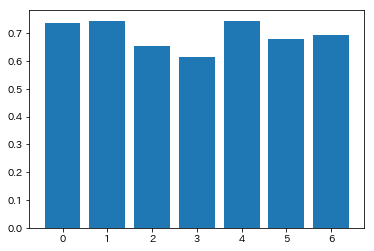

In [281]:
plt.bar(weekdays['A'].drop(['date'], axis=1).applymap(abs).groupby('曜日')['高低の変化'].mean().index,
        weekdays['A'].drop(['date'], axis=1).applymap(abs).groupby('曜日')['高低の変化'].mean())

<BarContainer object of 7 artists>

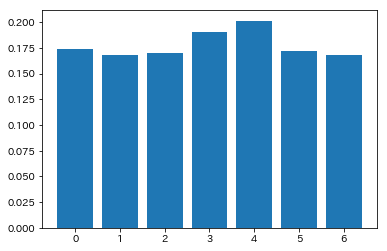

In [282]:
plt.bar(weekdays['B'].drop(['date'], axis=1).applymap(abs).groupby('曜日')['高低の変化'].mean().index,
        weekdays['B'].drop(['date'], axis=1).applymap(abs).groupby('曜日')['高低の変化'].mean())

<BarContainer object of 7 artists>

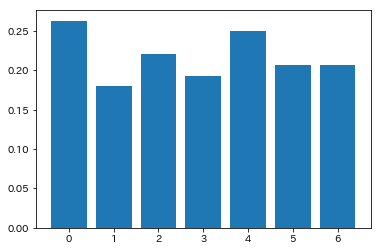

In [283]:
plt.bar(weekdays['C'].drop(['date'], axis=1).applymap(abs).groupby('曜日')['高低の変化'].mean().index,
        weekdays['C'].drop(['date'], axis=1).applymap(abs).groupby('曜日')['高低の変化'].mean())

<BarContainer object of 7 artists>

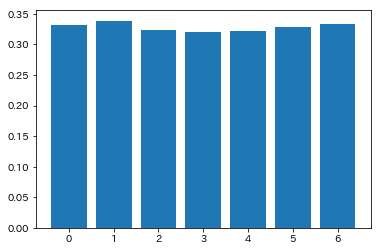

In [284]:
plt.bar(weekdays['D'].drop(['date'], axis=1).applymap(abs).groupby('曜日')['高低の変化'].mean().index,
        weekdays['D'].drop(['date'], axis=1).applymap(abs).groupby('曜日')['高低の変化'].mean())

In [262]:
weekdays['A'].groupby('曜日').describe()

高低の変化                                                           高低左  \
       count      mean       std    min   25%  50%   75%    max      count   
曜日                                                                           
0   954474.0 -0.000329  1.493972 -35.24 -0.17  0.0  0.17  31.48  1085417.0   
1   965876.0 -0.000081  1.517729 -25.82 -0.17  0.0  0.17  24.24  1090577.0   
2   973491.0  0.000182  1.434350 -26.49 -0.14  0.0  0.14  81.50  1069687.0   
3   930770.0  0.000081  1.382753 -84.60 -0.14  0.0  0.14  27.81  1057058.0   
4   912779.0  0.000133  1.549591 -33.39 -0.17  0.0  0.17  39.92  1077865.0   
5   880643.0 -0.000140  1.477304 -36.44 -0.15  0.0  0.15  94.53  1006885.0   
6   853431.0  0.000263  1.492627 -94.31 -0.15  0.0  0.15  32.75  1083454.0   

                                                        
        mean       std    min   25%   50%   75%    max  
曜日                                                      
0   0.001757  1.765666 -22.51 -0.94  0.01  0.94  26.02  
1   0.001252  1.763169 -16.03 -0.94  0.01  0.94  16.04  
2   0.001794  1.784742 -24.61 -0.94  0.01  0.94  82.63  
3   0.001598  1.763427 -22.24 -0.94  0.01  0.94  34.28  
4   0.001833  1.778471 -23.41 -0.94  0.01  0.94  33.71  
5   0.001635  1.787823 -26.07 -0.94  0.01  0.94  93.88  
6   0.001115  1.770351 -23.07 -0.94  0.01  0.94  31.10

In [263]:
weekdays['B'].groupby('曜日').describe()

高低の変化                                                          高低左  \
       count      mean       std    min   25%  50%   75%    max     count   
曜日                                                                          
0   376756.0 -0.000279  0.420103 -20.59 -0.10  0.0  0.10  26.82  711143.0   
1   497763.0 -0.000082  0.429287 -25.39 -0.09  0.0  0.09  25.91  607760.0   
2   486615.0 -0.000491  0.412188 -26.03 -0.10  0.0  0.10  30.79  684812.0   
3   517742.0  0.000244  0.493757 -29.88 -0.10  0.0  0.10  30.89  700085.0   
4   510580.0  0.000333  0.518701 -28.79 -0.10  0.0  0.10  30.83  662454.0   
5   409746.0 -0.000259  0.372029 -16.80 -0.10  0.0  0.10  20.67  483610.0   
6   307554.0  0.000223  0.370615 -26.02 -0.10  0.0  0.10  18.90  465732.0   

                                                        
        mean       std    min   25%   50%   75%    max  
曜日                                                      
0   0.000918  2.087518 -20.65 -0.89  0.03  0.95  24.07  
1   0.001171  2.084398 -19.14 -0.89  0.03  0.95  23.59  
2   0.000859  2.095760 -19.79 -0.89  0.03  0.95  28.98  
3   0.000139  2.114156 -18.85 -0.89  0.03  0.95  26.71  
4   0.000736  2.098648 -18.49 -0.89  0.03  0.95  28.19  
5   0.001948  2.073720 -17.85 -0.89  0.03  0.94  23.69  
6   0.001852  2.074352 -17.89 -0.88  0.03  0.95  17.34

In [264]:
weekdays['C'].groupby('曜日').describe()

高低の変化                                                             高低左  \
        count      mean       std     min   25%  50%   75%     max      count   
曜日                                                                              
0   1432978.0  0.000133  0.705009  -48.73 -0.11  0.0  0.11  191.44  1607717.0   
1   1155809.0 -0.000161  0.371934  -12.36 -0.10  0.0  0.10   14.17  1450927.0   
2   1368068.0 -0.000144  0.508188  -20.36 -0.10  0.0  0.10   20.65  1635574.0   
3   1483685.0  0.000188  0.409881  -13.27 -0.10  0.0  0.10   14.40  1667795.0   
4   1365206.0 -0.000079  0.580788  -19.03 -0.11  0.0  0.11   20.72  1532069.0   
5   1421690.0  0.000045  0.484093  -24.47 -0.10  0.0  0.10   54.50  1757804.0   
6   1586432.0  0.000083  0.556554 -187.28 -0.10  0.0  0.10   49.43  1710220.0   

                                                         
        mean       std    min   25%   50%   75%     max  
曜日                                                       
0   0.001574  2.187133 -55.41 -1.07  0.03  1.10  195.08  
1   0.001361  2.145147 -18.32 -1.06  0.03  1.08   18.57  
2   0.000603  2.159925 -17.54 -1.07  0.02  1.09   17.70  
3   0.000853  2.161336 -19.11 -1.07  0.03  1.09   25.75  
4   0.000898  2.165293 -19.26 -1.07  0.03  1.09   18.50  
5   0.001221  2.184157 -52.11 -1.07  0.03  1.09  190.79  
6   0.000823  2.161663 -21.69 -1.07  0.02  1.09   18.28

In [265]:
weekdays['D'].groupby('曜日').describe()

高低の変化                                                          高低左  \
       count      mean       std    min   25%  50%   75%    max     count   
曜日                                                                          
0   358314.0 -0.000155  0.664996 -22.24 -0.19  0.0  0.18  21.70  451003.0   
1   393056.0 -0.000611  0.700278 -19.36 -0.18  0.0  0.18  19.78  462762.0   
2   376353.0  0.000115  0.644667 -28.40 -0.18  0.0  0.18  20.74  414089.0   
3   291644.0 -0.000451  0.642897 -26.73 -0.18  0.0  0.18  22.69  413289.0   
4   346522.0  0.001078  0.641603 -22.63 -0.18  0.0  0.18  21.70  475816.0   
5   392133.0  0.000520  0.655261 -23.52 -0.18  0.0  0.18  21.36  449266.0   
6   354610.0  0.000723  0.666200 -18.93 -0.18  0.0  0.19  18.51  422925.0   

                                                        
        mean       std    min   25%   50%   75%    max  
曜日                                                      
0  -0.004662  3.243318 -21.26 -1.67  0.04  1.75  20.16  
1  -0.007787  3.198718 -27.92 -1.65  0.03  1.72  26.77  
2  -0.006833  3.211580 -19.73 -1.65  0.03  1.73  19.11  
3  -0.006812  3.196640 -20.34 -1.65  0.03  1.72  19.96  
4  -0.006473  3.193228 -31.09 -1.65  0.03  1.72  24.37  
5  -0.007207  3.242489 -21.83 -1.67  0.03  1.74  28.00  
6  -0.005553  3.218890 -18.19 -1.66  0.03  1.74  19.58

In [2]:
equipments={}
for no in ['A','B','C','D']:
    equipments[no] = pd.read_csv("dataset/equipment_" + no + ".csv")

In [6]:
weekdays={}
for no in ['A','B','C','D']:
    weekdays[no] = pd.read_csv("weekday_" + no + ".csv", parse_dates=["date"], index_col=0)

/Users/a0082273/.pyenv/versions/miniconda3-latest/lib/python3.7/site-packages/numpy/lib/arraysetops.py:522: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [7]:
weekdays['A'][:365]
weekdays['A'][365:365*2]

,date,高低左,高低の変化,曜日
0,2017-04-01,-1.16,NaN,5
1,2017-04-02,-0.81,0.35,6
2,2017-04-03,-0.99,-0.18,0
3,2017-04-04,NaN,NaN,1
4,2017-04-05,-0.97,NaN,2
5,2017-04-06,-1.48,-0.51,3
6,2017-04-07,-0.66,0.82,4
7,2017-04-08,-1.29,-0.63,5
8,2017-04-09,-0.98,0.31,6
9,2017-04-10,-1.63,-0.65,0


,date,高低左,高低の変化,曜日
365,2017-04-01,-1.17,NaN,5
366,2017-04-02,-0.83,0.34,6
367,2017-04-03,-0.91,-0.08,0
368,2017-04-04,NaN,NaN,1
369,2017-04-05,-0.71,NaN,2
370,2017-04-06,-1.07,-0.36,3
371,2017-04-07,-0.56,0.51,4
372,2017-04-08,-0.98,-0.42,5
373,2017-04-09,-0.82,0.16,6
374,2017-04-10,-1.45,-0.63,0


<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

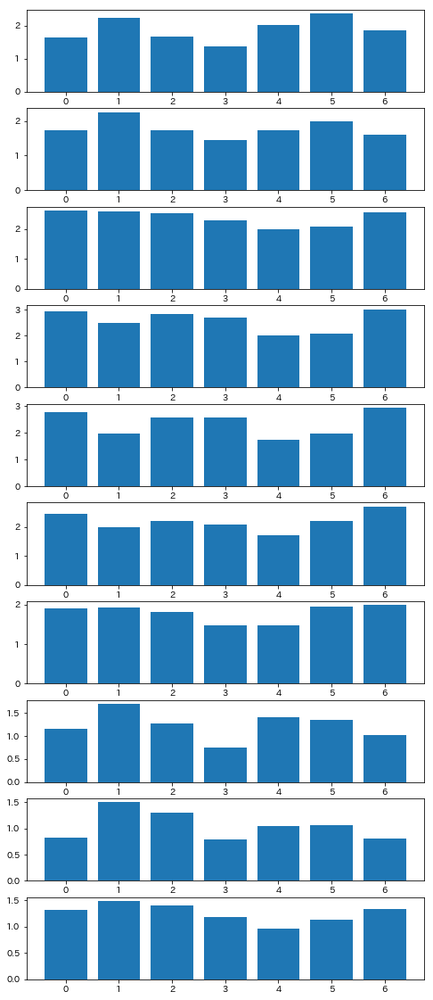

In [8]:
fig, axes = plt.subplots(10, 1, figsize=(8, 20))
for i in range(10):
    weekday = weekdays['A'][365*i:365*(i+1)]
    axes[i].bar(weekday.drop(['date'], axis=1).applymap(abs).groupby('曜日')['高低の変化'].mean().index,
                weekday.drop(['date'], axis=1).applymap(abs).groupby('曜日')['高低の変化'].mean())

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

<BarContainer object of 7 artists>

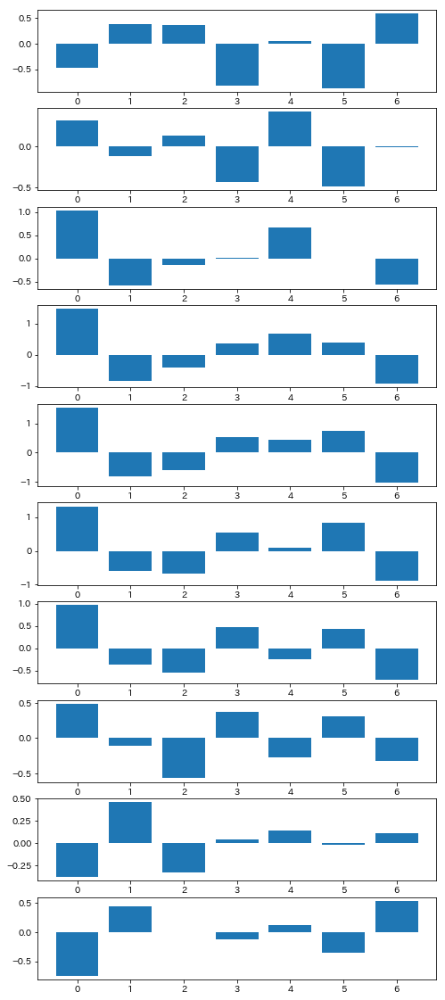

In [9]:
fig, axes = plt.subplots(10, 1, figsize=(8, 20))
for i in range(10):
    weekday = weekdays['A'][365*i:365*(i+1)]
    axes[i].bar(weekday.drop(['date'], axis=1).groupby('曜日')['高低の変化'].mean().index,
                weekday.drop(['date'], axis=1).groupby('曜日')['高低の変化'].mean())

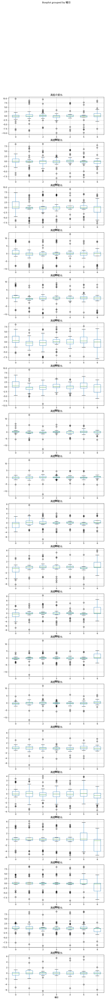

In [16]:
fig, axes = plt.subplots(20, 1, figsize=(8, 80))
for i in range(20):
    weekday = weekdays['A'][365*i:365*(i+1)]
    weekday.boxplot(column=['高低の変化'], by='曜日', ax=axes[i])

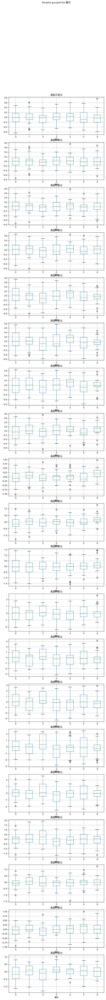

In [17]:
fig, axes = plt.subplots(20, 1, figsize=(8, 80))
for i in range(20):
    weekday = weekdays['D'][365*i:365*(i+1)]
    weekday.boxplot(column=['高低の変化'], by='曜日', ax=axes[i])

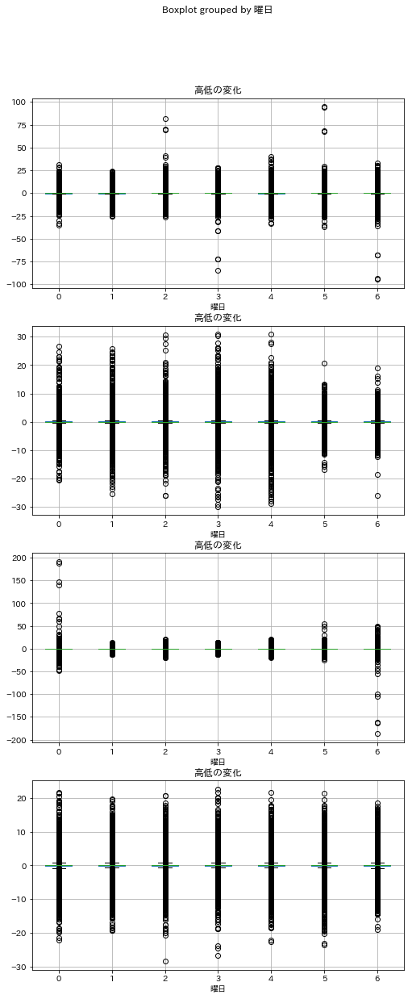

In [24]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    weekday = weekdays[no]
    weekday.boxplot(column=['高低の変化'], by='曜日', ax=axes[i])

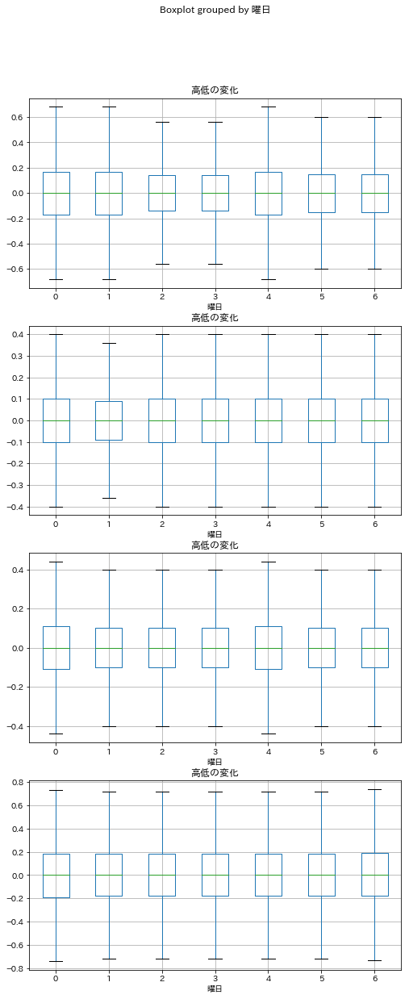

In [25]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    weekday = weekdays[no]
    weekday.boxplot(column=['高低の変化'], by='曜日', ax=axes[i], sym='')

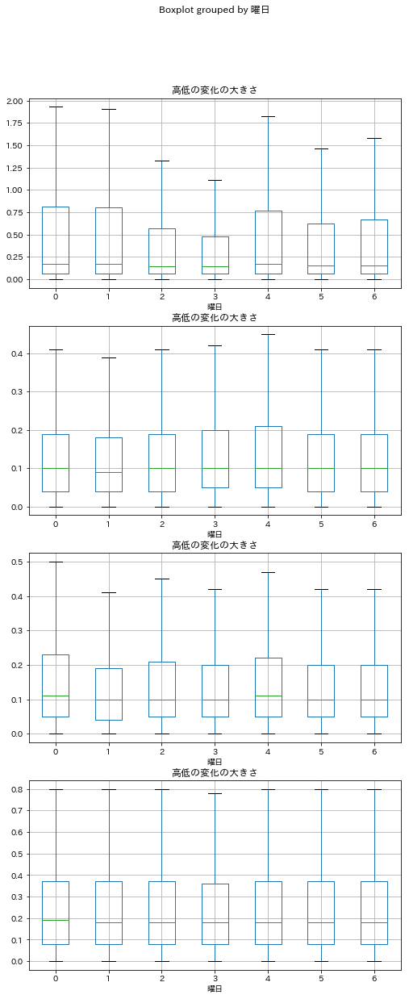

In [29]:
fig, axes = plt.subplots(4, 1, figsize=(8, 20))
for i, no in enumerate(['A', 'B', 'C', 'D']):
    weekday = weekdays[no]
    weekday['高低の変化の大きさ'] = abs(weekday['高低の変化'])
    weekday.boxplot(column=['高低の変化の大きさ'], by='曜日', ax=axes[i], sym='')